In [21]:
import matplotlib.pyplot as plt
from simtk.openmm import app
from simtk import openmm, unit
from openeye import oechem
from sys import stdout
from rdkit.Chem import AllChem
from rdkit.Chem import Draw
import sys
import string
from rdkit import Chem
import lxml.etree as etree

from simtk.openmm.app import element as elem
from simtk.openmm.app import Topology

import os
import math
import copy
import re
import numpy
import random

from simtk import openmm, unit

import time

import itertools

from rdkit import Chem
from rdkit import Geometry


import sys
import io
from IPython.nbformat import current
import openeye.oechem
import openeye.oeomega
import openeye.oequacpac

from openeye import oechem, oequacpac
from openeye.oechem import *
from openeye.oedepict import *
from IPython.core.display import Image, display
from openforcefield.typing.engines.smirnoff import forcefield_rdk
from openforcefield.typing.engines import smirnoff
#from openforcefield import *
from openforcefield.utils import *
def RetrieveMol2Block(fileLikeObject, delimiter="@<TRIPOS>MOLECULE"):
    """generator which retrieves one mol2 block at a time
    """
    mol2 = []
    for line in fileLikeObject:
        if line.startswith(delimiter) and mol2:
            yield "".join(mol2)
            mol2 = []
        mol2.append(line)
    if mol2:
        yield "".join(mol2)
# sys.path.insert(0, os.path.dirname(os.path.abspath(os.path.join('..'))) + "/openforcefield/utils/")
# #from utils import *
# from utils import get_data_filename, extractPositionsFromOEMol, generateTopologyFromOEMol, extractPositionsFromRDKMol

# sys.path.insert(0, os.path.dirname(os.path.abspath(os.path.join('..'))) + "/openforcefield/typing/engines/smirnoff/")
# from forcefield import *
# from forcefield_utils import *

In [20]:
rdkmol = Chem.MolFromMol2File("/home/shuwang/Desktop/pu8.mol2", sanitize = False, removeHs = False)
positions_rdk = extractPositionsFromRDKMol(rdkmol)
# ff_filename = get_data_filename('forcefield/Frosst_AlkEthOH_parmAtFrosst.ffxml')
forcefield = smirnoff.forcefield_rdk.ForceField(ff_filename)
topology_rdk = smirnoff.forcefield_rdk.generateTopologyFromRDKMol(rdkmol)
system=forcefield.createSystem(topology_rdk,[rdkmol])


# istream = oechem.oemolistream("/home/shuwang/Desktop/pu8.mol2")
# mol = oechem.OEMol()
# # flavor = oechem.OEIFlavor_Generic_Default | oechem.OEIFlavor_MOL2_Default | oechem.OEIFlavor_MOL2_Forcefield
# # istream.SetFlavor( oechem.OEFormat_MOL2, flavor)
# oemols_tripos = []
# while oechem.OEReadMolecule(istream, mol):
#     oechem.OETriposAtomNames(mol)
#     oemols_tripos.append(oechem.OEMol(mol))
# istream.close()    
# oemol = oemols_tripos[0]
# positions_oe = extractPositionsFromOEMol(oemol)
# forcefield = smirnoff.forcefield.ForceField(ff_filename)
# topology_oe = smirnoff.forcefield.generateTopologyFromOEMol(oemol)
# system_oe = forcefield.createSystem(topology_oe, [oemol], verbose = False)


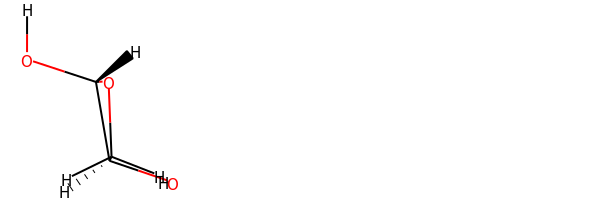

None
None
AlkEthOH_r0
     RDKit          3D

 12 12  0  0  0  0  0  0  0  0999 V2000
    0.1466   -0.6972   -1.2190 C   0  0  0  0  0  0  0  0  0  0  0  0
    0.1072   -0.7754    0.3061 C   0  0  2  0  0  0  0  0  0  0  0  0
   -0.1521    0.7339    0.2375 C   0  0  1  0  0  0  0  0  0  0  0  0
    0.0894    0.7465   -1.1920 O   0  0  0  0  0  0  0  0  0  0  0  0
    1.3221   -1.1878    0.9520 O   0  0  0  0  0  0  0  0  0  0  0  0
   -1.4710    1.1671    0.6094 O   0  0  0  0  0  0  0  0  0  0  0  0
    1.0701   -1.0576   -1.6805 H   0  0  0  0  0  0  0  0  0  0  0  0
   -0.7173   -1.1199   -1.7408 H   0  0  0  0  0  0  0  0  0  0  0  0
   -0.7451   -1.3515    0.6836 H   0  0  0  0  0  0  0  0  0  0  0  0
    0.6019    1.3396    0.7541 H   0  0  0  0  0  0  0  0  0  0  0  0
    1.1323   -1.1855    1.8998 H   0  0  0  0  0  0  0  0  0  0  0  0
   -1.4701    2.1287    0.5135 H   0  0  0  0  0  0  0  0  0  0  0  0
  1  2  1  0
  1  4  1  0
  2  3  1  0
  2  5  1  0
  3  4  1  0
  3  6  1

In [18]:
mol_filename = os.path.dirname(os.path.abspath(os.path.join('..'))) + "/openforcefield/data/molecules/AlkEthOH_test_filt1_tripos.mol2"
ff_filename = os.path.dirname(os.path.abspath(os.path.join('..'))) + "/openforcefield/data/forcefield/smirnoff99Frosst.ffxml"

mol = Chem.MolFromMol2File(mol_filename, sanitize = True, removeHs = False)
x = Draw.MolsToGridImage([mol])
display(x)
m1 = Chem.MolFromSmiles('Cc1ccccc1')
print(m1)
print(m1.UpdatePropertyCache())
print(mol.UpdatePropertyCache())
print(Chem.MolToMolBlock(mol))
positions_rdk = extractPositionsFromRDKMol(mol)
#print positions

# atoms = mol.GetAtoms()
# print atoms[0].GetPropsAsDict()
# #print list(atoms[0].GetPropNames())
# atoms[0].SetDoubleProp("PartialCharge", 0.3)
# print atoms[0].GetPropsAsDict()["PartialCharge"]
# [float(a.GetPropsAsDict()["_TriposPartialCharge"]) if "_TriposPartialCharge" in a.GetPropsAsDict() else 0.0 for a in mol.GetAtoms()]

In [3]:

Chem.Draw.MolsToGridImage([mol],molsPerRow=1)


#print positions

# Load a SMIRNOFF small molecule forcefield for alkanes, ethers, and alcohols
forcefield = smirnoff.forcefield_rdk.ForceField(ff_filename)


# Create the OpenMM system
topology_rdk = smirnoff.forcefield_rdk.generateTopologyFromRDKMol(mol)
system_rdk = forcefield.createSystem(topology_rdk, [mol])

#g1,g2,e1,e2 = smirnoff.forcefield_utils.compare_system_energies(topology, topology, system, system, positions)

In [15]:
# Load molecule using OpenEye tools
mol = oechem.OEGraphMol()
ifs = oechem.oemolistream(mol_filename)
flavor = oechem.OEIFlavor_Generic_Default | oechem.OEIFlavor_MOL2_Default | oechem.OEIFlavor_MOL2_Forcefield
ifs.SetFlavor( oechem.OEFormat_MOL2, flavor)
oechem.OEReadMolecule(ifs, mol )
oechem.OETriposAtomNames(mol)

# Get positions in OpenMM-compatible format
positions_oe = extractPositionsFromOEMol(mol)
#print positions

# Load a SMIRNOFF small molecule forcefield for alkanes, ethers, and alcohols
forcefield = smirnoff.forcefield.ForceField(ff_filename)


# Create the OpenMM system
topology_oe = smirnoff.forcefield.generateTopologyFromOEMol(mol)
system_oe = forcefield.createSystem(topology_oe, [mol])

g1,g2,e1,e2 = smirnoff.forcefield_utils.compare_system_energies(topology_oe, topology_rdk, system_oe, system_rdk, positions_oe, positions_rdk, skip_assert = True)






KeyError: 0

AlkEthOH_r0
     RDKi


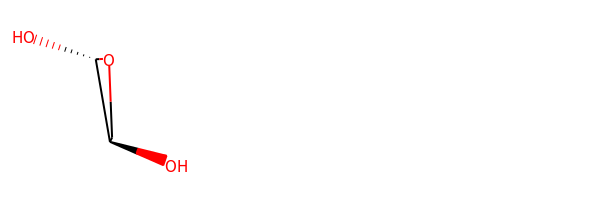

In [5]:

def getNthmol(n):
    counter  = 0
    for i in RetrieveMol2Block(open(mol_filename, "r")):
        if counter == n:
            return i
        counter += 1
        
mol2 = getNthmol(14)
mol2 = getNthmol(0)




# print(mol2)

rdkmol = Chem.MolFromMol2Block(mol2,  removeHs = True)

print (Chem.MolToMolBlock(rdkmol)[0:21])
# Chem.Kekulize(rdkmol)
rdkmol = Chem.Mol(rdkmol)
x = Draw.MolsToGridImage([rdkmol], kekulize = False)
display(x)
    

# reading from mol2 file 

In [14]:
mol_filename = "/home/shuwang/Desktop/4344.mol2"
    
istream = oechem.oemolistream(mol_filename)
mol = oechem.OEMol()
# flavor = oechem.OEIFlavor_Generic_Default | oechem.OEIFlavor_MOL2_Default | oechem.OEIFlavor_MOL2_Forcefield
# istream.SetFlavor( oechem.OEFormat_MOL2, flavor)
oemols_tripos = []
while oechem.OEReadMolecule(istream, mol):
    oechem.OETriposAtomNames(mol)
    oemols_tripos.append(oechem.OEMol(mol))
istream.close()


counter = 0
for mol2 in RetrieveMol2Block(open(mol_filename, "r")):
#     rdkmol = Chem.MolFromMol2Block(mol2, sanitize = True, removeHs = False)
    rdkmol = Chem.MolFromMol2Block(mol2, sanitize = False, removeHs = False)
#     Chem.Kekulize(rdkmol)
    writeToFile = compare_energies(rdkmol, oemols_tripos[counter])
    counter += 1
    if not writeToFile:        continue
    
    print(Chem.MolToMolBlock(rdkmol)[0:21])
    x = Draw.MolsToGridImage([rdkmol], kekulize = False)
    display(x)
    print("--------")




KeyError: 0

In [13]:
def compare_energies(rdkmol, oemol):
    if rdkmol == None:
        print("RDK parsing error")
        return False
#     print(Chem.MolToSmiles(rdkmol))
    positions_rdk = extractPositionsFromRDKMol(rdkmol)
    forcefield = smirnoff.forcefield_rdk.ForceField(ff_filename)
    topology_rdk = smirnoff.forcefield_rdk.generateTopologyFromRDKMol(rdkmol)
    system_rdk = forcefield.createSystem(topology_rdk, [rdkmol], verbose = False)
    
    positions_oe = extractPositionsFromOEMol(oemol)
    forcefield = smirnoff.forcefield.ForceField(ff_filename)
    topology_oe = smirnoff.forcefield.generateTopologyFromOEMol(oemol)
    system_oe = forcefield.createSystem(topology_oe, [oemol], verbose = False)

    g1,g2,e1,e2 = smirnoff.forcefield_utils.compare_system_energies(topology_oe, topology_rdk, system_oe, system_rdk, positions_oe, positions_rdk, verbose = False,skip_assert = True)
#     g1,g2,e1,e2 = smirnoff.forcefield_utils.compare_system_energies(topology_oe, topology_oe, system_oe, system_oe, positions_oe, positions_oe, verbose = False,skip_assert = True)
    if(e1 == e2): return False
    for i in g1:
        print(i)
        print(g1[i], g2[i], g1[i] == g2[i])

    print( e1, e2)
    print('')
    return True

#mol_filename = os.path.dirname(os.path.abspath(os.path.join('..'))) + "openforcefield/data/molecules/zinc-subset-tripos.mol2.gz"
mol_filename = os.path.dirname(os.path.abspath(os.path.join('..'))) + "/openforcefield/data/molecules/DrugBank_tripos.mol2"
    
istream = oechem.oemolistream(mol_filename)
mol = oechem.OEMol()
# flavor = oechem.OEIFlavor_Generic_Default | oechem.OEIFlavor_MOL2_Default | oechem.OEIFlavor_MOL2_Forcefield
# istream.SetFlavor( oechem.OEFormat_MOL2, flavor)
oemols_tripos = []
while oechem.OEReadMolecule(istream, mol):
    oechem.OETriposAtomNames(mol)
    oemols_tripos.append(oechem.OEMol(mol))
istream.close()

fout = open("/home/shuwang/remove_oeimplicityHydrogen", "w")
counter = 0
for mol2 in RetrieveMol2Block(open(mol_filename, "r")):
#     rdkmol = Chem.MolFromMol2Block(mol2, sanitize = True, removeHs = False)
    rdkmol = Chem.MolFromMol2Block(mol2, sanitize = False, removeHs = False)
#     Chem.Kekulize(rdkmol)
    writeToFile = compare_energies(rdkmol, oemols_tripos[counter])
    counter += 1
    if not writeToFile:        continue
    
    print(Chem.MolToMolBlock(rdkmol)[0:21])
    x = Draw.MolsToGridImage([rdkmol], kekulize = False)
    display(x)
    print("--------")
    fout.write(mol2)
fout.close()


KeyError: 0

# subset of all mol2 read into sdf

Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       74 matches
                                               [#6X4:1]-[#6X4:2] :        0 matches
                                               [#6X4:1]-[#6X3:2] :        1 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        0 matches
                                               [#6X3:1]-[#6X3:2] :        4 matches
                                               [#6X3:1]:[#6X3:2] :       24 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        4 matches
                                               [#6X3:1]-[#7X3:2] :        1 matches
                               [#6X4:1]-[#7X3:2]-[#6X3]=[#8X1+0] :        0 matches
                                    [#6X3:1](=[#8X1+0])-[#7X3:2] :        0 match

Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       74 matches
                                               [#6X4:1]-[#6X4:2] :        0 matches
                                               [#6X4:1]-[#6X3:2] :        1 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        0 matches
                                               [#6X3:1]-[#6X3:2] :        4 matches
                                               [#6X3:1]:[#6X3:2] :       24 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        4 matches
                                               [#6X3:1]-[#7X3:2] :        1 matches
                               [#6X4:1]-[#7X3:2]-[#6X3]=[#8X1+0] :        0 matches
                                    [#6X3:1](=[#8X1+0])-[#7X3:2] :        0 match

bond
29964.783608035767 kJ/mol 29964.783608035767 kJ/mol True
angle
12.021409253648924 kJ/mol 12.021409253648924 kJ/mol True
nb
46.05461517642205 kJ/mol 43.19435349891394 kJ/mol False
torsion
46.60303346889985 kJ/mol 46.60303346889985 kJ/mol True
30069.462665934734 kJ/mol 30066.602404257228 kJ/mol

DrugBank_364
     RDK


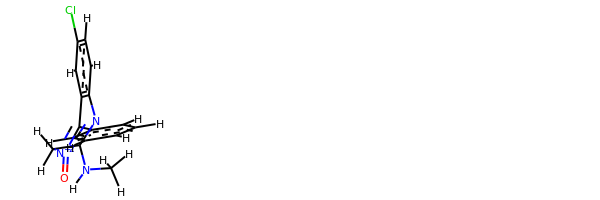

rdkit:  [H]c1c([H])c([H])c(C2=[N+2](=O)C([H])([H])C(N([H])C([H])([H])[H])=Nc3c([H])c([H])c(Cl)c([H])c32)c([H])c1[H]
oechem:  CNC1=Nc2ccc(cc2C(=N(=O)C1)c3ccccc3)Cl
--------
Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       28 matches
                                               [#6X4:1]-[#6X4:2] :        2 matches
                                               [#6X4:1]-[#6X3:2] :        1 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        1 matches
                                               [#6X3:1]-[#6X3:2] :        0 matches
                                               [#6X3:1]:[#6X3:2] :        0 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        1 matches
                                               [#6X3:1]-[#7X3:2] :        0 m

Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       28 matches
                                               [#6X4:1]-[#6X4:2] :        2 matches
                                               [#6X4:1]-[#6X3:2] :        1 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        1 matches
                                               [#6X3:1]-[#6X3:2] :        0 matches
                                               [#6X3:1]:[#6X3:2] :        0 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        1 matches
                                               [#6X3:1]-[#7X3:2] :        0 matches
                               [#6X4:1]-[#7X3:2]-[#6X3]=[#8X1+0] :        0 matches
                                    [#6X3:1](=[#8X1+0])-[#7X3:2] :        0 match

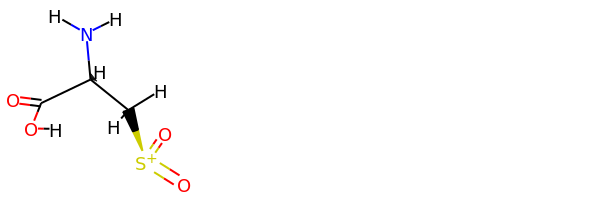

rdkit:  [H]OC(=O)[C@@]([H])(N([H])[H])C([H])([H])[S+](=O)=O
oechem:  C([C@@H](C(=O)O)N)[S-](=O)=O
--------
Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       28 matches
                                               [#6X4:1]-[#6X4:2] :        0 matches
                                               [#6X4:1]-[#6X3:2] :        0 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        0 matches
                                               [#6X3:1]-[#6X3:2] :        0 matches
                                               [#6X3:1]:[#6X3:2] :        0 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        4 matches
                                               [#6X3:1]-[#7X3:2] :        3 matches
                               [#6X4:1]-[#7X3:2]-[#6X3]=[#

Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       28 matches
                                               [#6X4:1]-[#6X4:2] :        0 matches
                                               [#6X4:1]-[#6X3:2] :        0 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        0 matches
                                               [#6X3:1]-[#6X3:2] :        0 matches
                                               [#6X3:1]:[#6X3:2] :        0 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        4 matches
                                               [#6X3:1]-[#7X3:2] :        3 matches
                               [#6X4:1]-[#7X3:2]-[#6X3]=[#8X1+0] :        0 matches
                                    [#6X3:1](=[#8X1+0])-[#7X3:2] :        0 match

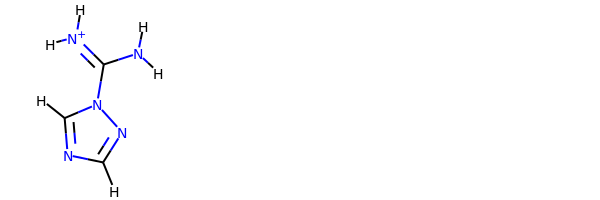

rdkit:  [H]C1=NN(C(N([H])[H])=[N+]([H])[H])C([H])=N1
oechem:  c1ncn(n1)C(=[NH2+])N
--------
Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       26 matches
                                               [#6X4:1]-[#6X4:2] :        0 matches
                                               [#6X4:1]-[#6X3:2] :        1 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        1 matches
                                               [#6X3:1]-[#6X3:2] :        2 matches
                                               [#6X3:1]:[#6X3:2] :        0 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        0 matches
                                               [#6X3:1]-[#7X3:2] :        0 matches
                               [#6X4:1]-[#7X3:2]-[#6X3]=[#8X1+0] :       

Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       26 matches
                                               [#6X4:1]-[#6X4:2] :        0 matches
                                               [#6X4:1]-[#6X3:2] :        1 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        1 matches
                                               [#6X3:1]-[#6X3:2] :        2 matches
                                               [#6X3:1]:[#6X3:2] :        0 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        0 matches
                                               [#6X3:1]-[#7X3:2] :        0 matches
                               [#6X4:1]-[#7X3:2]-[#6X3]=[#8X1+0] :        0 matches
                                    [#6X3:1](=[#8X1+0])-[#7X3:2] :        0 match

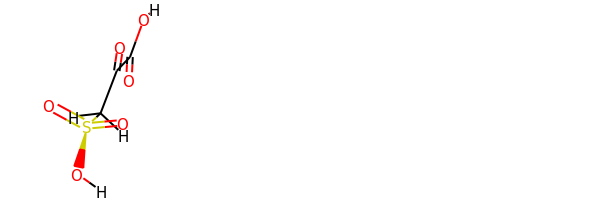

rdkit:  [H]OC(=O)C(=O)C([H])([H])S(=O)(=O)O[H]
oechem:  C(C(=O)C(=O)O)S(=O)(=O)O
--------
Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       54 matches
                                               [#6X4:1]-[#6X4:2] :        6 matches
                                               [#6X4:1]-[#6X3:2] :        1 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        1 matches
                                               [#6X3:1]-[#6X3:2] :        0 matches
                                               [#6X3:1]:[#6X3:2] :        0 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        5 matches
                                               [#6X3:1]-[#7X3:2] :        3 matches
                               [#6X4:1]-[#7X3:2]-[#6X3]=[#8X1+0] :        0

Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       54 matches
                                               [#6X4:1]-[#6X4:2] :        6 matches
                                               [#6X4:1]-[#6X3:2] :        1 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        1 matches
                                               [#6X3:1]-[#6X3:2] :        0 matches
                                               [#6X3:1]:[#6X3:2] :        0 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        5 matches
                                               [#6X3:1]-[#7X3:2] :        3 matches
                               [#6X4:1]-[#7X3:2]-[#6X3]=[#8X1+0] :        0 matches
                                    [#6X3:1](=[#8X1+0])-[#7X3:2] :        1 match

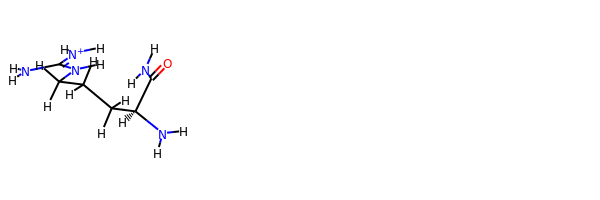

rdkit:  [H]N([H])C(=O)[C@@]([H])(N([H])[H])C([H])([H])C([H])([H])C([H])([H])N([H])C(N([H])[H])=[N+]([H])[H]
oechem:  C(C[C@@H](C(=O)N)N)CNC(=[NH2+])N
--------
Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :      102 matches
                                               [#6X4:1]-[#6X4:2] :        4 matches
                                               [#6X4:1]-[#6X3:2] :        2 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        2 matches
                                               [#6X3:1]-[#6X3:2] :        2 matches
                                               [#6X3:1]:[#6X3:2] :       16 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        8 matches
                                               [#6X3:1]-[#7X3:2] :        7 matches
      

                                      [*:1]~[#15:2]-[#6:3]-[*:4] :        0 matches
                                    [*:1]~[#15:2]-[#6X3:3]~[*:4] :        0 matches
                                       [*:1]-[#8:2]-[#8:3]-[*:4] :        0 matches
                                     [*:1]-[#8:2]-[#8H1:3]-[*:4] :        0 matches
                                     [*:1]~[#8X2:2]-[#7:3]~[*:4] :        0 matches
                             [*:1]-[#8X2r5:2]-;@[#7X3r5:3]~[*:4] :        0 matches
                             [*:1]-[#8X2r5:2]-;@[#7X2r5:3]~[*:4] :        0 matches
                         [*:1]-[#7X4,#7X3:2]-[#7X4,#7X3:3]-[*:4] :        0 matches
                       [#1:1]-[#7X4,#7X3:2]-[#7X4,#7X3:3]-[#1:4] :        0 matches
                     [#6X4:1]-[#7X4,#7X3:2]-[#7X4,#7X3:3]-[#1:4] :        0 matches
                   [#6X4:1]-[#7X4,#7X3:2]-[#7X4,#7X3:3]-[#6X4:4] :        0 matches
              [*:1]-[#7X4,#7X3:2]-[#7X3$(*~[#6X3,#6X2]):3]~[*:4] :        0 


HarmonicAngleGenerator:

                                               [*:1]~[*:2]~[*:3] :      160 matches
                                            [*:1]~[#6X4:2]-[*:3] :       36 matches
                                          [#1:1]-[#6X4:2]-[#1:3] :        4 matches
                                [*;r3:1]1~;@[*;r3:2]~;@[*;r3:3]1 :        0 matches
                                    [*;r3:1]~;@[*;r3:2]~;!@[*:3] :        0 matches
                                      [*:1]~;!@[*;r3:2]~;!@[*:3] :        0 matches
                                        [#1:1]-[*;r3:2]~;!@[*:3] :        0 matches
                                            [*:1]~[#6X3:2]~[*:3] :       84 matches
                                           [#1:1]-[#6X3:2]~[*:3] :        8 matches
                                          [#1:1]-[#6X3:2]-[#1:3] :        0 matches
                               [*;r6:1]~;@[*;r5:2]~;@[*;r5;x2:3] :        0 matches
                                    [*:1]~;!@[*;r5

81.08324528905254 kJ/mol 81.08324528905254 kJ/mol True
torsion
8.066930905144714 kJ/mol 8.066930905144716 kJ/mol False
211.55192903391742 kJ/mol 211.55192903391745 kJ/mol

DrugBank_2087
     RD


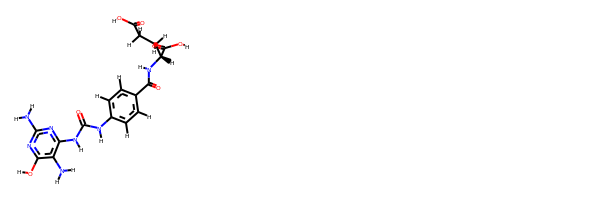

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])[C@]([H])(C(=O)O[H])N([H])C(=O)c1c([H])c([H])c(N([H])C(=O)N([H])c2nc(N([H])[H])nc(O[H])c2N([H])[H])c([H])c1[H]
oechem:  c1cc(ccc1C(=O)N[C@H](CCC(=O)O)C(=O)O)NC(=O)Nc2c(c(nc(n2)N)O)N
--------
Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       74 matches
                                               [#6X4:1]-[#6X4:2] :       10 matches
                                               [#6X4:1]-[#6X3:2] :        0 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        0 matches
                                               [#6X3:1]-[#6X3:2] :        0 matches
                                               [#6X3:1]:[#6X3:2] :       12 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        1 matches
                   

                    [#1:1]-[#7X3$(*~[#6X3,#6X2,#7X2+0]):2]-[*:3] :        0 matches
                                            [*:1]~[#7X2:2]~[*:3] :        0 matches
                                          [*:1]~[#7X2+0:2]~[*:3] :        0 matches
                                         [#1:1]-[#7X2+0:2]~[*:3] :        0 matches
                         [#6,#7,#8:1]-[#7X3:2](~[#8X1])~[#8X1:3] :        2 matches
                                      [#8X1:1]~[#7X3:2]~[#8X1:3] :        2 matches
                                         [*:1]~[#7X2:2]~[#7X1:3] :        0 matches
                                              [*:1]-[#8:2]-[*:3] :       12 matches
                            [#6X3,#7:1]~;@[#8;r:2]~;@[#6X3,#7:3] :        0 matches
                                          [*:1]-[#8X2+1:2]=[*:3] :        0 matches
                                           [*:1]~[#16X4:2]~[*:3] :        0 matches
                                   [*:1]-[#16X4,#16X3+0:2]-[*:3] :        0 

                             [#6X4:1]-[#8X2:2]-[#6X4:3]-[#7X3:4] :        0 matches
                      [#6X3:1]-[#8X2:2]-[#6X4;r3:3]-@[#6X4;r3:4] :        0 matches
                            [#6X3:1]-[#8X2:2]-[#6X4;r3:3]-[#1:4] :        0 matches
                              [#1:1]-[#8X2:2]-[#6X4;r3:3]-[#1:4] :        0 matches
                            [#1:1]-[#8X2:2]-[#6X4;r3:3]-[#6X4:4] :        0 matches
                         [#1:1]-[#8X2:2]-[#6X4;r3:3]-[#6X4;r3:4] :        0 matches
                                   [*:1]~[#6X3:2]-[#8X2:3]-[*:4] :        2 matches
                                  [*:1]~[#6X3:2]-[#8X2:3]-[#1:4] :        0 matches
                   [*:1]~[#6X3:2](=[#8,#16,#7])-[#8X2H0:3]-[*:4] :        0 matches
                      [*:1]~[#6X3:2](=[#8,#16,#7])-[#8:3]-[#1:4] :        0 matches
                               [#1:1]-[#8X2:2]-[#6X3:3]=[#8X1:4] :        0 matches
                      [#8,#16,#7:1]=[#6X3:2]-[#8X2H0:3]-[#6X4:4] :        0 

Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       74 matches
                                               [#6X4:1]-[#6X4:2] :       10 matches
                                               [#6X4:1]-[#6X3:2] :        0 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        0 matches
                                               [#6X3:1]-[#6X3:2] :        0 matches
                                               [#6X3:1]:[#6X3:2] :       12 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        1 matches
                                               [#6X3:1]-[#7X3:2] :        1 matches
                               [#6X4:1]-[#7X3:2]-[#6X3]=[#8X1+0] :        0 matches
                                    [#6X3:1](=[#8X1+0])-[#7X3:2] :        0 match

                                          [#1:1]-[#6X3:2]-[#1:3] :        0 matches
                               [*;r6:1]~;@[*;r5:2]~;@[*;r5;x2:3] :        0 matches
                                    [*:1]~;!@[*;r5:2]~;@[*;r5:3] :        0 matches
                                        [#8X1:1]~[#6X3:2]~[#8:3] :        0 matches
                                            [*:1]~[#6X2:2]~[*:3] :        0 matches
                                [*:1]-[#7X4,#7X3,#7X2-1:2]-[*:3] :        0 matches
                               [#1:1]-[#7X4,#7X3,#7X2-1:2]-[*:3] :        0 matches
                     [*:1]~[#7X3$(*~[#6X3,#6X2,#7X2+0]):2]~[*:3] :        6 matches
                    [#1:1]-[#7X3$(*~[#6X3,#6X2,#7X2+0]):2]-[*:3] :        0 matches
                                            [*:1]~[#7X2:2]~[*:3] :        0 matches
                                          [*:1]~[#7X2+0:2]~[*:3] :        0 matches
                                         [#1:1]-[#7X2+0:2]~[*:3] :        0 

                                                          [#7:1] :        1 matches
                                                         [#16:1] :        0 matches
                                                         [#15:1] :        0 matches
                                                          [#9:1] :        0 matches
                                                         [#17:1] :        0 matches
                                                         [#35:1] :        0 matches
                                                         [#53:1] :        0 matches

bond
29.942412908103822 kJ/mol 29.942412908103822 kJ/mol True
angle
16.52086976701568 kJ/mol 16.52086976701568 kJ/mol True
nb
35.94940128639869 kJ/mol 35.94940128639869 kJ/mol True
torsion
77.5284429056739 kJ/mol 77.52844253486008 kJ/mol False
159.94112686719208 kJ/mol 159.94112649637827 kJ/mol

DrugBank_2344
     RD


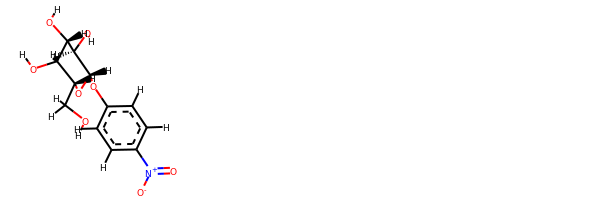

rdkit:  [H]OC([H])([H])[C@@]1([H])O[C@@]([H])(Oc2c([H])c([H])c([N+](=O)[O-])c([H])c2[H])[C@]([H])(O[H])[C@@]([H])(O[H])[C@@]1([H])O[H]
oechem:  c1cc(ccc1N(=O)=O)O[C@H]2[C@@H]([C@H]([C@H]([C@H](O2)CO)O)O)O
--------
Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       52 matches
                                               [#6X4:1]-[#6X4:2] :        4 matches
                                               [#6X4:1]-[#6X3:2] :        1 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        1 matches
                                               [#6X3:1]-[#6X3:2] :        0 matches
                                               [#6X3:1]:[#6X3:2] :        0 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        1 matches
                                   

                                        [#1:1]-[*;r3:2]~;!@[*:3] :        0 matches
                                            [*:1]~[#6X3:2]~[*:3] :        6 matches
                                           [#1:1]-[#6X3:2]~[*:3] :        0 matches
                                          [#1:1]-[#6X3:2]-[#1:3] :        0 matches
                               [*;r6:1]~;@[*;r5:2]~;@[*;r5;x2:3] :        0 matches
                                    [*:1]~;!@[*;r5:2]~;@[*;r5:3] :        0 matches
                                        [#8X1:1]~[#6X3:2]~[#8:3] :        1 matches
                                            [*:1]~[#6X2:2]~[*:3] :        0 matches
                                [*:1]-[#7X4,#7X3,#7X2-1:2]-[*:3] :       12 matches
                               [#1:1]-[#7X4,#7X3,#7X2-1:2]-[*:3] :        8 matches
                     [*:1]~[#7X3$(*~[#6X3,#6X2,#7X2+0]):2]~[*:3] :        0 matches
                    [#1:1]-[#7X3$(*~[#6X3,#6X2,#7X2+0]):2]-[*:3] :        0 

                    [#6X4:1]-[#16X4,#16X3+0:2]-[#7X2:3]~[#6X3:4] :        0 matches
                    [#8X1:1]~[#16X4,#16X3+0:2]-[#7X2:3]~[#6X3:4] :        0 matches
                          [*:1]~[#16X4,#16X3+0:2]-[#8X2:3]-[*:4] :        6 matches
                 [*:1]-[#16X2,#16X3+1:2]-[#16X2,#16X3+1:3]-[*:4] :        0 matches
                                    [*:1]-[#8X2:2]-[#15:3]~[*:4] :        0 matches
                              [#8X2:1]-[#15:2]-[#8X2:3]-[#6X4:4] :        0 matches
                                    [*:1]~[#7X3:2]-[#15:3]~[*:4] :        0 matches
                                    [*:1]~[#7X4:2]-[#15:3]~[*:4] :        0 matches
                                      [*:1]-[#7:2]-[#15:3]=[*:4] :        0 matches
                                   [#6X3:1]-[#7:2]-[#15:3]=[*:4] :        0 matches
                                         [*:1]-[*:2]#[*:3]-[*:4] :        0 matches
                                         [*:1]~[*:2]-[*:3]#[*:4] :        0 

                                         [*:1]~[*:2]~[*:3]~[*:4] :      118 matches
                                   [*:1]-[#6X4:2]-[#6X4:3]-[*:4] :       36 matches
                             [#6X4:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#1:4] :       12 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        0 matches
                             [#8X2:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#9:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                               [#17:1]-[#6X4:2]-[#6X4:3]-[#17:4] :        0 matches
                               [#35:1]-[#6X4:2]-[#6X4:3]-[#35:4] :        0 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                                [#1:1]-[#6X4:2]-[#6X4:3]-[#17:4] :        0 

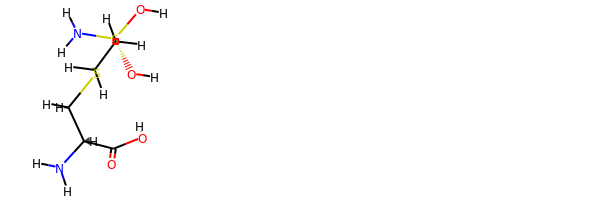

rdkit:  [H]OC(=O)[C@@]([H])(N([H])[H])C([H])([H])SC([H])([H])C([H])([H])S(O[H])(O[H])N([H])[H]
oechem:  C(C[S+2](N)(O)O)SC[C@@H](C(=O)O)N
--------
Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :      142 matches
                                               [#6X4:1]-[#6X4:2] :       12 matches
                                               [#6X4:1]-[#6X3:2] :        4 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        3 matches
                                               [#6X3:1]-[#6X3:2] :        0 matches
                                               [#6X3:1]:[#6X3:2] :       24 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        9 matches
                                               [#6X3:1]-[#7X3:2] :        5 matches
                  

                               [#17:1]-[#6X4:2]-[#6X4:3]-[#17:4] :        0 matches
                               [#35:1]-[#6X4:2]-[#6X4:3]-[#35:4] :        0 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                                [#1:1]-[#6X4:2]-[#6X4:3]-[#17:4] :        0 matches
                                [#1:1]-[#6X4:2]-[#6X4:3]-[#35:4] :        0 matches
                                [*:1]-[#6X4:2]-[#6X4;r3:3]-[*:4] :        0 matches
                          [*:1]-[#6X4:2]-[#6X4;r3:3]-[#6X4;r3:4] :        0 matches
                            [*:1]-[#6X4;r3:2]-@[#6X4;r3:3]-[*:4] :        0 matches
                       [#6X4;r3:1]-[#6X4;r3:2]-[#6X4;r3:3]-[*:4] :        0 matches
                                   [*:1]~[#6X3:2]-[#6X4:3]-[*:4] :       24 matches
                               [#1:1]-[#6X4:2]-[#6X3:3]=[#8X1:4] :        3 

                                                         [#35:1] :        0 matches
                                                         [#53:1] :        0 matches

Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :      142 matches
                                               [#6X4:1]-[#6X4:2] :       12 matches
                                               [#6X4:1]-[#6X3:2] :        4 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        3 matches
                                               [#6X3:1]-[#6X3:2] :        0 matches
                                               [#6X3:1]:[#6X3:2] :       24 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        9 matches
                                               [#6X3:1]-[#7X3:2] :        5 matc

                                            [*:1]~[#6X3:2]~[*:3] :       96 matches
                                           [#1:1]-[#6X3:2]~[*:3] :       20 matches
                                          [#1:1]-[#6X3:2]-[#1:3] :        0 matches
                               [*;r6:1]~;@[*;r5:2]~;@[*;r5;x2:3] :        0 matches
                                    [*:1]~;!@[*;r5:2]~;@[*;r5:3] :        0 matches
                                        [#8X1:1]~[#6X3:2]~[#8:3] :        1 matches
                                            [*:1]~[#6X2:2]~[*:3] :        0 matches
                                [*:1]-[#7X4,#7X3,#7X2-1:2]-[*:3] :       32 matches
                               [#1:1]-[#7X4,#7X3,#7X2-1:2]-[*:3] :       14 matches
                     [*:1]~[#7X3$(*~[#6X3,#6X2,#7X2+0]):2]~[*:3] :       30 matches
                    [#1:1]-[#7X3$(*~[#6X3,#6X2,#7X2+0]):2]-[*:3] :       12 matches
                                            [*:1]~[#7X2:2]~[*:3] :        0 

                                                   [#1:1]-[#6X2] :        0 matches
                                                     [#1:1]-[#7] :        8 matches
                                                     [#1:1]-[#8] :        1 matches
                                                    [#1:1]-[#16] :        0 matches
                                                          [#6:1] :       25 matches
                                                        [#6X2:1] :        0 matches
                                                        [#6X4:1] :        9 matches
                                                          [#8:1] :        4 matches
                                                    [#8X2H0+0:1] :        0 matches
                                                    [#8X2H1+0:1] :        1 matches
                                                          [#7:1] :        6 matches
                                                         [#16:1] :        0 

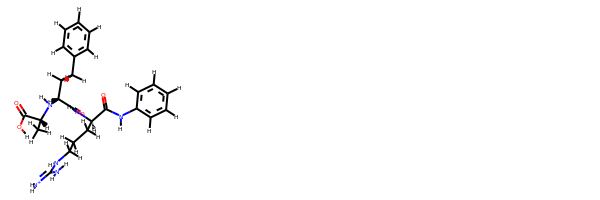

rdkit:  [H]OC(=O)[C@]([H])(N([H])[C@@]([H])(C(=O)N([H])[C@@]([H])(C(=O)N([H])c1c([H])c([H])c([H])c([H])c1[H])C([H])([H])C([H])([H])C([H])([H])N([H])C(N([H])[H])=[N+]([H])[H])C([H])([H])C([H])([H])c1c([H])c([H])c([H])c([H])c1[H])C([H])([H])[H]
oechem:  C[C@H](C(=O)O)N[C@H](CCc1ccccc1)C(=O)N[C@H](CCCNC(=[NH2+])N)C(=O)Nc2ccccc2
--------
Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :      122 matches
                                               [#6X4:1]-[#6X4:2] :        6 matches
                                               [#6X4:1]-[#6X3:2] :        1 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        0 matches
                                               [#6X3:1]-[#6X3:2] :        8 matches
                                               [#6X3:1]:[#6X3:2] :       24 matches
                                               [#6X3:1]=[#6X3:2] :        2 match


PeriodicTorsionGenerator Propers:

                                         [*:1]~[*:2]~[*:3]~[*:4] :      286 matches
                                   [*:1]-[#6X4:2]-[#6X4:3]-[*:4] :       54 matches
                             [#6X4:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#1:4] :        0 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :       18 matches
                             [#8X2:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#9:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                               [#17:1]-[#6X4:2]-[#6X4:3]-[#17:4] :        0 matches
                               [#35:1]-[#6X4:2]-[#6X4:3]-[#35:4] :        0 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                                [#1:1]-[

Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :      122 matches
                                               [#6X4:1]-[#6X4:2] :        6 matches
                                               [#6X4:1]-[#6X3:2] :        1 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        0 matches
                                               [#6X3:1]-[#6X3:2] :        8 matches
                                               [#6X3:1]:[#6X3:2] :       24 matches
                                               [#6X3:1]=[#6X3:2] :        2 matches
                                                   [#6:1]-[#7:2] :        2 matches
                                               [#6X3:1]-[#7X3:2] :        1 matches
                               [#6X4:1]-[#7X3:2]-[#6X3]=[#8X1+0] :        0 matches
                                    [#6X3:1](=[#8X1+0])-[#7X3:2] :        0 match

                     [#6X4;r3:1]-;@[#6X4;r3:2]-[#6X3:3]~[#6X3:4] :        0 matches
               [#6X4;r3:1]-;@[#6X4;r3:2]-[#6X3;r6:3]:[#6X3;r6:4] :        0 matches
             [#6X4;r3:1]-;@[#6X4;r3:2]-[#6X3;r5:3]-;@[#6X3;r5:4] :        0 matches
             [#6X4;r3:1]-;@[#6X4;r3:2]-[#6X3;r5:3]=;@[#6X3;r5:4] :        0 matches
                     [#6X4;r3:1]-;@[#6X4;r3:2]-[#6X3:3]-[#6X4:4] :        0 matches
               [#6X4;r3:1]-;@[#6X4;r3:2]-[#6X3;r6:3]:[#7X2;r6:4] :        0 matches
                     [#6X4;r3:1]-;@[#6X4;r3:2]-[#6X3:3]=[#7X2:4] :        0 matches
                     [#6X4;r3:1]-;@[#6X4;r3:2]-[#6X3:3]-[#8X2:4] :        0 matches
                     [#6X4;r3:1]-;@[#6X4;r3:2]-[#6X3:3]=[#8X1:4] :        0 matches
                                   [*:1]~[#6X3:2]-[#6X3:3]~[*:4] :       32 matches
                                   [*:1]~[#6X3:2]:[#6X3:3]~[*:4] :       96 matches
                               [*:1]-,:[#6X3:2]=[#6X3:3]-,:[*:4] :        8 

                 [*:1]-[#16X2,#16X3+1:2]-[#16X2,#16X3+1:3]-[*:4] :        0 matches
                                    [*:1]-[#8X2:2]-[#15:3]~[*:4] :        0 matches
                              [#8X2:1]-[#15:2]-[#8X2:3]-[#6X4:4] :        0 matches
                                    [*:1]~[#7X3:2]-[#15:3]~[*:4] :        0 matches
                                    [*:1]~[#7X4:2]-[#15:3]~[*:4] :        0 matches
                                      [*:1]-[#7:2]-[#15:3]=[*:4] :        0 matches
                                   [#6X3:1]-[#7:2]-[#15:3]=[*:4] :        0 matches
                                         [*:1]-[*:2]#[*:3]-[*:4] :        0 matches
                                         [*:1]~[*:2]-[*:3]#[*:4] :        0 matches
                          [*:1]~[*:2]=[#6,#7,#16,#15;X2:3]=[*:4] :        0 matches

PeriodicTorsionGenerator Impropers:

                                    [*:1]~[#6X3:2](~[*:3])~[*:4] :       96 matches
                                [*:1]~

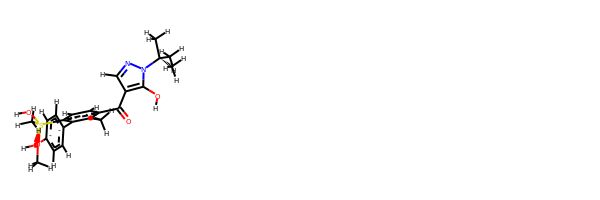

rdkit:  [H]OC1=C(C(=O)c2c([H])c([H])c(S(O[H])(O[H])C([H])([H])[H])c(-c3c([H])c([H])c(OC([H])([H])[H])c([H])c3[H])c2C([H])([H])[H])C([H])=NN1C(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H]
oechem:  Cc1c(ccc(c1c2ccc(cc2)OC)[S+2](C)(O)O)C(=O)c3cnn(c3O)C(C)(C)C
--------
Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       82 matches
                                               [#6X4:1]-[#6X4:2] :        0 matches
                                               [#6X4:1]-[#6X3:2] :        1 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        0 matches
                                               [#6X3:1]-[#6X3:2] :       14 matches
                                               [#6X3:1]:[#6X3:2] :        0 matches
                                               [#6X3:1]=[#6X3:2] :       12 matches
                                                   [#6:1]-[#7:2] :

                                          [#1:1]-[#6X3:2]-[#1:3] :        0 matches
                               [*;r6:1]~;@[*;r5:2]~;@[*;r5;x2:3] :        2 matches
                                    [*:1]~;!@[*;r5:2]~;@[*;r5:3] :        6 matches
                                        [#8X1:1]~[#6X3:2]~[#8:3] :        1 matches
                                            [*:1]~[#6X2:2]~[*:3] :        0 matches
                                [*:1]-[#7X4,#7X3,#7X2-1:2]-[*:3] :       18 matches
                               [#1:1]-[#7X4,#7X3,#7X2-1:2]-[*:3] :        6 matches
                     [*:1]~[#7X3$(*~[#6X3,#6X2,#7X2+0]):2]~[*:3] :       18 matches
                    [#1:1]-[#7X3$(*~[#6X3,#6X2,#7X2+0]):2]-[*:3] :        6 matches
                                            [*:1]~[#7X2:2]~[*:3] :        0 matches
                                          [*:1]~[#7X2+0:2]~[*:3] :        0 matches
                                         [#1:1]-[#7X2+0:2]~[*:3] :        0 

                                  [*:1]~[#6X3:2]-[#8X2:3]-[#1:4] :        2 matches
                   [*:1]~[#6X3:2](=[#8,#16,#7])-[#8X2H0:3]-[*:4] :        0 matches
                      [*:1]~[#6X3:2](=[#8,#16,#7])-[#8:3]-[#1:4] :        1 matches
                               [#1:1]-[#8X2:2]-[#6X3:3]=[#8X1:4] :        1 matches
                      [#8,#16,#7:1]=[#6X3:2]-[#8X2H0:3]-[#6X4:4] :        0 matches
                               [#1:1]-[#8X2H1:2]-@[#6X3:3]~[*:4] :        0 matches
                                 [*:1]-[#8X2+1:2]=[#6X3:3]-[*:4] :        0 matches
                                   [*:1]=[#8X2+1:2]-[#6:3]~[*:4] :        0 matches
                                    [*:1]~[#16:2]=,:[#6:3]~[*:4] :        0 matches
                            [*:1]-[#16X2,#16X3+1:2]-[#6:3]~[*:4] :        0 matches
                           [*:1]-[#16X2,#16X3+1:2]-[#6:3]-[#1:4] :        0 matches
[#6X3:1]-@[#16X2,#16X1-1,#16X3+1:2]-@[#6X3,#7X2;r5:3]=@[#6,#7;r5:4] :       

                                                  [#7:1]-[#17:2] :        0 matches
                                                  [#7:1]-[#35:2] :        0 matches
                                                  [#7:1]-[#53:2] :        0 matches
                                                  [#15:1]-[#9:2] :        0 matches
                                                 [#15:1]-[#17:2] :        0 matches
                                                 [#15:1]-[#35:2] :        0 matches
                                                 [#15:1]-[#53:2] :        0 matches
                                                 [#6X4:1]-[#1:2] :        2 matches
                                                 [#6X3:1]-[#1:2] :        8 matches
                                                 [#6X2:1]-[#1:2] :        0 matches
                                                   [#7:1]-[#1:2] :        3 matches
                                                   [#8:1]-[#1:2] :        1 

                                                          [#1:1] :       14 matches
                                                   [#1:1]-[#6X4] :        2 matches
                            [#1:1]-[#6X4]-[#7,#8,#9,#16,#17,#35] :        2 matches
   [#1:1]-[#6X4](-[#7,#8,#9,#16,#17,#35])-[#7,#8,#9,#16,#17,#35] :        0 matches
[#1:1]-[#6X4](-[#7,#8,#9,#16,#17,#35])(-[#7,#8,#9,#16,#17,#35])-[#7,#8,#9,#16,#17,#35] :        0 matches
                                         [#1:1]-[#6X4]~[*+1,*+2] :        0 matches
                                                   [#1:1]-[#6X3] :        8 matches
                            [#1:1]-[#6X3]~[#7,#8,#9,#16,#17,#35] :        2 matches
   [#1:1]-[#6X3](~[#7,#8,#9,#16,#17,#35])~[#7,#8,#9,#16,#17,#35] :        0 matches
                                                   [#1:1]-[#6X2] :        0 matches
                                                     [#1:1]-[#7] :        3 matches
                                                     [

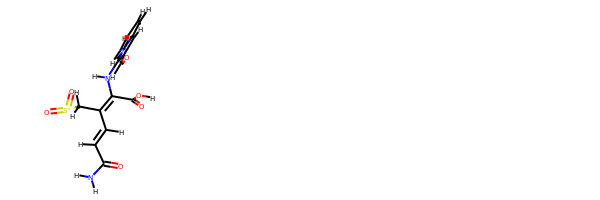

rdkit:  [H]OC(=O)C(=C(C([H])=C([H])C(=O)N([H])[H])C([H])([H])[S+](=O)=O)N([H])C1=C(C([H])=O)C([H])=C2C([H])=C([H])C([H])=C([H])N21
oechem:  c1ccn2c(c1)cc(c2N/C(=C(\C[S-](=O)=O)/C=C/C(=O)N)/C(=O)O)C=O
--------
Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       56 matches
                                               [#6X4:1]-[#6X4:2] :        6 matches
                                               [#6X4:1]-[#6X3:2] :        0 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        0 matches
                                               [#6X3:1]-[#6X3:2] :        0 matches
                                               [#6X3:1]:[#6X3:2] :        0 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        3 matches
                                        

                                  [*:1]-[#6X4:2]-[#8X2:3]-[#1:4] :        0 matches
                             [#6X4:1]-[#6X4:2]-[#8X2H1:3]-[#1:4] :        0 matches
                                 [*:1]-[#6X4:2]-[#8X2H0:3]-[*:4] :        9 matches
                           [#6X4:1]-[#6X4:2]-[#8X2H0:3]-[#6X4:4] :        0 matches
                             [#6X4:1]-[#6X4:2]-[#8X2:3]-[#6X3:4] :        0 matches
                             [#6X4:1]-[#8X2:2]-[#6X4:3]-[#8X2:4] :        0 matches
                             [#6X4:1]-[#8X2:2]-[#6X4:3]-[#7X3:4] :        0 matches
                      [#6X3:1]-[#8X2:2]-[#6X4;r3:3]-@[#6X4;r3:4] :        0 matches
                            [#6X3:1]-[#8X2:2]-[#6X4;r3:3]-[#1:4] :        0 matches
                              [#1:1]-[#8X2:2]-[#6X4;r3:3]-[#1:4] :        0 matches
                            [#1:1]-[#8X2:2]-[#6X4;r3:3]-[#6X4:4] :        0 matches
                         [#1:1]-[#8X2:2]-[#6X4;r3:3]-[#6X4;r3:4] :        0 

                                                          [#7:1] :        3 matches
                                                         [#16:1] :        0 matches
                                                         [#15:1] :        0 matches
                                                          [#9:1] :        0 matches
                                                         [#17:1] :        0 matches
                                                         [#35:1] :        0 matches
                                                         [#53:1] :        0 matches

Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       56 matches
                                               [#6X4:1]-[#6X4:2] :        6 matches
                                               [#6X4:1]-[#6X3:2] :        0 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        0 matc


PeriodicTorsionGenerator Propers:

                                         [*:1]~[*:2]~[*:3]~[*:4] :      120 matches
                                   [*:1]-[#6X4:2]-[#6X4:3]-[*:4] :       54 matches
                             [#6X4:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#1:4] :       24 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        4 matches
                             [#8X2:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        2 matches
                                 [#9:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                               [#17:1]-[#6X4:2]-[#6X4:3]-[#17:4] :        0 matches
                               [#35:1]-[#6X4:2]-[#6X4:3]-[#35:4] :        0 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        6 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                                [#1:1]-[

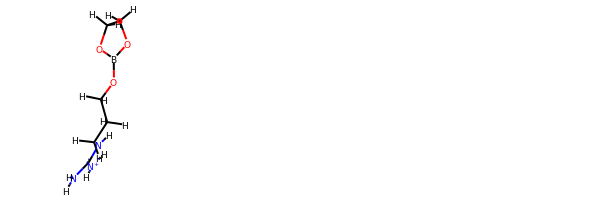

rdkit:  [H]N([H])C(N([H])C([H])([H])C([H])([H])C([H])([H])OB1OC([H])([H])C([H])([H])O1)=[N+]([H])[H]
oechem:  B1(OCCO1)OCCCNC(=[NH2+])N
--------
Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       66 matches
                                               [#6X4:1]-[#6X4:2] :        6 matches
                                               [#6X4:1]-[#6X3:2] :        1 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        1 matches
                                               [#6X3:1]-[#6X3:2] :        2 matches
                                               [#6X3:1]:[#6X3:2] :        0 matches
                                               [#6X3:1]=[#6X3:2] :        4 matches
                                                   [#6:1]-[#7:2] :        5 matches
                                               [#6X3:1]-[#7X3:2] :        2 matches
                    


PeriodicTorsionGenerator Propers:

                                         [*:1]~[*:2]~[*:3]~[*:4] :      156 matches
                                   [*:1]-[#6X4:2]-[#6X4:3]-[*:4] :       54 matches
                             [#6X4:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#1:4] :        0 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :       12 matches
                             [#8X2:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#9:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                               [#17:1]-[#6X4:2]-[#6X4:3]-[#17:4] :        0 matches
                               [#35:1]-[#6X4:2]-[#6X4:3]-[#35:4] :        0 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                                [#1:1]-[

NonbondedForceGenerator:

                                                           [*:1] :       33 matches
                                                          [#1:1] :       13 matches
                                                   [#1:1]-[#6X4] :        6 matches
                            [#1:1]-[#6X4]-[#7,#8,#9,#16,#17,#35] :        3 matches
   [#1:1]-[#6X4](-[#7,#8,#9,#16,#17,#35])-[#7,#8,#9,#16,#17,#35] :        0 matches
[#1:1]-[#6X4](-[#7,#8,#9,#16,#17,#35])(-[#7,#8,#9,#16,#17,#35])-[#7,#8,#9,#16,#17,#35] :        0 matches
                                         [#1:1]-[#6X4]~[*+1,*+2] :        0 matches
                                                   [#1:1]-[#6X3] :        5 matches
                            [#1:1]-[#6X3]~[#7,#8,#9,#16,#17,#35] :        4 matches
   [#1:1]-[#6X3](~[#7,#8,#9,#16,#17,#35])~[#7,#8,#9,#16,#17,#35] :        0 matches
                                                   [#1:1]-[#6X2] :        0 matches
                            

33 bonds added (0 skipped due to constraints)

HarmonicAngleGenerator:

                                               [*:1]~[*:2]~[*:3] :      108 matches
                                            [*:1]~[#6X4:2]-[*:3] :       48 matches
                                          [#1:1]-[#6X4:2]-[#1:3] :        8 matches
                                [*;r3:1]1~;@[*;r3:2]~;@[*;r3:3]1 :        0 matches
                                    [*;r3:1]~;@[*;r3:2]~;!@[*:3] :        0 matches
                                      [*:1]~;!@[*;r3:2]~;!@[*:3] :        0 matches
                                        [#1:1]-[*;r3:2]~;!@[*:3] :        0 matches
                                            [*:1]~[#6X3:2]~[*:3] :       36 matches
                                           [#1:1]-[#6X3:2]~[*:3] :       10 matches
                                          [#1:1]-[#6X3:2]-[#1:3] :        0 matches
                               [*;r6:1]~;@[*;r5:2]~;@[*;r5;x2:3] :        0 matches
    

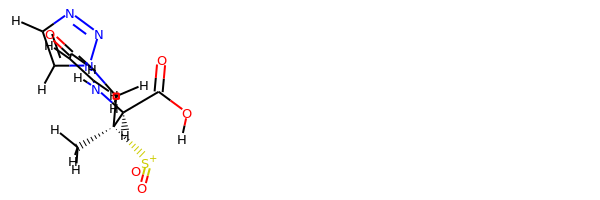

rdkit:  [H]OC(=O)[C@]([H])(N([H])C([H])=C([H])C([H])=O)[C@]([S+](=O)=O)(C([H])([H])[H])C([H])([H])N1N=NC([H])=C1[H]
oechem:  C[C@](Cn1ccnn1)([C@H](C(=O)O)N/C=C/C=O)[S-](=O)=O
--------
Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       38 matches
                                               [#6X4:1]-[#6X4:2] :        4 matches
                                               [#6X4:1]-[#6X3:2] :        0 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        0 matches
                                               [#6X3:1]-[#6X3:2] :        0 matches
                                               [#6X3:1]:[#6X3:2] :        0 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        3 matches
                                               [#6X3:1]-[#7X3:2] 


PeriodicTorsionGenerator Propers:

                                         [*:1]~[*:2]~[*:3]~[*:4] :       78 matches
                                   [*:1]-[#6X4:2]-[#6X4:3]-[*:4] :       36 matches
                             [#6X4:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#1:4] :       16 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        4 matches
                             [#8X2:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#9:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                               [#17:1]-[#6X4:2]-[#6X4:3]-[#17:4] :        0 matches
                               [#35:1]-[#6X4:2]-[#6X4:3]-[#35:4] :        0 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        2 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                                [#1:1]-[

Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       38 matches
                                               [#6X4:1]-[#6X4:2] :        4 matches
                                               [#6X4:1]-[#6X3:2] :        0 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        0 matches
                                               [#6X3:1]-[#6X3:2] :        0 matches
                                               [#6X3:1]:[#6X3:2] :        0 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        3 matches
                                               [#6X3:1]-[#7X3:2] :        2 matches
                               [#6X4:1]-[#7X3:2]-[#6X3]=[#8X1+0] :        0 matches
                                    [#6X3:1](=[#8X1+0])-[#7X3:2] :        0 match

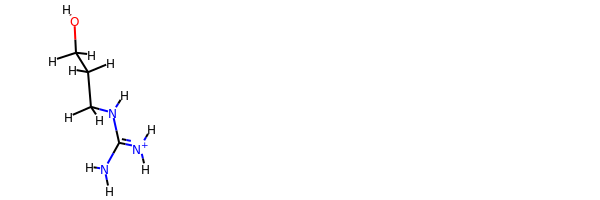

rdkit:  [H]OC([H])([H])C([H])([H])C([H])([H])N([H])C(N([H])[H])=[N+]([H])[H]
oechem:  C(CNC(=[NH2+])N)CO
--------
Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       66 matches
                                               [#6X4:1]-[#6X4:2] :        6 matches
                                               [#6X4:1]-[#6X3:2] :        1 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        1 matches
                                               [#6X3:1]-[#6X3:2] :        2 matches
                                               [#6X3:1]:[#6X3:2] :        0 matches
                                               [#6X3:1]=[#6X3:2] :        4 matches
                                                   [#6:1]-[#7:2] :        5 matches
                                               [#6X3:1]-[#7X3:2] :        2 matches
                               [#6X4:1]-[#7X3:2]-[#


NonbondedForceGenerator:

                                                           [*:1] :       33 matches
                                                          [#1:1] :       13 matches
                                                   [#1:1]-[#6X4] :        6 matches
                            [#1:1]-[#6X4]-[#7,#8,#9,#16,#17,#35] :        3 matches
   [#1:1]-[#6X4](-[#7,#8,#9,#16,#17,#35])-[#7,#8,#9,#16,#17,#35] :        0 matches
[#1:1]-[#6X4](-[#7,#8,#9,#16,#17,#35])(-[#7,#8,#9,#16,#17,#35])-[#7,#8,#9,#16,#17,#35] :        0 matches
                                         [#1:1]-[#6X4]~[*+1,*+2] :        0 matches
                                                   [#1:1]-[#6X3] :        5 matches
                            [#1:1]-[#6X3]~[#7,#8,#9,#16,#17,#35] :        4 matches
   [#1:1]-[#6X3](~[#7,#8,#9,#16,#17,#35])~[#7,#8,#9,#16,#17,#35] :        0 matches
                                                   [#1:1]-[#6X2] :        0 matches
                           


PeriodicTorsionGenerator Propers:

                                         [*:1]~[*:2]~[*:3]~[*:4] :      156 matches
                                   [*:1]-[#6X4:2]-[#6X4:3]-[*:4] :       54 matches
                             [#6X4:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#1:4] :        0 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :       12 matches
                             [#8X2:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#9:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                               [#17:1]-[#6X4:2]-[#6X4:3]-[#17:4] :        0 matches
                               [#35:1]-[#6X4:2]-[#6X4:3]-[#35:4] :        0 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                                [#1:1]-[

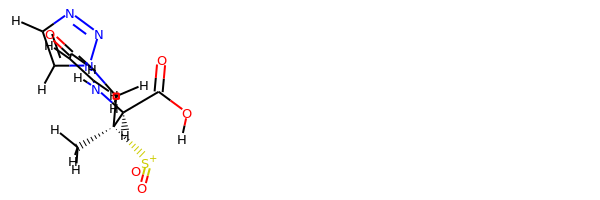

rdkit:  [H]OC(=O)[C@]([H])(N([H])C([H])=C([H])C([H])=O)[C@]([S+](=O)=O)(C([H])([H])[H])C([H])([H])N1N=NC([H])=C1[H]
oechem:  C[C@](Cn1ccnn1)([C@H](C(=O)O)N/C=C/C=O)[S-](=O)=O
--------
Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       66 matches
                                               [#6X4:1]-[#6X4:2] :        6 matches
                                               [#6X4:1]-[#6X3:2] :        2 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        1 matches
                                               [#6X3:1]-[#6X3:2] :        0 matches
                                               [#6X3:1]:[#6X3:2] :        0 matches
                                               [#6X3:1]=[#6X3:2] :        2 matches
                                                   [#6:1]-[#7:2] :        5 matches
                                               [#6X3:1]-[#7X3:2] 


PeriodicTorsionGenerator Propers:

                                         [*:1]~[*:2]~[*:3]~[*:4] :      150 matches
                                   [*:1]-[#6X4:2]-[#6X4:3]-[*:4] :       54 matches
                             [#6X4:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        2 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#1:4] :       20 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        7 matches
                             [#8X2:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#9:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                               [#17:1]-[#6X4:2]-[#6X4:3]-[#17:4] :        0 matches
                               [#35:1]-[#6X4:2]-[#6X4:3]-[#35:4] :        0 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                                [#1:1]-[

                                                   [#1:1]-[#6X2] :        0 matches
                                                     [#1:1]-[#7] :        6 matches
                                                     [#1:1]-[#8] :        1 matches
                                                    [#1:1]-[#16] :        0 matches
                                                          [#6:1] :        9 matches
                                                        [#6X2:1] :        0 matches
                                                        [#6X4:1] :        5 matches
                                                          [#8:1] :        2 matches
                                                    [#8X2H0+0:1] :        0 matches
                                                    [#8X2H1+0:1] :        1 matches
                                                          [#7:1] :        4 matches
                                                         [#16:1] :        0 


HarmonicAngleGenerator:

                                               [*:1]~[*:2]~[*:3] :      110 matches
                                            [*:1]~[#6X4:2]-[*:3] :       60 matches
                                          [#1:1]-[#6X4:2]-[#1:3] :        8 matches
                                [*;r3:1]1~;@[*;r3:2]~;@[*;r3:3]1 :        0 matches
                                    [*;r3:1]~;@[*;r3:2]~;!@[*:3] :        0 matches
                                      [*:1]~;!@[*;r3:2]~;!@[*:3] :        0 matches
                                        [#1:1]-[*;r3:2]~;!@[*:3] :        0 matches
                                            [*:1]~[#6X3:2]~[*:3] :       24 matches
                                           [#1:1]-[#6X3:2]~[*:3] :        6 matches
                                          [#1:1]-[#6X3:2]-[#1:3] :        2 matches
                               [*;r6:1]~;@[*;r5:2]~;@[*;r5;x2:3] :        0 matches
                                    [*:1]~;!@[*;r5

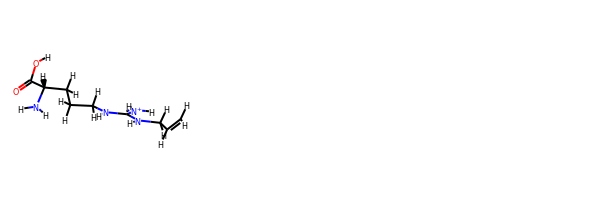

rdkit:  [H]OC(=O)[C@@]([H])(N([H])[H])C([H])([H])C([H])([H])C([H])([H])N([H])C(N([H])C([H])([H])C([H])=C([H])[H])=[N+]([H])[H]
oechem:  C=CC/[NH+]=C(\N)/NCCC[C@@H](C(=O)O)N
--------
Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       52 matches
                                               [#6X4:1]-[#6X4:2] :        6 matches
                                               [#6X4:1]-[#6X3:2] :        1 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        1 matches
                                               [#6X3:1]-[#6X3:2] :        0 matches
                                               [#6X3:1]:[#6X3:2] :        0 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        4 matches
                                               [#6X3:1]-[#7X3:2] : 


PeriodicTorsionGenerator Propers:

                                         [*:1]~[*:2]~[*:3]~[*:4] :      118 matches
                                   [*:1]-[#6X4:2]-[#6X4:3]-[*:4] :       54 matches
                             [#6X4:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        2 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#1:4] :       20 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        7 matches
                             [#8X2:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#9:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                               [#17:1]-[#6X4:2]-[#6X4:3]-[#17:4] :        0 matches
                               [#35:1]-[#6X4:2]-[#6X4:3]-[#35:4] :        0 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                                [#1:1]-[

Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       52 matches
                                               [#6X4:1]-[#6X4:2] :        6 matches
                                               [#6X4:1]-[#6X3:2] :        1 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        1 matches
                                               [#6X3:1]-[#6X3:2] :        0 matches
                                               [#6X3:1]:[#6X3:2] :        0 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        4 matches
                                               [#6X3:1]-[#7X3:2] :        2 matches
                               [#6X4:1]-[#7X3:2]-[#6X3]=[#8X1+0] :        0 matches
                                    [#6X3:1](=[#8X1+0])-[#7X3:2] :        0 match

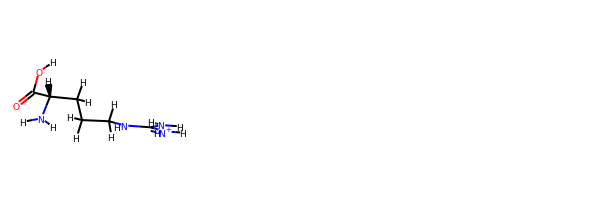

rdkit:  [H]OC(=O)[C@@]([H])(N([H])[H])C([H])([H])C([H])([H])C([H])([H])N([H])C(N([H])[H])=[N+]([H])[H]
oechem:  C(C[C@@H](C(=O)O)N)CNC(=[NH2+])N
--------
Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :      108 matches
                                               [#6X4:1]-[#6X4:2] :       16 matches
                                               [#6X4:1]-[#6X3:2] :        3 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        3 matches
                                               [#6X3:1]-[#6X3:2] :        0 matches
                                               [#6X3:1]:[#6X3:2] :        0 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        7 matches
                                               [#6X3:1]-[#7X3:2] :        4 matches
           

                                 [*:1]-[#6X4:2]-[#8X2H0:3]-[*:4] :        0 matches
                           [#6X4:1]-[#6X4:2]-[#8X2H0:3]-[#6X4:4] :        0 matches
                             [#6X4:1]-[#6X4:2]-[#8X2:3]-[#6X3:4] :        0 matches
                             [#6X4:1]-[#8X2:2]-[#6X4:3]-[#8X2:4] :        0 matches
                             [#6X4:1]-[#8X2:2]-[#6X4:3]-[#7X3:4] :        0 matches
                      [#6X3:1]-[#8X2:2]-[#6X4;r3:3]-@[#6X4;r3:4] :        0 matches
                            [#6X3:1]-[#8X2:2]-[#6X4;r3:3]-[#1:4] :        0 matches
                              [#1:1]-[#8X2:2]-[#6X4;r3:3]-[#1:4] :        0 matches
                            [#1:1]-[#8X2:2]-[#6X4;r3:3]-[#6X4:4] :        0 matches
                         [#1:1]-[#8X2:2]-[#6X4;r3:3]-[#6X4;r3:4] :        0 matches
                                   [*:1]~[#6X3:2]-[#8X2:3]-[*:4] :        2 matches
                                  [*:1]~[#6X3:2]-[#8X2:3]-[#1:4] :        2 

Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :      108 matches
                                               [#6X4:1]-[#6X4:2] :       16 matches
                                               [#6X4:1]-[#6X3:2] :        3 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        3 matches
                                               [#6X3:1]-[#6X3:2] :        0 matches
                                               [#6X3:1]:[#6X3:2] :        0 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        7 matches
                                               [#6X3:1]-[#7X3:2] :        4 matches
                               [#6X4:1]-[#7X3:2]-[#6X3]=[#8X1+0] :        2 matches
                                    [#6X3:1](=[#8X1+0])-[#7X3:2] :        2 match

                   [*:1]-[#6X4:2]-[#7X3$(*~[#6X3,#6X2]):3]~[*:4] :       18 matches
                     [*:1]-[#6X4:2]-[#7X3$(*~[#8X1]):3]~[#8X1:4] :        0 matches
                             [#6X3:1]-[#7X3:2]-[#6X4:3]-[#6X3:4] :        1 matches
                 [#6X4:1]-[#6X4:2]-[#7X3:3]-[#6X3:4]=[#8,#16,#7] :        3 matches
                           [#8X2H0:1]-[#6X4:2]-[#7X3:3]-[#6X3:4] :        0 matches
                       [#6X3:1]-[#7X3:2]-[#6X4;r3:3]-[#6X4;r3:4] :        0 matches
                                   [*:1]~[#7X2:2]-[#6X4:3]-[*:4] :        0 matches
                        [#6X3:1]=[#7X2,#7X3+1:2]-[#6X4:3]-[#1:4] :        0 matches
                 [#6X3:1]=[#7X2,#7X3+1:2]-[#6X4:3]-[#6X3,#6X4:4] :        0 matches
                            [*:1]~[#7X3,#7X2-1:2]-[#6X3:3]~[*:4] :       16 matches
                          [*:1]~[#7X3,#7X2-1:2]-!@[#6X3:3]~[*:4] :       16 matches
                          [#1:1]-[#7X3:2]-[#6X3:3]=[#8,#16,#7:4] :        5 

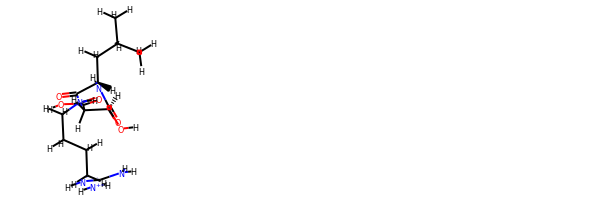

rdkit:  [H]OC(=O)C([H])([H])[C@]([H])(O[H])C(=O)N([H])[C@]([H])(C(=O)N([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])N([H])C(N([H])[H])=[N+]([H])[H])C([H])([H])C([H])(C([H])([H])[H])C([H])([H])[H]
oechem:  CC(C)C[C@@H](C(=O)NCCCCNC(=[NH2+])N)NC(=O)[C@H](CC(=O)O)O
--------
Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       24 matches
                                               [#6X4:1]-[#6X4:2] :        2 matches
                                               [#6X4:1]-[#6X3:2] :        1 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        1 matches
                                               [#6X3:1]-[#6X3:2] :        2 matches
                                               [#6X3:1]:[#6X3:2] :        0 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-

                               [*:1]-,:[#6X3:2]=[#6X3:3]-,:[*:4] :        0 matches
                             [#6X4:1]-[#6X3:2]=[#6X3:3]-[#6X4:4] :        0 matches
                   [*:1]~[#6X3:2]-[#6X3$(*=[#8,#16,#7]):3]~[*:4] :        8 matches
                             [#6X3:1]=[#6X3:2]-[#6X3:3]=[#8X1:4] :        0 matches
                                     [*:1]~[#7a:2]:[#6a:3]~[*:4] :        0 matches
                                   [*:1]-[#6X4:2]-[#7X4:3]-[*:4] :        0 matches
                                   [*:1]-[#6X4:2]-[#7X3:3]-[*:4] :        0 matches
                        [#6X4:1]-[#6X4:2]-[#7X4,#7X3:3]-[#6X4:4] :        0 matches
                           [*:1]-[#7X4,#7X3:2]-[#6X4;r3:3]-[*:4] :        0 matches
                          [#1:1]-[#7X4,#7X3:2]-[#6X4;r3:3]-[*:4] :        0 matches
                    [#1:1]-[#7X4,#7X3:2]-[#6X4;r3:3]-[#6X4;r3:4] :        0 matches
                          [!1:1]-[#7X4,#7X3:2]-[#6X4;r3:3]-[*:4] :        0 

Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       24 matches
                                               [#6X4:1]-[#6X4:2] :        2 matches
                                               [#6X4:1]-[#6X3:2] :        1 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        1 matches
                                               [#6X3:1]-[#6X3:2] :        2 matches
                                               [#6X3:1]:[#6X3:2] :        0 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        0 matches
                                               [#6X3:1]-[#7X3:2] :        0 matches
                               [#6X4:1]-[#7X3:2]-[#6X3]=[#8X1+0] :        0 matches
                                    [#6X3:1](=[#8X1+0])-[#7X3:2] :        0 match

                                 [#9:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                               [#17:1]-[#6X4:2]-[#6X4:3]-[#17:4] :        0 matches
                               [#35:1]-[#6X4:2]-[#6X4:3]-[#35:4] :        0 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                                [#1:1]-[#6X4:2]-[#6X4:3]-[#17:4] :        0 matches
                                [#1:1]-[#6X4:2]-[#6X4:3]-[#35:4] :        0 matches
                                [*:1]-[#6X4:2]-[#6X4;r3:3]-[*:4] :        0 matches
                          [*:1]-[#6X4:2]-[#6X4;r3:3]-[#6X4;r3:4] :        0 matches
                            [*:1]-[#6X4;r3:2]-@[#6X4;r3:3]-[*:4] :        0 matches
                       [#6X4;r3:1]-[#6X4;r3:2]-[#6X4;r3:3]-[*:4] :        0 matches
                                   [*:1]~[#6X3:2]-[#6X4:3]-[*:4] :        6 

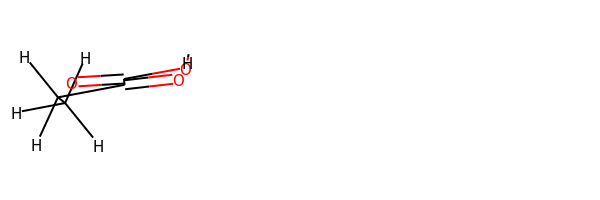

rdkit:  [H]OC(=O)C(=O)C([H])([H])C([H])([H])[H]
oechem:  CCC(=O)C(=O)O
--------
Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :      120 matches
                                               [#6X4:1]-[#6X4:2] :        8 matches
                                               [#6X4:1]-[#6X3:2] :        2 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        2 matches
                                               [#6X3:1]-[#6X3:2] :        4 matches
                                               [#6X3:1]:[#6X3:2] :       12 matches
                                               [#6X3:1]=[#6X3:2] :        2 matches
                                                   [#6:1]-[#7:2] :       13 matches
                                               [#6X3:1]-[#7X3:2] :        7 matches
                               [#6X4:1]-[#7X3:2]-[#6X3]=[#8X1+0] :        1 matches
 


PeriodicTorsionGenerator Propers:

                                         [*:1]~[*:2]~[*:3]~[*:4] :      300 matches
                                   [*:1]-[#6X4:2]-[#6X4:3]-[*:4] :       72 matches
                             [#6X4:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#1:4] :       20 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        7 matches
                             [#8X2:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#9:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                               [#17:1]-[#6X4:2]-[#6X4:3]-[#17:4] :        0 matches
                               [#35:1]-[#6X4:2]-[#6X4:3]-[#35:4] :        0 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                                [#1:1]-[

Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :      120 matches
                                               [#6X4:1]-[#6X4:2] :        8 matches
                                               [#6X4:1]-[#6X3:2] :        2 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        2 matches
                                               [#6X3:1]-[#6X3:2] :        4 matches
                                               [#6X3:1]:[#6X3:2] :       12 matches
                                               [#6X3:1]=[#6X3:2] :        2 matches
                                                   [#6:1]-[#7:2] :       13 matches
                                               [#6X3:1]-[#7X3:2] :        7 matches
                               [#6X4:1]-[#7X3:2]-[#6X3]=[#8X1+0] :        1 matches
                                    [#6X3:1](=[#8X1+0])-[#7X3:2] :        1 match


                                         [*:1]~[*:2]~[*:3]~[*:4] :      300 matches
                                   [*:1]-[#6X4:2]-[#6X4:3]-[*:4] :       72 matches
                             [#6X4:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#1:4] :       20 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        7 matches
                             [#8X2:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#9:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                               [#17:1]-[#6X4:2]-[#6X4:3]-[#17:4] :        0 matches
                               [#35:1]-[#6X4:2]-[#6X4:3]-[#35:4] :        0 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                                [#1:1]-[#6X4:2]-[#6X4:3]-[#17:4] :        0

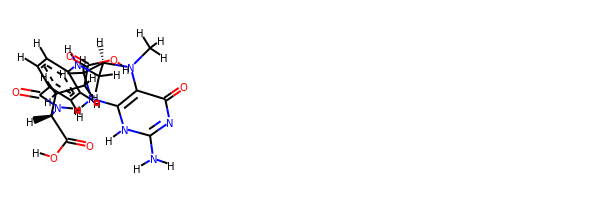

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])[C@@]([H])(C(=O)O[H])N([H])C(=O)c1c([H])c([H])c(N([H])C([H])([H])[C@]2([H])N(C([H])([H])[H])C3=C(N([H])C(N([H])[H])=NC3=O)N([H])C2([H])[H])c([H])c1[H]
oechem:  CN1c2c([nH]c(nc2=O)N)NC[C@@H]1CNc3ccc(cc3)C(=O)N[C@@H](CCC(=O)O)C(=O)O
--------
Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :        4 matches
                                               [#6X4:1]-[#6X4:2] :        0 matches
                                               [#6X4:1]-[#6X3:2] :        0 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        0 matches
                                               [#6X3:1]-[#6X3:2] :        0 matches
                                               [#6X3:1]:[#6X3:2] :        0 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6


PeriodicTorsionGenerator Propers:

                                         [*:1]~[*:2]~[*:3]~[*:4] :        0 matches
                                   [*:1]-[#6X4:2]-[#6X4:3]-[*:4] :        0 matches
                             [#6X4:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#1:4] :        0 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        0 matches
                             [#8X2:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#9:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                               [#17:1]-[#6X4:2]-[#6X4:3]-[#17:4] :        0 matches
                               [#35:1]-[#6X4:2]-[#6X4:3]-[#35:4] :        0 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                                [#1:1]-[

Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :        4 matches
                                               [#6X4:1]-[#6X4:2] :        0 matches
                                               [#6X4:1]-[#6X3:2] :        0 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        0 matches
                                               [#6X3:1]-[#6X3:2] :        0 matches
                                               [#6X3:1]:[#6X3:2] :        0 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        0 matches
                                               [#6X3:1]-[#7X3:2] :        0 matches
                               [#6X4:1]-[#7X3:2]-[#6X3]=[#8X1+0] :        0 matches
                                    [#6X3:1](=[#8X1+0])-[#7X3:2] :        0 match

                          [#1:1]-[#7X4,#7X3:2]-[#6X4;r3:3]-[*:4] :        0 matches
                    [#1:1]-[#7X4,#7X3:2]-[#6X4;r3:3]-[#6X4;r3:4] :        0 matches
                          [!1:1]-[#7X4,#7X3:2]-[#6X4;r3:3]-[*:4] :        0 matches
                   [!#1:1]-[#7X4,#7X3:2]-[#6X4;r3:3]-[#6X4;r3:4] :        0 matches
                                   [*:1]-[#7X4:2]-[#6X3:3]~[*:4] :        0 matches
                   [*:1]-[#6X4:2]-[#7X3$(*~[#6X3,#6X2]):3]~[*:4] :        0 matches
                     [*:1]-[#6X4:2]-[#7X3$(*~[#8X1]):3]~[#8X1:4] :        0 matches
                             [#6X3:1]-[#7X3:2]-[#6X4:3]-[#6X3:4] :        0 matches
                 [#6X4:1]-[#6X4:2]-[#7X3:3]-[#6X3:4]=[#8,#16,#7] :        0 matches
                           [#8X2H0:1]-[#6X4:2]-[#7X3:3]-[#6X3:4] :        0 matches
                       [#6X3:1]-[#7X3:2]-[#6X4;r3:3]-[#6X4;r3:4] :        0 matches
                                   [*:1]~[#7X2:2]-[#6X4:3]-[*:4] :        0 

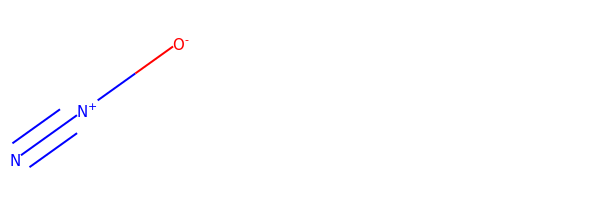

rdkit:  N#[N+][O-]
oechem:  N#[N+]O
--------
Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :      128 matches
                                               [#6X4:1]-[#6X4:2] :       14 matches
                                               [#6X4:1]-[#6X3:2] :        5 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        4 matches
                                               [#6X3:1]-[#6X3:2] :        0 matches
                                               [#6X3:1]:[#6X3:2] :       12 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        9 matches
                                               [#6X3:1]-[#7X3:2] :        4 matches
                               [#6X4:1]-[#7X3:2]-[#6X3]=[#8X1+0] :        3 matches
                                    

                                           [*:1]~[#16X4:2]~[*:3] :        0 matches
                                   [*:1]-[#16X4,#16X3+0:2]-[*:3] :        0 matches
                           [*:1]~[#16X3$(*~[#8X1,#7X2]):2]~[*:3] :        0 matches
                                   [*:1]~[#16X2,#16X3+1:2]~[*:3] :        0 matches
                                           [*:1]=[#16X2:2]=[*:3] :        0 matches
                                     [#6X3:1]-[#16X2:2]-[#6X3:3] :        0 matches
                                     [#6X3:1]-[#16X2:2]-[#6X4:3] :        0 matches
                                       [#6X3:1]-[#16X2:2]-[#1:3] :        0 matches
                                             [*:1]~[#15:2]~[*:3] :        0 matches

114 angles added

PeriodicTorsionGenerator Propers:

                                         [*:1]~[*:2]~[*:3]~[*:4] :      334 matches
                                   [*:1]-[#6X4:2]-[#6X4:3]-[*:4] :      126 matches
                      

Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :      128 matches
                                               [#6X4:1]-[#6X4:2] :       14 matches
                                               [#6X4:1]-[#6X3:2] :        5 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        4 matches
                                               [#6X3:1]-[#6X3:2] :        0 matches
                                               [#6X3:1]:[#6X3:2] :       12 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        9 matches
                                               [#6X3:1]-[#7X3:2] :        4 matches
                               [#6X4:1]-[#7X3:2]-[#6X3]=[#8X1+0] :        3 matches
                                    [#6X3:1](=[#8X1+0])-[#7X3:2] :        2 match

                                         [*:1]~[*:2]~[*:3]~[*:4] :      334 matches
                                   [*:1]-[#6X4:2]-[#6X4:3]-[*:4] :      126 matches
                             [#6X4:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        4 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#1:4] :       44 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :       14 matches
                             [#8X2:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#9:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                               [#17:1]-[#6X4:2]-[#6X4:3]-[#17:4] :        0 matches
                               [#35:1]-[#6X4:2]-[#6X4:3]-[#35:4] :        0 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                                [#1:1]-[#6X4:2]-[#6X4:3]-[#17:4] :        0 

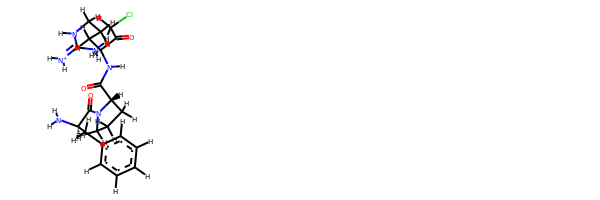

rdkit:  [H]c1c([H])c([H])c(C([H])([H])[C@]([H])(C(=O)N2C([H])([H])C([H])([H])C([H])([H])[C@@]2([H])C(=O)N([H])[C@]([H])(C(=O)C([H])([H])Cl)C([H])([H])C([H])([H])C([H])([H])N([H])C(N([H])[H])=[N+]([H])[H])N([H])[H])c([H])c1[H]
oechem:  c1ccc(cc1)C[C@H](C(=O)N2CCC[C@H]2C(=O)N[C@@H](CCCNC(=[NH2+])N)C(=O)CCl)N
--------
Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       42 matches
                                               [#6X4:1]-[#6X4:2] :        0 matches
                                               [#6X4:1]-[#6X3:2] :        2 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        1 matches
                                               [#6X3:1]-[#6X3:2] :        2 matches
                                               [#6X3:1]:[#6X3:2] :       12 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                


PeriodicTorsionGenerator Propers:

                                         [*:1]~[*:2]~[*:3]~[*:4] :       88 matches
                                   [*:1]-[#6X4:2]-[#6X4:3]-[*:4] :        0 matches
                             [#6X4:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#1:4] :        0 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        0 matches
                             [#8X2:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#9:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                               [#17:1]-[#6X4:2]-[#6X4:3]-[#17:4] :        0 matches
                               [#35:1]-[#6X4:2]-[#6X4:3]-[#35:4] :        0 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                                [#1:1]-[

Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       42 matches
                                               [#6X4:1]-[#6X4:2] :        0 matches
                                               [#6X4:1]-[#6X3:2] :        2 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        1 matches
                                               [#6X3:1]-[#6X3:2] :        2 matches
                                               [#6X3:1]:[#6X3:2] :       12 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        0 matches
                                               [#6X3:1]-[#7X3:2] :        0 matches
                               [#6X4:1]-[#7X3:2]-[#6X3]=[#8X1+0] :        0 matches
                                    [#6X3:1](=[#8X1+0])-[#7X3:2] :        0 match

                                    [*:1]~;!@[*;r5:2]~;@[*;r5:3] :        0 matches
                                        [#8X1:1]~[#6X3:2]~[#8:3] :        1 matches
                                            [*:1]~[#6X2:2]~[*:3] :        0 matches
                                [*:1]-[#7X4,#7X3,#7X2-1:2]-[*:3] :        0 matches
                               [#1:1]-[#7X4,#7X3,#7X2-1:2]-[*:3] :        0 matches
                     [*:1]~[#7X3$(*~[#6X3,#6X2,#7X2+0]):2]~[*:3] :        0 matches
                    [#1:1]-[#7X3$(*~[#6X3,#6X2,#7X2+0]):2]-[*:3] :        0 matches
                                            [*:1]~[#7X2:2]~[*:3] :        0 matches
                                          [*:1]~[#7X2+0:2]~[*:3] :        0 matches
                                         [#1:1]-[#7X2+0:2]~[*:3] :        0 matches
                         [#6,#7,#8:1]-[#7X3:2](~[#8X1])~[#8X1:3] :        0 matches
                                      [#8X1:1]~[#7X3:2]~[#8X1:3] :        0 

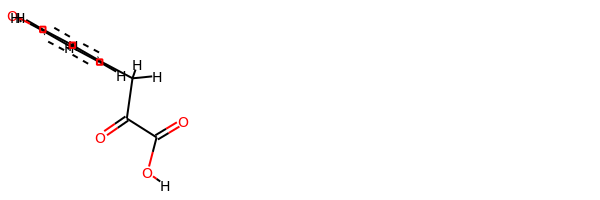

rdkit:  [H]OC(=O)C(=O)C([H])([H])c1c([H])c([H])c(O[H])c([H])c1[H]
oechem:  c1cc(ccc1CC(=O)C(=O)O)O
--------


In [11]:
def compare_energies(rdkmol, oemol):
    if rdkmol == None:
        print("RDK parsing error")
        return False
#     print(Chem.MolToSmiles(rdkmol))
    positions_rdk = extractPositionsFromRDKMol(rdkmol)
    forcefield = smirnoff.forcefield_rdk.ForceField(ff_filename)
    topology_rdk = smirnoff.forcefield_rdk.generateTopologyFromRDKMol(rdkmol)
    system_rdk = forcefield.createSystem(topology_rdk, [rdkmol], verbose = True)
    
    positions_oe = extractPositionsFromOEMol(oemol)
    forcefield = smirnoff.forcefield.ForceField(ff_filename)
    topology_oe = smirnoff.forcefield.generateTopologyFromOEMol(oemol)
    system_oe = forcefield.createSystem(topology_oe, [oemol], verbose = True)

    g1,g2,e1,e2 = smirnoff.forcefield_utils.compare_system_energies(topology_oe, topology_rdk, system_oe, system_rdk, positions_oe, positions_rdk, verbose = False,skip_assert = True)
#     g1,g2,e1,e2 = smirnoff.forcefield_utils.compare_system_energies(topology_oe, topology_oe, system_oe, system_oe, positions_oe, positions_oe, verbose = False,skip_assert = True)
    if(e1 == e2): return False
    for i in g1:
        print(i)
        print(g1[i], g2[i], g1[i] == g2[i])

    print( e1, e2)
    print('')
    return True

#mol_filename = os.path.dirname(os.path.abspath(os.path.join('..'))) + "openforcefield/data/molecules/zinc-subset-tripos.mol2.gz"
mol_filename = "/home/shuwang/remove_oeimplicityHydrogen.mol2"
    
istream = oechem.oemolistream(mol_filename)
mol = oechem.OEMol()
flavor = oechem.OEIFlavor_Generic_Default | oechem.OEIFlavor_MOL2_Default | oechem.OEIFlavor_MOL2_Forcefield
istream.SetFlavor( oechem.OEFormat_MOL2, flavor)
oemols_tripos = []
while oechem.OEReadMolecule(istream, mol):
    oechem.OETriposAtomNames(mol)
    oemols_tripos.append(oechem.OEMol(mol))
istream.close()


counter = 0
writer = Chem.SDWriter('/home/shuwang/out.sdf')
for mol2 in RetrieveMol2Block(open(mol_filename, "r")):
#     rdkmol = Chem.MolFromMol2Block(mol2, sanitize = True, removeHs = False)
    rdkmol = Chem.MolFromMol2Block(mol2, sanitize = False, removeHs = False)
#     Chem.Kekulize(rdkmol)
    writeToFile = compare_energies(rdkmol, oemols_tripos[counter])
    counter += 1

    
    print(Chem.MolToMolBlock(rdkmol)[0:21])
    x = Draw.MolsToGridImage([rdkmol], kekulize = False)
    display(x)
    print("rdkit: ", Chem.MolToSmiles(rdkmol, isomericSmiles = True))
    print("oechem: ", OEMolToSmiles(oemols_tripos[counter-1]))
    print("--------")
    writer.write(rdkmol)


# reading from sdf file

In [78]:
def compare_energies(rdkmol, oemol):
    if rdkmol == None:
        print("RDK parsing error")
        return False
#     print(Chem.MolToSmiles(rdkmol))
    positions_rdk = extractPositionsFromRDKMol(rdkmol)
    forcefield = smirnoff.forcefield_rdk.ForceField(ff_filename)
    topology_rdk = smirnoff.forcefield_rdk.generateTopologyFromRDKMol(rdkmol)
    system_rdk = forcefield.createSystem(topology_rdk, [rdkmol], verbose = False)
    
    positions_oe = extractPositionsFromOEMol(oemol)
    forcefield = smirnoff.forcefield.ForceField(ff_filename)
    topology_oe = smirnoff.forcefield.generateTopologyFromOEMol(oemol)
    system_oe = forcefield.createSystem(topology_oe, [oemol], verbose = False)

    g1,g2,e1,e2 = smirnoff.forcefield_utils.compare_system_energies(topology_oe, topology_rdk, system_oe, system_rdk, positions_oe, positions_rdk, verbose = False,skip_assert = True)
#     g1,g2,e1,e2 = smirnoff.forcefield_utils.compare_system_energies(topology_oe, topology_oe, system_oe, system_oe, positions_oe, positions_oe, verbose = False,skip_assert = True)
    if(e1 == e2): return False
    for i in g1:
        print(i)
        print(g1[i], g2[i], g1[i] == g2[i])

    print( e1, e2)
    print('')
    return True

#mol_filename = os.path.dirname(os.path.abspath(os.path.join('..'))) + "openforcefield/data/molecules/zinc-subset-tripos.mol2.gz"
mol_filename = "/home/shuwang/remove_oeimplicityHydrogen.mol2"
    
istream = oechem.oemolistream(mol_filename)
mol = oechem.OEMol()
flavor = oechem.OEIFlavor_Generic_Default | oechem.OEIFlavor_MOL2_Default | oechem.OEIFlavor_MOL2_Forcefield
istream.SetFlavor( oechem.OEFormat_MOL2, flavor)
oemols_tripos = []
while oechem.OEReadMolecule(istream, mol):
    oechem.OETriposAtomNames(mol)
    oemols_tripos.append(oechem.OEMol(mol))
istream.close()



# ofs = oemolostream("/home/shuwang/out.sdf")
# ofs.SetFormat(OEFormat_SDF)


counter = 0
suppl = Chem.SDMolSupplier('/home/shuwang/out.sdf',   removeHs = False, sanitize = False)

for mol2 in suppl:
    
# for mol2 in RetrieveMol2Block(open(mol_filename, "r")):
    print(counter)
    rdkmol = mol2
#     rdkmol = suppl[0]
    

#     x = Draw.MolsToGridImage([rdkmol], kekulize = False)
#     display(x)
    try:
        rdkmol.UpdatePropertyCache(strict=False)
        Chem.GetSSSR(rdkmol)
        compare_energies(rdkmol, oemols_tripos[counter])
    except( ValueError):
        print("error")
        
            
    
#     OEWriteMolecule(ofs, oemols_tripos[counter])
    counter += 1
    
    
    

    
#     print(Chem.MolToMolBlock(rdkmol)[0:21])
#     x = Draw.MolsToGridImage([rdkmol], kekulize = False)
#     display(x)
#     print("rdkit: ", Chem.MolToSmiles(rdkmol, isomericSmiles = True))
#     print("oechem: ", OEMolToSmiles(oemols_tripos[counter-1]))
    print("--------")

# ofs.close()


0
bond
29964.783608035767 kJ/mol 30023.58905328971 kJ/mol False
angle
12.021409253648924 kJ/mol 12.021409253648924 kJ/mol True
nb
46.05461517642205 kJ/mol 46.05461517642205 kJ/mol True
torsion
46.60303346889985 kJ/mol 40.914760653353156 kJ/mol False
30069.462665934734 kJ/mol 30122.57983837313 kJ/mol

--------
1
--------
2
--------
3
bond
11.724343006813776 kJ/mol 11.724343006813776 kJ/mol True
angle
40.14816650649524 kJ/mol 40.14816650649524 kJ/mol True
nb
9.748261628391385 kJ/mol 9.748261628391385 kJ/mol True
torsion
16.168414222156553 kJ/mol 16.16841422215655 kJ/mol False
77.78918536385696 kJ/mol 77.78918536385694 kJ/mol

--------
4
--------
5
bond
41.90370436315399 kJ/mol 95.76784233315347 kJ/mol False
angle
80.49804847656618 kJ/mol 80.49804847656618 kJ/mol True
nb
81.08324528905254 kJ/mol 81.08324528905254 kJ/mol True
torsion
8.066930905144714 kJ/mol 28.963619988427748 kJ/mol False
211.55192903391742 kJ/mol 286.31275608719994 kJ/mol

--------
6
bond
29.942412908103822 kJ/mol 57.908

AttributeError: 'NoneType' object has no attribute 'UpdatePropertyCache'

In [32]:
mol_filename = os.path.dirname(os.path.abspath(os.path.join('..'))) + "/openforcefield/data/molecules/DrugBank_tripos.mol2"
    
istream = oechem.oemolistream(mol_filename)
mol = oechem.OEMol()
# flavor = oechem.OEIFlavor_Generic_Default | oechem.OEIFlavor_MOL2_Default | oechem.OEIFlavor_MOL2_Forcefield
# istream.SetFlavor( oechem.OEFormat_MOL2, flavor)
oemols_tripos = []
while oechem.OEReadMolecule(istream, mol):
    oechem.OETriposAtomNames(mol)
    oemols_tripos.append(oechem.OEMol(mol))
istream.close()
# print(oemols_tripos[0])
for atom in oemols_tripos[0].GetAtoms():
    print(atom.GetPartialCharge())

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0


In [7]:
def oemol_to_rdkmol(topology, positions, verbose=True):
    """
    This function converts an OpenMM topology in an OEMol
    Parameters:
    -----------
    topology : OpenMM Topology
        The OpenMM topology
    positions : OpenMM Quantity
        The molecule atom positions associated with the
        topology
    verbose: Bool
        print or not information
    Return:
    -------
    oe_mol : OEMol
        The generated OEMol molecule
    """

    # Create an empty OEMol
    oe_mol = oechem.OEMol()

    # Mapping dictionary between openmm atoms and oe atoms
    openmm_atom_to_oe_atom = {}

    # Python set used to identify atoms that are not in protein residues
    keep = set(proteinResidues).union(dnaResidues).union(rnaResidues)

    for chain in topology.chains():
        for res in chain.residues():
            # Create an OEResidue
            oe_res = oechem.OEResidue()
            # Set OEResidue name
            oe_res.SetName(res.name)
            # If the atom is not a protein atom then set its heteroatom
            # flag to True
            if res.name not in keep:
                oe_res.SetFragmentNumber(chain.index + 1)
                oe_res.SetHetAtom(True)
            # Set OEResidue Chain ID
            oe_res.SetChainID(chain.id)
            # res_idx = int(res.id) - chain.index * len(chain._residues)
            # Set OEResidue number
            oe_res.SetResidueNumber(int(res.id))

            for openmm_at in res.atoms():
                # Create an OEAtom  based on the atomic number
                oe_atom = oe_mol.NewAtom(openmm_at.element._atomic_number)
                # Set atom name
                oe_atom.SetName(openmm_at.name)
                # Set Symbol
                oe_atom.SetType(openmm_at.element.symbol)
                # Set Atom index
                oe_res.SetSerialNumber(openmm_at.index + 1)
                # Commit the changes
                oechem.OEAtomSetResidue(oe_atom, oe_res)
                # Update the dictionary OpenMM to OE
                openmm_atom_to_oe_atom[openmm_at] = oe_atom

    if topology.getNumAtoms() != oe_mol.NumAtoms():
        oechem.OEThrow.Fatal("OpenMM topology and OEMol number of atoms mismatching: "
                             "OpenMM = {} vs OEMol  = {}".format(topology.GetNumAtoms(), oe_mol.NumAtoms()))

    # Count the number of bonds in the openmm topology
    omm_bond_count = 0

    # Create the bonds
    for bond in topology.bonds():

        omm_bond_count += 1

        at0 = bond[0]
        at1 = bond[1]
        # Read in the bond order from the OpenMM topology
        bond_order = bond.order

        # If bond order info are not present set the bond order to one
        if not bond_order:
            if verbose:
                print("WARNING: Bond order info missing between atom indexes: {}-{}".format(at0.index, at1.index))
            bond_order = 1

        # OE atoms
        oe_atom0 = openmm_atom_to_oe_atom[at0]
        oe_atom1 = openmm_atom_to_oe_atom[at1]

        # Set OE atom aromaticity
        if bond.type:
            oe_atom0.SetAromatic(True)
            oe_atom1.SetAromatic(True)

        # Create the bond
        oe_bond = oe_mol.NewBond(oe_atom0, oe_atom1, bond_order)

        if bond.type:
            oe_bond.SetAromatic(True)

    if omm_bond_count != oe_mol.NumBonds():
        oechem.OEThrow.Fatal("OpenMM topology and OEMol number of bonds mismatching: "
                             "OpenMM = {} vs OEMol  = {}".format(omm_bond_count, oe_mol.NumBonds()))

    # Set the OEMol positions
    pos = positions.in_units_of(unit.angstrom) / unit.angstrom
    pos = list(itertools.chain.from_iterable(pos))
    oe_mol.SetCoords(pos)

    return oe_mol

def oemol_to_rdkmol(oemol, verbose=True):
    """
    This function converts an OpenMM topology in an OEMol
    Parameters:
    -----------
    oemol : OpenEye Moleulce
    verbose: Bool
        print or not information
    Return:
    -------
    rdkmol :
        The generated RDKit molecule
    """
    _bondtypes = {1: Chem.BondType.SINGLE,
                  1.5: Chem.BondType.AROMATIC,
                  2: Chem.BondType.DOUBLE,
                  3: Chem.BondType.TRIPLE,
                  4: Chem.BondType.QUADRUPLE,
                  5: Chem.BondType.QUINTUPLE,
                  6: Chem.BondType.HEXTUPLE,
                  7: Chem.BondType.ONEANDAHALF,}
    # Create an empty OEMol
    rdkmol = Chem.RWMol()

    # Mapping dictionary between openmm atoms and oe atoms
    # oe_atom_to_rdk_atom = {}

    for atom in oemol.GetAtoms():
        rdkatom = Chem.Atom(atom.GetAtomicNum())
        # Charging
        rdkatom.SetFormalCharge(atom.GetFormalCharge())
        # Aromatic handling
        if atom.IsAromatic():
            rdkatom.SetIsAromatic(True)
        rdkmol.AddAtom(rdkatom)
        # oe_atom_to_rdk_atom[atom] = rdkatom
        # oe_atom_to_rdk_atom[atom.GetIdx()] = rdkatom

    if oemol.NumAtoms() != rdkmol.GetNumAtoms():
        raise ValueError("RDKMol and OEMol number of atoms mismatching: "
                             "RDKMol = {} vs OEMol  = {}".format(rdkmol.GetNumAtoms(), oemol.NumAtoms()))

    for idx,bond in enumerate(oemol.GetBonds()):
        # Get atom indices involved in bond
        at1 = bond.GetBgn().GetIdx()
        at2 = bond.GetEnd().GetIdx()

        # Get bond ordr
        order = bond.GetOrder()

        # If bond order info are not present set the bond order to one
        if not order:
            if verbose:
                print("WARNING: Bond order info missing between atom indexes: {}-{}".format(at1, at2))
            order = 1
        # Aromatic handling
        elif bond.IsAromatic():
            order = 1.5

        rdkmol.AddBond(at1, at2, _bondtypes[order])

    if oemol.NumBonds() != rdkmol.GetNumBonds():
        raise ValueError("RDKMol and OEMol number of bonds mismatching: "
                             "RDKMol = {} vs OEMol  = {}".format(rdkmol.GetNumBonds, oemol.NumBonds()))


    # Add cooridnates
    conformer = Chem.Conformer()
    coords = oemol.GetCoords()
    for index in range(oemol.NumAtoms()):
        x,y,z = coords[index]
        conformer.SetAtomPosition(index, Geometry.Point3D(x,y, z))

    rdkmol.AddConformer(conformer)

    # print(Chem.MolToSmiles(rdkmol, isomericSmiles = True))
    rdkmol.SetProp("_Name", oemol.GetTitle())

    return rdkmol


oe = oemols_tripos[0]
rdk = oemol_to_rdkmol(oe)


OESMILES_OPTIONS = oechem.OESMILESFlag_DEFAULT | oechem.OESMILESFlag_ISOMERIC | oechem.OESMILESFlag_Hydrogens
oechem.OECreateSmiString(oemols_tripos[0], OESMILES_OPTIONS)


'[H]C1(C(C(O1)([H])O[H])([H])O[H])[H]'

In [70]:
positions_oe = extractPositionsFromOEMol(oe)
positions_rdk = extractPositionsFromRDKMol(rdk)
positions_oe == positions_rdk

array([[ True,  True,  True],
       [ True,  True,  True],
       [ True,  True,  True],
       [ True,  True,  True],
       [ True,  True,  True],
       [ True,  True,  True],
       [ True,  True,  True],
       [ True,  True,  True],
       [ True,  True,  True],
       [ True,  True,  True],
       [ True,  True,  True],
       [ True,  True,  True],
       [ True,  True,  True],
       [ True,  True,  True],
       [ True,  True,  True],
       [ True,  True,  True],
       [ True,  True,  True],
       [ True,  True,  True],
       [ True,  True,  True],
       [ True,  True,  True],
       [ True,  True,  True],
       [ True,  True,  True],
       [ True,  True,  True],
       [ True,  True,  True],
       [ True,  True,  True],
       [ True,  True,  True],
       [ True,  True,  True],
       [ True,  True,  True],
       [ True,  True,  True],
       [ True,  True,  True],
       [ True,  True,  True],
       [ True,  True,  True],
       [ True,  True,  True],
       [ T

Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       74 matches
                                               [#6X4:1]-[#6X4:2] :        0 matches
                                               [#6X4:1]-[#6X3:2] :        1 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        0 matches
                                               [#6X3:1]-[#6X3:2] :        4 matches
                                               [#6X3:1]:[#6X3:2] :       24 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        4 matches
                                               [#6X3:1]-[#7X3:2] :        1 matches
                               [#6X4:1]-[#7X3:2]-[#6X3]=[#8X1+0] :        0 matches
                                    [#6X3:1](=[#8X1+0])-[#7X3:2] :        0 match

Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       74 matches
                                               [#6X4:1]-[#6X4:2] :        0 matches
                                               [#6X4:1]-[#6X3:2] :        1 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        0 matches
                                               [#6X3:1]-[#6X3:2] :        4 matches
                                               [#6X3:1]:[#6X3:2] :       24 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        4 matches
                                               [#6X3:1]-[#7X3:2] :        1 matches
                               [#6X4:1]-[#7X3:2]-[#6X3]=[#8X1+0] :        0 matches
                                    [#6X3:1](=[#8X1+0])-[#7X3:2] :        0 match

                                                        [#6X4:1] :        2 matches
                                                          [#8:1] :        1 matches
                                                    [#8X2H0+0:1] :        0 matches
                                                    [#8X2H1+0:1] :        0 matches
                                                          [#7:1] :        3 matches
                                                         [#16:1] :        0 matches
                                                         [#15:1] :        0 matches
                                                          [#9:1] :        0 matches
                                                         [#17:1] :        1 matches
                                                         [#35:1] :        0 matches
                                                         [#53:1] :        0 matches

-------------------------------------------------------------------
-------

Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       28 matches
                                               [#6X4:1]-[#6X4:2] :        2 matches
                                               [#6X4:1]-[#6X3:2] :        1 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        1 matches
                                               [#6X3:1]-[#6X3:2] :        0 matches
                                               [#6X3:1]:[#6X3:2] :        0 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        1 matches
                                               [#6X3:1]-[#7X3:2] :        0 matches
                               [#6X4:1]-[#7X3:2]-[#6X3]=[#8X1+0] :        0 matches
                                    [#6X3:1](=[#8X1+0])-[#7X3:2] :        0 match


HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       28 matches
                                               [#6X4:1]-[#6X4:2] :        0 matches
                                               [#6X4:1]-[#6X3:2] :        0 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        0 matches
                                               [#6X3:1]-[#6X3:2] :        0 matches
                                               [#6X3:1]:[#6X3:2] :        0 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        2 matches
                                               [#6X3:1]-[#7X3:2] :        2 matches
                               [#6X4:1]-[#7X3:2]-[#6X3]=[#8X1+0] :        0 matches
                                    [#6X3:1](=[#8X1+0])-[#7X3:2] :        0 matches
                                               [#6X

Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       28 matches
                                               [#6X4:1]-[#6X4:2] :        0 matches
                                               [#6X4:1]-[#6X3:2] :        0 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        0 matches
                                               [#6X3:1]-[#6X3:2] :        0 matches
                                               [#6X3:1]:[#6X3:2] :        0 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        4 matches
                                               [#6X3:1]-[#7X3:2] :        3 matches
                               [#6X4:1]-[#7X3:2]-[#6X3]=[#8X1+0] :        0 matches
                                    [#6X3:1](=[#8X1+0])-[#7X3:2] :        0 match

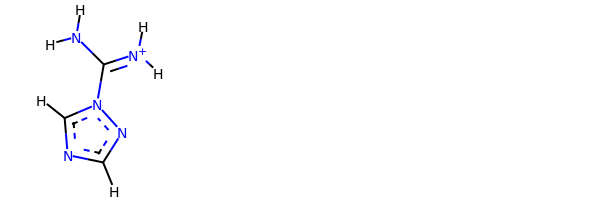

rdkit:  [H]c1nc([H])n(C(N([H])[H])=[N+]([H])[H])n1
oechem:  c1ncn(n1)C(=[NH2+])N
Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       26 matches
                                               [#6X4:1]-[#6X4:2] :        0 matches
                                               [#6X4:1]-[#6X3:2] :        1 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        1 matches
                                               [#6X3:1]-[#6X3:2] :        2 matches
                                               [#6X3:1]:[#6X3:2] :        0 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        0 matches
                                               [#6X3:1]-[#7X3:2] :        0 matches
                               [#6X4:1]-[#7X3:2]-[#6X3]=[#8X1+0] :        0 matches


Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       26 matches
                                               [#6X4:1]-[#6X4:2] :        0 matches
                                               [#6X4:1]-[#6X3:2] :        1 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        1 matches
                                               [#6X3:1]-[#6X3:2] :        2 matches
                                               [#6X3:1]:[#6X3:2] :        0 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        0 matches
                                               [#6X3:1]-[#7X3:2] :        0 matches
                               [#6X4:1]-[#7X3:2]-[#6X3]=[#8X1+0] :        0 matches
                                    [#6X3:1](=[#8X1+0])-[#7X3:2] :        0 match

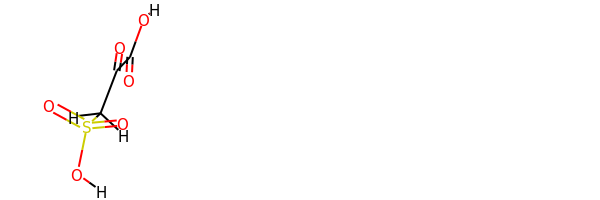

rdkit:  [H]OC(=O)C(=O)C([H])([H])S(=O)(=O)O[H]
oechem:  C(C(=O)C(=O)O)S(=O)(=O)O
Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       54 matches
                                               [#6X4:1]-[#6X4:2] :        6 matches
                                               [#6X4:1]-[#6X3:2] :        1 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        1 matches
                                               [#6X3:1]-[#6X3:2] :        0 matches
                                               [#6X3:1]:[#6X3:2] :        0 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        5 matches
                                               [#6X3:1]-[#7X3:2] :        3 matches
                               [#6X4:1]-[#7X3:2]-[#6X3]=[#8X1+0] :        0 matches


                 [#6X4:1]-[#16X4,#16X3+0:2]-[#7X4,#7X3:3]-[#1:4] :        0 matches
                 [#6X3:1]-[#16X4,#16X3+0:2]-[#7X4,#7X3:3]-[#1:4] :        0 matches
               [#6X4:1]-[#16X4,#16X3+0:2]-[#7X4,#7X3:3]-[#6X4:4] :        0 matches
               [#6X3:1]-[#16X4,#16X3+0:2]-[#7X4,#7X3:3]-[#6X4:4] :        0 matches
                 [#8X1:1]~[#16X4,#16X3+0:2]-[#7X4,#7X3:3]-[#1:4] :        0 matches
               [#8X1:1]~[#16X4,#16X3+0:2]-[#7X4,#7X3:3]-[#6X4:4] :        0 matches
                    [#6X3:1]-[#16X4,#16X3+0:2]-[#7X3:3]-[#6X3:4] :        0 matches
                    [#6X4:1]-[#16X4,#16X3+0:2]-[#7X3:3]-[#6X3:4] :        0 matches
                    [#8X1:1]~[#16X4,#16X3+0:2]-[#7X3:3]-[#6X3:4] :        0 matches
                    [#8X1:1]~[#16X4,#16X3+0:2]-[#7X3:3]-[#7X2:4] :        0 matches
                      [*:1]~[#16X4,#16X3+0:2]=,:[#7X2:3]-,:[*:4] :        0 matches
                    [#6X4:1]-[#16X4,#16X3+0:2]-[#7X2:3]~[#6X3:4] :        0 


HarmonicAngleGenerator:

                                               [*:1]~[*:2]~[*:3] :       90 matches
                                            [*:1]~[#6X4:2]-[*:3] :       48 matches
                                          [#1:1]-[#6X4:2]-[#1:3] :        6 matches
                                [*;r3:1]1~;@[*;r3:2]~;@[*;r3:3]1 :        0 matches
                                    [*;r3:1]~;@[*;r3:2]~;!@[*:3] :        0 matches
                                      [*:1]~;!@[*;r3:2]~;!@[*:3] :        0 matches
                                        [#1:1]-[*;r3:2]~;!@[*:3] :        0 matches
                                            [*:1]~[#6X3:2]~[*:3] :       12 matches
                                           [#1:1]-[#6X3:2]~[*:3] :        0 matches
                                          [#1:1]-[#6X3:2]-[#1:3] :        0 matches
                               [*;r6:1]~;@[*;r5:2]~;@[*;r5;x2:3] :        0 matches
                                    [*:1]~;!@[*;r5


NonbondedForceGenerator:

                                                           [*:1] :       28 matches
                                                          [#1:1] :       16 matches
                                                   [#1:1]-[#6X4] :        7 matches
                            [#1:1]-[#6X4]-[#7,#8,#9,#16,#17,#35] :        3 matches
   [#1:1]-[#6X4](-[#7,#8,#9,#16,#17,#35])-[#7,#8,#9,#16,#17,#35] :        0 matches
[#1:1]-[#6X4](-[#7,#8,#9,#16,#17,#35])(-[#7,#8,#9,#16,#17,#35])-[#7,#8,#9,#16,#17,#35] :        0 matches
                                         [#1:1]-[#6X4]~[*+1,*+2] :        0 matches
                                                   [#1:1]-[#6X3] :        0 matches
                            [#1:1]-[#6X3]~[#7,#8,#9,#16,#17,#35] :        0 matches
   [#1:1]-[#6X3](~[#7,#8,#9,#16,#17,#35])~[#7,#8,#9,#16,#17,#35] :        0 matches
                                                   [#1:1]-[#6X2] :        0 matches
                           

                    [#6X4:1]-[#16X4,#16X3+0:2]-[#7X2:3]~[#6X3:4] :        0 matches
                    [#8X1:1]~[#16X4,#16X3+0:2]-[#7X2:3]~[#6X3:4] :        0 matches
                          [*:1]~[#16X4,#16X3+0:2]-[#8X2:3]-[*:4] :        0 matches
                 [*:1]-[#16X2,#16X3+1:2]-[#16X2,#16X3+1:3]-[*:4] :        0 matches
                                    [*:1]-[#8X2:2]-[#15:3]~[*:4] :        0 matches
                              [#8X2:1]-[#15:2]-[#8X2:3]-[#6X4:4] :        0 matches
                                    [*:1]~[#7X3:2]-[#15:3]~[*:4] :        0 matches
                                    [*:1]~[#7X4:2]-[#15:3]~[*:4] :        0 matches
                                      [*:1]-[#7:2]-[#15:3]=[*:4] :        0 matches
                                   [#6X3:1]-[#7:2]-[#15:3]=[*:4] :        0 matches
                                         [*:1]-[*:2]#[*:3]-[*:4] :        0 matches
                                         [*:1]~[*:2]-[*:3]#[*:4] :        0 

HarmonicAngleGenerator:

                                               [*:1]~[*:2]~[*:3] :      160 matches
                                            [*:1]~[#6X4:2]-[*:3] :       36 matches
                                          [#1:1]-[#6X4:2]-[#1:3] :        4 matches
                                [*;r3:1]1~;@[*;r3:2]~;@[*;r3:3]1 :        0 matches
                                    [*;r3:1]~;@[*;r3:2]~;!@[*:3] :        0 matches
                                      [*:1]~;!@[*;r3:2]~;!@[*:3] :        0 matches
                                        [#1:1]-[*;r3:2]~;!@[*:3] :        0 matches
                                            [*:1]~[#6X3:2]~[*:3] :       84 matches
                                           [#1:1]-[#6X3:2]~[*:3] :        8 matches
                                          [#1:1]-[#6X3:2]-[#1:3] :        0 matches
                               [*;r6:1]~;@[*;r5:2]~;@[*;r5;x2:3] :        0 matches
                                    [*:1]~;!@[*;r5:

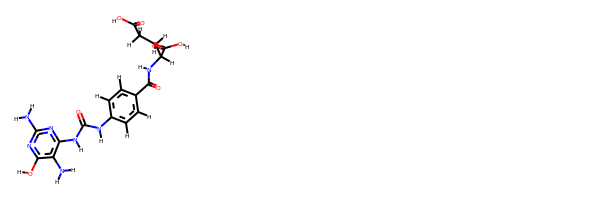

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])C([H])(C(=O)O[H])N([H])C(=O)c1c([H])c([H])c(N([H])C(=O)N([H])c2nc(N([H])[H])nc(O[H])c2N([H])[H])c([H])c1[H]
oechem:  c1cc(ccc1C(=O)NC(CCC(=O)O)C(=O)O)NC(=O)Nc2c(c(nc(n2)N)O)N
Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       74 matches
                                               [#6X4:1]-[#6X4:2] :       10 matches
                                               [#6X4:1]-[#6X3:2] :        0 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        0 matches
                                               [#6X3:1]-[#6X3:2] :        0 matches
                                               [#6X3:1]:[#6X3:2] :       12 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        1 matches
                                   


PeriodicTorsionGenerator Propers:

                                         [*:1]~[*:2]~[*:3]~[*:4] :      192 matches
                                   [*:1]-[#6X4:2]-[#6X4:3]-[*:4] :       90 matches
                             [#6X4:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        6 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#1:4] :       12 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        9 matches
                             [#8X2:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :       12 matches
                                 [#9:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                               [#17:1]-[#6X4:2]-[#6X4:3]-[#17:4] :        0 matches
                               [#35:1]-[#6X4:2]-[#6X4:3]-[#35:4] :        0 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :       12 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                                [#1:1]-[

Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       74 matches
                                               [#6X4:1]-[#6X4:2] :       10 matches
                                               [#6X4:1]-[#6X3:2] :        0 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        0 matches
                                               [#6X3:1]-[#6X3:2] :        0 matches
                                               [#6X3:1]:[#6X3:2] :       12 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        1 matches
                                               [#6X3:1]-[#7X3:2] :        1 matches
                               [#6X4:1]-[#7X3:2]-[#6X3]=[#8X1+0] :        0 matches
                                    [#6X3:1](=[#8X1+0])-[#7X3:2] :        0 match

                                         [*:1]~[*:2]-[*:3]#[*:4] :        0 matches
                          [*:1]~[*:2]=[#6,#7,#16,#15;X2:3]=[*:4] :        0 matches

PeriodicTorsionGenerator Impropers:

                                    [*:1]~[#6X3:2](~[*:3])~[*:4] :       36 matches
                                [*:1]~[#6X3:2](~[#8X1:3])~[#8:4] :        0 matches
                         [*:1]~[#7X3$(*~[#6X3]):2](~[*:3])~[*:4] :        6 matches
                         [*:1]~[#6X3:2](=[#7X2,#7X3+1:3])~[#7:4] :        0 matches

96 torsions added
7 impropers added, each applied in a six-fold manner

NonbondedForceGenerator:

                                                           [*:1] :       36 matches
                                                          [#1:1] :       15 matches
                                                   [#1:1]-[#6X4] :        7 matches
                            [#1:1]-[#6X4]-[#7,#8,#9,#16,#17,#35] :        8 matches
   [#1:1]-[#6X4](-[#7,#

                                   [*:1]~[#7X2:2]-[#7X3:3]~[*:4] :        0 matches
                                   [*:1]=[#7X2:2]-[#7X2:3]=[*:4] :        0 matches
                                 [*:1]~[#7X2:2]=,:[#7X2:3]~[*:4] :        0 matches
                               [*:1]~[#7X3+1:2]=,:[#7X2:3]~[*:4] :        0 matches
                               [#6:1]-[#7X2:2]~[#7X2:3]~[#7X1:4] :        0 matches
                           [*:1]-[#16X2,#16X3+1:2]-[!#6:3]~[*:4] :        0 matches
                            [*:1]~[#16X4,#16X3+0:2]-[#7:3]~[*:4] :        6 matches
                 [#6X4:1]-[#16X4,#16X3+0:2]-[#7X4,#7X3:3]-[#1:4] :        2 matches
                 [#6X3:1]-[#16X4,#16X3+0:2]-[#7X4,#7X3:3]-[#1:4] :        0 matches
               [#6X4:1]-[#16X4,#16X3+0:2]-[#7X4,#7X3:3]-[#6X4:4] :        0 matches
               [#6X3:1]-[#16X4,#16X3+0:2]-[#7X4,#7X3:3]-[#6X4:4] :        0 matches
                 [#8X1:1]~[#16X4,#16X3+0:2]-[#7X4,#7X3:3]-[#1:4] :        0 


PeriodicTorsionGenerator Propers:

                                         [*:1]~[*:2]~[*:3]~[*:4] :      118 matches
                                   [*:1]-[#6X4:2]-[#6X4:3]-[*:4] :       36 matches
                             [#6X4:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#1:4] :       12 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        0 matches
                             [#8X2:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#9:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                               [#17:1]-[#6X4:2]-[#6X4:3]-[#17:4] :        0 matches
                               [#35:1]-[#6X4:2]-[#6X4:3]-[#35:4] :        0 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                                [#1:1]-[

Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :      142 matches
                                               [#6X4:1]-[#6X4:2] :       12 matches
                                               [#6X4:1]-[#6X3:2] :        4 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        3 matches
                                               [#6X3:1]-[#6X3:2] :        0 matches
                                               [#6X3:1]:[#6X3:2] :       24 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        9 matches
                                               [#6X3:1]-[#7X3:2] :        5 matches
                               [#6X4:1]-[#7X3:2]-[#6X3]=[#8X1+0] :        1 matches
                                    [#6X3:1](=[#8X1+0])-[#7X3:2] :        2 match


PeriodicTorsionGenerator Propers:

                                         [*:1]~[*:2]~[*:3]~[*:4] :      352 matches
                                   [*:1]-[#6X4:2]-[#6X4:3]-[*:4] :      108 matches
                             [#6X4:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        2 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#1:4] :       38 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :       10 matches
                             [#8X2:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#9:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                               [#17:1]-[#6X4:2]-[#6X4:3]-[#17:4] :        0 matches
                               [#35:1]-[#6X4:2]-[#6X4:3]-[#35:4] :        0 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                                [#1:1]-[

###########################################################################
 #########################################################

Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :      142 matches
                                               [#6X4:1]-[#6X4:2] :       12 matches
                                               [#6X4:1]-[#6X3:2] :        4 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        3 matches
                                               [#6X3:1]-[#6X3:2] :        0 matches
                                               [#6X3:1]:[#6X3:2] :       24 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        9 matches
                                               [#6X3:1]-[#7X3:2] :        5 matches
                             


                                         [*:1]~[*:2]~[*:3]~[*:4] :      352 matches
                                   [*:1]-[#6X4:2]-[#6X4:3]-[*:4] :      108 matches
                             [#6X4:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        2 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#1:4] :       38 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :       10 matches
                             [#8X2:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#9:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                               [#17:1]-[#6X4:2]-[#6X4:3]-[#17:4] :        0 matches
                               [#35:1]-[#6X4:2]-[#6X4:3]-[#35:4] :        0 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                                [#1:1]-[#6X4:2]-[#6X4:3]-[#17:4] :        0

                    [#6X3:1]-[#16X4,#16X3+0:2]-[#7X3:3]-[#6X3:4] :        0 matches
                    [#6X4:1]-[#16X4,#16X3+0:2]-[#7X3:3]-[#6X3:4] :        0 matches
                    [#8X1:1]~[#16X4,#16X3+0:2]-[#7X3:3]-[#6X3:4] :        0 matches
                    [#8X1:1]~[#16X4,#16X3+0:2]-[#7X3:3]-[#7X2:4] :        0 matches
                      [*:1]~[#16X4,#16X3+0:2]=,:[#7X2:3]-,:[*:4] :        0 matches
                    [#6X4:1]-[#16X4,#16X3+0:2]-[#7X2:3]~[#6X3:4] :        0 matches
                    [#8X1:1]~[#16X4,#16X3+0:2]-[#7X2:3]~[#6X3:4] :        0 matches
                          [*:1]~[#16X4,#16X3+0:2]-[#8X2:3]-[*:4] :        0 matches
                 [*:1]-[#16X2,#16X3+1:2]-[#16X2,#16X3+1:3]-[*:4] :        0 matches
                                    [*:1]-[#8X2:2]-[#15:3]~[*:4] :        0 matches
                              [#8X2:1]-[#15:2]-[#8X2:3]-[#6X4:4] :        0 matches
                                    [*:1]~[#7X3:2]-[#15:3]~[*:4] :        0 


PeriodicTorsionGenerator Propers:

                                         [*:1]~[*:2]~[*:3]~[*:4] :      286 matches
                                   [*:1]-[#6X4:2]-[#6X4:3]-[*:4] :       54 matches
                             [#6X4:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#1:4] :        0 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :       18 matches
                             [#8X2:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#9:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                               [#17:1]-[#6X4:2]-[#6X4:3]-[#17:4] :        0 matches
                               [#35:1]-[#6X4:2]-[#6X4:3]-[#35:4] :        0 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                                [#1:1]-[

Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :      122 matches
                                               [#6X4:1]-[#6X4:2] :        6 matches
                                               [#6X4:1]-[#6X3:2] :        1 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        0 matches
                                               [#6X3:1]-[#6X3:2] :        8 matches
                                               [#6X3:1]:[#6X3:2] :       24 matches
                                               [#6X3:1]=[#6X3:2] :        2 matches
                                                   [#6:1]-[#7:2] :        2 matches
                                               [#6X3:1]-[#7X3:2] :        1 matches
                               [#6X4:1]-[#7X3:2]-[#6X3]=[#8X1+0] :        0 matches
                                    [#6X3:1](=[#8X1+0])-[#7X3:2] :        0 match

                                         [*:1]~[*:2]~[*:3]~[*:4] :      286 matches
                                   [*:1]-[#6X4:2]-[#6X4:3]-[*:4] :       54 matches
                             [#6X4:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#1:4] :        0 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :       18 matches
                             [#8X2:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#9:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                               [#17:1]-[#6X4:2]-[#6X4:3]-[#17:4] :        0 matches
                               [#35:1]-[#6X4:2]-[#6X4:3]-[#35:4] :        0 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                                [#1:1]-[#6X4:2]-[#6X4:3]-[#17:4] :        0 

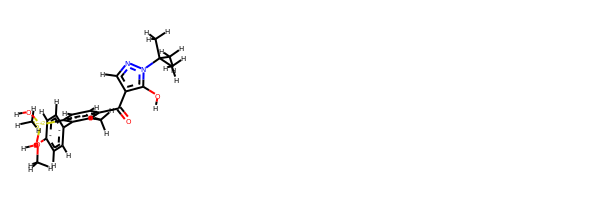

rdkit:  [H]Oc1c(C(=O)c2c([H])c([H])c([S+2](O[H])(O[H])C([H])([H])[H])c(-c3c([H])c([H])c(OC([H])([H])[H])c([H])c3[H])c2C([H])([H])[H])c([H])nn1C(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H]
oechem:  Cc1c(ccc(c1c2ccc(cc2)OC)[S+2](C)(O)O)C(=O)c3cnn(c3O)C(C)(C)C
Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       82 matches
                                               [#6X4:1]-[#6X4:2] :        0 matches
                                               [#6X4:1]-[#6X3:2] :        1 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        0 matches
                                               [#6X3:1]-[#6X3:2] :        8 matches
                                               [#6X3:1]:[#6X3:2] :       14 matches
                                               [#6X3:1]=[#6X3:2] :        4 matches
                                                   [#6:1]-[#7:2] :       


PeriodicTorsionGenerator Propers:

                                         [*:1]~[*:2]~[*:3]~[*:4] :      180 matches
                                   [*:1]-[#6X4:2]-[#6X4:3]-[*:4] :        0 matches
                             [#6X4:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#1:4] :        0 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        0 matches
                             [#8X2:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#9:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                               [#17:1]-[#6X4:2]-[#6X4:3]-[#17:4] :        0 matches
                               [#35:1]-[#6X4:2]-[#6X4:3]-[#35:4] :        0 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                                [#1:1]-[


PeriodicTorsionGenerator Impropers:

                                    [*:1]~[#6X3:2](~[*:3])~[*:4] :       90 matches
                                [*:1]~[#6X3:2](~[#8X1:3])~[#8:4] :        1 matches
                         [*:1]~[#7X3$(*~[#6X3]):2](~[*:3])~[*:4] :       18 matches
                         [*:1]~[#6X3:2](=[#7X2,#7X3+1:3])~[#7:4] :        0 matches

90 torsions added
18 impropers added, each applied in a six-fold manner

NonbondedForceGenerator:

                                                           [*:1] :       40 matches
                                                          [#1:1] :       14 matches
                                                   [#1:1]-[#6X4] :        2 matches
                            [#1:1]-[#6X4]-[#7,#8,#9,#16,#17,#35] :        2 matches
   [#1:1]-[#6X4](-[#7,#8,#9,#16,#17,#35])-[#7,#8,#9,#16,#17,#35] :        0 matches
[#1:1]-[#6X4](-[#7,#8,#9,#16,#17,#35])(-[#7,#8,#9,#16,#17,#35])-[#7,#8,#9,#16,#17,#35] :        0 matches



HarmonicAngleGenerator:

                                               [*:1]~[*:2]~[*:3] :      128 matches
                                            [*:1]~[#6X4:2]-[*:3] :       12 matches
                                          [#1:1]-[#6X4:2]-[#1:3] :        2 matches
                                [*;r3:1]1~;@[*;r3:2]~;@[*;r3:3]1 :        0 matches
                                    [*;r3:1]~;@[*;r3:2]~;!@[*:3] :        0 matches
                                      [*:1]~;!@[*;r3:2]~;!@[*:3] :        0 matches
                                        [#1:1]-[*;r3:2]~;!@[*:3] :        0 matches
                                            [*:1]~[#6X3:2]~[*:3] :       90 matches
                                           [#1:1]-[#6X3:2]~[*:3] :       16 matches
                                          [#1:1]-[#6X3:2]-[#1:3] :        0 matches
                               [*;r6:1]~;@[*;r5:2]~;@[*;r5;x2:3] :        2 matches
                                    [*:1]~;!@[*;r5

                               [#1:1]-[#8X2:2]-[#6X3:3]=[#8X1:4] :        1 matches
                      [#8,#16,#7:1]=[#6X3:2]-[#8X2H0:3]-[#6X4:4] :        0 matches
                               [#1:1]-[#8X2H1:2]-@[#6X3:3]~[*:4] :        0 matches
                                 [*:1]-[#8X2+1:2]=[#6X3:3]-[*:4] :        0 matches
                                   [*:1]=[#8X2+1:2]-[#6:3]~[*:4] :        0 matches
                                    [*:1]~[#16:2]=,:[#6:3]~[*:4] :        0 matches
                            [*:1]-[#16X2,#16X3+1:2]-[#6:3]~[*:4] :        0 matches
                           [*:1]-[#16X2,#16X3+1:2]-[#6:3]-[#1:4] :        0 matches
[#6X3:1]-@[#16X2,#16X1-1,#16X3+1:2]-@[#6X3,#7X2;r5:3]=@[#6,#7;r5:4] :        0 matches
                         [*:1]~[#16X4,#16X3!+1:2]-[#6X4:3]-[*:4] :        6 matches
                      [#6X4:1]-[#16X4,#16X3+0:2]-[#6X4:3]-[#1:4] :        0 matches
                    [#6X4:1]-[#16X4,#16X3+0:2]-[#6X4:3]~[#6X4:4] :       

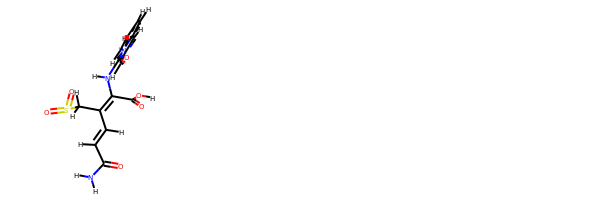

rdkit:  [H]OC(=O)C(=C(C([H])=C([H])C(=O)N([H])[H])C([H])([H])[S-](=O)=O)N([H])c1c(C([H])=O)c([H])c2c([H])c([H])c([H])c([H])n12
oechem:  c1ccn2c(c1)cc(c2NC(=C(C[S-](=O)=O)C=CC(=O)N)C(=O)O)C=O
Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       56 matches
                                               [#6X4:1]-[#6X4:2] :        6 matches
                                               [#6X4:1]-[#6X3:2] :        0 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        0 matches
                                               [#6X3:1]-[#6X3:2] :        0 matches
                                               [#6X3:1]:[#6X3:2] :        0 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        3 matches
                                               [#6X3:1]-[#


PeriodicTorsionGenerator Propers:

                                         [*:1]~[*:2]~[*:3]~[*:4] :      120 matches
                                   [*:1]-[#6X4:2]-[#6X4:3]-[*:4] :       54 matches
                             [#6X4:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#1:4] :       24 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        4 matches
                             [#8X2:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        2 matches
                                 [#9:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                               [#17:1]-[#6X4:2]-[#6X4:3]-[#17:4] :        0 matches
                               [#35:1]-[#6X4:2]-[#6X4:3]-[#35:4] :        0 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        6 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                                [#1:1]-[

                                    [*:1]~[#7X4:2]-[#15:3]~[*:4] :        0 matches
                                      [*:1]-[#7:2]-[#15:3]=[*:4] :        0 matches
                                   [#6X3:1]-[#7:2]-[#15:3]=[*:4] :        0 matches
                                         [*:1]-[*:2]#[*:3]-[*:4] :        0 matches
                                         [*:1]~[*:2]-[*:3]#[*:4] :        0 matches
                          [*:1]~[*:2]=[#6,#7,#16,#15;X2:3]=[*:4] :        0 matches

PeriodicTorsionGenerator Impropers:

                                    [*:1]~[#6X3:2](~[*:3])~[*:4] :        6 matches
                                [*:1]~[#6X3:2](~[#8X1:3])~[#8:4] :        0 matches
                         [*:1]~[#7X3$(*~[#6X3]):2](~[*:3])~[*:4] :       18 matches
                         [*:1]~[#6X3:2](=[#7X2,#7X3+1:3])~[#7:4] :        2 matches

60 torsions added
4 impropers added, each applied in a six-fold manner

NonbondedForceGenerator:

                       

                     [*:1]~[#7X3$(*~[#6X3,#6X2,#7X2+0]):2]~[*:3] :       18 matches
                    [#1:1]-[#7X3$(*~[#6X3,#6X2,#7X2+0]):2]-[*:3] :        8 matches
                                            [*:1]~[#7X2:2]~[*:3] :        0 matches
                                          [*:1]~[#7X2+0:2]~[*:3] :        0 matches
                                         [#1:1]-[#7X2+0:2]~[*:3] :        0 matches
                         [#6,#7,#8:1]-[#7X3:2](~[#8X1])~[#8X1:3] :        0 matches
                                      [#8X1:1]~[#7X3:2]~[#8X1:3] :        0 matches
                                         [*:1]~[#7X2:2]~[#7X1:3] :        0 matches
                                              [*:1]-[#8:2]-[*:3] :        6 matches
                            [#6X3,#7:1]~;@[#8;r:2]~;@[#6X3,#7:3] :        0 matches
                                          [*:1]-[#8X2+1:2]=[*:3] :        0 matches
                                           [*:1]~[#16X4:2]~[*:3] :        0 

Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       66 matches
                                               [#6X4:1]-[#6X4:2] :        6 matches
                                               [#6X4:1]-[#6X3:2] :        1 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        1 matches
                                               [#6X3:1]-[#6X3:2] :        2 matches
                                               [#6X3:1]:[#6X3:2] :        2 matches
                                               [#6X3:1]=[#6X3:2] :        2 matches
                                                   [#6:1]-[#7:2] :        3 matches
                                               [#6X3:1]-[#7X3:2] :        1 matches
                               [#6X4:1]-[#7X3:2]-[#6X3]=[#8X1+0] :        0 matches
                                    [#6X3:1](=[#8X1+0])-[#7X3:2] :        0 match


PeriodicTorsionGenerator Propers:

                                         [*:1]~[*:2]~[*:3]~[*:4] :      156 matches
                                   [*:1]-[#6X4:2]-[#6X4:3]-[*:4] :       54 matches
                             [#6X4:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#1:4] :        0 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :       12 matches
                             [#8X2:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#9:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                               [#17:1]-[#6X4:2]-[#6X4:3]-[#17:4] :        0 matches
                               [#35:1]-[#6X4:2]-[#6X4:3]-[#35:4] :        0 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                                [#1:1]-[

Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       66 matches
                                               [#6X4:1]-[#6X4:2] :        6 matches
                                               [#6X4:1]-[#6X3:2] :        1 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        1 matches
                                               [#6X3:1]-[#6X3:2] :        2 matches
                                               [#6X3:1]:[#6X3:2] :        0 matches
                                               [#6X3:1]=[#6X3:2] :        4 matches
                                                   [#6:1]-[#7:2] :        5 matches
                                               [#6X3:1]-[#7X3:2] :        2 matches
                               [#6X4:1]-[#7X3:2]-[#6X3]=[#8X1+0] :        0 matches
                                    [#6X3:1](=[#8X1+0])-[#7X3:2] :        0 match

                                [*:1]~[#6X3:2](~[#8X1:3])~[#8:4] :        1 matches
                         [*:1]~[#7X3$(*~[#6X3]):2](~[*:3])~[*:4] :       12 matches
                         [*:1]~[#6X3:2](=[#7X2,#7X3+1:3])~[#7:4] :        0 matches

78 torsions added
8 impropers added, each applied in a six-fold manner

NonbondedForceGenerator:

                                                           [*:1] :       33 matches
                                                          [#1:1] :       13 matches
                                                   [#1:1]-[#6X4] :        6 matches
                            [#1:1]-[#6X4]-[#7,#8,#9,#16,#17,#35] :        3 matches
   [#1:1]-[#6X4](-[#7,#8,#9,#16,#17,#35])-[#7,#8,#9,#16,#17,#35] :        0 matches
[#1:1]-[#6X4](-[#7,#8,#9,#16,#17,#35])(-[#7,#8,#9,#16,#17,#35])-[#7,#8,#9,#16,#17,#35] :        0 matches
                                         [#1:1]-[#6X4]~[*+1,*+2] :        0 matches
                                       

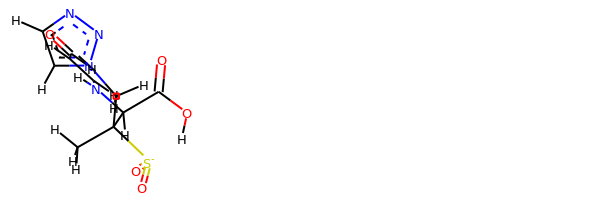

rdkit:  [H]OC(=O)C([H])(N([H])C([H])=C([H])C([H])=O)C([S-](=O)=O)(C([H])([H])[H])C([H])([H])n1nnc([H])c1[H]
oechem:  CC(Cn1ccnn1)(C(C(=O)O)NC=CC=O)[S-](=O)=O
Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       38 matches
                                               [#6X4:1]-[#6X4:2] :        4 matches
                                               [#6X4:1]-[#6X3:2] :        0 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        0 matches
                                               [#6X3:1]-[#6X3:2] :        0 matches
                                               [#6X3:1]:[#6X3:2] :        0 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        3 matches
                                               [#6X3:1]-[#7X3:2] :        2 matches
       

                               [#1:1]-[#8X2H1:2]-@[#6X3:3]~[*:4] :        0 matches
                                 [*:1]-[#8X2+1:2]=[#6X3:3]-[*:4] :        0 matches
                                   [*:1]=[#8X2+1:2]-[#6:3]~[*:4] :        0 matches
                                    [*:1]~[#16:2]=,:[#6:3]~[*:4] :        0 matches
                            [*:1]-[#16X2,#16X3+1:2]-[#6:3]~[*:4] :        0 matches
                           [*:1]-[#16X2,#16X3+1:2]-[#6:3]-[#1:4] :        0 matches
[#6X3:1]-@[#16X2,#16X1-1,#16X3+1:2]-@[#6X3,#7X2;r5:3]=@[#6,#7;r5:4] :        0 matches
                         [*:1]~[#16X4,#16X3!+1:2]-[#6X4:3]-[*:4] :        0 matches
                      [#6X4:1]-[#16X4,#16X3+0:2]-[#6X4:3]-[#1:4] :        0 matches
                    [#6X4:1]-[#16X4,#16X3+0:2]-[#6X4:3]~[#6X4:4] :        0 matches
                          [*:1]~[#16X4,#16X3+0:2]-[#6X3:3]~[*:4] :        0 matches
                         [#6:1]-[#16X4,#16X3+0:2]-[#6X3:3]~[*:4] :       


PeriodicTorsionGenerator Propers:

                                         [*:1]~[*:2]~[*:3]~[*:4] :       78 matches
                                   [*:1]-[#6X4:2]-[#6X4:3]-[*:4] :       36 matches
                             [#6X4:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#1:4] :       16 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        4 matches
                             [#8X2:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#9:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                               [#17:1]-[#6X4:2]-[#6X4:3]-[#17:4] :        0 matches
                               [#35:1]-[#6X4:2]-[#6X4:3]-[#35:4] :        0 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        2 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                                [#1:1]-[


HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       66 matches
                                               [#6X4:1]-[#6X4:2] :        6 matches
                                               [#6X4:1]-[#6X3:2] :        1 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        1 matches
                                               [#6X3:1]-[#6X3:2] :        2 matches
                                               [#6X3:1]:[#6X3:2] :        2 matches
                                               [#6X3:1]=[#6X3:2] :        2 matches
                                                   [#6:1]-[#7:2] :        3 matches
                                               [#6X3:1]-[#7X3:2] :        1 matches
                               [#6X4:1]-[#7X3:2]-[#6X3]=[#8X1+0] :        0 matches
                                    [#6X3:1](=[#8X1+0])-[#7X3:2] :        0 matches
                                               [#6X


PeriodicTorsionGenerator Propers:

                                         [*:1]~[*:2]~[*:3]~[*:4] :      156 matches
                                   [*:1]-[#6X4:2]-[#6X4:3]-[*:4] :       54 matches
                             [#6X4:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#1:4] :        0 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :       12 matches
                             [#8X2:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#9:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                               [#17:1]-[#6X4:2]-[#6X4:3]-[#17:4] :        0 matches
                               [#35:1]-[#6X4:2]-[#6X4:3]-[#35:4] :        0 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                                [#1:1]-[

Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       66 matches
                                               [#6X4:1]-[#6X4:2] :        6 matches
                                               [#6X4:1]-[#6X3:2] :        1 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        1 matches
                                               [#6X3:1]-[#6X3:2] :        2 matches
                                               [#6X3:1]:[#6X3:2] :        0 matches
                                               [#6X3:1]=[#6X3:2] :        4 matches
                                                   [#6:1]-[#7:2] :        5 matches
                                               [#6X3:1]-[#7X3:2] :        2 matches
                               [#6X4:1]-[#7X3:2]-[#6X3]=[#8X1+0] :        0 matches
                                    [#6X3:1](=[#8X1+0])-[#7X3:2] :        0 match

bond
46.51358623402871 kJ/mol 29186.482816526852 kJ/mol False
angle
142.06600410468397 kJ/mol 142.06600410468397 kJ/mol True
nb
4.16159613161081 kJ/mol 4.16159613161081 kJ/mol True
torsion
16.801957666432106 kJ/mol 11.571959433609846 kJ/mol False
209.54314413675561 kJ/mol 29344.282376196756 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3448


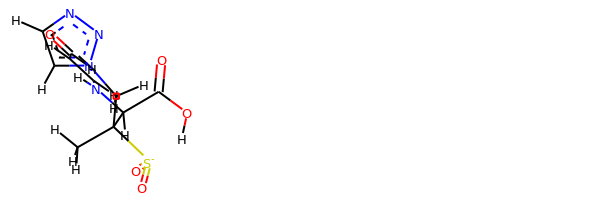

rdkit:  [H]OC(=O)C([H])(N([H])C([H])=C([H])C([H])=O)C([S-](=O)=O)(C([H])([H])[H])C([H])([H])n1nnc([H])c1[H]
oechem:  CC(Cn1ccnn1)(C(C(=O)O)NC=CC=O)[S-](=O)=O
Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       66 matches
                                               [#6X4:1]-[#6X4:2] :        6 matches
                                               [#6X4:1]-[#6X3:2] :        2 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        1 matches
                                               [#6X3:1]-[#6X3:2] :        0 matches
                                               [#6X3:1]:[#6X3:2] :        0 matches
                                               [#6X3:1]=[#6X3:2] :        2 matches
                                                   [#6:1]-[#7:2] :        5 matches
                                               [#6X3:1]-[#7X3:2] :        2 matches
       

                                  [*:1]~[#6X3:2]-[#8X2:3]-[#1:4] :        2 matches
                   [*:1]~[#6X3:2](=[#8,#16,#7])-[#8X2H0:3]-[*:4] :        0 matches
                      [*:1]~[#6X3:2](=[#8,#16,#7])-[#8:3]-[#1:4] :        1 matches
                               [#1:1]-[#8X2:2]-[#6X3:3]=[#8X1:4] :        1 matches
                      [#8,#16,#7:1]=[#6X3:2]-[#8X2H0:3]-[#6X4:4] :        0 matches
                               [#1:1]-[#8X2H1:2]-@[#6X3:3]~[*:4] :        0 matches
                                 [*:1]-[#8X2+1:2]=[#6X3:3]-[*:4] :        0 matches
                                   [*:1]=[#8X2+1:2]-[#6:3]~[*:4] :        0 matches
                                    [*:1]~[#16:2]=,:[#6:3]~[*:4] :        0 matches
                            [*:1]-[#16X2,#16X3+1:2]-[#6:3]~[*:4] :        0 matches
                           [*:1]-[#16X2,#16X3+1:2]-[#6:3]-[#1:4] :        0 matches
[#6X3:1]-@[#16X2,#16X1-1,#16X3+1:2]-@[#6X3,#7X2;r5:3]=@[#6,#7;r5:4] :       

                                            [*:1]~[#6X4:2]-[*:3] :       60 matches
                                          [#1:1]-[#6X4:2]-[#1:3] :        8 matches
                                [*;r3:1]1~;@[*;r3:2]~;@[*;r3:3]1 :        0 matches
                                    [*;r3:1]~;@[*;r3:2]~;!@[*:3] :        0 matches
                                      [*:1]~;!@[*;r3:2]~;!@[*:3] :        0 matches
                                        [#1:1]-[*;r3:2]~;!@[*:3] :        0 matches
                                            [*:1]~[#6X3:2]~[*:3] :       24 matches
                                           [#1:1]-[#6X3:2]~[*:3] :        6 matches
                                          [#1:1]-[#6X3:2]-[#1:3] :        2 matches
                               [*;r6:1]~;@[*;r5:2]~;@[*;r5;x2:3] :        0 matches
                                    [*:1]~;!@[*;r5:2]~;@[*;r5:3] :        0 matches
                                        [#8X1:1]~[#6X3:2]~[#8:3] :        1 

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       52 matches
                                               [#6X4:1]-[#6X4:2] :        6 matches
                                               [#6X4:1]-[#6X3:2] :        1 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        1 matches
                                               [#6X3:1]-[#6X3:2] :        0 matches
                                               [#6X3:1]:[#6X3:2] :        0 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        4 matches
                                             


PeriodicTorsionGenerator Propers:

                                         [*:1]~[*:2]~[*:3]~[*:4] :      118 matches
                                   [*:1]-[#6X4:2]-[#6X4:3]-[*:4] :       54 matches
                             [#6X4:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        2 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#1:4] :       20 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        7 matches
                             [#8X2:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#9:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                               [#17:1]-[#6X4:2]-[#6X4:3]-[#17:4] :        0 matches
                               [#35:1]-[#6X4:2]-[#6X4:3]-[#35:4] :        0 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                                [#1:1]-[

Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       52 matches
                                               [#6X4:1]-[#6X4:2] :        6 matches
                                               [#6X4:1]-[#6X3:2] :        1 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        1 matches
                                               [#6X3:1]-[#6X3:2] :        0 matches
                                               [#6X3:1]:[#6X3:2] :        0 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        4 matches
                                               [#6X3:1]-[#7X3:2] :        2 matches
                               [#6X4:1]-[#7X3:2]-[#6X3]=[#8X1+0] :        0 matches
                                    [#6X3:1](=[#8X1+0])-[#7X3:2] :        0 match

Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :      108 matches
                                               [#6X4:1]-[#6X4:2] :       16 matches
                                               [#6X4:1]-[#6X3:2] :        3 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        3 matches
                                               [#6X3:1]-[#6X3:2] :        0 matches
                                               [#6X3:1]:[#6X3:2] :        0 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        7 matches
                                               [#6X3:1]-[#7X3:2] :        4 matches
                               [#6X4:1]-[#7X3:2]-[#6X3]=[#8X1+0] :        2 matches
                                    [#6X3:1](=[#8X1+0])-[#7X3:2] :        2 match

Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :      108 matches
                                               [#6X4:1]-[#6X4:2] :       16 matches
                                               [#6X4:1]-[#6X3:2] :        3 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        3 matches
                                               [#6X3:1]-[#6X3:2] :        0 matches
                                               [#6X3:1]:[#6X3:2] :        0 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        7 matches
                                               [#6X3:1]-[#7X3:2] :        4 matches
                               [#6X4:1]-[#7X3:2]-[#6X3]=[#8X1+0] :        2 matches
                                    [#6X3:1](=[#8X1+0])-[#7X3:2] :        2 match

                               [#1:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        2 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                                [#1:1]-[#6X4:2]-[#6X4:3]-[#17:4] :        0 matches
                                [#1:1]-[#6X4:2]-[#6X4:3]-[#35:4] :        0 matches
                                [*:1]-[#6X4:2]-[#6X4;r3:3]-[*:4] :        0 matches
                          [*:1]-[#6X4:2]-[#6X4;r3:3]-[#6X4;r3:4] :        0 matches
                            [*:1]-[#6X4;r3:2]-@[#6X4;r3:3]-[*:4] :        0 matches
                       [#6X4;r3:1]-[#6X4;r3:2]-[#6X4;r3:3]-[*:4] :        0 matches
                                   [*:1]~[#6X3:2]-[#6X4:3]-[*:4] :       18 matches
                               [#1:1]-[#6X4:2]-[#6X3:3]=[#8X1:4] :        4 matches
                               [#1:1]-[#6X4:2]-[#6X3:3]=[#6X3:4] :        0 matches
                                   [*:1]-[#6X4:2]-[#6X3:3]=[*:4] :        9 

                            [#1:1]-[#6X4;r3:2]-[#6X3:3]~[#6X3:4] :        0 matches
                          [#6X3:1]-[#6X4;r3:2]-[#6X3:3]-[#7X3:4] :        0 matches
                          [#6X3:1]-[#6X4;r3:2]-[#6X3:3]=[#8X1:4] :        0 matches
                          [#6X3:1]-[#6X4;r3:2]-[#6X3:3]~[#6X3:4] :        0 matches
                          [#7X3:1]-[#6X4;r3:2]-[#6X3:3]~[#6X3:4] :        0 matches
                     [#6X4;r3:1]-;@[#6X4;r3:2]-[#6X3:3]~[#6X3:4] :        0 matches
               [#6X4;r3:1]-;@[#6X4;r3:2]-[#6X3;r6:3]:[#6X3;r6:4] :        0 matches
             [#6X4;r3:1]-;@[#6X4;r3:2]-[#6X3;r5:3]-;@[#6X3;r5:4] :        0 matches
             [#6X4;r3:1]-;@[#6X4;r3:2]-[#6X3;r5:3]=;@[#6X3;r5:4] :        0 matches
                     [#6X4;r3:1]-;@[#6X4;r3:2]-[#6X3:3]-[#6X4:4] :        0 matches
               [#6X4;r3:1]-;@[#6X4;r3:2]-[#6X3;r6:3]:[#7X2;r6:4] :        0 matches
                     [#6X4;r3:1]-;@[#6X4;r3:2]-[#6X3:3]=[#7X2:4] :        0 


PeriodicTorsionGenerator Propers:

                                         [*:1]~[*:2]~[*:3]~[*:4] :       42 matches
                                   [*:1]-[#6X4:2]-[#6X4:3]-[*:4] :       18 matches
                             [#6X4:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#1:4] :       12 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        0 matches
                             [#8X2:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#9:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                               [#17:1]-[#6X4:2]-[#6X4:3]-[#17:4] :        0 matches
                               [#35:1]-[#6X4:2]-[#6X4:3]-[#35:4] :        0 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                                [#1:1]-[

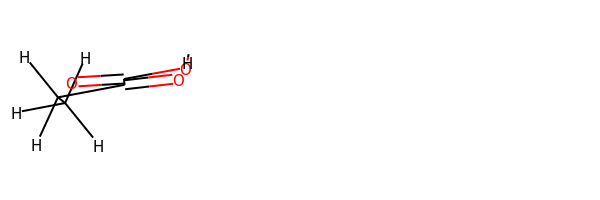

rdkit:  [H]OC(=O)C(=O)C([H])([H])C([H])([H])[H]
oechem:  CCC(=O)C(=O)O
Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :      120 matches
                                               [#6X4:1]-[#6X4:2] :        8 matches
                                               [#6X4:1]-[#6X3:2] :        2 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        2 matches
                                               [#6X3:1]-[#6X3:2] :        2 matches
                                               [#6X3:1]:[#6X3:2] :       16 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :       10 matches
                                               [#6X3:1]-[#7X3:2] :        5 matches
                               [#6X4:1]-[#7X3:2]-[#6X3]=[#8X1+0] :        1 matches
          


PeriodicTorsionGenerator Propers:

                                         [*:1]~[*:2]~[*:3]~[*:4] :      300 matches
                                   [*:1]-[#6X4:2]-[#6X4:3]-[*:4] :       72 matches
                             [#6X4:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#1:4] :       20 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        7 matches
                             [#8X2:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#9:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                               [#17:1]-[#6X4:2]-[#6X4:3]-[#17:4] :        0 matches
                               [#35:1]-[#6X4:2]-[#6X4:3]-[#35:4] :        0 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                                [#1:1]-[

                    [#6X4:1]-[#16X4,#16X3+0:2]-[#7X3:3]-[#6X3:4] :        0 matches
                    [#8X1:1]~[#16X4,#16X3+0:2]-[#7X3:3]-[#6X3:4] :        0 matches
                    [#8X1:1]~[#16X4,#16X3+0:2]-[#7X3:3]-[#7X2:4] :        0 matches
                      [*:1]~[#16X4,#16X3+0:2]=,:[#7X2:3]-,:[*:4] :        0 matches
                    [#6X4:1]-[#16X4,#16X3+0:2]-[#7X2:3]~[#6X3:4] :        0 matches
                    [#8X1:1]~[#16X4,#16X3+0:2]-[#7X2:3]~[#6X3:4] :        0 matches
                          [*:1]~[#16X4,#16X3+0:2]-[#8X2:3]-[*:4] :        0 matches
                 [*:1]-[#16X2,#16X3+1:2]-[#16X2,#16X3+1:3]-[*:4] :        0 matches
                                    [*:1]-[#8X2:2]-[#15:3]~[*:4] :        0 matches
                              [#8X2:1]-[#15:2]-[#8X2:3]-[#6X4:4] :        0 matches
                                    [*:1]~[#7X3:2]-[#15:3]~[*:4] :        0 matches
                                    [*:1]~[#7X4:2]-[#15:3]~[*:4] :        0 

                                               [*:1]~[*:2]~[*:3] :      204 matches
                                            [*:1]~[#6X4:2]-[*:3] :       84 matches
                                          [#1:1]-[#6X4:2]-[#1:3] :       14 matches
                                [*;r3:1]1~;@[*;r3:2]~;@[*;r3:3]1 :        0 matches
                                    [*;r3:1]~;@[*;r3:2]~;!@[*:3] :        0 matches
                                      [*:1]~;!@[*;r3:2]~;!@[*:3] :        0 matches
                                        [#1:1]-[*;r3:2]~;!@[*:3] :        0 matches
                                            [*:1]~[#6X3:2]~[*:3] :       78 matches
                                           [#1:1]-[#6X3:2]~[*:3] :        8 matches
                                          [#1:1]-[#6X3:2]-[#1:3] :        0 matches
                               [*;r6:1]~;@[*;r5:2]~;@[*;r5;x2:3] :        0 matches
                                    [*:1]~;!@[*;r5:2]~;@[*;r5:3] :        0 


150 torsions added
19 impropers added, each applied in a six-fold manner

NonbondedForceGenerator:

                                                           [*:1] :       58 matches
                                                          [#1:1] :       25 matches
                                                   [#1:1]-[#6X4] :       13 matches
                            [#1:1]-[#6X4]-[#7,#8,#9,#16,#17,#35] :        9 matches
   [#1:1]-[#6X4](-[#7,#8,#9,#16,#17,#35])-[#7,#8,#9,#16,#17,#35] :        0 matches
[#1:1]-[#6X4](-[#7,#8,#9,#16,#17,#35])(-[#7,#8,#9,#16,#17,#35])-[#7,#8,#9,#16,#17,#35] :        0 matches
                                         [#1:1]-[#6X4]~[*+1,*+2] :        0 matches
                                                   [#1:1]-[#6X3] :        4 matches
                            [#1:1]-[#6X3]~[#7,#8,#9,#16,#17,#35] :        0 matches
   [#1:1]-[#6X3](~[#7,#8,#9,#16,#17,#35])~[#7,#8,#9,#16,#17,#35] :        0 matches
                                     

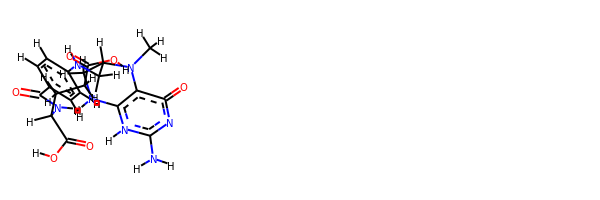

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])C([H])(C(=O)O[H])N([H])C(=O)c1c([H])c([H])c(N([H])C([H])([H])C2([H])N(C([H])([H])[H])c3c(n([H])c(N([H])[H])nc3=O)N([H])C2([H])[H])c([H])c1[H]
oechem:  CN1c2c([nH]c(nc2=O)N)NCC1CNc3ccc(cc3)C(=O)NC(CCC(=O)O)C(=O)O
Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :        4 matches
                                               [#6X4:1]-[#6X4:2] :        0 matches
                                               [#6X4:1]-[#6X3:2] :        0 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        0 matches
                                               [#6X3:1]-[#6X3:2] :        0 matches
                                               [#6X3:1]:[#6X3:2] :        0 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        0 matche

                                            [*:1]~[#6X3:2]~[*:3] :        0 matches
                                           [#1:1]-[#6X3:2]~[*:3] :        0 matches
                                          [#1:1]-[#6X3:2]-[#1:3] :        0 matches
                               [*;r6:1]~;@[*;r5:2]~;@[*;r5;x2:3] :        0 matches
                                    [*:1]~;!@[*;r5:2]~;@[*;r5:3] :        0 matches
                                        [#8X1:1]~[#6X3:2]~[#8:3] :        0 matches
                                            [*:1]~[#6X2:2]~[*:3] :        0 matches
                                [*:1]-[#7X4,#7X3,#7X2-1:2]-[*:3] :        0 matches
                               [#1:1]-[#7X4,#7X3,#7X2-1:2]-[*:3] :        0 matches
                     [*:1]~[#7X3$(*~[#6X3,#6X2,#7X2+0]):2]~[*:3] :        0 matches
                    [#1:1]-[#7X3$(*~[#6X3,#6X2,#7X2+0]):2]-[*:3] :        0 matches
                                            [*:1]~[#7X2:2]~[*:3] :        2 

                         [*:1]~[#7X3$(*~[#6X3]):2](~[*:3])~[*:4] :        0 matches
                         [*:1]~[#6X3:2](=[#7X2,#7X3+1:3])~[#7:4] :        0 matches

0 torsions added
0 impropers added, each applied in a six-fold manner

NonbondedForceGenerator:

                                                           [*:1] :        3 matches
                                                          [#1:1] :        0 matches
                                                   [#1:1]-[#6X4] :        0 matches
                            [#1:1]-[#6X4]-[#7,#8,#9,#16,#17,#35] :        0 matches
   [#1:1]-[#6X4](-[#7,#8,#9,#16,#17,#35])-[#7,#8,#9,#16,#17,#35] :        0 matches
[#1:1]-[#6X4](-[#7,#8,#9,#16,#17,#35])(-[#7,#8,#9,#16,#17,#35])-[#7,#8,#9,#16,#17,#35] :        0 matches
                                         [#1:1]-[#6X4]~[*+1,*+2] :        0 matches
                                                   [#1:1]-[#6X3] :        0 matches
                            [#1:1]-[#6X3


HarmonicAngleGenerator:

                                               [*:1]~[*:2]~[*:3] :        2 matches
                                            [*:1]~[#6X4:2]-[*:3] :        0 matches
                                          [#1:1]-[#6X4:2]-[#1:3] :        0 matches
                                [*;r3:1]1~;@[*;r3:2]~;@[*;r3:3]1 :        0 matches
                                    [*;r3:1]~;@[*;r3:2]~;!@[*:3] :        0 matches
                                      [*:1]~;!@[*;r3:2]~;!@[*:3] :        0 matches
                                        [#1:1]-[*;r3:2]~;!@[*:3] :        0 matches
                                            [*:1]~[#6X3:2]~[*:3] :        0 matches
                                           [#1:1]-[#6X3:2]~[*:3] :        0 matches
                                          [#1:1]-[#6X3:2]-[#1:3] :        0 matches
                               [*;r6:1]~;@[*;r5:2]~;@[*;r5;x2:3] :        0 matches
                                    [*:1]~;!@[*;r5

Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :      128 matches
                                               [#6X4:1]-[#6X4:2] :       14 matches
                                               [#6X4:1]-[#6X3:2] :        5 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        4 matches
                                               [#6X3:1]-[#6X3:2] :        0 matches
                                               [#6X3:1]:[#6X3:2] :       12 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        9 matches
                                               [#6X3:1]-[#7X3:2] :        4 matches
                               [#6X4:1]-[#7X3:2]-[#6X3]=[#8X1+0] :        3 matches
                                    [#6X3:1](=[#8X1+0])-[#7X3:2] :        2 match


PeriodicTorsionGenerator Propers:

                                         [*:1]~[*:2]~[*:3]~[*:4] :      334 matches
                                   [*:1]-[#6X4:2]-[#6X4:3]-[*:4] :      126 matches
                             [#6X4:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        4 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#1:4] :       44 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :       14 matches
                             [#8X2:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#9:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                               [#17:1]-[#6X4:2]-[#6X4:3]-[#17:4] :        0 matches
                               [#35:1]-[#6X4:2]-[#6X4:3]-[#35:4] :        0 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                                [#1:1]-[

Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :      128 matches
                                               [#6X4:1]-[#6X4:2] :       14 matches
                                               [#6X4:1]-[#6X3:2] :        5 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        4 matches
                                               [#6X3:1]-[#6X3:2] :        0 matches
                                               [#6X3:1]:[#6X3:2] :       12 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        9 matches
                                               [#6X3:1]-[#7X3:2] :        4 matches
                               [#6X4:1]-[#7X3:2]-[#6X3]=[#8X1+0] :        3 matches
                                    [#6X3:1](=[#8X1+0])-[#7X3:2] :        2 match


PeriodicTorsionGenerator Propers:

                                         [*:1]~[*:2]~[*:3]~[*:4] :      334 matches
                                   [*:1]-[#6X4:2]-[#6X4:3]-[*:4] :      126 matches
                             [#6X4:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :        4 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#1:4] :       44 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#6X4:4] :       14 matches
                             [#8X2:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#9:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                               [#17:1]-[#6X4:2]-[#6X4:3]-[#17:4] :        0 matches
                               [#35:1]-[#6X4:2]-[#6X4:3]-[#35:4] :        0 matches
                               [#1:1]-[#6X4:2]-[#6X4:3]-[#8X2:4] :        0 matches
                                 [#1:1]-[#6X4:2]-[#6X4:3]-[#9:4] :        0 matches
                                [#1:1]-[

Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       42 matches
                                               [#6X4:1]-[#6X4:2] :        0 matches
                                               [#6X4:1]-[#6X3:2] :        2 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        1 matches
                                               [#6X3:1]-[#6X3:2] :        2 matches
                                               [#6X3:1]:[#6X3:2] :       12 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        0 matches
                                               [#6X3:1]-[#7X3:2] :        0 matches
                               [#6X4:1]-[#7X3:2]-[#6X3]=[#8X1+0] :        0 matches
                                    [#6X3:1](=[#8X1+0])-[#7X3:2] :        0 match

Charges specified in provided molecules will be used.

HarmonicBondGenerator:

                                                     [*:1]~[*:2] :       42 matches
                                               [#6X4:1]-[#6X4:2] :        0 matches
                                               [#6X4:1]-[#6X3:2] :        2 matches
                                      [#6X4:1]-[#6X3:2]=[#8X1+0] :        1 matches
                                               [#6X3:1]-[#6X3:2] :        2 matches
                                               [#6X3:1]:[#6X3:2] :       12 matches
                                               [#6X3:1]=[#6X3:2] :        0 matches
                                                   [#6:1]-[#7:2] :        0 matches
                                               [#6X3:1]-[#7X3:2] :        0 matches
                               [#6X4:1]-[#7X3:2]-[#6X3]=[#8X1+0] :        0 matches
                                    [#6X3:1](=[#8X1+0])-[#7X3:2] :        0 match

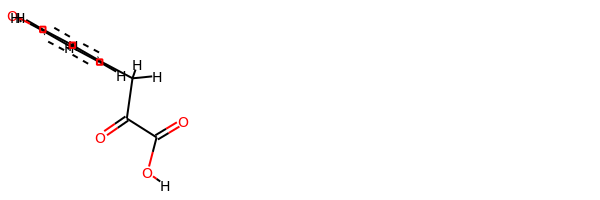

rdkit:  [H]OC(=O)C(=O)C([H])([H])c1c([H])c([H])c(O[H])c([H])c1[H]
oechem:  c1cc(ccc1CC(=O)C(=O)O)O


In [123]:
def compare_energies(rdkmol, oemol):
    if rdkmol == None:
        print("RDK parsing error")
        return False
#     print(Chem.MolToSmiles(rdkmol))
    positions_rdk = extractPositionsFromRDKMol(rdkmol)
    forcefield = smirnoff.forcefield_rdk.ForceField(ff_filename)
    topology_rdk = smirnoff.forcefield_rdk.generateTopologyFromRDKMol(rdkmol)
    system_rdk = forcefield.createSystem(topology_rdk, [rdkmol], verbose = True)
    
    print("###########################################################################\n #########################################################\n")
    
    positions_oe = extractPositionsFromOEMol(oemol)
    forcefield = smirnoff.forcefield.ForceField(ff_filename)
    topology_oe = smirnoff.forcefield.generateTopologyFromOEMol(oemol)
    system_oe = forcefield.createSystem(topology_oe, [oemol], verbose = True)

    g1,g2,e1,e2 = smirnoff.forcefield_utils.compare_system_energies(topology_oe, topology_rdk, system_oe, system_rdk, positions_oe, positions_rdk, verbose = False,skip_assert = True)
#     g1,g2,e1,e2 = smirnoff.forcefield_utils.compare_system_energies(topology_oe, topology_oe, system_oe, system_oe, positions_oe, positions_oe, verbose = False,skip_assert = True)
    if(e1 == e2): return False
    for i in g1:
        print(i)
        print(g1[i], g2[i], g1[i] == g2[i])

    print( e1, e2)
    print('')
    return True

#mol_filename = os.path.dirname(os.path.abspath(os.path.join('..'))) + "openforcefield/data/molecules/zinc-subset-tripos.mol2.gz"
mol_filename = "/home/shuwang/remove_oeimplicityHydrogen.mol2"
    
istream = oechem.oemolistream(mol_filename)
mol = oechem.OEMol()
flavor = oechem.OEIFlavor_Generic_Default | oechem.OEIFlavor_MOL2_Default | oechem.OEIFlavor_MOL2_Forcefield
istream.SetFlavor( oechem.OEFormat_MOL2, flavor)
oemols_tripos = []
while oechem.OEReadMolecule(istream, mol):
    oechem.OETriposAtomNames(mol)
    oemols_tripos.append(oechem.OEMol(mol))
istream.close()



# ofs = oemolostream("/home/shuwang/out.sdf")
# ofs.SetFormat(OEFormat_SDF)


for mol in oemols_tripos:
    
    oemol = mol
    rdkmol = oemol_to_rdkmol(oemol)
    rdkmol.UpdatePropertyCache(strict=False)
    Chem.GetSSSR(rdkmol)
    OEAssignAromaticFlags(oemol)
    out = compare_energies(rdkmol, oemol)
    print("-------------------------------------------------------------------")
    print("-------------------------------------------------------------------")
    print("-------------------------------------------------------------------")
    
    if out:
        print(mol.GetTitle())
        x = Draw.MolsToGridImage([rdkmol], kekulize = False)
        display(x)
        print("rdkit: ", Chem.MolToSmiles(rdkmol, isomericSmiles = True))
        OESMILES_OPTIONS = oechem.OESMILESFlag_DEFAULT | oechem.OESMILESFlag_ISOMERIC | oechem.OESMILESFlag_Hydrogens
        
        print("oechem: ", oechem.OECreateSmiString(oemol))
        

    

    
#     print(Chem.MolToMolBlock(rdkmol)[0:21])
#     x = Draw.MolsToGridImage([rdkmol], kekulize = False)
#     display(x)
#     print("rdkit: ", Chem.MolToSmiles(rdkmol, isomericSmiles = True))
#     print("oechem: ", OEMolToSmiles(oemols_tripos[counter-1]))


# ofs.close()


-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_364


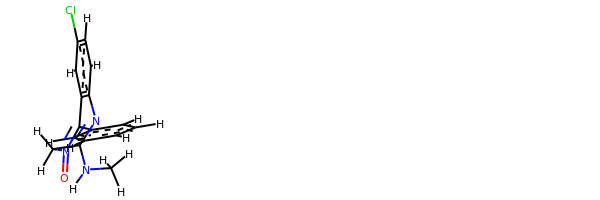

rdkit:  [H]c1c([H])c([H])c(C2=N(=O)C([H])([H])C(N([H])C([H])([H])[H])=Nc3c([H])c([H])c(Cl)c([H])c32)c([H])c1[H]
oechem:  CNC1=Nc2ccc(cc2C(=N(=O)C1)c3ccccc3)Cl
-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1543


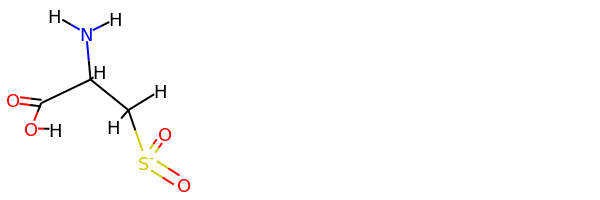

rdkit:  [H]OC(=O)C([H])(N([H])[H])C([H])([H])[S-](=O)=O
oechem:  C(C(C(=O)O)N)[S-](=O)=O
-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1800


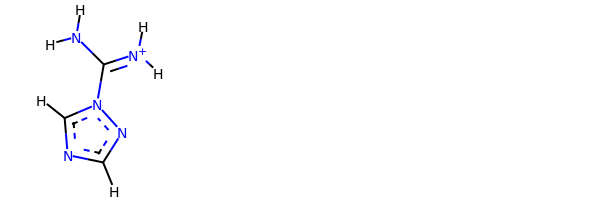

rdkit:  [H]c1nc([H])n(C(N([H])[H])=[N+]([H])[H])n1
oechem:  c1ncn(n1)C(=[NH2+])N
-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1900


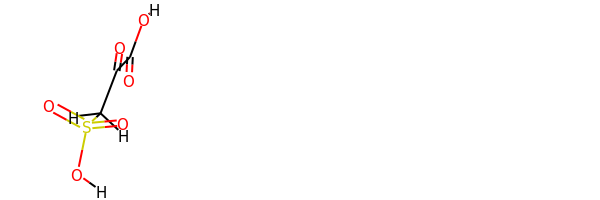

rdkit:  [H]OC(=O)C(=O)C([H])([H])S(=O)(=O)O[H]
oechem:  C(C(=O)C(=O)O)S(=O)(=O)O
-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2029


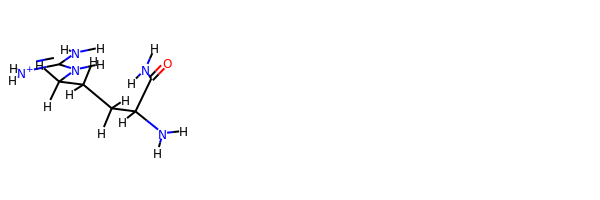

rdkit:  [H]N([H])C(=O)C([H])(N([H])[H])C([H])([H])C([H])([H])C([H])([H])N([H])C(N([H])[H])=[N+]([H])[H]
oechem:  C(CC(C(=O)N)N)CNC(=[NH2+])N
-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2087


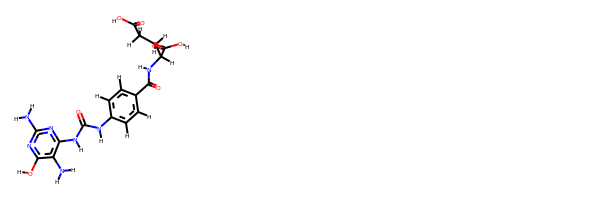

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])C([H])(C(=O)O[H])N([H])C(=O)c1c([H])c([H])c(N([H])C(=O)N([H])c2nc(N([H])[H])nc(O[H])c2N([H])[H])c([H])c1[H]
oechem:  c1cc(ccc1C(=O)NC(CCC(=O)O)C(=O)O)NC(=O)Nc2c(c(nc(n2)N)O)N
-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2344


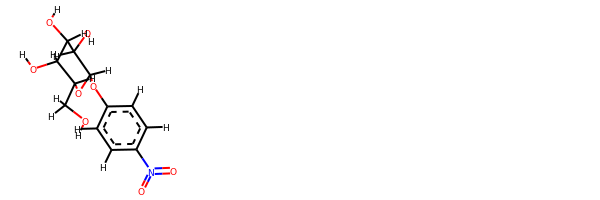

rdkit:  [H]OC([H])([H])C1([H])OC([H])(Oc2c([H])c([H])c(N(=O)=O)c([H])c2[H])C([H])(O[H])C([H])(O[H])C1([H])O[H]
oechem:  c1cc(ccc1N(=O)=O)OC2C(C(C(C(O2)CO)O)O)O
-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2397


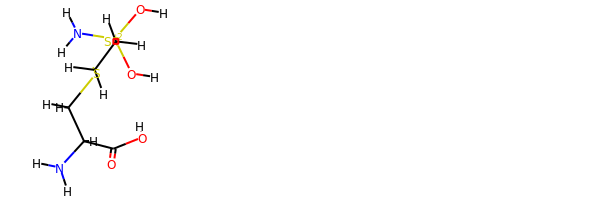

rdkit:  [H]OC(=O)C([H])(N([H])[H])C([H])([H])SC([H])([H])C([H])([H])[S+2](O[H])(O[H])N([H])[H]
oechem:  C(C[S+2](N)(O)O)SCC(C(=O)O)N
-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2450


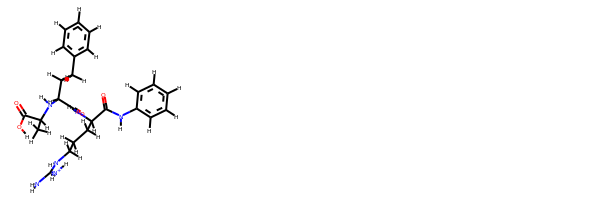

rdkit:  [H]OC(=O)C([H])(N([H])C([H])(C(=O)N([H])C([H])(C(=O)N([H])c1c([H])c([H])c([H])c([H])c1[H])C([H])([H])C([H])([H])C([H])([H])N([H])C(N([H])[H])=[N+]([H])[H])C([H])([H])C([H])([H])c1c([H])c([H])c([H])c([H])c1[H])C([H])([H])[H]
oechem:  CC(C(=O)O)NC(CCc1ccccc1)C(=O)NC(CCCNC(=[NH2+])N)C(=O)Nc2ccccc2
-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2543


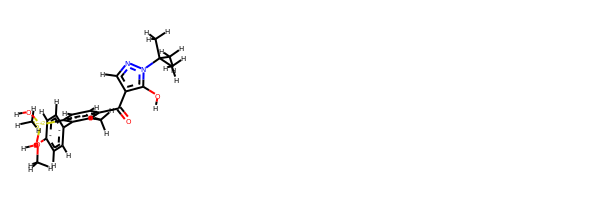

rdkit:  [H]Oc1c(C(=O)c2c([H])c([H])c([S+2](O[H])(O[H])C([H])([H])[H])c(-c3c([H])c([H])c(OC([H])([H])[H])c([H])c3[H])c2C([H])([H])[H])c([H])nn1C(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H]
oechem:  Cc1c(ccc(c1c2ccc(cc2)OC)[S+2](C)(O)O)C(=O)c3cnn(c3O)C(C)(C)C
-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2567


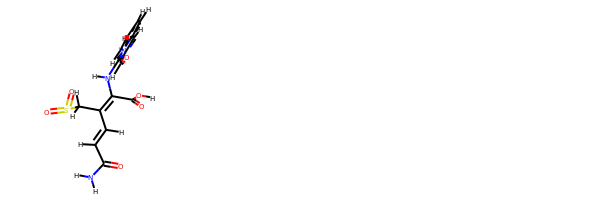

rdkit:  [H]OC(=O)C(=C(C([H])=C([H])C(=O)N([H])[H])C([H])([H])[S-](=O)=O)N([H])c1c(C([H])=O)c([H])c2c([H])c([H])c([H])c([H])n12
oechem:  c1ccn2c(c1)cc(c2NC(=C(C[S-](=O)=O)C=CC(=O)N)C(=O)O)C=O
-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2798


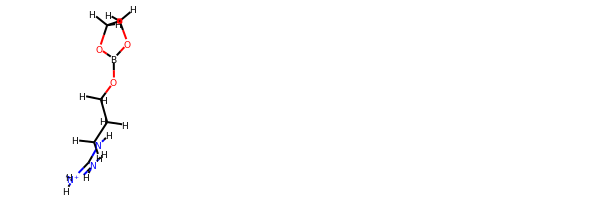

rdkit:  [H]N([H])C(N([H])C([H])([H])C([H])([H])C([H])([H])OB1OC([H])([H])C([H])([H])O1)=[N+]([H])[H]
oechem:  B1(OCCO1)OCCCNC(=[NH2+])N
-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3090


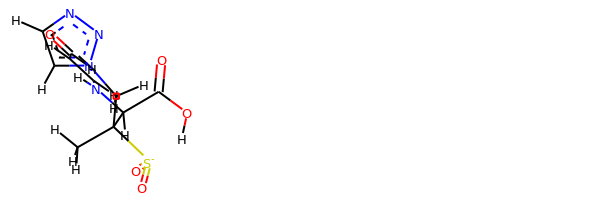

rdkit:  [H]OC(=O)C([H])(N([H])C([H])=C([H])C([H])=O)C([S-](=O)=O)(C([H])([H])[H])C([H])([H])n1nnc([H])c1[H]
oechem:  CC(Cn1ccnn1)(C(C(=O)O)NC=CC=O)[S-](=O)=O
-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3267


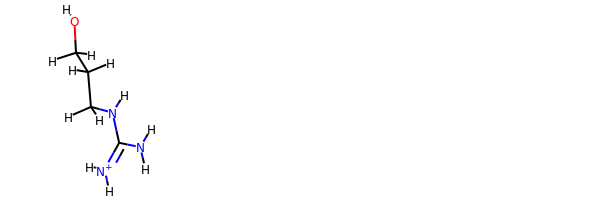

rdkit:  [H]OC([H])([H])C([H])([H])C([H])([H])N([H])C(N([H])[H])=[N+]([H])[H]
oechem:  C(CNC(=[NH2+])N)CO
-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3448


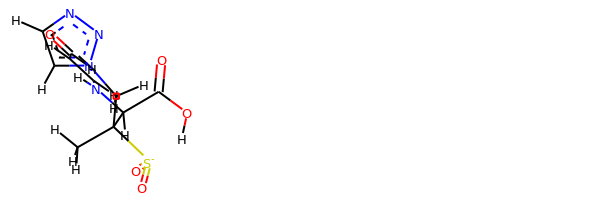

rdkit:  [H]OC(=O)C([H])(N([H])C([H])=C([H])C([H])=O)C([S-](=O)=O)(C([H])([H])[H])C([H])([H])n1nnc([H])c1[H]
oechem:  CC(Cn1ccnn1)(C(C(=O)O)NC=CC=O)[S-](=O)=O
-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3505


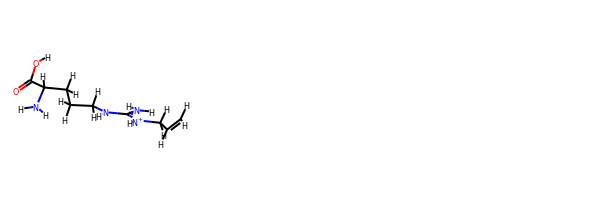

rdkit:  [H]OC(=O)C([H])(N([H])[H])C([H])([H])C([H])([H])C([H])([H])N([H])C(N([H])[H])=[N+]([H])C([H])([H])C([H])=C([H])[H]
oechem:  C=CC[NH+]=C(N)NCCCC(C(=O)O)N
-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3632


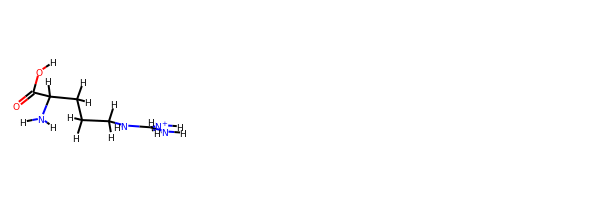

rdkit:  [H]OC(=O)C([H])(N([H])[H])C([H])([H])C([H])([H])C([H])([H])N([H])C(N([H])[H])=[N+]([H])[H]
oechem:  C(CC(C(=O)O)N)CNC(=[NH2+])N
-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3869


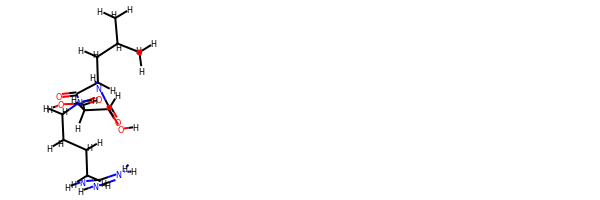

rdkit:  [H]OC(=O)C([H])([H])C([H])(O[H])C(=O)N([H])C([H])(C(=O)N([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])N([H])C(N([H])[H])=[N+]([H])[H])C([H])([H])C([H])(C([H])([H])[H])C([H])([H])[H]
oechem:  CC(C)CC(C(=O)NCCCCNC(=[NH2+])N)NC(=O)C(CC(=O)O)O
-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4119


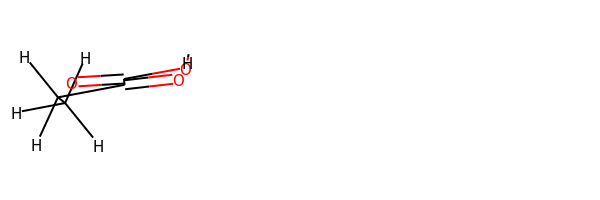

rdkit:  [H]OC(=O)C(=O)C([H])([H])C([H])([H])[H]
oechem:  CCC(=O)C(=O)O
-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4333


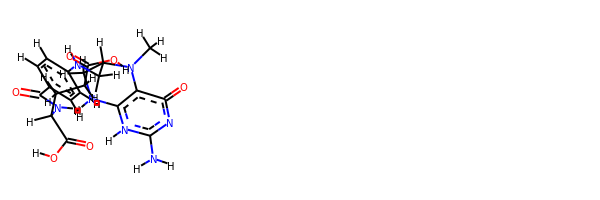

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])C([H])(C(=O)O[H])N([H])C(=O)c1c([H])c([H])c(N([H])C([H])([H])C2([H])N(C([H])([H])[H])c3c(n([H])c(N([H])[H])nc3=O)N([H])C2([H])[H])c([H])c1[H]
oechem:  CN1c2c([nH]c(nc2=O)N)NCC1CNc3ccc(cc3)C(=O)NC(CCC(=O)O)C(=O)O
-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4676


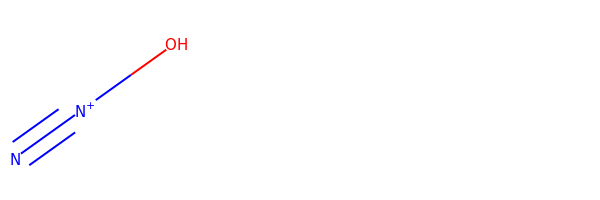

rdkit:  N#[N+]O
oechem:  N#[N+]O
-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4784


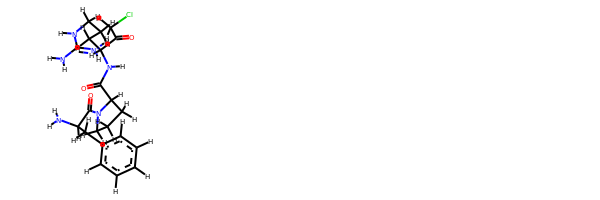

rdkit:  [H]c1c([H])c([H])c(C([H])([H])C([H])(C(=O)N2C([H])([H])C([H])([H])C([H])([H])C2([H])C(=O)N([H])C([H])(C(=O)C([H])([H])Cl)C([H])([H])C([H])([H])C([H])([H])N([H])C(N([H])[H])=[N+]([H])[H])N([H])[H])c([H])c1[H]
oechem:  c1ccc(cc1)CC(C(=O)N2CCCC2C(=O)NC(CCCNC(=[NH2+])N)C(=O)CCl)N
-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5640


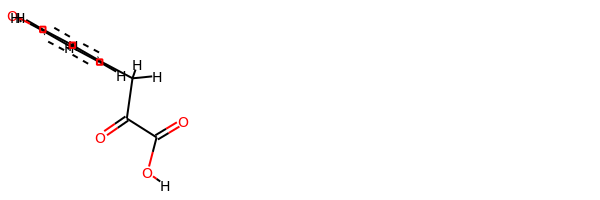

rdkit:  [H]OC(=O)C(=O)C([H])([H])c1c([H])c([H])c(O[H])c([H])c1[H]
oechem:  c1cc(ccc1CC(=O)C(=O)O)O


In [122]:
def compare_energies(rdkmol, oemol):
    if rdkmol == None:
        print("RDK parsing error")
        return False
#     print(Chem.MolToSmiles(rdkmol))
    positions_rdk = extractPositionsFromRDKMol(rdkmol)
    forcefield = smirnoff.forcefield_rdk.ForceField(ff_filename)
    topology_rdk = smirnoff.forcefield_rdk.generateTopologyFromRDKMol(rdkmol)
    system_rdk = forcefield.createSystem(topology_rdk, [rdkmol], verbose = True)
    
    print("###########################################################################\n #########################################################\n")
    
    positions_oe = extractPositionsFromOEMol(oemol)
    forcefield = smirnoff.forcefield.ForceField(ff_filename)
    topology_oe = smirnoff.forcefield.generateTopologyFromOEMol(oemol)
    system_oe = forcefield.createSystem(topology_oe, [oemol], verbose = True)

    g1,g2,e1,e2 = smirnoff.forcefield_utils.compare_system_energies(topology_oe, topology_rdk, system_oe, system_rdk, positions_oe, positions_rdk, verbose = False,skip_assert = True)
#     g1,g2,e1,e2 = smirnoff.forcefield_utils.compare_system_energies(topology_oe, topology_oe, system_oe, system_oe, positions_oe, positions_oe, verbose = False,skip_assert = True)
    if(e1 == e2): return False
    for i in g1:
        print(i)
        print(g1[i], g2[i], g1[i] == g2[i])

    print( e1, e2)
    print('')
    return True

#mol_filename = os.path.dirname(os.path.abspath(os.path.join('..'))) + "openforcefield/data/molecules/zinc-subset-tripos.mol2.gz"
mol_filename = "/home/shuwang/remove_oeimplicityHydrogen.mol2"
    
istream = oechem.oemolistream(mol_filename)
mol = oechem.OEMol()
flavor = oechem.OEIFlavor_Generic_Default | oechem.OEIFlavor_MOL2_Default | oechem.OEIFlavor_MOL2_Forcefield
istream.SetFlavor( oechem.OEFormat_MOL2, flavor)
oemols_tripos = []
while oechem.OEReadMolecule(istream, mol):
    oechem.OETriposAtomNames(mol)
    oemols_tripos.append(oechem.OEMol(mol))
istream.close()



# ofs = oemolostream("/home/shuwang/out.sdf")
# ofs.SetFormat(OEFormat_SDF)


for mol in oemols_tripos:
    
    oemol = mol
    rdkmol = oemol_to_rdkmol(oemol)
    rdkmol.UpdatePropertyCache(strict=False)
    Chem.GetSSSR(rdkmol)
    
    print("-------------------------------------------------------------------")
    print("-------------------------------------------------------------------")
    print("-------------------------------------------------------------------")
    

    print(mol.GetTitle())
    x = Draw.MolsToGridImage([rdkmol], kekulize = False)
    display(x)
    print("rdkit: ", Chem.MolToSmiles(rdkmol, isomericSmiles = True))
    OESMILES_OPTIONS = oechem.OESMILESFlag_DEFAULT | oechem.OESMILESFlag_ISOMERIC | oechem.OESMILESFlag_Hydrogens

#     print("oechem: ", oechem.OECreateSmiString(oemol, OESMILES_OPTIONS))
    print("oechem: ", oechem.OECreateSmiString(oemol))


    

    
#     print(Chem.MolToMolBlock(rdkmol)[0:21])
#     x = Draw.MolsToGridImage([rdkmol], kekulize = False)
#     display(x)
#     print("rdkit: ", Chem.MolToSmiles(rdkmol, isomericSmiles = True))
#     print("oechem: ", OEMolToSmiles(oemols_tripos[counter-1]))


# ofs.close()


###########################################################################
 #########################################################

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_364


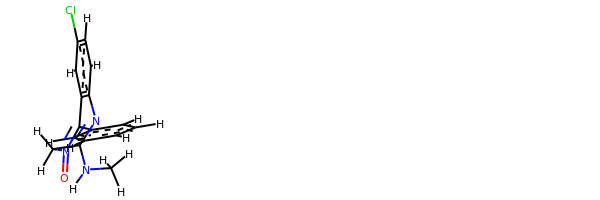

rdkit:  [H]c1c([H])c([H])c(C2=N(=O)C([H])([H])C(N([H])C([H])([H])[H])=Nc3c([H])c([H])c(Cl)c([H])c32)c([H])c1[H]
oechem:  CNC1=Nc2ccc(cc2C(=N(=O)C1)c3ccccc3)Cl
###########################################################################
 #########################################################

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1543


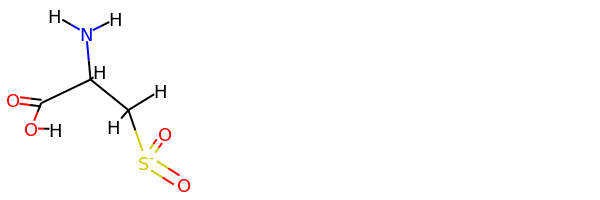

rdkit:  [H]OC(=O)C([H])(N([H])[H])C([H])([H])[S-](=O)=O
oechem:  C(C(C(=O)O)N)[S-](=O)=O
###########################################################################
 #########################################################

bond
36.68553447190298 kJ/mol 29193.776741695754 kJ/mol False
angle
87.77439433962951 kJ/mol 87.77439433962951 kJ/mol True
nb
1.4768410072644134 kJ/mol 1.4768410072644134 kJ/mol True
torsion
21.98536638877206 kJ/mol 16.754417122835225 kJ/mol False
147.92213620756897 kJ/mol 29299.782394165486 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1800


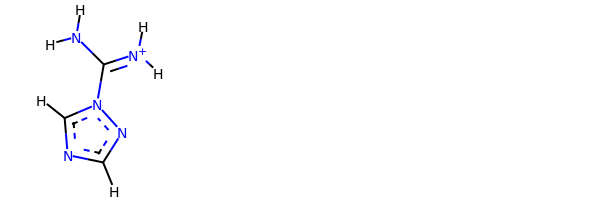

rdkit:  [H]c1nc([H])n(C(N([H])[H])=[N+]([H])[H])n1
oechem:  c1ncn(n1)C(=[NH2+])N
###########################################################################
 #########################################################

bond
11.724343006813776 kJ/mol 11.724343006813776 kJ/mol True
angle
40.14816650649524 kJ/mol 40.14816650649524 kJ/mol True
nb
9.748261628391385 kJ/mol 9.748261628391385 kJ/mol True
torsion
16.168414222156553 kJ/mol 16.16841422215655 kJ/mol False
77.78918536385696 kJ/mol 77.78918536385694 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1900


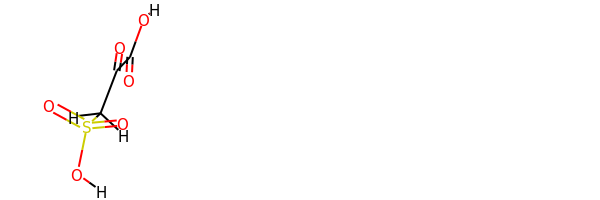

rdkit:  [H]OC(=O)C(=O)C([H])([H])S(=O)(=O)O[H]
oechem:  C(C(=O)C(=O)O)S(=O)(=O)O
###########################################################################
 #########################################################

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2029


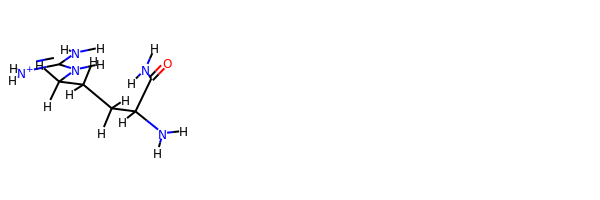

rdkit:  [H]N([H])C(=O)C([H])(N([H])[H])C([H])([H])C([H])([H])C([H])([H])N([H])C(N([H])[H])=[N+]([H])[H]
oechem:  C(CC(C(=O)N)N)CNC(=[NH2+])N
###########################################################################
 #########################################################

bond
41.90370436315399 kJ/mol 41.90370436315399 kJ/mol True
angle
80.49804847656618 kJ/mol 80.49804847656618 kJ/mol True
nb
81.08324528905254 kJ/mol 81.08324528905254 kJ/mol True
torsion
8.066930905144714 kJ/mol 8.066930905144716 kJ/mol False
211.55192903391742 kJ/mol 211.55192903391745 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2087


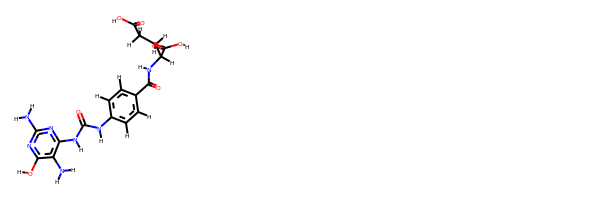

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])C([H])(C(=O)O[H])N([H])C(=O)c1c([H])c([H])c(N([H])C(=O)N([H])c2nc(N([H])[H])nc(O[H])c2N([H])[H])c([H])c1[H]
oechem:  c1cc(ccc1C(=O)NC(CCC(=O)O)C(=O)O)NC(=O)Nc2c(c(nc(n2)N)O)N
###########################################################################
 #########################################################

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2344


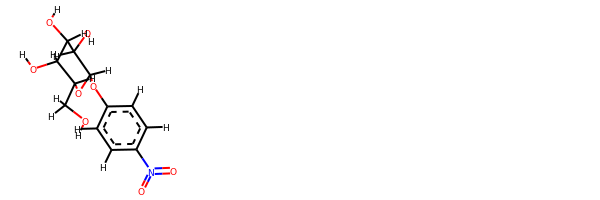

rdkit:  [H]OC([H])([H])C1([H])OC([H])(Oc2c([H])c([H])c(N(=O)=O)c([H])c2[H])C([H])(O[H])C([H])(O[H])C1([H])O[H]
oechem:  c1cc(ccc1N(=O)=O)OC2C(C(C(C(O2)CO)O)O)O
###########################################################################
 #########################################################

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2397


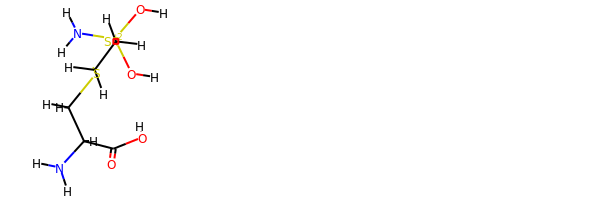

rdkit:  [H]OC(=O)C([H])(N([H])[H])C([H])([H])SC([H])([H])C([H])([H])[S+2](O[H])(O[H])N([H])[H]
oechem:  C(C[S+2](N)(O)O)SCC(C(=O)O)N
###########################################################################
 #########################################################

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2450


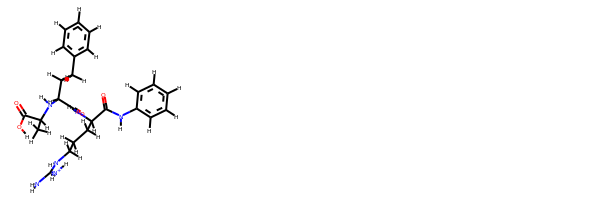

rdkit:  [H]OC(=O)C([H])(N([H])C([H])(C(=O)N([H])C([H])(C(=O)N([H])c1c([H])c([H])c([H])c([H])c1[H])C([H])([H])C([H])([H])C([H])([H])N([H])C(N([H])[H])=[N+]([H])[H])C([H])([H])C([H])([H])c1c([H])c([H])c([H])c([H])c1[H])C([H])([H])[H]
oechem:  CC(C(=O)O)NC(CCc1ccccc1)C(=O)NC(CCCNC(=[NH2+])N)C(=O)Nc2ccccc2
###########################################################################
 #########################################################

bond
33.58069187418279 kJ/mol 29101.19446326907 kJ/mol False
angle
109.10236007224482 kJ/mol 109.10236007224482 kJ/mol True
nb
70.97082953416353 kJ/mol 70.97082953416353 kJ/mol True
torsion
87.4452383536624 kJ/mol 79.70518408659836 kJ/mol False
301.09911983425354 kJ/mol 29360.97283696207 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2543


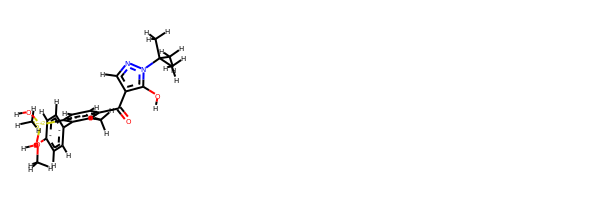

rdkit:  [H]Oc1c(C(=O)c2c([H])c([H])c([S+2](O[H])(O[H])C([H])([H])[H])c(-c3c([H])c([H])c(OC([H])([H])[H])c([H])c3[H])c2C([H])([H])[H])c([H])nn1C(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H]
oechem:  Cc1c(ccc(c1c2ccc(cc2)OC)[S+2](C)(O)O)C(=O)c3cnn(c3O)C(C)(C)C
###########################################################################
 #########################################################

bond
43.510118946162784 kJ/mol 85716.45955885308 kJ/mol False
angle
149.26242009263885 kJ/mol 149.26242009263885 kJ/mol True
nb
16.21326215440892 kJ/mol 16.21326215440892 kJ/mol True
torsion
75.79931020524586 kJ/mol 75.7993501807613 kJ/mol False
284.7851113984564 kJ/mol 85957.7345912809 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2567


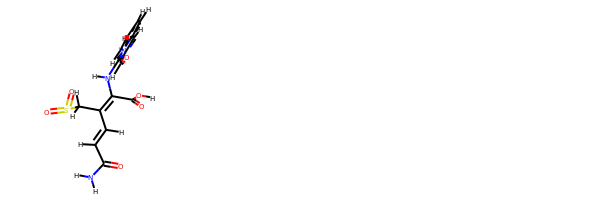

rdkit:  [H]OC(=O)C(=C(C([H])=C([H])C(=O)N([H])[H])C([H])([H])[S-](=O)=O)N([H])c1c(C([H])=O)c([H])c2c([H])c([H])c([H])c([H])n12
oechem:  c1ccn2c(c1)cc(c2NC(=C(C[S-](=O)=O)C=CC(=O)N)C(=O)O)C=O
###########################################################################
 #########################################################

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2798


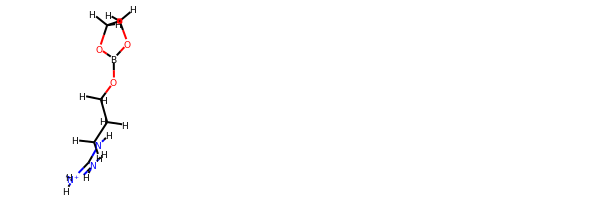

rdkit:  [H]N([H])C(N([H])C([H])([H])C([H])([H])C([H])([H])OB1OC([H])([H])C([H])([H])O1)=[N+]([H])[H]
oechem:  B1(OCCO1)OCCCNC(=[NH2+])N
###########################################################################
 #########################################################

bond
46.51358623402871 kJ/mol 29186.482816526852 kJ/mol False
angle
142.06600410468397 kJ/mol 142.06600410468397 kJ/mol True
nb
4.16159613161081 kJ/mol 4.16159613161081 kJ/mol True
torsion
16.801957666432106 kJ/mol 11.571959433609846 kJ/mol False
209.54314413675561 kJ/mol 29344.282376196756 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3090


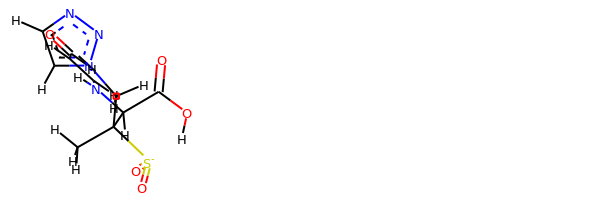

rdkit:  [H]OC(=O)C([H])(N([H])C([H])=C([H])C([H])=O)C([S-](=O)=O)(C([H])([H])[H])C([H])([H])n1nnc([H])c1[H]
oechem:  CC(Cn1ccnn1)(C(C(=O)O)NC=CC=O)[S-](=O)=O
###########################################################################
 #########################################################

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3267


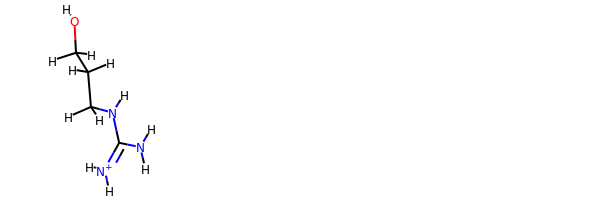

rdkit:  [H]OC([H])([H])C([H])([H])C([H])([H])N([H])C(N([H])[H])=[N+]([H])[H]
oechem:  C(CNC(=[NH2+])N)CO
###########################################################################
 #########################################################

bond
46.51358623402871 kJ/mol 29186.482816526852 kJ/mol False
angle
142.06600410468397 kJ/mol 142.06600410468397 kJ/mol True
nb
4.16159613161081 kJ/mol 4.16159613161081 kJ/mol True
torsion
16.801957666432106 kJ/mol 11.571959433609846 kJ/mol False
209.54314413675561 kJ/mol 29344.282376196756 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3448


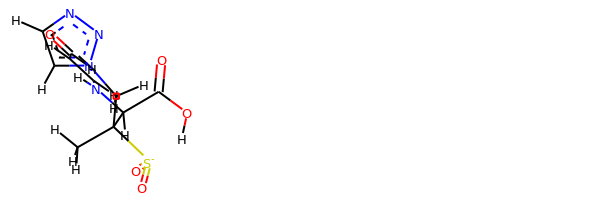

rdkit:  [H]OC(=O)C([H])(N([H])C([H])=C([H])C([H])=O)C([S-](=O)=O)(C([H])([H])[H])C([H])([H])n1nnc([H])c1[H]
oechem:  CC(Cn1ccnn1)(C(C(=O)O)NC=CC=O)[S-](=O)=O
###########################################################################
 #########################################################

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3505


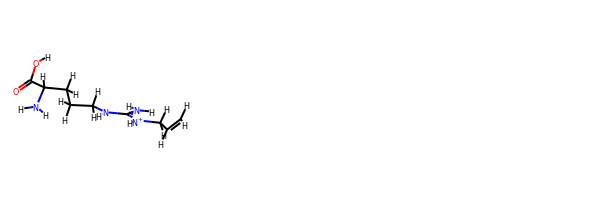

rdkit:  [H]OC(=O)C([H])(N([H])[H])C([H])([H])C([H])([H])C([H])([H])N([H])C(N([H])[H])=[N+]([H])C([H])([H])C([H])=C([H])[H]
oechem:  C=CC[NH+]=C(N)NCCCC(C(=O)O)N
###########################################################################
 #########################################################

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3632


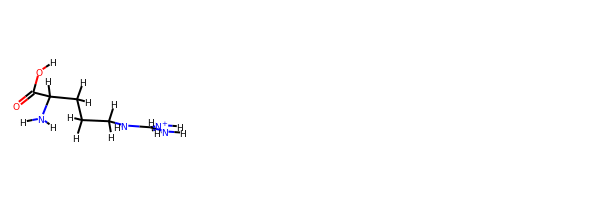

rdkit:  [H]OC(=O)C([H])(N([H])[H])C([H])([H])C([H])([H])C([H])([H])N([H])C(N([H])[H])=[N+]([H])[H]
oechem:  C(CC(C(=O)O)N)CNC(=[NH2+])N
###########################################################################
 #########################################################

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3869


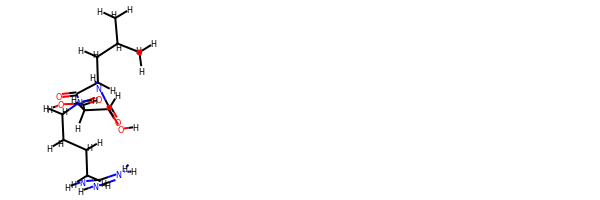

rdkit:  [H]OC(=O)C([H])([H])C([H])(O[H])C(=O)N([H])C([H])(C(=O)N([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])N([H])C(N([H])[H])=[N+]([H])[H])C([H])([H])C([H])(C([H])([H])[H])C([H])([H])[H]
oechem:  CC(C)CC(C(=O)NCCCCNC(=[NH2+])N)NC(=O)C(CC(=O)O)O
###########################################################################
 #########################################################

bond
7.952166585936798 kJ/mol 7.952166585936798 kJ/mol True
angle
15.726746347529577 kJ/mol 15.726746347529577 kJ/mol True
nb
13.662877658084783 kJ/mol 13.662877658084783 kJ/mol True
torsion
16.16577762796062 kJ/mol 16.165777627960622 kJ/mol False
53.507568219511775 kJ/mol 53.50756821951178 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4119


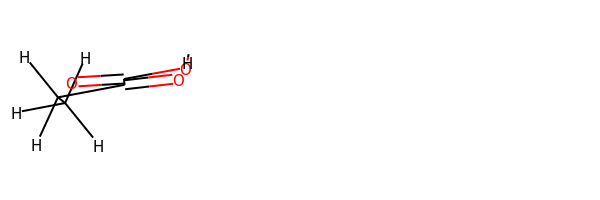

rdkit:  [H]OC(=O)C(=O)C([H])([H])C([H])([H])[H]
oechem:  CCC(=O)C(=O)O
###########################################################################
 #########################################################

bond
31.47030766970876 kJ/mol 57876.654176201766 kJ/mol False
angle
47.253142969916304 kJ/mol 47.56889927334513 kJ/mol False
nb
63.81831245959343 kJ/mol 63.81831245959343 kJ/mol True
torsion
32.16553640203189 kJ/mol 15.792698616086048 kJ/mol False
174.7072995012504 kJ/mol 58003.8340865508 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4333


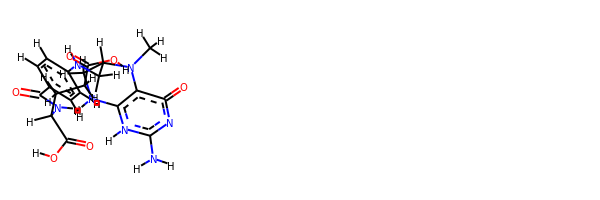

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])C([H])(C(=O)O[H])N([H])C(=O)c1c([H])c([H])c(N([H])C([H])([H])C2([H])N(C([H])([H])[H])c3c(n([H])c(N([H])[H])nc3=O)N([H])C2([H])[H])c([H])c1[H]
oechem:  CN1c2c([nH]c(nc2=O)N)NCC1CNc3ccc(cc3)C(=O)NC(CCC(=O)O)C(=O)O
###########################################################################
 #########################################################

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4676


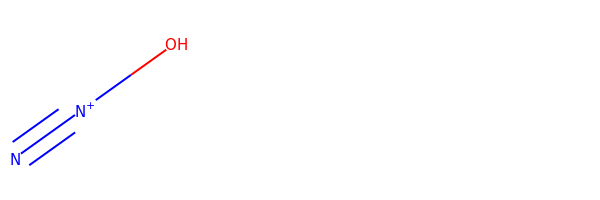

rdkit:  N#[N+]O
oechem:  N#[N+]O
###########################################################################
 #########################################################

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4784


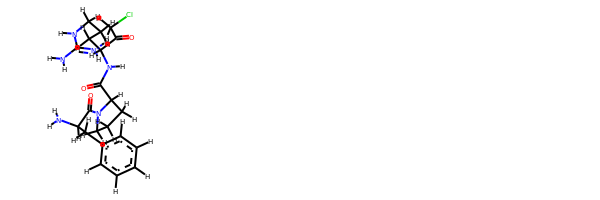

rdkit:  [H]c1c([H])c([H])c(C([H])([H])C([H])(C(=O)N2C([H])([H])C([H])([H])C([H])([H])C2([H])C(=O)N([H])C([H])(C(=O)C([H])([H])Cl)C([H])([H])C([H])([H])C([H])([H])N([H])C(N([H])[H])=[N+]([H])[H])N([H])[H])c([H])c1[H]
oechem:  c1ccc(cc1)CC(C(=O)N2CCCC2C(=O)NC(CCCNC(=[NH2+])N)C(=O)CCl)N
###########################################################################
 #########################################################

bond
9.223612279672462 kJ/mol 9.223612279672462 kJ/mol True
angle
16.426438886403865 kJ/mol 16.426438886403865 kJ/mol True
nb
25.242020514715904 kJ/mol 25.242020514715904 kJ/mol True
torsion
16.167205796890634 kJ/mol 16.16720579689063 kJ/mol False
67.05927747768287 kJ/mol 67.05927747768285 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5640


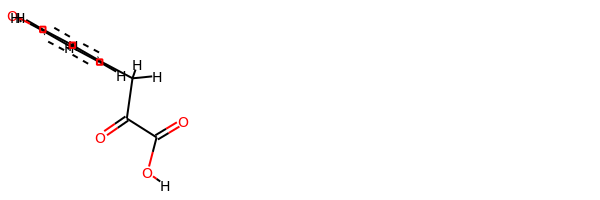

rdkit:  [H]OC(=O)C(=O)C([H])([H])c1c([H])c([H])c(O[H])c([H])c1[H]
oechem:  c1cc(ccc1CC(=O)C(=O)O)O


In [14]:
def compare_energies(rdkmol, oemol):
    if rdkmol == None:
        print("RDK parsing error")
        return False
#     print(Chem.MolToSmiles(rdkmol))
    positions_rdk = extractPositionsFromRDKMol(rdkmol)
    forcefield = smirnoff.forcefield_rdk.ForceField(ff_filename)
    topology_rdk = smirnoff.forcefield_rdk.generateTopologyFromRDKMol(rdkmol)
    system_rdk = forcefield.createSystem(topology_rdk, [rdkmol], verbose = False)
    
    print("###########################################################################\n #########################################################\n")
    
    positions_oe = extractPositionsFromOEMol(oemol)
    forcefield = smirnoff.forcefield.ForceField(ff_filename)
    topology_oe = smirnoff.forcefield.generateTopologyFromOEMol(oemol)
    system_oe = forcefield.createSystem(topology_oe, [oemol], verbose = False)

    g1,g2,e1,e2 = smirnoff.forcefield_utils.compare_system_energies(topology_oe, topology_rdk, system_oe, system_rdk, positions_oe, positions_rdk, verbose = False,skip_assert = True)
#     g1,g2,e1,e2 = smirnoff.forcefield_utils.compare_system_energies(topology_oe, topology_oe, system_oe, system_oe, positions_oe, positions_oe, verbose = False,skip_assert = True)
    if(e1 == e2): return False
    for i in g1:
        print(i)
        print(g1[i], g2[i], g1[i] == g2[i])

    print( e1, e2)
    print('')
    return True

#mol_filename = os.path.dirname(os.path.abspath(os.path.join('..'))) + "openforcefield/data/molecules/zinc-subset-tripos.mol2.gz"
mol_filename = "/home/shuwang/remove_oeimplicityHydrogen.mol2"
    
istream = oechem.oemolistream(mol_filename)
mol = oechem.OEMol()
flavor = oechem.OEIFlavor_Generic_Default | oechem.OEIFlavor_MOL2_Default | oechem.OEIFlavor_MOL2_Forcefield
istream.SetFlavor( oechem.OEFormat_MOL2, flavor)
oemols_tripos = []
while oechem.OEReadMolecule(istream, mol):
    oechem.OETriposAtomNames(mol)
    oemols_tripos.append(oechem.OEMol(mol))
istream.close()



# ofs = oemolostream("/home/shuwang/out.sdf")
# ofs.SetFormat(OEFormat_SDF)


for mol in oemols_tripos:
    
    oemol = mol
    rdkmol = oemol_to_rdkmol(oemol)
    rdkmol.UpdatePropertyCache(strict=False)
    Chem.GetSSSR(rdkmol)
    compare_energies(rdkmol, oemol)
    print("-------------------------------------------------------------------")
    print("-------------------------------------------------------------------")
    print("-------------------------------------------------------------------")
    

    print(mol.GetTitle())
    x = Draw.MolsToGridImage([rdkmol], kekulize = False)
    display(x)
    print("rdkit: ", Chem.MolToSmiles(rdkmol, isomericSmiles = True))
    OESMILES_OPTIONS = oechem.OESMILESFlag_DEFAULT | oechem.OESMILESFlag_ISOMERIC | oechem.OESMILESFlag_Hydrogens

#     print("oechem: ", oechem.OECreateSmiString(oemol, OESMILES_OPTIONS))
    print("oechem: ", oechem.OECreateSmiString(oemol))


    

    
#     print(Chem.MolToMolBlock(rdkmol)[0:21])
#     x = Draw.MolsToGridImage([rdkmol], kekulize = False)
#     display(x)
#     print("rdkit: ", Chem.MolToSmiles(rdkmol, isomericSmiles = True))
#     print("oechem: ", OEMolToSmiles(oemols_tripos[counter-1]))


# ofs.close()


###########################################################################
 #########################################################

bond
91.54688629343339 kJ/mol 115866.46788807525 kJ/mol False
angle
837.5194089856185 kJ/mol 840.760191995554 kJ/mol False
nb
51.88450303243761 kJ/mol 51.88450303243761 kJ/mol True
torsion
387.0977794804818 kJ/mol 386.7888937823103 kJ/mol False
1368.0485777919714 kJ/mol 117145.90147688556 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2


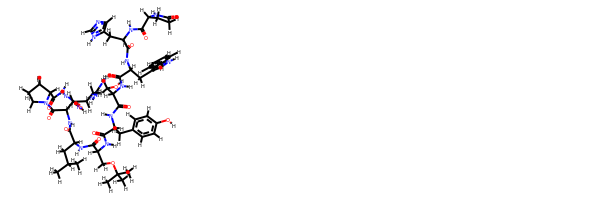

rdkit:  [H]Oc1c([H])c([H])c(C([H])([H])C([H])(C(=O)N([H])C([H])(C(=O)N([H])C([H])(C(=O)N([H])C([H])(C(=O)N2C([H])([H])C([H])([H])C([H])([H])C2([H])C(=O)N([H])N([H])C(=O)N([H])[H])C([H])([H])C([H])([H])C([H])([H])N=C(N([H])[H])N([H])[H])C([H])([H])C([H])(C([H])([H])[H])C([H])([H])[H])C([H])([H])OC(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H])N([H])C(=O)C([H])(N([H])C(=O)C([H])(N([H])C(=O)C([H])(N([H])C(=O)C2([H])N([H])C(=O)C([H])([H])C2([H])[H])C([H])([H])c2c([H])nc([H])n2[H])C([H])([H])c2c([H])n([H])c3c([H])c([H])c([H])c([H])c23)C([H])([H])O[H])c([H])c1[H]
oechem:  CC(C)CC(C(=O)NC(CCCN=C(N)N)C(=O)N1CCCC1C(=O)NNC(=O)N)NC(=O)C(COC(C)(C)C)NC(=O)C(Cc2ccc(cc2)O)NC(=O)C(CO)NC(=O)C(Cc3c[nH]c4c3cccc4)NC(=O)C(Cc5cnc[nH]5)NC(=O)C6CCC(=O)N6
###########################################################################
 #########################################################

bond
56.10905057600772 kJ/mol 57809.28560367369 kJ/mol False
angle
216.7964121377974 kJ/mol 218.02628358420594 kJ/mol False

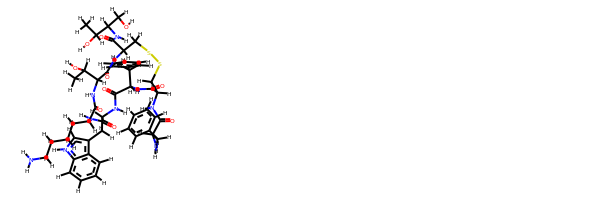

rdkit:  [H]OC([H])([H])C([H])(N([H])C(=O)C1([H])N([H])C(=O)C([H])(C([H])(O[H])C([H])([H])[H])N([H])C(=O)C([H])(C([H])([H])C([H])([H])C([H])([H])C([H])([H])N([H])[H])N([H])C(=O)C([H])(C([H])([H])c2c([H])n([H])c3c([H])c([H])c([H])c([H])c23)N([H])C(=O)C([H])(C([H])([H])c2c([H])c([H])c([H])c([H])c2[H])N([H])C(=O)C([H])(N([H])C(=O)C([H])(N([H])[H])C([H])([H])c2c([H])c([H])c([H])c([H])c2[H])C([H])([H])SSC1([H])[H])C([H])(O[H])C([H])([H])[H]
oechem:  CC(C1C(=O)NC(CSSCC(C(=O)NC(C(=O)NC(C(=O)NC(C(=O)N1)CCCCN)Cc2c[nH]c3c2cccc3)Cc4ccccc4)NC(=O)C(Cc5ccccc5)N)C(=O)NC(CO)C(C)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
5.829036321125393 kJ/mol 58026.743174588395 kJ/mol False
angle
109.21668534376681 kJ/mol 111.2276796570967 kJ/mol False
nb
-1.516955007456782 kJ/mol -1

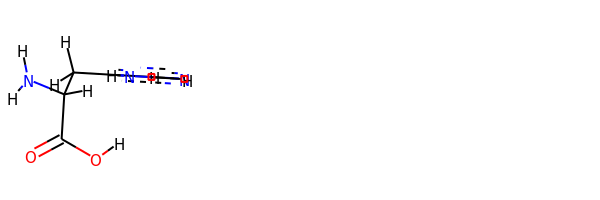

rdkit:  [H]OC(=O)C([H])(N([H])[H])C([H])([H])c1c([H])nc([H])n1[H]
oechem:  c1c([nH]cn1)CC(C(=O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ########

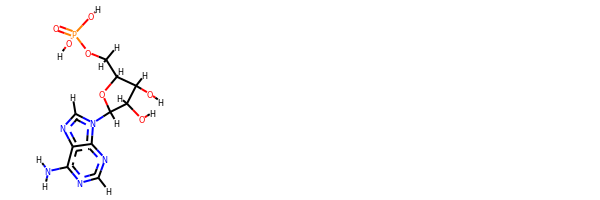

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)OC([H])(C([H])([H])OP(=O)(O[H])O[H])C1([H])O[H]
oechem:  c1nc(c2c(n1)n(cn2)C3C(C(C(O3)COP(=O)(O)O)O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###################

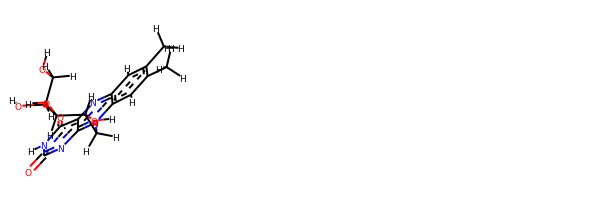

rdkit:  [H]OC([H])([H])C([H])(O[H])C([H])(O[H])C([H])(O[H])C([H])([H])n1c2nc(=O)n([H])c(=O)c-2nc2c([H])c(C([H])([H])[H])c(C([H])([H])[H])c([H])c21
oechem:  Cc1cc2c(cc1C)n(c-3nc(=O)[nH]c(=O)c3n2)CC(C(C(CO)O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #################################

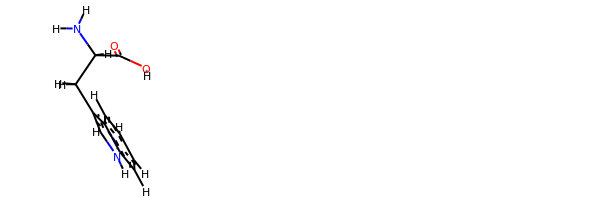

rdkit:  [H]OC(=O)C([H])(N([H])[H])C([H])([H])c1c([H])n([H])c2c([H])c([H])c([H])c([H])c12
oechem:  c1ccc2c(c1)c(c[nH]2)CC(C(=O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
16.676752814422553 kJ/mol 43696.36063198531 kJ/mol False
angle
64.87905201400518 kJ/mol 67.17975494644786 kJ/mol False
nb
37.40142536307701 kJ/mol 37.40142536307701 kJ/mol True
torsion
26.14346244377563 kJ/mol 1.7133447506556188 kJ/mol False
145.10069263528038 kJ/mol 43802.65515704549 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_45


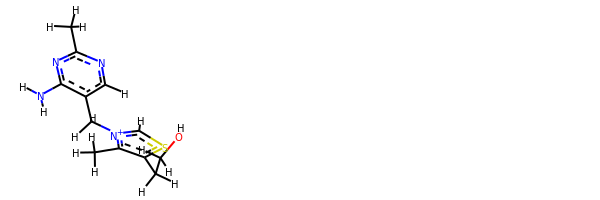

rdkit:  [H]OC([H])([H])C([H])([H])c1sc([H])[n+](C([H])([H])c2c([H])nc(C([H])([H])[H])nc2N([H])[H])c1C([H])([H])[H]
oechem:  Cc1c(sc[n+]1Cc2cnc(nc2N)C)CCO
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
19.767025428785796 kJ/mol 57137.14965799406 kJ/mol False
angle
52.16507680823689 kJ/mol 52.384168554713256 kJ/mol False
nb
66.18228634694985 kJ/mol 66.1822863469

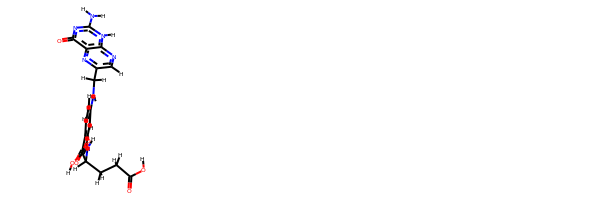

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])C([H])(C(=O)O[H])N([H])C(=O)c1c([H])c([H])c(N([H])C([H])([H])c2nc3c(=O)nc(N([H])[H])n([H])c3nc2[H])c([H])c1[H]
oechem:  c1cc(ccc1C(=O)NC(CCC(=O)O)C(=O)O)NCc2cnc3c(n2)c(=O)nc([nH]3)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ######################

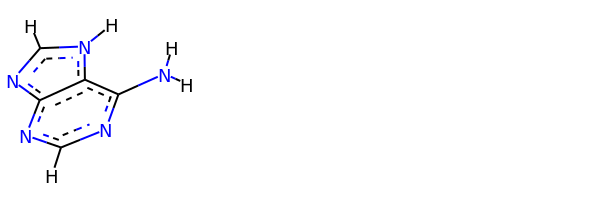

rdkit:  [H]c1nc(N([H])[H])c2c(n1)nc([H])n2[H]
oechem:  c1[nH]c2c(ncnc2n1)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
18.25583589868279 kJ/mol 14.333096785063283 kJ/mol False
angle
109.38262990093932 kJ/mol 109.57646687749813 kJ/mol False
nb
60.9355141097201 kJ/mol 60.9355141097201 kJ/mol True
torsion
66.74754395959832 kJ/mol 65.69222591894952 kJ/mol False
255.32152386894052 kJ/mol 250.53730369123105 kJ/mol

-------------------------------------------------------------------
--------------

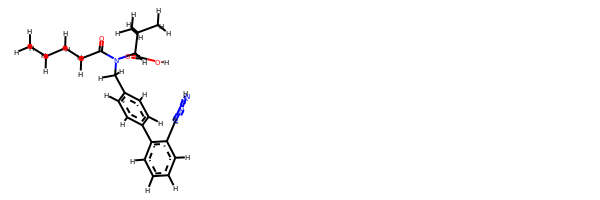

rdkit:  [H]OC(=O)C([H])(N(C(=O)C([H])([H])C([H])([H])C([H])([H])C([H])([H])[H])C([H])([H])c1c([H])c([H])c(-c2c([H])c([H])c([H])c([H])c2-c2nnn([H])n2)c([H])c1[H])C([H])(C([H])([H])[H])C([H])([H])[H]
oechem:  CCCCC(=O)N(Cc1ccc(cc1)c2ccccc2c3n[nH]nn3)C(C(C)C)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
46.52176469142552 kJ/mol 57800.915832514365 kJ/mol False
angle
165.26221590916253 kJ/mol 166.49134123898597 kJ/mol False
nb
73.39307731465269 kJ/mol 73.39307731465269 kJ/mol True
torsion
1

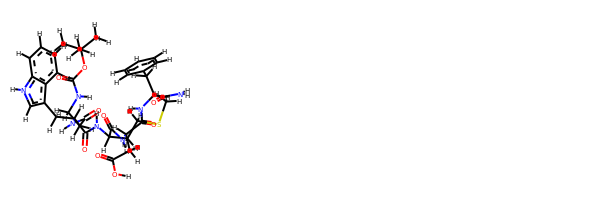

rdkit:  [H]OC(=O)C([H])([H])C([H])(C(=O)N([H])C([H])(C(=O)N([H])[H])C([H])([H])c1c([H])c([H])c([H])c([H])c1[H])N([H])C(=O)C([H])(N([H])C(=O)C([H])(N([H])C(=O)C([H])([H])C([H])([H])N([H])C(=O)OC(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H])C([H])([H])c1c([H])n([H])c2c([H])c([H])c([H])c([H])c12)C([H])([H])C([H])([H])SC([H])([H])[H]
oechem:  CC(C)(C)OC(=O)NCCC(=O)NC(Cc1c[nH]c2c1cccc2)C(=O)NC(CCSC)C(=O)NC(CC(=O)O)C(=O)NC(Cc3ccccc3)C(=O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

#################

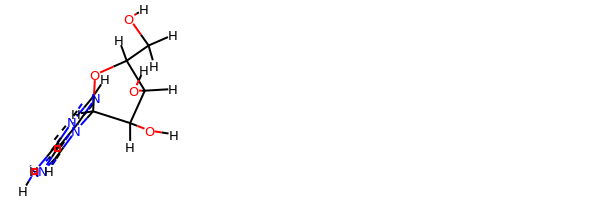

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)C([H])(O[H])C1([H])O[H]
oechem:  c1nc(c2c(n1)n(cn2)C3C(C(C(O3)CO)O)O)N
###########################################################################
 #########################################################

bond
20.01461699511054 kJ/mol 58335.18361086768 kJ/mol False
angle
187.82223047998238 kJ/mol 187.82223047998238 kJ/mol True
nb
19.712678252557236 kJ/mol 19.712678252557236 kJ/mol True
torsion
25.967051932377032 kJ/mol 8.325385937153033 kJ/mol False
253.51657766002717 kJ/mol 58551.04390553738 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_88


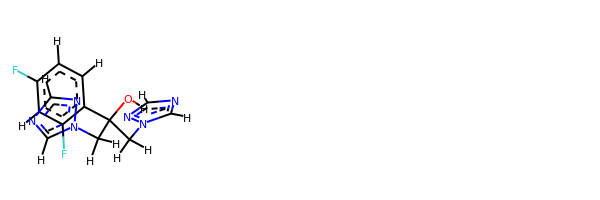

rdkit:  [H]OC(c1c([H])c([H])c(F)c([H])c1F)(C([H])([H])n1nc([H])nc1[H])C([H])([H])n1nc([H])nc1[H]
oechem:  c1cc(c(cc1F)F)C(Cn2cncn2)(Cn3cncn3)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
57.55156338672529 kJ/mol 169639.54801783685 kJ/mol False
angle
99.88067674384766 kJ/mol 99.88067674384766 kJ/mol True
nb
26.393899402021265 kJ/mol 26.393899402021265 kJ/mol True
torsion
0.00032701646756287537 kJ/mol 0.0011926325261550083 kJ/mol False
183.8264665490618 kJ/mol 169765.82378661525 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_93


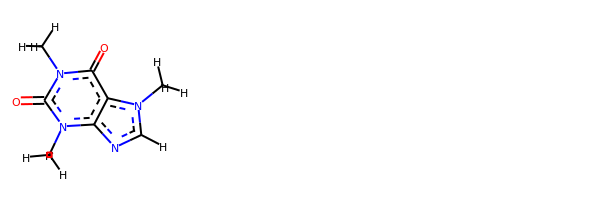

rdkit:  [H]c1nc2c(c(=O)n(C([H])([H])[H])c(=O)n2C([H])([H])[H])n1C([H])([H])[H]
oechem:  Cn1cnc2c1c(=O)n(c(=O)n2C)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
33.9576487733632 kJ/mol 87005.65736511127 kJ/mol False
angle
130.36300729118034 kJ/mol 130.74911035847805 kJ/mol False
nb
45.747529088050115 kJ/mol 45.747529088050115 kJ/mol True
torsion
123.09768238661424 kJ/mol 120.99344938448348 kJ/mol False
333.16586753920785 kJ/mol 87303.14745394228 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_95


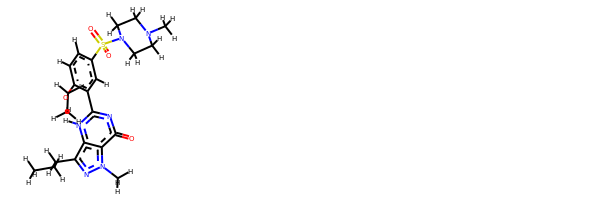

rdkit:  [H]c1c([H])c(S(=O)(=O)N2C([H])([H])C([H])([H])N(C([H])([H])[H])C([H])([H])C2([H])[H])c([H])c(-c2nc(=O)c3c(c(C([H])([H])C([H])([H])C([H])([H])[H])nn3C([H])([H])[H])n2[H])c1OC([H])([H])C([H])([H])[H]
oechem:  CCCc1c2c(c(=O)nc([nH]2)c3cc(ccc3OCC)S(=O)(=O)N4CCN(CC4)C)n(n1)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
60.596990979303875 kJ/mol 57822.33630287687 kJ/mol False
angle
150.80556278934074 kJ/mol 152.1497279501247 kJ/mol False
nb
174.5620138147271 kJ/mol 174.5620138147271 kJ/mol True
torsion
124.63285221507093 kJ/mol 108.77342184407784 kJ/mol False
510.5974197984427 kJ/mol 58257.8214664858 kJ/mol

--------------

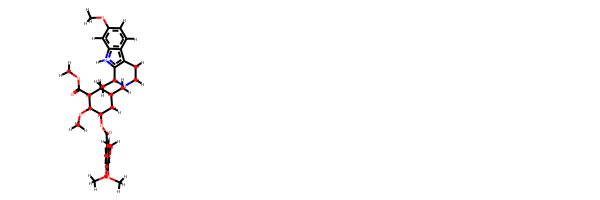

rdkit:  [H]c1c(OC([H])([H])[H])c(OC([H])([H])[H])c(OC([H])([H])[H])c([H])c1C(=O)OC1([H])C([H])([H])C2([H])C([H])([H])N3C([H])([H])C([H])([H])c4c(n([H])c5c([H])c(OC([H])([H])[H])c([H])c([H])c45)C3([H])C([H])([H])C2([H])C([H])(C(=O)OC([H])([H])[H])C1([H])OC([H])([H])[H]
oechem:  COc1ccc2c(c1)[nH]c3c2CCN4C3CC5C(C4)CC(C(C5C(=O)OC)OC)OC(=O)c6cc(c(c(c6)OC)OC)OC
###########################################################################
 #########################################################

bond
10.385231586688985 kJ/mol 44040.41526733741 kJ/mol False
angle
36.623859584046066 kJ/mol 38.90664432223509 kJ/mol False
nb
23.931123093393253 kJ/mol 23.931123093393253 kJ/mol True
torsion
12.290788400441864 kJ/mol 9.565149762256118 kJ/mol False
83.23100266457016 kJ/mol 44112.818184515294 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------


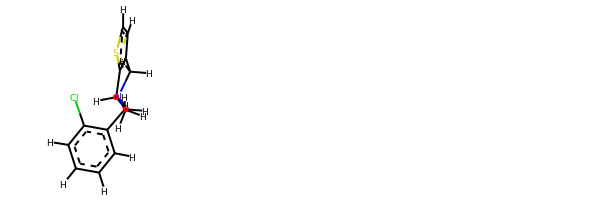

rdkit:  [H]c1sc2c(c1[H])C([H])([H])N(C([H])([H])c1c([H])c([H])c([H])c([H])c1Cl)C([H])([H])C2([H])[H]
oechem:  c1ccc(c(c1)CN2CCc3c(ccs3)C2)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
15.206431601565152 kJ/mol 58035.85411072025 kJ/mol False
angle
139.2550248930306 kJ/mol 141.2652430474355 kJ/mol False
nb
48.075512001881684 kJ/mol 48.075512001881684 kJ/mol True
torsion
221.6683482084074 kJ/mol 221.36552861523234 kJ/mol False
424.20531670488486 kJ/mol 58446.5603943848 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
---------------

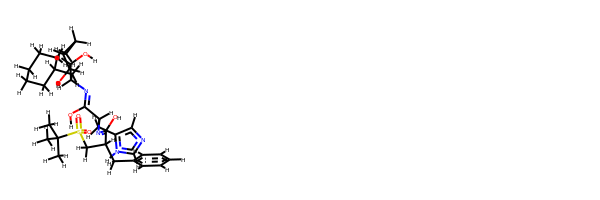

rdkit:  [H]OC(=NC([H])(C([H])([H])C1([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C1([H])[H])C([H])(O[H])C([H])(O[H])C1([H])C([H])([H])C1([H])[H])C([H])(N=C(O[H])C([H])(C([H])([H])c1c([H])c([H])c([H])c([H])c1[H])C([H])([H])S(=O)(=O)C(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H])C([H])([H])c1c([H])nc([H])n1[H]
oechem:  CC(C)(C)S(=O)(=O)CC(Cc1ccccc1)C(=NC(Cc2cnc[nH]2)C(=NC(CC3CCCCC3)C(C(C4CC4)O)O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
6.967523625305382 kJ/mol 57758.43541591675 kJ/mol False
angle
386.63940951301436 kJ/mol 387.86902310102226 kJ/mol False
nb
20.125049643617768 kJ/mol 20.125049643617768 kJ/mol True
torsion
57.52287239819936 kJ/mol 57.52289468822131 kJ/mol False
471.2548551801369 kJ/mol 58223.952383349606 kJ/mol

---------------------

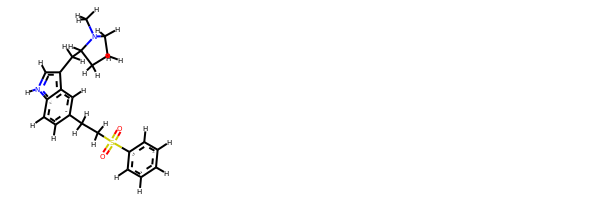

rdkit:  [H]c1c([H])c([H])c(S(=O)(=O)C([H])([H])C([H])([H])c2c([H])c([H])c3c(c2[H])c(C([H])([H])C2([H])N(C([H])([H])[H])C([H])([H])C([H])([H])C2([H])[H])c([H])n3[H])c([H])c1[H]
oechem:  CN1CCCC1Cc2c[nH]c3c2cc(cc3)CCS(=O)(=O)c4ccccc4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
22.586356603288696 kJ/mol 56668.14564216511 kJ/mol False
angle
332.29521226075195 kJ/mol 332.29521226075195 kJ/mol True
nb
103.13243833981215 kJ/mol 103.13243833981215 kJ/mol True
torsion
240.54931171346172 kJ/mol 202.64143411609084 kJ/mol False
698.5633189173145 kJ/mol 57306.214726881764 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
---------------------------------------------------------

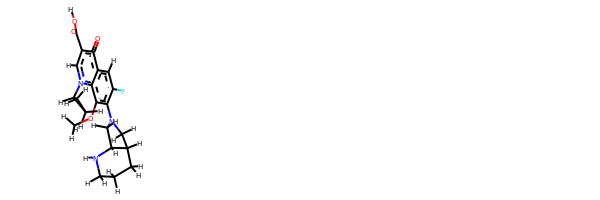

rdkit:  [H]OC(=O)c1c([H])n(C2([H])C([H])([H])C2([H])[H])c2c(OC([H])([H])[H])c(N3C([H])([H])C4([H])N([H])C([H])([H])C([H])([H])C([H])([H])C4([H])C3([H])[H])c(F)c([H])c2c1=O
oechem:  COc1c2c(cc(c1N3CC4CCCNC4C3)F)c(=O)c(cn2C5CC5)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ##########

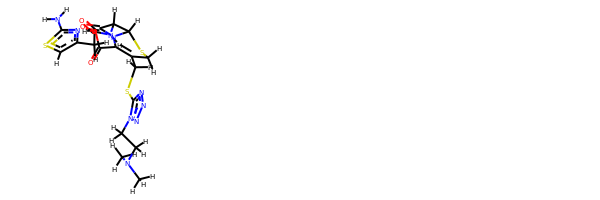

rdkit:  [H]OC(=O)C1=C(C([H])([H])Sc2nnnn2C([H])([H])C([H])([H])N(C([H])([H])[H])C([H])([H])[H])C([H])([H])SC2([H])N1C(=O)C2([H])N([H])C(=O)C([H])([H])c1nc(N([H])[H])sc1[H]
oechem:  CN(C)CCn1c(nnn1)SCC2=C(N3C(C(C3=O)NC(=O)Cc4csc(n4)N)SC2)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
12.278015874894038 kJ/mol 57346.68893153249 kJ/mol False
angle
22.406085164875535 kJ/mol 22.72377068539931 kJ/mol False
nb
30.990371940895827 kJ/mol 30.990371940895827 kJ/mol True
torsion
37.65629614861086 k

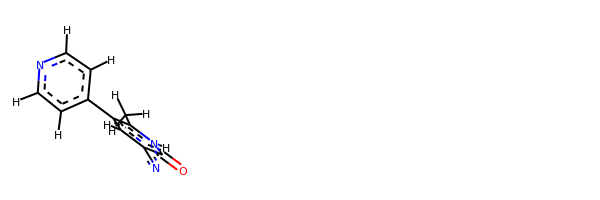

rdkit:  [H]c1nc([H])c([H])c(-c2c([H])c(C#N)c(=O)n([H])c2C([H])([H])[H])c1[H]
oechem:  Cc1c(cc(c(=O)[nH]1)C#N)c2ccncc2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
9.327951643178631 kJ/mol 58031.82467007083 kJ/mol False
angle
94.39703212517028 kJ/mol 94.39703212517028 kJ/mol True
nb
19.81264060508324 kJ/mol 19.81264060508324 kJ/mol True
torsion
25.396814463754556 kJ/mol 8.694082146662826 kJ/mol False
148.93443883718672 kJ/mol 58154.728424947745 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
----------------------------------------

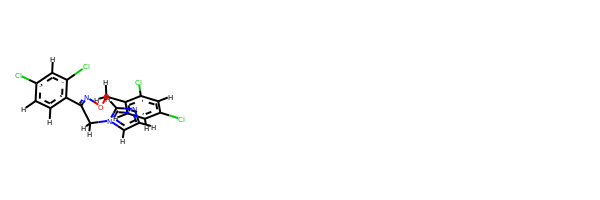

rdkit:  [H]c1nc([H])n(C([H])([H])C(=NOC([H])([H])c2c([H])c([H])c(Cl)c([H])c2Cl)c2c([H])c([H])c(Cl)c([H])c2Cl)c1[H]
oechem:  c1cc(c(cc1Cl)Cl)CON=C(Cn2ccnc2)c3ccc(cc3Cl)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
20.75605617055489 kJ/mol 58002.53838999037 kJ/mol False
angle
403.6570358000915 kJ/mol 403.6570358000915 kJ/mol True
nb
14.126454019778464 kJ/mol 14.126454019778464 kJ/mol True
torsion
71.8852839386835 kJ/mol 48.30532499551082 kJ/mol False
510.4248299291083 kJ/mol 58468.62720480575 kJ/mol

-------------------------------------------------------------------
----------------------------------------------------------

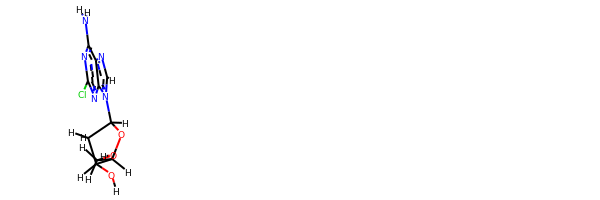

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])nc3c(N([H])[H])nc(Cl)nc32)C([H])([H])C1([H])O[H]
oechem:  c1nc2c(nc(nc2n1C3CC(C(O3)CO)O)Cl)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
17.913960968773388 kJ/mol 44743.80689644606 kJ/mol False
angle
174.10215018619013 kJ/mol 174.10215018619013 kJ/mol True
nb
42.422270917595334 kJ/mol 42.422270917595334 kJ/mol True
torsion
33.12317983787712 kJ/mol 27.299028952255785 kJ/mol False
267.56156191043596 kJ/mol 44987.630346502105 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
--------------

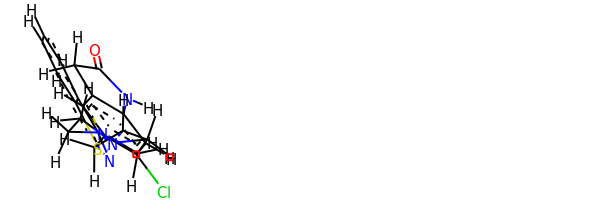

rdkit:  [H]c1c(Cl)c(C([H])([H])C([H])([H])N2C([H])([H])C([H])([H])N(c3nsc4c([H])c([H])c([H])c([H])c34)C([H])([H])C2([H])[H])c([H])c2c1N([H])C(=O)C2([H])[H]
oechem:  c1ccc2c(c1)c(ns2)N3CCN(CC3)CCc4cc5c(cc4Cl)NC(=O)C5
###########################################################################
 #########################################################

bond
61.95656270521051 kJ/mol 57541.64397419514 kJ/mol False
angle
121.90728270299682 kJ/mol 123.11233378748997 kJ/mol False
nb
73.46568350911065 kJ/mol 73.46568350911065 kJ/mol True
torsion
51.67026353113906 kJ/mol 51.67271802534826 kJ/mol False
308.999792448457 kJ/mol 57789.89470951709 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_140


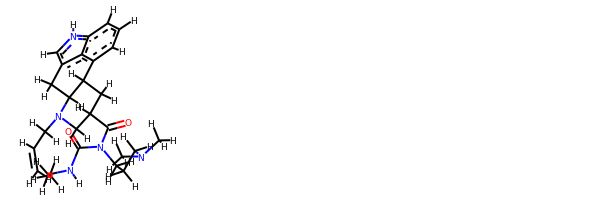

rdkit:  [H]C([H])=C([H])C([H])([H])N1C([H])([H])C([H])(C(=O)N(C(=O)N([H])C([H])([H])C([H])([H])[H])C([H])([H])C([H])([H])C([H])([H])N(C([H])([H])[H])C([H])([H])[H])C([H])([H])C2([H])c3c([H])c([H])c([H])c4c3c(c([H])n4[H])C([H])([H])C12[H]
oechem:  CCNC(=O)N(CCCN(C)C)C(=O)C1CC2c3cccc4c3c(c[nH]4)CC2N(C1)CC=C
###########################################################################
 #########################################################

bond
44.81613335304218 kJ/mol 113413.90897991633 kJ/mol False
angle
318.5041580535622 kJ/mol 319.1537181089154 kJ/mol False
nb
26.521126220440262 kJ/mol 26.521126220440262 kJ/mol True
torsion
107.81478113495696 kJ/mol 50.74175290500166 kJ/mol False
497.65619876200157 kJ/mol 113810.3255771507 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_141


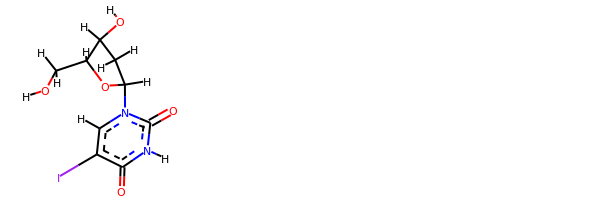

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])c(I)c(=O)n([H])c2=O)C([H])([H])C1([H])O[H]
oechem:  c1c(c(=O)[nH]c(=O)n1C2CC(C(O2)CO)O)I
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
39.52237427255393 kJ/mol 29195.889598992908 kJ/mol False
angle
340.27238134085553 kJ/mol 340.27238134085553 kJ/mol True
nb
132.43682170568658 kJ/mol 132.43682170568658 kJ/mol True
torsion
100.51394977459188 kJ/mol 92.53475589190089 kJ/mol False
612.7455270936879 kJ/mol 29761.133557931353 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_143


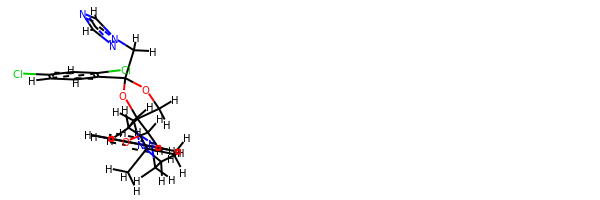

rdkit:  [H]c1nc([H])n(C([H])([H])C2(c3c([H])c([H])c(Cl)c([H])c3Cl)OC([H])([H])C([H])(C([H])([H])Oc3c([H])c([H])c(N4C([H])([H])C([H])([H])N(C([H])(C([H])([H])[H])C([H])([H])[H])C([H])([H])C4([H])[H])c([H])c3[H])O2)n1
oechem:  CC(C)N1CCN(CC1)c2ccc(cc2)OCC3COC(O3)(Cn4cncn4)c5ccc(cc5Cl)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

##################################

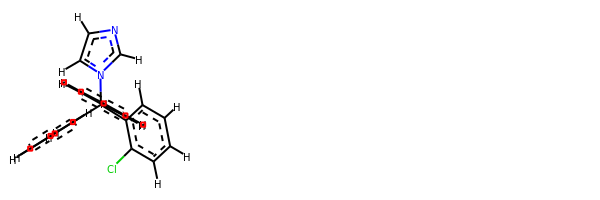

rdkit:  [H]c1nc([H])n(C(c2c([H])c([H])c([H])c([H])c2[H])(c2c([H])c([H])c([H])c([H])c2[H])c2c([H])c([H])c([H])c([H])c2Cl)c1[H]
oechem:  c1ccc(cc1)C(c2ccccc2)(c3ccccc3Cl)n4ccnc4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
24.

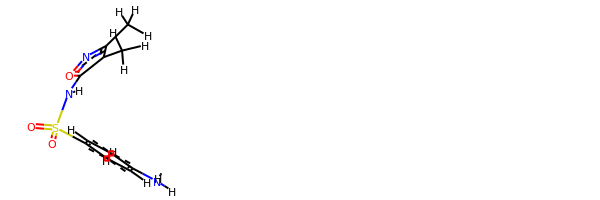

rdkit:  [H]c1c([H])c(S(=O)(=O)N([H])c2onc(C([H])([H])[H])c2C([H])([H])[H])c([H])c([H])c1N([H])[H]
oechem:  Cc1c(noc1NS(=O)(=O)c2ccc(cc2)N)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
41.55020177786336 kJ/mol 113506.042209697 kJ/mol False
angle
37.93681573536962 kJ/mol 37.93681573536962 kJ/mol True
nb
72.13015002112239 kJ/mol 72.13015002112239 kJ/mol True
torsion
10.367769964864793 kJ/mol 0.04210089546846415 kJ/mol False
161.98493749922017 kJ/mol 113616.15127634897 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_158


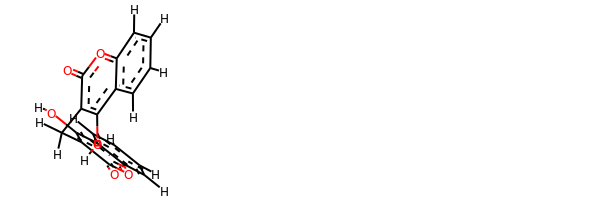

rdkit:  [H]Oc1c(C([H])([H])c2c(O[H])c3c([H])c([H])c([H])c([H])c3oc2=O)c(=O)oc2c([H])c([H])c([H])c([H])c12
oechem:  c1ccc2c(c1)c(c(c(=O)o2)Cc3c(c4ccccc4oc3=O)O)O
###########################################################################
 #########################################################

bond
35.69903165434563 kJ/mol 72900.04953016908 kJ/mol False
angle
446.986710364236 kJ/mol 450.346603739878 kJ/mol False
nb
-4.49933883253539 kJ/mol -4.49933883253539 kJ/mol True
torsion
118.86937440006939 kJ/mol 96.81025502831125 kJ/mol False
597.0557775861156 kJ/mol 73442.70705010473 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_159


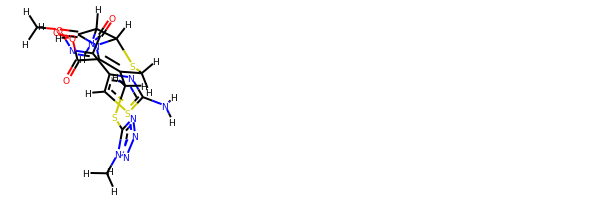

rdkit:  [H]OC(=O)C1=C(C([H])([H])Sc2nnnn2C([H])([H])[H])C([H])([H])SC2([H])N1C(=O)C2([H])N([H])C(=O)C(=NOC([H])([H])[H])c1nc(N([H])[H])sc1[H]
oechem:  Cn1c(nnn1)SCC2=C(N3C(C(C3=O)NC(=O)C(=NOC)c4csc(n4)N)SC2)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
9.679287478501323 kJ/mol 29078.4522739122 kJ/mol False
angle
110.36326074639095 kJ/mol 112.06660911368594 kJ/mol False
nb
-2.751027204579889 kJ/mol -2.751027204579889 kJ/mol True
torsion
11.052828378787236 kJ/mol 4.986377255984677 kJ/mol

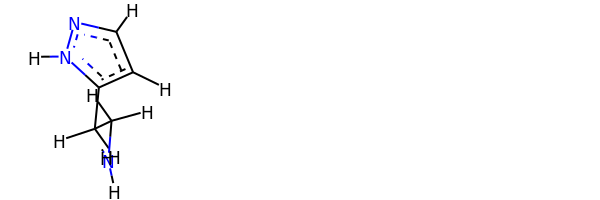

rdkit:  [H]c1nn([H])c(C([H])([H])C([H])([H])N([H])[H])c1[H]
oechem:  c1cn[nH]c1CCN
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
32.825115049733505 kJ/mol 29227.759304363575 kJ/mol False
angle
398.7462500266297 kJ/mol 398.7462500266297 kJ/mol True
nb
-5.751900790053568 kJ/mol -5.751900790053568 kJ/mol True
torsion
124.55959482998338 kJ/mol 119.32961974920508 kJ/mol False
550.379059116293 kJ/mol 29740.08327334936 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_166


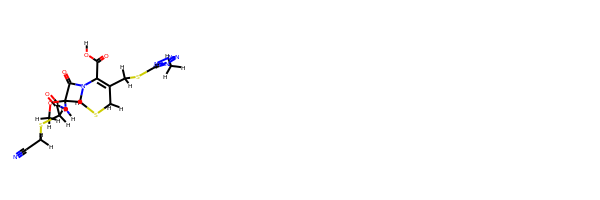

rdkit:  [H]OC(=O)C1=C(C([H])([H])Sc2nnnn2C([H])([H])[H])C([H])([H])SC2([H])N1C(=O)C2(OC([H])([H])[H])N([H])C(=O)C([H])([H])SC([H])([H])C#N
oechem:  Cn1c(nnn1)SCC2=C(N3C(C(C3=O)(NC(=O)CSCC#N)OC)SC2)C(=O)O
###########################################################################
 #########################################################

bond
23.713528153788193 kJ/mol 87237.85486966577 kJ/mol False
angle
186.85124316474077 kJ/mol 189.63097611604093 kJ/mol False
nb
17.552118856475392 kJ/mol 17.552118856475392 kJ/mol True
torsion
82.34187229576287 kJ/mol 51.27733784144658 kJ/mol False
310.4587624707672 kJ/mol 87496.31530247972 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_167


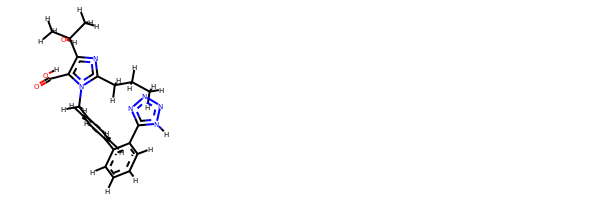

rdkit:  [H]OC(=O)c1c(C(O[H])(C([H])([H])[H])C([H])([H])[H])nc(C([H])([H])C([H])([H])C([H])([H])[H])n1C([H])([H])c1c([H])c([H])c(-c2c([H])c([H])c([H])c([H])c2-c2nnnn2[H])c([H])c1[H]
oechem:  CCCc1nc(c(n1Cc2ccc(cc2)c3ccccc3c4[nH]nnn4)C(=O)O)C(C)(C)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
56.38547293149906 kJ/mol 169638.39336257233 kJ/mol False
angle
97.65265686405716 kJ/mol 99.82535113051138 kJ/mol False
nb
24.4425771519655 kJ/mol 24.4425771519655 kJ/mol True
torsion
0.0006031860601645561 kJ/mol 0.0013719408331790278 kJ/mol False
178.4813101335819 kJ/mol 169762.66266279563 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
----------------------------------------

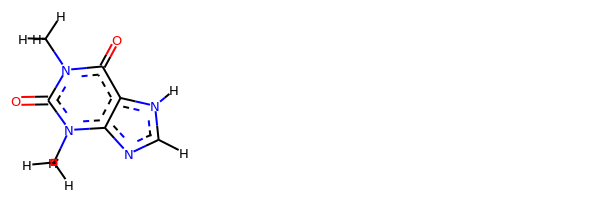

rdkit:  [H]c1nc2c(c(=O)n(C([H])([H])[H])c(=O)n2C([H])([H])[H])n1[H]
oechem:  Cn1c2c(c(=O)n(c1=O)C)[nH]cn2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #

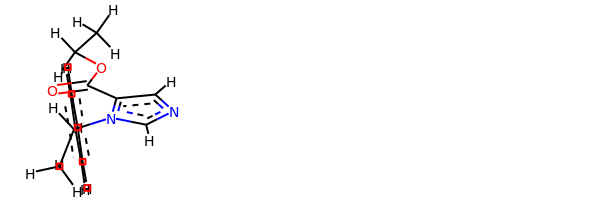

rdkit:  [H]c1nc([H])n(C([H])(c2c([H])c([H])c([H])c([H])c2[H])C([H])([H])[H])c1C(=O)OC([H])([H])C([H])([H])[H]
oechem:  CCOC(=O)c1cncn1C(C)c2ccccc2
###########################################################################
 #########################################################

bond
31.853838862180424 kJ/mol 101029.6900835673 kJ/mol False
angle
67.18994228464915 kJ/mol 69.49776970406691 kJ/mol False
nb
39.37981011232506 kJ/mol 39.37981011232506 kJ/mol True
torsion
16.9353552229453 kJ/mol 16.927655546754497 kJ/mol False
155.35894648209995 kJ/mol 101155.49531893045 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_185


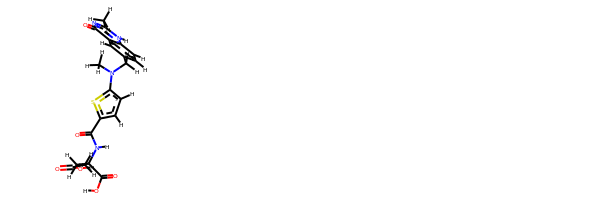

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])C([H])(C(=O)O[H])N([H])C(=O)c1sc(N(C([H])([H])[H])C([H])([H])c2c([H])c([H])c3c(c2[H])c(=O)nc(C([H])([H])[H])n3[H])c([H])c1[H]
oechem:  Cc1[nH]c2ccc(cc2c(=O)n1)CN(C)c3ccc(s3)C(=O)NC(CCC(=O)O)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
11.717704785962948 kJ/mol 58272.07368580611 kJ/mol False
angle
84.93904388955033 kJ/mol 84.93904388955033 kJ/mol True
nb
35.06072163252959 kJ/mol 35.06072163252959 kJ/mol True
torsion
50.17549800180676 kJ/mol 40.634

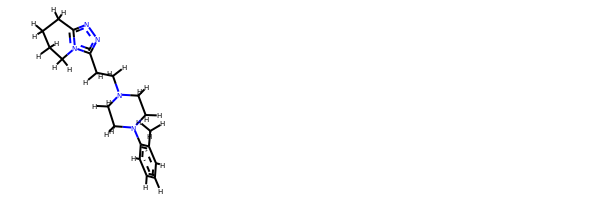

rdkit:  [H]c1c([H])c([H])c(C([H])([H])[H])c(N2C([H])([H])C([H])([H])N(C([H])([H])C([H])([H])c3nnc4n3C([H])([H])C([H])([H])C([H])([H])C4([H])[H])C([H])([H])C2([H])[H])c1[H]
oechem:  Cc1ccccc1N2CCN(CC2)CCc3nnc4n3CCCC4
###########################################################################
 #########################################################

bond
12.647041261093907 kJ/mol 116251.43445111446 kJ/mol False
angle
106.87152515285543 kJ/mol 107.18673433312973 kJ/mol False
nb
14.319674925132597 kJ/mol 14.319674925132597 kJ/mol True
torsion
30.738507314181334 kJ/mol 5.571194662352446 kJ/mol False
164.57674865326325 kJ/mol 116378.51205503507 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_191


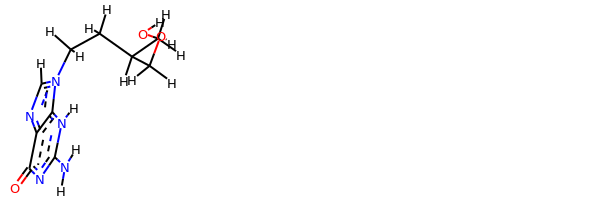

rdkit:  [H]OC([H])([H])C([H])(C([H])([H])O[H])C([H])([H])C([H])([H])n1c([H])nc2c(=O)nc(N([H])[H])n([H])c21
oechem:  c1nc2c(n1CCC(CO)CO)[nH]c(nc2=O)N
###########################################################################
 #########################################################

bond
24.708958614026635 kJ/mol 58007.34780172321 kJ/mol False
angle
129.37281991504534 kJ/mol 129.37281991504534 kJ/mol True
nb
16.957329593032476 kJ/mol 16.957329593032476 kJ/mol True
torsion
14.674786978422144 kJ/mol 11.927385355062794 kJ/mol False
185.7138951005266 kJ/mol 58165.60533658635 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_192


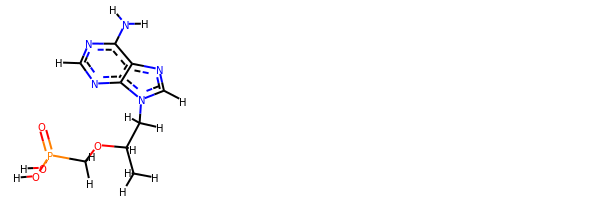

rdkit:  [H]OP(=O)(O[H])C([H])([H])OC([H])(C([H])([H])[H])C([H])([H])n1c([H])nc2c(N([H])[H])nc([H])nc21
oechem:  CC(Cn1cnc2c1ncnc2N)OCP(=O)(O)O
###########################################################################
 #########################################################

bond
29.63032221045783 kJ/mol 57745.448152863195 kJ/mol False
angle
469.60458558955537 kJ/mol 469.60458558955537 kJ/mol True
nb
-3.7142786671967167 kJ/mol -3.7142786671967167 kJ/mol True
torsion
106.36437653308846 kJ/mol 110.68039835926174 kJ/mol False
601.8850056659049 kJ/mol 58322.01885814482 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_193


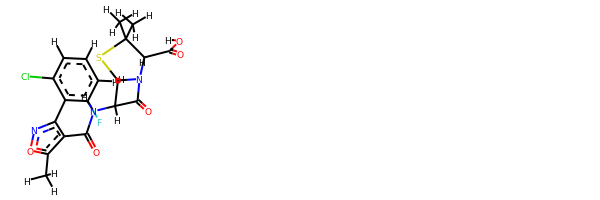

rdkit:  [H]OC(=O)C1([H])N2C(=O)C([H])(N([H])C(=O)c3c(-c4c(F)c([H])c([H])c([H])c4Cl)noc3C([H])([H])[H])C2([H])SC1(C([H])([H])[H])C([H])([H])[H]
oechem:  Cc1c(c(no1)c2c(cccc2Cl)F)C(=O)NC3C4N(C3=O)C(C(S4)(C)C)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ##############################

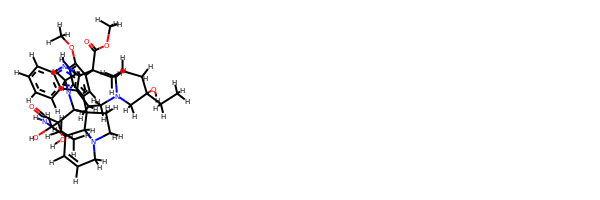

rdkit:  [H]OC1([H])C(O[H])(C(=O)N([H])[H])C2([H])N(C([H])([H])[H])c3c([H])c(OC([H])([H])[H])c(C4(C(=O)OC([H])([H])[H])c5c(c6c([H])c([H])c([H])c([H])c6n5[H])C([H])([H])C([H])([H])N5C([H])([H])C([H])(C4([H])[H])C([H])([H])C(O[H])(C([H])([H])C([H])([H])[H])C5([H])[H])c([H])c3C23C([H])([H])C([H])([H])N2C([H])([H])C([H])=C([H])C1(C([H])([H])C([H])([H])[H])C23[H]
oechem:  CCC1(CC2CC(c3c(c4ccccc4[nH]3)CCN(C2)C1)(c5cc6c(cc5OC)N(C7C68CCN9C8C(C=CC9)(C(C7(C(=O)N)O)O)CC)C)C(=O)OC)O
###########################################################################
 #########################################################

bond
12.036840072744798 kJ/mol 43615.34120056715 kJ/mol False
angle
59.21642167479015 kJ/mol 62.35060405658873 kJ/mol False
nb
21.405577454516695 kJ/mol 21.405577454516695 kJ/mol True
torsion
87.72732519726142 kJ/mol 87.72734028411337 kJ/mol False
180.38616439931306 kJ/mol 43786.82472236238 kJ/mol

-------------------------------------------------------------------
---------------------

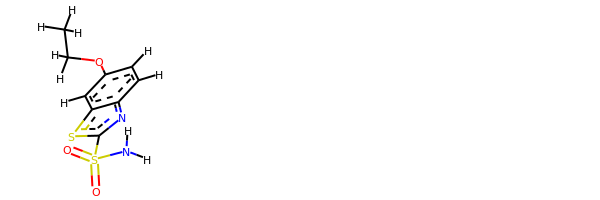

rdkit:  [H]c1c(OC([H])([H])C([H])([H])[H])c([H])c2sc(S(=O)(=O)N([H])[H])nc2c1[H]
oechem:  CCOc1ccc2c(c1)sc(n2)S(=O)(=O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
21.17917323943288 kJ/mol 57774.31564891247 kJ/mol False
angle
258.78112352935347 kJ/mol 260.010519636883 kJ/mol False
nb
12.978405950177601 kJ/mol 12.978405950177601 kJ/mol True
torsion
50.51139459332092 kJ/mol 50.51141506560999 kJ/mol False
343.45009731228487 kJ/mol 58097.81598956513 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
------------------------------------

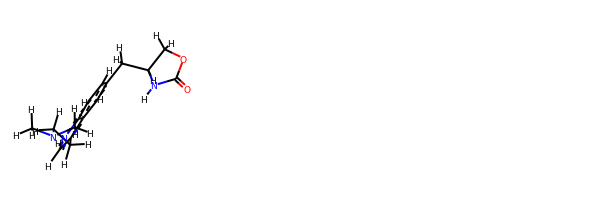

rdkit:  [H]c1c(C([H])([H])C2([H])N([H])C(=O)OC2([H])[H])c([H])c2c(C([H])([H])C([H])([H])N(C([H])([H])[H])C([H])([H])[H])c([H])n([H])c2c1[H]
oechem:  CN(C)CCc1c[nH]c2c1cc(cc2)CC3COC(=O)N3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
44.509938750047624 kJ/mol 57525.831785042086 kJ/mol False
angle
595.2506941808563 kJ/mol 596.4570326953778 kJ/mol False
nb
73.54

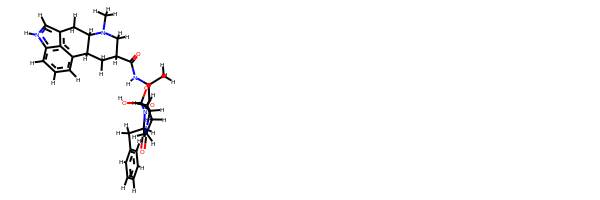

rdkit:  [H]OC12OC(N([H])C(=O)C3([H])C([H])([H])N(C([H])([H])[H])C4([H])C([H])([H])c5c([H])n([H])c6c([H])c([H])c([H])c(c56)C4([H])C3([H])[H])(C([H])([H])[H])C(=O)N1C([H])(C([H])([H])c1c([H])c([H])c([H])c([H])c1[H])C(=O)N1C([H])([H])C([H])([H])C([H])([H])C12[H]
oechem:  CC1(C(=O)N2C(C(=O)N3CCCC3C2(O1)O)Cc4ccccc4)NC(=O)C5CC6c7cccc8c7c(c[nH]8)CC6N(C5)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
46.04444643605711 kJ/mol 113222.69574569422 kJ/mol False
angle
318.8558604282009 kJ/mol 319.4637441309405 kJ/mol False
nb
25.86909020811767 kJ/mol 25.86909020811767 kJ/mol True
torsion
107.81418740237419 kJ/mol 50.741640506409425 kJ/mol False
498.58358447474984 kJ/mol 113618.77022053969 kJ/mol

-------------------------------------------------------------------
--------

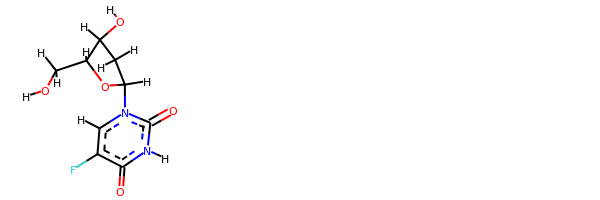

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])c(F)c(=O)n([H])c2=O)C([H])([H])C1([H])O[H]
oechem:  c1c(c(=O)[nH]c(=O)n1C2CC(C(O2)CO)O)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
30.376147584226114 kJ/mol 57002.10426378443 kJ/mol False
angle
89.27588118018662 kJ/mol 89.27588118018662 kJ/mol True
nb
58.50730273813977 kJ/mol 58.50730273813977 kJ/mol True
torsion
14.145237005323322 kJ/mol 11.422149278095835 kJ/mol False
192.3045685078758 kJ/mol 57161.30959698084 kJ/mol

-----------------------

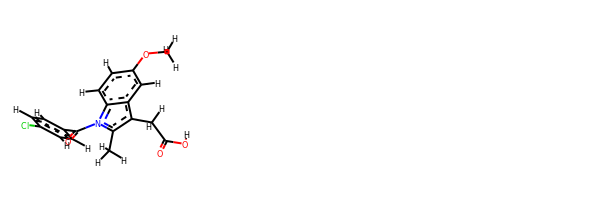

rdkit:  [H]OC(=O)C([H])([H])c1c(C([H])([H])[H])n(C(=O)c2c([H])c([H])c(Cl)c([H])c2[H])c2c([H])c([H])c(OC([H])([H])[H])c([H])c12
oechem:  Cc1c(c2cc(ccc2n1C(=O)c3ccc(cc3)Cl)OC)CC(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
20.05462611885735 kJ/mol 43911.81309798458 kJ/mol False
angle
95.80001139974173 kJ/mol 97.60666903163744 kJ/mol False
nb
27.991688485443344 kJ/mol 27.991688485443344 kJ/mol True
torsion
47.16277287708099 kJ/mol 39.86053950773711 kJ/mol False
191.0090988811234 kJ/mol 44077.2719950094 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_225


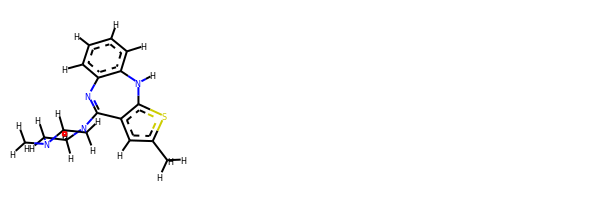

rdkit:  [H]c1c([H])c([H])c2c(c1[H])N=C(N1C([H])([H])C([H])([H])N(C([H])([H])[H])C([H])([H])C1([H])[H])c1c(sc(C([H])([H])[H])c1[H])N2[H]
oechem:  Cc1cc2c(s1)Nc3ccccc3N=C2N4CCN(CC4)C
###########################################################################
 #########################################################

bond
24.677669420483937 kJ/mol 58389.94903004851 kJ/mol False
angle
107.52203342649992 kJ/mol 107.52203342649992 kJ/mol True
nb
2.2284764854943053 kJ/mol 2.2284764854943053 kJ/mol True
torsion
21.966012885980273 kJ/mol 21.966014205072987 kJ/mol False
156.39419221845841 kJ/mol 58521.66555416558 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_227


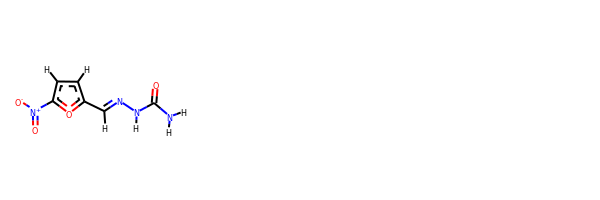

rdkit:  [H]C(=NN([H])C(=O)N([H])[H])c1oc([N+](=O)[O-])c([H])c1[H]
oechem:  c1cc(oc1C=NNC(=O)N)[N+](=O)[O-]
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 

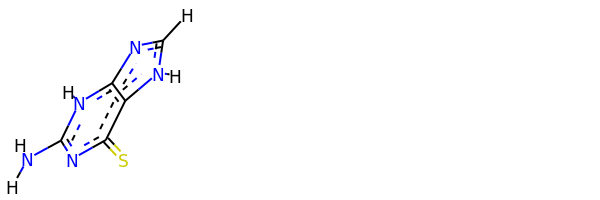

rdkit:  [H]c1nc2c(c(=S)nc(N([H])[H])n2[H])n1[H]
oechem:  c1[nH]c2c(n1)[nH]c(nc2=S)N
###########################################################################
 #########################################################

bond
21.185152093419372 kJ/mol 57538.54517254258 kJ/mol False
angle
119.04003894425138 kJ/mol 120.24653660392147 kJ/mol False
nb
37.470227750235615 kJ/mol 37.470227750235615 kJ/mol True
torsion
31.141627748716385 kJ/mol 31.149468984854558 kJ/mol False
208.83704653662275 kJ/mol 57727.4114058816 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_244


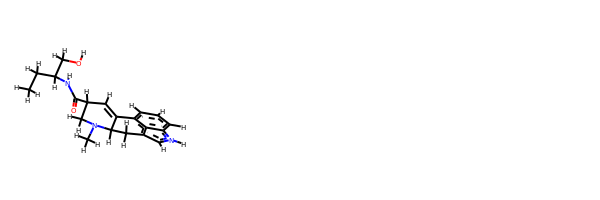

rdkit:  [H]OC([H])([H])C([H])(N([H])C(=O)C1([H])C([H])=C2c3c([H])c([H])c([H])c4c3c(c([H])n4[H])C([H])([H])C2([H])N(C([H])([H])[H])C1([H])[H])C([H])([H])C([H])([H])[H]
oechem:  CCC(CO)NC(=O)C1CN(C2Cc3c[nH]c4c3c(ccc4)C2=C1)C
###########################################################################
 #########################################################

bond
47.156468585463024 kJ/mol 43715.850318485784 kJ/mol False
angle
347.9849112207622 kJ/mol 351.3431895760195 kJ/mol False
nb
14.178076597396819 kJ/mol 14.178076597396819 kJ/mol True
torsion
93.12395941550294 kJ/mol 93.12404993713712 kJ/mol False
502.443415819125 kJ/mol 44174.49563459634 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_246


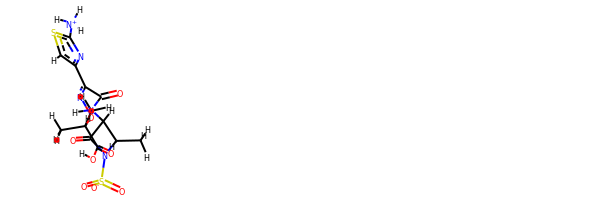

rdkit:  [H]OC(=O)C(ON=C(C(=O)N([H])C1([H])C(=O)N(S(=O)(=O)[O-])C1([H])C([H])([H])[H])c1nc([N+]([H])([H])[H])sc1[H])(C([H])([H])[H])C([H])([H])[H]
oechem:  CC1C(C(=O)N1S(=O)(=O)[O-])NC(=O)C(=NOC(C)(C)C(=O)O)c2csc(n2)[NH3+]
###########################################################################
 #########################################################

bond
22.3717549952946 kJ/mol 114268.74810884208 kJ/mol False
angle
80.5086511058092 kJ/mol 82.46422445545963 kJ/mol False
nb
11.95670033520341 kJ/mol 11.95670033520341 kJ/mol True
torsion
0.00010907297753241533 kJ/mol 0.00011217389067705662 kJ/mol False
114.83721550928475 kJ/mol 114363.16914580662 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_247


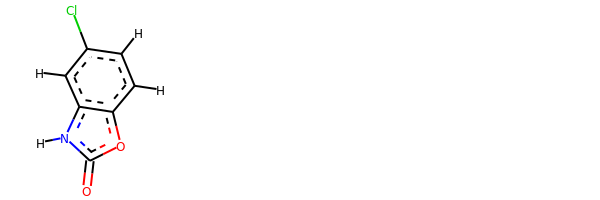

rdkit:  [H]c1c(Cl)c([H])c2c(oc(=O)n2[H])c1[H]
oechem:  c1cc2c(cc1Cl)[nH]c(=O)o2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
55.84077602136141 kJ/mol 57720.623095730334 kJ/mol False
angle
550.315389271664 kJ/mol 551.280225581522 kJ/mol False
nb
201.4579037935802 kJ/mol 201.4579037935802 kJ/mol True
torsion
155.89200722562092 kJ/mol 153.20609592453877 kJ/mol False
963.5060763122265 kJ/mol 58626.56732102997 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_252


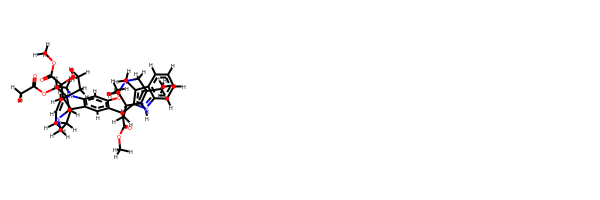

rdkit:  [H]OC1(C(=O)OC([H])([H])[H])C([H])(OC(=O)C([H])([H])[H])C2(C([H])([H])C([H])([H])[H])C([H])=C([H])C([H])([H])N3C([H])([H])C([H])([H])C4(c5c([H])c(C6(C(=O)OC([H])([H])[H])c7c(c8c([H])c([H])c([H])c([H])c8n7[H])C([H])([H])N7C([H])([H])C(C([H])([H])C([H])([H])[H])=C([H])C([H])(C7([H])[H])C6([H])[H])c(OC([H])([H])[H])c([H])c5N(C([H])([H])[H])C14[H])C32[H]
oechem:  CCC1=CC2CC(c3c(c4ccccc4[nH]3)CN(C2)C1)(c5cc6c(cc5OC)N(C7C68CCN9C8C(C=CC9)(C(C7(C(=O)OC)O)OC(=O)C)CC)C)C(=O)OC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ###################################

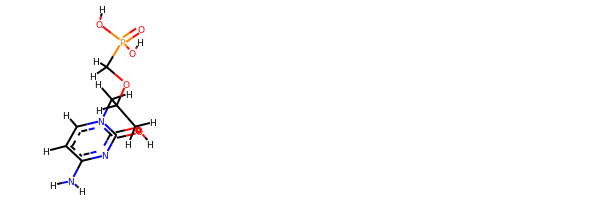

rdkit:  [H]OC([H])([H])C([H])(OC([H])([H])P(=O)(O[H])O[H])C([H])([H])n1c([H])c([H])c(N([H])[H])nc1=O
oechem:  c1cn(c(=O)nc1N)CC(CO)OCP(=O)(O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

#########################################

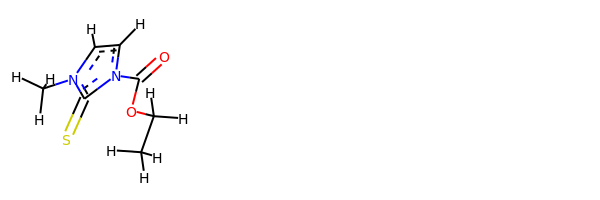

rdkit:  [H]c1c([H])n(C([H])([H])[H])c(=S)n1C(=O)OC([H])([H])C([H])([H])[H]
oechem:  CCOC(=O)n1ccn(c1=S)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
19.722714371875174 kJ/mol 58040.41760576039 kJ/mol False
angle
154.8132633234754 kJ/mol 154.8132633234754 kJ/mol True
nb
-13.451503815271316 kJ/mol -13.451503815271316 kJ/mol True
torsion
7.846300486241113 kJ/m

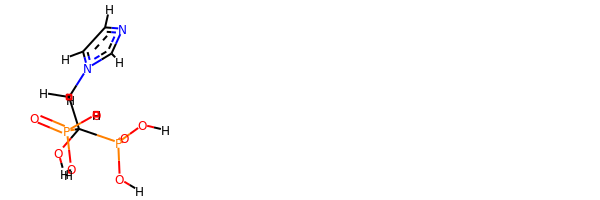

rdkit:  [H]OC(C([H])([H])n1c([H])nc([H])c1[H])(P(=O)(O[H])O[H])P(=O)(O[H])O[H]
oechem:  c1cn(cn1)CC(O)(P(=O)(O)O)P(=O)(O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
87.53932283114152 kJ/mol 57840.30893341985 kJ/mol False
angle
482.2428128546405 kJ/mol 483.471089721013 kJ/mol False
nb
6.4397512236890675 kJ/mol 6.4397512236890675 kJ/mol True
torsion
388.98142384620786 kJ/mol 388.9814257201018 kJ/mol False
965.2033107556789 kJ/mol 58719.20120008465 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-----------------------------------

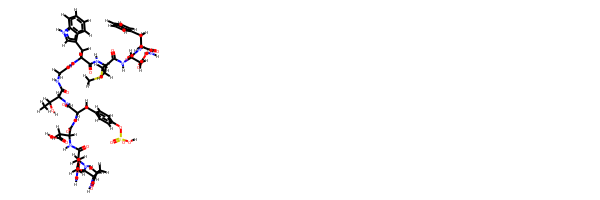

rdkit:  [H]OC(=O)C([H])([H])C([H])(C(=O)N([H])C([H])(C(=O)N([H])[H])C([H])([H])c1c([H])c([H])c([H])c([H])c1[H])N([H])C(=O)C([H])(N([H])C(=O)C([H])(N([H])C(=O)C([H])([H])N([H])C(=O)C([H])(N([H])C(=O)C([H])(N([H])C(=O)C([H])(N([H])C(=O)C([H])(N([H])C(=O)C1([H])N([H])C(=O)C([H])([H])C1([H])[H])C([H])([H])C([H])([H])C(=O)N([H])[H])C([H])([H])C(=O)O[H])C([H])([H])c1c([H])c([H])c(OS(=O)(=O)O[H])c([H])c1[H])C([H])(O[H])C([H])([H])[H])C([H])([H])c1c([H])n([H])c2c([H])c([H])c([H])c([H])c12)C([H])([H])C([H])([H])SC([H])([H])[H]
oechem:  CC(C(C(=O)NCC(=O)NC(Cc1c[nH]c2c1cccc2)C(=O)NC(CCSC)C(=O)NC(CC(=O)O)C(=O)NC(Cc3ccccc3)C(=O)N)NC(=O)C(Cc4ccc(cc4)OS(=O)(=O)O)NC(=O)C(CC(=O)O)NC(=O)C(CCC(=O)N)NC(=O)C5CCC(=O)N5)O
###########################################################################
 #########################################################

bond
19.22703941409636 kJ/mol 57737.49131429614 kJ/mol False
angle
95.53812420510219 kJ/mol 95.53812420510219 kJ/mol True
nb
105.75804178587303 kJ/mol 105.

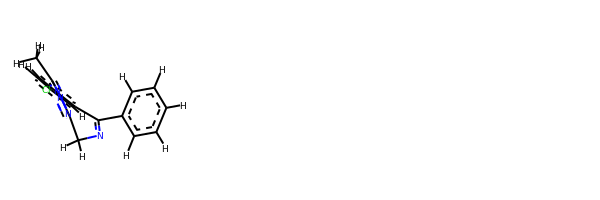

rdkit:  [H]c1c([H])c([H])c(C2=NC([H])([H])c3nnc(C([H])([H])[H])n3-c3c([H])c([H])c(Cl)c([H])c32)c([H])c1[H]
oechem:  Cc1nnc2n1-c3ccc(cc3C(=NC2)c4ccccc4)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

##############################

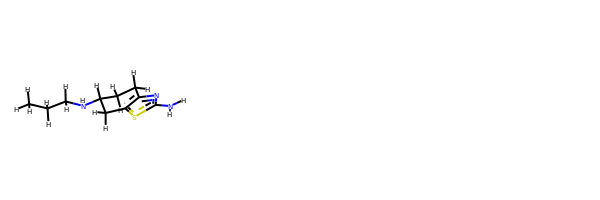

rdkit:  [H]N([H])c1nc2c(s1)C([H])([H])C([H])(N([H])C([H])([H])C([H])([H])C([H])([H])[H])C([H])([H])C2([H])[H]
oechem:  CCCNC1CCc2c(sc(n2)N)C1
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

##########################################

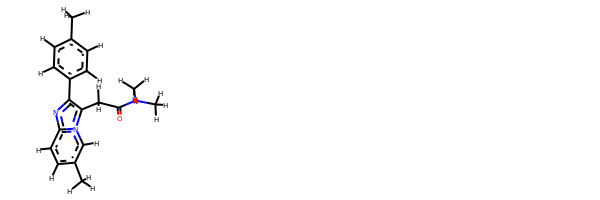

rdkit:  [H]c1c([H])c(C([H])([H])[H])c([H])c([H])c1-c1nc2c([H])c([H])c(C([H])([H])[H])c([H])n2c1C([H])([H])C(=O)N(C([H])([H])[H])C([H])([H])[H]
oechem:  Cc1ccc(cc1)c2c(n3cc(ccc3n2)C)CC(=O)N(C)C
###########################################################################
 #########################################################

bond
18.46454614438253 kJ/mol 58003.32981411513 kJ/mol False
angle
134.42192699682315 kJ/mol 134.42192699682315 kJ/mol True
nb
25.342819739772477 kJ/mol 25.342819739772477 kJ/mol True
torsion
27.56983691755273 kJ/mol 19.135014258074964 kJ/mol False
205.79912979853086 kJ/mol 58182.229575109806 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_315


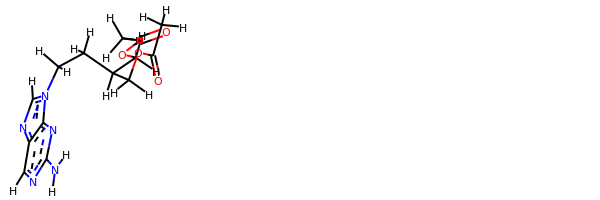

rdkit:  [H]c1nc(N([H])[H])nc2c1nc([H])n2C([H])([H])C([H])([H])C([H])(C([H])([H])OC(=O)C([H])([H])[H])C([H])([H])OC(=O)C([H])([H])[H]
oechem:  CC(=O)OCC(CCn1cnc2c1nc(nc2)N)COC(=O)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
32.25121143796785 kJ/mol 29227.373928911304 kJ/mol False
angle
416.75019026251823 kJ/mol 416.75019026251823 kJ/mol True
nb
34.72599296161811 kJ/mol 34.72599296161811 kJ/mol True
torsion
126.85869590914672 kJ/mol 121.62873625848167 kJ/mol False
610.5860905712509 kJ/mol 29

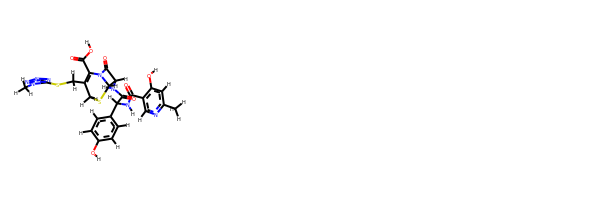

rdkit:  [H]OC(=O)C1=C(C([H])([H])Sc2nnnn2C([H])([H])[H])C([H])([H])SC2([H])N1C(=O)C2([H])N([H])C(=O)C([H])(c1c([H])c([H])c(O[H])c([H])c1[H])N([H])C(=O)c1c([H])nc(C([H])([H])[H])c([H])c1O[H]
oechem:  Cc1cc(c(cn1)C(=O)NC(c2ccc(cc2)O)C(=O)NC3C4N(C3=O)C(=C(CS4)CSc5nnnn5C)C(=O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
48.428748030222586 kJ/mol 113459.50109161652 kJ/mol False
angle
319.9422680341413 kJ/mol 320.5626458264718 kJ/mol False
nb
31.579492980398268 kJ/mol 31.579492980398268 kJ/mol True
torsion
107.81509159535375 kJ/mol 50.74152996285137 kJ/mol False
507.7656006401159 kJ/mol 113862.38476038624 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------

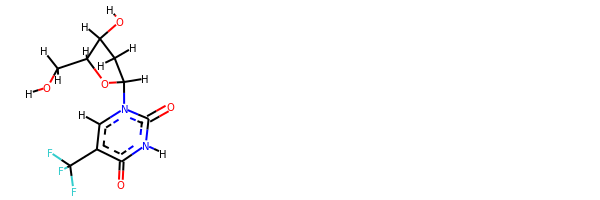

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])c(C(F)(F)F)c(=O)n([H])c2=O)C([H])([H])C1([H])O[H]
oechem:  c1c(c(=O)[nH]c(=O)n1C2CC(C(O2)CO)O)C(F)(F)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
9.53193870714187 kJ/mol 57646.58871202111 kJ/mol False
angle
100.51697342493881 kJ/mol 103.33104541871855 kJ/mol False
nb
15.280890919053418 kJ/mol 15.280890919053418 kJ/mol True
torsion
15.832409556897984 kJ/mol 12.681552599584581 kJ/mol False
141.1622126080321 kJ/mol 57777.88220095846 kJ/mol

------

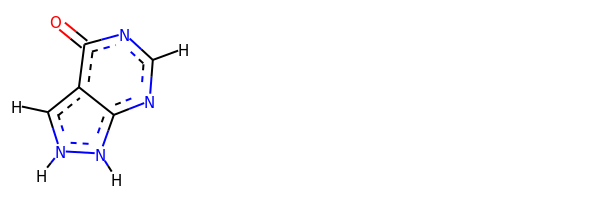

rdkit:  [H]c1nc2n([H])n([H])c([H])c-2c(=O)n1
oechem:  c1c-2c(=O)ncnc2[nH][nH]1
###########################################################################
 #########################################################

bond
37.847794421843844 kJ/mol 43709.00931400751 kJ/mol False
angle
378.5280013784821 kJ/mol 381.8846349808072 kJ/mol False
nb
34.77989993864257 kJ/mol 34.77989993864257 kJ/mol True
torsion
120.15616984251994 kJ/mol 103.3270174525915 kJ/mol False
571.3118655814884 kJ/mol 44229.00086637955 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_327


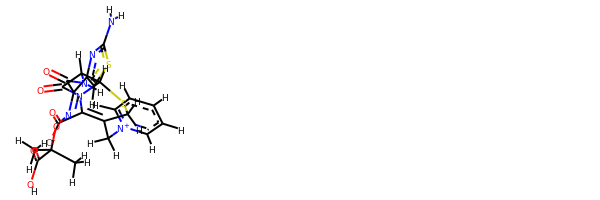

rdkit:  [H]OC(=O)C(ON=C(C(=O)N([H])C1([H])C(=O)N2C(C(=O)[O-])=C(C([H])([H])[n+]3c([H])c([H])c([H])c([H])c3[H])C([H])([H])SC21[H])c1nc(N([H])[H])sc1[H])(C([H])([H])[H])C([H])([H])[H]
oechem:  CC(C)(C(=O)O)ON=C(c1csc(n1)N)C(=O)NC2C3N(C2=O)C(=C(CS3)C[n+]4ccccc4)C(=O)[O-]
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
36.93322699882365 kJ/mol 56523.992737142464 kJ/mol False
angle
302.7717389069976 kJ/mol 302.7717389069976 kJ/mol True
nb
32.91605423066708 kJ/mol 32.91605423066708 kJ/mol True
torsion
93.4234093487478 kJ/mol 53.14976441851055 kJ/mol False
466.04442948523615 kJ/mol 56912.83029469863 kJ/mol

---------------------------

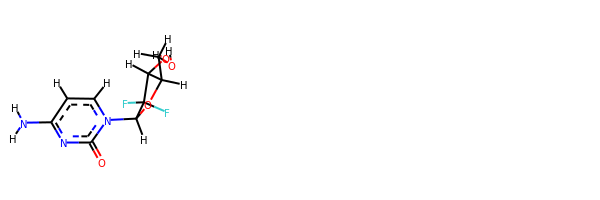

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])c([H])c(N([H])[H])nc2=O)C(F)(F)C1([H])O[H]
oechem:  c1cn(c(=O)nc1N)C2C(C(C(O2)CO)O)(F)F
###########################################################################
 #########################################################

bond
13.392993591017284 kJ/mol 116255.17199145326 kJ/mol False
angle
389.49988840905655 kJ/mol 389.8158094519963 kJ/mol False
nb
9.707421340980956 kJ/mol 9.707421340980956 kJ/mol True
torsion
66.89743332037743 kJ/mol 25.301074249339006 kJ/mol False
479.4977366614322 kJ/mol 116679.99629649556 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_331


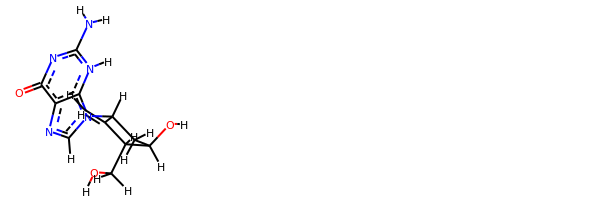

rdkit:  [H]OC([H])([H])C1([H])C(=C([H])[H])C([H])(n2c([H])nc3c(=O)nc(N([H])[H])n([H])c32)C([H])([H])C1([H])O[H]
oechem:  C=C1C(CC(C1CO)O)n2cnc3c2[nH]c(nc3=O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
96.4547891389807 kJ/mol 43881.899499048304 kJ/mol False
angle
397.38827222660547 kJ/mol 399.5419771282389 kJ/mol False
nb
92.3768256310827 kJ/mol 92.3768256310827 kJ/mol True
torsion
163.19189867947648 kJ/mol 161.01629173224478 kJ/mol False
749.4117856761454 kJ/mol 44534.83459353987 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_333


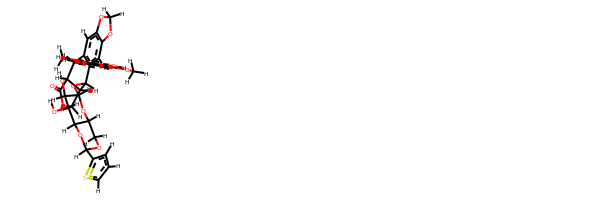

rdkit:  [H]Oc1c(OC([H])([H])[H])c([H])c(C2([H])c3c([H])c4c(c([H])c3C([H])(OC3([H])OC5([H])C([H])([H])OC([H])(c6sc([H])c([H])c6[H])OC5([H])C([H])(O[H])C3([H])O[H])C3([H])C([H])([H])OC(=O)C23[H])OC([H])([H])O4)c([H])c1OC([H])([H])[H]
oechem:  COc1cc(cc(c1O)OC)C2c3cc4c(cc3C(C5C2C(=O)OC5)OC6C(C(C7C(O6)COC(O7)c8cccs8)O)O)OCO4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
45.38278910616046 kJ/mol 111922.2026680073 kJ/mol False
angle
91.18040029983736 kJ/mol 92.72255203864707 kJ/mol False
nb
78.3475

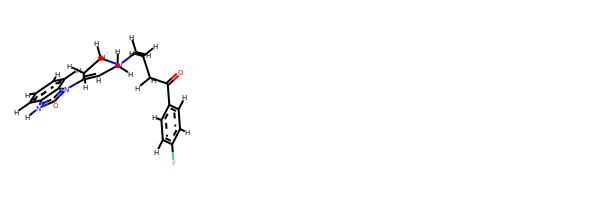

rdkit:  [H]C1=C(n2c(=O)n([H])c3c([H])c([H])c([H])c([H])c32)C([H])([H])C([H])([H])N(C([H])([H])C([H])([H])C([H])([H])C(=O)c2c([H])c([H])c(F)c([H])c2[H])C1([H])[H]
oechem:  c1ccc2c(c1)[nH]c(=O)n2C3=CCN(CC3)CCCC(=O)c4ccc(cc4)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
23.824417168971497 kJ/mol 43808.88535732582 kJ/mol False
angle
366.071003048676 kJ/mol 368.

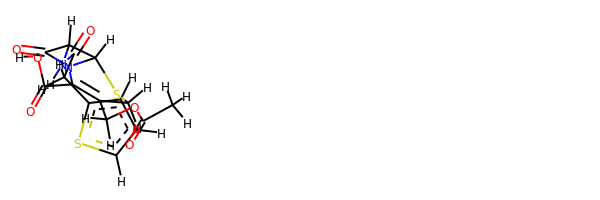

rdkit:  [H]OC(=O)C1=C(C([H])([H])OC(=O)C([H])([H])[H])C([H])([H])SC2([H])N1C(=O)C2([H])N([H])C(=O)C([H])([H])c1sc([H])c([H])c1[H]
oechem:  CC(=O)OCC1=C(N2C(C(C2=O)NC(=O)Cc3cccs3)SC1)C(=O)O
###########################################################################
 #########################################################

bond
37.318575614710454 kJ/mol 58403.04956997198 kJ/mol False
angle
120.15419532970125 kJ/mol 120.15419532970125 kJ/mol True
nb
91.8891348821358 kJ/mol 91.8891348821358 kJ/mol True
torsion
50.45410508033201 kJ/mol 45.14006153118637 kJ/mol False
299.8160109068795 kJ/mol 58660.232961715 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_346


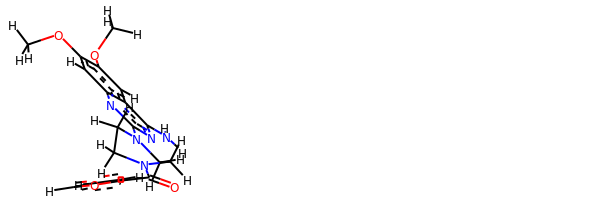

rdkit:  [H]c1oc(C(=O)N2C([H])([H])C([H])([H])N(c3nc(N([H])[H])c4c([H])c(OC([H])([H])[H])c(OC([H])([H])[H])c([H])c4n3)C([H])([H])C2([H])[H])c([H])c1[H]
oechem:  COc1cc2c(cc1OC)nc(nc2N)N3CCN(CC3)C(=O)c4ccco4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
128.3358345187687 kJ/mol 115518.32014393377 kJ/mol False
angle
472.49146332572155 kJ/mol 474.35699016885263 kJ/mol False
nb
31.04836300252043 kJ/mol 31.04836300252043 kJ/mol True
torsion
79.76323961363519 kJ/mol 80.19013820219183 kJ/mol False
711.6389004606458 kJ/mol 116103.91563530733 kJ/mol

-------------------------------------------------------------------
------------------

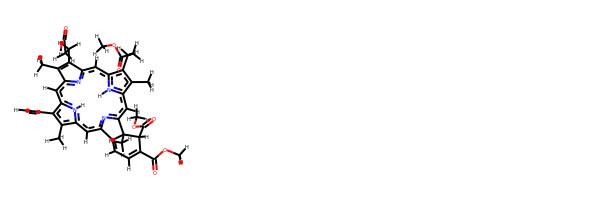

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])C1=C(C([H])([H])[H])c2nc1c([H])c1c(C([H])([H])C([H])([H])C(=O)OC([H])([H])[H])c(C([H])([H])[H])c(c([H])c3nc(c([H])c4c(C([H])([H])[H])c(C([H])=C([H])[H])c(c2[H])n4[H])C2=C([H])C([H])=C(C(=O)OC([H])([H])[H])C([H])(C(=O)OC([H])([H])[H])C23C([H])([H])[H])n1[H]
oechem:  Cc1c2cc3nc(cc4c(c(c([nH]4)cc5nc(cc(c1CCC(=O)OC)[nH]2)C(=C5C)CCC(=O)O)C=C)C)C6=CC=C(C(C36C)C(=O)OC)C(=O)OC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
16.373678113089923 kJ/mol 56639.28030482848 kJ/mol False
angle
31.804166067400462 kJ/mol 31.804166067400462 kJ/mol True
nb
76.04198207828733 kJ/mol 76.04198207828733 kJ/mol Tru

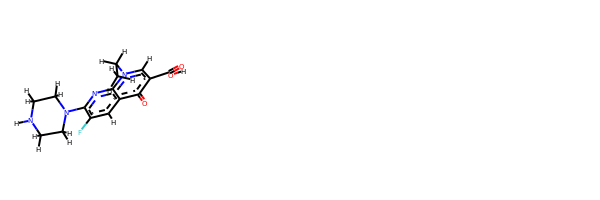

rdkit:  [H]OC(=O)c1c([H])n(C([H])([H])C([H])([H])[H])c2nc(N3C([H])([H])C([H])([H])N([H])C([H])([H])C3([H])[H])c(F)c([H])c2c1=O
oechem:  CCn1cc(c(=O)c2c1nc(c(c2)F)N3CCNCC3)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
28.858904908664087 kJ/mol 43627.54966807312 kJ/mol False
angle
90.22761219698124 kJ/mol 92.02955292960392 kJ/mol False
nb
54.320193579340796 kJ/mol 54.320193579340796 kJ/mol True
torsion
134.67575485065677 kJ/mol 134.68145839750719 kJ/mol False
308.0824655356429 kJ/mol 43908.580872979575 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_358


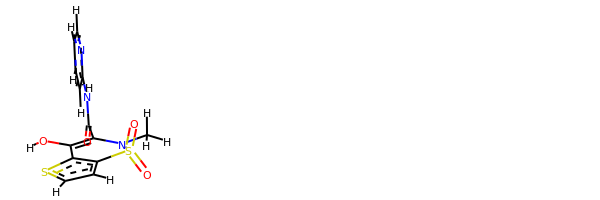

rdkit:  [H]OC1=C(C(=O)N([H])c2nc([H])c([H])c([H])c2[H])N(C([H])([H])[H])S(=O)(=O)c2c1sc([H])c2[H]
oechem:  CN1C(=C(c2c(ccs2)S1(=O)=O)O)C(=O)Nc3ccccn3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
17.747375953270268 kJ/mol 43805.67405214434 kJ/mol False
angle
38.91506406362219 kJ/mol 41.06678564290346 kJ/mol False
nb
22.272895574869924 kJ/mol 22.272895574869924 kJ/mol True
torsion
33.2597379966612 kJ/mol 31.084138489823218 kJ/mol False
112.19507358842358 kJ/mol 43900.09787185194 kJ/mol

------

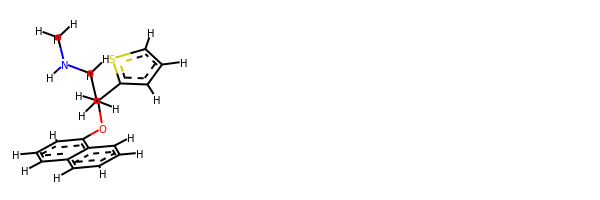

rdkit:  [H]c1sc(C([H])(Oc2c([H])c([H])c([H])c3c([H])c([H])c([H])c([H])c23)C([H])([H])C([H])([H])N([H])C([H])([H])[H])c([H])c1[H]
oechem:  CNCCC(c1cccs1)Oc2cccc3c2cccc3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
19.13414442666167 kJ/mol 43735.51425888256 kJ/mol False
angle
39.94537441798751 kJ/mol 41.78498246387265 kJ/mol False
nb
50.90458056634562 kJ/mol 50.90458056634562 kJ/mol True
torsion
75.87133294347865 kJ/mol 61.284267874151375 kJ/mol False
185.85543235447346 kJ/mol 43889.48808978694 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_370


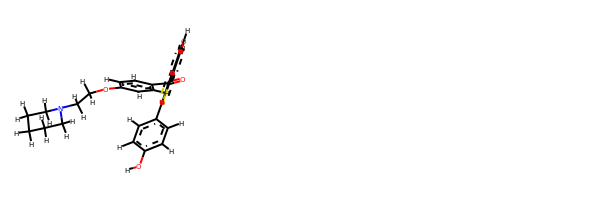

rdkit:  [H]Oc1c([H])c([H])c(-c2sc3c([H])c(O[H])c([H])c([H])c3c2C(=O)c2c([H])c([H])c(OC([H])([H])C([H])([H])N3C([H])([H])C([H])([H])C([H])([H])C([H])([H])C3([H])[H])c([H])c2[H])c([H])c1[H]
oechem:  c1cc(ccc1c2c(c3ccc(cc3s2)O)C(=O)c4ccc(cc4)OCCN5CCCCC5)O
###########################################################################
 #########################################################

bond
14.256991895267578 kJ/mol 29085.065193535156 kJ/mol False
angle
118.83301330231147 kJ/mol 118.83301330231147 kJ/mol True
nb
19.87911860293667 kJ/mol 19.87911860293667 kJ/mol True
torsion
105.39112479935625 kJ/mol 100.16117071949384 kJ/mol False
258.36024859987197 kJ/mol 29323.9384961599 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_371


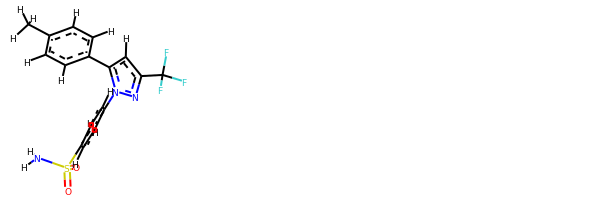

rdkit:  [H]c1c([H])c(C([H])([H])[H])c([H])c([H])c1-c1c([H])c(C(F)(F)F)nn1-c1c([H])c([H])c(S(=O)(=O)N([H])[H])c([H])c1[H]
oechem:  Cc1ccc(cc1)c2cc(nn2c3ccc(cc3)S(=O)(=O)N)C(F)(F)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
29.205389062731797 kJ/mol 57744.33276506407 kJ/mol False
angle
470.38637546380073 kJ/mol 470.38637546380073 kJ/mol True
nb
-14.234753112336877 kJ/mol -14.234753112336877 kJ/mol True
torsion
102.2455180627128 kJ/mol 109.32149539253078 kJ/mol False
587.6025294769084 kJ/mol 58309.80588280807 kJ/mol

-------------------------------------------------------------------
------------------------------------------

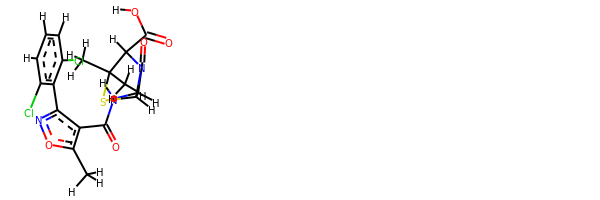

rdkit:  [H]OC(=O)C1([H])N2C(=O)C([H])(N([H])C(=O)c3c(-c4c(Cl)c([H])c([H])c([H])c4Cl)noc3C([H])([H])[H])C2([H])SC1(C([H])([H])[H])C([H])([H])[H]
oechem:  Cc1c(c(no1)c2c(cccc2Cl)Cl)C(=O)NC3C4N(C3=O)C(C(S4)(C)C)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
14.176210688808334 kJ/mol 56662.08784526121 kJ/mol False
angle
29.643557741250227 kJ/mol 29.643557741250227 kJ/mol True
nb
76.61652942151791 kJ/mol 76.61652942151791 kJ/mol True
torsion
42.535180551114685 kJ/mol 37.25311204360952 kJ/mol False
162.97147840269116 kJ/mol 56805.601044467585 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank

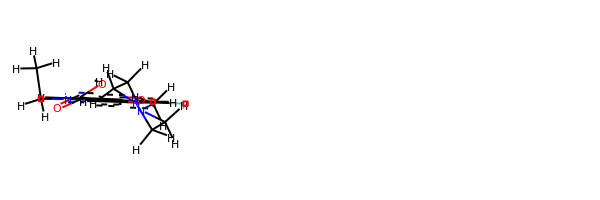

rdkit:  [H]OC(=O)c1c([H])n(C([H])([H])C([H])([H])[H])c2c([H])c(N3C([H])([H])C([H])([H])N(C([H])([H])[H])C([H])([H])C3([H])[H])c(F)c([H])c2c1=O
oechem:  CCn1cc(c(=O)c2c1cc(c(c2)F)N3CCN(CC3)C)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
32.22860473930544 kJ/mol 43701.019860531596 kJ/mol False
angle
381.24558256611164 kJ/mol 384.60547594175364 kJ/mol False
nb
6.682763285480203 kJ/mol 6.682763285480203 kJ/mol True
torsion
113.64045540285407 kJ/mol 96.81129800841367 kJ/mol False
533.797405

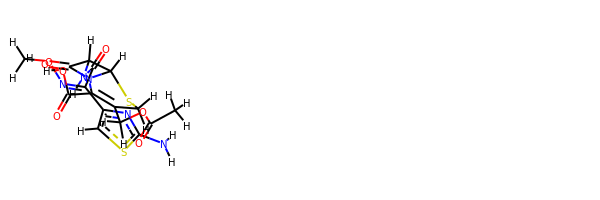

rdkit:  [H]OC(=O)C1=C(C([H])([H])OC(=O)C([H])([H])[H])C([H])([H])SC2([H])N1C(=O)C2([H])N([H])C(=O)C(=NOC([H])([H])[H])c1nc(N([H])[H])sc1[H]
oechem:  CC(=O)OCC1=C(N2C(C(C2=O)NC(=O)C(=NOC)c3csc(n3)N)SC1)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
84.39717200677161 kJ/mol 113392.65577424792 kJ/mol False
angle
320.7199801997393 kJ/mol 321.3410128567259 kJ/mol False
nb
25.412541039007564 kJ/mol 25.412541039007564 kJ/mol True
torsion
102.15380965719007 kJ/mol 45.111005496536926 kJ/mol False
532.6835029027086 kJ/mol 113784.52033364019 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_384


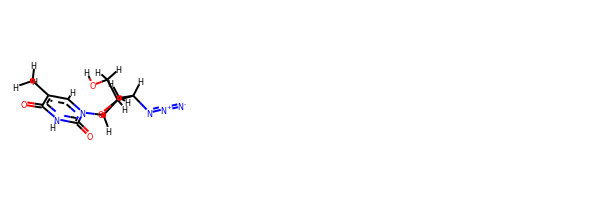

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])c(C([H])([H])[H])c(=O)n([H])c2=O)C([H])([H])C1([H])N=[N+]=[N-]
oechem:  Cc1cn(c(=O)[nH]c1=O)C2CC(C(O2)CO)N=[N+]=[N-]
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
14.561465182009268 kJ/mol 57871.189288890906 kJ/mol False
angle
85.70584354003759 kJ/mol 85.70584354003759 kJ/mol True
nb
29.523125340354888 kJ/mol 29.5

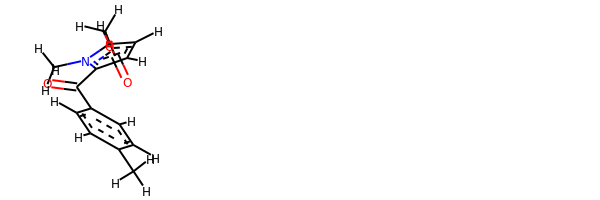

rdkit:  [H]OC(=O)C([H])([H])c1c([H])c([H])c(C(=O)c2c([H])c([H])c(C([H])([H])[H])c([H])c2[H])n1C([H])([H])[H]
oechem:  Cc1ccc(cc1)C(=O)c2ccc(n2C)CC(=O)O
###########################################################################
 #########################################################

bond
20.12791069134033 kJ/mol 58042.59817660986 kJ/mol False
angle
94.08732076361404 kJ/mol 96.09697090151474 kJ/mol False
nb
11.536396670828994 kJ/mol 11.536396670828994 kJ/mol True
torsion
27.832109140497057 kJ/mol 27.832355806651183 kJ/mol False
153.58373726628042 kJ/mol 58178.063899988854 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_390


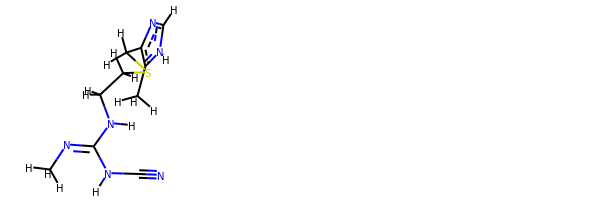

rdkit:  [H]c1nc(C([H])([H])SC([H])([H])C([H])([H])N([H])C(=NC([H])([H])[H])N([H])C#N)c(C([H])([H])[H])n1[H]
oechem:  Cc1c(nc[nH]1)CSCCNC(=NC)NC#N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
50.31040971405581 kJ/mol 87390.96526036217 kJ/mol False
angle
128.27204171953662 kJ/mol 134.9853800168209 kJ/mol False
nb
-2.759909630087002 kJ/mol -2.759909630087002 kJ/mol True
torsion
85.14055977545281 kJ/mol 76.93429832120835 kJ/mol False
260.96310157895823 kJ/mol 87600.12502907011 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_392


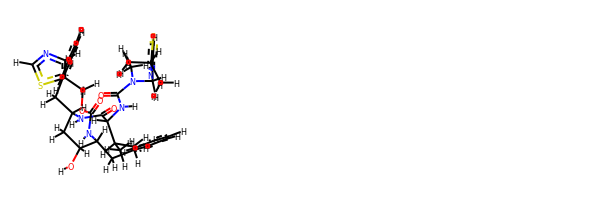

rdkit:  [H]OC([H])(C([H])([H])C([H])(N([H])C(=O)C([H])(N([H])C(=O)N(C([H])([H])[H])C([H])([H])c1nc(C([H])(C([H])([H])[H])C([H])([H])[H])sc1[H])C([H])(C([H])([H])[H])C([H])([H])[H])C([H])([H])c1c([H])c([H])c([H])c([H])c1[H])C([H])(N([H])C(=O)OC([H])([H])c1sc([H])nc1[H])C([H])([H])c1c([H])c([H])c([H])c([H])c1[H]
oechem:  CC(C)c1nc(cs1)CN(C)C(=O)NC(C(C)C)C(=O)NC(Cc2ccccc2)CC(C(Cc3ccccc3)NC(=O)OCc4cncs4)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
30.442615839541084 kJ/mol 43702.12923520484 kJ/mol False
angle
66.96813113921073 kJ/mol 70.32419978410026 kJ/mol False
nb
14.24137668959677 kJ/mol 14.24137668959677 kJ/mol True
torsion
23.75429054632089 kJ/mol 23.754500509714134 kJ/mol False
135.40641421466947 kJ/mol 43810.449312188255 kJ/mol

-----------------------

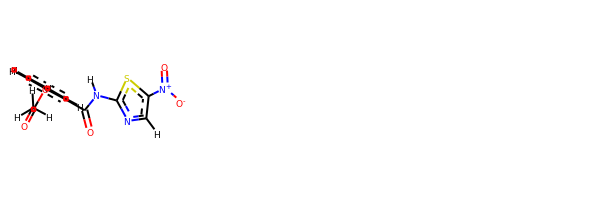

rdkit:  [H]c1nc(N([H])C(=O)c2c([H])c([H])c([H])c([H])c2OC(=O)C([H])([H])[H])sc1[N+](=O)[O-]
oechem:  CC(=O)Oc1ccccc1C(=O)Nc2ncc(s2)[N+](=O)[O-]
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

########################################

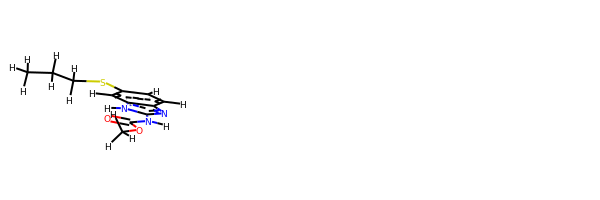

rdkit:  [H]c1c(SC([H])([H])C([H])([H])C([H])([H])[H])c([H])c2c(nc(N([H])C(=O)OC([H])([H])[H])n2[H])c1[H]
oechem:  CCCSc1ccc2c(c1)[nH]c(n2)NC(=O)OC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

#####################################

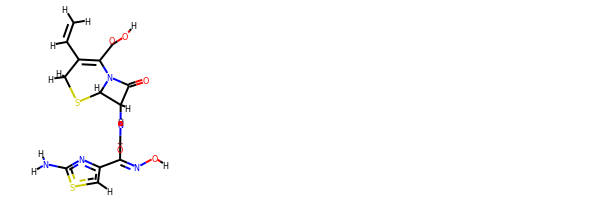

rdkit:  [H]ON=C(C(=O)N([H])C1([H])C(=O)N2C(C(=O)O[H])=C(C([H])=C([H])[H])C([H])([H])SC21[H])c1nc(N([H])[H])sc1[H]
oechem:  C=CC1=C(N2C(C(C2=O)NC(=O)C(=NO)c3csc(n3)N)SC1)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
15.031772281622857 kJ/mol 56659.38106953618 kJ/mol False
angle
31.57475444688668 kJ/mol 31.57475444688668 kJ/mol True
nb
66.86498406086702 kJ/mol 66.86498406086702 kJ/mol True
torsion
197.94997181218767 kJ/mol 160.03251209188775 kJ/mol False
311.4214826015642 kJ/mol 56917.85332013582 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_424


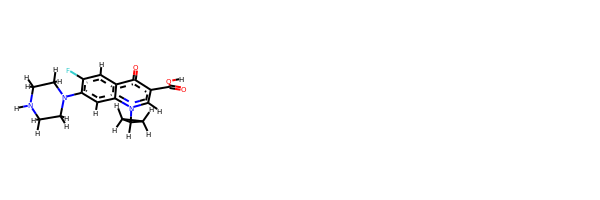

rdkit:  [H]OC(=O)c1c([H])n(C2([H])C([H])([H])C2([H])[H])c2c([H])c(N3C([H])([H])C([H])([H])N([H])C([H])([H])C3([H])[H])c(F)c([H])c2c1=O
oechem:  c1c2c(cc(c1F)N3CCNCC3)n(cc(c2=O)C(=O)O)C4CC4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
69.05986356833488 kJ/mol 57658.516826568775 kJ/mol False
angle
561.1940580704864 kJ/mol 562.0268430395292 kJ/mol False
nb
235.13117829187317 kJ/mol 235.13117829187317 kJ/mol True
torsion
194.91089324675363 kJ/mol 186.50314071346565 kJ/mol False
1060.295993177448

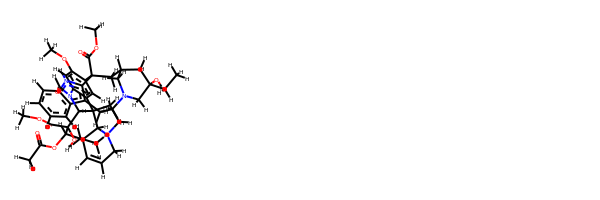

rdkit:  [H]OC1(C(=O)OC([H])([H])[H])C([H])(OC(=O)C([H])([H])[H])C2(C([H])([H])C([H])([H])[H])C([H])=C([H])C([H])([H])N3C([H])([H])C([H])([H])C4(c5c([H])c(C6(C(=O)OC([H])([H])[H])c7c(c8c([H])c([H])c([H])c([H])c8n7[H])C([H])([H])C([H])([H])N7C([H])([H])C([H])(C6([H])[H])C([H])([H])C(O[H])(C([H])([H])C([H])([H])[H])C7([H])[H])c(OC([H])([H])[H])c([H])c5N(C([H])=O)C14[H])C32[H]
oechem:  CCC1(CC2CC(c3c(c4ccccc4[nH]3)CCN(C2)C1)(c5cc6c(cc5OC)N(C7C68CCN9C8C(C=CC9)(C(C7(C(=O)OC)O)OC(=O)C)CC)C=O)C(=O)OC)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
24.108508459965936 kJ/mol 114244.7165696078 kJ/mol False
angle
18.74801089810846 kJ/mol

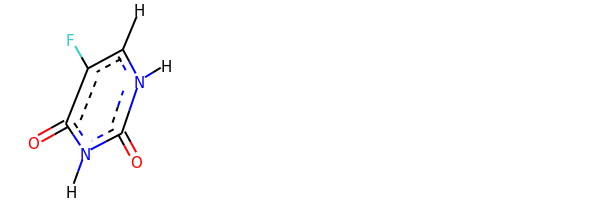

rdkit:  [H]c1c(F)c(=O)n([H])c(=O)n1[H]
oechem:  c1c(c(=O)[nH]c(=O)[nH]1)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
20.101331384774888 kJ/mol 57738.37555740496 kJ/mol False
angle
97.5776611204739 kJ/mol 97.5776611204739 kJ/mol True
nb
54.425891527458326 kJ/mol 54.425891527458326 kJ/mol True
torsion
54.341142130773 kJ/mol 37.13570526280372 kJ/mol False
226.44602616348013 kJ/mol 57927.514815315684 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_433


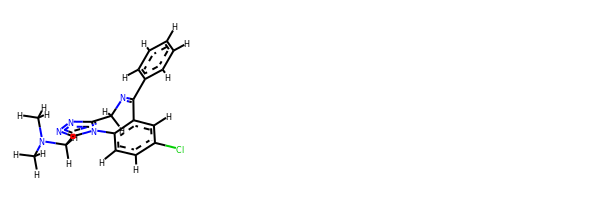

rdkit:  [H]c1c([H])c([H])c(C2=NC([H])([H])c3nnc(C([H])([H])N(C([H])([H])[H])C([H])([H])[H])n3-c3c([H])c([H])c(Cl)c([H])c32)c([H])c1[H]
oechem:  CN(C)Cc1nnc2n1-c3ccc(cc3C(=NC2)c4ccccc4)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
54.87745980379235 kJ/mol 57808.205476802126 kJ/mol False
angle
494.7589732270616 kJ/mol 494.7589732270616 kJ/mol True
nb
113.32310812112799 kJ/mol 113.32310812112799 kJ/mol True
torsion
131.6529626504076 kJ/mol 127.67872321345386 kJ/mol False
794.6125038023896 kJ/mol 58543.96628136377 kJ/mol

-------------------------------------------------------------------
--------------------------------------

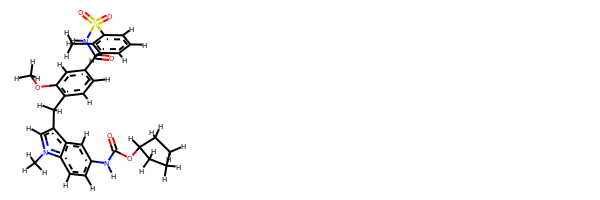

rdkit:  [H]c1c([H])c([H])c(S(=O)(=O)N([H])C(=O)c2c([H])c([H])c(C([H])([H])c3c([H])n(C([H])([H])[H])c4c([H])c([H])c(N([H])C(=O)OC5([H])C([H])([H])C([H])([H])C([H])([H])C5([H])[H])c([H])c34)c(OC([H])([H])[H])c2[H])c(C([H])([H])[H])c1[H]
oechem:  Cc1ccccc1S(=O)(=O)NC(=O)c2ccc(c(c2)OC)Cc3cn(c4c3cc(cc4)NC(=O)OC5CCCC5)C
###########################################################################
 #########################################################

bond
9.55340460961967 kJ/mol 114785.15218734925 kJ/mol False
angle
16.082527385241455 kJ/mol 16.56096278517079 kJ/mol False
nb
14.628005396378033 kJ/mol 14.628005396378033 kJ/mol True
torsion
51.13750130948566 kJ/mol 0.0928382312300435 kJ/mol False
91.40143870072481 kJ/mol 114816.43399376201 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_437


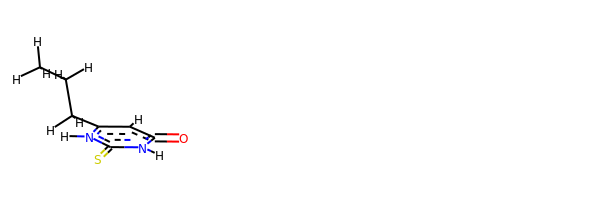

rdkit:  [H]c1c(C([H])([H])C([H])([H])C([H])([H])[H])n([H])c(=S)n([H])c1=O
oechem:  CCCc1cc(=O)[nH]c(=S)[nH]1
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
25.796024535191656 kJ/mol 57950.61311588507 kJ/mol False
angle
450.4091931568063 kJ/mol 450.4091931568063 kJ/mol True
nb
0.15332757664570518 kJ/mol 0.15332757664570518 kJ/mol True
torsion
84.57372993773565 kJ/mol 60.76908093323103 kJ/mol False
560.9322752063792 kJ/mol 58461.944717551756 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_439


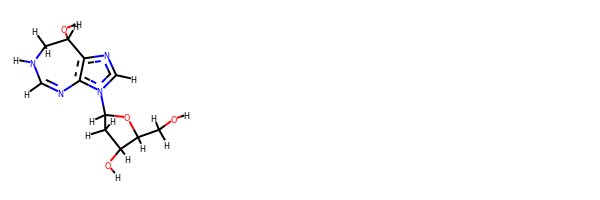

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])nc3c2N=C([H])N([H])C([H])([H])C3([H])O[H])C([H])([H])C1([H])O[H]
oechem:  c1nc2c(n1C3CC(C(O3)CO)O)N=CNCC2O
###########################################################################
 #########################################################

bond
36.03193307650328 kJ/mol 114786.59543425497 kJ/mol False
angle
97.8980267713721 kJ/mol 97.8980267713721 kJ/mol True
nb
16.25603997755501 kJ/mol 16.25603997755501 kJ/mol True
torsion
17.57509049121883 kJ/mol 17.575051787377 kJ/mol False
167.76109031664924 kJ/mol 114918.32455279128 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_440


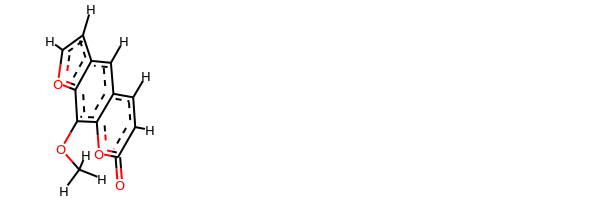

rdkit:  [H]c1oc2c(OC([H])([H])[H])c3oc(=O)c([H])c([H])c3c([H])c2c1[H]
oechem:  COc1c2c(ccc(=O)o2)cc3c1occ3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 

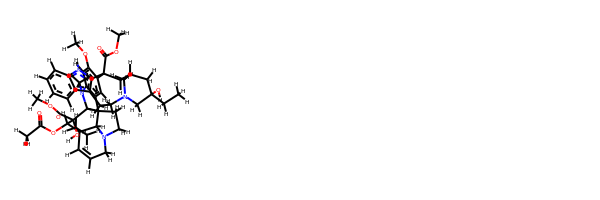

rdkit:  [H]OC1(C(=O)OC([H])([H])[H])C([H])(OC(=O)C([H])([H])[H])C2(C([H])([H])C([H])([H])[H])C([H])=C([H])C([H])([H])N3C([H])([H])C([H])([H])C4(c5c([H])c(C6(C(=O)OC([H])([H])[H])c7c(c8c([H])c([H])c([H])c([H])c8n7[H])C([H])([H])C([H])([H])N7C([H])([H])C([H])(C6([H])[H])C([H])([H])C(O[H])(C([H])([H])C([H])([H])[H])C7([H])[H])c(OC([H])([H])[H])c([H])c5N(C([H])([H])[H])C14[H])C32[H]
oechem:  CCC1(CC2CC(c3c(c4ccccc4[nH]3)CCN(C2)C1)(c5cc6c(cc5OC)N(C7C68CCN9C8C(C=CC9)(C(C7(C(=O)OC)O)OC(=O)C)CC)C)C(=O)OC)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
19.32833825577789 kJ/mol 43706.62018297189 kJ/mol False
angle
42.169419592506685 kJ/mol 46.56555169015265 kJ/mol False
nb
10.669873927715596 kJ/mol 10.669873927715596 kJ/mol True
torsion
87.61818594628423 kJ/mol 79.9945

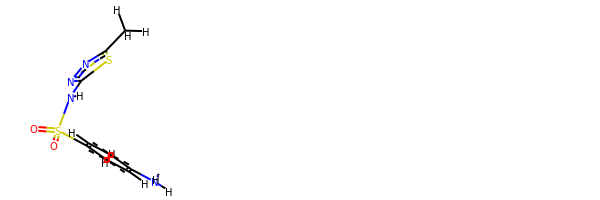

rdkit:  [H]c1c([H])c(S(=O)(=O)N([H])c2nnc(C([H])([H])[H])s2)c([H])c([H])c1N([H])[H]
oechem:  Cc1nnc(s1)NS(=O)(=O)c2ccc(cc2)N
###########################################################################
 #########################################################

bond
25.699772420660167 kJ/mol 116262.26484147209 kJ/mol False
angle
128.5744582524381 kJ/mol 128.88951244579553 kJ/mol False
nb
19.981776813369862 kJ/mol 19.981776813369862 kJ/mol True
torsion
62.95322395119438 kJ/mol 25.293040426657104 kJ/mol False
237.2092314376625 kJ/mol 116436.4291711579 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_464


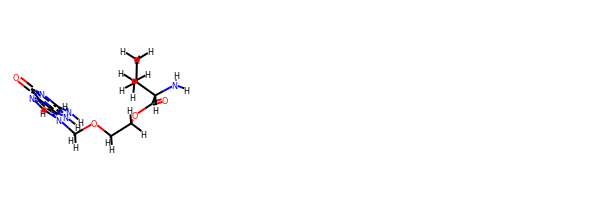

rdkit:  [H]c1nc2c(=O)nc(N([H])[H])n([H])c2n1C([H])([H])OC([H])([H])C([H])([H])OC(=O)C([H])(N([H])[H])C([H])(C([H])([H])[H])C([H])([H])[H]
oechem:  CC(C)C(C(=O)OCCOCn1cnc2c1[nH]c(nc2=O)N)N
###########################################################################
 #########################################################

bond
15.340004850560355 kJ/mol 57731.33134760439 kJ/mol False
angle
118.97935863319721 kJ/mol 118.97935863319721 kJ/mol True
nb
16.022534042906358 kJ/mol 16.022534042906358 kJ/mol True
torsion
90.77658712953739 kJ/mol 100.19124328488145 kJ/mol False
241.11848465620133 kJ/mol 57966.52448356538 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_467


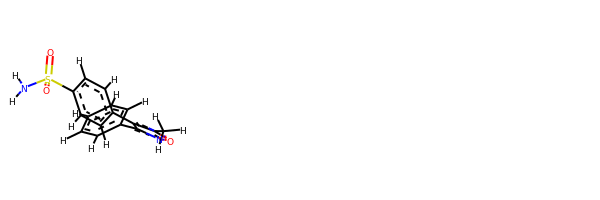

rdkit:  [H]c1c([H])c([H])c(-c2noc(C([H])([H])[H])c2-c2c([H])c([H])c(S(=O)(=O)N([H])[H])c([H])c2[H])c([H])c1[H]
oechem:  Cc1c(c(no1)c2ccccc2)c3ccc(cc3)S(=O)(=O)N
###########################################################################
 #########################################################

bond
18.24635797325881 kJ/mol 29177.576842166527 kJ/mol False
angle
117.70853752373715 kJ/mol 117.70853752373715 kJ/mol True
nb
63.77487268568773 kJ/mol 63.77487268568773 kJ/mol True
torsion
14.551922122640525 kJ/mol 6.592181825295432 kJ/mol False
214.28169030532422 kJ/mol 29365.652434201245 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_469


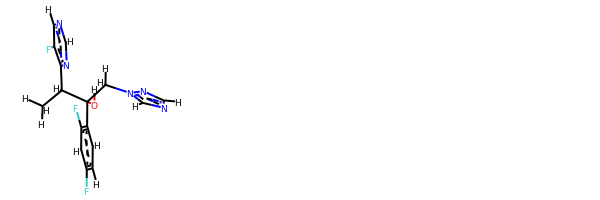

rdkit:  [H]OC(c1c([H])c([H])c(F)c([H])c1F)(C([H])([H])n1nc([H])nc1[H])C([H])(c1nc([H])nc([H])c1F)C([H])([H])[H]
oechem:  CC(c1c(cncn1)F)C(Cn2cncn2)(c3ccc(cc3F)F)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
23.901174688294017 kJ/mol 43694.00380444843 kJ/mol False
angle
67.56315129043551 kJ/mol 70.92035913468624 kJ/mol False
nb
9.155012425731606 kJ/mol 9.155012425731606 kJ/mol True
torsion
88.96586173896048 kJ/mol 62.46220873618771 kJ/mol False
189.58520014342162 kJ/mol 43836.54138474504 kJ/mol

-------------------------------------------------------------------
---------------------------------------------------------------

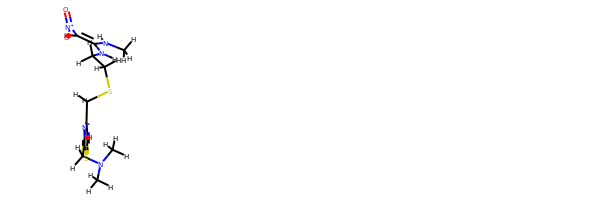

rdkit:  [H]C(=C(N([H])C([H])([H])[H])N([H])C([H])([H])C([H])([H])SC([H])([H])c1nc(C([H])([H])N(C([H])([H])[H])C([H])([H])[H])sc1[H])[N+](=O)[O-]
oechem:  CNC(=C[N+](=O)[O-])NCCSCc1csc(n1)CN(C)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
36.669706817436555 kJ/mol 43708.12567670768 kJ/mol False
angle
251.93473512369124 kJ/mol 255.2911762801862 kJ/mol False
nb
73.00395347651607 kJ/mol 73.00395347651607 kJ/mol True
torsion
55.02927657779929 kJ/mol 55.03630948108852 kJ/mol False
416.63767199544316 kJ/mol 44091.45711594547 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_474


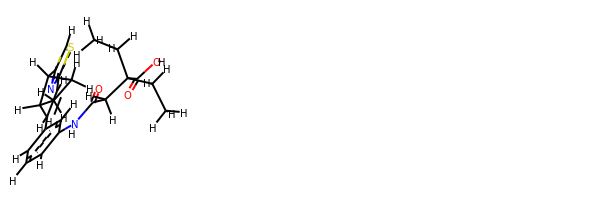

rdkit:  [H]OC(=O)C(C([H])([H])C(=O)N([H])c1c([H])c([H])c([H])c(C([H])=C([H])c2nc(C3([H])C([H])([H])C([H])([H])C3([H])[H])c([H])s2)c1[H])(C([H])([H])C([H])([H])[H])C([H])([H])C([H])([H])[H]
oechem:  CCC(CC)(CC(=O)Nc1cccc(c1)C=Cc2nc(cs2)C3CCC3)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
36.536514152804756 kJ/mol 57552.70928954126 kJ/mol False
angle
115.01158369872601 kJ/mol 116.21929922662574 kJ/mol False
nb
42.04831434626334 kJ/mol 42.04831434626334 kJ/mol True
torsion
26.09360860382743 kJ/mol 26.100197784406355 kJ/mol False
219.69002080162153 kJ/mol 57737.077100898554 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-----------------------------------------

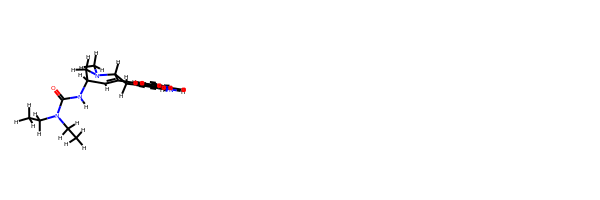

rdkit:  [H]C1=C2c3c([H])c([H])c([H])c4c3c(c([H])n4[H])C([H])([H])C2([H])N(C([H])([H])[H])C([H])([H])C1([H])N([H])C(=O)N(C([H])([H])C([H])([H])[H])C([H])([H])C([H])([H])[H]
oechem:  CCN(CC)C(=O)NC1CN(C2Cc3c[nH]c4c3c(ccc4)C2=C1)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ###############

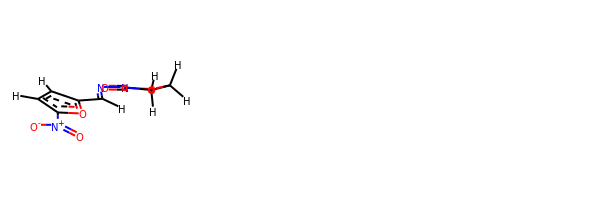

rdkit:  [H]C(=NN1C(=O)OC([H])([H])C1([H])[H])c1oc([N+](=O)[O-])c([H])c1[H]
oechem:  c1cc(oc1C=NN2CCOC2=O)[N+](=O)[O-]
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

##################################################################

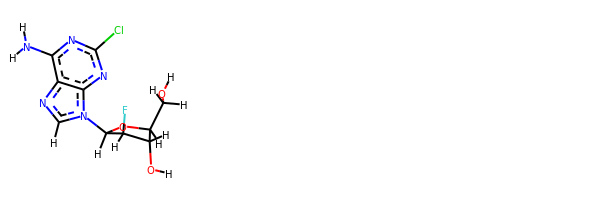

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])nc3c(N([H])[H])nc(Cl)nc32)C([H])(F)C1([H])O[H]
oechem:  c1nc2c(nc(nc2n1C3C(C(C(O3)CO)O)F)Cl)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
7.1877788935910685 kJ/mol 58029.253167911855 kJ/mol False
angle
93.42908638442012 kJ/mol 95.4380303725055 kJ/mol False
nb
101.85176377142443 kJ/mol 101.85176377142443 kJ/mol True
torsion
5.528173399701251 kJ/mol 0.137118481626463 kJ/mol False
207.99680244913685 kJ/mol 58226.68008053741 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_520


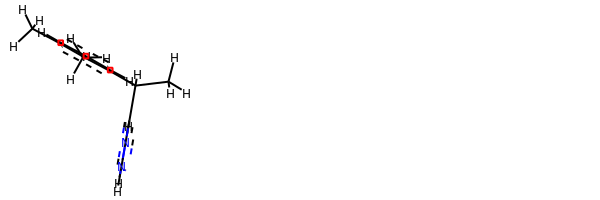

rdkit:  [H]c1c([H])c(C([H])([H])[H])c(C([H])([H])[H])c(C([H])(c2nc([H])n([H])c2[H])C([H])([H])[H])c1[H]
oechem:  Cc1cccc(c1C)C(C)c2c[nH]cn2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
13.873777966827975 kJ/mol 57928.9179995081 kJ/mol False
angle
93.80960167972022 kJ/mol 93.80960167972022 kJ/mol True
nb
64.24961863519216 kJ/mol 64.24961863519216 kJ/mol True
torsion
45.85605619913015 kJ/mol 18.327569639082135 kJ/mol False
217.7890544808705 kJ/mol 58105.3047894621 kJ/mol

---------------------

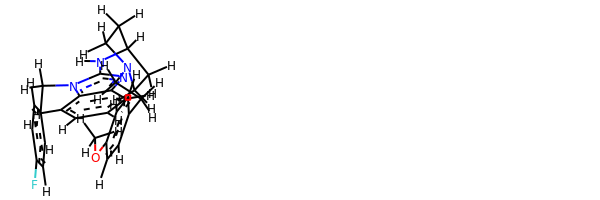

rdkit:  [H]c1c([H])c(C([H])([H])n2c(N([H])C3([H])C([H])([H])C([H])([H])N(C([H])([H])C([H])([H])c4c([H])c([H])c(OC([H])([H])[H])c([H])c4[H])C([H])([H])C3([H])[H])nc3c([H])c([H])c([H])c([H])c32)c([H])c([H])c1F
oechem:  COc1ccc(cc1)CCN2CCC(CC2)Nc3nc4ccccc4n3Cc5ccc(cc5)F
###########################################################################
 #########################################################

bond
22.089150795178853 kJ/mol 58002.25307562094 kJ/mol False
angle
399.6176252936406 kJ/mol 399.6176252936406 kJ/mol True
nb
15.54164077031265 kJ/mol 15.54164077031265 kJ/mol True
torsion
87.73776759702938 kJ/mol 63.636253058294585 kJ/mol False
524.9861844561614 kJ/mol 58481.04859474319 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_527


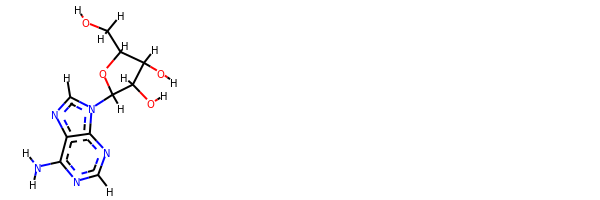

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)C([H])(O[H])C1([H])O[H]
oechem:  c1nc(c2c(n1)n(cn2)C3C(C(C(O3)CO)O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
24.743783728077087 kJ/mol 57939.85585538213 kJ/mol False
angle
104.62929177038417 kJ/mol 106.53355094781828 kJ/mol False
nb
35.51158954849196 kJ/mol 35.51158954849196 kJ/mol True
torsion
25.106126284947717 kJ/mol 8.370160428261789 kJ/mol False
189.99079133190094 kJ/mol 58090.2711563067 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_530


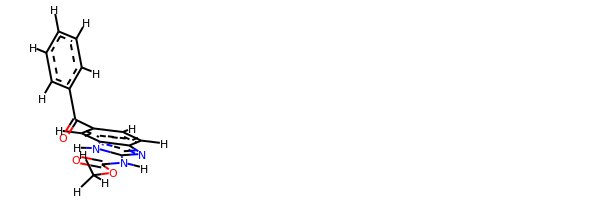

rdkit:  [H]c1c([H])c([H])c(C(=O)c2c([H])c([H])c3nc(N([H])C(=O)OC([H])([H])[H])n([H])c3c2[H])c([H])c1[H]
oechem:  COC(=O)Nc1[nH]c2cc(ccc2n1)C(=O)c3ccccc3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
43.04152568552945 kJ/mol 113894.05262288761 kJ/mol False
angle
200.56134016192874 kJ/mol 201.18225494691802 kJ/mol False
nb
23.575631350233074 kJ/mol 23.575631350233074 kJ/mol True
torsion
107.43847949615642 kJ/mol 36.60645284449534 kJ/mol False
374.6169766938477 kJ/mol 114155.41696202927 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------


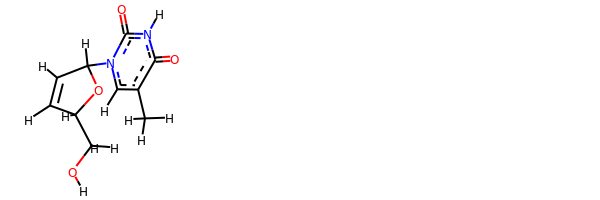

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])c(C([H])([H])[H])c(=O)n([H])c2=O)C([H])=C1[H]
oechem:  Cc1cn(c(=O)[nH]c1=O)C2C=CC(O2)CO
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
24.294880903287734 kJ/mol 114971.97565088449 kJ/mol False
angle
99.1902127632398 kJ/mol 99.1902127632398 kJ/mol True
nb
37.27595781965966 kJ/mol 37.27595781965966 kJ/mol True
torsio

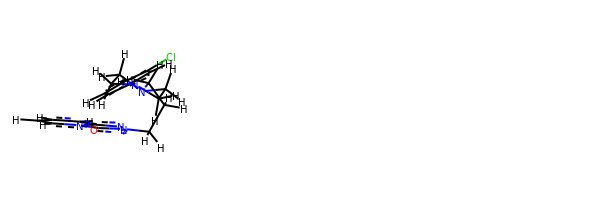

rdkit:  [H]c1c([H])c(Cl)c([H])c(N2C([H])([H])C([H])([H])N(C([H])([H])C([H])([H])C([H])([H])n3nc4c([H])c([H])c([H])c([H])n4c3=O)C([H])([H])C2([H])[H])c1[H]
oechem:  c1ccn2c(c1)nn(c2=O)CCCN3CCN(CC3)c4cccc(c4)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ##################################

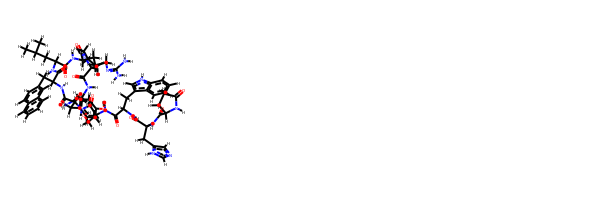

rdkit:  [H]Oc1c([H])c([H])c(C([H])([H])C([H])(C(=O)N([H])C([H])(C(=O)N([H])C([H])(C(=O)N([H])C([H])(C(=O)N2C([H])([H])C([H])([H])C([H])([H])C2([H])C(=O)N([H])C([H])([H])C(=O)N([H])[H])C([H])([H])C([H])([H])C([H])([H])N=C(N([H])[H])N([H])[H])C([H])([H])C([H])(C([H])([H])[H])C([H])([H])[H])C([H])([H])c2c([H])c([H])c3c([H])c([H])c([H])c([H])c3c2[H])N([H])C(=O)C([H])(N([H])C(=O)C([H])(N([H])C(=O)C([H])(N([H])C(=O)C2([H])N([H])C(=O)C([H])([H])C2([H])[H])C([H])([H])c2c([H])nc([H])n2[H])C([H])([H])c2c([H])n([H])c3c([H])c([H])c([H])c([H])c23)C([H])([H])O[H])c([H])c1[H]
oechem:  CC(C)CC(C(=O)NC(CCCN=C(N)N)C(=O)N1CCCC1C(=O)NCC(=O)N)NC(=O)C(Cc2ccc3ccccc3c2)NC(=O)C(Cc4ccc(cc4)O)NC(=O)C(CO)NC(=O)C(Cc5c[nH]c6c5cccc6)NC(=O)C(Cc7cnc[nH]7)NC(=O)C8CCC(=O)N8
###########################################################################
 #########################################################

bond
4.850794414087823 kJ/mol 58027.59229427109 kJ/mol False
angle
103.93237917157082 kJ/mol 105.94210186494286 kJ

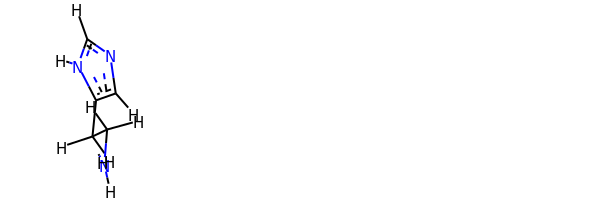

rdkit:  [H]c1nc([H])n([H])c1C([H])([H])C([H])([H])N([H])[H]
oechem:  c1c([nH]cn1)CCN
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
9.706588761194144 kJ/mol 57761.611935428 kJ/mol False
angle
112.98549383639404 kJ/mol 114.21543873544549 kJ/mol False
nb
13.395121073169076 kJ/mol 13.395121073169076 kJ/mol True
torsion
45.417416961231375 kJ/mol 45.41743227771616 kJ/mol False
181.50462063198862 kJ/mol 57934.639927514334 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_556


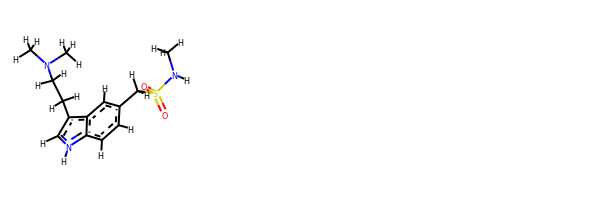

rdkit:  [H]c1c(C([H])([H])S(=O)(=O)N([H])C([H])([H])[H])c([H])c2c(C([H])([H])C([H])([H])N(C([H])([H])[H])C([H])([H])[H])c([H])n([H])c2c1[H]
oechem:  CNS(=O)(=O)Cc1ccc2c(c1)c(c[nH]2)CCN(C)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
30.123234070508573 kJ/mol 43700.98024749817 kJ/mol False
angle
384.5684201147459 kJ/mol 387.924097011624 kJ/mol False
nb
11.136900491224674 kJ/mol 11.136900491224674 kJ/mol True
torsion
130.38383760957726 kJ/mol 113.55481970236511 kJ/mol False
556.2123922860565 kJ/mol 44213.596064703386 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_558


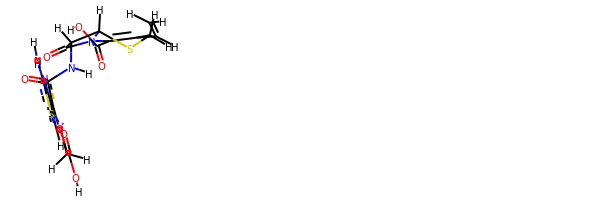

rdkit:  [H]OC(=O)C1=C(C([H])=C([H])[H])C([H])([H])SC2([H])N1C(=O)C2([H])N([H])C(=O)C(=NOC([H])([H])C(=O)O[H])c1nc(N([H])[H])sc1[H]
oechem:  C=CC1=C(N2C(C(C2=O)NC(=O)C(=NOCC(=O)O)c3csc(n3)N)SC1)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
41.345752786102956 kJ/mol 86489.45550188357 kJ/mol False
angle
106.09191046687619 kJ/mol 109.89143072646806 kJ/mol False
nb
34.6599996755543 kJ/mol 34.6599996755543 kJ/mol True
torsion
77.97869892514876 kJ/mol 48.179779987572175 kJ/mol False
260.0763618536822 kJ/mol 86682.18671227316 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_560


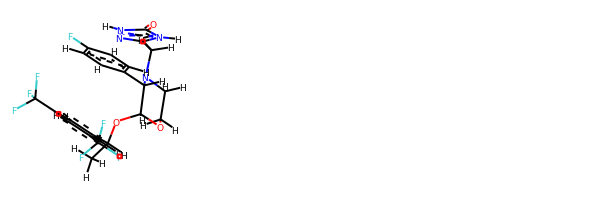

rdkit:  [H]c1c([H])c(C2([H])N(C([H])([H])c3nn([H])c(=O)n3[H])C([H])([H])C([H])([H])OC2([H])OC([H])(c2c([H])c(C(F)(F)F)c([H])c(C(F)(F)F)c2[H])C([H])([H])[H])c([H])c([H])c1F
oechem:  CC(c1cc(cc(c1)C(F)(F)F)C(F)(F)F)OC2C(N(CCO2)Cc3[nH]c(=O)[nH]n3)c4ccc(cc4)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
14.923385813923526 kJ/mol 58033.85998335879 kJ/mol False
an

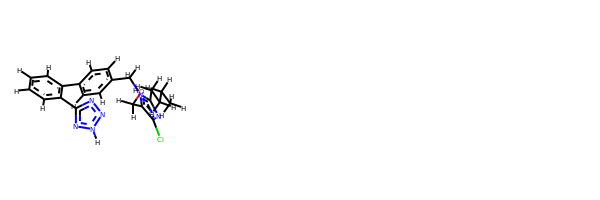

rdkit:  [H]OC([H])([H])c1c(Cl)nc(C([H])([H])C([H])([H])C([H])([H])C([H])([H])[H])n1C([H])([H])c1c([H])c([H])c(-c2c([H])c([H])c([H])c([H])c2-c2nnn([H])n2)c([H])c1[H]
oechem:  CCCCc1nc(c(n1Cc2ccc(cc2)c3ccccc3c4n[nH]nn4)CO)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
18.665364859360476 kJ/mol 57535.650818022455 kJ/mol False
angle
105.54654356468416 kJ/mol 105.54654356468416 kJ/mol True
nb
54.71146486359854 kJ/mol 54.71146486359854 kJ/mol True
torsion
34.77779763415148 kJ/mol 34.06709208518041 kJ/mol False
213.70117092179467 kJ/mol 57729.975918535914 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------


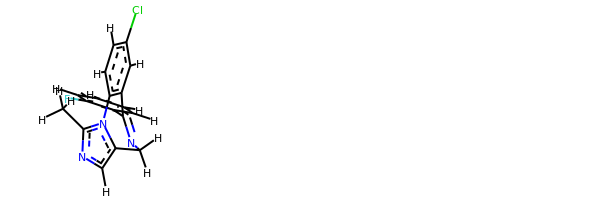

rdkit:  [H]c1nc(C([H])([H])[H])n2c1C([H])([H])N=C(c1c([H])c([H])c([H])c([H])c1F)c1c([H])c(Cl)c([H])c([H])c1-2
oechem:  Cc1ncc2n1-c3ccc(cc3C(=NC2)c4ccccc4F)Cl
###########################################################################
 #########################################################

bond
35.3186603426743 kJ/mol 55880.93926011123 kJ/mol False
angle
142.35507884452235 kJ/mol 142.35507884452235 kJ/mol True
nb
119.90232994423388 kJ/mol 119.90232994423388 kJ/mol True
torsion
219.11250032876987 kJ/mol 214.25633854251586 kJ/mol False
516.6885694602004 kJ/mol 56357.4530074425 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_572


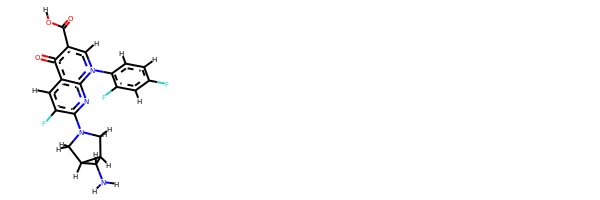

rdkit:  [H]OC(=O)c1c([H])n(-c2c([H])c([H])c(F)c([H])c2F)c2nc(N3C([H])([H])C4([H])C([H])(N([H])[H])C4([H])C3([H])[H])c(F)c([H])c2c1=O
oechem:  c1cc(c(cc1F)F)n2cc(c(=O)c3c2nc(c(c3)F)N4CC5C(C4)C5N)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ##########################################

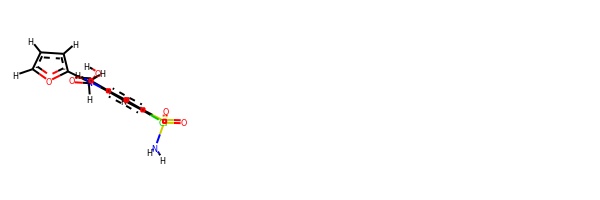

rdkit:  [H]OC(=O)c1c([H])c(S(=O)(=O)N([H])[H])c(Cl)c([H])c1N([H])C([H])([H])c1oc([H])c([H])c1[H]
oechem:  c1cc(oc1)CNc2cc(c(cc2C(=O)O)S(=O)(=O)N)Cl
###########################################################################
 #########################################################

bond
44.05301534940419 kJ/mol 57559.61775819621 kJ/mol False
angle
600.330215232476 kJ/mol 601.5377455856553 kJ/mol False
nb
69.38278222371338 kJ/mol 69.38278222371338 kJ/mol True
torsion
165.74400584037969 kJ/mol 165.75193115665775 kJ/mol False
879.5100186459733 kJ/mol 58396.29021716224 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_583


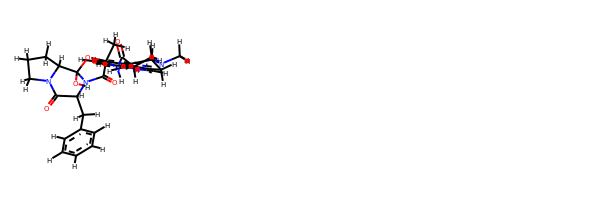

rdkit:  [H]OC12OC(N([H])C(=O)C3([H])C([H])=C4c5c([H])c([H])c([H])c6c5c(c([H])n6[H])C([H])([H])C4([H])N(C([H])([H])[H])C3([H])[H])(C([H])([H])[H])C(=O)N1C([H])(C([H])([H])c1c([H])c([H])c([H])c([H])c1[H])C(=O)N1C([H])([H])C([H])([H])C([H])([H])C12[H]
oechem:  CC1(C(=O)N2C(C(=O)N3CCCC3C2(O1)O)Cc4ccccc4)NC(=O)C5CN(C6Cc7c[nH]c8c7c(ccc8)C6=C5)C
###########################################################################
 #########################################################

bond
42.03812071172647 kJ/mol 45828.75726389316 kJ/mol False
angle
249.2131164816313 kJ/mol 249.2131164816313 kJ/mol True
nb
12.338743952512186 kJ/mol 12.338743952512186 kJ/mol True
torsion
41.85549282482814 kJ/mol 41.85548907856977 kJ/mol False
345.4454739706981 kJ/mol 46132.16461340587 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_584


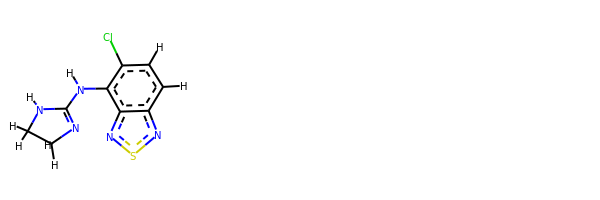

rdkit:  [H]c1c(Cl)c(N([H])C2=NC([H])([H])C([H])([H])N2[H])c2nsnc2c1[H]
oechem:  c1cc(c(c2c1nsn2)NC3=NCCN3)Cl
###########################################################################
 #########################################################

bond
29.292781976711343 kJ/mol 58394.59425584575 kJ/mol False
angle
221.23572849001795 kJ/mol 221.23572849001795 kJ/mol True
nb
34.66250618752155 kJ/mol 34.66250618752155 kJ/mol True
torsion
11.924443874749644 kJ/mol 11.924444842063183 kJ/mol False
297.11546052900053 kJ/mol 58662.416935365356 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_585


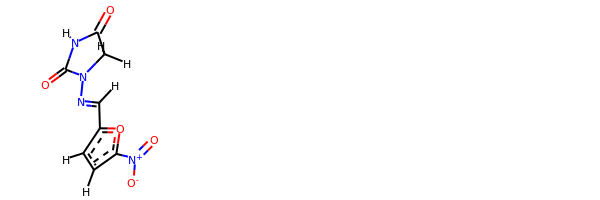

rdkit:  [H]C(=NN1C(=O)N([H])C(=O)C1([H])[H])c1oc([N+](=O)[O-])c([H])c1[H]
oechem:  c1cc(oc1C=NN2CC(=O)NC2=O)[N+](=O)[O-]
###########################################################################
 #########################################################

bond
34.51410243885583 kJ/mol 57513.26675761768 kJ/mol False
angle
118.66825128725802 kJ/mol 118.66825128725802 kJ/mol True
nb
125.8881717735058 kJ/mol 125.8881717735058 kJ/mol True
torsion
27.950841948630575 kJ/mol 27.956923757286223 kJ/mol False
307.0213674482502 kJ/mol 57785.78010443573 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_586


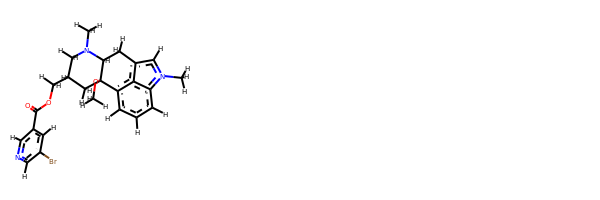

rdkit:  [H]c1nc([H])c(C(=O)OC([H])([H])C2([H])C([H])([H])N(C([H])([H])[H])C3([H])C([H])([H])c4c([H])n(C([H])([H])[H])c5c([H])c([H])c([H])c(c45)C3(OC([H])([H])[H])C2([H])[H])c([H])c1Br
oechem:  Cn1cc2c3c1cccc3C4(CC(CN(C4C2)C)COC(=O)c5cc(cnc5)Br)OC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
6.8182167110237195 kJ/mol 70963.80998314115 kJ/mol False
angle
71.54197214673809 kJ/mol 75.84614410259114 kJ/mol False
nb
9.17613775180297 kJ/mol 9.17613775180297 kJ/mol True
torsion
86.87253123195579 kJ/mol 81.9729259659123 kJ/mol False
174.40885784152056 kJ/mol 71130.80519096144 kJ/mol

--------------------------------------------------

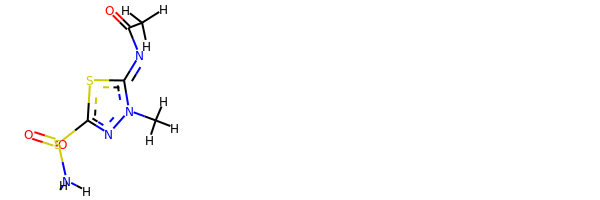

rdkit:  [H]N([H])S(=O)(=O)c1nn(C([H])([H])[H])c(=NC(=O)C([H])([H])[H])s1
oechem:  CC(=O)N=c1n(nc(s1)S(=O)(=O)N)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
25.140703254200222 kJ/mol 57779.52670525046 kJ/mol False
angle
122.23409561521827 kJ/mol 123.46562380667991 kJ/mol False
nb
49.733372699028344 kJ/mol 49.733372699028344 kJ/mol True
torsion
81.25654473939605 kJ/mol 69.05026584043617 kJ/mol False
278.3647163078429 kJ/mol 58021.7759675966 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_591


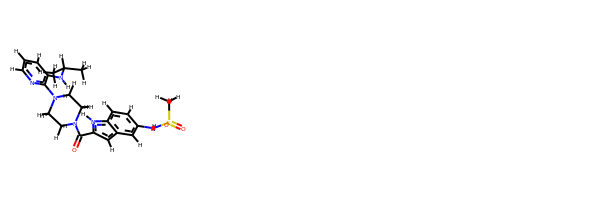

rdkit:  [H]c1nc(N2C([H])([H])C([H])([H])N(C(=O)c3c([H])c4c([H])c(N([H])S(=O)(=O)C([H])([H])[H])c([H])c([H])c4n3[H])C([H])([H])C2([H])[H])c(N([H])C([H])(C([H])([H])[H])C([H])([H])[H])c([H])c1[H]
oechem:  CC(C)Nc1cccnc1N2CCN(CC2)C(=O)c3cc4cc(ccc4[nH]3)NS(=O)(=O)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
41.75581577135688 kJ/mol 43830.112560956026 kJ/mol False
angle
46.14446392754754 kJ/mol 48.29687243878509 kJ/mol False
nb
188.54556994598667 kJ/mol 188.54556994598667 kJ/mol True
torsion
65.10968741755406 kJ/mol 60.447667718975595 kJ/mol False
341.5555370624452 kJ/mol 44127.40267105977 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
------------------------------

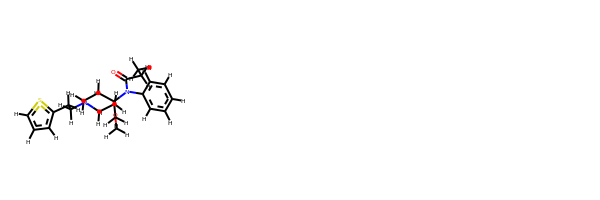

rdkit:  [H]c1sc(C([H])([H])C([H])([H])N2C([H])([H])C([H])([H])C(N(C(=O)C([H])([H])C([H])([H])[H])c3c([H])c([H])c([H])c([H])c3[H])(C([H])([H])OC([H])([H])[H])C([H])([H])C2([H])[H])c([H])c1[H]
oechem:  CCC(=O)N(c1ccccc1)C2(CCN(CC2)CCc3cccs3)COC
###########################################################################
 #########################################################

bond
26.776326752963918 kJ/mol 57010.78717610028 kJ/mol False
angle
250.31270288044723 kJ/mol 250.31270288044723 kJ/mol True
nb
25.88993521092387 kJ/mol 25.88993521092387 kJ/mol True
torsion
66.23978567085166 kJ/mol 25.910870436430542 kJ/mol False
369.2187505151866 kJ/mol 57312.90068462808 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_595


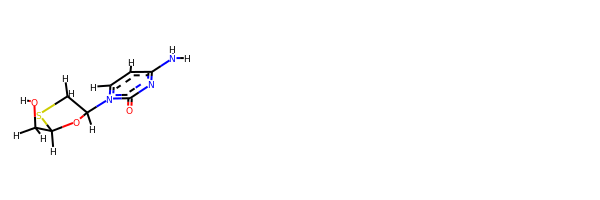

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])c([H])c(N([H])[H])nc2=O)C([H])([H])S1
oechem:  c1cn(c(=O)nc1N)C2CSC(O2)CO
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
29.27952526373686 kJ/mol 57745.09735591648 kJ/mol False
angle
468.33495729470883 kJ/mol 468.33495729470883 kJ/mol True
nb
-5.741958485594209 kJ/mol -5.741958485594209 kJ/mol True
torsion
106.36563635425969 kJ/mol 110.6828967897096 kJ/mol False
598.2381604271112 kJ/mol 58318.3732515153 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------

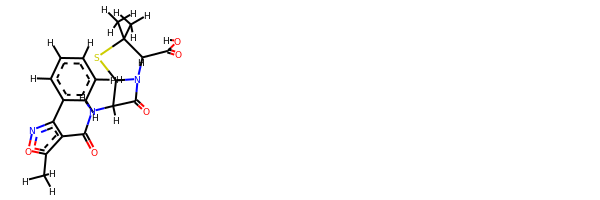

rdkit:  [H]OC(=O)C1([H])N2C(=O)C([H])(N([H])C(=O)c3c(-c4c([H])c([H])c([H])c([H])c4[H])noc3C([H])([H])[H])C2([H])SC1(C([H])([H])[H])C([H])([H])[H]
oechem:  Cc1c(c(no1)c2ccccc2)C(=O)NC3C4N(C3=O)C(C(S4)(C)C)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
27.127607075708887 kJ/mol 113904.65268515947 kJ/mol False
angle
55.101804305544896 kJ/mol 55.101804305544896 kJ/mol True
nb
1313.0252432846362 kJ/mol 1313.0252432846362 kJ/mol True
torsion
62.57198414345906 kJ/mol 48.24189084414954 kJ/mol False
1457.826638809349 kJ/mol 115321.0216235938 kJ/mol

-------------------------------------------------------------------
------------

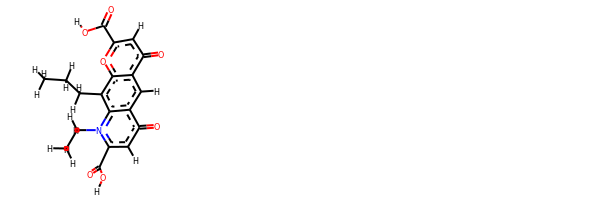

rdkit:  [H]OC(=O)c1oc2c(C([H])([H])C([H])([H])C([H])([H])[H])c3c(c([H])c2c(=O)c1[H])c(=O)c([H])c(C(=O)O[H])n3C([H])([H])C([H])([H])[H]
oechem:  CCCc1c2c(cc3c1oc(cc3=O)C(=O)O)c(=O)cc(n2CC)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
44.74602971899688 kJ/mol 58024.83470101447 kJ/mol False
angle
157.30101353734315 kJ/mol 157.30101353734315 kJ/mol True
nb
7.802340191740443 kJ/mol 7.802340191740443 kJ/mol True
torsion
32.095998729616774 kJ/mol 27.684122351164888 kJ/mol False
241.94538217769727 kJ/mol 58217.622177094716 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_604


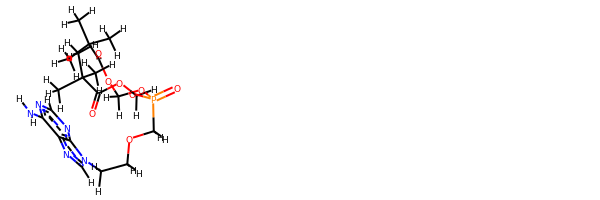

rdkit:  [H]c1nc(N([H])[H])c2nc([H])n(C([H])([H])C([H])([H])OC([H])([H])P(=O)(OC([H])([H])OC(=O)C(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H])OC([H])([H])OC(=O)C(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H])c2n1
oechem:  CC(C)(C)C(=O)OCOP(=O)(COCCn1cnc2c1ncnc2N)OCOC(=O)C(C)(C)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
6.747157578007545 kJ/mol 57897.632

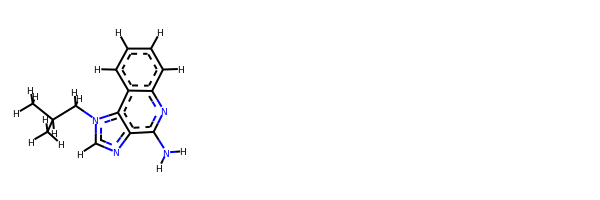

rdkit:  [H]c1c([H])c([H])c2c(nc(N([H])[H])c3nc([H])n(C([H])([H])C([H])(C([H])([H])[H])C([H])([H])[H])c32)c1[H]
oechem:  CC(C)Cn1cnc2c1c3ccccc3nc2N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
6.758981708266954 kJ/mol 101592.67755332425 kJ/mol False
angle
108.76363648250981 kJ/mol 114.02686273952364 kJ/mol False
nb
10.30186156188586 kJ/mol 10.30186156188586 kJ/mol True
torsion
0.0005367679699521418 kJ/mol 0.0006447163937516096 kJ/mol False
125.82501652063257 kJ/mol 101717.00692234206 kJ/mol



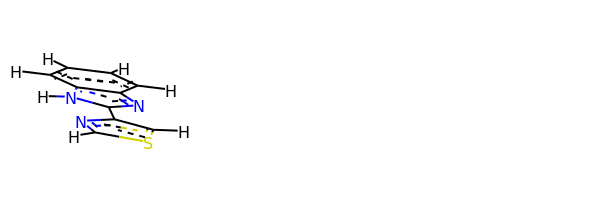

rdkit:  [H]c1nc(-c2nc3c([H])c([H])c([H])c([H])c3n2[H])c([H])s1
oechem:  c1ccc2c(c1)[nH]c(n2)c3cscn3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
26.01974031271928 kJ/mol 114677.13194111869 kJ/mol False
angle
115.95975506624845 kJ/mol 115.95975506624845 kJ/mol True
nb
70.13014180163643 kJ/mol 70.13014180163643 kJ/mol True
torsion
33.539936300012926 kJ/mol 25.088618701824565 kJ/mol False
245.64957348061708 kJ/mol 114888.31045668838 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
------------------------------------------------------

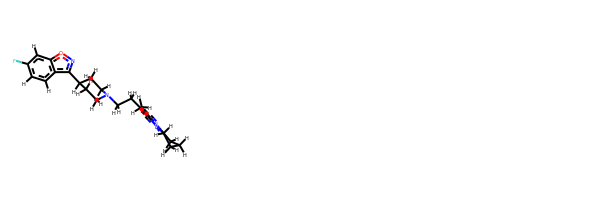

rdkit:  [H]c1c(F)c([H])c2onc(C3([H])C([H])([H])C([H])([H])N(C([H])([H])C([H])([H])c4c(C([H])([H])[H])nc5n(c4=O)C([H])([H])C([H])([H])C([H])([H])C5([H])[H])C([H])([H])C3([H])[H])c2c1[H]
oechem:  Cc1c(c(=O)n2c(n1)CCCC2)CCN3CCC(CC3)c4c5ccc(cc5on4)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
30.118244453572327 kJ/mol 57946.46061278141 kJ/mol False
angle
104.25719210445733 kJ/mol 106.16078465300684 kJ/mol False
nb
66.67738109524801 kJ/mol 66.67738109524801 kJ/mol True
torsion
35.74499396452242 kJ/mol 35.74496956708094 kJ/mol False
236.7978116178001 kJ/mol 58155.04374809675 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-----------------------------------------------

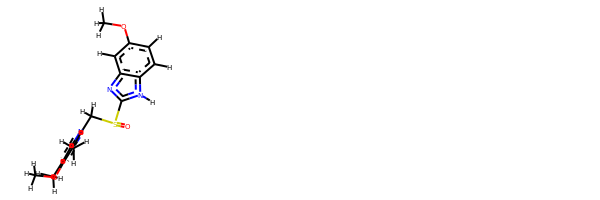

rdkit:  [H]c1nc(C([H])([H])S(=O)c2nc3c([H])c(OC([H])([H])[H])c([H])c([H])c3n2[H])c(C([H])([H])[H])c(OC([H])([H])[H])c1C([H])([H])[H]
oechem:  Cc1cnc(c(c1OC)C)CS(=O)c2[nH]c3ccc(cc3n2)OC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
14.764396400684426 kJ/mol 43618.06875689509 kJ/mol False
angle
34.657589412150195 kJ/mol 37.791771793948776 kJ/mol False
nb
16.294263654873888 kJ/mol 16.294263654873888 kJ/mol True
torsion
35.31719297707957 kJ/mol 18.487405087000692 kJ/mol False
101.03344244478808 kJ/mol 43690.64219743091 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_626


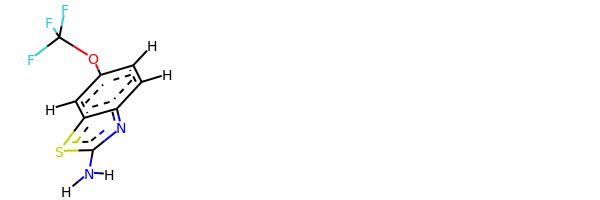

rdkit:  [H]c1c(OC(F)(F)F)c([H])c2sc(N([H])[H])nc2c1[H]
oechem:  c1cc2c(cc1OC(F)(F)F)sc(n2)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ###############

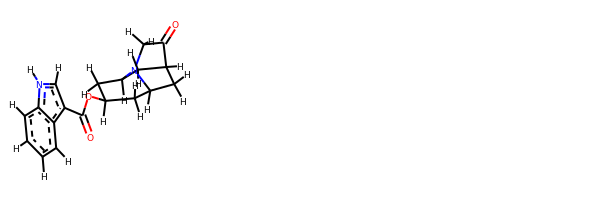

rdkit:  [H]c1c([H])c([H])c2c(c1[H])c(C(=O)OC1([H])C([H])([H])C3([H])N4C([H])([H])C(=O)C([H])(C3([H])[H])C([H])([H])C4([H])C1([H])[H])c([H])n2[H]
oechem:  c1ccc2c(c1)c(c[nH]2)C(=O)OC3CC4CC5CC(C3)N4CC5=O
###########################################################################
 #########################################################

bond
16.070346917342782 kJ/mol 44045.190163589185 kJ/mol False
angle
45.831976561519696 kJ/mol 48.115309137978045 kJ/mol False
nb
49.817019605378896 kJ/mol 49.817019605378896 kJ/mol True
torsion
11.824392123168522 kJ/mol 9.098698640855861 kJ/mol False
123.5437352074099 kJ/mol 44152.22119097339 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_644


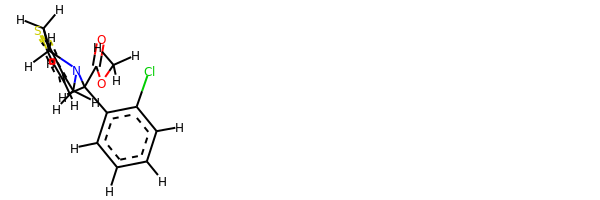

rdkit:  [H]c1sc2c(c1[H])C([H])([H])N(C([H])(C(=O)OC([H])([H])[H])c1c([H])c([H])c([H])c([H])c1Cl)C([H])([H])C2([H])[H]
oechem:  COC(=O)C(c1ccccc1Cl)N2CCc3c(ccs3)C2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
53.27790209004871 kJ/mol 57344.08147541408 kJ/mol False
angle
186.23955507023575 kJ/mol 186.23955507023575 kJ/mol True
nb
151.08034379308052 kJ/mol 151.08034379308052 kJ/mol True
torsion
79.52595545171444 kJ/mol 70.3465596258433 kJ/mol False
470.12375640507946 kJ/mol 57751.74793390324 kJ

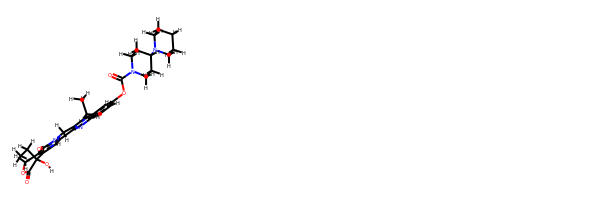

rdkit:  [H]OC1(C([H])([H])C([H])([H])[H])C(=O)OC([H])([H])c2c1c([H])c1n(c2=O)C([H])([H])c2c-1nc1c([H])c([H])c(OC(=O)N3C([H])([H])C([H])([H])C([H])(N4C([H])([H])C([H])([H])C([H])([H])C([H])([H])C4([H])[H])C([H])([H])C3([H])[H])c([H])c1c2C([H])([H])C([H])([H])[H]
oechem:  CCc1c2cc(ccc2nc-3c1Cn4c3cc5c(c4=O)COC(=O)C5(CC)O)OC(=O)N6CCC(CC6)N7CCCCC7
###########################################################################
 #########################################################

bond
8.631323564170284 kJ/mol 113394.92815780808 kJ/mol False
angle
85.5988977225964 kJ/mol 87.20859686931752 kJ/mol False
nb
-1.816271832725845 kJ/mol -1.816271832725845 kJ/mol True
torsion
2.241682590446959e-05 kJ/mol 6.400568324764113e-05 kJ/mol False
92.41397187086675 kJ/mol 113480.32054685036 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank

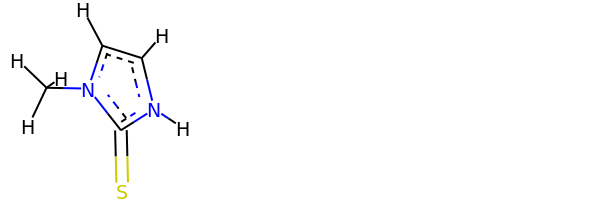

rdkit:  [H]c1c([H])n(C([H])([H])[H])c(=S)n1[H]
oechem:  Cn1cc[nH]c1=S
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #####################################

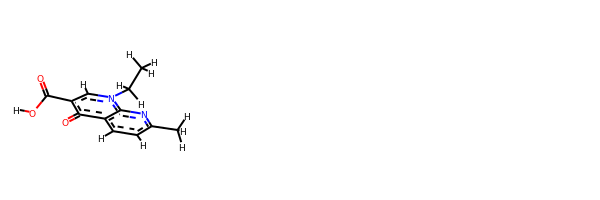

rdkit:  [H]OC(=O)c1c([H])n(C([H])([H])C([H])([H])[H])c2nc(C([H])([H])[H])c([H])c([H])c2c1=O
oechem:  CCn1cc(c(=O)c2c1nc(cc2)C)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
19.038602054640414 kJ/mol 116255.26843663654 k

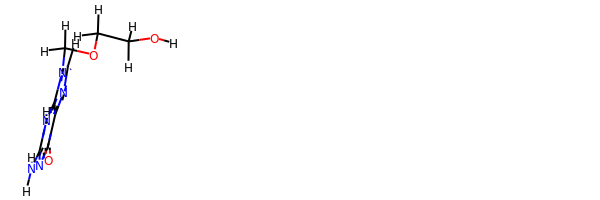

rdkit:  [H]OC([H])([H])C([H])([H])OC([H])([H])n1c([H])nc2c(=O)nc(N([H])[H])n([H])c21
oechem:  c1nc2c(n1COCCO)[nH]c(nc2=O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
24.706643438644065 kJ/mol 114538.05991601596 kJ/mol False
angle
27.765516242980304 kJ/mol 28.40242163618848 kJ/mol False
nb
18.492340781641253 kJ/mol 18.492340781641253 kJ/mol True
torsion
68.93900895759629 kJ/mol 18.731298024176304 kJ/mol False
139.9035094208619 kJ/mol 114603.68597645796 kJ/mol

------------------------------

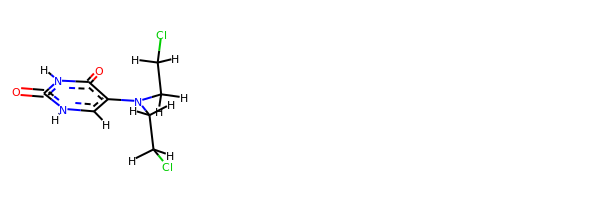

rdkit:  [H]c1c(N(C([H])([H])C([H])([H])Cl)C([H])([H])C([H])([H])Cl)c(=O)n([H])c(=O)n1[H]
oechem:  c1c(c(=O)[nH]c(=O)[nH]1)N(CCCl)CCCl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
18.457209842005547 kJ/mol 57931.984575820024 kJ/mol False
angle
176.96486374791206 kJ/mol 177.15873797989235 kJ/mol False
nb
35.611721890957625 kJ/mol 35.611721890957625 kJ/mol True

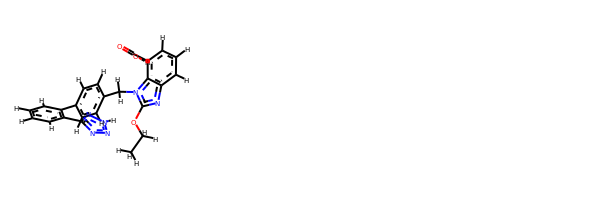

rdkit:  [H]OC(=O)c1c([H])c([H])c([H])c2nc(OC([H])([H])C([H])([H])[H])n(C([H])([H])c3c([H])c([H])c(-c4c([H])c([H])c([H])c([H])c4-c4nnn([H])n4)c([H])c3[H])c12
oechem:  CCOc1nc2cccc(c2n1Cc3ccc(cc3)c4ccccc4c5n[nH]nn5)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
53.546459741071956 kJ/mol 57208.10524956269 kJ/mol False
angle
96.45468753599918 kJ/mol 96.45468753599918 kJ/mol True
nb
67.83425433252378 kJ/mol 67.83425433252378 kJ/mol True
torsion
80.0547821776576 kJ/mol 64.07703955662069 kJ/mo

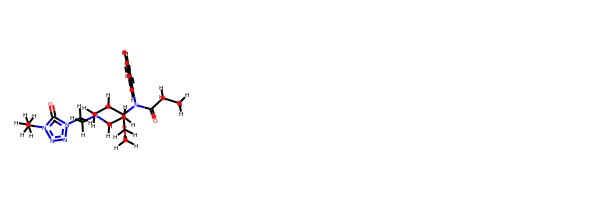

rdkit:  [H]c1c([H])c([H])c(N(C(=O)C([H])([H])C([H])([H])[H])C2(C([H])([H])OC([H])([H])[H])C([H])([H])C([H])([H])N(C([H])([H])C([H])([H])n3nnn(C([H])([H])C([H])([H])[H])c3=O)C([H])([H])C2([H])[H])c([H])c1[H]
oechem:  CCC(=O)N(c1ccccc1)C2(CCN(CC2)CCn3c(=O)n(nn3)CC)COC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
58.34612999762368 kJ/mol 169640.34258444782 kJ/mol False
angle
107.15014715281646 kJ/mol 107.15014715281646 kJ/mol True
nb
30.235444548967255 kJ/mol 30.235444548967255 kJ/mol True
torsion
8.882600699617802 kJ/mol 1.8333256853101623 kJ/mol False
204.61432239902518 kJ/mol 169779.56150183492 kJ/mol

----------------------

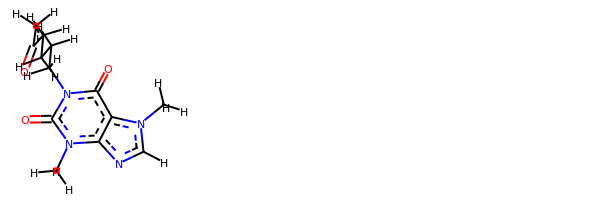

rdkit:  [H]c1nc2c(c(=O)n(C([H])([H])C([H])([H])C([H])([H])C([H])([H])C(=O)C([H])([H])[H])c(=O)n2C([H])([H])[H])n1C([H])([H])[H]
oechem:  CC(=O)CCCCn1c(=O)c2c(ncn2C)n(c1=O)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
62.44139241652449 kJ/mol 29755.491527427726 kJ/mol False
angle
400.03517186019997 kJ/mol 400.03517186019997 kJ/mol True
nb
-2.719812377184861 kJ/mol -2.719812377184861 kJ/mol True
torsion
107.89934551223791 kJ/mol 80.21977239861027 kJ/mol False
567.6560974117775 kJ/mol 30233.02665930935 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_696


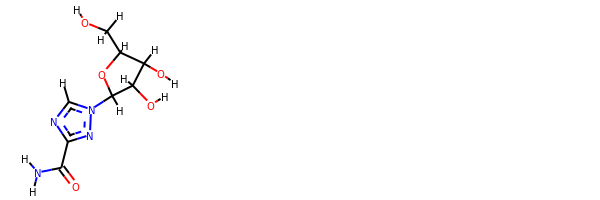

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2nc(C(=O)N([H])[H])nc2[H])C([H])(O[H])C1([H])O[H]
oechem:  c1nc(nn1C2C(C(C(O2)CO)O)O)C(=O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
26.028277781990656 kJ/mol 43696.49671478458 kJ/mol False
angle
103.51257661311199 kJ/mol 106.87032198161776 kJ/mol False
nb
22.838377995251818 kJ/mol 22.838377995251818 kJ/mol True
torsion
127.85713860966278 kJ/mol 120.23373259200537 kJ/mol False
280.23637100001724 kJ/mol 43946.439147353456 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
--------------------

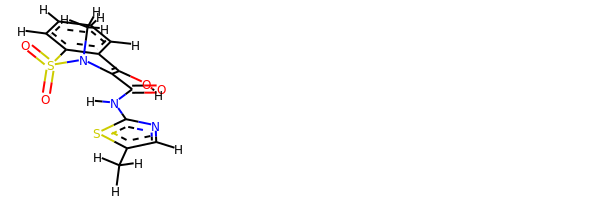

rdkit:  [H]OC1=C(C(=O)N([H])c2nc([H])c(C([H])([H])[H])s2)N(C([H])([H])[H])S(=O)(=O)c2c([H])c([H])c([H])c([H])c21
oechem:  Cc1cnc(s1)NC(=O)C2=C(c3ccccc3S(=O)(=O)N2C)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
13.774011227339276 kJ/mol 56660.32026790676 kJ/mol False
angle
33.63142696675171 kJ/mol 33.63142696675171 kJ/mol True
nb
85.00295299411775 kJ/mol 85.00295299411775 kJ/mol True
torsion
28.498199519307793 kJ/mol 23.218362416899172 kJ/mol False
160.90659070751653 kJ/mol 56802.173010284525 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_702


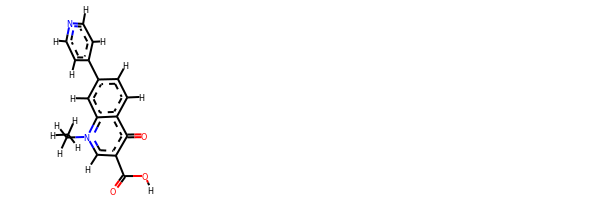

rdkit:  [H]OC(=O)c1c([H])n(C([H])([H])C([H])([H])[H])c2c([H])c(-c3c([H])c([H])nc([H])c3[H])c([H])c([H])c2c1=O
oechem:  CCn1cc(c(=O)c2c1cc(cc2)c3ccncc3)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
17.78359405209851 kJ/mol 43705.37105101175 kJ/mol False
angle
77.26617012395646 kJ/mol 81.66140305578341 kJ/mol False
nb
-1.9717655876695301 kJ/mol -1.9717655876695301 kJ/mol True
torsion
69.30332673739613 kJ/mol 69.30312349847509 kJ/mol False
162.38132532578157 kJ/mol 43854.36381197834 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_704


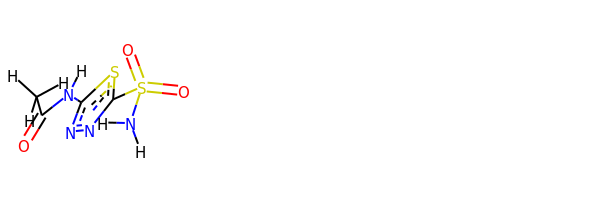

rdkit:  [H]N(C(=O)C([H])([H])[H])c1nnc(S(=O)(=O)N([H])[H])s1
oechem:  CC(=O)Nc1nnc(s1)S(=O)(=O)N
###########################################################################
 #########################################################

bond
53.105612776381555 kJ/mol 57809.95258105168 kJ/mol False
angle
255.58800136349706 kJ/mol 256.948036919603 kJ/mol False
nb
45.93399328683072 kJ/mol 45.93399328683072 kJ/mol True
torsion
98.40574064608131 kJ/mol 77.44641550403787 kJ/mol False
453.03334807279066 kJ/mol 58190.28102676215 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_705


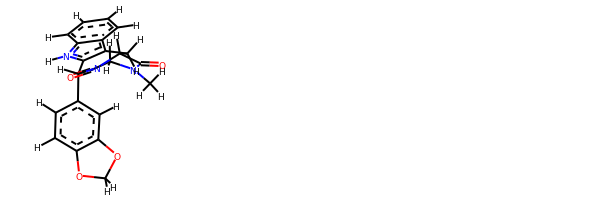

rdkit:  [H]c1c([H])c(C2([H])c3c(c4c([H])c([H])c([H])c([H])c4n3[H])C([H])([H])C3([H])C(=O)N(C([H])([H])[H])C([H])([H])C(=O)N23)c([H])c2c1OC([H])([H])O2
oechem:  CN1CC(=O)N2C(C1=O)Cc3c4ccccc4[nH]c3C2c5ccc6c(c5)OCO6
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
41.46593811613409 kJ/mol 170500.42992142218 kJ/mol False
angle
103.52378546945171 kJ/mol 106.58089639180758 kJ/mol False
nb
14.334418410893173 kJ/mol 14.334418410893173 kJ/mol True
torsion
36.33053210161754 kJ/mol 0.03799273762338611 kJ/mol False
195.6546740980965 kJ/mol 170621.3832289625 kJ/mol

-------------------------------------------------------------------
--------

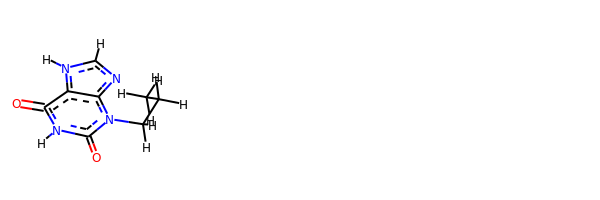

rdkit:  [H]c1nc2c(c(=O)n([H])c(=O)n2C([H])([H])C([H])([H])C([H])([H])[H])n1[H]
oechem:  CCCn1c2c(c(=O)[nH]c1=O)[nH]cn2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
37.77441349818791 kJ/mol 28279.0021082067 kJ/mol False
angle
156.35216637237934 kJ/mol 156.35216637237934 kJ/mol True
nb
32.115447957795524 kJ/mol 32.115447957795524 kJ/mol True
torsion
48.741709507080266 kJ/mol 43.511885216337525 kJ/mol False
274.98373733544304 kJ/mol 28510.981607753212 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_712


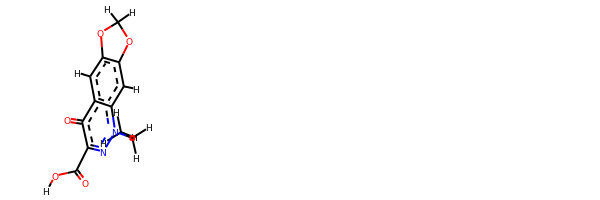

rdkit:  [H]OC(=O)c1nn(C([H])([H])C([H])([H])[H])c2c([H])c3c(c([H])c2c1=O)OC([H])([H])O3
oechem:  CCn1c2cc3c(cc2c(=O)c(n1)C(=O)O)OCO3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###################################################

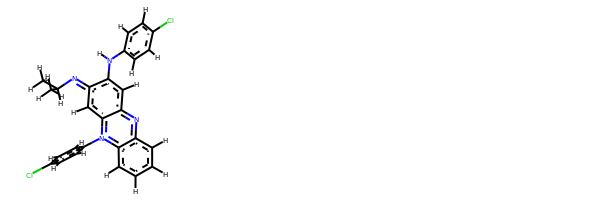

rdkit:  [H]c1c([H])c(N([H])c2c([H])c3nc4c([H])c([H])c([H])c([H])c4n(-c4c([H])c([H])c(Cl)c([H])c4[H])c-3c([H])c2=NC([H])(C([H])([H])[H])C([H])([H])[H])c([H])c([H])c1Cl
oechem:  CC(C)N=c1cc-2n(c3ccccc3nc2cc1Nc4ccc(cc4)Cl)c5ccc(cc5)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ###########

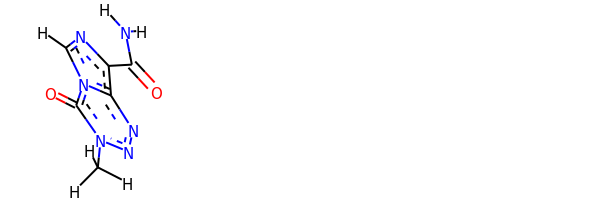

rdkit:  [H]c1nc(C(=O)N([H])[H])c2nnn(C([H])([H])[H])c(=O)n12
oechem:  Cn1c(=O)n2cnc(c2nn1)C(=O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ##########

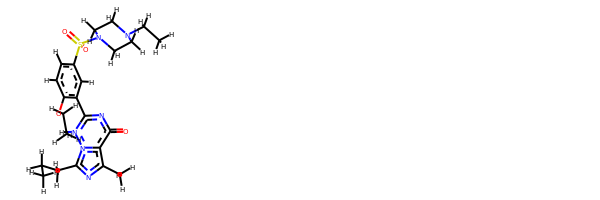

rdkit:  [H]c1c([H])c(S(=O)(=O)N2C([H])([H])C([H])([H])N(C([H])([H])C([H])([H])[H])C([H])([H])C2([H])[H])c([H])c(-c2nc(=O)c3c(C([H])([H])[H])nc(C([H])([H])C([H])([H])C([H])([H])[H])n3n2[H])c1OC([H])([H])C([H])([H])[H]
oechem:  CCCc1nc(c2n1[nH]c(nc2=O)c3cc(ccc3OCC)S(=O)(=O)N4CCN(CC4)CC)C
###########################################################################
 #########################################################

bond
29.04989270148637 kJ/mol 58394.22898682435 kJ/mol False
angle
126.2205810092958 kJ/mol 126.2205810092958 kJ/mol True
nb
1.0096355262652317 kJ/mol 1.0096355262652317 kJ/mol True
torsion
61.97027688437935 kJ/mol 61.970274892895596 kJ/mol False
218.25038612142677 kJ/mol 58583.42947825281 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_747


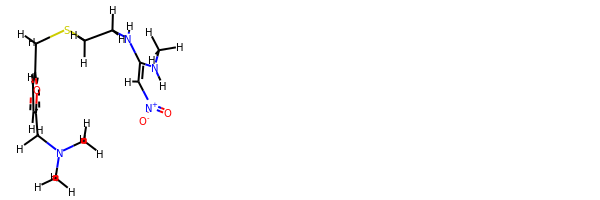

rdkit:  [H]C(=C(N([H])C([H])([H])[H])N([H])C([H])([H])C([H])([H])SC([H])([H])c1oc(C([H])([H])N(C([H])([H])[H])C([H])([H])[H])c([H])c1[H])[N+](=O)[O-]
oechem:  CNC(=C[N+](=O)[O-])NCCSCc1ccc(o1)CN(C)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
16.68059676047497 kJ/mol 44116.01084141032 kJ/mol False
angle
118.63300925273627 kJ/mol 120.96431656279474 kJ/mol Fa

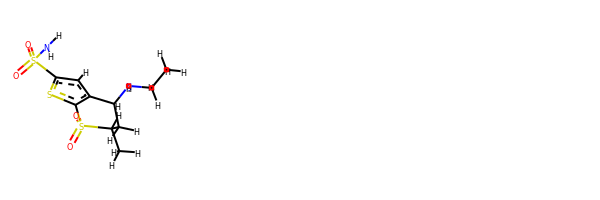

rdkit:  [H]c1c(S(=O)(=O)N([H])[H])sc2c1C([H])(N([H])C([H])([H])C([H])([H])[H])C([H])([H])C([H])(C([H])([H])[H])S2(=O)=O
oechem:  CCNC1CC(S(=O)(=O)c2c1cc(s2)S(=O)(=O)N)C
###########################################################################
 #########################################################

bond
42.95626495561727 kJ/mol 58027.43867853004 kJ/mol False
angle
131.9361681975661 kJ/mol 133.8134017342939 kJ/mol False
nb
92.89597129794937 kJ/mol 92.89597129794937 kJ/mol True
torsion
51.81642710906615 kJ/mol 50.70835319848369 kJ/mol False
319.60483156019893 kJ/mol 58304.856404760765 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_756


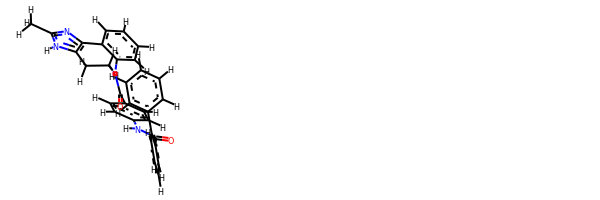

rdkit:  [H]c1c([H])c([H])c(-c2c([H])c([H])c([H])c([H])c2C(=O)N([H])c2c([H])c([H])c(C(=O)N3c4c([H])c([H])c([H])c([H])c4-c4nc(C([H])([H])[H])n([H])c4C([H])([H])C3([H])[H])c([H])c2[H])c([H])c1[H]
oechem:  Cc1[nH]c2c(n1)-c3ccccc3N(CC2)C(=O)c4ccc(cc4)NC(=O)c5ccccc5c6ccccc6
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
21.56341548857282 kJ/mol 101831.33400485793 kJ/mol False
angle
152.60301381200037 kJ/mol 154.7554058730845 kJ/mol False
nb
32.827582119633384 kJ/mol 32.827582119633384 kJ/mol True
torsion
88.27783963862099 kJ/mol 61.88426316607863 kJ/mol False
295.27185105882756 kJ/mol 102080.80125601673 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
---------------------

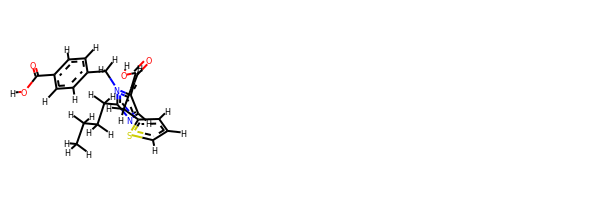

rdkit:  [H]OC(=O)C(=C([H])c1c([H])nc(C([H])([H])C([H])([H])C([H])([H])C([H])([H])[H])n1C([H])([H])c1c([H])c([H])c(C(=O)O[H])c([H])c1[H])C([H])([H])c1sc([H])c([H])c1[H]
oechem:  CCCCc1ncc(n1Cc2ccc(cc2)C(=O)O)C=C(Cc3cccs3)C(=O)O
###########################################################################
 #########################################################

bond
27.679902349010515 kJ/mol 56922.71259091364 kJ/mol False
angle
248.84623239795707 kJ/mol 248.84623239795707 kJ/mol True
nb
24.852035326477516 kJ/mol 24.852035326477516 kJ/mol True
torsion
66.23950080975511 kJ/mol 25.911634997945036 kJ/mol False
367.61767088320016 kJ/mol 57222.32249363601 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_763


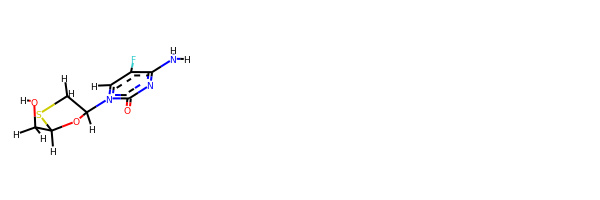

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])c(F)c(N([H])[H])nc2=O)C([H])([H])S1
oechem:  c1c(c(nc(=O)n1C2CSC(O2)CO)N)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
36.13741485535509 kJ/mol 84967.35982532354 kJ/mol False
an

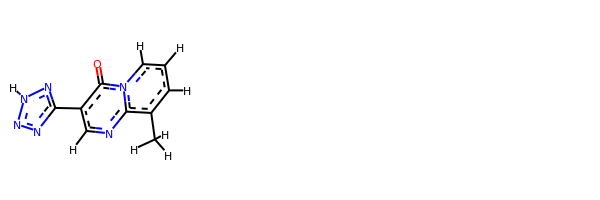

rdkit:  [H]c1nc2c(C([H])([H])[H])c([H])c([H])c([H])n2c(=O)c1-c1nnn([H])n1
oechem:  Cc1cccn2c1ncc(c2=O)c3n[nH]nn3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
18.083205577418045 kJ/mol 28979.824170139753 kJ/mol False
angle
123.45480949619292 kJ/mol 123.45480949619292 kJ/mol True
nb
51.22455887192063 kJ/mol 51.22455887192063 kJ/mol True
torsion
73.53950881995601 kJ/mol 68.30952686298897 kJ/mol False
266.3020827654876 kJ/mol 29222.813065370854 kJ/mol

-------------------------------------------

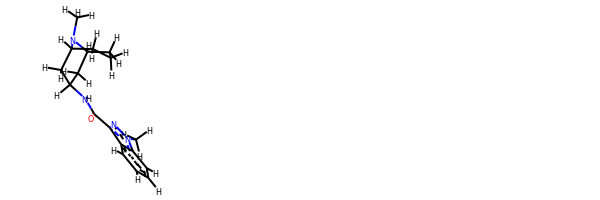

rdkit:  [H]c1c([H])c([H])c2c(c(C(=O)N([H])C3([H])C([H])([H])C4([H])N(C([H])([H])[H])C([H])(C([H])([H])C([H])([H])C4([H])[H])C3([H])[H])nn2C([H])([H])[H])c1[H]
oechem:  Cn1c2ccccc2c(n1)C(=O)NC3CC4CCCC(C3)N4C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ####################################

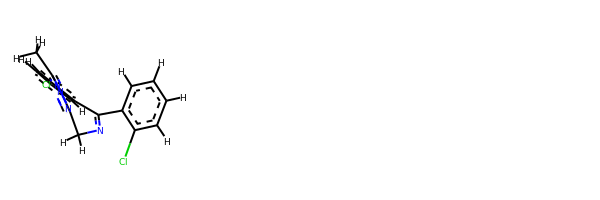

rdkit:  [H]c1c([H])c([H])c(C2=NC([H])([H])c3nnc(C([H])([H])[H])n3-c3c([H])c([H])c(Cl)c([H])c32)c(Cl)c1[H]
oechem:  Cc1nnc2n1-c3ccc(cc3C(=NC2)c4ccccc4Cl)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
23.294204047187293 kJ/mol 116507.81803543698 kJ/mol False
angle
392.1472907950371 kJ/mol 392.59711892008073 kJ/mol False
nb
10.627984521474888 kJ/mol 10.627984521474888 kJ/mol True
torsion
65.0208861721328 kJ/mol 41.05505548300772 kJ/mol False
491.0903655358321 kJ/mol 116952.09819436155 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------


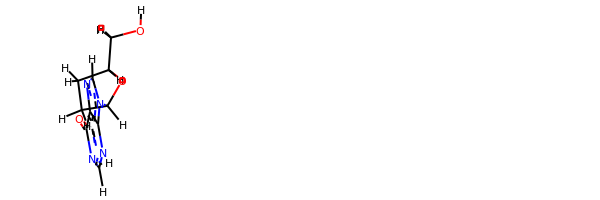

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])nc3c(=O)nc([H])n([H])c32)C([H])([H])C1([H])[H]
oechem:  c1[nH]c2c(c(=O)n1)ncn2C3CCC(O3)CO
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
22.561600066581487 kJ/mol 87593.59418215083 kJ/mol False
angle
91.96990909538019 kJ/mol 96.27684151213367 kJ/mol False
nb
2.292742250140026 kJ/mol 2.292742250140026 kJ/mol True
torsion
55.57315351921962 kJ/mol 55.57320530774453 kJ/mol False
172.39740493132135 kJ/mol 87747.73697122086 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
----------------------

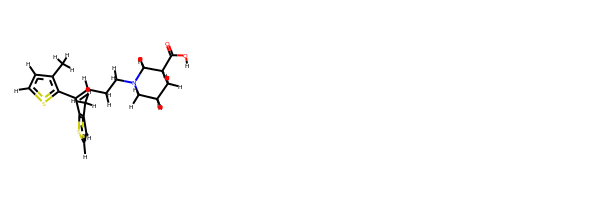

rdkit:  [H]OC(=O)C1([H])C([H])([H])N(C([H])([H])C([H])([H])C([H])=C(c2sc([H])c([H])c2C([H])([H])[H])c2sc([H])c([H])c2C([H])([H])[H])C([H])([H])C([H])([H])C1([H])[H]
oechem:  Cc1ccsc1C(=CCCN2CCCC(C2)C(=O)O)c3c(ccs3)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
13.85644947199658 kJ/mol 57653.6759189564 kJ/mol False
angle
114.85896313980167 kJ/mol 114.85896313980167 kJ/mol True
nb
6.353212924368398 kJ/mol 6.353212924368398 kJ/mol True
torsion
19.774266175964527 kJ/mol 19.774304397385116 kJ/mol False
154.84289171213118 kJ/mol 57794.66239941795 kJ/mol

-------------------------------------------------------------------
---------

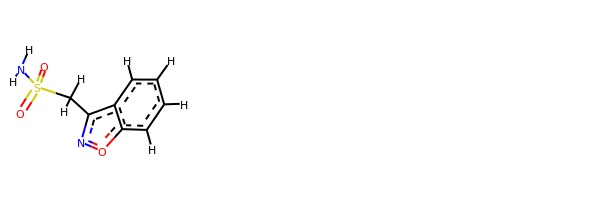

rdkit:  [H]c1c([H])c([H])c2c(C([H])([H])S(=O)(=O)N([H])[H])noc2c1[H]
oechem:  c1ccc2c(c1)c(no2)CS(=O)(=O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
11.513302630124542 kJ/mol 58033.24304011248 kJ/mol False
angle
107.21123378639085 kJ/mol 107.21123378639085 kJ/mol True
nb
23.276326068812097 kJ/mol 23.276326068812097 kJ/mol True
torsion
9.205864653689297 kJ/mol 6.411297957919897 kJ/mol False
151.20672713901678 kJ/mol 58170.141897925605 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_794


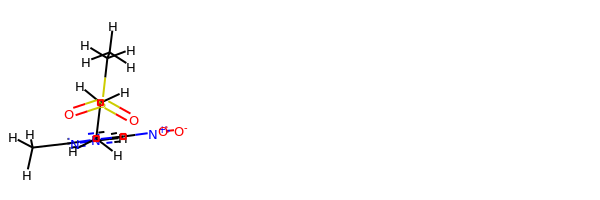

rdkit:  [H]c1nc(C([H])([H])[H])n(C([H])([H])C([H])([H])S(=O)(=O)C([H])([H])C([H])([H])[H])c1[N+](=O)[O-]
oechem:  CCS(=O)(=O)CCn1c(ncc1[N+](=O)[O-])C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
10.894728823132198 kJ/mol 58031.15239486581 kJ/mol False
angle
90.63499415534541 kJ/mol 90.63499415534541 kJ/mol True
nb
37.661002159345735 kJ/mol 37.661002159345735 kJ/mol True
torsion
4.278463869136803 kJ/mol 1.5595759242733094 kJ/mol False
143.46918900696014 kJ/mol 58161.00796710477 kJ/mol

------

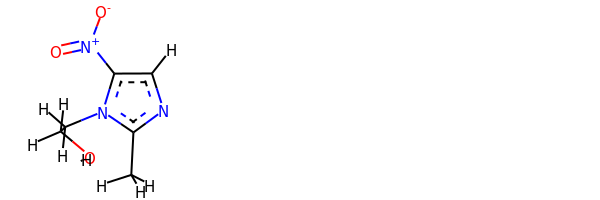

rdkit:  [H]OC([H])([H])C([H])([H])n1c(C([H])([H])[H])nc([H])c1[N+](=O)[O-]
oechem:  Cc1ncc(n1CCO)[N+](=O)[O-]
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
10.977681851474062 kJ/mol 57763.52455124513 kJ/mol False
angle
404.73378442320274 kJ/mol 405.96335752224235 kJ/mol False
nb
13.43801310844111 kJ/mol 13.43801310844111 kJ/mol True
torsion
86.08167918325836 kJ/mol 86.08169860680157 kJ/mol False
515.2311585663763 kJ/mol 58269.00762048261 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_801


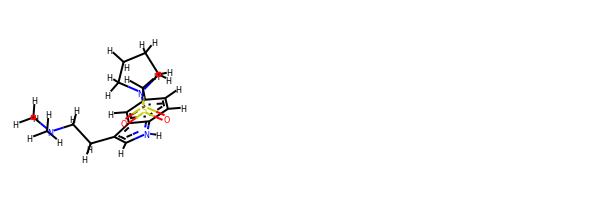

rdkit:  [H]c1c(C([H])([H])S(=O)(=O)N2C([H])([H])C([H])([H])C([H])([H])C2([H])[H])c([H])c2c(C([H])([H])C([H])([H])N(C([H])([H])[H])C([H])([H])[H])c([H])n([H])c2c1[H]
oechem:  CN(C)CCc1c[nH]c2c1cc(cc2)CS(=O)(=O)N3CCCC3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
12.39383853935186 kJ/mol 43834.023775032896 kJ/mol False
angle
54.20110116638713 kJ/mol 56.043053809190766 kJ/mol False
nb
128.74629022690044 kJ/mol 128.74629022690044 kJ/mol True
torsion
31.48520500474946 kJ/mol 30.604976077314834 kJ/mol False
226.8264349373889 kJ/mol 44049.418095146306 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugB

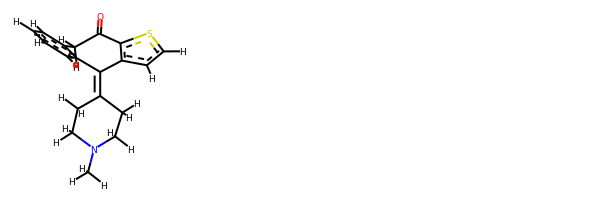

rdkit:  [H]c1sc2c(c1[H])C(=C1C([H])([H])C([H])([H])N(C([H])([H])[H])C([H])([H])C1([H])[H])c1c([H])c([H])c([H])c([H])c1C([H])([H])C2=O
oechem:  CN1CCC(=C2c3ccccc3CC(=O)c4c2ccs4)CC1
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
24.952584587141068 kJ/mol 29220.511827309583 kJ/mol False
angle
437.0125874601073 kJ/mol 437.0125874601073 kJ/mol True
nb
17.142694601508726 kJ/mol 17.142694601508726 kJ/mol True
torsion
118.15284519894554 kJ/mol 102.06927941445223 kJ/mol False
597.2607118477026 kJ/mol 29776.73638878565 kJ/mol

-------------------------------------------------------------------
-------------------------------------------

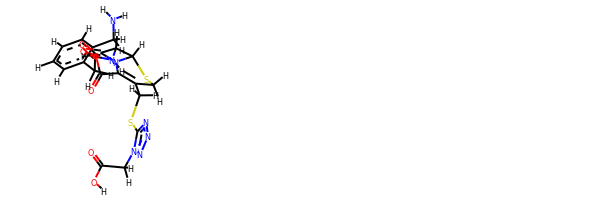

rdkit:  [H]OC(=O)C1=C(C([H])([H])Sc2nnnn2C([H])([H])C(=O)O[H])C([H])([H])SC2([H])N1C(=O)C2([H])N([H])C(=O)C([H])([H])c1c([H])c([H])c([H])c([H])c1C([H])([H])N([H])[H]
oechem:  c1ccc(c(c1)CC(=O)NC2C3N(C2=O)C(=C(CS3)CSc4nnnn4CC(=O)O)C(=O)O)CN
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
17.545718964416643 kJ/mol 43688.560389691804 kJ/mol False
angle
78.89639223424302 kJ/mol 82.25289641511134 kJ/mol False
nb
9.479665777594189 kJ/mol 9.479665777594189 kJ/mol True
torsion
207.2524003240246 kJ/mol 210.3936802623829 kJ/mol False
313.1741773002784 kJ/mol 43990.68663214689 kJ/mol

------------------------------------------------------

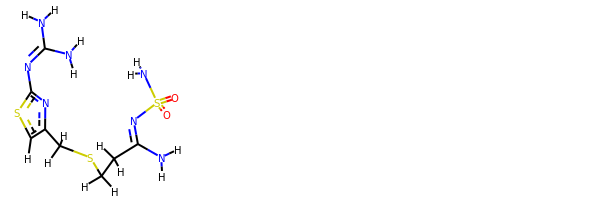

rdkit:  [H]c1sc(N=C(N([H])[H])N([H])[H])nc1C([H])([H])SC([H])([H])C([H])([H])C(=NS(=O)(=O)N([H])[H])N([H])[H]
oechem:  c1c(nc(s1)N=C(N)N)CSCCC(=NS(=O)(=O)N)N
###########################################################################
 #########################################################

bond
28.05734383669449 kJ/mol 56982.91157749032 kJ/mol False
angle
311.25031775203666 kJ/mol 311.25031775203666 kJ/mol True
nb
29.46910789954417 kJ/mol 29.46910789954417 kJ/mol True
torsion
106.15735400406949 kJ/mol 62.615724631637 kJ/mol False
474.9341234923448 kJ/mol 57386.246727773534 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_811


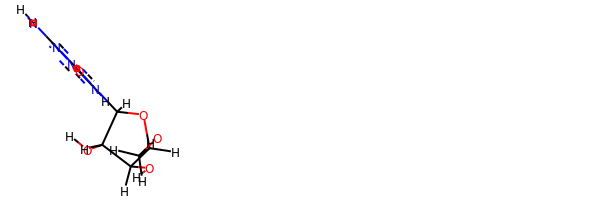

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])nc(N([H])[H])nc2=O)C([H])(O[H])C1([H])O[H]
oechem:  c1nc(nc(=O)n1C2C(C(C(O2)CO)O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

#####################################################

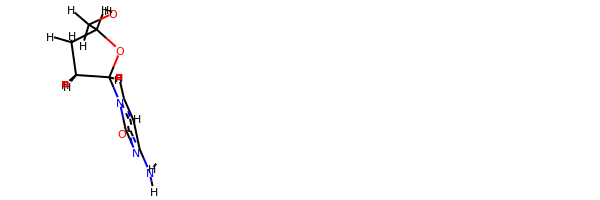

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])c([H])c(N([H])[H])nc2=O)C([H])([H])C1([H])[H]
oechem:  c1cn(c(=O)nc1N)C2CCC(O2)CO
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
8.012504390513723 kJ/mol 57760.33884939263 kJ/mol F

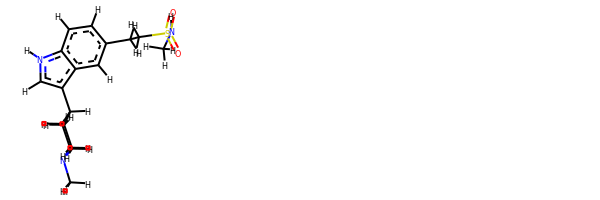

rdkit:  [H]c1c(C([H])([H])C([H])([H])S(=O)(=O)N([H])C([H])([H])[H])c([H])c2c(C3([H])C([H])([H])C([H])([H])N(C([H])([H])[H])C([H])([H])C3([H])[H])c([H])n([H])c2c1[H]
oechem:  CNS(=O)(=O)CCc1ccc2c(c1)c(c[nH]2)C3CCN(CC3)C
###########################################################################
 #########################################################

bond
13.586428017039134 kJ/mol 86924.42414395929 kJ/mol False
angle
170.49219737150173 kJ/mol 171.72214227055318 kJ/mol False
nb
11.088619159422892 kJ/mol 11.088619159422892 kJ/mol True
torsion
23.37384932104228 kJ/mol 8.670836018168622 kJ/mol False
218.54109386900606 kJ/mol 87115.90574140742 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_835


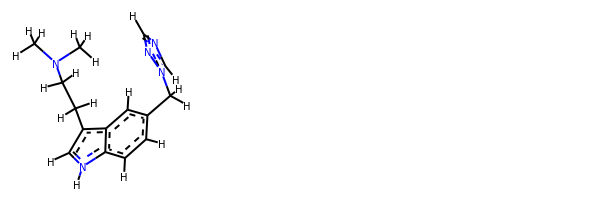

rdkit:  [H]c1nc([H])n(C([H])([H])c2c([H])c([H])c3c(c2[H])c(C([H])([H])C([H])([H])N(C([H])([H])[H])C([H])([H])[H])c([H])n3[H])n1
oechem:  CN(C)CCc1c[nH]c2c1cc(cc2)Cn3cncn3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
45.82592799525656 kJ/mol 56539.21135148949 kJ/mol False
angle
98.82440632157676 kJ/mol 98.82440632157676 kJ/mol True
nb
28.000257715584617 kJ/mol 28.000257715584617 kJ/mol True
torsion
45.50012147131964 kJ/mol 40.28073972650701 kJ/mol False
218.15071350373756 kJ/mol 56706.3167552

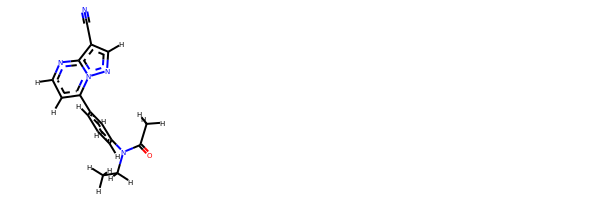

rdkit:  [H]c1nc2c(C#N)c([H])nn2c(-c2c([H])c([H])c([H])c(N(C(=O)C([H])([H])[H])C([H])([H])C([H])([H])[H])c2[H])c1[H]
oechem:  CCN(c1cccc(c1)c2ccnc3n2ncc3C#N)C(=O)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
11.306689389873249 kJ/mol 115841.91222141874 kJ/mol False
angle
174.69323607232948 kJ/mol 174.69323607232948 kJ/mol True
nb
39.327437902942506 kJ/mol 39.327437902942506 kJ/mol True
torsion
70.10159049850245 kJ/mol 58.9311726956468 kJ/mol False
295.4289538636477 kJ/mol 116114.86406808966 kJ/mol

-------------------------------------------------------------------
------------------------------------------------------------

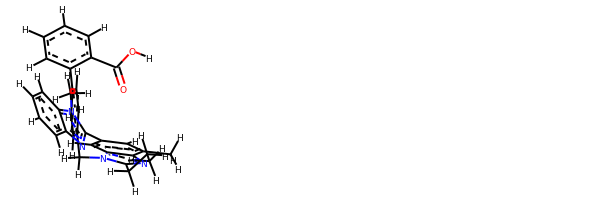

rdkit:  [H]OC(=O)c1c([H])c([H])c([H])c([H])c1-c1c([H])c([H])c(C([H])([H])n2c(C([H])([H])C([H])([H])C([H])([H])[H])nc3c(C([H])([H])[H])c([H])c(-c4nc5c([H])c([H])c([H])c([H])c5n4C([H])([H])[H])c([H])c32)c([H])c1[H]
oechem:  CCCc1nc2c(cc(cc2n1Cc3ccc(cc3)c4ccccc4C(=O)O)c5nc6ccccc6n5C)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
25.52694009607334 kJ/mol 115895.74481432872 kJ/mol False
angle
202.05129254079193 kJ/mol 204.06222442142493 kJ/mol False
nb
14.865870833118176 kJ/mol 14.865870833118176 kJ/mol True
torsion
23.745368027404993 kJ/mol 22.358225945510995 kJ/mol False
266.1894714973884 kJ/mol 116137.03113552878 kJ/mol

-----

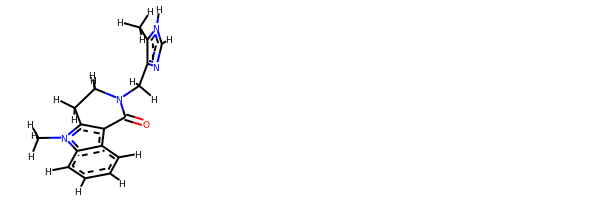

rdkit:  [H]c1c([H])c([H])c2c(c1[H])c1c(n2C([H])([H])[H])C([H])([H])C([H])([H])N(C([H])([H])c2nc([H])n([H])c2C([H])([H])[H])C1=O
oechem:  Cc1c(nc[nH]1)CN2CCc3c(c4ccccc4n3C)C2=O
###########################################################################
 #########################################################

bond
126.56401722883199 kJ/mol 57610.17989683449 kJ/mol False
angle
678.3264791227286 kJ/mol 678.3264791227286 kJ/mol True
nb
153.61528235468046 kJ/mol 153.61528235468046 kJ/mol True
torsion
395.0015413039849 kJ/mol 377.6458566534641 kJ/mol False
1353.5073200102258 kJ/mol 58819.76751496536 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_851


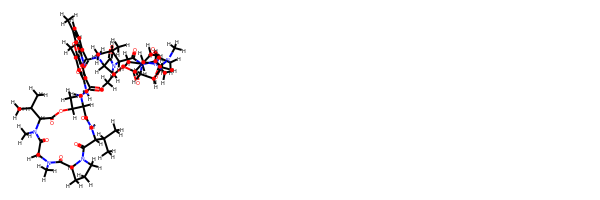

rdkit:  [H]c1c([H])c(C([H])([H])[H])c2oc3c(C([H])([H])[H])c(=O)c(N([H])[H])c(C(=O)N([H])C4([H])C(=O)N([H])C([H])(C([H])(C([H])([H])[H])C([H])([H])[H])C(=O)N5C([H])([H])C([H])([H])C([H])([H])C5([H])C(=O)N(C([H])([H])[H])C([H])([H])C(=O)N(C([H])([H])[H])C([H])(C([H])(C([H])([H])[H])C([H])([H])[H])C(=O)OC4([H])C([H])([H])[H])c-3nc2c1C(=O)N([H])C1([H])C(=O)N([H])C([H])(C([H])(C([H])([H])[H])C([H])([H])[H])C(=O)N2C([H])([H])C([H])([H])C([H])([H])C2([H])C(=O)N(C([H])([H])[H])C([H])([H])C(=O)N(C([H])([H])[H])C([H])(C([H])(C([H])([H])[H])C([H])([H])[H])C(=O)OC1([H])C([H])([H])[H]
oechem:  Cc1ccc(c2c1oc-3c(c(=O)c(c(c3n2)C(=O)NC4C(OC(=O)C(N(C(=O)CN(C(=O)C5CCCN5C(=O)C(NC4=O)C(C)C)C)C)C(C)C)C)N)C)C(=O)NC6C(OC(=O)C(N(C(=O)CN(C(=O)C7CCCN7C(=O)C(NC6=O)C(C)C)C)C)C(C)C)C
###########################################################################
 #########################################################

###########################################################################
 ######################

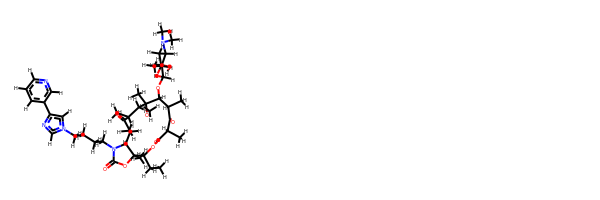

rdkit:  [H]OC1([H])C([H])(OC2([H])C([H])(C([H])([H])[H])C(=O)C([H])(C([H])([H])[H])C(=O)OC([H])(C([H])([H])C([H])([H])[H])C3(C([H])([H])[H])OC(=O)N(C([H])([H])C([H])([H])C([H])([H])C([H])([H])n4c([H])nc(-c5c([H])nc([H])c([H])c5[H])c4[H])C3([H])C([H])(C([H])([H])[H])C(=O)C([H])(C([H])([H])[H])C([H])([H])C2(OC([H])([H])[H])C([H])([H])[H])OC([H])(C([H])([H])[H])C([H])([H])C1([H])N(C([H])([H])[H])C([H])([H])[H]
oechem:  CCC1C2(C(C(C(=O)C(CC(C(C(C(=O)C(C(=O)O1)C)C)OC3C(C(CC(O3)C)N(C)C)O)(C)OC)C)C)N(C(=O)O2)CCCCn4cc(nc4)c5cccnc5)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

#############################################################

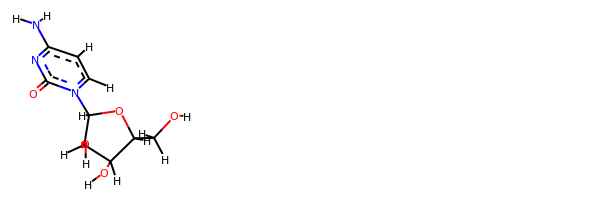

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])c([H])c(N([H])[H])nc2=O)C([H])(O[H])C1([H])O[H]
oechem:  c1cn(c(=O)nc1N)C2C(C(C(O2)CO)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
13.07477424968208 kJ/mol 58261.498781272836 kJ/mol False
angle
113.30280459108158 kJ/mol 113.30280459108158 kJ/mol True
nb
20.41088042379594 kJ/mol 20.41088042379594 kJ/mol True
torsion
31.542560105311736 kJ/mol 31.542422377239397 kJ/mol False
178.3310193698713 kJ/mol 58426.75488866496 kJ/mol

--------------------

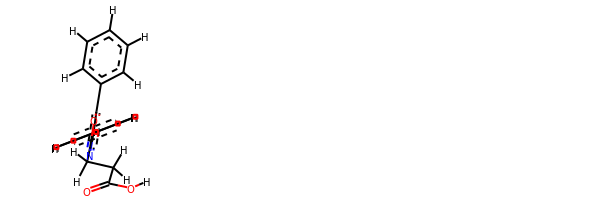

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])c1nc(-c2c([H])c([H])c([H])c([H])c2[H])c(-c2c([H])c([H])c([H])c([H])c2[H])o1
oechem:  c1ccc(cc1)c2c(oc(n2)CCC(=O)O)c3ccccc3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
16.69765814709402 kJ/mol 116014.1243442781 kJ/mol False
angle
187.07079050830794 kJ/mol 189.09708393461338 kJ/mol False
nb
15.312738417065852 kJ/mol 15.312738417065852 kJ/mol True
torsion
5.573272710082825 kJ/mol 5.573406985226377 kJ/mol False
224.65445978255062 kJ/mol 116224.10757361501 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_874


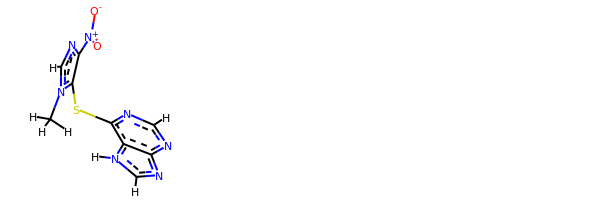

rdkit:  [H]c1nc(Sc2c([N+](=O)[O-])nc([H])n2C([H])([H])[H])c2c(n1)nc([H])n2[H]
oechem:  Cn1cnc(c1Sc2c3c(nc[nH]3)ncn2)[N+](=O)[O-]
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
15.142355577030825 kJ/mol 57809.03298817953 kJ/mol False
angle
107.81569138493919 kJ/mol 109.17176821107273 kJ/mol False
nb
32.082430850763124 kJ/mol 32.082430850763124 kJ/mol True
torsion
32.04468022615196 kJ/mol 30.811609342610108 kJ/mol False
187.0851580388851 kJ/mol 57981.09879658398 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------

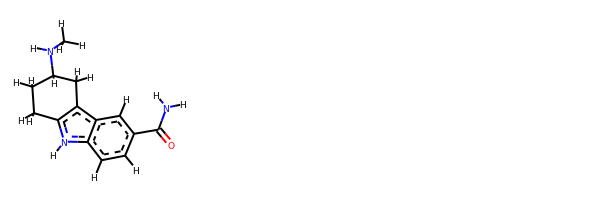

rdkit:  [H]c1c(C(=O)N([H])[H])c([H])c2c3c(n([H])c2c1[H])C([H])([H])C([H])([H])C([H])(N([H])C([H])([H])[H])C3([H])[H]
oechem:  CNC1CCc2c(c3cc(ccc3[nH]2)C(=O)N)C1
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
43.47117948995173 kJ/mol 115382.3741467859 kJ/mol False
angle
53.769979786477144 kJ/mol 53.769979786477144 kJ/mol True
nb
81.58047458226669 kJ/mol 81.58047458226669 kJ/mol True
torsion
98.03857203340075 kJ/mol 93.01781674458206 kJ/mol False
276.8602058920963 kJ/mol 115610.74241789924 kJ/mo

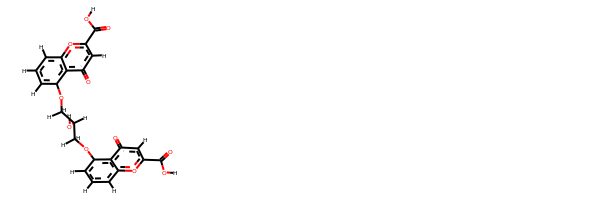

rdkit:  [H]OC(=O)c1oc2c([H])c([H])c([H])c(OC([H])([H])C([H])(O[H])C([H])([H])Oc3c([H])c([H])c([H])c4oc(C(=O)O[H])c([H])c(=O)c34)c2c(=O)c1[H]
oechem:  c1cc2c(c(c1)OCC(COc3cccc4c3c(=O)cc(o4)C(=O)O)O)c(=O)cc(o2)C(=O)O
###########################################################################
 #########################################################

bond
29.213447815835654 kJ/mol 114155.39569217846 kJ/mol False
angle
119.35729977407433 kJ/mol 119.70940148943843 kJ/mol False
nb
18.182308553834314 kJ/mol 18.182308553834314 kJ/mol True
torsion
74.94725348936886 kJ/mol 20.552334029315453 kJ/mol False
241.70030963311316 kJ/mol 114313.83973625104 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_885


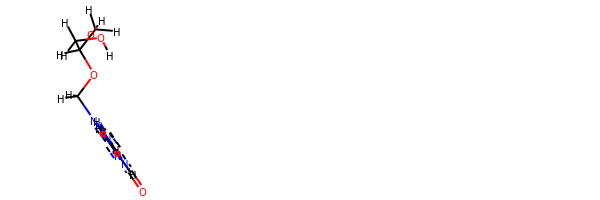

rdkit:  [H]OC([H])([H])C([H])(OC([H])([H])n1c([H])nc2c(=O)n([H])c(N([H])[H])nc21)C([H])([H])O[H]
oechem:  c1nc2c(=O)[nH]c(nc2n1COC(CO)CO)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
12.258574182728541 kJ/mol 29170.06386122357 kJ/mol False
angle
97.97417376659105 kJ/mol 97.97417376659105 kJ/mol True
nb
23.624628300739513 kJ/mol 23.624628300739513 kJ/mol True
torsion
19.05173051271205 kJ/mol 0.004896311140122524 kJ/mol False
152.90910676277116 kJ/mol 29291.66755960204 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_887


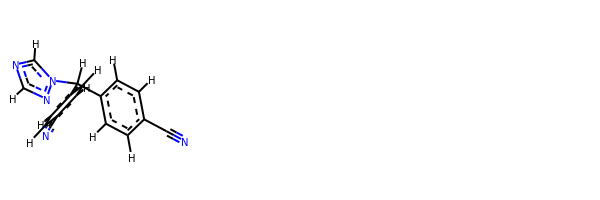

rdkit:  [H]c1nc([H])n(C([H])(c2c([H])c([H])c(C#N)c([H])c2[H])c2c([H])c([H])c(C#N)c([H])c2[H])n1
oechem:  c1cc(ccc1C#N)C(c2ccc(cc2)C#N)n3cncn3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

##########################################

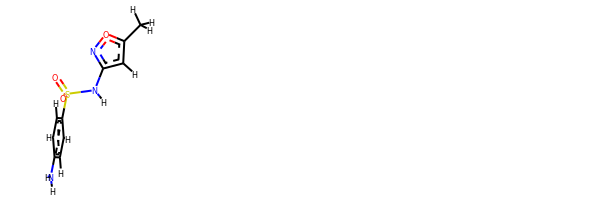

rdkit:  [H]c1c(N([H])S(=O)(=O)c2c([H])c([H])c(N([H])[H])c([H])c2[H])noc1C([H])([H])[H]
oechem:  Cc1cc(no1)NS(=O)(=O)c2ccc(cc2)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
19.72412952354821 kJ/mol 57700.4392767269 kJ/mol Fa

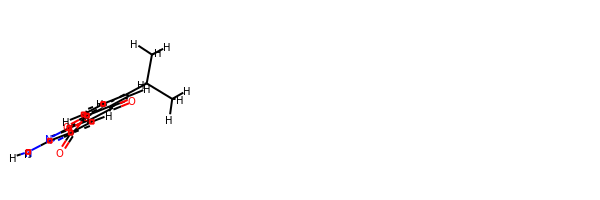

rdkit:  [H]OC(=O)c1c(N([H])[H])nc2oc3c([H])c([H])c(C([H])(C([H])([H])[H])C([H])([H])[H])c([H])c3c(=O)c2c1[H]
oechem:  CC(C)c1ccc2c(c1)c(=O)c3cc(c(nc3o2)N)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
12.93816608325309 kJ/mol 9.002493162091984 kJ/mol False
angle
434.73807507075264 kJ/mol 434.93244729345645 kJ/mol False
nb
24.55630053326614 kJ/mol 24.55630053326614 kJ/mol True
torsion
109.39048569353004 kJ/mol 108.33534541559486 kJ/mol False
581.6230273808019 kJ/mol 576.8265864044095 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_909


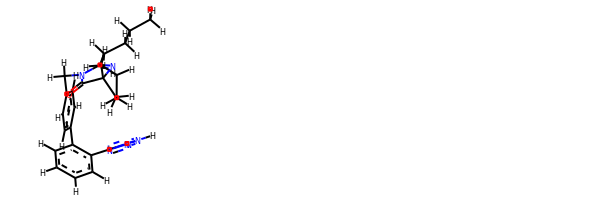

rdkit:  [H]c1c([H])c([H])c(-c2c([H])c([H])c(C([H])([H])N3C(=O)C4(N=C3C([H])([H])C([H])([H])C([H])([H])C([H])([H])[H])C([H])([H])C([H])([H])C([H])([H])C4([H])[H])c([H])c2[H])c(-c2nnn([H])n2)c1[H]
oechem:  CCCCC1=NC2(CCCC2)C(=O)N1Cc3ccc(cc3)c4ccccc4c5n[nH]nn5
###########################################################################
 #########################################################

bond
28.919855521525708 kJ/mol 57320.81426225702 kJ/mol False
angle
169.77740865848284 kJ/mol 169.77740865848284 kJ/mol True
nb
81.08480453859625 kJ/mol 81.08480453859625 kJ/mol True
torsion
36.06989533560141 kJ/mol 26.890522230518492 kJ/mol False
315.8519640542062 kJ/mol 57598.56699768462 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_910


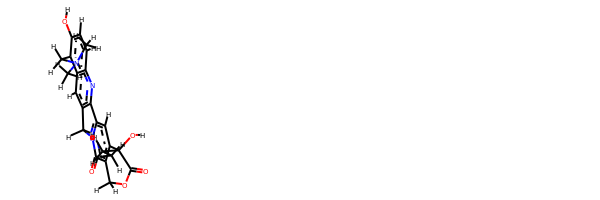

rdkit:  [H]Oc1c([H])c([H])c2nc3c(c([H])c2c1C([H])([H])N(C([H])([H])[H])C([H])([H])[H])C([H])([H])n1c-3c([H])c2c(c1=O)C([H])([H])OC(=O)C2(O[H])C([H])([H])C([H])([H])[H]
oechem:  CCC1(c2cc-3n(c(=O)c2COC1=O)Cc4c3nc5ccc(c(c5c4)CN(C)C)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
7.96755501141249 kJ/mol 116002.70589506431 kJ/mol False
angle
102.2288124137463 kJ/mol 104.76861790587492 kJ/mol False
nb
18.31304804651347 kJ/mol 18.31304804651347 kJ/mol True
torsion
0.0002170321582399491 kJ/mol 0.00047827346570409674 kJ/mol False
128.5096325038305 kJ/mol 116125.78803929017 kJ/mol

---------------------------------------------------

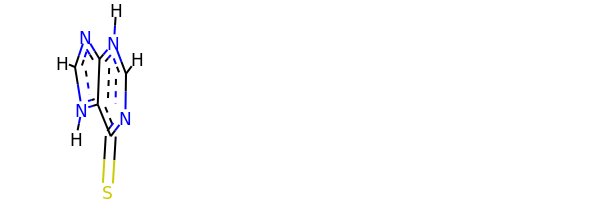

rdkit:  [H]c1nc(=S)c2c(nc([H])n2[H])n1[H]
oechem:  c1[nH]c2c(n1)[nH]cnc2=S
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ################################

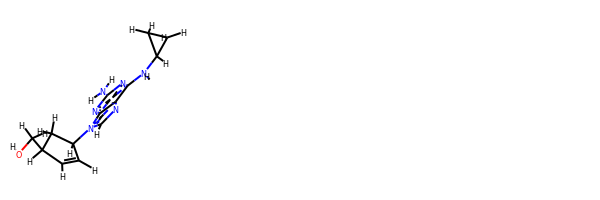

rdkit:  [H]OC([H])([H])C1([H])C([H])=C([H])C([H])(n2c([H])nc3c(N([H])C4([H])C([H])([H])C4([H])[H])nc(N([H])[H])nc32)C1([H])[H]
oechem:  c1nc2c(nc(nc2n1C3CC(C=C3)CO)N)NC4CC4
###########################################################################
 #########################################################

bond
44.14759372638492 kJ/mol 57523.02082018092 kJ/mol False
angle
596.3889907400928 kJ/mol 597.5957504234168 kJ/mol False
nb
53.49389157098143 kJ/mol 53.49389157098143 kJ/mol True
torsion
151.97672919167624 kJ/mol 151.97918164565485 kJ/mol False
846.0072052291354 kJ/mol 58326.089643820975 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_929


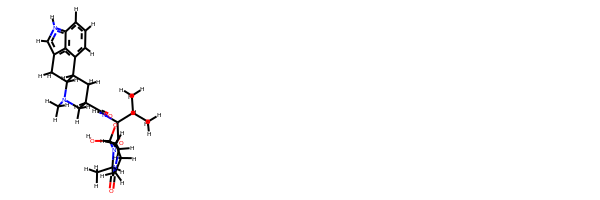

rdkit:  [H]OC12OC(N([H])C(=O)C3([H])C([H])([H])N(C([H])([H])[H])C4([H])C([H])([H])c5c([H])n([H])c6c([H])c([H])c([H])c(c56)C4([H])C3([H])[H])(C([H])(C([H])([H])[H])C([H])([H])[H])C(=O)N1C([H])(C([H])([H])[H])C(=O)N1C([H])([H])C([H])([H])C([H])([H])C12[H]
oechem:  CC1C(=O)N2CCCC2C3(N1C(=O)C(O3)(C(C)C)NC(=O)C4CC5c6cccc7c6c(c[nH]7)CC5N(C4)C)O
###########################################################################
 #########################################################

bond
70.68032338827629 kJ/mol 56751.971091980326 kJ/mol False
angle
64.81388984859332 kJ/mol 64.81388984859332 kJ/mol True
nb
110.01210873050907 kJ/mol 110.01210873050907 kJ/mol True
torsion
155.22909777966046 kJ/mol 155.4070750560898 kJ/mol False
400.7354197470391 kJ/mol 57082.20416561552 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_931


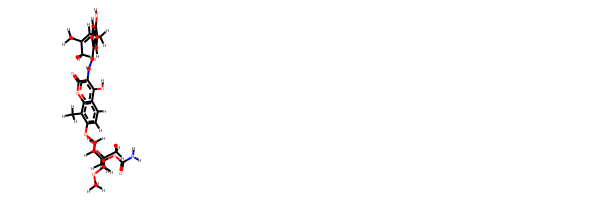

rdkit:  [H]Oc1c([H])c([H])c(C(=O)N([H])c2c(O[H])c3c([H])c([H])c(OC4([H])OC(C([H])([H])[H])(C([H])([H])[H])C([H])(OC([H])([H])[H])C([H])(OC(=O)N([H])[H])C4([H])O[H])c(C([H])([H])[H])c3oc2=O)c([H])c1C([H])([H])C([H])=C(C([H])([H])[H])C([H])([H])[H]
oechem:  Cc1c(ccc2c1oc(=O)c(c2O)NC(=O)c3ccc(c(c3)CC=C(C)C)O)OC4C(C(C(C(O4)(C)C)OC)OC(=O)N)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
9.632354265434476 kJ/mol 57151.46184268057 kJ/mol False
angle
45.2707405426945 kJ/mol 45.2707405426945 kJ/mol True
nb
12.649244523073932 kJ/mol 12.649244523073932 kJ/mol True
torsion
7.892142500537623 kJ/mol 8.184609334947005 kJ/mol False
75.44448183174052 kJ/mol 57217.56643708128 kJ/mol

-------------------------------------------------------------------
--------------------------

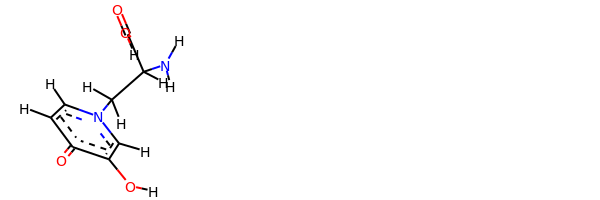

rdkit:  [H]OC(=O)C([H])(N([H])[H])C([H])([H])n1c([H])c([H])c(=O)c(O[H])c1[H]
oechem:  c1cn(cc(c1=O)O)CC(C(=O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
14.268361211355803 kJ/mol 56659.40591979291 kJ/mol False
angle
29.192789418594 kJ/mol 29.192789418594 kJ/mol True
nb
74.49378433518127 kJ/mol 74.49378433518127 kJ/mol True
torsion
42.62611171900551 kJ/mol 37.34560282215686 kJ/mol False
160.5810466841366 kJ/mol 56800.43809636884 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_938


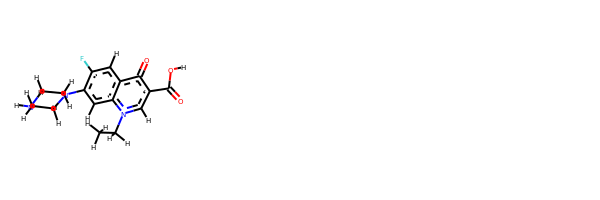

rdkit:  [H]OC(=O)c1c([H])n(C([H])([H])C([H])([H])[H])c2c([H])c(N3C([H])([H])C([H])([H])N([H])C([H])([H])C3([H])[H])c(F)c([H])c2c1=O
oechem:  CCn1cc(c(=O)c2c1cc(c(c2)F)N3CCNCC3)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
20.774648004601396 kJ/mol 57772.6799946714 kJ/mol False
angle
96.12323025657027 kJ/mol 97.35322633582172 kJ/mol False
nb
28.591736136643487 kJ/mol 28.591736136643487 kJ/mol True
torsion
2.9216475990276765 kJ/mol 2.9216984549852376 kJ/mol False
148.41126199684282 kJ/mo

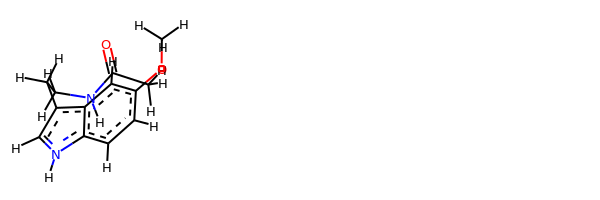

rdkit:  [H]c1c(OC([H])([H])[H])c([H])c2c(C([H])([H])C([H])([H])N([H])C(=O)C([H])([H])[H])c([H])n([H])c2c1[H]
oechem:  CC(=O)NCCc1c[nH]c2c1cc(cc2)OC
###########################################################################
 #########################################################

bond
35.70942695507899 kJ/mol 87376.11901975512 kJ/mol False
angle
416.59025582930286 kJ/mol 423.30322909486716 kJ/mol False
nb
239.99970428721957 kJ/mol 239.99970428721957 kJ/mol True
torsion
126.31244032116675 kJ/mol 109.48344025257562 kJ/mol False
818.6118273927682 kJ/mol 88148.90539338977 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_945


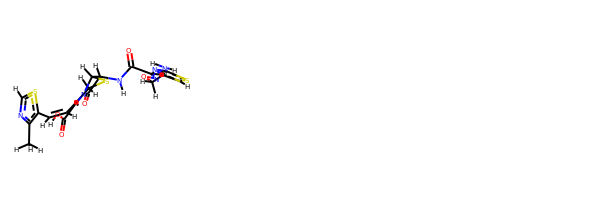

rdkit:  [H]OC(=O)C1=C(C([H])=C([H])c2sc([H])nc2C([H])([H])[H])C([H])([H])SC2([H])N1C(=O)C2([H])N([H])C(=O)C(=NOC([H])([H])[H])c1nc(N([H])[H])sc1[H]
oechem:  Cc1c(scn1)C=CC2=C(N3C(C(C3=O)NC(=O)C(=NOC)c4csc(n4)N)SC2)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
20.80275064527099 kJ/mol 58003.64708884824 kJ/mol False
angle
409.7351243866591 kJ/mol 409.735

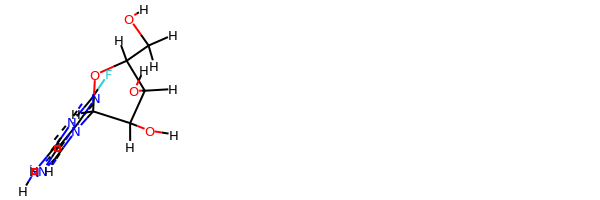

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])nc3c(N([H])[H])nc(F)nc32)C([H])(O[H])C1([H])O[H]
oechem:  c1nc2c(nc(nc2n1C3C(C(C(O3)CO)O)O)F)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
11.889771607113524 kJ/mol 57928.99468107165 kJ/mol False
angle
98.8631762040303 kJ/mol 98.8631762040303 kJ/mol True
nb
15.1548072640971 kJ/mol 15.1548072640971 kJ/mol True
to

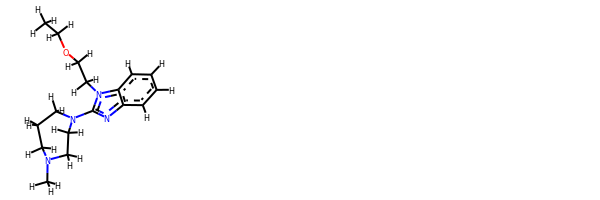

rdkit:  [H]c1c([H])c([H])c2c(nc(N3C([H])([H])C([H])([H])N(C([H])([H])[H])C([H])([H])C([H])([H])C3([H])[H])n2C([H])([H])C([H])([H])OC([H])([H])C([H])([H])[H])c1[H]
oechem:  CCOCCn1c2ccccc2nc1N3CCCN(CC3)C
###########################################################################
 #########################################################

bond
15.704838415843527 kJ/mol 58037.04111029068 kJ/mol False
angle
313.9552284905239 kJ/mol 313.9552284905239 kJ/mol True
nb
16.4329354596949 kJ/mol 16.4329354596949 kJ/mol True
torsion
38.52669696300295 kJ/mol 37.68993350283448 kJ/mol False
384.61969932906527 kJ/mol 58405.11920774373 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_964


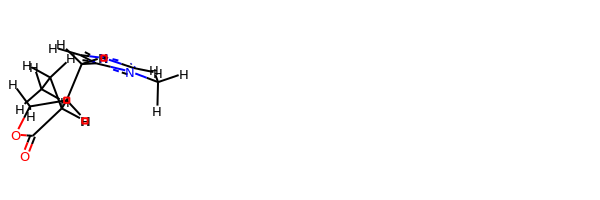

rdkit:  [H]c1nc([H])n(C([H])([H])[H])c1C([H])([H])C1([H])C([H])([H])OC(=O)C1([H])C([H])([H])C([H])([H])[H]
oechem:  CCC1C(COC1=O)Cc2cncn2C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
53.40851117062429 kJ/mol 57816.86262295632 kJ/mol False
angle
149.75393746432061 kJ/mol 151.099615186048 kJ/mol False
nb
150.93822754361844 kJ/mol 150.93822754361844 kJ/mol True
torsion
124.62173347284472 kJ/mol 108.7608127195399 kJ/mol False
478.72240965140804 kJ/mol 58227.66127840553 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_968


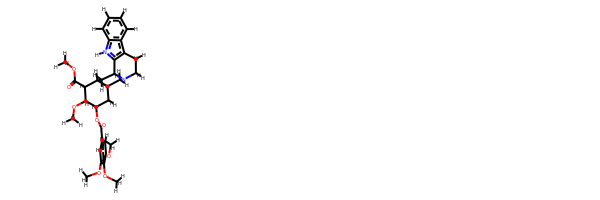

rdkit:  [H]c1c(OC([H])([H])[H])c(OC([H])([H])[H])c(OC([H])([H])[H])c([H])c1C(=O)OC1([H])C([H])([H])C2([H])C([H])([H])N3C([H])([H])C([H])([H])c4c(n([H])c5c([H])c([H])c([H])c([H])c45)C3([H])C([H])([H])C2([H])C([H])(C(=O)OC([H])([H])[H])C1([H])OC([H])([H])[H]
oechem:  COc1cc(cc(c1OC)OC)C(=O)OC2CC3CN4CCc5c6ccccc6[nH]c5C4CC3C(C2OC)C(=O)OC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ###########################################

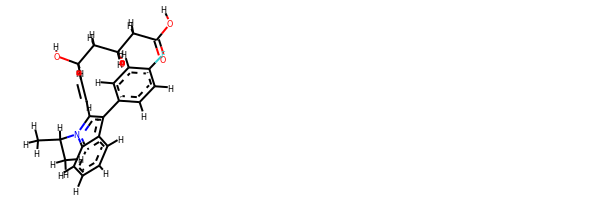

rdkit:  [H]OC(=O)C([H])([H])C([H])(O[H])C([H])([H])C([H])(O[H])C([H])=C([H])c1c(-c2c([H])c([H])c(F)c([H])c2[H])c2c([H])c([H])c([H])c([H])c2n1C([H])(C([H])([H])[H])C([H])([H])[H]
oechem:  CC(C)n1c2ccccc2c(c1C=CC(CC(CC(=O)O)O)O)c3ccc(cc3)F
###########################################################################
 #########################################################

bond
27.235994627219426 kJ/mol 57741.66242352501 kJ/mol False
angle
110.51755098320636 kJ/mol 110.51755098320636 kJ/mol True
nb
54.105857456967705 kJ/mol 54.105857456967705 kJ/mol True
torsion
2.5453191371806425 kJ/mol 0.025237723070569904 kJ/mol False
194.40472220457414 kJ/mol 57906.31106968826 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_976


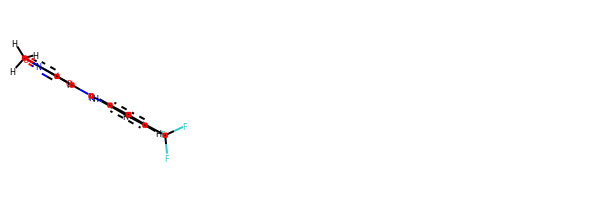

rdkit:  [H]c1noc(C([H])([H])[H])c1C(=O)N([H])c1c([H])c([H])c(C(F)(F)F)c([H])c1[H]
oechem:  Cc1c(cno1)C(=O)Nc2ccc(cc2)C(F)(F)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
11.529006364352224 kJ/mol 57272.99775273133 kJ/mol False
angle
10.030439076490921 kJ/mol 10.178236488930652 kJ/mol False
nb
19.48705998694089 kJ/mol 19.48705998694089 kJ/mol True
torsion
16.736046054656796 kJ/mol 0.00014253318310077816 kJ/mol False
57.78255148244084 kJ/mol 57302.66319174039 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_978


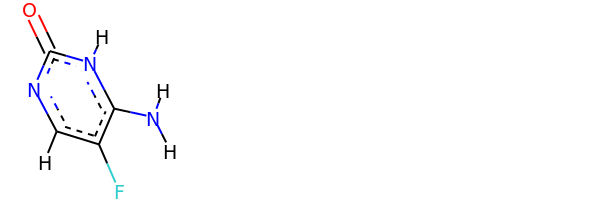

rdkit:  [H]c1nc(=O)n([H])c(N([H])[H])c1F
oechem:  c1c(c([nH]c(=O)n1)N)F
###########################################################################
 #########################################################

bond
39.8439593226965 kJ/mol 112281.69285388626 kJ/mol False
angle
89.7890303769186 kJ/mol 91.39998787056227 kJ/mol False
nb
72.60560878665201 kJ/mol 72.60560878665201 kJ/mol True
torsion
35.67763146893151 kJ/mol 20.717501462280858 kJ/mol False
237.91622995519862 kJ/mol 112466.41595200574 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_979


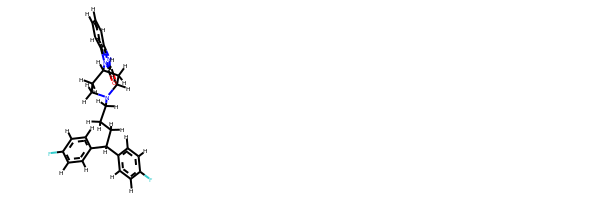

rdkit:  [H]c1c([H])c(C([H])(c2c([H])c([H])c(F)c([H])c2[H])C([H])([H])C([H])([H])C([H])([H])N2C([H])([H])C([H])([H])C([H])(n3c(=O)n([H])c4c([H])c([H])c([H])c([H])c43)C([H])([H])C2([H])[H])c([H])c([H])c1F
oechem:  c1ccc2c(c1)[nH]c(=O)n2C3CCN(CC3)CCCC(c4ccc(cc4)F)c5ccc(cc5)F
###########################################################################
 #########################################################

bond
45.82339004741589 kJ/mol 56416.61640008945 kJ/mol False
angle
323.79532409594395 kJ/mol 323.79532409594395 kJ/mol True
nb
47.85676623940682 kJ/mol 47.85676623940682 kJ/mol True
torsion
97.36777229213219 kJ/mol 73.81975821703246 kJ/mol False
514.8432526748988 kJ/mol 56862.088248641834 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_980


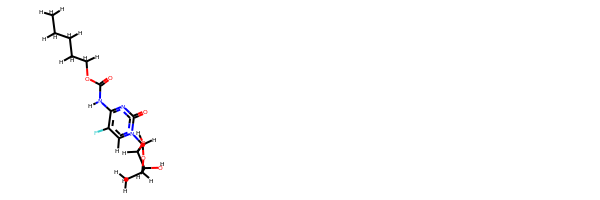

rdkit:  [H]OC1([H])C([H])(n2c([H])c(F)c(N([H])C(=O)OC([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])[H])nc2=O)OC([H])(C([H])([H])[H])C1([H])O[H]
oechem:  CCCCCOC(=O)Nc1c(cn(c(=O)n1)C2C(C(C(O2)C)O)O)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
37.09076543048048 kJ/mol 58403.53916035497 kJ/mol False
angle
436.3269545715923 kJ/mol 436.3269545715923 kJ/

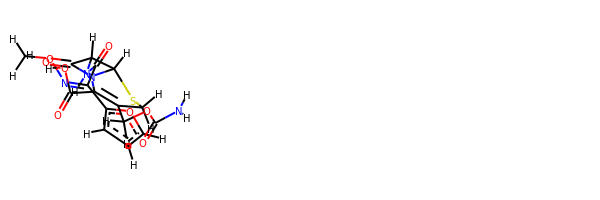

rdkit:  [H]OC(=O)C1=C(C([H])([H])OC(=O)N([H])[H])C([H])([H])SC2([H])N1C(=O)C2([H])N([H])C(=O)C(=NOC([H])([H])[H])c1oc([H])c([H])c1[H]
oechem:  CON=C(c1ccco1)C(=O)NC2C3N(C2=O)C(=C(CS3)COC(=O)N)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
31.921771572313055 kJ/mol 58317.27728963678 kJ/mol False
angle
102.34753619881509 kJ/mol 102.34753619881509 kJ/mol True
nb
74.20247962243769 kJ/mol 74.20247962243769 kJ/mol True
torsion
60.27434866036507 kJ/mol 54.98738436291982 kJ/mol False
268.746136

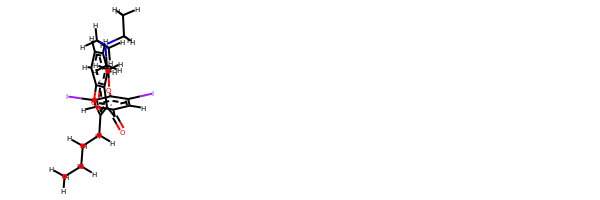

rdkit:  [H]c1c(I)c(OC([H])([H])C([H])([H])N(C([H])([H])C([H])([H])[H])C([H])([H])C([H])([H])[H])c(I)c([H])c1C(=O)c1c(C([H])([H])C([H])([H])C([H])([H])C([H])([H])[H])oc2c([H])c([H])c([H])c([H])c12
oechem:  CCCCc1c(c2ccccc2o1)C(=O)c3cc(c(c(c3)I)OCCN(CC)CC)I
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

################################################################

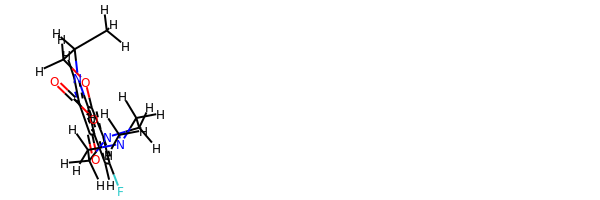

rdkit:  [H]OC(=O)c1c([H])n2c3c(c(N4C([H])([H])C([H])([H])N(C([H])([H])[H])C([H])([H])C4([H])[H])c(F)c([H])c3c1=O)OC([H])([H])C2([H])C([H])([H])[H]
oechem:  CC1COc2c3n1cc(c(=O)c3cc(c2N4CCN(CC4)C)F)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ########################################

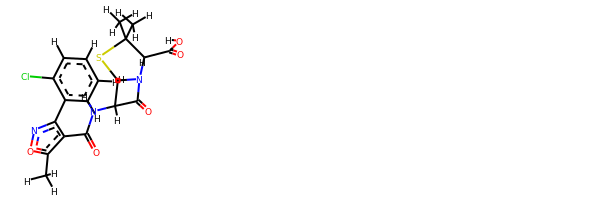

rdkit:  [H]OC(=O)C1([H])N2C(=O)C([H])(N([H])C(=O)c3c(-c4c([H])c([H])c([H])c([H])c4Cl)noc3C([H])([H])[H])C2([H])SC1(C([H])([H])[H])C([H])([H])[H]
oechem:  Cc1c(c(no1)c2ccccc2Cl)C(=O)NC3C4N(C3=O)C(C(S4)(C)C)C(=O)O
###########################################################################
 #########################################################

bond
22.1651003451713 kJ/mol 57638.425407666175 kJ/mol False
angle
32.388500487585915 kJ/mol 32.388500487585915 kJ/mol True
nb
57.441167399555276 kJ/mol 57.441167399555276 kJ/mol True
torsion
51.64649629809277 kJ/mol 51.65401701512406 kJ/mol False
163.64126453040527 kJ/mol 57779.90909256844 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1026


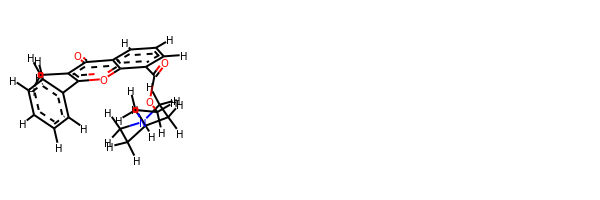

rdkit:  [H]c1c([H])c([H])c(-c2oc3c(C(=O)OC([H])([H])C([H])([H])N4C([H])([H])C([H])([H])C([H])([H])C([H])([H])C4([H])[H])c([H])c([H])c([H])c3c(=O)c2C([H])([H])[H])c([H])c1[H]
oechem:  Cc1c(=O)c2cccc(c2oc1c3ccccc3)C(=O)OCCN4CCCCC4
###########################################################################
 #########################################################

bond
29.894982133814025 kJ/mol 86306.02018148341 kJ/mol False
angle
100.45126657551818 kJ/mol 100.45126657551818 kJ/mol True
nb
48.890999155237665 kJ/mol 48.890999155237665 kJ/mol True
torsion
59.95278660213821 kJ/mol 43.39851582472587 kJ/mol False
239.19003446670808 kJ/mol 86498.76096303889 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1027


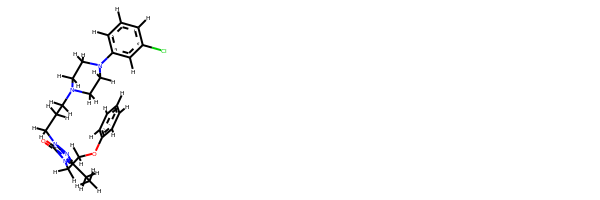

rdkit:  [H]c1c([H])c([H])c(OC([H])([H])C([H])([H])n2c(C([H])([H])C([H])([H])[H])nn(C([H])([H])C([H])([H])C([H])([H])N3C([H])([H])C([H])([H])N(c4c([H])c([H])c([H])c(Cl)c4[H])C([H])([H])C3([H])[H])c2=O)c([H])c1[H]
oechem:  CCc1nn(c(=O)n1CCOc2ccccc2)CCCN3CCN(CC3)c4cccc(c4)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###############################################

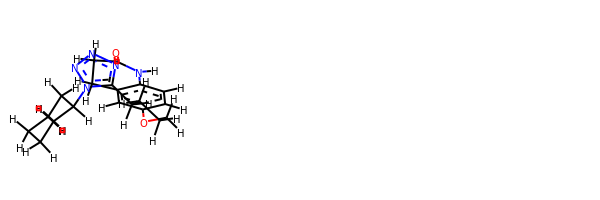

rdkit:  [H]c1c([H])c2c(c([H])c1OC([H])([H])C([H])([H])C([H])([H])C([H])([H])c1nnnn1C1([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C1([H])[H])C([H])([H])C([H])([H])C(=O)N2[H]
oechem:  c1cc2c(cc1OCCCCc3nnnn3C4CCCCC4)CCC(=O)N2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ###############

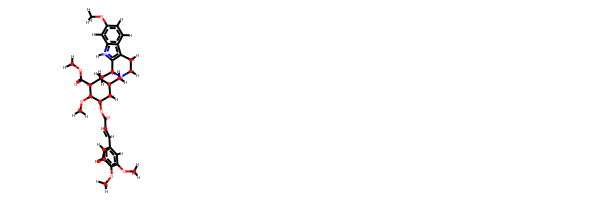

rdkit:  [H]C(C(=O)OC1([H])C([H])([H])C2([H])C([H])([H])N3C([H])([H])C([H])([H])c4c(n([H])c5c([H])c(OC([H])([H])[H])c([H])c([H])c45)C3([H])C([H])([H])C2([H])C([H])(C(=O)OC([H])([H])[H])C1([H])OC([H])([H])[H])=C([H])c1c([H])c(OC([H])([H])[H])c(OC([H])([H])[H])c(OC([H])([H])[H])c1[H]
oechem:  COc1ccc2c(c1)[nH]c3c2CCN4C3CC5C(C4)CC(C(C5C(=O)OC)OC)OC(=O)C=Cc6cc(c(c(c6)OC)OC)OC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
72.85718128164429 kJ/mol 224346.08276077677 kJ/mol False
angle
166.68754833427013 kJ/mol 169.91164148211735 kJ/mol False
nb
29.92273599045216 kJ/mol 29.92273599045216 kJ/mol True
torsion
35.15515381691412 kJ/mol 17.504068975242994 kJ/mol False
304.6226194232807 kJ/mol 224563.4212072246 kJ/mol

------------------------------------------------------

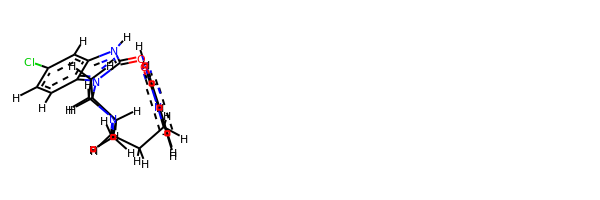

rdkit:  [H]c1c([H])c([H])c2c(c1[H])n([H])c(=O)n2C([H])([H])C([H])([H])C([H])([H])N1C([H])([H])C([H])([H])C([H])(n2c(=O)n([H])c3c([H])c(Cl)c([H])c([H])c32)C([H])([H])C1([H])[H]
oechem:  c1ccc2c(c1)[nH]c(=O)n2CCCN3CCC(CC3)n4c5ccc(cc5[nH]c4=O)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
16.749015647353072 kJ/mol 57494.577628386345 kJ/mol False
angle
102.76628829246117 kJ/mol 103.97350019118986 kJ/mol False
nb
54.782498738059935 kJ/mol 54.782498738059935 kJ/mol True
torsion
28.288424547505585 kJ/mol 28.29047047721313 kJ/mol False
202.58622722537976 kJ/mol 57681.62409779281 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
---------------------------------------------

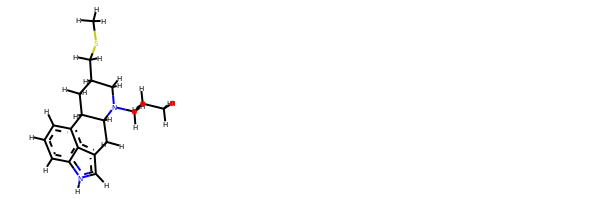

rdkit:  [H]c1c([H])c([H])c2c3c(c([H])n2[H])C([H])([H])C2([H])N(C([H])([H])C([H])([H])C([H])([H])[H])C([H])([H])C([H])(C([H])([H])SC([H])([H])[H])C([H])([H])C2([H])c13
oechem:  CCCN1CC(CC2C1Cc3c[nH]c4c3c2ccc4)CSC
###########################################################################
 #########################################################

bond
8.771536694429189 kJ/mol 57644.308511070965 kJ/mol False
angle
26.52014312257568 kJ/mol 26.52014312257568 kJ/mol True
nb
53.76800505248504 kJ/mol 53.76800505248504 kJ/mol True
torsion
13.432238807940594 kJ/mol 13.092087130967776 kJ/mol False
102.49192367743049 kJ/mol 57737.68874637699 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1066


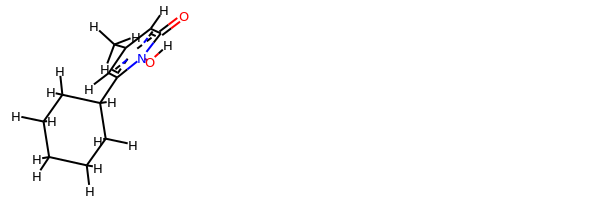

rdkit:  [H]On1c(C2([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C2([H])[H])c([H])c(C([H])([H])[H])c([H])c1=O
oechem:  Cc1cc(n(c(=O)c1)O)C2CCCCC2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
24.173390867457375 kJ/mol 44188.16350222652 kJ/mol False
angle
118.68099430804543 kJ/mol 121.15313165993541 kJ/mol False
nb
-9.071505203507787 kJ/mol -9.071505203507787 kJ/mol True
torsion
195.96514017101165 kJ/mol 195.97362789420572 kJ/mol False
329.74802014300667 kJ/mol 44496.21875657715 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
----

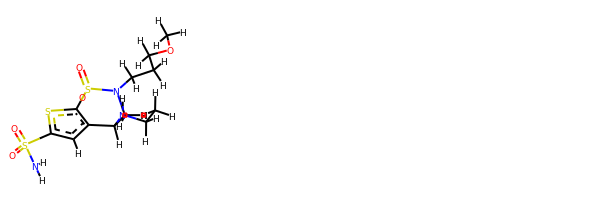

rdkit:  [H]c1c(S(=O)(=O)N([H])[H])sc2c1C([H])(N([H])C([H])([H])C([H])([H])[H])C([H])([H])N(C([H])([H])C([H])([H])C([H])([H])OC([H])([H])[H])S2(=O)=O
oechem:  CCNC1CN(S(=O)(=O)c2c1cc(s2)S(=O)(=O)N)CCCOC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
43.20360596606079 kJ/mol 57560.58561544196 kJ/mol False
angle
600.2089273423012 kJ/mol 601.417837486941 kJ/mol False
nb
63.56786088287025 kJ/mol 63.56786088287025 kJ/mol True
torsion
161.02802379937543 kJ/mol 161.03914057703494 kJ/mol False
868.0084

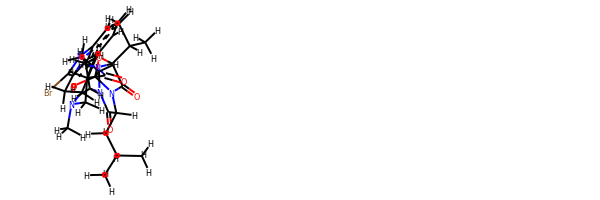

rdkit:  [H]OC12OC(N([H])C(=O)C3([H])C([H])=C4c5c([H])c([H])c([H])c6c5c(c(Br)n6[H])C([H])([H])C4([H])N(C([H])([H])[H])C3([H])[H])(C([H])(C([H])([H])[H])C([H])([H])[H])C(=O)N1C([H])(C([H])([H])C([H])(C([H])([H])[H])C([H])([H])[H])C(=O)N1C([H])([H])C([H])([H])C([H])([H])C12[H]
oechem:  CC(C)CC1C(=O)N2CCCC2C3(N1C(=O)C(O3)(C(C)C)NC(=O)C4CN(C5Cc6c7c(cccc7[nH]c6Br)C5=C4)C)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
28.751828977088493 kJ/mol 57545.378723269954 kJ/mol False
angle
115.597803380349 kJ/mol 115.597803380349 kJ/mol True
nb
32.47286892716311 kJ/mol 32.47286892716311 kJ/mol True
torsion
57.71080139523615 kJ/mol 37.346305

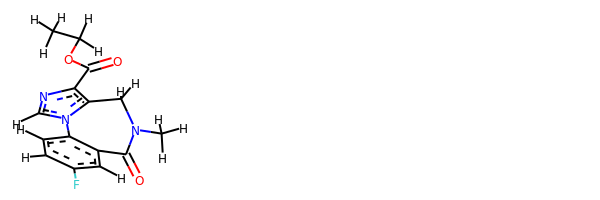

rdkit:  [H]c1c([H])c2c(c([H])c1F)C(=O)N(C([H])([H])[H])C([H])([H])c1c(C(=O)OC([H])([H])C([H])([H])[H])nc([H])n1-2
oechem:  CCOC(=O)c1c2n(cn1)-c3ccc(cc3C(=O)N(C2)C)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
17.90841782803464 kJ/mol 56663.01623662077 kJ/mol False
angle
34.56708240583514 kJ/mol 34.56708240583514 kJ/mol True
nb
134.49236220123012 kJ/mol 134.49236220123012 kJ/mol True
torsion
202.4519381915762 kJ/mol 160.0106224114728 kJ/mol False
389.4198006266761 kJ/mol 56992.086303639306 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------

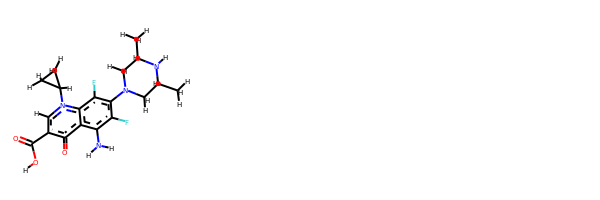

rdkit:  [H]OC(=O)c1c([H])n(C2([H])C([H])([H])C2([H])[H])c2c(F)c(N3C([H])([H])C([H])(C([H])([H])[H])N([H])C([H])(C([H])([H])[H])C3([H])[H])c(F)c(N([H])[H])c2c1=O
oechem:  CC1CN(CC(N1)C)c2c(c(c3c(c2F)n(cc(c3=O)C(=O)O)C4CC4)N)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
38.9875062338021 kJ/mol 101303.53478788973 kJ/mol False
angle
395.5058014072924 kJ/mol 398.89892920752317 kJ/mol False
nb
10.361648851164894 kJ/mol 10.361648851164894 kJ/mol True
torsion
136.4313066166963 kJ/mol 105.45908226963176 kJ/mol False
581.2862631089557 kJ/mol 101818.25444821805 kJ/mol

------------------------------------------------------------------

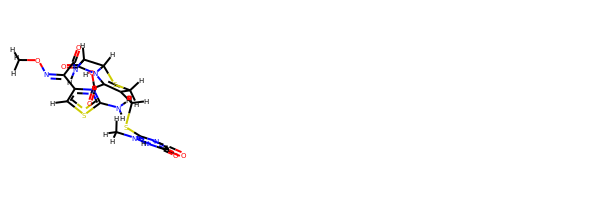

rdkit:  [H]OC(=O)C1=C(C([H])([H])Sc2nc(=O)c(=O)n([H])n2C([H])([H])[H])C([H])([H])SC2([H])N1C(=O)C2([H])N([H])C(=O)C(=NOC([H])([H])[H])c1nc(N([H])[H])sc1[H]
oechem:  Cn1c(nc(=O)c(=O)[nH]1)SCC2=C(N3C(C(C3=O)NC(=O)C(=NOC)c4csc(n4)N)SC2)C(=O)O
###########################################################################
 #########################################################

bond
10.740721774778706 kJ/mol 29077.891991594093 kJ/mol False
angle
91.39526621527098 kJ/mol 93.06450848429554 kJ/mol False
nb
-1.5331783515980786 kJ/mol -1.5331783515980786 kJ/mol True
torsion
5.230086859253005 kJ/mol 0.00019327040132694436 kJ/mol False
105.83289649770461 kJ/mol 29169.42351499719 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1091


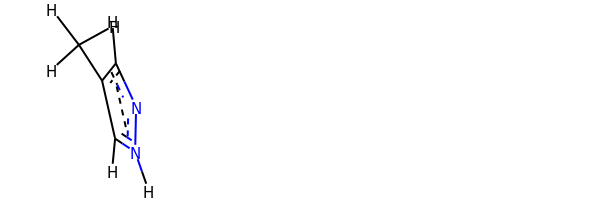

rdkit:  [H]c1nn([H])c([H])c1C([H])([H])[H]
oechem:  Cc1c[nH]nc1
###########################################################################
 #########################################################

bond
17.263068448676375 kJ/mol 57735.53729446885 kJ/mol False
angle
92.21406991256418 kJ/mol 92.21406991256418 kJ/mol True
nb
29.130947720315095 kJ/mol 29.130947720315095 kJ/mol True
torsion
31.709018029807932 kJ/mol 31.67923148174 kJ/mol False
170.3171041113636 kJ/mol 57888.56154358348 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1093


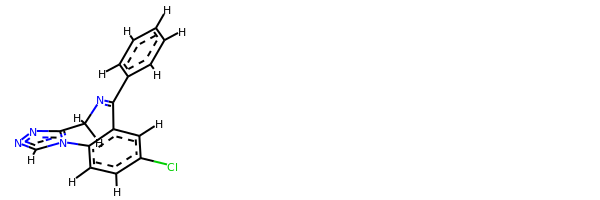

rdkit:  [H]c1c([H])c([H])c(C2=NC([H])([H])c3nnc([H])n3-c3c([H])c([H])c(Cl)c([H])c32)c([H])c1[H]
oechem:  c1ccc(cc1)C2=NCc3nncn3-c4c2cc(cc4)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
20.461466075037585 kJ/mol 29177.09201396005 kJ/mol False
angle
105.27403488563999 kJ/mol 105.27403488563999 kJ/mol True
nb
40.299735062853344 kJ/mol 40.299735062853344 kJ/mol True
torsion
15.380796185883908 kJ/mol 0.6710253010939603 kJ/mol False
181.41603220941482 kJ/mol 29323.336809209635 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1095


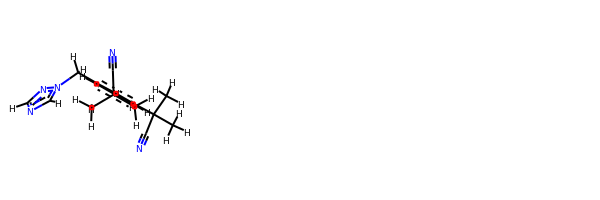

rdkit:  [H]c1nc([H])n(C([H])([H])c2c([H])c(C(C#N)(C([H])([H])[H])C([H])([H])[H])c([H])c(C(C#N)(C([H])([H])[H])C([H])([H])[H])c2[H])n1
oechem:  CC(C)(C#N)c1cc(cc(c1)C(C)(C)C#N)Cn2cncn2
###########################################################################
 #########################################################

bond
38.53013323029491 kJ/mol 58404.62737671637 kJ/mol False
angle
218.7548210976057 kJ/mol 218.7548210976057 kJ/mol True
nb
61.024718637720696 kJ/mol 61.024718637720696 kJ/mol True
torsion
11.925455182917284 kJ/mol 11.925467946237013 kJ/mol False
330.2351281485386 kJ/mol 58696.332384397945 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1097


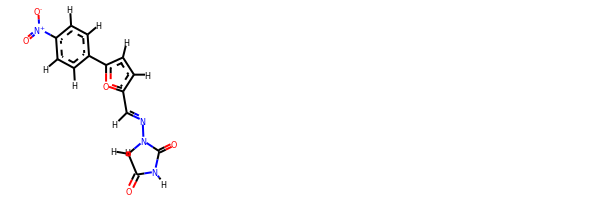

rdkit:  [H]C(=NN1C(=O)N([H])C(=O)C1([H])[H])c1oc(-c2c([H])c([H])c([N+](=O)[O-])c([H])c2[H])c([H])c1[H]
oechem:  c1cc(ccc1c2ccc(o2)C=NN3CC(=O)NC3=O)[N+](=O)[O-]
###########################################################################
 #########################################################

bond
84.37122055362791 kJ/mol 85490.49862861638 kJ/mol False
angle
321.81186689201365 kJ/mol 321.81186689201365 kJ/mol True
nb
119.86637380327129 kJ/mol 119.86637380327129 kJ/mol True
torsion
180.12057335399712 kJ/mol 185.59712461572778 kJ/mol False
706.1700346029099 kJ/mol 86117.77399392739 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1098


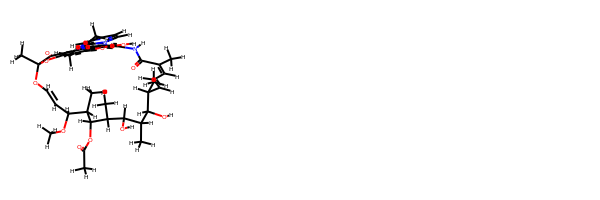

rdkit:  [H]Oc1c(C([H])([H])[H])c2c3c4c1c(O[H])c(c1c4nc4c([H])c(C([H])([H])[H])c([H])c([H])n41)N([H])C(=O)C(C([H])([H])[H])=C([H])C([H])=C([H])C([H])(C([H])([H])[H])C([H])(O[H])C([H])(C([H])([H])[H])C([H])(O[H])C([H])(C([H])([H])[H])C([H])(OC(=O)C([H])([H])[H])C([H])(C([H])([H])[H])C([H])(OC([H])([H])[H])C([H])=C([H])OC(C([H])([H])[H])(O2)C3=O
oechem:  Cc1ccn2c(c1)nc3c2c4c(c5c3c6c(c(c5O)C)OC(C6=O)(OC=CC(C(C(C(C(C(C(C(C=CC=C(C(=O)N4)C)C)O)C)O)C)OC(=O)C)C)OC)C)O
###########################################################################
 #########################################################

bond
56.38547293149906 kJ/mol 169638.39336257233 kJ/mol False
angle
97.65265686405716 kJ/mol 99.82535113051138 kJ/mol False
nb
24.4425771519655 kJ/mol 24.4425771519655 kJ/mol True
torsion
0.0006031860601645561 kJ/mol 0.0013719408331790278 kJ/mol False
178.4813101335819 kJ/mol 169762.66266279563 kJ/mol

-------------------------------------------------------------------
----------------------------

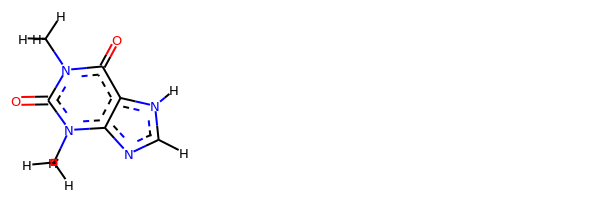

rdkit:  [H]c1nc2c(c(=O)n(C([H])([H])[H])c(=O)n2C([H])([H])[H])n1[H]
oechem:  Cn1c2c(c(=O)n(c1=O)C)[nH]cn2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #

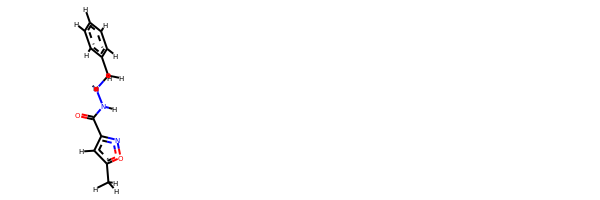

rdkit:  [H]c1c(C(=O)N([H])N([H])C([H])([H])c2c([H])c([H])c([H])c([H])c2[H])noc1C([H])([H])[H]
oechem:  Cc1cc(no1)C(=O)NNCc2ccccc2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
20.988071454565446 kJ/mol 57538.348091903725 kJ/mol False
angle
118.11260058070079 kJ/mol 119.31909824037088 kJ/mol False
nb
35.30020176320554 kJ/mol 35.30020176320554 kJ/mol True
torsi

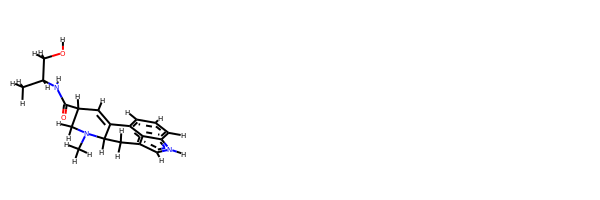

rdkit:  [H]OC([H])([H])C([H])(N([H])C(=O)C1([H])C([H])=C2c3c([H])c([H])c([H])c4c3c(c([H])n4[H])C([H])([H])C2([H])N(C([H])([H])[H])C1([H])[H])C([H])([H])[H]
oechem:  CC(CO)NC(=O)C1CN(C2Cc3c[nH]c4c3c(ccc4)C2=C1)C
###########################################################################
 #########################################################

bond
32.58876110231474 kJ/mol 43703.79603389281 kJ/mol False
angle
95.7577366003828 kJ/mol 99.11453202739796 kJ/mol False
nb
62.79550508396886 kJ/mol 62.79550508396886 kJ/mol True
torsion
46.44605066273238 kJ/mol 46.42460232084406 kJ/mol False
237.58805344939879 kJ/mol 43912.130673325024 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1131


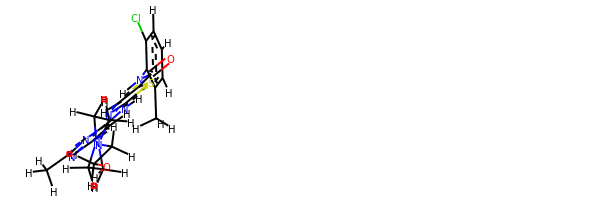

rdkit:  [H]OC([H])([H])C([H])([H])N1C([H])([H])C([H])([H])N(c2nc(C([H])([H])[H])nc(N([H])c3nc([H])c(C(=O)N([H])c4c(Cl)c([H])c([H])c([H])c4C([H])([H])[H])s3)c2[H])C([H])([H])C1([H])[H]
oechem:  Cc1cccc(c1NC(=O)c2cnc(s2)Nc3cc(nc(n3)C)N4CCN(CC4)CCO)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
27.917558389344222 kJ/mol 58392.397416638785 kJ/mol False
angle
154.83262614378637 kJ/mol 154.83262614378637 kJ/mol True
nb
62.70409566041665 kJ/mol 62.70409566041665 kJ/mol True
torsion
34.70555587081944 kJ/mol 34.7053408580419 kJ/mol False
280.1598360643667 kJ/mol 58644.639479301026 kJ/mol

--------------------------------------------

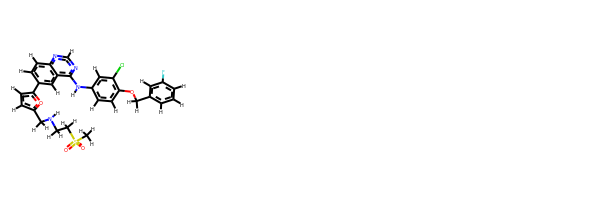

rdkit:  [H]c1nc(N([H])c2c([H])c([H])c(OC([H])([H])c3c([H])c([H])c([H])c(F)c3[H])c(Cl)c2[H])c2c([H])c(-c3oc(C([H])([H])N([H])C([H])([H])C([H])([H])S(=O)(=O)C([H])([H])[H])c([H])c3[H])c([H])c([H])c2n1
oechem:  CS(=O)(=O)CCNCc1ccc(o1)c2ccc3c(c2)c(ncn3)Nc4ccc(c(c4)Cl)OCc5cccc(c5)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
24.331605532428622 kJ/mol 58319.08390736008 kJ/mol False
angle
119.2564054953152 kJ/mol 119.2564054953152 kJ/mol True
nb
48.702936124761436 kJ/mol 48.702936124761436 kJ/mol True
torsion
28.008415865691955 kJ/mol 18.2743069459792 kJ/mol False
220.2993630181972 kJ/mol 58505.317555926136 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
---------------

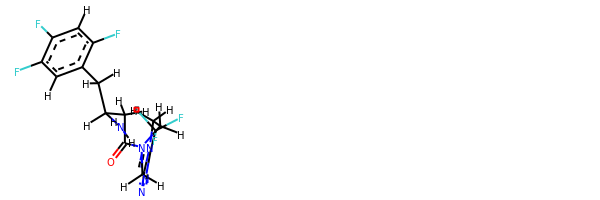

rdkit:  [H]c1c(F)c(F)c([H])c(C([H])([H])C([H])(N([H])[H])C([H])([H])C(=O)N2C([H])([H])c3nnc(C(F)(F)F)n3C([H])([H])C2([H])[H])c1F
oechem:  c1c(c(cc(c1F)F)F)CC(CC(=O)N2CCn3c(nnc3C(F)(F)F)C2)N
###########################################################################
 #########################################################

bond
26.86313163944188 kJ/mol 57055.64860842175 kJ/mol False
angle
308.69154757205587 kJ/mol 308.69154757205587 kJ/mol True
nb
28.081254043986714 kJ/mol 28.081254043986714 kJ/mol True
torsion
111.085167619207 kJ/mol 60.789423499240144 kJ/mol False
474.72110087469144 kJ/mol 57453.21083353703 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1137


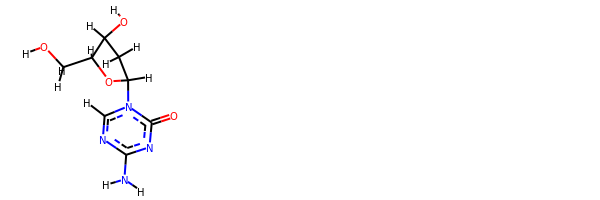

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])nc(N([H])[H])nc2=O)C([H])([H])C1([H])O[H]
oechem:  c1nc(nc(=O)n1C2CC(C(O2)CO)O)N
###########################################################################
 #########################################################

bond
52.73799844864174 kJ/mol 115151.09115217626 kJ/mol False
angle
490.170015131953 kJ/mol 490.170015131953 kJ/mol True
nb
135.9903151982593 kJ/mol 135.9903151982593 kJ/mol True
torsion
96.06455214056379 kJ/mol 74.73860678824302 kJ/mol False
774.9628809194178 kJ/mol 115851.99008929472 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1138


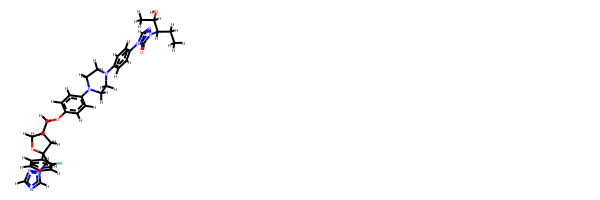

rdkit:  [H]OC([H])(C([H])([H])[H])C([H])(n1nc([H])n(-c2c([H])c([H])c(N3C([H])([H])C([H])([H])N(c4c([H])c([H])c(OC([H])([H])C5([H])C([H])([H])OC(c6c([H])c([H])c(F)c([H])c6F)(C([H])([H])n6nc([H])nc6[H])C5([H])[H])c([H])c4[H])C([H])([H])C3([H])[H])c([H])c2[H])c1=O)C([H])([H])C([H])([H])[H]
oechem:  CCC(C(C)O)n1c(=O)n(cn1)c2ccc(cc2)N3CCN(CC3)c4ccc(cc4)OCC5CC(OC5)(Cn6cncn6)c7ccc(cc7F)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
44.51485311130193 kJ/mol 113451.11570249737 kJ/mol False
angle
320.44671622213167 kJ/mol 321.0668390279246 kJ/mol False
nb
27.561996987681095 kJ/mol 27.561996987681095 kJ/mol True
torsion
106.79381197430745 kJ/mol 49.72093593236365 kJ/mol False
499.31737829542215 kJ/mol 113849.46547444534 kJ/mol

-----------------------------------------

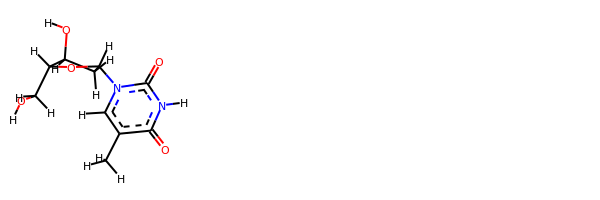

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])c(C([H])([H])[H])c(=O)n([H])c2=O)C([H])([H])C1([H])O[H]
oechem:  Cc1cn(c(=O)[nH]c1=O)C2CC(C(O2)CO)O
###########################################################################
 #########################################################

bond
45.375240290374606 kJ/mol 57901.74837433196 kJ/mol False
angle
178.37299764670237 kJ/mol 179.76333421429968 kJ/mol False
nb
71.29280878721147 kJ/mol 71.29280878721147 kJ/mol True
torsion
51.205010846520054 kJ/mol 46.113281791777254 kJ/mol False
346.2460575708085 kJ/mol 58198.91779912525 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1142


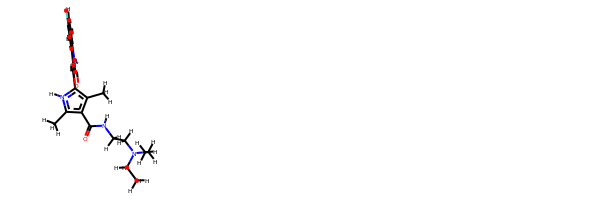

rdkit:  [H]C(=C1C(=O)N([H])c2c([H])c([H])c(F)c([H])c21)c1c(C([H])([H])[H])c(C(=O)N([H])C([H])([H])C([H])([H])N(C([H])([H])C([H])([H])[H])C([H])([H])C([H])([H])[H])c(C([H])([H])[H])n1[H]
oechem:  CCN(CC)CCNC(=O)c1c(c([nH]c1C)C=C2c3cc(ccc3NC2=O)F)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
29.692006602064875 kJ/mol 58012.71580519884 kJ/mol False
angle
411.52321691764934 kJ/mol 411.52321691764934 kJ/mol True
nb
27.37997445392422 kJ/mol 27.37997445392422 kJ/mol True
torsion
83.6058245840273 k

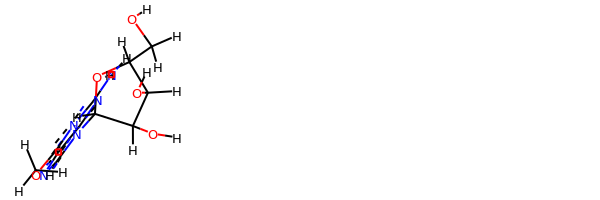

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])nc3c(OC([H])([H])[H])nc(N([H])[H])nc32)C([H])(O[H])C1([H])O[H]
oechem:  COc1c2c(nc(n1)N)n(cn2)C3C(C(C(O3)CO)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
50.37110479206245 kJ/mol 57766.316008795795 kJ/mol False
angle
148.23479155008138 kJ/mol 148.23479155008138 kJ/mol True
nb
9.40428290399272 kJ/mol 9.40428290399272 kJ/mol True
torsion
101.83310537659659 kJ/mol 101.8331054433981 kJ/mol False
309.84328462273317 kJ/mol 58025.78818869326 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------


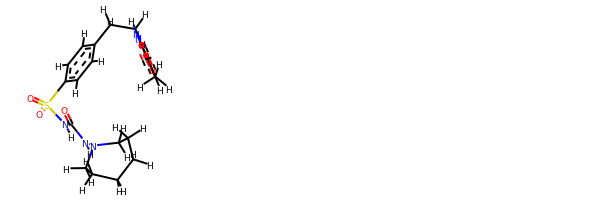

rdkit:  [H]c1c(C(=O)N([H])C([H])([H])C([H])([H])c2c([H])c([H])c(S(=O)(=O)N([H])C(=O)N([H])N3C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C3([H])[H])c([H])c2[H])noc1C([H])([H])[H]
oechem:  Cc1cc(no1)C(=O)NCCc2ccc(cc2)S(=O)(=O)NC(=O)NN3CCCCCC3
###########################################################################
 #########################################################

bond
21.21834026988529 kJ/mol 57004.27958372356 kJ/mol False
angle
27.148985249803754 kJ/mol 27.148985249803754 kJ/mol True
nb
68.43413538086324 kJ/mol 68.43413538086324 kJ/mol True
torsion
69.68164979517667 kJ/mol 66.88462469100521 kJ/mol False
186.48311069572895 kJ/mol 57166.74732904523 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1156


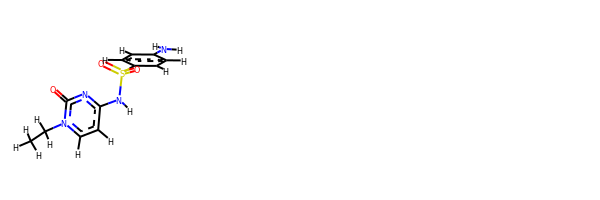

rdkit:  [H]c1c([H])c(S(=O)(=O)N([H])c2nc(=O)n(C([H])([H])C([H])([H])[H])c([H])c2[H])c([H])c([H])c1N([H])[H]
oechem:  CCn1ccc(nc1=O)NS(=O)(=O)c2ccc(cc2)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
81.66182317600635 kJ/mol 110094.66179413714 kJ/mol False
angle
561.7239826304004 kJ/mol 561.7239826304004 kJ/mol True
nb
24.053543668362007 kJ/mol 24.053543668362007 kJ/mol True
torsion
0.00029554400135373967 kJ/mol 0.0006757977134545152 kJ/mol False
667.4396450187701 kJ/mol 110680.4399962336 kJ/mol

-------------------------------------------------------------------
----------------------------------------------------------------

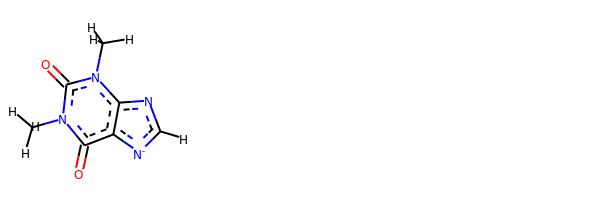

rdkit:  [H]c1nc2c([n-]1)c(=O)n(C([H])([H])[H])c(=O)n2C([H])([H])[H]
oechem:  Cn1c2c(c(=O)n(c1=O)C)[n-]cn2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
21.6085759618118 kJ/mol 29216.569743451095 kJ/mol False
angle
402.36604676879216 kJ/mol 402.36604676879216 kJ/mol True
nb
12.156242441396312 kJ/mol 12.156242441396312 kJ/mol True
torsion
93.51182429838107 kJ/mol 88.28185120323738 kJ/mol False
529.6426894703814 kJ/mol 29719.373883864522 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
--------------------------------------------------

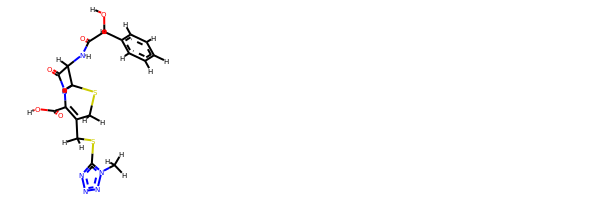

rdkit:  [H]OC(=O)C1=C(C([H])([H])Sc2nnnn2C([H])([H])[H])C([H])([H])SC2([H])N1C(=O)C2([H])N([H])C(=O)C([H])(O[H])c1c([H])c([H])c([H])c([H])c1[H]
oechem:  Cn1c(nnn1)SCC2=C(N3C(C(C3=O)NC(=O)C(c4ccccc4)O)SC2)C(=O)O
###########################################################################
 #########################################################

bond
28.546564984270596 kJ/mol 72908.41031615656 kJ/mol False
angle
426.92364712388957 kJ/mol 431.3200702980253 kJ/mol False
nb
-4.027321608095609 kJ/mol -4.027321608095609 kJ/mol True
torsion
133.52816304618509 kJ/mol 111.37581301153875 kJ/mol False
584.9710535462497 kJ/mol 73447.07887785803 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1167


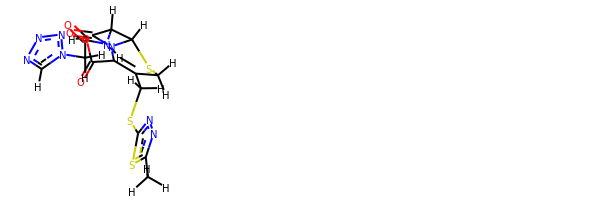

rdkit:  [H]OC(=O)C1=C(C([H])([H])Sc2nnc(C([H])([H])[H])s2)C([H])([H])SC2([H])N1C(=O)C2([H])N([H])C(=O)C([H])([H])n1nnnc1[H]
oechem:  Cc1nnc(s1)SCC2=C(N3C(C(C3=O)NC(=O)Cn4cnnn4)SC2)C(=O)O
###########################################################################
 #########################################################

bond
26.05708862912982 kJ/mol 29221.01825611842 kJ/mol False
angle
429.74807586082756 kJ/mol 429.74807586082756 kJ/mol True
nb
4.062222004948973 kJ/mol 4.062222004948973 kJ/mol True
torsion
93.51182429838107 kJ/mol 88.28185120323738 kJ/mol False
553.3792107932874 kJ/mol 29743.110405187435 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1168


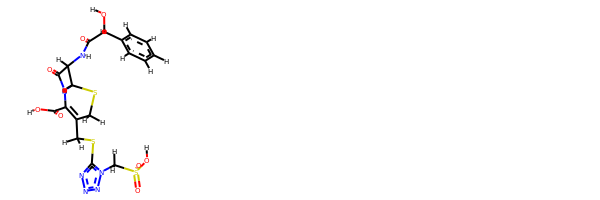

rdkit:  [H]OC(=O)C1=C(C([H])([H])Sc2nnnn2C([H])([H])S(=O)(=O)O[H])C([H])([H])SC2([H])N1C(=O)C2([H])N([H])C(=O)C([H])(O[H])c1c([H])c([H])c([H])c([H])c1[H]
oechem:  c1ccc(cc1)C(C(=O)NC2C3N(C2=O)C(=C(CS3)CSc4nnnn4CS(=O)(=O)O)C(=O)O)O
###########################################################################
 #########################################################

bond
44.28231171674371 kJ/mol 29236.776574801366 kJ/mol False
angle
592.2125301364102 kJ/mol 592.2125301364102 kJ/mol True
nb
19.781294287615058 kJ/mol 19.781294287615058 kJ/mol True
torsion
177.33176636459177 kJ/mol 172.1017949695796 kJ/mol False
833.6079025053608 kJ/mol 30020.87219419497 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1170


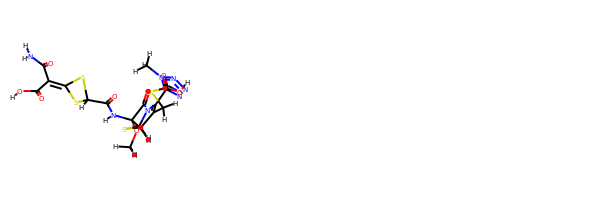

rdkit:  [H]OC(=O)C(C(=O)N([H])[H])=C1SC([H])(C(=O)N([H])C2(OC([H])([H])[H])C(=O)N3C(C(=O)O[H])=C(C([H])([H])Sc4nnnn4C([H])([H])[H])C([H])([H])SC32[H])S1
oechem:  Cn1c(nnn1)SCC2=C(N3C(C(C3=O)(NC(=O)C4SC(=C(C(=O)N)C(=O)O)S4)OC)SC2)C(=O)O
###########################################################################
 #########################################################

bond
37.35793106898765 kJ/mol 43823.94237444526 kJ/mol False
angle
364.05462698868604 kJ/mol 366.2056802284001 kJ/mol False
nb
8.54957095486201 kJ/mol 8.54957095486201 kJ/mol True
torsion
138.69953902195843 kJ/mol 132.44009881268593 kJ/mol False
548.6616680344941 kJ/mol 44331.13772444121 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1171


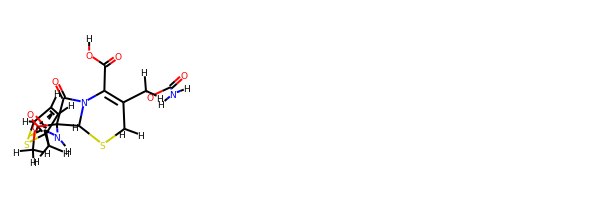

rdkit:  [H]OC(=O)C1=C(C([H])([H])OC(=O)N([H])[H])C([H])([H])SC2([H])N1C(=O)C2(OC([H])([H])[H])N([H])C(=O)C([H])([H])c1sc([H])c([H])c1[H]
oechem:  COC1(C2N(C1=O)C(=C(CS2)COC(=O)N)C(=O)O)NC(=O)Cc3cccs3
###########################################################################
 #########################################################

bond
27.795618369237523 kJ/mol 43697.78072328358 kJ/mol False
angle
366.4200303407956 kJ/mol 369.77547032354465 kJ/mol False
nb
16.35790786668545 kJ/mol 16.35790786668545 kJ/mol True
torsion
101.93697125562629 kJ/mol 85.10802873618728 kJ/mol False
512.5105278323449 kJ/mol 44169.022130209996 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1172


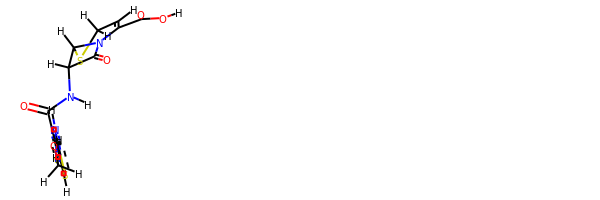

rdkit:  [H]OC(=O)C1=C([H])C([H])([H])SC2([H])N1C(=O)C2([H])N([H])C(=O)C(=NOC([H])([H])[H])c1nc(N([H])[H])sc1[H]
oechem:  CON=C(c1csc(n1)N)C(=O)NC2C3N(C2=O)C(=CCS3)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

##############

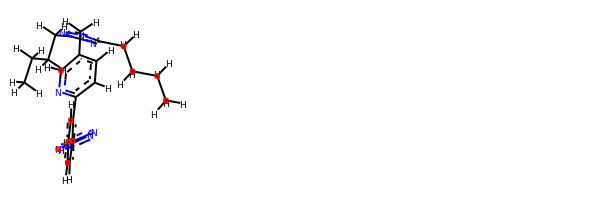

rdkit:  [H]c1nc(-c2c([H])c([H])c([H])c([H])c2-c2nnn([H])n2)c([H])c([H])c1C([H])([H])n1nc(C([H])([H])C([H])([H])C([H])([H])C([H])([H])[H])nc1C([H])([H])C([H])([H])C([H])([H])C([H])([H])[H]
oechem:  CCCCc1nc(n(n1)Cc2ccc(nc2)c3ccccc3c4n[nH]nn4)CCCC
###########################################################################
 #########################################################

bond
39.25651459724165 kJ/mol 116346.50966103321 kJ/mol False
angle
206.00511341203827 kJ/mol 206.00511341203827 kJ/mol True
nb
3.473998995183133 kJ/mol 3.473998995183133 kJ/mol True
torsion
241.8352221259146 kJ/mol 202.00654835829945 kJ/mol False
490.57084913037767 kJ/mol 116757.99532179873 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1181


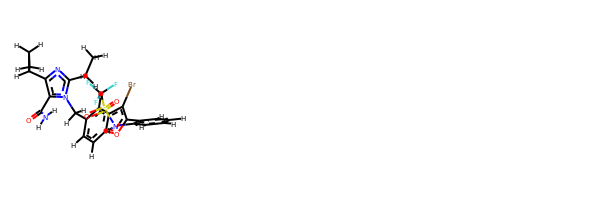

rdkit:  [H]c1c([H])c([H])c(N([H])S(=O)(=O)C(F)(F)F)c(-c2oc3c([H])c([H])c(C([H])([H])n4c(C([H])([H])C([H])([H])[H])nc(C5([H])C([H])([H])C5([H])[H])c4C(=O)N([H])[H])c([H])c3c2Br)c1[H]
oechem:  CCc1nc(c(n1Cc2ccc3c(c2)c(c(o3)c4ccccc4NS(=O)(=O)C(F)(F)F)Br)C(=O)N)C5CC5
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
23.079490892493048 kJ/mol 19.150668139842093 kJ/mol False
angle
109.83233354949779 kJ/mol 110.02671193361712 kJ/mol False
nb
67.73804678147638 kJ/mol 67.73804678147638 kJ/mol True
torsion
61.76181670535958 kJ/mol 60.706431770671195 kJ/mol False
262.4116879288268 kJ/mol 257.6218586256068 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
---------------------------

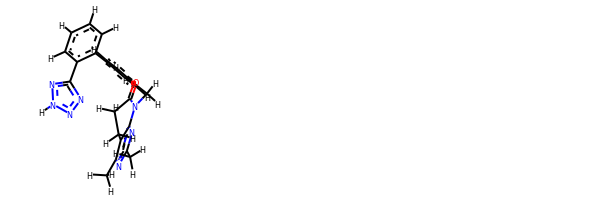

rdkit:  [H]c1c([H])c([H])c(-c2c([H])c([H])c(C([H])([H])N3C(=O)C([H])([H])C([H])([H])c4c3nc(C([H])([H])[H])nc4C([H])([H])[H])c([H])c2[H])c(-c2nnn([H])n2)c1[H]
oechem:  Cc1c2c(nc(n1)C)N(C(=O)CC2)Cc3ccc(cc3)c4ccccc4c5n[nH]nn5
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ####################

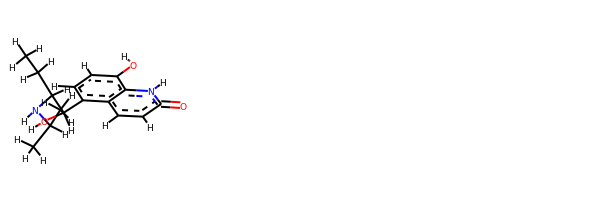

rdkit:  [H]Oc1c([H])c([H])c(C([H])(O[H])C([H])(N([H])C([H])(C([H])([H])[H])C([H])([H])[H])C([H])([H])C([H])([H])[H])c2c([H])c([H])c(=O)n([H])c12
oechem:  CCC(C(c1ccc(c2c1ccc(=O)[nH]2)O)O)NC(C)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #################################################

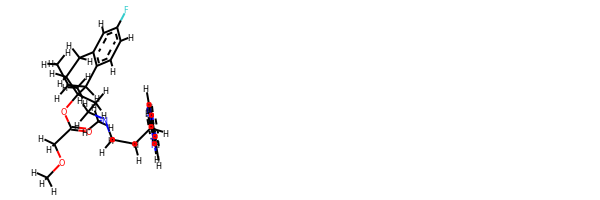

rdkit:  [H]c1c([H])c2c(c([H])c1F)C([H])([H])C([H])([H])C(OC(=O)C([H])([H])OC([H])([H])[H])(C([H])([H])C([H])([H])N(C([H])([H])[H])C([H])([H])C([H])([H])C([H])([H])c1nc3c([H])c([H])c([H])c([H])c3n1[H])C2([H])C([H])(C([H])([H])[H])C([H])([H])[H]
oechem:  CC(C)C1c2ccc(cc2CCC1(CCN(C)CCCc3[nH]c4ccccc4n3)OC(=O)COC)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
16.37656639163402 kJ/mol 57774.73888219762 kJ/mol False
angle
126.67551725249557 kJ/mol 128.03055222677278 kJ/mol False
nb
65.15582632119494 kJ/mol 65.15582632119494 kJ/mol True
torsion
55.05110597765226 kJ/mol 39.62728858145764 kJ/mol False
263.2590159429768 kJ/mol 58007.55254932704 kJ/mol

-------------------------------------------------------------------
--------------------------------------------------

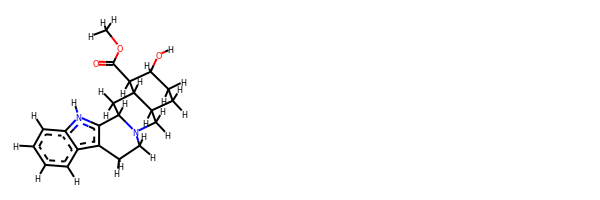

rdkit:  [H]OC1([H])C([H])([H])C([H])([H])C2([H])C([H])([H])N3C([H])([H])C([H])([H])c4c(n([H])c5c([H])c([H])c([H])c([H])c45)C3([H])C([H])([H])C2([H])C1([H])C(=O)OC([H])([H])[H]
oechem:  COC(=O)C1C(CCC2C1CC3c4c(c5ccccc5[nH]4)CCN3C2)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ###########

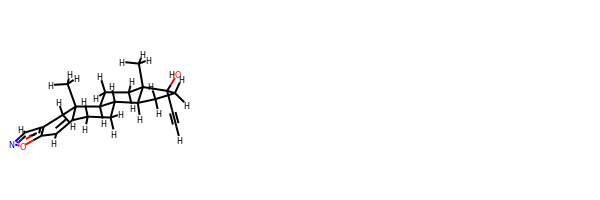

rdkit:  [H]C#CC1(O[H])C([H])([H])C([H])([H])C2([H])C3([H])C([H])([H])C([H])([H])C4=C([H])c5onc([H])c5C([H])([H])C4(C([H])([H])[H])C3([H])C([H])([H])C([H])([H])C12C([H])([H])[H]
oechem:  CC12CCC3C(C1CCC2(C#C)O)CCC4=Cc5c(cno5)CC34C
###########################################################################
 #########################################################

bond
74.39231179048842 kJ/mol 87648.39498869248 kJ/mol False
angle
445.76068221921093 kJ/mol 450.06613502884613 kJ/mol False
nb
31.88270005606317 kJ/mol 31.88270005606317 kJ/mol True
torsion
121.06056086602794 kJ/mol 108.00557218542355 kJ/mol False
673.0962549317904 kJ/mol 88238.34939596281 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1223


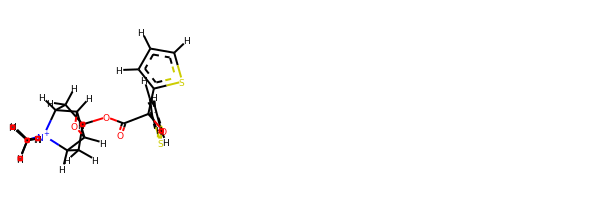

rdkit:  [H]OC(C(=O)OC1([H])C([H])([H])C2([H])C3([H])OC3([H])C([H])(C1([H])[H])[N+]2(C([H])([H])[H])C([H])([H])[H])(c1sc([H])c([H])c1[H])c1sc([H])c([H])c1[H]
oechem:  C[N+]1(C2CC(CC1C3C2O3)OC(=O)C(c4cccs4)(c5cccs5)O)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
40.89357599323169 kJ/mol 57528.480538190015 kJ/mol False
angle
111.52580858952159 kJ/mol 111.72001304850133 kJ/mol False
nb
115.26625703999991 kJ/mol 115.26625703999991 kJ/mol True
torsion
32.60678379519996 kJ/mol 22.144990252957086 kJ/mol False
300.29242541795315 kJ/mol 57777.61179853147 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
Drug

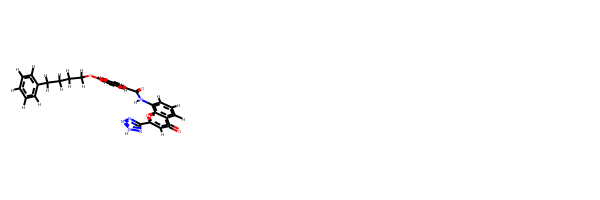

rdkit:  [H]c1c([H])c([H])c(C([H])([H])C([H])([H])C([H])([H])C([H])([H])Oc2c([H])c([H])c(C(=O)N([H])c3c([H])c([H])c([H])c4c(=O)c([H])c(-c5nnn([H])n5)oc34)c([H])c2[H])c([H])c1[H]
oechem:  c1ccc(cc1)CCCCOc2ccc(cc2)C(=O)Nc3cccc4c3oc(cc4=O)c5n[nH]nn5
###########################################################################
 #########################################################

bond
42.391250977459556 kJ/mol 170501.35475582737 kJ/mol False
angle
103.01183459572312 kJ/mol 103.87822179274133 kJ/mol False
nb
15.357622135461648 kJ/mol 15.357622135461648 kJ/mol True
torsion
33.472266498028915 kJ/mol 0.0005028513087739186 kJ/mol False
194.23297420667322 kJ/mol 170620.59110260688 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1226


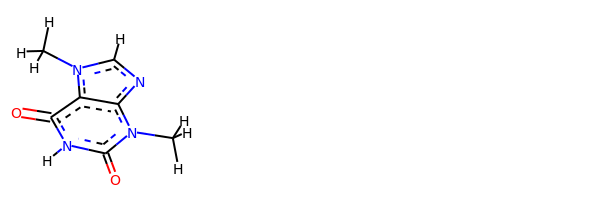

rdkit:  [H]c1nc2c(c(=O)n([H])c(=O)n2C([H])([H])[H])n1C([H])([H])[H]
oechem:  Cn1cnc2c1c(=O)[nH]c(=O)n2C
###########################################################################
 #########################################################

bond
49.47596232765665 kJ/mol 43722.19750449265 kJ/mol False
angle
660.4316604650858 kJ/mol 663.7869092839868 kJ/mol False
nb
1.6124136996022178 kJ/mol 1.6124136996022178 kJ/mol True
torsion
149.03212286196882 kJ/mol 132.2030194800691 kJ/mol False
860.5521593543135 kJ/mol 44519.79984695631 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1227


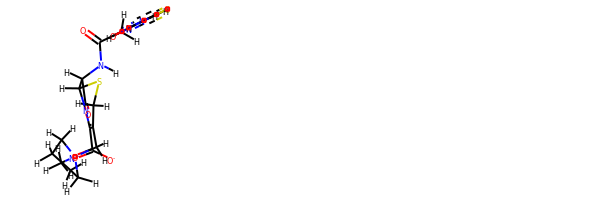

rdkit:  [H]c1sc(N([H])[H])nc1C(=NOC([H])([H])[H])C(=O)N([H])C1([H])C(=O)N2C(C(=O)[O-])=C(C([H])([H])[N+]3(C([H])([H])[H])C([H])([H])C([H])([H])C([H])([H])C3([H])[H])C([H])([H])SC21[H]
oechem:  C[N+]1(CCCC1)CC2=C(N3C(C(C3=O)NC(=O)C(=NOC)c4csc(n4)N)SC2)C(=O)[O-]
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
28.496825601228448 kJ/mol 43697.460138826755 kJ/mol False
angle
368.664772449117 kJ/mol 372.0230742392238 kJ/mol False
nb
8.324030361053977 kJ/mol 8.324030361053977 kJ/mol True
torsion
132.854398026675 kJ/mol 116.02524001137878 kJ/mol False
538.3400264380743 kJ/mol 44193.83248343841 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
----------------------------------

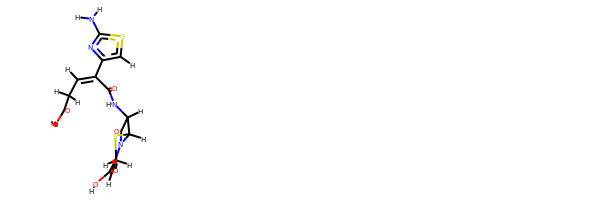

rdkit:  [H]OC(=O)C1=C([H])C([H])([H])SC2([H])N1C(=O)C2([H])N([H])C(=O)C(=C([H])C([H])([H])C(=O)O[H])c1nc(N([H])[H])sc1[H]
oechem:  c1c(nc(s1)N)C(=CCC(=O)O)C(=O)NC2C3N(C2=O)C(=CCS3)C(=O)O
###########################################################################
 #########################################################

bond
34.06278345055386 kJ/mol 43702.85403924285 kJ/mol False
angle
370.6171546024912 kJ/mol 373.9770479781332 kJ/mol False
nb
4.089970847573683 kJ/mol 4.089970847573683 kJ/mol True
torsion
113.64221184560735 kJ/mol 96.81305445116692 kJ/mol False
522.4121207462262 kJ/mol 44177.73411251973 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1230


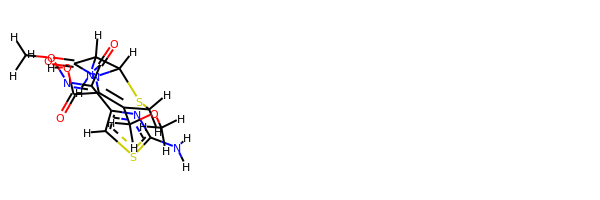

rdkit:  [H]OC(=O)C1=C(C([H])([H])OC([H])([H])[H])C([H])([H])SC2([H])N1C(=O)C2([H])N([H])C(=O)C(=NOC([H])([H])[H])c1nc(N([H])[H])sc1[H]
oechem:  COCC1=C(N2C(C(C2=O)NC(=O)C(=NOC)c3csc(n3)N)SC1)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
17.46221056715434 kJ/mol 56689.747757549456 kJ/mol False
angle
82.29405538754665 kJ/mol 82.29405538754665 kJ/mol True
nb
28.748953027568646 kJ/mol 28.748953027568646 kJ/mol True
torsion
77.89607153077966 kJ/mol 79.3661329996049 kJ/mol False
206.40129051

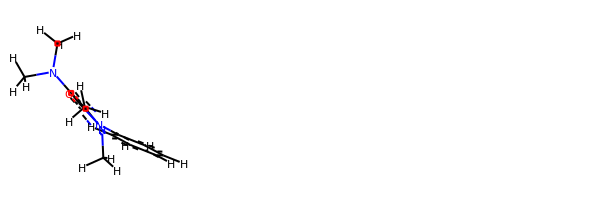

rdkit:  [H]c1c([H])c([H])c(-n2c(=O)c(N(C([H])([H])[H])C([H])([H])[H])c(C([H])([H])[H])n2C([H])([H])[H])c([H])c1[H]
oechem:  Cc1c(c(=O)n(n1C)c2ccccc2)N(C)C
###########################################################################
 #########################################################

bond
14.59072803422437 kJ/mol 57588.09077995397 kJ/mol False
angle
22.633187009895824 kJ/mol 22.858541238530965 kJ/mol False
nb
41.317812522418315 kJ/mol 41.317812522418315 kJ/mol True
torsion
22.071678810136365 kJ/mol 5.338200497334494 kJ/mol False
100.61340637667487 kJ/mol 57657.60533421225 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1240


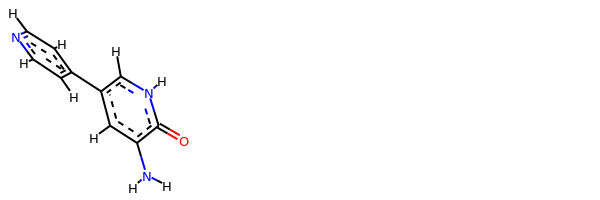

rdkit:  [H]c1nc([H])c([H])c(-c2c([H])c(N([H])[H])c(=O)n([H])c2[H])c1[H]
oechem:  c1cnccc1c2cc(c(=O)[nH]c2)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
15.035831935423397 kJ/mol 56813.73794350471 kJ/mol False
angle
78.93681

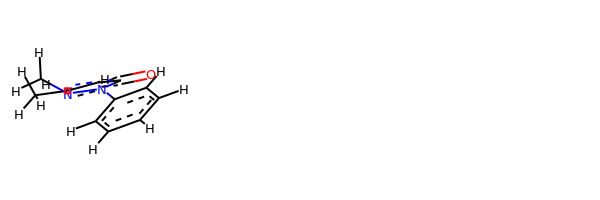

rdkit:  [H]c1c([H])c([H])c(-n2c(=O)c([H])c(C([H])([H])[H])n2C([H])([H])[H])c([H])c1[H]
oechem:  Cc1cc(=O)n(n1C)c2ccccc2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
15.677966563013943 kJ/mol 57770.381316187704 kJ/mol False
angle
87.56329650485198 kJ/mol 88.79273969654105 kJ/mol False
nb
619.2190031324095 kJ/mol 619.2190031324095 kJ/mol True
torsion
37.66980191410368 kJ/mol 37.66987357415466 kJ/mol False
760.1300681143791 kJ/mol 58516.0629325908 kJ/mol

---------------------------------------

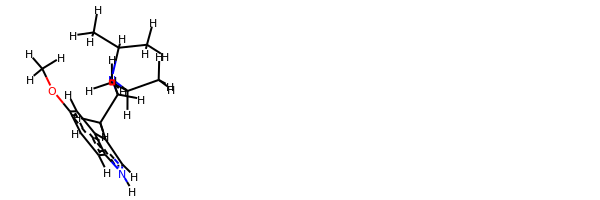

rdkit:  [H]c1c(OC([H])([H])[H])c([H])c2c(C([H])([H])C([H])([H])N(C([H])(C([H])([H])[H])C([H])([H])[H])C([H])(C([H])([H])[H])C([H])([H])[H])c([H])n([H])c2c1[H]
oechem:  CC(C)N(CCc1c[nH]c2c1cc(cc2)OC)C(C)C
###########################################################################
 #########################################################

bond
8.08431742949157 kJ/mol 57759.9896640963 kJ/mol False
angle
83.08171512019454 kJ/mol 84.311711199446 kJ/mol False
nb
17.106236261332096 kJ/mol 17.106236261332096 kJ/mol True
torsion
8.10325484615358 kJ/mol 8.103305702111141 kJ/mol False
116.3755236571718 kJ/mol 57869.510917259184 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1256


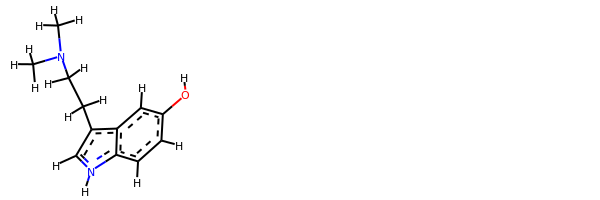

rdkit:  [H]Oc1c([H])c([H])c2c(c1[H])c(C([H])([H])C([H])([H])N(C([H])([H])[H])C([H])([H])[H])c([H])n2[H]
oechem:  CN(C)CCc1c[nH]c2c1cc(cc2)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
76.30228711805722 kJ/mol 110928.811633908 kJ/mol False
angle
100.91890257512264 kJ/mol 100.91890257512264 kJ/mol True
nb
103.5020075466793 kJ/mol 103.5020075466793 kJ/mol True
torsion
36.55593730911337 kJ/mol 21.595333929124003 kJ/mol False
317.27913454897254 kJ/mol 111154.82787795893 kJ/mol

-----------------

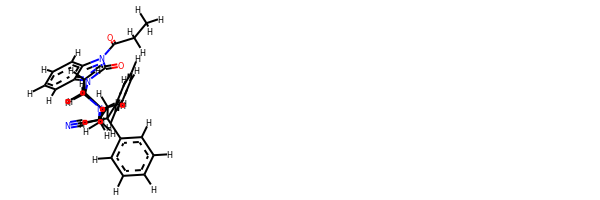

rdkit:  [H]c1c([H])c([H])c(C(C#N)(c2c([H])c([H])c([H])c([H])c2[H])C([H])([H])C([H])([H])N2C([H])([H])C([H])([H])C([H])(n3c(=O)n(C(=O)C([H])([H])C([H])([H])[H])c4c([H])c([H])c([H])c([H])c43)C([H])([H])C2([H])[H])c([H])c1[H]
oechem:  CCC(=O)n1c2ccccc2n(c1=O)C3CCN(CC3)CCC(C#N)(c4ccccc4)c5ccccc5
###########################################################################
 #########################################################

bond
11.364650251895187 kJ/mol 57762.21058896186 kJ/mol False
angle
84.64346247379765 kJ/mol 85.87452990020778 kJ/mol False
nb
70.29889400016602 kJ/mol 70.29889400016602 kJ/mol True
torsion
18.145596731501584 kJ/mol 18.145605699775174 kJ/mol False
184.45260345736045 kJ/mol 57936.52961856202 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1265


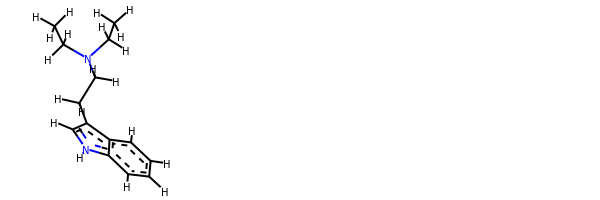

rdkit:  [H]c1c([H])c([H])c2c(c1[H])c(C([H])([H])C([H])([H])N(C([H])([H])C([H])([H])[H])C([H])([H])C([H])([H])[H])c([H])n2[H]
oechem:  CCN(CC)CCc1c[nH]c2c1cccc2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
27.668930215956046 kJ/mol 57942.78100187002 kJ/mol False
angle
92.589380380478 kJ/mol 92.589380380478 kJ/mol True
nb
95.54098403230367 kJ/mol 95.54098403230367 kJ/mol True
torsion
39.363047227820054 kJ/mol 36.575639760359664 kJ/mol False
255.1623418565578 kJ/mol 58167.487006043164 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1267


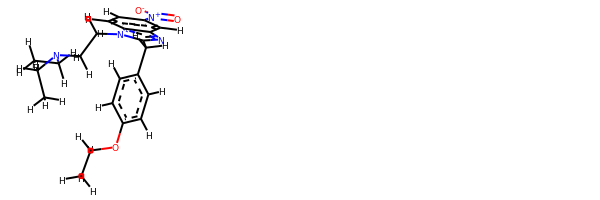

rdkit:  [H]c1c([H])c(C([H])([H])c2nc3c([H])c([N+](=O)[O-])c([H])c([H])c3n2C([H])([H])C([H])([H])N(C([H])([H])C([H])([H])[H])C([H])([H])C([H])([H])[H])c([H])c([H])c1OC([H])([H])C([H])([H])[H]
oechem:  CCN(CC)CCn1c2ccc(cc2nc1Cc3ccc(cc3)OCC)[N+](=O)[O-]
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

#####################################################################

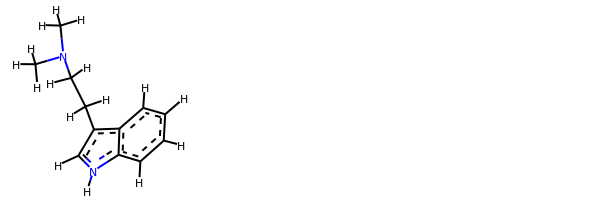

rdkit:  [H]c1c([H])c([H])c2c(c1[H])c(C([H])([H])C([H])([H])N(C([H])([H])[H])C([H])([H])[H])c([H])n2[H]
oechem:  CN(C)CCc1c[nH]c2c1cccc2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
15.035831935423397 kJ/mol 56813.73794350471 kJ/mol False
angle
78.93681877425215 kJ/mol 78.93681877425215 kJ/mol True
nb
27.981726516101048 kJ/mol 27.981726516101048 kJ/mol True
torsion
60.20900219632167 kJ/mol 61.50711487109073 kJ/mol False
182.16337942209827 kJ/mol 56982.16360366616 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
---------------------

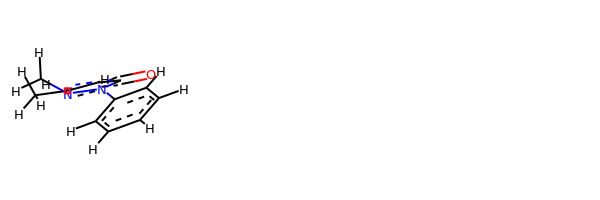

rdkit:  [H]c1c([H])c([H])c(-n2c(=O)c([H])c(C([H])([H])[H])n2C([H])([H])[H])c([H])c1[H]
oechem:  Cc1cc(=O)n(n1C)c2ccccc2
###########################################################################
 #########################################################

bond
22.390821170655617 kJ/mol 58389.90271623651 kJ/mol False
angle
126.39765323059851 kJ/mol 126.39765323059851 kJ/mol True
nb
25.00131077872714 kJ/mol 25.00131077872714 kJ/mol True
torsion
91.63304936769691 kJ/mol 91.6328408259107 kJ/mol False
265.4228345476782 kJ/mol 58632.934521071744 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1297


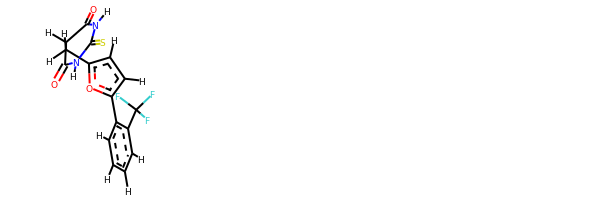

rdkit:  [H]c1c(-c2c([H])c([H])c([H])c([H])c2C(F)(F)F)oc(C([H])([H])C2([H])C(=O)N([H])C(=S)N([H])C2=O)c1[H]
oechem:  c1ccc(c(c1)c2ccc(o2)CC3C(=O)NC(=S)NC3=O)C(F)(F)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###################

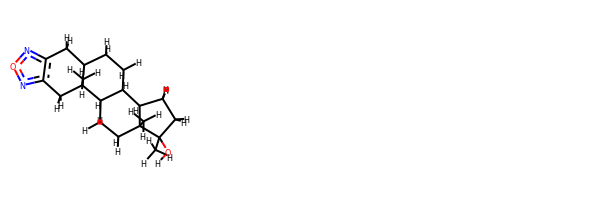

rdkit:  [H]OC1(C([H])([H])[H])C([H])([H])C([H])([H])C2([H])C3([H])C([H])([H])C([H])([H])C4([H])C([H])([H])c5nonc5C([H])([H])C4(C([H])([H])[H])C3([H])C([H])([H])C([H])([H])C21C([H])([H])[H]
oechem:  CC12CCC3C(C1CCC2(C)O)CCC4C3(Cc5c(non5)C4)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
12.14580808106108 kJ/mol 43800.762223604645 kJ/mol False
angle
43.14792617140751 kJ/mol 45.300874145333474 kJ/mol False
nb
102.6939037201129 kJ/mol 102.6939037201129 kJ/mol True
torsion
62.985522739461786 kJ/mol 30.106999373457832 kJ/mol False
220.9731607120433 kJ/mol 43978.86400084355 kJ/mol

---------------------------------------------------

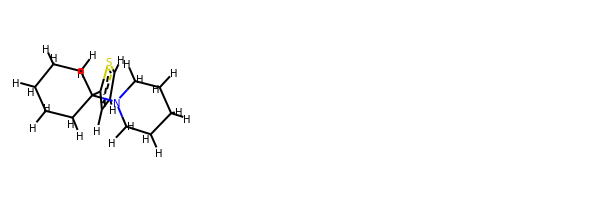

rdkit:  [H]c1sc(C2(N3C([H])([H])C([H])([H])C([H])([H])C([H])([H])C3([H])[H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C2([H])[H])c([H])c1[H]
oechem:  c1cc(sc1)C2(CCCCC2)N3CCCCC3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
20.326430385557504 kJ/mol 57935.43850203963 kJ/mol False
angle
90.80620607991884 kJ/mol 90.80620607991884 kJ/mol True
nb
93.42651596501737 kJ/mol 93.42651596501737 kJ/mol True
torsion
20.655842225114416 kJ/mol 17.86843475765401 kJ/mol False
225.2149946556081 kJ/mol 58137.53965884222 kJ/mol

-------------------------------------------------------------------
-----------------------------------------------

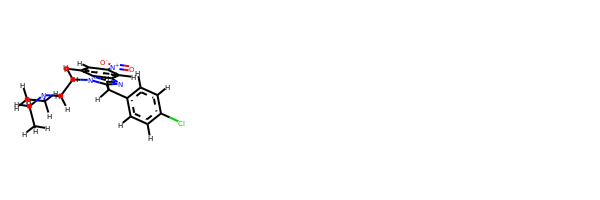

rdkit:  [H]c1c([H])c(C([H])([H])c2nc3c([H])c([N+](=O)[O-])c([H])c([H])c3n2C([H])([H])C([H])([H])N(C([H])([H])C([H])([H])[H])C([H])([H])C([H])([H])[H])c([H])c([H])c1Cl
oechem:  CCN(CC)CCn1c2ccc(cc2nc1Cc3ccc(cc3)Cl)[N+](=O)[O-]
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #################

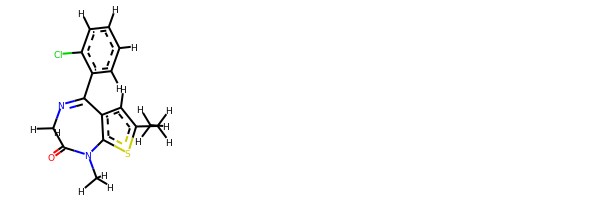

rdkit:  [H]c1c([H])c([H])c(C2=NC([H])([H])C(=O)N(C([H])([H])[H])c3sc(C([H])([H])C([H])([H])[H])c([H])c32)c(Cl)c1[H]
oechem:  CCc1cc2c(s1)N(C(=O)CN=C2c3ccccc3Cl)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

######################

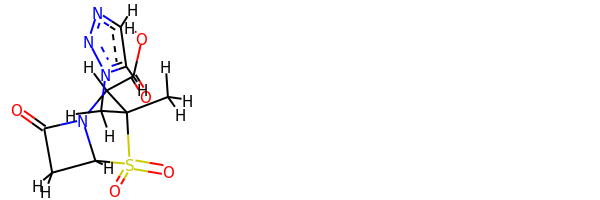

rdkit:  [H]OC(=O)C1([H])N2C(=O)C([H])([H])C2([H])S(=O)(=O)C1(C([H])([H])[H])C([H])([H])n1nnc([H])c1[H]
oechem:  CC1(C(N2C(S1(=O)=O)CC2=O)C(=O)O)Cn3ccnn3
###########################################################################
 #########################################################

bond
26.7173413969055 kJ/mol 43813.030089195425 kJ/mol False
angle
421.44297003900857 kJ/mol 423.59597999713725 kJ/mol False
nb
-9.387151108283682 kJ/mol -9.387151108283682 kJ/mol True
torsion
96.96554894463596 kJ/mol 86.1533134614997 kJ/mol False
535.7387092722664 kJ/mol 44313.39223154578 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1392


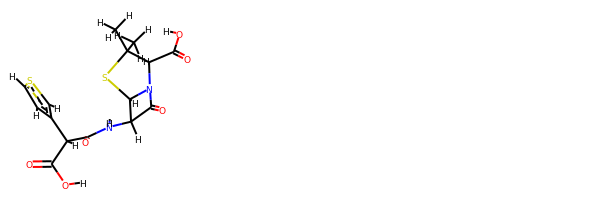

rdkit:  [H]OC(=O)C([H])(C(=O)N([H])C1([H])C(=O)N2C1([H])SC(C([H])([H])[H])(C([H])([H])[H])C2([H])C(=O)O[H])c1c([H])sc([H])c1[H]
oechem:  CC1(C(N2C(S1)C(C2=O)NC(=O)C(c3ccsc3)C(=O)O)C(=O)O)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
8.917923166740055 kJ/mol 29166.26924117135 kJ/mol False
angle
97.19889941178334 kJ/mol 97.19889941178334 kJ/mol True
nb
90.96807832483522 kJ/mol 90.96807832483522 kJ/mol True
torsion
34.71909600992158 kJ/mol 42.018434474886845 kJ/mol False
231.80399691328017 kJ/mol 29396.454653382858 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1394


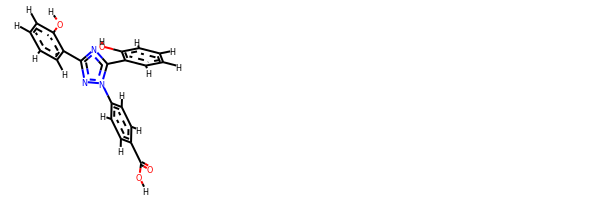

rdkit:  [H]OC(=O)c1c([H])c([H])c(-n2nc(-c3c([H])c([H])c([H])c([H])c3O[H])nc2-c2c([H])c([H])c([H])c([H])c2O[H])c([H])c1[H]
oechem:  c1ccc(c(c1)c2nc(n(n2)c3ccc(cc3)C(=O)O)c4ccccc4O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###

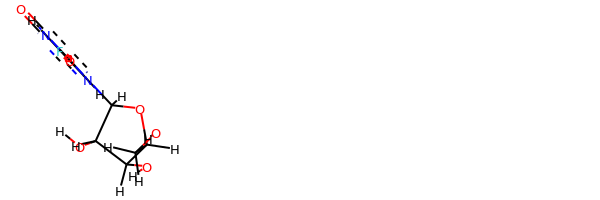

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])c(F)c(=O)n([H])c2=O)C([H])(O[H])C1([H])O[H]
oechem:  c1c(c(=O)[nH]c(=O)n1C2C(C(C(O2)CO)O)O)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
159.22478557561146 kJ/mol 149.6057705331

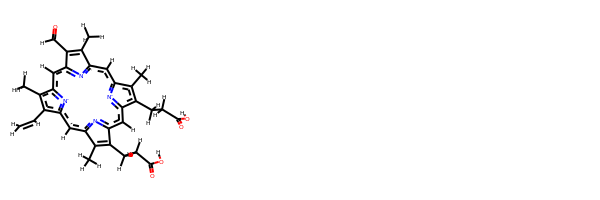

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])C1=C(C([H])([H])[H])c2nc1c([H])c1[n-]c(c([H])c3nc(c([H])c4[n-]c(c2[H])c(C([H])=C([H])[H])c4C([H])([H])[H])C(C([H])=O)=C3C([H])([H])[H])c(C([H])([H])[H])c1C([H])([H])C([H])([H])C(=O)O[H]
oechem:  Cc1c2cc3nc(cc4c(c(c([n-]4)cc5nc(cc(c1CCC(=O)O)[n-]2)C(=C5C)CCC(=O)O)C=C)C)C(=C3C)C=O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

b

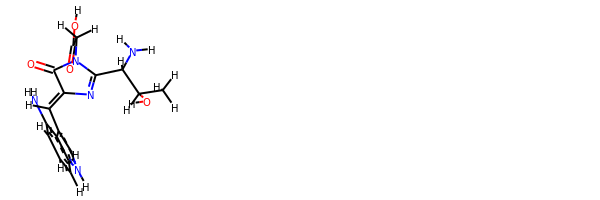

rdkit:  [H]OC(=O)C([H])([H])N1C(=O)C(=C([H])c2c([H])n([H])c3c([H])c([H])c([H])c(N([H])[H])c23)N=C1C([H])(N([H])[H])C([H])(O[H])C([H])([H])[H]
oechem:  CC(C(C1=NC(=Cc2c[nH]c3c2c(ccc3)N)C(=O)N1CC(=O)O)N)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
50.02273288878471 kJ/mol 113461.09507647507 kJ/mol False
angle
341.60030226251456 kJ/mol 342.22068005484505 kJ/mol False
nb
24.72693564856789 kJ/mol 24.72693564856789 kJ/mol True
torsion
115.65112854267359 kJ/mol 58.57756691017118 kJ/mol False
532.0010993425408 kJ/mol 113886.62025908865 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1427


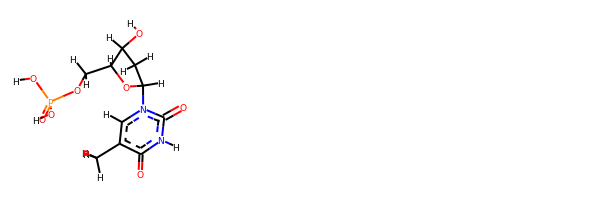

rdkit:  [H]OC1([H])C([H])([H])C([H])(n2c([H])c(C([H])([H])[H])c(=O)n([H])c2=O)OC1([H])C([H])([H])OP(=O)(O[H])O[H]
oechem:  Cc1cn(c(=O)[nH]c1=O)C2CC(C(O2)COP(=O)(O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
14.280351126617587 kJ/mol 57800.1197897203 kJ/mol False
angle
19.830584488671626 kJ/mol 19.830584488671626 kJ/mol True
nb
49.47435914531718 kJ/mol 49.47435914531718 kJ/mol True
torsion
15.601567465912245 kJ/mol 15.734134560566991 kJ/mol False
99.18686222651864 kJ/mol 57885.158867914855 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1429


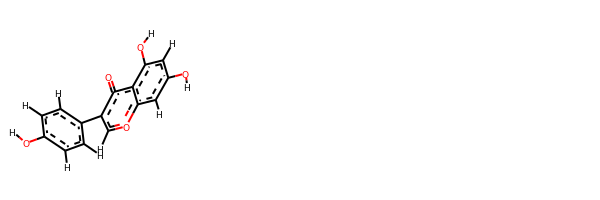

rdkit:  [H]Oc1c([H])c([H])c(-c2c([H])oc3c([H])c(O[H])c([H])c(O[H])c3c2=O)c([H])c1[H]
oechem:  c1cc(ccc1c2coc3cc(cc(c3c2=O)O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
14.859407998499035 kJ/mol 57767.38659481691 kJ/mol 

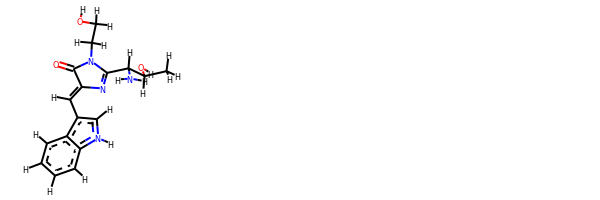

rdkit:  [H]OC([H])([H])C([H])([H])N1C(=O)C(=C([H])c2c([H])n([H])c3c([H])c([H])c([H])c([H])c23)N=C1C([H])(N([H])[H])C([H])(O[H])C([H])([H])[H]
oechem:  CC(C(C1=NC(=Cc2c[nH]c3c2cccc3)C(=O)N1CCO)N)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
25.580537681983113 kJ/mol 43706.69980114545 kJ/mol False
angle
113.90733963044556 kJ/mol 116.20703435481241 kJ/mol False
nb
22.047983176069955 kJ/mol 22.047983176069955 kJ/mol True
torsion
37.68812101444183 kJ/mol 13.300203653997594 kJ/mol False
199.22398

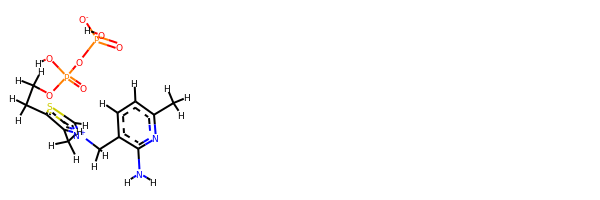

rdkit:  [H]OP(=O)([O-])OP(=O)(O[H])OC([H])([H])C([H])([H])c1sc([H])[n+](C([H])([H])c2c(N([H])[H])nc(C([H])([H])[H])c([H])c2[H])c1C([H])([H])[H]
oechem:  Cc1ccc(c(n1)N)C[n+]2csc(c2C)CCOP(=O)(O)OP(=O)(O)[O-]
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
11.416597755288613 kJ/mol 85693.83496214173 kJ/mol False
angle
130.0070261476448 kJ/mol 132.39660878198058 kJ/mol False
nb
-1.7250664830198366 kJ/mol -1.7250664830198366 kJ/mol True
torsion
4.967237935239016 kJ/mol 4.967261874593001 kJ/mol False
144.6657953551526 kJ/mol 85829.47376631529 kJ/mol

-------------------------------------------------------------------
----------------

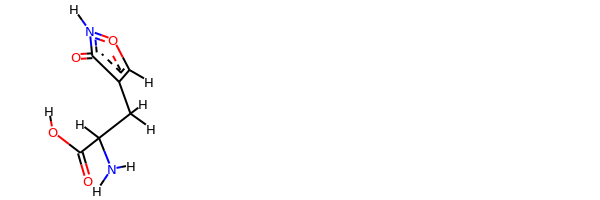

rdkit:  [H]OC(=O)C([H])(N([H])[H])C([H])([H])c1c([H])on([H])c1=O
oechem:  c1c(c(=O)[nH]o1)CC(C(=O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
8.93540505515507 kJ/mol 29171.16601146971 kJ/mol False
angle
96.60945244364135 kJ/mol 98.89721167802644 kJ/mol False
nb
18.27190743607007 kJ/mol 18.27190743607007 kJ/mol True
torsion
5.395389101707065 kJ/mol 0.16569176284931714 kJ/mol False
129.21215403657357 kJ/mol 29288.500822346658 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------

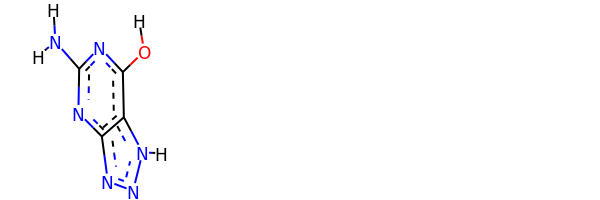

rdkit:  [H]Oc1nc(N([H])[H])nc2nnn([H])c12
oechem:  c12c(nc(nc1O)N)nn[nH]2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
38.55988968185368 kJ/mol 58209.87282158028 kJ/mol False
angle
341.0920787636199 kJ/mol 341.0920787636199 kJ/mol True
nb
14.07421562715521 kJ/mol 14.07421562715521 kJ/mol True
torsion
99.16916046199938 kJ/mol 94.50034260053067 kJ/mol False
492.8953445346281 kJ/mol 58659.53945857158 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1452


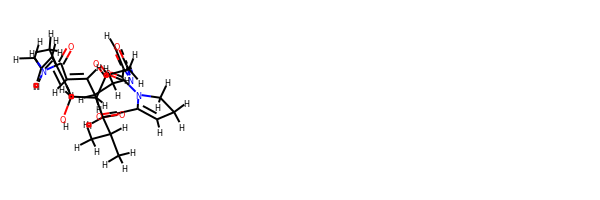

rdkit:  [H]OC1([H])C([H])=C(C([H])([H])[H])C([H])=C([H])C([H])([H])N([H])C(=O)C([H])=C([H])C([H])(C([H])([H])[H])C([H])(C([H])(C([H])([H])[H])C([H])([H])[H])OC(=O)C2=C([H])C([H])([H])C([H])([H])N2C(=O)c2nc(oc2[H])C([H])([H])C(=O)C1([H])[H]
oechem:  CC1C=CC(=O)NCC=CC(=CC(CC(=O)Cc2nc(co2)C(=O)N3CCC=C3C(=O)OC1C(C)C)O)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
86.65726922177602 kJ/mol 113359.1591924615 kJ/mol False
angle
423.67147724538034 kJ/mol 424.25914188318274 kJ/mol False
nb
3.084400270882202 kJ/mol 3.084400270882202 kJ/mol True
torsion
240.2494112494459 kJ/mol 183.2240950563565 kJ/mol False
753.6625579874844 kJ/mol 11

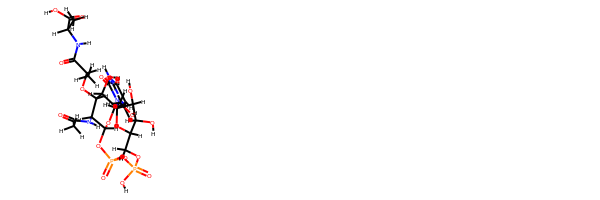

rdkit:  [H]OC(=O)C([H])(N([H])C(=O)C([H])(OC1([H])C([H])(O[H])C([H])(C([H])([H])O[H])OC([H])(OP(=O)(O[H])OP(=O)(O[H])OC([H])([H])C2([H])OC([H])(n3c([H])c([H])c(=O)n([H])c3=O)C([H])(O[H])C2([H])O[H])C1([H])N([H])C(=O)C([H])([H])[H])C([H])([H])[H])C([H])([H])[H]
oechem:  CC(C(=O)O)NC(=O)C(C)OC1C(C(OC(C1O)CO)OP(=O)(O)OP(=O)(O)OCC2C(C(C(O2)n3ccc(=O)[nH]c3=O)O)O)NC(=O)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ###########

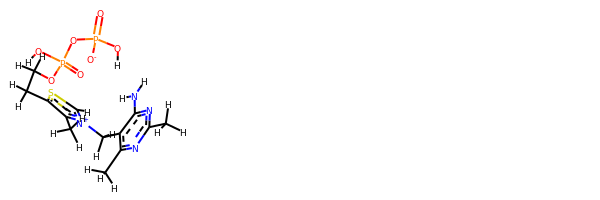

rdkit:  [H]OP(=O)([O-])OP(=O)(O[H])OC([H])([H])C([H])([H])c1sc([H])[n+](C([H])([H])c2c(N([H])[H])nc(C([H])([H])[H])nc2C([H])([H])[H])c1C([H])([H])[H]
oechem:  Cc1c(c(nc(n1)C)N)C[n+]2csc(c2C)CCOP(=O)(O)OP(=O)(O)[O-]
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
10.701322548838766 kJ/mol 29168.177885925044 kJ/mol False
angle
104.16360348254065 kJ/mol 106.52741932300887 kJ/mol False
nb
47.378687910535305 kJ/mol 47.378687910535305 kJ/mol True
torsion
5.231057311619549 kJ/mol 0.001058035139452108 kJ/mol False
167.47467125353427 kJ/mol 29322.08505119373 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
Dru

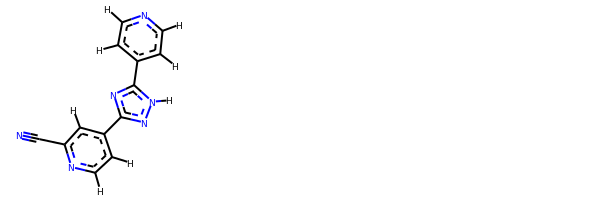

rdkit:  [H]c1nc(C#N)c([H])c(-c2nc(-c3c([H])c([H])nc([H])c3[H])n([H])n2)c1[H]
oechem:  c1cnccc1c2[nH]nc(n2)c3ccnc(c3)C#N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
24.64480590361735 kJ/mol 57777.59060624431 kJ/mol False
angle
103.78264714553285 kJ/mol 103.78264714553285 kJ/mol True
nb
26.528266738538193 kJ/mol 26.528266738538193 kJ/mol True
torsion
52.4080122578199 kJ/mol 52.40855591758078 kJ/mol False
207.3637320455083 kJ/mol 57960.310076045964 kJ/mol

-------------------------------------

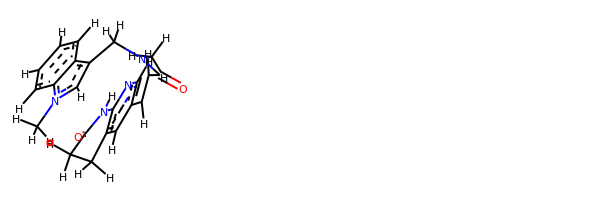

rdkit:  [H]C(C(=O)N(C([H])([H])[H])C([H])([H])c1c([H])n(C([H])([H])[H])c2c([H])c([H])c([H])c([H])c12)=C([H])c1c([H])nc2c(c1[H])C([H])([H])C([H])([H])C(=O)N2[H]
oechem:  Cn1cc(c2c1cccc2)CN(C)C(=O)C=Cc3cc4c(nc3)NC(=O)CC4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
39.128458103594795 kJ/mol 58059.70300080434 kJ/mol False
angle
404.9915790571457 kJ/mol 404.9915

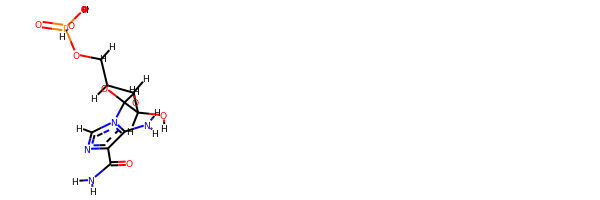

rdkit:  [H]OC1([H])C([H])(n2c([H])nc(C(=O)N([H])[H])c2N([H])[H])OC([H])(C([H])([H])OP(=O)(O[H])O[H])C1([H])O[H]
oechem:  c1nc(c(n1C2C(C(C(O2)COP(=O)(O)O)O)O)N)C(=O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

##################

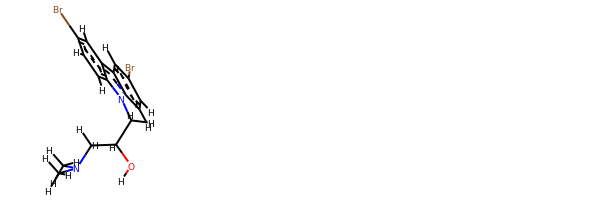

rdkit:  [H]OC([H])(C([H])([H])N(C([H])([H])[H])C([H])([H])[H])C([H])([H])n1c2c([H])c([H])c(Br)c([H])c2c2c([H])c(Br)c([H])c([H])c21
oechem:  CN(C)CC(Cn1c2ccc(cc2c3c1ccc(c3)Br)Br)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

#####

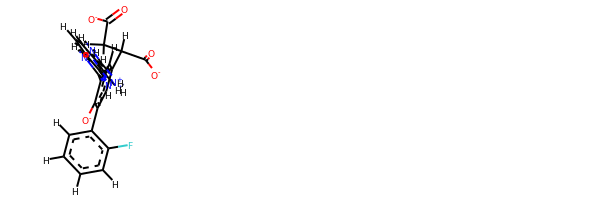

rdkit:  [H]c1c([H])c([H])c(-c2c([H])c(C([H])(C(=O)[O-])C([H])([H])C(=O)[O-])c([H])c(-c3nc4c([H])c(C(N([H])[H])=[N+]([H])[H])c([H])c([H])c4n3[H])c2[O-])c(F)c1[H]
oechem:  c1ccc(c(c1)c2cc(cc(c2[O-])c3[nH]c4ccc(cc4n3)C(=[NH2+])N)C(CC(=O)[O-])C(=O)[O-])F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

#####################################################################

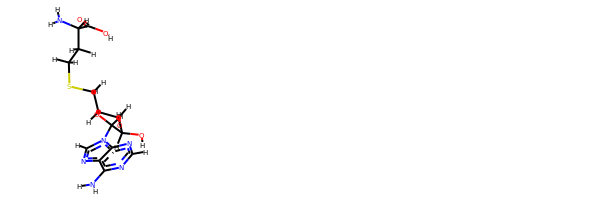

rdkit:  [H]OC(=O)C([H])(N([H])[H])C([H])([H])C([H])([H])SC([H])([H])C1([H])OC([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)C([H])(O[H])C1([H])O[H]
oechem:  c1nc(c2c(n1)n(cn2)C3C(C(C(O3)CSCCC(C(=O)O)N)O)O)N
###########################################################################
 #########################################################

bond
18.83514052309299 kJ/mol 55938.02165073329 kJ/mol False
angle
9.118732964245451 kJ/mol 9.118732964245451 kJ/mol True
nb
48.91471230861821 kJ/mol 48.91471230861821 kJ/mol True
torsion
0.000733101011575494 kJ/mol 0.0009355658442636022 kJ/mol False
76.86931889696822 kJ/mol 55996.056031572 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1529


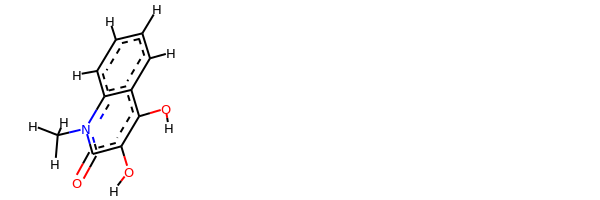

rdkit:  [H]Oc1c(O[H])c2c([H])c([H])c([H])c([H])c2n(C([H])([H])[H])c1=O
oechem:  Cn1c2ccccc2c(c(c1=O)O)O
###########################################################################
 #########################################################

bond
44.899823368621526 kJ/mol 58026.93445417684 kJ/mol False
angle
453.68176943663207 kJ/mol 453.68176943663207 kJ/mol True
nb
2.250653208657543 kJ/mol 2.250653208657543 kJ/mol True
torsion
159.3121274919641 kJ/mol 135.22146696547878 kJ/mol False
660.1443735058753 kJ/mol 58618.088343787604 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1530


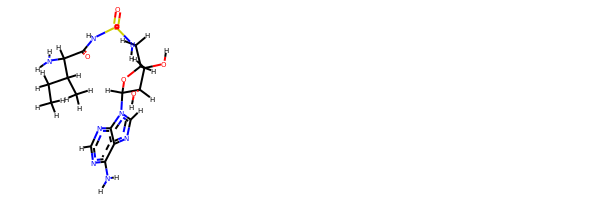

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)OC([H])(C([H])([H])N([H])S(=O)(=O)N([H])C(=O)C([H])(N([H])[H])C([H])(C([H])([H])[H])C([H])([H])C([H])([H])[H])C1([H])O[H]
oechem:  CCC(C)C(C(=O)NS(=O)(=O)NCC1C(C(C(O1)n2cnc3c2ncnc3N)O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
13.578064836352457 kJ/mol 57465.693281328924 kJ/mol False
angle
19.88514729903847 kJ/mol 19.88514729903847 kJ/mol True
nb
11.739819854032303 kJ/mol 11.739819854032303 kJ/mol True
torsion
0.0013628484112019727 kJ/mol 0.0014179396421027932 kJ/mol False
45.204394837834435 kJ/mol 57497.31966642163 kJ/mol

-----------------------------------

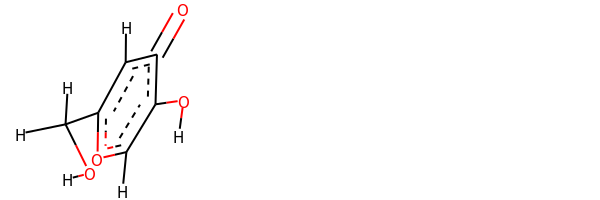

rdkit:  [H]Oc1c([H])oc(C([H])([H])O[H])c([H])c1=O
oechem:  c1c(occ(c1=O)O)CO
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
16.429575626876463 kJ/mol 58039.69162059424 kJ/mol False
angle
116.27796688629965 kJ/mol 116.27796688629965 kJ/mol True
nb
56.48269978084686 kJ/mol 56.48269978084686 kJ/mol True
torsion
53.903162957393796 kJ/mol 52.50148459136819 kJ/mol False
243.09340525141675 kJ/mol 58264.95377185276 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1535


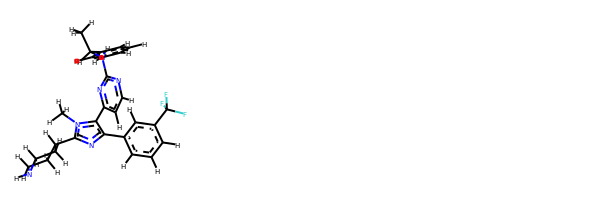

rdkit:  [H]c1nc(N([H])C([H])(c2c([H])c([H])c([H])c([H])c2[H])C([H])([H])[H])nc(-c2c(-c3c([H])c([H])c([H])c(C(F)(F)F)c3[H])nc(C3([H])C([H])([H])C([H])([H])N([H])C([H])([H])C3([H])[H])n2C([H])([H])[H])c1[H]
oechem:  CC(c1ccccc1)Nc2nccc(n2)c3c(nc(n3C)C4CCNCC4)c5cccc(c5)C(F)(F)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
48.5317610509731 kJ/mol 58189.108987342195 kJ/mol False
angle
451.8143576297848 kJ/mol 451.8143576297848 kJ/mol True
nb
111.49197654711244 kJ/mol 111.49197654711244 kJ/mol True
torsion
130.59592262902126 kJ/mol 126.61947547245488 kJ/mol False
742.4340178568916 kJ/mol 58879.03479699155 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-----------------

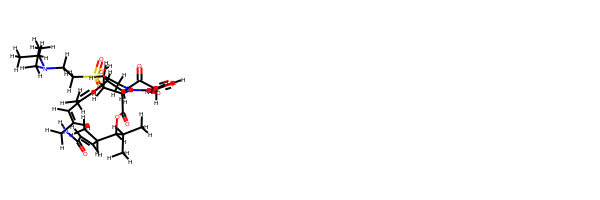

rdkit:  [H]OC1([H])C([H])=C(C([H])([H])[H])C([H])=C([H])C([H])([H])N([H])C(=O)C([H])=C([H])C([H])(C([H])([H])[H])C([H])(C([H])(C([H])([H])[H])C([H])([H])[H])OC(=O)C2([H])N(C(=O)c3nc(oc3[H])C([H])([H])C(=O)C1([H])[H])C([H])([H])C([H])([H])C2([H])S(=O)(=O)C([H])([H])C([H])([H])N(C([H])([H])C([H])([H])[H])C([H])([H])C([H])([H])[H]
oechem:  CCN(CC)CCS(=O)(=O)C1CCN2C1C(=O)OC(C(C=CC(=O)NCC=CC(=CC(CC(=O)Cc3nc(co3)C2=O)O)C)C)C(C)C
###########################################################################
 #########################################################

bond
18.01272974572346 kJ/mol 142445.3602865229 kJ/mol False
angle
111.84858173548317 kJ/mol 111.87613436009127 kJ/mol False
nb
39.39901588543593 kJ/mol 39.39901588543593 kJ/mol True
torsion
25.117594999638325 kJ/mol 11.467558665844573 kJ/mol False
194.37792236628087 kJ/mol 142608.10299543425 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------

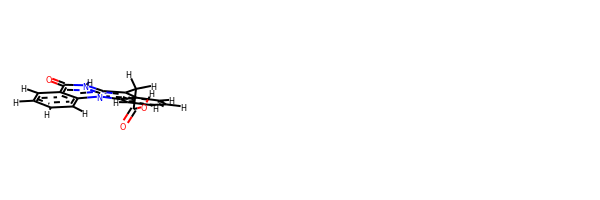

rdkit:  [H]OC(=O)C([H])([H])c1c2c([H])c([H])c([H])c([H])c2n2c3c([H])c([H])c([H])c([H])c3c(=O)n([H])c12
oechem:  c1ccc2c(c1)c(c3n2c4ccccc4c(=O)[nH]3)CC(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
47.37514253409964 kJ/mol 56723.72939886549 kJ/mol False
angle
56.54811241124568 kJ/mol 56.54811241124568 kJ/mol True
nb
144.88067104704382 kJ/mol 144.88067104704382 kJ/mol True
torsion
63.81729892334833 kJ/mol 63.81732730973086 kJ/mol False
312.62122491573746 kJ/mol 56988.975509633514 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1542


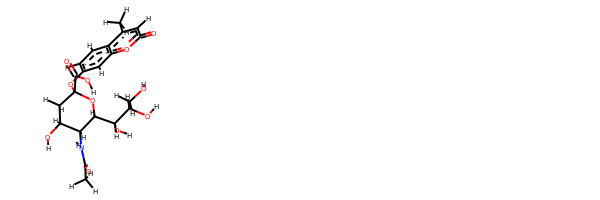

rdkit:  [H]OC(=O)C1(Oc2c([H])c([H])c3c(C([H])([H])[H])c([H])c(=O)oc3c2[H])OC([H])(C([H])(O[H])C([H])(O[H])C([H])([H])O[H])C([H])(N([H])C(=O)C([H])([H])[H])C([H])(O[H])C1([H])[H]
oechem:  Cc1cc(=O)oc2c1ccc(c2)OC3(CC(C(C(O3)C(C(CO)O)O)NC(=O)C)O)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
38.803341555427046 kJ/mol 57789.68286320476 kJ/mol False
angle
442.23501663975435 kJ/mol 443.4716820210243 kJ/mol False
nb
23.14106663802545 kJ/mol 23.14106663802545 kJ/mol True
torsion
111.16296971332376 kJ/mol 111.16300774575791 kJ/mol False
615.3423945465306 kJ/mol 58367.45861960957 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
------------------------------------------

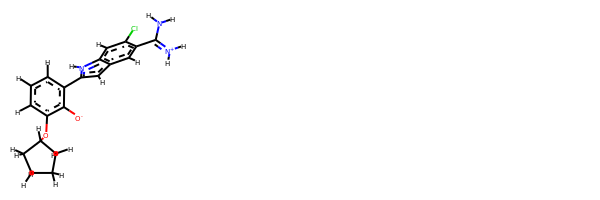

rdkit:  [H]c1c([H])c(OC2([H])C([H])([H])C([H])([H])C([H])([H])C2([H])[H])c([O-])c(-c2c([H])c3c([H])c(C(N([H])[H])=[N+]([H])[H])c(Cl)c([H])c3n2[H])c1[H]
oechem:  c1cc(c(c(c1)OC2CCCC2)[O-])c3cc4cc(c(cc4[nH]3)Cl)C(=[NH2+])N
###########################################################################
 #########################################################

bond
20.529643717065788 kJ/mol 57773.25662097966 kJ/mol False
angle
163.04871712067137 kJ/mol 163.04871712067137 kJ/mol True
nb
12.75839694779453 kJ/mol 12.75839694779453 kJ/mol True
torsion
40.269699323025115 kJ/mol 40.269947930240555 kJ/mol False
236.6064571085568 kJ/mol 57989.33368297836 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1545


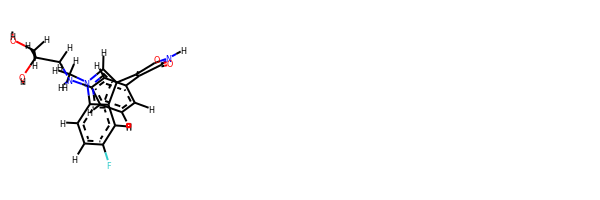

rdkit:  [H]OC([H])([H])C([H])(O[H])C([H])([H])N([H])c1c([H])c([H])c([H])c(C2=C(c3c([H])n(C([H])([H])[H])c4c([H])c([H])c(F)c([H])c34)C(=O)N([H])C2=O)c1[H]
oechem:  Cn1cc(c2c1ccc(c2)F)C3=C(C(=O)NC3=O)c4cccc(c4)NCC(CO)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ##########################

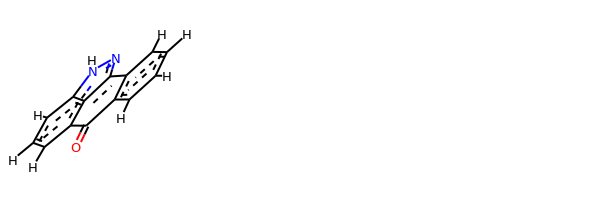

rdkit:  [H]c1c([H])c([H])c2c(c1[H])C(=O)c1c([H])c([H])c([H])c3c1c-2nn3[H]
oechem:  c1ccc2c(c1)-c3c4c(cccc4[nH]n3)C2=O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
34.52839397924086 kJ/mol 58017.33545573551 kJ/mol False
angle
431.784281992525 kJ/mol 431.784281992525 kJ/mol True
nb
16.19752106335736 kJ/mol 16.19752106335736 kJ/mol True
torsion
92.8615784251782

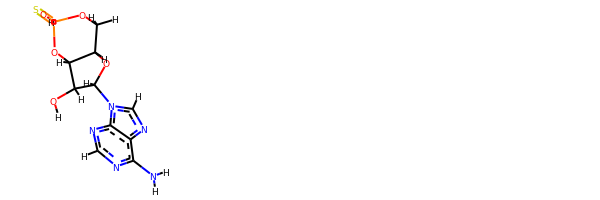

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)OC2([H])C([H])([H])OP(=S)(O[H])OC21[H]
oechem:  c1nc(c2c(n1)n(cn2)C3C(C4C(O3)COP(=S)(O4)O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
40.873646963800624 kJ/mol 57742.97561571428 kJ/mol False
angle
55.38788145115037 kJ/mol 55.68354602988263 kJ/mol False
nb
24.334975761218747 kJ/mol 24.334975761218747 kJ/mol True
torsion
57.299373990083986 kJ/mol 40.59921116584795 kJ/mol False
177.8958781662537 kJ/mol 57863.593348671224 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------


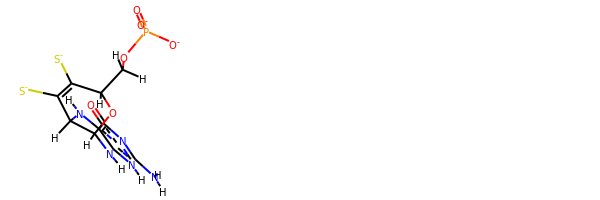

rdkit:  [H]N([H])c1nc(=O)c2c(n1[H])N([H])C1([H])OC([H])(C([H])([H])OP(=O)([O-])[O-])C([S-])=C([S-])C1([H])N2[H]
oechem:  C(C1C(=C(C2C(O1)Nc3c(c(=O)nc([nH]3)N)N2)[S-])[S-])OP(=O)([O-])[O-]
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #######################################################

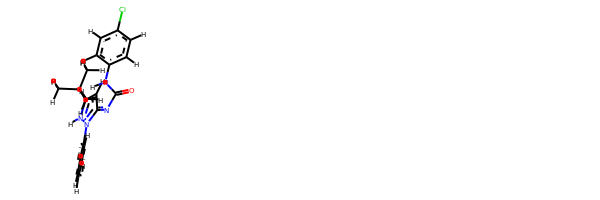

rdkit:  [H]c1c([H])c([H])c(-n2c(=NC(=O)N([H])c3c([H])c([H])c(Cl)c([H])c3[H])c([H])c(C(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H])n2[H])c([H])c1[H]
oechem:  CC(C)(C)c1cc(=NC(=O)Nc2ccc(cc2)Cl)n([nH]1)c3ccccc3
###########################################################################
 #########################################################

bond
14.503428263899265 kJ/mol 29099.132262395367 kJ/mol False
angle
118.04359250189418 kJ/mol 118.04359250189418 kJ/mol True
nb
41.86122167606622 kJ/mol 41.86122167606622 kJ/mol True
torsion
13.90519923078519 kJ/mol 21.22731458176402 kJ/mol False
188.31344167264484 kJ/mol 29280.26439115509 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1578


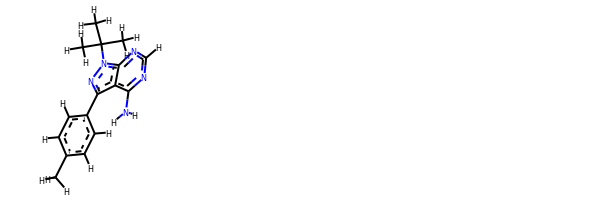

rdkit:  [H]c1nc(N([H])[H])c2c(-c3c([H])c([H])c(C([H])([H])[H])c([H])c3[H])nn(C(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H])c2n1
oechem:  Cc1ccc(cc1)c2c3c(ncnc3n(n2)C(C)(C)C)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
31.448833095661833 kJ/mol 58014.12344361361 kJ/mol False
angle
442.1605183069852 kJ/mol 442.1605183069852 kJ/mol True
nb
16.007756582042234 kJ/mol 16.007756582042234 kJ/mol True
torsion
111.02748831452878 kJ/mol 86.93662744450714 kJ/mol False
600.644596299218 kJ/mol 58559.22834594714 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1580


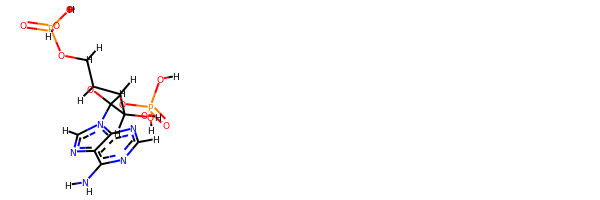

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)OC([H])(C([H])([H])OP(=O)(O[H])O[H])C1([H])OP(=O)(O[H])O[H]
oechem:  c1nc(c2c(n1)n(cn2)C3C(C(C(O3)COP(=O)(O)O)OP(=O)(O)O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

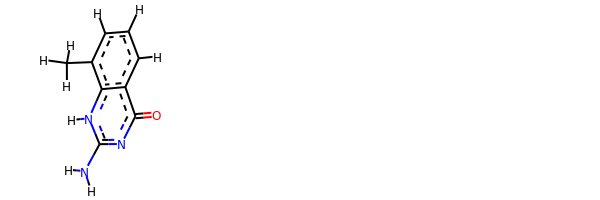

rdkit:  [H]c1c([H])c(C([H])([H])[H])c2c(c1[H])c(=O)nc(N([H])[H])n2[H]
oechem:  Cc1cccc2c1[nH]c(nc2=O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
54.14288658838516 kJ/mol 58036.14475892038 kJ/mol False
angle
523.2721795779435 kJ/mol 523.2721795779435 kJ/mol True
nb
28.286470290865964 kJ/mol 28.286470290865964 kJ/mol True
torsion
129.43387232529193 kJ/mol 105.79994660865724 kJ/mol False
735.1354087824866 kJ/mol 58693.50335539784 kJ/mol

------------------------------------------------------

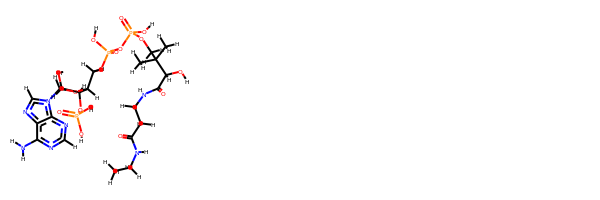

rdkit:  [H]OC([H])(C(=O)N([H])C([H])([H])C([H])([H])C(=O)N([H])C([H])([H])C([H])([H])[H])C(C([H])([H])[H])(C([H])([H])[H])C([H])([H])OP(=O)(O[H])OP(=O)(O[H])OC([H])([H])C1([H])OC([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)C([H])(O[H])C1([H])OP(=O)(O[H])O[H]
oechem:  CCNC(=O)CCNC(=O)C(C(C)(C)COP(=O)(O)OP(=O)(O)OCC1C(C(C(O1)n2cnc3c2ncnc3N)O)OP(=O)(O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ############################

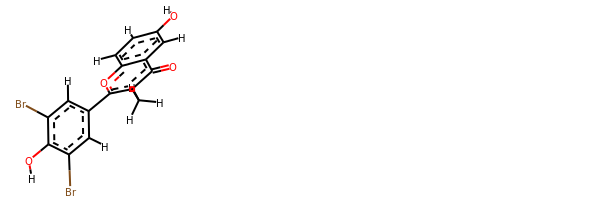

rdkit:  [H]Oc1c(Br)c([H])c(-c2oc3c([H])c([H])c(O[H])c([H])c3c(=O)c2C([H])([H])[H])c([H])c1Br
oechem:  Cc1c(=O)c2cc(ccc2oc1c3cc(c(c(c3)Br)O)Br)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

########################################

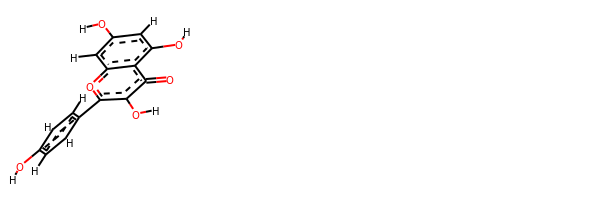

rdkit:  [H]Oc1c([H])c([H])c(-c2oc3c([H])c(O[H])c([H])c(O[H])c3c(=O)c2O[H])c([H])c1[H]
oechem:  c1cc(ccc1c2c(c(=O)c3c(cc(cc3o2)O)O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
35.14966289466235 kJ/mol 29103.74726211151 kJ/mol False
angle
281.62848451737597 kJ/mol 283.2672492072506 kJ/mol False
nb
13.088762266290809 kJ/mol 13.088762266290809 kJ/mol True
to

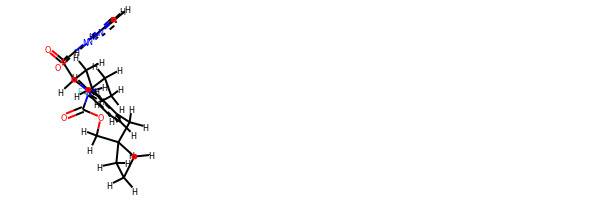

rdkit:  [H]c1nn([H])c(N([H])C(=O)C(=O)C([H])(N([H])C(=O)OC([H])([H])C2(C([H])([H])c3c([H])c([H])c(F)c([H])c3[H])C([H])([H])C([H])([H])C2([H])[H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])[H])c1[H]
oechem:  CCCCC(C(=O)C(=O)Nc1ccn[nH]1)NC(=O)OCC2(CCC2)Cc3ccc(cc3)F
###########################################################################
 #########################################################

bond
32.562166531064506 kJ/mol 58016.00166154155 kJ/mol False
angle
494.73013114925294 kJ/mol 494.73013114925294 kJ/mol True
nb
-10.022646331062392 kJ/mol -10.022646331062392 kJ/mol True
torsion
100.69814049496645 kJ/mol 76.67837794990014 kJ/mol False
617.9677918442214 kJ/mol 58577.38752430965 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1627


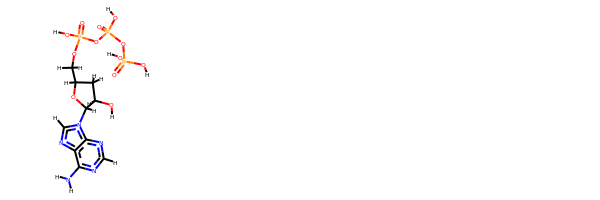

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)OC([H])(C([H])([H])OP(=O)(O[H])OP(=O)(O[H])OP(=O)(O[H])O[H])C1([H])[H]
oechem:  c1nc(c2c(n1)n(cn2)C3C(CC(O3)COP(=O)(O)OP(=O)(O)OP(=O)(O)O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
22.314039789238972 kJ/mol 57773.882422687006 kJ/mol False
angle
96.52861746395936 kJ/mol 96.52861746395936 kJ/mol True
nb
46.86620640034211 kJ/mol 46.86620640034211 kJ/mol True
torsion
37.47817838814845 kJ/mol 19.941107899819478 kJ/mol False
203.18704204168887 kJ/mol 57937.21835445113 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1632


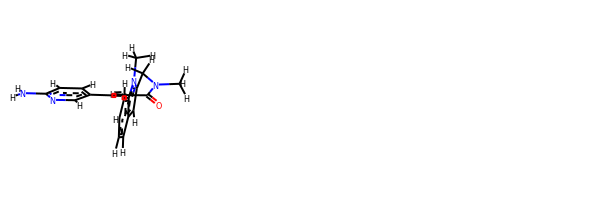

rdkit:  [H]C(C(=O)N(C([H])([H])[H])C([H])([H])c1c([H])c2c([H])c([H])c([H])c([H])c2n1C([H])([H])[H])=C([H])c1c([H])nc(N([H])[H])c([H])c1[H]
oechem:  Cn1c2ccccc2cc1CN(C)C(=O)C=Cc3ccc(nc3)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ########################################################

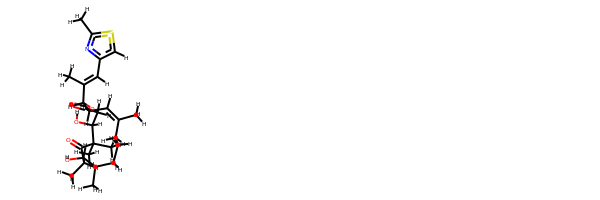

rdkit:  [H]OC1([H])C([H])(C([H])([H])[H])C(=O)C(C([H])([H])[H])(C([H])([H])[H])C([H])(O[H])C([H])([H])C(=O)OC([H])(C(=C([H])c2nc(C([H])([H])[H])sc2[H])C([H])([H])[H])C([H])([H])C([H])=C(C([H])([H])[H])C([H])([H])C([H])([H])C([H])([H])C1([H])C([H])([H])[H]
oechem:  Cc1nc(cs1)C=C(C)C2CC=C(CCCC(C(C(C(=O)C(C(CC(=O)O2)O)(C)C)C)O)C)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #################################################

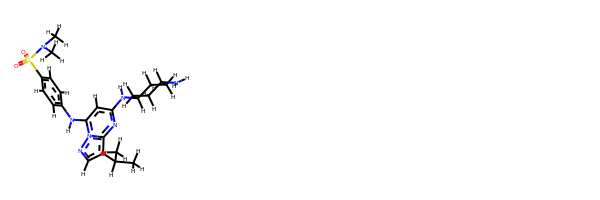

rdkit:  [H]c1nn2c(N([H])c3c([H])c([H])c(S(=O)(=O)N(C([H])([H])[H])C([H])([H])[H])c([H])c3[H])c([H])c(N([H])C3([H])C([H])([H])C([H])([H])C([H])(N([H])[H])C([H])([H])C3([H])[H])nc2c1C([H])(C([H])([H])[H])C([H])([H])[H]
oechem:  CC(C)c1cnn2c1nc(cc2Nc3ccc(cc3)S(=O)(=O)N(C)C)NC4CCC(CC4)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
30.82817275976937 kJ/mol 58013.50278327773 kJ/mol False
angle
460.19709763739485 kJ/mol 460.19709763739485 kJ/mol True
nb
13.734766615473426 kJ/mol 13.734766615473426 kJ/mol True
torsion
98.99585136725153 kJ/mol 74.90499049722986 kJ/mol False
603.7558883798891 kJ/mol 58562.33963802782 kJ/mol

---------

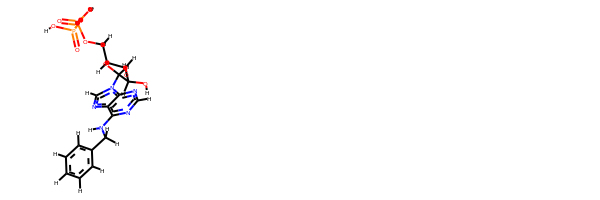

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c(N([H])C([H])([H])c4c([H])c([H])c([H])c([H])c4[H])nc([H])nc32)OC([H])(C([H])([H])OP(=O)(O[H])OP(=O)(O[H])O[H])C1([H])O[H]
oechem:  c1ccc(cc1)CNc2c3c(ncn2)n(cn3)C4C(C(C(O4)COP(=O)(O)OP(=O)(O)O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
28.027423469401263 kJ/mol 58010.70203398736 kJ/mol False
angle
470.83481800650884 kJ/mol 470.83481800650884 kJ/mol True
nb
3.1357347065324386 kJ/mol 3.1357347065324386 kJ/mol True
torsion
109.83966730418864 kJ/mol 85.74880643416694 kJ/mol False
611.8376434866311 kJ/mol 58570.42139313457 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
---------------------------------------------------------

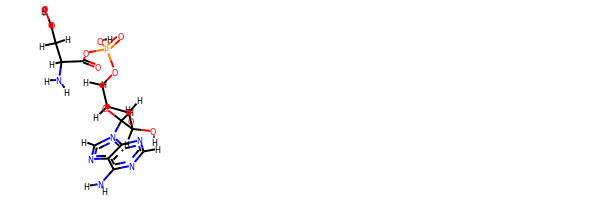

rdkit:  [H]OC(=O)C([H])([H])C([H])(C(=O)OP(=O)(O[H])OC([H])([H])C1([H])OC([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)C([H])(O[H])C1([H])O[H])N([H])[H]
oechem:  c1nc(c2c(n1)n(cn2)C3C(C(C(O3)COP(=O)(O)OC(=O)C(CC(=O)O)N)O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
39.262416765718925 kJ/mol 101300.70867663952 kJ/mol False
angle
154.99490915360437 kJ/mol 159.13969545216395 kJ/mol False
nb
61.70488826704877 kJ/mol 61.70488826704877 kJ/mol True
torsion
92.87885292762927 kJ/mol 43.20677794987186 kJ/mol False
348.84106711400136 kJ/mol 101564.76003830861 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
Dr

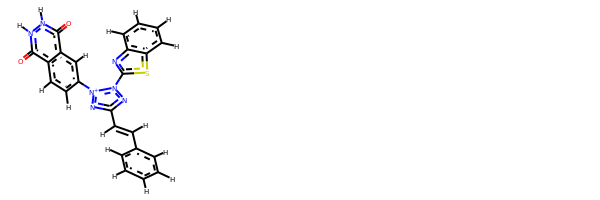

rdkit:  [H]C(=C([H])c1c([H])c([H])c([H])c([H])c1[H])c1nn(-c2nc3c([H])c([H])c([H])c([H])c3s2)[n+](-c2c([H])c([H])c3c(=O)n([H])n([H])c(=O)c3c2[H])n1
oechem:  c1ccc(cc1)C=Cc2nn([n+](n2)c3ccc4c(c3)c(=O)[nH][nH]c4=O)c5nc6ccccc6s5
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
23.038336816541566 kJ/mol 58542.57332090661 kJ/mol False
angle
146.58622715521523 kJ/mol 147.33175640946965 kJ/mol False
nb
-4.9292952097880445 kJ/mol -4.9292952097880445 kJ/mol True
torsion
64.97527390460017 kJ/mol 76.22848059990133 kJ/mol False
229.6705426665689 kJ/mol 58761.20426270619 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
----------------------------------------------------------------

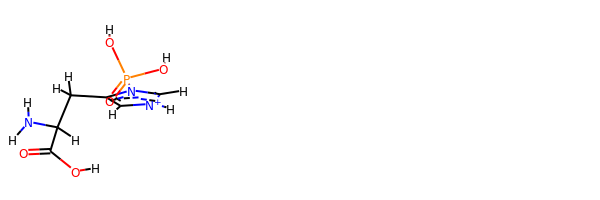

rdkit:  [H]OC(=O)C([H])(N([H])[H])C([H])([H])c1c([H])[n+]([H])c([H])n1P(=O)(O[H])O[H]
oechem:  c1c(n(c[nH+]1)P(=O)(O)O)CC(C(=O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
50.76515026108701 kJ/mol 113418.42705652634 kJ/mol False
angle
338.30786619814984 kJ/mol 338.9458114238683 kJ/mol False
nb
22.78417620916466 kJ/mol 22.78417620916466 kJ/mol True
torsion
120.56836065613727 kJ/mol 63.5025847266025 kJ/mol False
532.4255533245388 kJ/mol 113843.65962888599 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1664


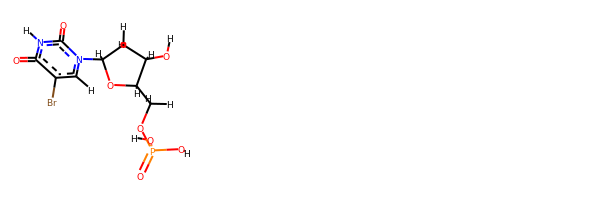

rdkit:  [H]OC1([H])C([H])([H])C([H])(n2c([H])c(Br)c(=O)n([H])c2=O)OC1([H])C([H])([H])OP(=O)(O[H])O[H]
oechem:  c1c(c(=O)[nH]c(=O)n1C2CC(C(O2)COP(=O)(O)O)O)Br
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
16.23991788365791 kJ/mol 57931.351989537725 kJ/mol False
angle
80.51591104138376 kJ/mol 82.42318581708415 kJ/mol False
nb
73.20219904261084 kJ/mol 73.20219904261084 kJ/mol True
torsion
18.84080239508905 kJ/mol 21.97968401869586 kJ/mol False
188.79883036274157 kJ/mol 58108.95705841611 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1666


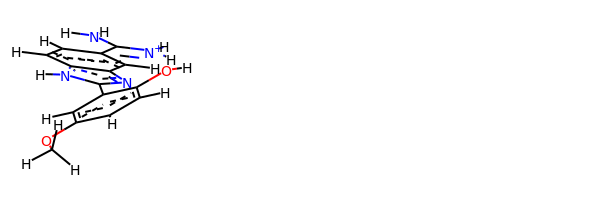

rdkit:  [H]Oc1c([H])c([H])c(OC([H])([H])[H])c([H])c1-c1nc2c([H])c(C(N([H])[H])=[N+]([H])[H])c([H])c([H])c2n1[H]
oechem:  COc1ccc(c(c1)c2[nH]c3ccc(cc3n2)C(=[NH2+])N)O
###########################################################################
 #########################################################

bond
21.04705085578263 kJ/mol 14.001161399992242 kJ/mol False
angle
120.66854840851124 kJ/mol 120.66854840851124 kJ/mol True
nb
62.20841392389267 kJ/mol 62.20841392389267 kJ/mol True
torsion
26.526158200160896 kJ/mol 16.066152314359808 kJ/mol False
230.45017138834743 kJ/mol 212.94427604675596 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1667


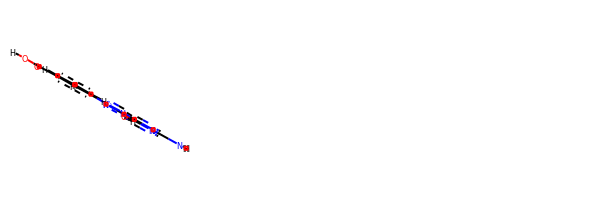

rdkit:  [H]OC(=O)c1c([H])c([H])c([H])c(-n2nc3nc(N([H])[H])nc(O[H])c3n2)c1[H]
oechem:  c1cc(cc(c1)n2nc3c(n2)nc(nc3O)N)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
26.845583431179964 kJ/mol 58007.243682961096 kJ/mol False
angle
461.46404539976805 kJ/mol 461.46404539976805 kJ/mol True
nb
20.454215771650507 kJ/mol 20.454215771650507 kJ/mol True
torsion
103.21221068863144 kJ/mol 78.86293370940416 kJ/mol False
611.9760552912301 kJ/mol 58568.02487784192 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1670


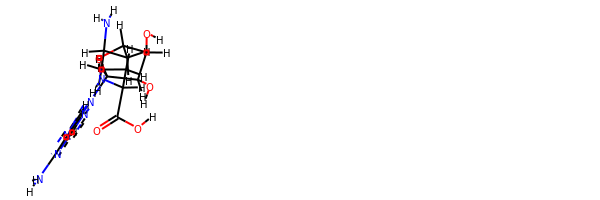

rdkit:  [H]OC(=O)C([H])(N([H])[H])C([H])([H])C([H])([H])C([H])(N([H])[H])C([H])([H])C1([H])OC([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)C([H])(O[H])C1([H])O[H]
oechem:  c1nc(c2c(n1)n(cn2)C3C(C(C(O3)CC(CCC(C(=O)O)N)N)O)O)N
###########################################################################
 #########################################################

bond
107.23547723716025 kJ/mol 115436.9312643794 kJ/mol False
angle
397.82654602685966 kJ/mol 398.47744360448746 kJ/mol False
nb
480.46883282808716 kJ/mol 480.46883282808716 kJ/mol True
torsion
56.050152519254624 kJ/mol 97.42422439164758 kJ/mol False
1041.5810086113618 kJ/mol 116413.30176520362 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1671


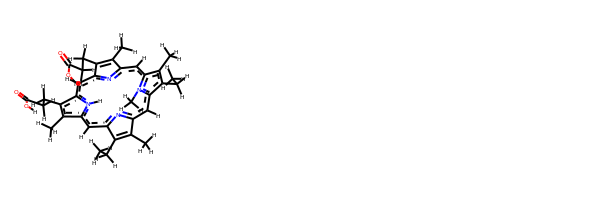

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])C1=C(C([H])([H])[H])c2nc1c([H])c1c(C([H])([H])C([H])([H])C(=O)O[H])c(C([H])([H])[H])c(c([H])c3nc(c([H])c4c(C([H])([H])C([H])([H])[H])c(C([H])([H])[H])c(c2[H])n4C([H])([H])[H])C(C([H])([H])[H])=C3C([H])([H])C([H])([H])[H])n1[H]
oechem:  CCc1c(c2cc3nc(cc4c(c(c([nH]4)cc5nc(cc1n2C)C(=C5CC)C)C)CCC(=O)O)C(=C3C)CCC(=O)O)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #######################

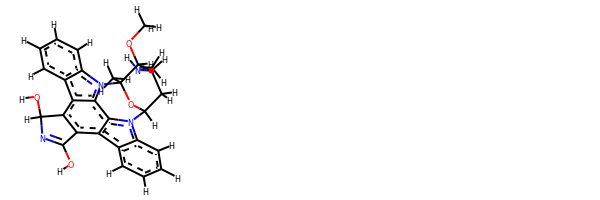

rdkit:  [H]OC1=NC([H])(O[H])c2c1c1c3c([H])c([H])c([H])c([H])c3n3c1c1c2c2c([H])c([H])c([H])c([H])c2n1C1(C([H])([H])[H])OC3([H])C([H])([H])C([H])(N([H])C([H])([H])[H])C1([H])OC([H])([H])[H]
oechem:  CC12C(C(CC(O1)n3c4ccccc4c5c3c6n2c7ccccc7c6c8c5C(=NC8O)O)NC)OC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
40.92072038470435 kJ/mol 114167.78451291959 kJ/mol False
angle
428.82731825885827 kJ/mol 429.17913200190696 kJ/mol False
nb
4.330492675945726 kJ/mol 4.330492675945726 kJ/mol True
torsion
137.0

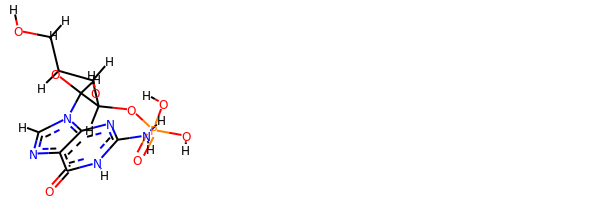

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])nc3c(=O)n([H])c(N([H])[H])nc32)C([H])(OP(=O)(O[H])O[H])C1([H])O[H]
oechem:  c1nc2c(=O)[nH]c(nc2n1C3C(C(C(O3)CO)O)OP(=O)(O)O)N
###########################################################################
 #########################################################

bond
16.928956614479898 kJ/mol 58038.63832354106 kJ/mol False
angle
123.79605410983824 kJ/mol 125.80628314652685 kJ/mol False
nb
47.27336901824271 kJ/mol 47.27336901824271 kJ/mol True
torsion
25.312664919391562 kJ/mol 24.990085646155336 kJ/mol False
213.3110446619524 kJ/mol 58236.70806135199 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1694


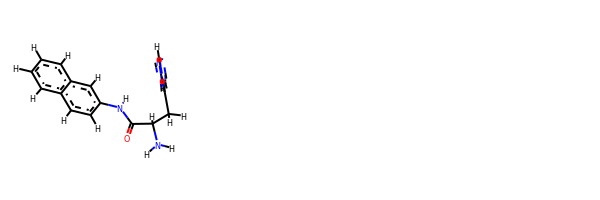

rdkit:  [H]c1nc([H])n([H])c1C([H])([H])C([H])(C(=O)N([H])c1c([H])c([H])c2c([H])c([H])c([H])c([H])c2c1[H])N([H])[H]
oechem:  c1ccc2cc(ccc2c1)NC(=O)C(Cc3cnc[nH]3)N
###########################################################################
 #########################################################

bond
8.310890580529977 kJ/mol 57923.422962234596 kJ/mol False
angle
78.36998597698337 kJ/mol 80.27411331464036 kJ/mol False
nb
25.54600404675136 kJ/mol 25.54600404675136 kJ/mol True
torsion
16.74580837772038 kJ/mol 16.745782626999 kJ/mol False
128.97268898198507 kJ/mol 58045.988862222985 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1695


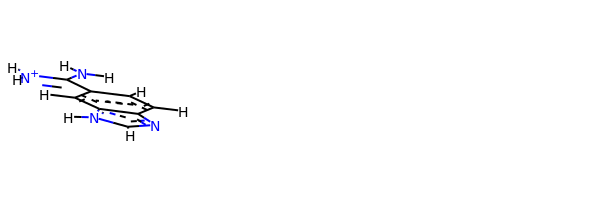

rdkit:  [H]c1c(C(N([H])[H])=[N+]([H])[H])c([H])c2c(nc([H])n2[H])c1[H]
oechem:  c1cc2c(cc1C(=[NH2+])N)[nH]cn2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
20.24022592160288 kJ/mol 115526.2291041267 kJ/mol False
angle
255.0061

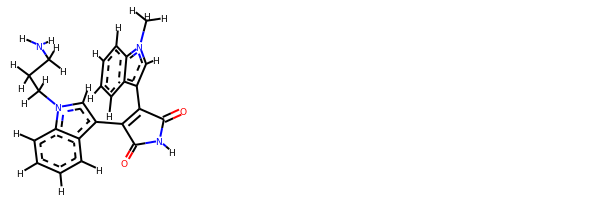

rdkit:  [H]c1c([H])c([H])c2c(c1[H])c(C1=C(c3c([H])n(C([H])([H])C([H])([H])C([H])([H])N([H])[H])c4c([H])c([H])c([H])c([H])c34)C(=O)N([H])C1=O)c([H])n2C([H])([H])[H]
oechem:  Cn1cc(c2c1cccc2)C3=C(C(=O)NC3=O)c4cn(c5c4cccc5)CCCN
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
36.00176755041778 kJ/mol 43708.735466533864 kJ/mol False
angle
68.54554837660974 kJ/mol 71.90157079669314 kJ/mol False
nb
36.02152794402633 kJ/mol 36.02152794402633 kJ/mol True
torsion
10.46296096550702 kJ/mol 10.4631411119637

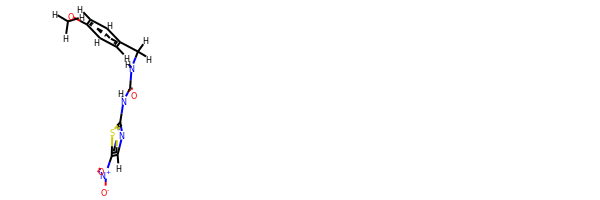

rdkit:  [H]c1nc(N([H])C(=O)N([H])C([H])([H])c2c([H])c([H])c(OC([H])([H])[H])c([H])c2[H])sc1[N+](=O)[O-]
oechem:  COc1ccc(cc1)CNC(=O)Nc2ncc(s2)[N+](=O)[O-]
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
8.618307814729388 kJ/mol 57759.07277532511 kJ/mol False
angle
90.43390634424901 kJ/mol 91.66339701951183 kJ/mol False
nb
19.710069207857536 kJ/mol 19.710069207857536 kJ/mol True
torsion
0.22894075781786583 kJ/mol 0.22893912239317027 kJ/mol False
118.9912241246538 kJ/mol 57870.67518067488 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1707


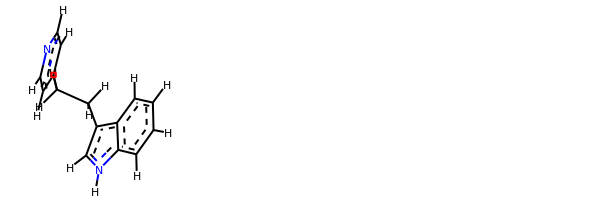

rdkit:  [H]c1nc([H])c([H])c(C([H])([H])C([H])([H])c2c([H])n([H])c3c([H])c([H])c([H])c([H])c23)c1[H]
oechem:  c1ccc2c(c1)c(c[nH]2)CCc3ccncc3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
30.90358471289336 kJ/mol 29098.84147443084 kJ/mol False
angle
101.24477977049612 kJ/mol 101.24477977049612 kJ/mol True
nb
28.586658987395765 kJ/mol 28.586658987395765 kJ/mol T

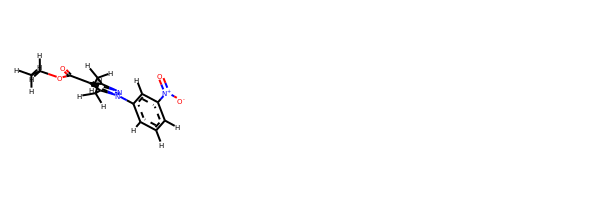

rdkit:  [H]c1c([H])c(-n2nc(C([H])([H])[H])c(C(=O)OC([H])([H])C([H])([H])[H])c2C([H])([H])[H])c([H])c([N+](=O)[O-])c1[H]
oechem:  CCOC(=O)c1c(nn(c1C)c2cccc(c2)[N+](=O)[O-])C
###########################################################################
 #########################################################

bond
35.02320130058847 kJ/mol 56981.920892132795 kJ/mol False
angle
507.50574413429484 kJ/mol 507.7345122085746 kJ/mol False
nb
-9.117723775466226 kJ/mol -9.117723775466226 kJ/mol True
torsion
110.13810757990592 kJ/mol 76.67575331487011 kJ/mol False
643.549329239323 kJ/mol 57557.213433880774 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1714


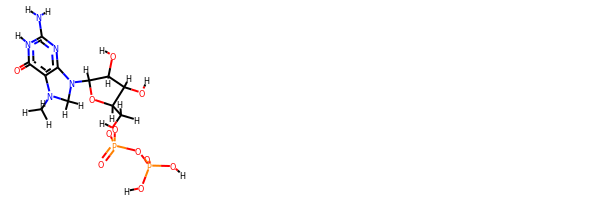

rdkit:  [H]OC1([H])C([H])(N2c3nc(N([H])[H])n([H])c(=O)c3N(C([H])([H])[H])C2([H])[H])OC([H])(C([H])([H])OP(=O)(O[H])OP(=O)(O[H])O[H])C1([H])O[H]
oechem:  CN1CN(c2c1c(=O)[nH]c(n2)N)C3C(C(C(O3)COP(=O)(O)OP(=O)(O)O)O)O
###########################################################################
 #########################################################

bond
38.4795193942957 kJ/mol 56504.443490345635 kJ/mol False
angle
326.58385086293964 kJ/mol 326.58385086293964 kJ/mol True
nb
23.071674774386896 kJ/mol 23.071674774386896 kJ/mol True
torsion
118.55088029398313 kJ/mol 78.26172753282518 kJ/mol False
506.6859253256054 kJ/mol 56932.36074351578 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1715


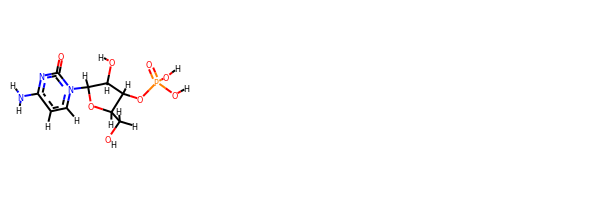

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])c([H])c(N([H])[H])nc2=O)C([H])(O[H])C1([H])OP(=O)(O[H])O[H]
oechem:  c1cn(c(=O)nc1N)C2C(C(C(O2)CO)OP(=O)(O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
30.621427216818145 kJ/mol 44192.58248120427 kJ/mol False
angle
117.25413110680542 kJ/mol 119.73464218609217 kJ/mol False
nb
23.32665554868681 kJ/mol 23.32665554868681 kJ/mol True
torsion
194.32272415664144 kJ/mol 194.32689649018332 kJ/mol False
365.5249380289518 kJ/mol 44529.97067542923 kJ/mol

-------------------------------------------------------------------
------------------------------------------------------------------

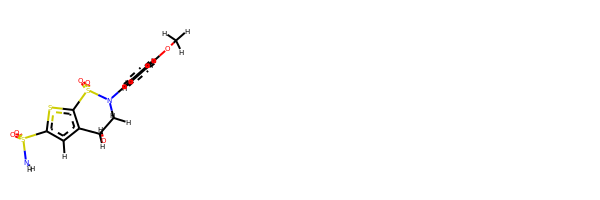

rdkit:  [H]OC1([H])c2c(sc(S(=O)(=O)N([H])[H])c2[H])S(=O)(=O)N(c2c([H])c([H])c(OC([H])([H])[H])c([H])c2[H])C1([H])[H]
oechem:  COc1ccc(cc1)N2CC(c3cc(sc3S2(=O)=O)S(=O)(=O)N)O
###########################################################################
 #########################################################

bond
56.0035797801984 kJ/mol 113388.7650108021 kJ/mol False
angle
398.83575532523207 kJ/mol 399.42419584720574 kJ/mol False
nb
3.6680793319311054 kJ/mol 3.6680793319311054 kJ/mol True
torsion
264.17255881527586 kJ/mol 207.1069736717851 kJ/mol False
722.6799732526375 kJ/mol 113998.96425965303 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1719


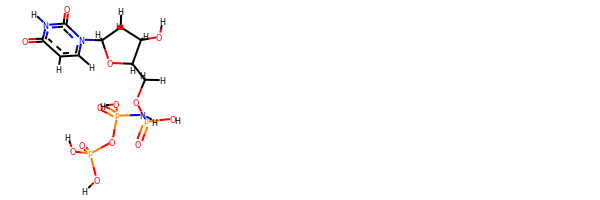

rdkit:  [H]OC1([H])C([H])([H])C([H])(n2c([H])c([H])c(=O)n([H])c2=O)OC1([H])C([H])([H])OP(=O)(O[H])N([H])P(=O)(O[H])OP(=O)(O[H])O[H]
oechem:  c1cn(c(=O)[nH]c1=O)C2CC(C(O2)COP(=O)(NP(=O)(O)OP(=O)(O)O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
12.328421375388304 kJ/mol 57771.766984685964 kJ/mol False
angle
157.03022307960103 kJ/mol 157.03022307960103 kJ/mol True
nb
113.32787143307567 kJ/mol 113.32787143307567 kJ/mol True
torsion
63.36330966297997 kJ/mol 48.61569296365169 kJ/mol False
346.04982555104493 kJ/mol 58090.74077216229 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1721


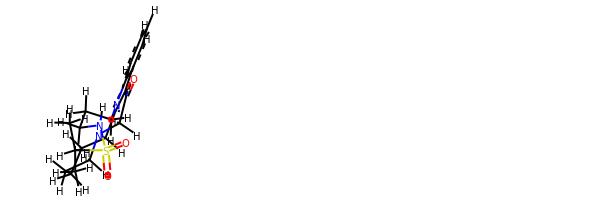

rdkit:  [H]c1c([H])c([H])c2c(c1[H])c1c(n2C([H])([H])C([H])([H])C([H])([H])N([H])S(=O)(=O)C([H])(C([H])([H])[H])C([H])([H])[H])C2([H])N(C([H])([H])C1=O)C([H])([H])C([H])([H])C([H])([H])C2([H])[H]
oechem:  CC(C)S(=O)(=O)NCCCn1c2ccccc2c3c1C4CCCCN4CC3=O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
54.65515871238159 kJ/mol 58036.11355434106 kJ/mol False
angle
521.1759196014218 kJ/mol 521.1759196014218 kJ/mol True
nb
10.840328956438775 kJ/mol 10.840328956438775 kJ/mol True
torsion
138.52813776312567 kJ/mol 114.4364690616859 kJ/mol False
725.1995450333677 kJ/mol 58682.566271960604 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------

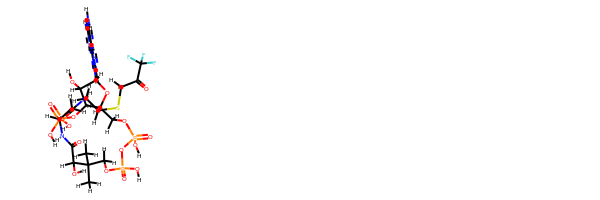

rdkit:  [H]OC([H])(C(=O)N([H])C([H])([H])C([H])([H])C(=O)N([H])C([H])([H])C([H])([H])SC([H])([H])C(=O)C(F)(F)F)C(C([H])([H])[H])(C([H])([H])[H])C([H])([H])OP(=O)(O[H])OP(=O)(O[H])OC([H])([H])C1([H])OC([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)C([H])(O[H])C1([H])OP(=O)(O[H])O[H]
oechem:  CC(C)(COP(=O)(O)OP(=O)(O)OCC1C(C(C(O1)n2cnc3c2ncnc3N)O)OP(=O)(O)O)C(C(=O)NCCC(=O)NCCSCC(=O)C(F)(F)F)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
12.95786521949005 kJ/mol 58033.215531262176 kJ/mol False
angle
104.54144002355318 kJ/mol 106.5502478898199 kJ/mol False
nb
3.4801781195288144 kJ/mol 3.4801781195288144 kJ/mol True
torsion
18.453915031893512 kJ/mol 18.45393054788801 kJ/mol False
139.43339839446554 kJ/mol 58161.69988781941 kJ/mol

--------------------------------------

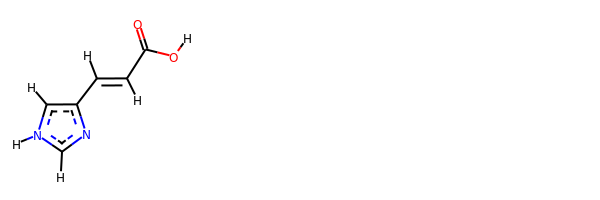

rdkit:  [H]OC(=O)C([H])=C([H])c1nc([H])n([H])c1[H]
oechem:  c1c(nc[nH]1)C=CC(=O)O
###########################################################################
 #########################################################

bond
41.097841931134624 kJ/mol 114167.96163446603 kJ/mol False
angle
428.77056767906345 kJ/mol 429.12238142211214 kJ/mol False
nb
8.249206362482804 kJ/mol 8.249206362482804 kJ/mol True
torsion
131.7674680730407 kJ/mol 74.18306603686781 kJ/mol False
609.8850840457216 kJ/mol 114679.5162882875 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1726


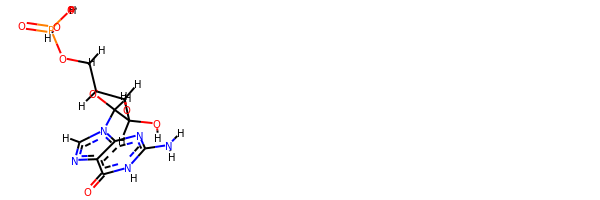

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c(=O)n([H])c(N([H])[H])nc32)OC([H])(C([H])([H])OP(=O)(O[H])O[H])C1([H])O[H]
oechem:  c1nc2c(=O)[nH]c(nc2n1C3C(C(C(O3)COP(=O)(O)O)O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
17.907926303390465 kJ/mol 58500.81745379177 kJ/mol False
angle
99.82671322156564 kJ/mol 99.82671322156564 kJ/mol True
nb
14.197757380897018 kJ/mol 14.197757380897018 kJ/mol True
torsion
6.4435537003992245 kJ/mol 0.16509400301360522 kJ/mol False
138.37595060625236 kJ/mol 58615.00

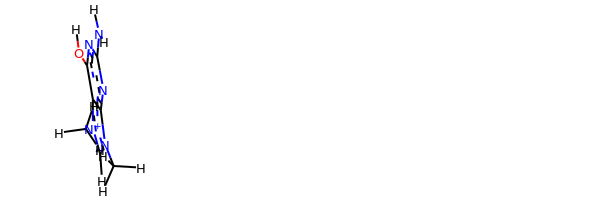

rdkit:  [H]Oc1nc(N([H])[H])nc2c1[n+](C([H])([H])[H])c([H])n2C([H])([H])[H]
oechem:  Cn1c[n+](c2c1nc(nc2O)N)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
25.838376310353027 kJ/mol 43706.95763977382 kJ/mol False
angle
125.269

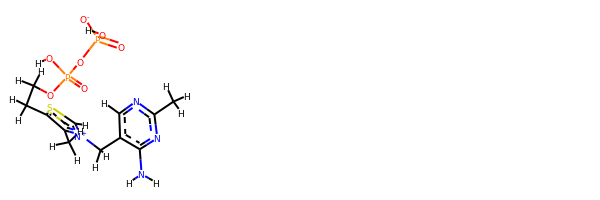

rdkit:  [H]OP(=O)([O-])OP(=O)(O[H])OC([H])([H])C([H])([H])c1sc([H])[n+](C([H])([H])c2c([H])nc(C([H])([H])[H])nc2N([H])[H])c1C([H])([H])[H]
oechem:  Cc1c(sc[n+]1Cc2cnc(nc2N)C)CCOP(=O)(O)OP(=O)(O)[O-]
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ############################################

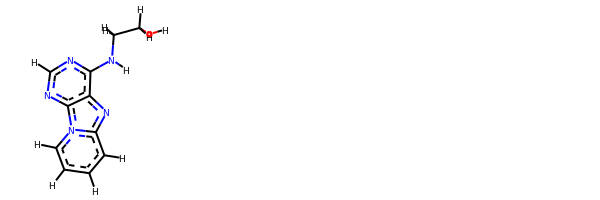

rdkit:  [H]OC([H])([H])C([H])([H])N([H])c1nc([H])nc2c1nc1c([H])c([H])c([H])c([H])n12
oechem:  c1ccn2c(c1)nc3c2ncnc3NCCO
###########################################################################
 #########################################################

bond
40.005231061321886 kJ/mol 56573.822632382624 kJ/mol False
angle
328.93769664525456 kJ/mol 328.93769664525456 kJ/mol True
nb
23.338644424601 kJ/mol 23.338644424601 kJ/mol True
torsion
114.01610932873365 kJ/mol 73.72676676230076 kJ/mol False
506.2976814599111 kJ/mol 56999.82574021478 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1749


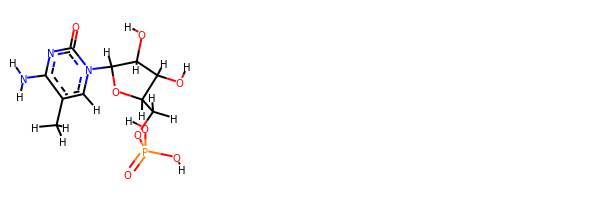

rdkit:  [H]OC1([H])C([H])(n2c([H])c(C([H])([H])[H])c(N([H])[H])nc2=O)OC([H])(C([H])([H])OP(=O)(O[H])O[H])C1([H])O[H]
oechem:  Cc1cn(c(=O)nc1N)C2C(C(C(O2)COP(=O)(O)O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###############

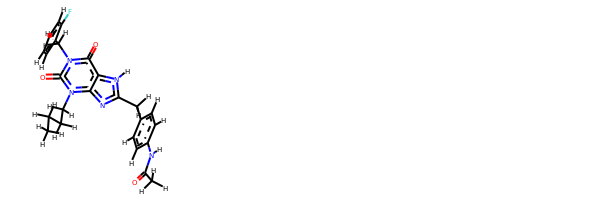

rdkit:  [H]c1c([H])c([H])c(C([H])([H])n2c(=O)c3c(nc(C([H])([H])c4c([H])c([H])c(N([H])C(=O)C([H])([H])[H])c([H])c4[H])n3[H])n(C([H])([H])C([H])([H])C([H])([H])C([H])([H])[H])c2=O)c(F)c1[H]
oechem:  CCCCn1c2c(c(=O)n(c1=O)Cc3ccccc3F)[nH]c(n2)Cc4ccc(cc4)NC(=O)C
###########################################################################
 #########################################################

bond
27.259809399563334 kJ/mol 58311.592443197216 kJ/mol False
angle
358.54749480518586 kJ/mol 358.54749480518586 kJ/mol True
nb
45.32109567481002 kJ/mol 45.32109567481002 kJ/mol True
torsion
113.8152436947079 kJ/mol 113.81524736591872 kJ/mol False
544.9436435742672 kJ/mol 58829.27628104313 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1763


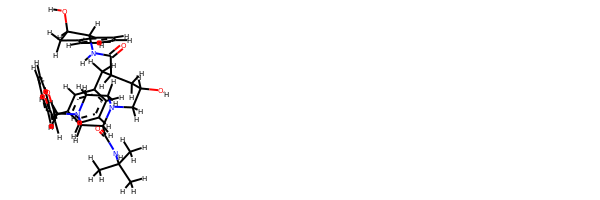

rdkit:  [H]OC1([H])C([H])([H])c2c([H])c([H])c([H])c([H])c2C1([H])N([H])C(=O)C([H])(C([H])([H])c1c([H])c([H])c([H])c([H])c1[H])C([H])([H])C([H])(O[H])C([H])([H])N1C([H])([H])C([H])([H])N(C([H])([H])c2oc3c([H])c([H])c([H])c([H])c3c2[H])C([H])([H])C1([H])C(=O)N([H])C(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H]
oechem:  CC(C)(C)NC(=O)C1CN(CCN1CC(CC(Cc2ccccc2)C(=O)NC3c4ccccc4CC3O)O)Cc5cc6ccccc6o5
###########################################################################
 #########################################################

bond
50.949962299478905 kJ/mol 114533.32334058144 kJ/mol False
angle
502.5906275073628 kJ/mol 502.5906275073628 kJ/mol True
nb
49.328441502550035 kJ/mol 49.328441502550035 kJ/mol True
torsion
106.64181519551335 kJ/mol 74.370849453891 kJ/mol False
709.5108465049051 kJ/mol 115159.61325904525 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
--------------------------------

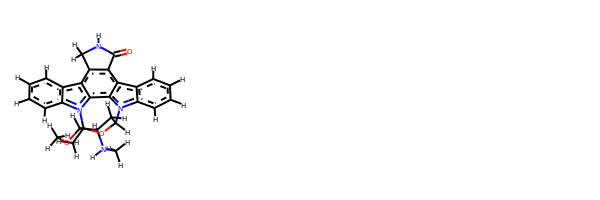

rdkit:  [H]c1c([H])c([H])c2c(c1[H])c1c3c(c4c5c([H])c([H])c([H])c([H])c5n5c4c1n2C1([H])OC5(C([H])([H])[H])C([H])(OC([H])([H])[H])C([H])(N([H])C([H])([H])[H])C1([H])[H])C([H])([H])N([H])C3=O
oechem:  CC12C(C(CC(O1)n3c4ccccc4c5c3c6n2c7ccccc7c6c8c5C(=O)NC8)NC)OC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
27.817841035964015 kJ/mol 57742.97791190972 kJ/mol False
angle
118.62622737181191 kJ/mol 118.62622737181191 kJ/mol True
nb
45.59131102549336 kJ/mol 45.59131102549336 kJ/mol True
torsion
32.00211219294638 kJ/mol 32.001922096743144 kJ/mol False
224.03749162621565 kJ/mol 57939.19737240377 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
---------------------------------

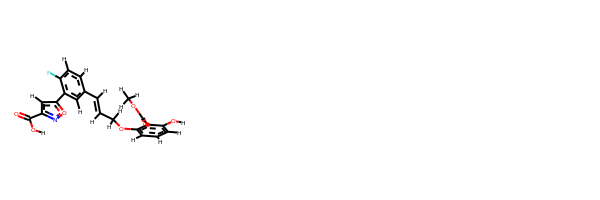

rdkit:  [H]OC(=O)c1noc(-c2c([H])c(C([H])=C([H])C([H])([H])Oc3c([H])c([H])c([H])c(O[H])c3C(=O)OC([H])([H])[H])c([H])c([H])c2F)c1[H]
oechem:  COC(=O)c1c(cccc1OCC=Cc2ccc(c(c2)c3cc(no3)C(=O)O)F)O
###########################################################################
 #########################################################

bond
25.24046747495942 kJ/mol 57759.02713625772 kJ/mol False
angle
49.380561473081606 kJ/mol 49.687819735671916 kJ/mol False
nb
54.98732098701379 kJ/mol 54.98732098701379 kJ/mol True
torsion
31.16672565557137 kJ/mol 14.430884208830046 kJ/mol False
160.7750755906262 kJ/mol 57878.13316118923 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1768


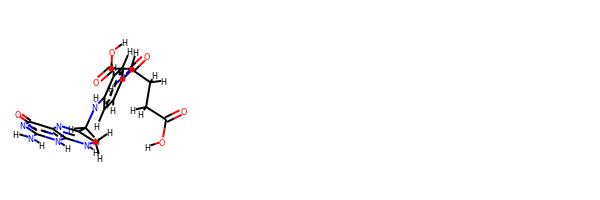

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])C([H])(C(=O)O[H])N([H])C(=O)c1c([H])c([H])c(N([H])C([H])([H])C2=Nc3c(n([H])c(N([H])[H])nc3=O)N([H])C2([H])[H])c([H])c1[H]
oechem:  c1cc(ccc1C(=O)NC(CCC(=O)O)C(=O)O)NCC2=Nc3c([nH]c(nc3=O)N)NC2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
68.86745193388126 kJ/mol 169790.965876938 kJ/mol False
angle
422.85785147988867 kJ/m

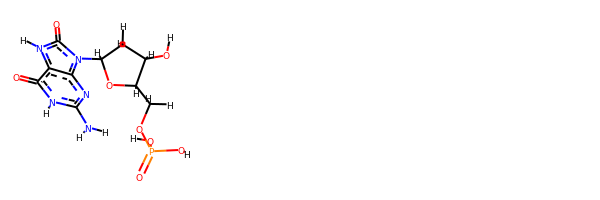

rdkit:  [H]OC1([H])C([H])([H])C([H])(n2c(=O)n([H])c3c(=O)n([H])c(N([H])[H])nc32)OC1([H])C([H])([H])OP(=O)(O[H])O[H]
oechem:  C1C(C(OC1n2c3c(c(=O)[nH]c(n3)N)[nH]c2=O)COP(=O)(O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
26.321972626257004 kJ/mol 58280.544425749846 kJ/mol False
angle
145.6760894713946 kJ/mol 145.6760894713946 kJ/mol True
nb
61.78593384324857 kJ/mol 61.78593384324857 kJ/mol True
torsion
18.85851821182277 kJ/mol 18.85853415434152 kJ/mol False
252.64251415272292 kJ/mol 58506.86498321883 kJ/mol

-------------------------------------------------------------------
-----------------------------------------------

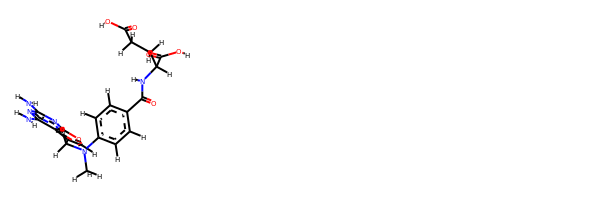

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])C([H])(C(=O)O[H])N([H])C(=O)c1c([H])c([H])c(N(C([H])([H])[H])C([H])([H])c2c([H])oc3nc(N([H])[H])nc(N([H])[H])c23)c([H])c1[H]
oechem:  CN(Cc1coc2c1c(nc(n2)N)N)c3ccc(cc3)C(=O)NC(CCC(=O)O)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
23.64193124959632 kJ/mol 57940.976692016186 kJ/mol False
angle
399.08688288256224 kJ/mol 399.08688288256224 kJ/mol True
nb
17.994475882442746 kJ/mol 17.994475882442746 kJ/mol True
torsion
98.29150475663849 kJ/mol 74.18313235020192 kJ/mol False
539.0147947712398 kJ/mol 58432.241183131395 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
------------------------------------------------------------

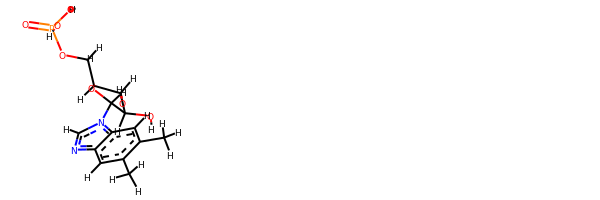

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c([H])c(C([H])([H])[H])c(C([H])([H])[H])c([H])c32)OC([H])(C([H])([H])OP(=O)(O[H])O[H])C1([H])O[H]
oechem:  Cc1cc2c(cc1C)n(cn2)C3C(C(C(O3)COP(=O)(O)O)O)O
###########################################################################
 #########################################################

bond
26.09399104642712 kJ/mol 57407.13071507321 kJ/mol False
angle
50.012903324908464 kJ/mol 50.17129685167667 kJ/mol False
nb
54.80148237470104 kJ/mol 54.80148237470104 kJ/mol True
torsion
46.07956436559527 kJ/mol 12.6157673742681 kJ/mol False
176.9879411116319 kJ/mol 57524.719261673854 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1784


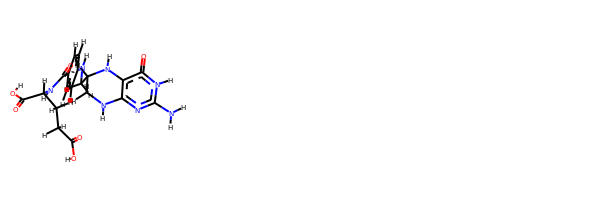

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])C([H])(C(=O)O[H])N([H])C(=O)c1c([H])c([H])c(N([H])C([H])([H])C2([H])N([H])c3c(nc(N([H])[H])n([H])c3=O)N([H])C2([H])[H])c([H])c1[H]
oechem:  c1cc(ccc1C(=O)NC(CCC(=O)O)C(=O)O)NCC2CNc3c(c(=O)[nH]c(n3)N)N2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
25.956808943706875 kJ/mol 57124.90595799959 kJ/mol False
angle
64.54325855945198 kJ/mol 64.54325855945198 kJ/mol True
nb
62.38842626295718 kJ/mol 62.38842626295718 kJ/mol True
torsion
249.84311074742624 kJ/mol 244.50756894398398 kJ/mol False
402.73160451354227 kJ/mol 57496.34521176598 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
----------------------------------------------------

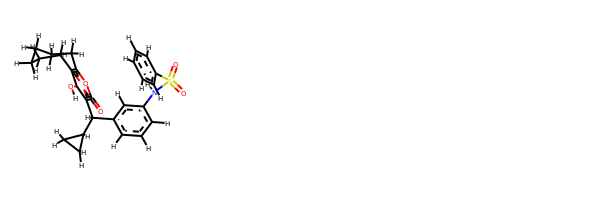

rdkit:  [H]Oc1c2c(oc(=O)c1C([H])(c1c([H])c([H])c([H])c(N([H])S(=O)(=O)c3c([H])c([H])c([H])c([H])c3[H])c1[H])C1([H])C([H])([H])C1([H])[H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C2([H])[H]
oechem:  c1ccc(cc1)S(=O)(=O)Nc2cccc(c2)C(c3c(c4c(oc3=O)CCCCCC4)O)C5CC5
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

##############################################

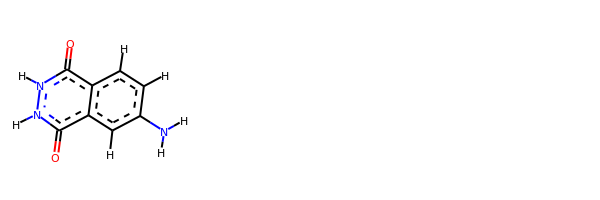

rdkit:  [H]c1c(N([H])[H])c([H])c2c(=O)n([H])n([H])c(=O)c2c1[H]
oechem:  c1cc2c(cc1N)c(=O)[nH][nH]c2=O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
38.021075243585145 kJ/mol 116155.89651305559 kJ/mol False
angle
217.78210523224976 kJ/mol 219.01180738169674 kJ/mol False
nb
-3.9483912240250043 kJ/mol -3.9483912240250043 kJ/mol True
torsion
42.19272778747637 kJ/mol 39.67855491550101 kJ/mol False
294.0475170392863 kJ/mol 116410.63848412877 kJ/mol

-------------------------------------------------

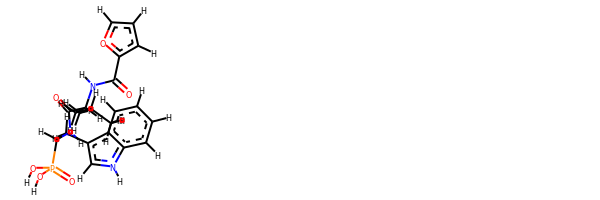

rdkit:  [H]OP(=O)(O[H])C([H])(N([H])C(=O)C([H])(N([H])C(=O)c1oc([H])c([H])c1[H])C([H])([H])C([H])(C([H])([H])[H])C([H])([H])[H])C([H])([H])c1c([H])n([H])c2c([H])c([H])c([H])c([H])c12
oechem:  CC(C)CC(C(=O)NC(Cc1c[nH]c2c1cccc2)P(=O)(O)O)NC(=O)c3ccco3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
36.68553447190298 kJ/mol 29193.776741695754 kJ/mol False
angle
87.77439433962951 kJ/mol 87.77439433962951 kJ/mol True
nb
1.4768410072644134 kJ/mol 1.4768410072644134 kJ/mol True
torsion
21.98536638877206 kJ/mol 16.754417122835225 kJ/mol False
147.92213620756897 kJ/mol 29299.782394165486 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-----------------------------------------

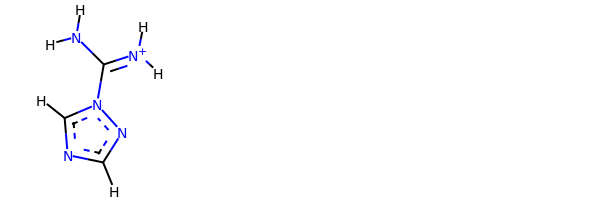

rdkit:  [H]c1nc([H])n(C(N([H])[H])=[N+]([H])[H])n1
oechem:  c1ncn(n1)C(=[NH2+])N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ##########################

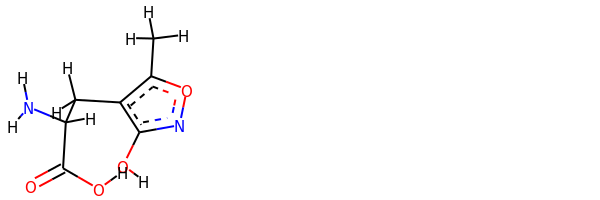

rdkit:  [H]OC(=O)C([H])(N([H])[H])C([H])([H])c1c(O[H])noc1C([H])([H])[H]
oechem:  Cc1c(c(no1)O)CC(C(=O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 

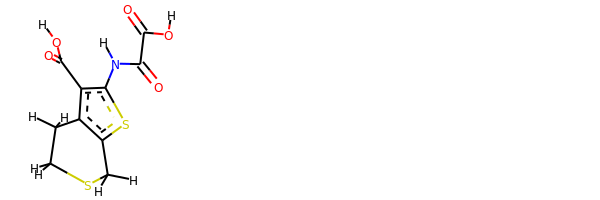

rdkit:  [H]OC(=O)C(=O)N([H])c1sc2c(c1C(=O)O[H])C([H])([H])C([H])([H])SC2([H])[H]
oechem:  C1CSCc2c1c(c(s2)NC(=O)C(=O)O)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
20.474638987725257 kJ/mol 57287.096345452126 kJ/mol False
angle
485.2167227323637 kJ/mol 485.3833485539459 kJ/mol False
nb
10.986369756570724 kJ/mol 10.986369756570724 kJ/mol True
torsion
88.93710513968354 kJ/mol 72.20111527351192 kJ/mol False
605.6148366163433 kJ/mol 57855.66717903616 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1823


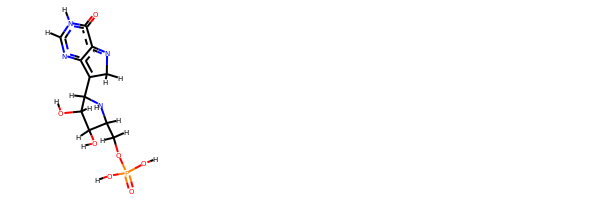

rdkit:  [H]OC1([H])C([H])(C2=c3nc([H])n([H])c(=O)c3=NC2([H])[H])N([H])C([H])(C([H])([H])OP(=O)(O[H])O[H])C1([H])O[H]
oechem:  c1[nH]c(=O)c2=NCC(=c2n1)C3C(C(C(N3)COP(=O)(O)O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

#######

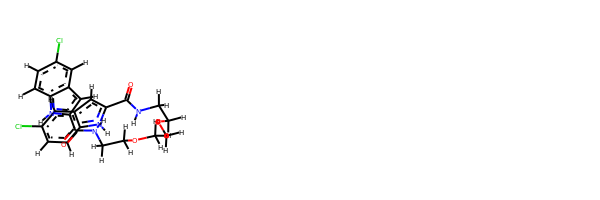

rdkit:  [H]c1c(Cl)c([H])c2c([H])c(C(=O)N([H])C([H])([H])C([H])([H])OC([H])([H])C([H])([H])OC([H])([H])C([H])([H])N([H])C(=O)c3c([H])c4c([H])c(Cl)c([H])c([H])c4n3[H])n([H])c2c1[H]
oechem:  c1cc2c(cc1Cl)cc([nH]2)C(=O)NCCOCCOCCNC(=O)c3cc4cc(ccc4[nH]3)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
12.614191262658139 kJ/mol 43684.18328061157 kJ/mol False
angle
62.74374397482527 kJ/mol 66.09980602652938 kJ/mol False
nb
16.371236558481108 kJ/mol 16.371236558481108 kJ/mol True
torsion
23.45868884205509 kJ/mol 15.83522564693046 kJ/mol False
115.18786063801963 kJ/mol 43782.48954884351 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-----------------------------------------

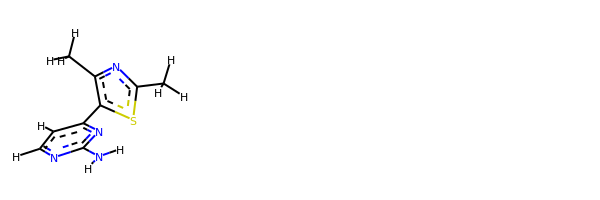

rdkit:  [H]c1nc(N([H])[H])nc(-c2sc(C([H])([H])[H])nc2C([H])([H])[H])c1[H]
oechem:  Cc1c(sc(n1)C)c2ccnc(n2)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
81908.78823227622 kJ/mol 125696.242042703 kJ/mol False
angle
45.03535587142753 kJ/mol 47.1874374614103 kJ/mol False
nb
143.96981887163722 kJ/mol 143.96981887163722 kJ/mol True
torsion
27.5749176070319 kJ/mol 21.290266237638125 kJ/mol False
82125.36832462632 kJ/mol 125908.6895652737 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
----------------------------------------------------

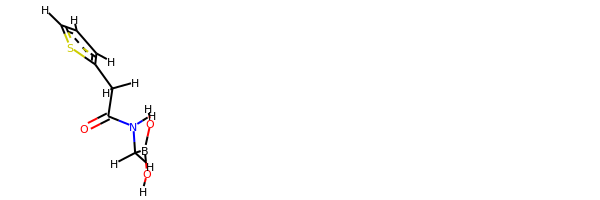

rdkit:  [H]OB(O[H])C([H])([H])N([H])C(=O)C([H])([H])c1sc([H])c([H])c1[H]
oechem:  B(CNC(=O)Cc1cccs1)(O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
17.59069179051232 kJ/mol 58039.104838626175 kJ/mol False
angle
97.46807237112463 kJ/mol 97.46807237112463 kJ/mol True
nb
11.662020639352543 kJ/mol 11.662020639352543 kJ/mol True
torsion
32.90108721992101 kJ/mol 22.38439754747649 kJ/mol False
159.6218720209105 kJ/mol 58170.61932918413 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1843


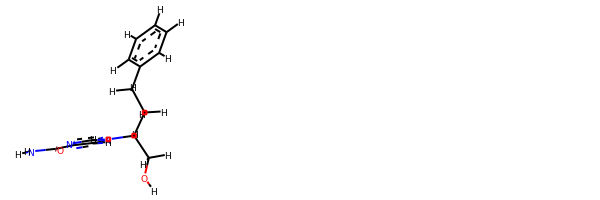

rdkit:  [H]OC([H])([H])C([H])(n1c([H])nc(C(=O)N([H])[H])c1[H])C([H])([H])C([H])([H])c1c([H])c([H])c([H])c([H])c1[H]
oechem:  c1ccc(cc1)CCC(CO)n2cc(nc2)C(=O)N
###########################################################################
 #########################################################

bond
33.068476665972085 kJ/mol 56499.032447617305 kJ/mol False
angle
303.77525903060837 kJ/mol 303.77525903060837 kJ/mol True
nb
19.435155846391268 kJ/mol 19.435155846391268 kJ/mol True
torsion
106.17977979599429 kJ/mol 65.89062703483636 kJ/mol False
462.45867133896604 kJ/mol 56888.133489529144 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1844


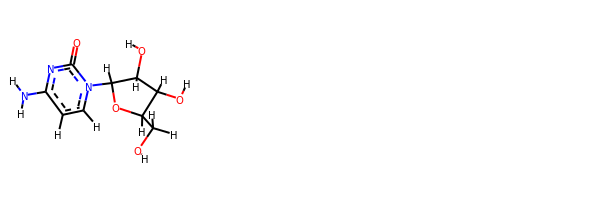

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])c([H])c(N([H])[H])nc2=O)C([H])(O[H])C1([H])O[H]
oechem:  c1cn(c(=O)nc1N)C2C(C(C(O2)CO)O)O
###########################################################################
 #########################################################

bond
31.689188484187625 kJ/mol 58014.36379900215 kJ/mol False
angle
442.09322427661704 kJ/mol 442.09322427661704 kJ/mol True
nb
13.913209853717513 kJ/mol 13.913209853717513 kJ/mol True
torsion
110.94101317705392 kJ/mol 86.85015230703226 kJ/mol False
598.636635791576 kJ/mol 58557.22038543951 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1845


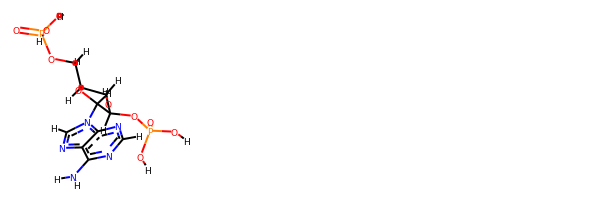

rdkit:  [H]OC1([H])C([H])(C([H])([H])OP(=O)(O[H])O[H])OC([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)C1([H])OP(=O)(O[H])O[H]
oechem:  c1nc(c2c(n1)n(cn2)C3C(C(C(O3)COP(=O)(O)O)O)OP(=O)(O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
19.591954319089133 kJ/mol 58002.84471050922 kJ/mol False
angle
398.2345074140761 kJ/mol 398.2345074140761 kJ/mol True
nb
12.70095527197732 kJ/mol 12.70095527197732 kJ/mol True
torsion
65.18993280428842 kJ/mol 41.21845662238412 kJ/mol False
495.717349809431 kJ/mol 5

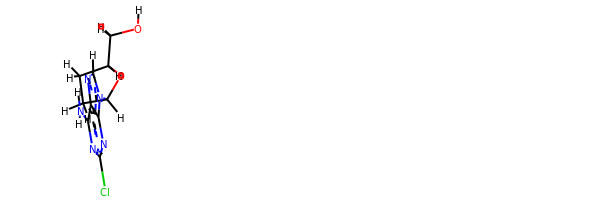

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])nc3c(N([H])[H])nc(Cl)nc32)C([H])([H])C1([H])[H]
oechem:  c1nc2c(nc(nc2n1C3CCC(O3)CO)Cl)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
13.378396345347461 kJ/mol 57727.665792489184

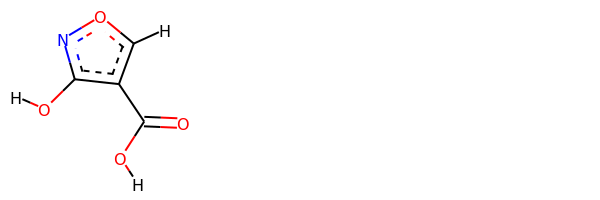

rdkit:  [H]OC(=O)c1c(O[H])noc1[H]
oechem:  c1c(c(no1)O)C(=O)O
###########################################################################
 #########################################################

bond
5.0144598811379595 kJ/mol 57979.33390461587 kJ/mol False
angle
96.9608474137846 kJ/mol 98.98853550670417 kJ/mol False
nb
20.618161736178283 kJ/mol 20.618161736178283 kJ/mol True
torsion
8.970941152989303e-05 kJ/mol 0.00017418750393326701 kJ/mol False
122.59355874051238 kJ/mol 58098.940776046256 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1860


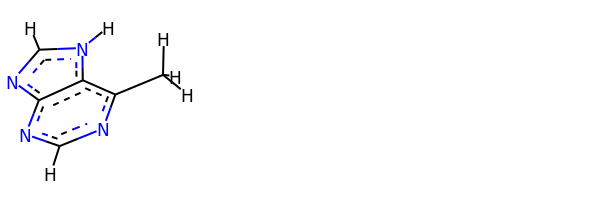

rdkit:  [H]c1nc(C([H])([H])[H])c2c(n1)nc([H])n2[H]
oechem:  Cc1c2c(nc[nH]2)ncn1
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
33.35637389749247 kJ/mol 57819.195812491154 kJ/mol False
angle
33.61161381974648 kJ/mol 33.61161381974648 kJ/mol True
nb
56.77849898057992 kJ/mol 56.77849898057992 kJ/mol True
torsion
99.80261701974504 kJ/mol 99.93401744628389 kJ/mol False
223.5491037175639 kJ/mol 58009.51994273777 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1862


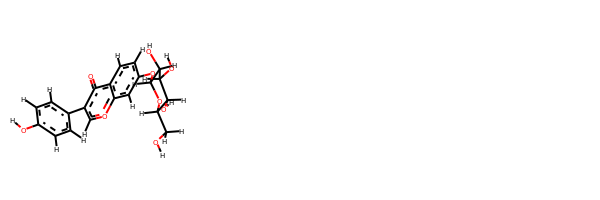

rdkit:  [H]Oc1c([H])c([H])c(-c2c([H])oc3c([H])c(OC4([H])OC([H])(C([H])([H])O[H])C([H])(O[H])C([H])(O[H])C4([H])O[H])c([H])c([H])c3c2=O)c([H])c1[H]
oechem:  c1cc(ccc1c2coc3cc(ccc3c2=O)OC4C(C(C(C(O4)CO)O)O)O)O
###########################################################################
 #########################################################

bond
14.230372899626301 kJ/mol 57997.96490683013 kJ/mol False
angle
109.68392096370144 kJ/mol 109.68392096370144 kJ/mol True
nb
38.224296617637364 kJ/mol 38.224296617637364 kJ/mol True
torsion
1.6212687627378821 kJ/mol 1.6241370913260498 kJ/mol False
163.75985924370298 kJ/mol 58147.497261502795 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1863


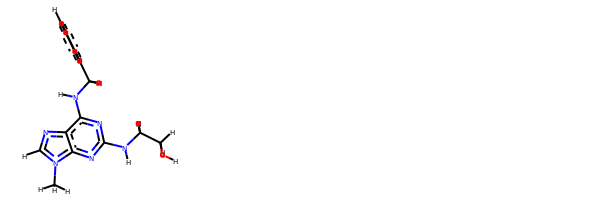

rdkit:  [H]OC([H])([H])C([H])([H])N([H])c1nc(N([H])C([H])([H])c2c([H])c([H])c([H])c([H])c2[H])c2nc([H])n(C([H])([H])[H])c2n1
oechem:  Cn1cnc2c1nc(nc2NCc3ccccc3)NCCO
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
10.118827100121457 kJ/mol 57481.87756333468 kJ/mol False
angle
24.41326263159177 kJ/mol 24.559380329156266 kJ/mol False
nb
29.37731481711411 kJ/mol 29.37731481711411 kJ/mol True
torsion
40.1670864740598 kJ/mol 6.6951213276949355 kJ/mol False
104.07649102288714 kJ/mol 57542.509379808645 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1865


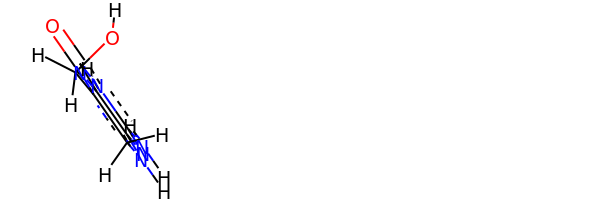

rdkit:  [H]OC([H])([H])C1=Nc2c(nc(N([H])[H])n([H])c2=O)N([H])C1([H])[H]
oechem:  C1C(=Nc2c(=O)[nH]c(nc2N1)N)CO
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

#########################################################################

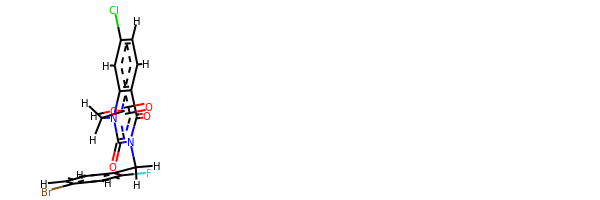

rdkit:  [H]OC(=O)C([H])([H])n1c(=O)n(C([H])([H])c2c([H])c([H])c(Br)c([H])c2F)c(=O)c2c([H])c([H])c(Cl)c([H])c21
oechem:  c1cc2c(cc1Cl)n(c(=O)n(c2=O)Cc3ccc(cc3F)Br)CC(=O)O
###########################################################################
 #########################################################

bond
36.37206380908761 kJ/mol 171118.4200310989 kJ/mol False
angle
99.22031995857361 kJ/mol 102.24181030352324 kJ/mol False
nb
9.711835802534836 kJ/mol 9.711835802534836 kJ/mol True
torsion
50.20807611286625 kJ/mol 0.0001954167537120374 kJ/mol False
195.5122956830623 kJ/mol 171230.37387262174 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1880


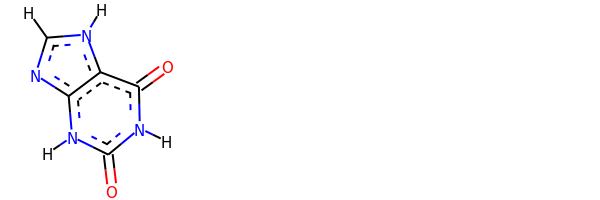

rdkit:  [H]c1nc2c(c(=O)n([H])c(=O)n2[H])n1[H]
oechem:  c1[nH]c2c(n1)[nH]c(=O)[nH]c2=O
###########################################################################
 #########################################################

bond
76.94900404729087 kJ/mol 226956.381817252 kJ/mol False
angle
143.5957919406689 kJ/mol 144.28870922874702 kJ/mol False
nb
19.341610308335763 kJ/mol 19.341610308335763 kJ/mol True
torsion
96.91201551534688 kJ/mol 41.09098693358769 kJ/mol False
336.7984218116424 kJ/mol 227161.10312372266 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1881


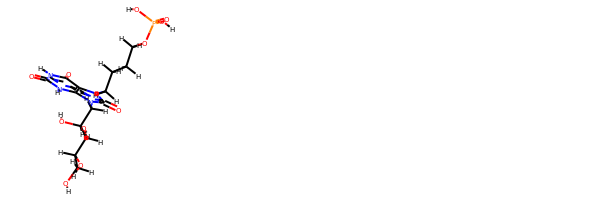

rdkit:  [H]OC([H])([H])C([H])(O[H])C([H])(O[H])C([H])(O[H])C([H])([H])n1c(=O)n(C([H])([H])C([H])([H])C([H])([H])C([H])([H])OP(=O)(O[H])O[H])c2c(=O)n([H])c(=O)n([H])c21
oechem:  C(CCOP(=O)(O)O)Cn1c2c([nH]c(=O)[nH]c2=O)n(c1=O)CC(C(C(CO)O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
19.643295309337972 kJ/mol 28981.30503037884 kJ/mol False
angle
97.37799005606462 kJ/mol 97.37799005606462 kJ/mol True
nb
43.63368923256603 kJ/mol 43.63368923256603 kJ/mol True
torsion
44.31460854788647 kJ/mol 48.487064899050125 kJ/mol False
204.9695831458551 kJ/mol 29170.803774566524 kJ/mol

------------------------------------------------------

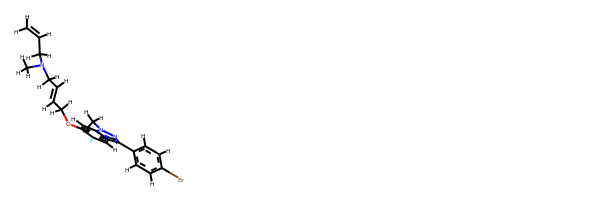

rdkit:  [H]C([H])=C([H])C([H])([H])N(C([H])([H])[H])C([H])([H])C([H])=C([H])C([H])([H])Oc1c(F)c([H])c2c(-c3c([H])c([H])c(Br)c([H])c3[H])nn(C([H])([H])[H])c2c1[H]
oechem:  Cn1c2cc(c(cc2c(n1)c3ccc(cc3)Br)F)OCC=CCN(C)CC=C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ########################

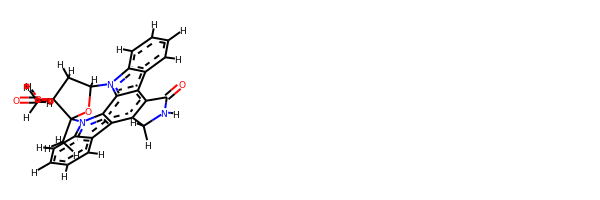

rdkit:  [H]OC1(C(=O)OC([H])([H])[H])C([H])([H])C2([H])OC1(C([H])([H])[H])n1c3c([H])c([H])c([H])c([H])c3c3c4c(c5c6c([H])c([H])c([H])c([H])c6n2c5c31)C(=O)N([H])C4([H])[H]
oechem:  CC12C(CC(O1)n3c4ccccc4c5c3c6n2c7ccccc7c6c8c5C(=O)NC8)(C(=O)OC)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
11.724343006813776 kJ/mol 11.724343006813776 kJ/mol True
angle
40.14816650649524 kJ/mol 40.14816650649524 kJ/mol True
nb
9.748261628391385 kJ/mol 9.748261628391385 kJ/mol True
torsion
16.168414222156553 kJ/mol

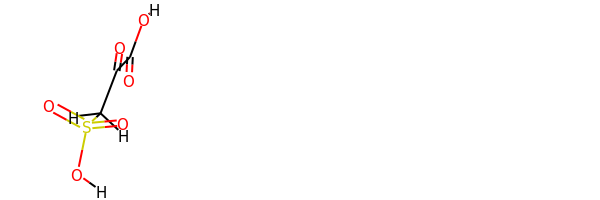

rdkit:  [H]OC(=O)C(=O)C([H])([H])S(=O)(=O)O[H]
oechem:  C(C(=O)C(=O)O)S(=O)(=O)O
###########################################################################
 #########################################################

bond
12.669900305732194 kJ/mol 57782.33175248735 kJ/mol False
angle
420.90404429648424 kJ/mol 422.47909104471773 kJ/mol False
nb
7.9999975692970855 kJ/mol 7.9999975692970855 kJ/mol True
torsion
91.04121561516331 kJ/mol 63.87827487564823 kJ/mol False
532.6151577866768 kJ/mol 58276.68911597702 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1901


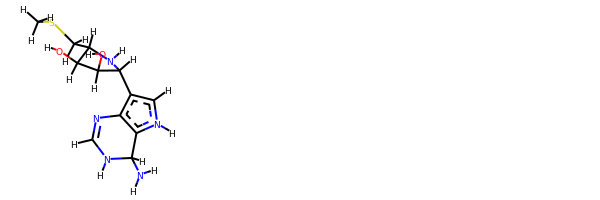

rdkit:  [H]OC1([H])C([H])(c2c3c(n([H])c2[H])C([H])(N([H])[H])N([H])C([H])=N3)N([H])C([H])(C([H])([H])SC([H])([H])[H])C1([H])O[H]
oechem:  CSCC1C(C(C(N1)c2c[nH]c3c2N=CNC3N)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
28.0298494341755 kJ/mol 58010.70445995215 kJ/mol False
angle
419.275678540964 kJ/mol 419.275678540964 kJ/mol True
nb
4.458332893482348 kJ/mol 4.458332893482348 kJ/mol True
torsion
109.40008083578878 kJ/mol 85.30921996576711 kJ/mol False
561.1639417044106 kJ/mol 58519.74769135

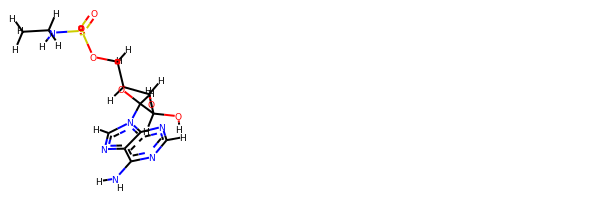

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)OC([H])(C([H])([H])OS(=O)(=O)N([H])C([H])([H])C([H])([H])[H])C1([H])O[H]
oechem:  CCNS(=O)(=O)OCC1C(C(C(O1)n2cnc3c2ncnc3N)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
44.63586541848595 kJ/mol 114059.01816538989 kJ/mol False
angle
94.09352478910773 kJ/mol 94.4331643400746 kJ/mol False
nb
231.77205519417288 kJ/mol 231.77205519417288 kJ/mol True
torsion
104.0217957242195 kJ/mol 112.70216016120185 kJ/mol False
474.52324112598603 kJ/mol 114497.92554508535 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1907


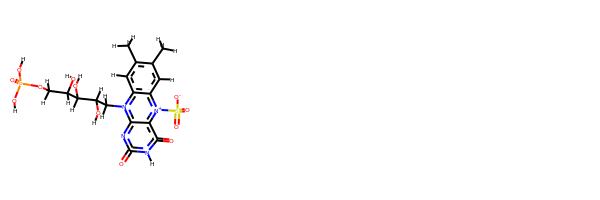

rdkit:  [H]OC([H])(C([H])([H])OP(=O)(O[H])O[H])C([H])(O[H])C([H])(O[H])C([H])([H])n1c2nc(=O)n([H])c(=O)c-2[n+](S(=O)(=O)[O-])c2c([H])c(C([H])([H])[H])c(C([H])([H])[H])c([H])c21
oechem:  Cc1cc2c(cc1C)[n+](c-3c(=O)[nH]c(=O)nc3n2CC(C(C(COP(=O)(O)O)O)O)O)S(=O)(=O)[O-]
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
22.179083919913793 kJ/mol 57770.70078585213 kJ/mol False
angle
11.62447481721162 kJ/mol 11.62447481721162 kJ/mol True
nb
59.12082101078306 kJ/mol 59.12082101078306 kJ/mol True
torsion
85.3538432538939 kJ/mol 85.35394928495641 kJ/mol False
178.27822300180236 kJ/mol 57926.80003096508 kJ/mol

-------------------------------

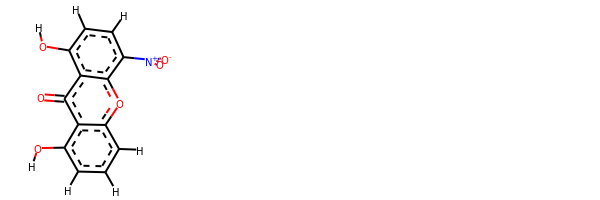

rdkit:  [H]Oc1c([H])c([H])c([H])c2oc3c([N+](=O)[O-])c([H])c([H])c(O[H])c3c(=O)c12
oechem:  c1cc(c2c(c1)oc3c(ccc(c3c2=O)O)[N+](=O)[O-])O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

################################################

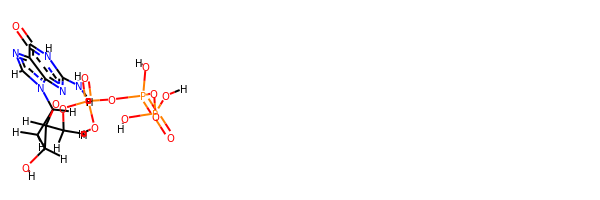

rdkit:  [H]OC1([H])C([H])([H])C([H])(n2c([H])nc3c(=O)n([H])c(N([H])[H])nc32)OC1([H])C([H])([H])OP(=O)(O[H])OP(=O)(O[H])OP(=O)(O[H])O[H]
oechem:  c1nc2c(=O)[nH]c(nc2n1C3CC(C(O3)COP(=O)(O)OP(=O)(O)OP(=O)(O)O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
29.2220266031236 kJ/mol 58011.23894716135 kJ/mol False
angle
501.06423564120837 kJ/mol 501.06423564120837

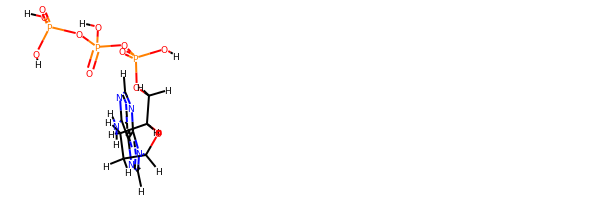

rdkit:  [H]OP(=O)(O[H])OP(=O)(O[H])OP(=O)(O[H])OC([H])([H])C1([H])OC([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)C([H])([H])C1([H])[H]
oechem:  c1nc(c2c(n1)n(cn2)C3CCC(O3)COP(=O)(O)OP(=O)(O)OP(=O)(O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
5.927108021984009 kJ/mol 57765.36567133257 kJ/mol False
angle
113.97587815661588 kJ/mol 115.32296835477828 kJ/mol False
nb
25.20058731298647 kJ/mol 25.20058731298647 kJ/mol True
torsion
27.520702279515376 kJ/mol 11.251006546399026 kJ/mol False
172.62427577110174 kJ/mol 57917.140233546736 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1933


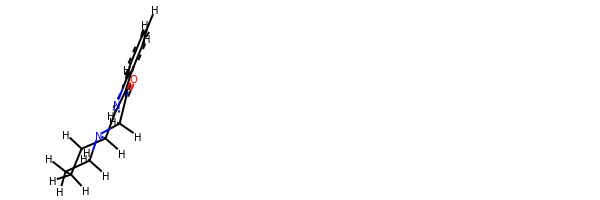

rdkit:  [H]c1c([H])c([H])c2c(c1[H])c1c(n2[H])C2([H])N(C([H])([H])C1=O)C([H])([H])C([H])([H])C([H])([H])C2([H])[H]
oechem:  c1ccc2c(c1)c3c([nH]2)C4CCCCN4CC3=O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
9.460848059617211 kJ/mol 57779.0705673605 kJ/mol False
angle
103.43837170132784 kJ/mol 103.43837170132784 kJ/mol True
nb
36.60295358991369 kJ/mol 36.60295358991369 kJ/mol True
torsion
31.40857355824753 kJ/mol 31.409057403253826 kJ/mol False
180.91074690910625 kJ/mol 57950.52095005499 kJ/mol



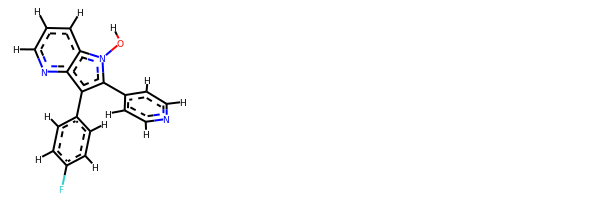

rdkit:  [H]On1c(-c2c([H])c([H])nc([H])c2[H])c(-c2c([H])c([H])c(F)c([H])c2[H])c2nc([H])c([H])c([H])c21
oechem:  c1cc2c(c(c(n2O)c3ccncc3)c4ccc(cc4)F)nc1
###########################################################################
 #########################################################

bond
12.39132518974862 kJ/mol 85848.61248358319 kJ/mol False
angle
148.64593809017876 kJ/mol 148.64593809017876 kJ/mol True
nb
52.83625475706337 kJ/mol 52.83625475706337 kJ/mol True
torsion
89.72015951967471 kJ/mol 89.72021158096271 kJ/mol False
303.59367755666545 kJ/mol 86139.81488801139 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1939


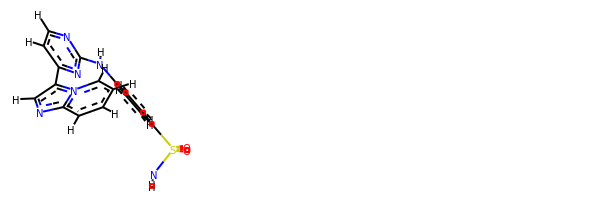

rdkit:  [H]c1nc(N([H])c2c([H])c([H])c(S(=O)(=O)N([H])[H])c([H])c2[H])nc(-c2c([H])nc3c([H])c([H])c([H])c([H])n23)c1[H]
oechem:  c1ccn2c(c1)ncc2c3ccnc(n3)Nc4ccc(cc4)S(=O)(=O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
39.76

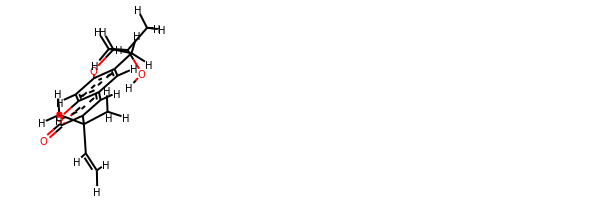

rdkit:  [H]OC(C([H])([H])[H])(C([H])([H])[H])C1([H])Oc2c(c([H])c3c([H])c(C(C([H])=C([H])[H])(C([H])([H])[H])C([H])([H])[H])c(=O)oc3c2[H])C1([H])[H]
oechem:  CC(C)(C=C)c1cc2cc3c(cc2oc1=O)OC(C3)C(C)(C)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
44.26507260726632 kJ/mol 228652.5311670866 kJ/mol False
angle
42.14739814448257 kJ/mol 42.99901754610088 kJ/mol Fa

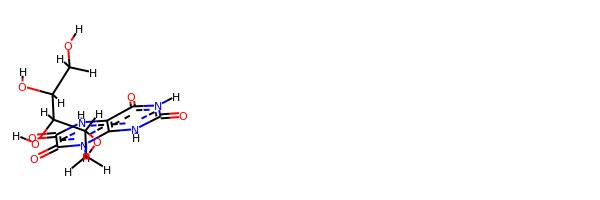

rdkit:  [H]OC([H])([H])C([H])(O[H])C([H])(O[H])C([H])(O[H])C([H])([H])n1c(=O)c(=O)n([H])c2c(=O)n([H])c(=O)n([H])c21
oechem:  C(C(C(C(CO)O)O)O)n1c2c(c(=O)[nH]c(=O)[nH]2)[nH]c(=O)c1=O
###########################################################################
 #########################################################

bond
18.901208046518576 kJ/mol 58384.395173448094 kJ/mol False
angle
114.68788187465772 kJ/mol 114.68788187465772 kJ/mol True
nb
19.19855745827909 kJ/mol 19.19855745827909 kJ/mol True
torsion
22.193146253154598 kJ/mol 19.67895193643787 kJ/mol False
174.98079363261 kJ/mol 58537.96056471747 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1952


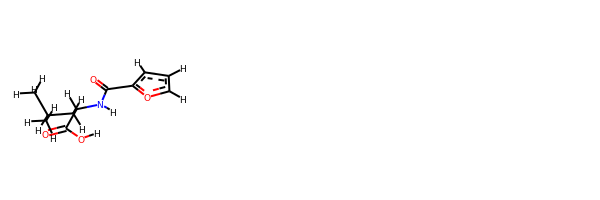

rdkit:  [H]OC(=O)C([H])(N([H])C(=O)c1oc([H])c([H])c1[H])C([H])([H])C([H])(C([H])([H])[H])C([H])([H])[H]
oechem:  CC(C)CC(C(=O)O)NC(=O)c1ccco1
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
69.41483016795861 kJ/mol 113468.85054784743 kJ/mol False
angle
358.38383184954097 kJ/mol 359.00429381623843 kJ/mol False
nb
90.393894127327 kJ/mol 90.393894127327 kJ/mol True
torsion
117.71263654598137 kJ/mol 56.190280695880425 kJ/mol False
635.905192690808 kJ/mol 113974.43901648687 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1954


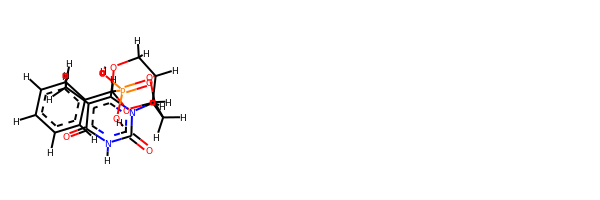

rdkit:  [H]OP(=O)(O[H])C1(c2c([H])c([H])c([H])c([H])c2[H])OC([H])([H])C2([H])OC([H])(n3c([H])c(C([H])([H])[H])c(=O)n([H])c3=O)C([H])([H])C2([H])O1
oechem:  Cc1cn(c(=O)[nH]c1=O)C2CC3C(O2)COC(O3)(c4ccccc4)P(=O)(O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
30.63947854377091 kJ/mol 44194.09349731625 kJ/mol False
angle
114.2450558041609 kJ/mol 116.71413900257383 kJ/mol False
nb
25.897037195943394 kJ/mol 25.897037195943394 kJ/mol True
torsion
198.18591824637844 kJ/mol 198.19413706945306 kJ/mol False
368.96748979025364 kJ/mol 44534.89881058422 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_

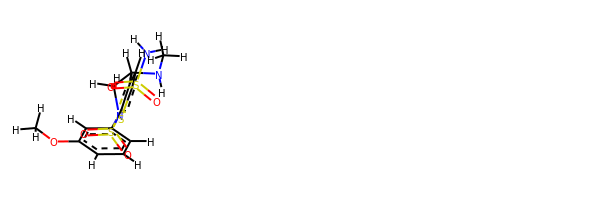

rdkit:  [H]c1c([H])c(OC([H])([H])[H])c([H])c(N2C([H])([H])C([H])(N([H])C([H])([H])[H])c3c(sc(S(=O)(=O)N([H])[H])c3[H])S2(=O)=O)c1[H]
oechem:  CNC1CN(S(=O)(=O)c2c1cc(s2)S(=O)(=O)N)c3cccc(c3)OC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
30.366522029146935 kJ/mol 58011.13187941571 kJ/mol False
angle
130.96829645605544 kJ/mol 130.96829645605544 kJ/mol True
nb
15.153579855981706 kJ/mol 15.153579855981706 kJ/mol True
torsion
13.215958256507697 kJ/mol 8.699247368308537 kJ/mol False
189.7043565976918 kJ/mol 58165.95300309606 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1959


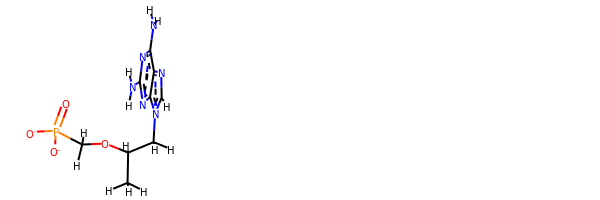

rdkit:  [H]c1nc2c(N([H])[H])nc(N([H])[H])nc2n1C([H])([H])C([H])(OC([H])([H])P(=O)([O-])[O-])C([H])([H])[H]
oechem:  CC(Cn1cnc2c1nc(nc2N)N)OCP(=O)([O-])[O-]
###########################################################################
 #########################################################

bond
56.158939514797815 kJ/mol 114226.91014284984 kJ/mol False
angle
218.36789616838584 kJ/mol 220.18669592635376 kJ/mol False
nb
2.3251943298505426 kJ/mol 2.3251943298505426 kJ/mol True
torsion
95.70514744859189 kJ/mol 62.233178677167494 kJ/mol False
372.5571774616261 kJ/mol 114511.65521178322 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1960


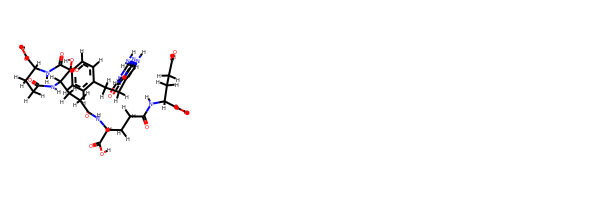

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])C([H])(C(=O)O[H])N([H])C(=O)C([H])([H])C([H])([H])C([H])(C(=O)O[H])N([H])C(=O)C([H])([H])C([H])([H])C([H])(C(=O)O[H])N([H])C(=O)C([H])([H])C([H])([H])C([H])(C(=O)O[H])N([H])C(=O)c1c([H])c([H])c(C([H])([H])C([H])([H])c2c([H])n([H])c3nc(N([H])[H])n([H])c(=O)c23)c([H])c1[H]
oechem:  c1cc(ccc1CCc2c[nH]c3c2c(=O)[nH]c(n3)N)C(=O)NC(CCC(=O)NC(CCC(=O)NC(CCC(=O)NC(CCC(=O)O)C(=O)O)C(=O)O)C(=O)O)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
30.673916364111395 kJ/mol 29168.945569030755 kJ/mol False
angle
121.05043447672551 kJ/mol 121.05043447672551 kJ/mol True
nb
106.95150607968235 kJ/mol 106.

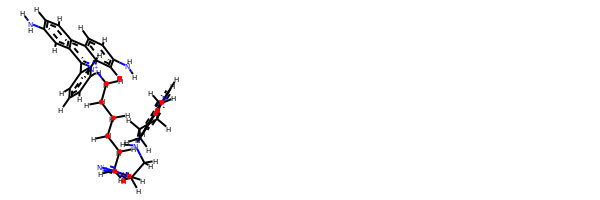

rdkit:  [H]c1c([H])c([H])c(-c2c3c([H])c(N([H])[H])c([H])c([H])c3c3c([H])c([H])c(N([H])[H])c([H])c3[n+]2C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])c2nnn(C([H])([H])C([H])([H])N([H])c3c4c(nc5c([H])c([H])c([H])c([H])c35)C([H])([H])C([H])([H])C([H])([H])C4([H])[H])c2[H])c([H])c1[H]
oechem:  c1ccc(cc1)c2c3cc(ccc3c4ccc(cc4[n+]2CCCCCCc5cn(nn5)CCNc6c7ccccc7nc8c6CCCC8)N)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###################################################################

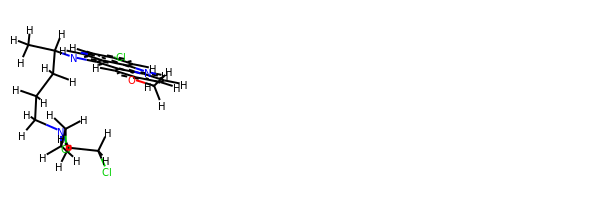

rdkit:  [H]c1c(Cl)c([H])c2c(c1[H])c(=NC([H])(C([H])([H])[H])C([H])([H])C([H])([H])C([H])([H])N(C([H])([H])C([H])([H])Cl)C([H])([H])C([H])([H])Cl)c1c([H])c(OC([H])([H])[H])c([H])c([H])c1n2[H]
oechem:  CC(CCCN(CCCl)CCCl)N=c1c2ccc(cc2[nH]c3c1cc(cc3)OC)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
11.912328849804462 kJ/mol 56902.678782036455 kJ/mol False
angle
134.88388303536263 kJ/mol 135.0932041706954 kJ/mol False
nb
14.50334289417428 kJ/mol 14.50334289417428 kJ/mol True
torsion
37.237634225

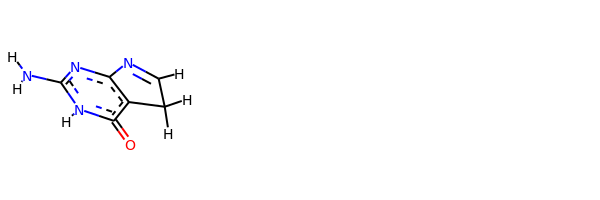

rdkit:  [H]C1=Nc2nc(N([H])[H])n([H])c(=O)c2C1([H])[H]
oechem:  C1C=Nc2c1c(=O)[nH]c(n2)N
###########################################################################
 #########################################################

bond
16.57685060379685 kJ/mol 43802.97545009944 kJ/mol False
angle
91.61381184599776 kJ/mol 93.76700525987168 kJ/mol False
nb
3.685756714046287 kJ/mol 3.685756714046287 kJ/mol True
torsion
62.402782052908556 kJ/mol 56.143539337155474 kJ/mol False
174.27920121674944 kJ/mol 43956.57175141051 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1981


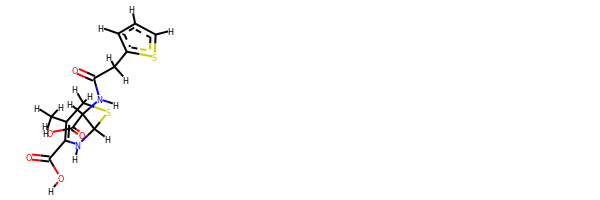

rdkit:  [H]OC(=O)C1=C(C([H])([H])[H])C([H])([H])SC([H])(C([H])(C(=O)O[H])N([H])C(=O)C([H])([H])c2sc([H])c([H])c2[H])N1[H]
oechem:  CC1=C(NC(SC1)C(C(=O)O)NC(=O)Cc2cccs2)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
35.9

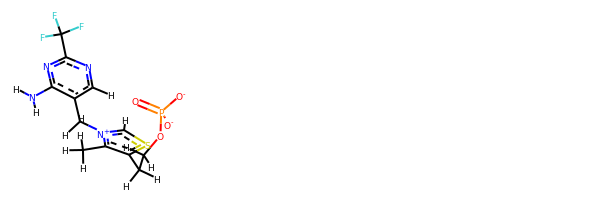

rdkit:  [H]c1nc(C(F)(F)F)nc(N([H])[H])c1C([H])([H])[n+]1c([H])sc(C([H])([H])C([H])([H])OP(=O)([O-])[O-])c1C([H])([H])[H]
oechem:  Cc1c(sc[n+]1Cc2cnc(nc2N)C(F)(F)F)CCOP(=O)([O-])[O-]
###########################################################################
 #########################################################

bond
19.742081657762736 kJ/mol 57771.65790411064 kJ/mol False
angle
124.67128376192207 kJ/mol 125.90050937438397 kJ/mol False
nb
9.724176294645963 kJ/mol 9.724176294645963 kJ/mol True
torsion
44.848209652123685 kJ/mol 44.84821736455842 kJ/mol False
198.98575136645442 kJ/mol 57952.130807144225 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1989


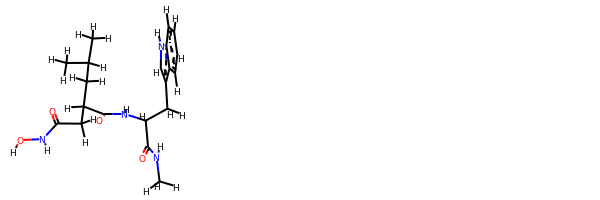

rdkit:  [H]ON([H])C(=O)C([H])([H])C([H])(C(=O)N([H])C([H])(C(=O)N([H])C([H])([H])[H])C([H])([H])c1c([H])n([H])c2c([H])c([H])c([H])c([H])c12)C([H])([H])C([H])(C([H])([H])[H])C([H])([H])[H]
oechem:  CC(C)CC(CC(=O)NO)C(=O)NC(Cc1c[nH]c2c1cccc2)C(=O)NC
###########################################################################
 #########################################################

bond
44.40301794214702 kJ/mol 113375.14608509278 kJ/mol False
angle
314.1887106246757 kJ/mol 314.7768949429492 kJ/mol False
nb
20.338609831160216 kJ/mol 20.338609831160216 kJ/mol True
torsion
112.95556133472336 kJ/mol 55.88854748751211 kJ/mol False
491.8858997327063 kJ/mol 113766.1501373544 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_1990


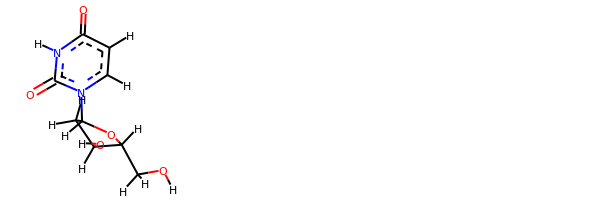

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])c([H])c(=O)n([H])c2=O)C([H])([H])C1([H])O[H]
oechem:  c1cn(c(=O)[nH]c1=O)C2CC(C(O2)CO)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
28.766769882793305 kJ/mol 58313.639683166606 kJ/mol False
angle
137.6167186909377 kJ/mol 137.6167186909377 kJ/mol True
nb
22.50037420768993 kJ/mol 22.50037420768993 kJ/mol True
torsion
174.72646009427942 kJ/mol 162.65821352521863 kJ/mol False
363.6103228757004 kJ/mol 58636.41498959045 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-----------------------

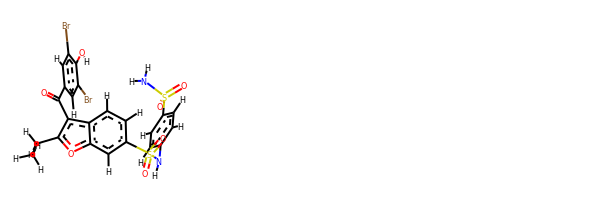

rdkit:  [H]Oc1c(Br)c([H])c(C(=O)c2c(C([H])([H])C([H])([H])[H])oc3c([H])c(S(=O)(=O)N([H])c4c([H])c([H])c(S(=O)(=O)N([H])[H])c([H])c4[H])c([H])c([H])c23)c([H])c1Br
oechem:  CCc1c(c2ccc(cc2o1)S(=O)(=O)Nc3ccc(cc3)S(=O)(=O)N)C(=O)c4cc(c(c(c4)Br)O)Br
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
24.450619244496394 kJ/mol 114404.53186851683 kJ/mol False
angle
27.50019255010027 kJ/mol 28.09794773126973 kJ/mol False
nb
28.184796708829246 kJ/mol 28.184796708829246 kJ/mol True
torsion
68.61774772202048 kJ/mol 15.89956910857266 kJ/mol False
148.7533562254464 kJ/mol 114476.7141820655 kJ/mol

-----------------------------------------------

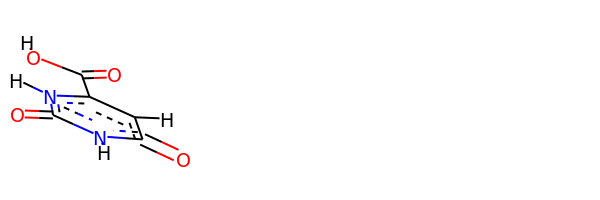

rdkit:  [H]OC(=O)c1c([H])c(=O)n([H])c(=O)n1[H]
oechem:  c1c([nH]c(=O)[nH]c1=O)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ######################

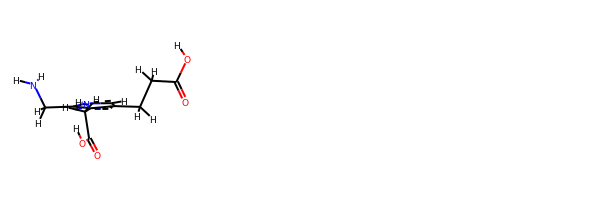

rdkit:  [H]OC(=O)C([H])([H])c1c(C([H])([H])C([H])([H])C(=O)O[H])c([H])n([H])c1C([H])([H])N([H])[H]
oechem:  c1c(c(c([nH]1)CN)CC(=O)O)CCC(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
45.6858154927296 kJ/mol 29115.509532095908 kJ/mol False
angle
122.38001004792238 kJ/mol 122.38001004792238 kJ/mol True
nb
47.23559807081417 kJ/mol 47.23559807081417 kJ/mol T

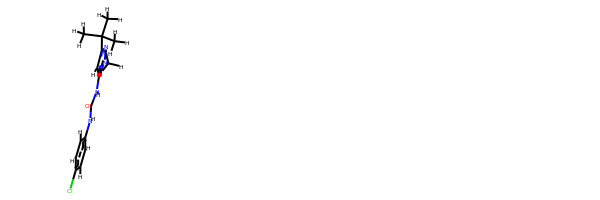

rdkit:  [H]c1c([H])c(N([H])C(=O)N([H])c2c([H])c(C(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H])nn2C([H])([H])[H])c([H])c([H])c1Cl
oechem:  CC(C)(C)c1cc(n(n1)C)NC(=O)Nc2ccc(cc2)Cl
###########################################################################
 #########################################################

bond
9.548993197959069 kJ/mol 57486.45229824483 kJ/mol False
angle
27.60941122566416 kJ/mol 27.75375183943753 kJ/mol False
nb
35.60177025695499 kJ/mol 35.60177025695499 kJ/mol True
torsion
40.20673806663822 kJ/mol 6.737345638126079 kJ/mol False
112.96691274721645 kJ/mol 57556.54516597935 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2012


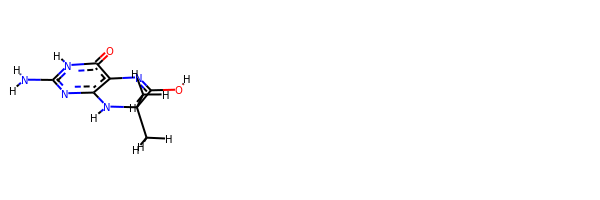

rdkit:  [H]OC1=Nc2c(nc(N([H])[H])n([H])c2=O)N([H])C1(C([H])([H])[H])C([H])([H])[H]
oechem:  CC1(C(=Nc2c(=O)[nH]c(nc2N1)N)O)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
19.834398417154848 kJ/mol 58002.50900893513 kJ/mol False
angle
394.4239837440295 kJ/mol 394.4239837440295 kJ/mol True
nb
9.138858815568828 kJ/mol 9.138858815568828 kJ/mol True
torsion
86.81861142404875 kJ/mol 62.727750554027104 kJ/mol False
510.2158524008019 kJ/mol 58468.799602048755 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
---------------------------------

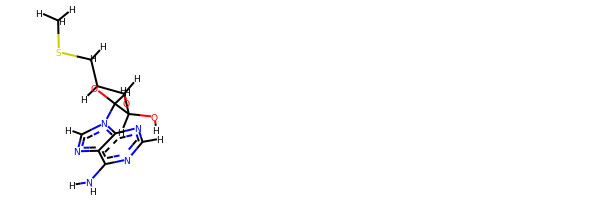

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)OC([H])(C([H])([H])SC([H])([H])[H])C1([H])O[H]
oechem:  CSCC1C(C(C(O1)n2cnc3c2ncnc3N)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
9.202785359498039 kJ/mol 57924.31485701355 kJ/mol False
angle
79.463627702035 kJ/mol 81.3716527149845 kJ/mol False
nb
49.84583872892411 kJ/mol 49.84583872892411 kJ/mol True
torsion
18.840354500024713 kJ/mol 21.98191622798952 kJ/mol False
157.35260629048184 kJ/mol 58077.514264685444 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2018


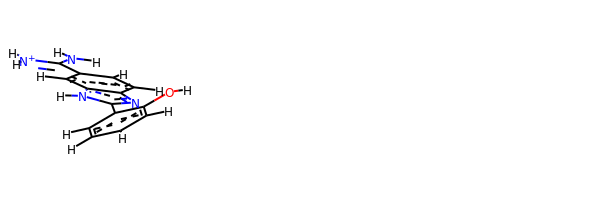

rdkit:  [H]Oc1c([H])c([H])c([H])c([H])c1-c1nc2c([H])c([H])c(C(N([H])[H])=[N+]([H])[H])c([H])c2n1[H]
oechem:  c1ccc(c(c1)c2[nH]c3cc(ccc3n2)C(=[NH2+])N)O
###########################################################################
 #########################################################

bond
30.271109386912872 kJ/mol 57945.38318104097 kJ/mol False
angle
83.1056227575745 kJ/mol 85.01289753327488 kJ/mol False
nb
40.98405130202933 kJ/mol 40.98405130202933 kJ/mol True
torsion
23.02153586759049 kJ/mol 32.435096213166425 kJ/mol False
177.38231931410718 kJ/mol 58103.81522608944 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2019


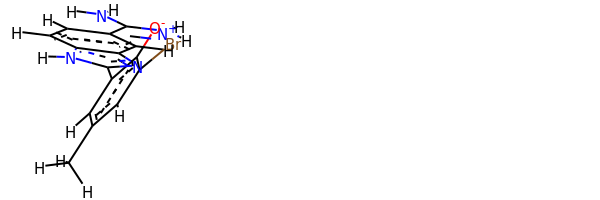

rdkit:  [H]c1c(Br)c([O-])c(-c2nc3c([H])c(C(N([H])[H])=[N+]([H])[H])c([H])c([H])c3n2[H])c([H])c1C([H])([H])[H]
oechem:  Cc1cc(c(c(c1)Br)[O-])c2[nH]c3ccc(cc3n2)C(=[NH2+])N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
76.88157281273573 kJ/mol 226956.31438601736 kJ/mol False
angle
143.13225121191394 kJ/mol 143.82516849999206 kJ/mol False
nb
7.612984643971552 kJ/mol 7.612984643971552 kJ/mol True
torsion
95.42384195435089 kJ/mol 37.713187429082765 kJ/mol False
323.0506506229721 kJ/mol 227145.4657265904 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2021


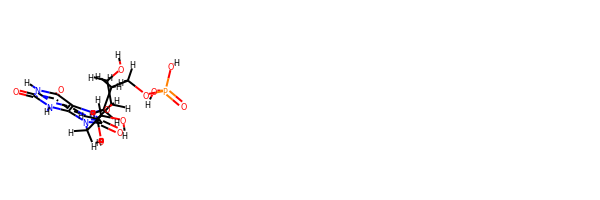

rdkit:  [H]OC([H])([H])C([H])(O[H])C([H])(O[H])C([H])(O[H])C([H])([H])n1c(=O)n(C([H])([H])C([H])([H])C([H])([H])OP(=O)(O[H])O[H])c2c(=O)n([H])c(=O)n([H])c21
oechem:  C(Cn1c2c([nH]c(=O)[nH]c2=O)n(c1=O)CC(C(C(CO)O)O)O)COP(=O)(O)O
###########################################################################
 #########################################################

bond
27.01622296588155 kJ/mol 56856.69559877578 kJ/mol False
angle
55.20075461204883 kJ/mol 55.20075461204883 kJ/mol True
nb
43.50260070923698 kJ/mol 43.50260070923698 kJ/mol True
torsion
31.596479548549596 kJ/mol 31.96557487483784 kJ/mol False
157.31605783571695 kJ/mol 56987.36452897191 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2022


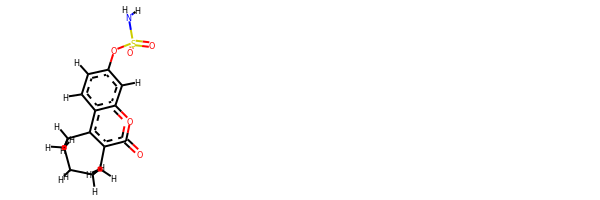

rdkit:  [H]c1c(OS(=O)(=O)N([H])[H])c([H])c2oc(=O)c3c(c2c1[H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C3([H])[H]
oechem:  c1cc2c(cc1OS(=O)(=O)N)oc(=O)c3c2CCCCC3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
10.784962070081487 kJ/mol 29074.39768081055 kJ/mol False
angle
89.29167403627059 kJ/mol 89.29167403627059 kJ/mol True
nb
7.824186501454603 kJ/mol 7.824186501454603 kJ/mol True
torsion
61.975201100212324 kJ/mol 46.8464397214543 kJ/mol False
169.876023708019 kJ/mol 29218.35998106973 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2024


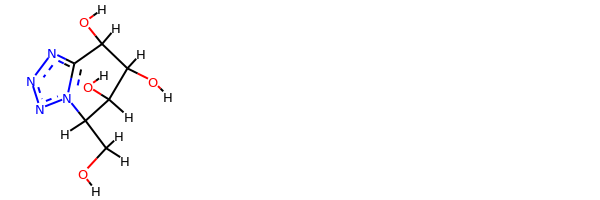

rdkit:  [H]OC([H])([H])C1([H])n2nnnc2C([H])(O[H])C([H])(O[H])C1([H])O[H]
oechem:  C(C1C(C(C(c2n1nnn2)O)O)O)O
###########################################################################
 #########################################################

bond
80.07307213531327 kJ/mol 159462.44739777828 kJ/mol False
angle
257.3858942641265 kJ/mol 260.74270193072005 kJ/mol False
nb
22.535866084969058 kJ/mol 22.535866084969058 kJ/mol True
torsion
39.45081789435139 kJ/mol 17.212299150125666 kJ/mol False
399.4456503787602 kJ/mol 159762.9382649441 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2025


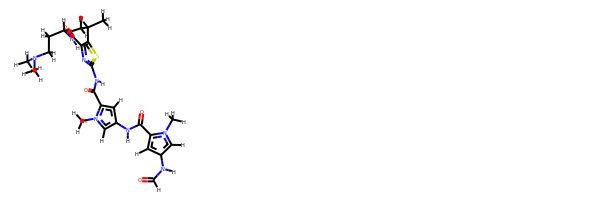

rdkit:  [H]C(=O)N([H])c1c([H])c(C(=O)N([H])c2c([H])c(C(=O)N([H])c3nc(C(=O)N([H])C([H])([H])C([H])([H])C([H])([H])N(C([H])([H])[H])C([H])([H])[H])c(C([H])(C([H])([H])[H])C([H])([H])[H])s3)n(C([H])([H])[H])c2[H])n(C([H])([H])[H])c1[H]
oechem:  CC(C)c1c(nc(s1)NC(=O)c2cc(cn2C)NC(=O)c3cc(cn3C)NC=O)C(=O)NCCCN(C)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########

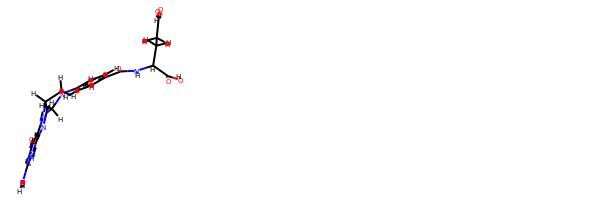

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])C([H])(C(=O)O[H])N([H])C(=O)c1c([H])c([H])c(N2C([H])([H])N3c4c(n([H])c(N([H])[H])nc4=O)N=C([H])C3([H])C2([H])[H])c([H])c1[H]
oechem:  c1cc(ccc1C(=O)NC(CCC(=O)O)C(=O)O)N2CC3C=Nc4c(c(=O)nc([nH]4)N)N3C2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ####

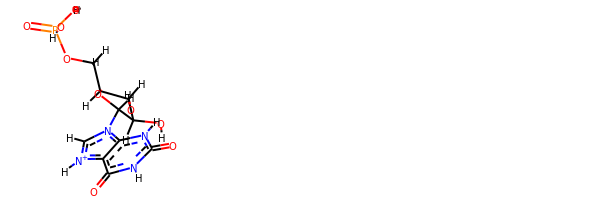

rdkit:  [H]OC1([H])C([H])(n2c([H])[n+]([H])c3c(=O)n([H])c(=O)n([H])c32)OC([H])(C([H])([H])OP(=O)(O[H])O[H])C1([H])O[H]
oechem:  c1[nH+]c2c(n1C3C(C(C(O3)COP(=O)(O)O)O)O)[nH]c(=O)[nH]c2=O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
44.097310185764606 kJ/mol 57759.96271123767 kJ/mol False
angle
376.9085438548495 kJ/mol 376.9085438548495 kJ/mol True
nb
-6.522606267830071 kJ/mol -6.522606267830071 kJ/mol True
torsion
62.76907517440958 kJ/mol 62.769074327269365 kJ/mol False
477.25232294719365 kJ/

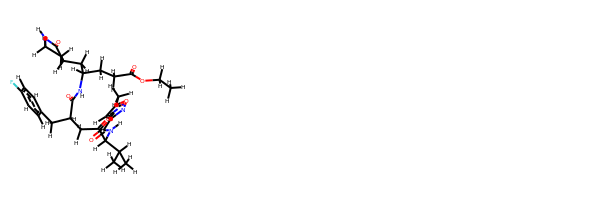

rdkit:  [H]c1c(C(=O)N([H])C([H])(C(=O)C([H])([H])C([H])(C(=O)N([H])C([H])(C([H])([H])C([H])([H])C(=O)OC([H])([H])C([H])([H])[H])C([H])([H])C2([H])C(=O)N([H])C([H])([H])C2([H])[H])C([H])([H])c2c([H])c([H])c(F)c([H])c2[H])C([H])(C([H])([H])[H])C([H])([H])[H])noc1C([H])([H])[H]
oechem:  CCOC(=O)CCC(CC1CCNC1=O)NC(=O)C(Cc2ccc(cc2)F)CC(=O)C(C(C)C)NC(=O)c3cc(on3)C
###########################################################################
 #########################################################

bond
48.68651915890503 kJ/mol 114176.16885221879 kJ/mol False
angle
434.43844301228825 kJ/mol 434.7913109949514 kJ/mol False
nb
12.942395107430286 kJ/mol 12.942395107430286 kJ/mol True
torsion
124.83729891175712 kJ/mol 67.32312152443964 kJ/mol False
620.9046561903806 kJ/mol 114691.22567984562 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
------------------------------------------------------------------

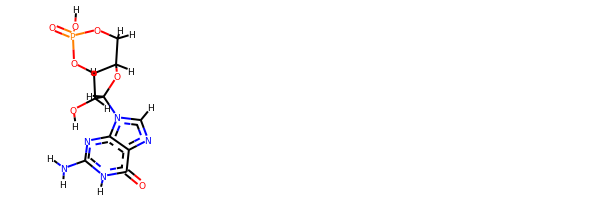

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c(=O)n([H])c(N([H])[H])nc32)OC2([H])C([H])([H])OP(=O)(O[H])OC21[H]
oechem:  c1nc2c(=O)[nH]c(nc2n1C3C(C4C(O3)COP(=O)(O4)O)O)N
###########################################################################
 #########################################################

bond
16.317284524232193 kJ/mol 57771.479453307096 kJ/mol False
angle
105.86766856022156 kJ/mol 105.86766856022156 kJ/mol True
nb
71.79263502270375 kJ/mol 71.79263502270375 kJ/mol True
torsion
19.575867651561428 kJ/mol 19.57588401824497 kJ/mol False
213.55345575871894 kJ/mol 57968.71564090827 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2046


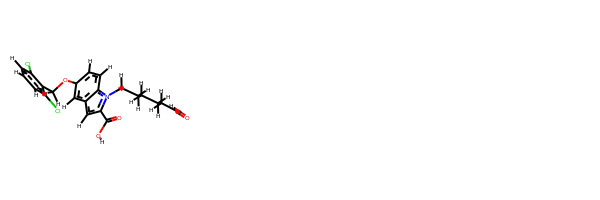

rdkit:  [H]OC(=O)c1c([H])c2c([H])c(OC([H])([H])c3c(Cl)c([H])c([H])c([H])c3Cl)c([H])c([H])c2n1C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C(=O)O[H]
oechem:  c1cc(c(c(c1)Cl)COc2ccc3c(c2)cc(n3CCCCCC(=O)O)C(=O)O)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #####################

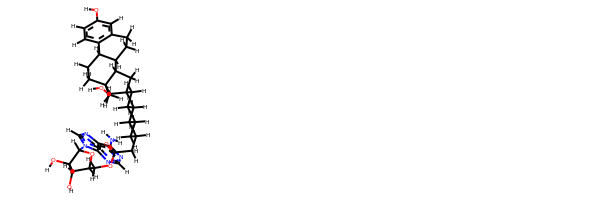

rdkit:  [H]Oc1c([H])c([H])c2c(c1[H])C([H])([H])C([H])([H])C1([H])C2([H])C([H])([H])C([H])([H])C2(C([H])([H])[H])C([H])(O[H])C([H])(C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C(=O)OC([H])([H])C3([H])OC([H])(n4c([H])nc5c(N([H])[H])nc([H])nc54)C([H])(O[H])C3([H])O[H])C([H])([H])C12[H]
oechem:  CC12CCC3c4ccc(cc4CCC3C1CC(C2O)CCCCCCCCC(=O)OCC5C(C(C(O5)n6cnc7c6ncnc7N)O)O)O
###########################################################################
 #########################################################

bond
50.84641578294706 kJ/mol 113419.03278007553 kJ/mol False
angle
338.41208511257247 kJ/mol 339.06143711908635 kJ/mol False
nb
21.95667830911635 kJ/mol 21.95667830911635 kJ/mol True
torsion
120.56807660658251 kJ/mol 63.502725686449594 kJ/mol False
531.7832558112184 kJ/mol 113843.55362119019 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
------------

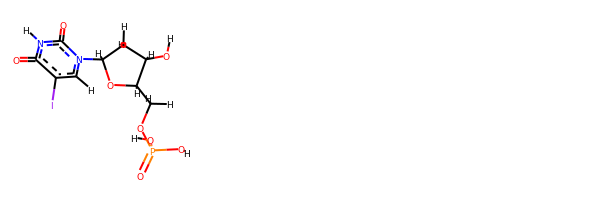

rdkit:  [H]OC1([H])C([H])([H])C([H])(n2c([H])c(I)c(=O)n([H])c2=O)OC1([H])C([H])([H])OP(=O)(O[H])O[H]
oechem:  c1c(c(=O)[nH]c(=O)n1C2CC(C(O2)COP(=O)(O)O)O)I
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
31.702482891955952 kJ/mol 102104.32682709202 kJ/mol False
angle
125.20929421018003 kJ/mol 127.36111303265898 kJ/mol False
nb
46.570653911370634 kJ/mol 46.57065

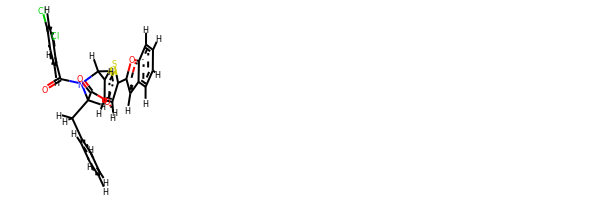

rdkit:  [H]OC(=O)C([H])(N(C(=O)c1c([H])c([H])c(Cl)c([H])c1Cl)C([H])([H])c1sc(-c2oc3c([H])c([H])c([H])c([H])c3c2[H])c([H])c1[H])C([H])([H])c1c([H])c([H])c([H])c([H])c1[H]
oechem:  c1ccc(cc1)CC(C(=O)O)N(Cc2ccc(s2)c3cc4ccccc4o3)C(=O)c5ccc(cc5Cl)Cl
###########################################################################
 #########################################################

bond
54.270630912948334 kJ/mol 113385.69252387538 kJ/mol False
angle
421.45869136076016 kJ/mol 422.0462395714062 kJ/mol False
nb
1.29650519201414 kJ/mol 1.29650519201414 kJ/mol True
torsion
122.44197763783748 kJ/mol 65.37641430332268 kJ/mol False
599.4678051035601 kJ/mol 113874.41168294213 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2062


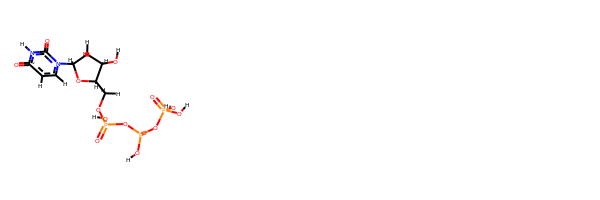

rdkit:  [H]OC1([H])C([H])([H])C([H])(n2c([H])c([H])c(=O)n([H])c2=O)OC1([H])C([H])([H])OP(=O)(O[H])OP(=O)(O[H])OP(=O)(O[H])O[H]
oechem:  c1cn(c(=O)[nH]c1=O)C2CC(C(O2)COP(=O)(O)OP(=O)(O)OP(=O)(O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
20.36394868256265 kJ/mol 58304.846586996304 kJ/mol False
angle
103.27075826623276 kJ/mol 103.27075826623276 kJ/mol Tru

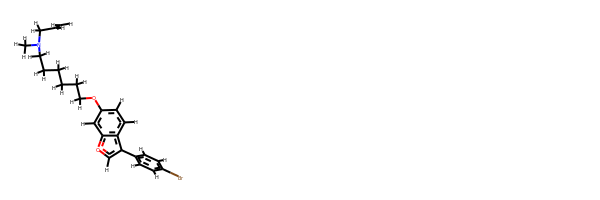

rdkit:  [H]C([H])=C([H])C([H])([H])N(C([H])([H])[H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])Oc1c([H])c([H])c2c(-c3c([H])c([H])c(Br)c([H])c3[H])c([H])oc2c1[H]
oechem:  CN(CCCCCCOc1ccc2c(c1)occ2c3ccc(cc3)Br)CC=C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #######

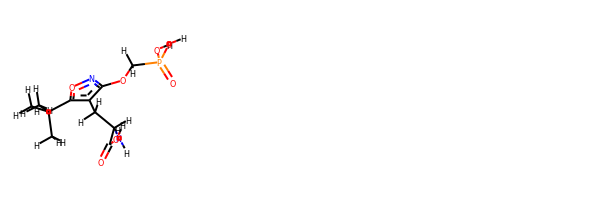

rdkit:  [H]OC(=O)C([H])(N([H])[H])C([H])([H])c1c(OC([H])([H])P(=O)(O[H])O[H])noc1C(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H]
oechem:  CC(C)(C)c1c(c(no1)OCP(=O)(O)O)CC(C(=O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
13.593420991517851 kJ/mol 58034.39584709015 kJ/mol False
angle
260.54592909485785 kJ/mol 262.5566611462128 kJ/mol False
nb
-1.574745271

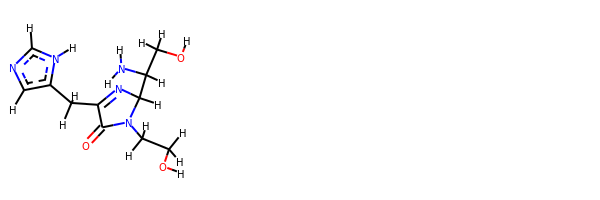

rdkit:  [H]OC([H])([H])C([H])([H])N1C(=O)C(C([H])([H])c2c([H])nc([H])n2[H])=NC1([H])C([H])(N([H])[H])C([H])([H])O[H]
oechem:  c1c([nH]cn1)CC2=NC(N(C2=O)CCO)C(CO)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
41.90370436315399 kJ/mol 41.90370436315399 kJ/mol True
angle
80.49804847656618 kJ/mol 80.49804847656618 kJ/mol True
nb
81.08324528905254 kJ/mol 81.08324528905254 kJ/mol True
torsion
8.066930905144714 kJ/mol 8.066930905144716 kJ/mol False
211.55192903391742 kJ/mol 211.55192903391745 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2087


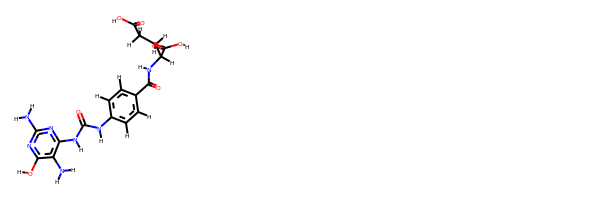

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])C([H])(C(=O)O[H])N([H])C(=O)c1c([H])c([H])c(N([H])C(=O)N([H])c2nc(N([H])[H])nc(O[H])c2N([H])[H])c([H])c1[H]
oechem:  c1cc(ccc1C(=O)NC(CCC(=O)O)C(=O)O)NC(=O)Nc2c(c(nc(n2)N)O)N
###########################################################################
 #########################################################

bond
22.921600375854386 kJ/mol 58007.41015420238 kJ/mol False
angle
110.68038975579438 kJ/mol 110.68038975579438 kJ/mol True
nb
84.69341580752771 kJ/mol 84.69341580752771 kJ/mol True
torsion
6.405597940094044 kJ/mol 1.9323211702754517 kJ/mol False
224.70100387927053 kJ/mol 58204.71628093597 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2088


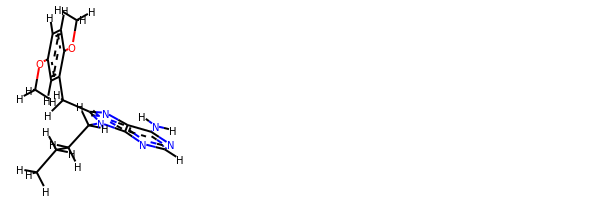

rdkit:  [H]c1nc(N([H])[H])c2nc(C([H])([H])c3c([H])c(OC([H])([H])[H])c([H])c([H])c3OC([H])([H])[H])n(C([H])([H])C([H])([H])C([H])([H])C([H])([H])[H])c2n1
oechem:  CCCCn1c(nc2c1ncnc2N)Cc3cc(ccc3OC)OC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #############################################

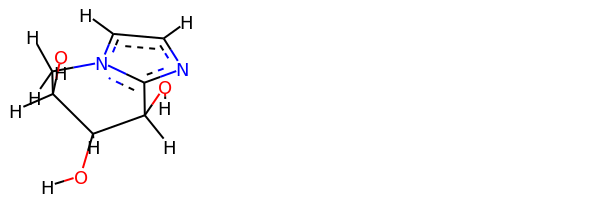

rdkit:  [H]OC1([H])c2nc([H])c([H])n2C([H])([H])C([H])(O[H])C1([H])O[H]
oechem:  c1cn2c(n1)C(C(C(C2)O)O)O
###########################################################################
 #########################################################

bond
15.817507829887269 kJ/mol 57543.936565766024 kJ/mol False
angle
16.080732089364002 kJ/mol 16.080732089364002 kJ/mol True
nb
52.603676138595105 kJ/mol 52.603676138595105 kJ/mol True
torsion
15.599297107293506 kJ/mol 15.598391299476043 kJ/mol False
100.10121316513988 kJ/mol 57628.219365293466 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2103


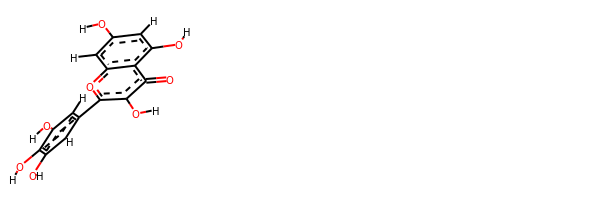

rdkit:  [H]Oc1c([H])c(-c2oc3c([H])c(O[H])c([H])c(O[H])c3c(=O)c2O[H])c([H])c(O[H])c1O[H]
oechem:  c1c(cc(c(c1O)O)O)c2c(c(=O)c3c(cc(cc3o2)O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
19.817068758027492 kJ/mol 114147.03319700519 kJ/mol False
angle
108.53883085075846 kJ/mol 111.1100572610899 kJ/mol False
nb
17.025714829466008 kJ/mol 17.025714829466008 kJ/mol True
torsion
33.47206050807835 kJ/mol 6.0472514919483035e-05 kJ/mol False
178.85367494633033 kJ/mol 114275.16902956826 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2105


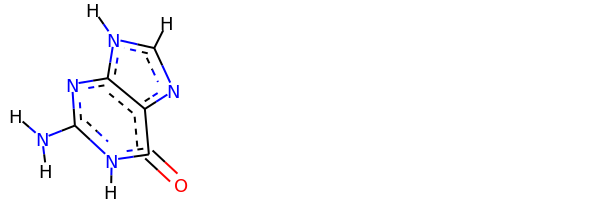

rdkit:  [H]c1nc2c(=O)n([H])c(N([H])[H])nc2n1[H]
oechem:  c1[nH]c2c(n1)c(=O)[nH]c(n2)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
32.98424605521423 kJ/mol 114508.0654805273 kJ/mol False
angle
414.1390713070349 kJ/mol 414.3016087957939 kJ/mol False
nb
15.059140325775019 kJ/mol 15.059140325775019 kJ/mol True
torsion
88.93905856399489 kJ/mol 48.14206112675559 kJ/mol False
551.1215162520191 kJ/mol 114985.56829077561 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
Dru

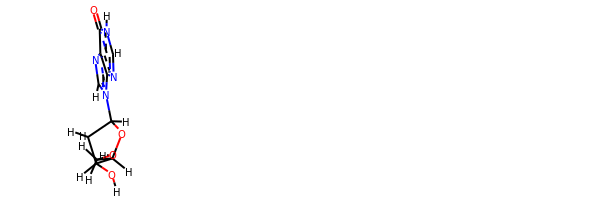

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])nc3c(=O)n([H])c([H])nc32)C([H])([H])C1([H])O[H]
oechem:  c1[nH]c(=O)c2c(n1)n(cn2)C3CC(C(O3)CO)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
13.87398540780815 kJ/mol 57058.7381131694 kJ/mol False
angle
37.171086183687876 kJ/mol 37.406845888160866 kJ/mol False
nb
39.61913920138057 kJ/mol 39.61913920138057 kJ/mol True
torsion
55.80934316037264 kJ/mol 22.33737076720177 kJ/mol False
146.47355395324922 kJ/mol 57158.101469026136 kJ/mol

---------------

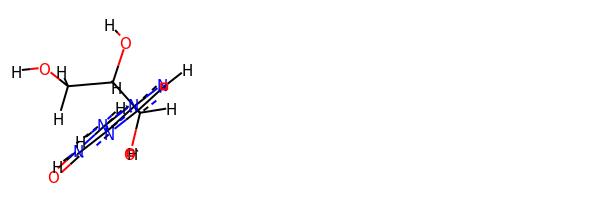

rdkit:  [H]OC([H])([H])C([H])(O[H])C([H])(O[H])c1nc2c(=O)n([H])c(N([H])[H])nc2nc1[H]
oechem:  c1c(nc2c(=O)[nH]c(nc2n1)N)C(C(CO)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
12.001545942509466 kJ/mol 58033.81485862628 kJ/mol False
angle
116.15033505865699 kJ/mol 116.15033505865699 kJ/mol True
nb
39.37266833843576 kJ/mol 39.37266833843576 kJ/mol True
torsion
58.47657533639369 kJ/mol 54.33915995962182 kJ/mol False
226.00112467599592 kJ/mol 58243.677021983 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
----------------------------

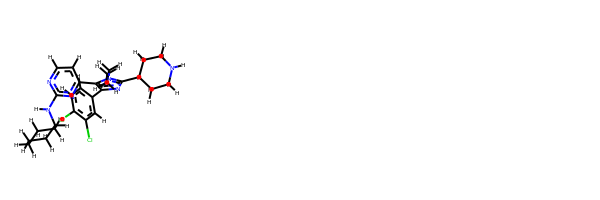

rdkit:  [H]c1nc(N([H])C2([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C2([H])[H])nc(-c2c(-c3c([H])c([H])c(Cl)c(Cl)c3[H])nc(C3([H])C([H])([H])C([H])([H])N([H])C([H])([H])C3([H])[H])n2C([H])([H])C([H])([H])C([H])([H])[H])c1[H]
oechem:  CCCn1c(c(nc1C2CCNCC2)c3ccc(c(c3)Cl)Cl)c4ccnc(n4)NC5CCCCC5
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
19.328488795200762 kJ/mol 114569.69937995572 kJ/mol False
angle
115.50153451968971 kJ/mol 115.78293331247562 kJ/mol False
nb
17.422984587944693 kJ/mol 17.422984587944693 kJ/mol True
torsion
47.93153557938995 kJ/mol 11.672308153655672 kJ/mol False
200.1845434822251 kJ/mol 114714.57760600981 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------

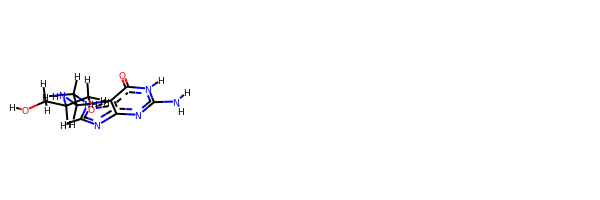

rdkit:  [H]OC([H])([H])C([H])(N([H])C([H])([H])C([H])([H])n1c([H])nc2nc(N([H])[H])n([H])c(=O)c21)C([H])([H])O[H]
oechem:  c1nc2c(n1CCNC(CO)CO)c(=O)[nH]c(n2)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
26.068232034605714 kJ/mol 57886.69621302317 kJ/mol False
angle
429.9119594455431 kJ/mol 429.9119594455431 kJ/mol True
nb
31.706072991221326 kJ/mol 31.706072991221326 kJ/mol True
torsion
30.108010537308438 kJ/mol 29.40279218987469 kJ/mol False
517.7942750086786 kJ/mol 58377.7170376498 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------


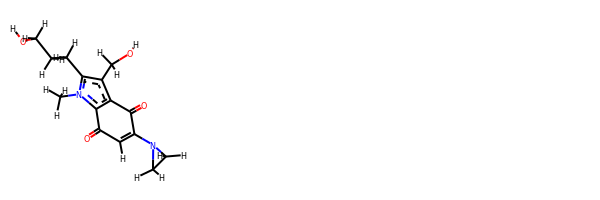

rdkit:  [H]OC([H])([H])c1c2c(n(C([H])([H])[H])c1C([H])([H])C([H])([H])C([H])([H])O[H])C(=O)C([H])=C(N1C([H])([H])C1([H])[H])C2=O
oechem:  Cn1c(c(c2c1C(=O)C=C(C2=O)N3CC3)CO)CCCO
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
43.139414205869734 kJ/mol 57897.5153966173 kJ/mol False
angle
93.16528549615786 kJ/mol 93.16528549615786 kJ/mol True
nb
62.43297038712507 kJ/mol 62.43297038712507 kJ/mol True
torsion
17.641244670863607 kJ/mol 17.641260649959104 kJ/mol False
216.37891476001627 kJ/mol 58070.7

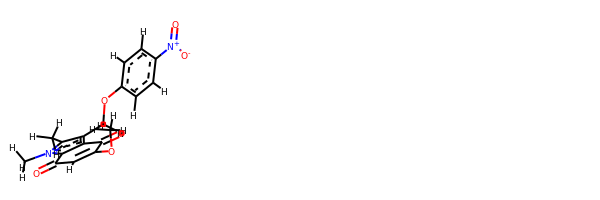

rdkit:  [H]C1=C(OC([H])([H])[H])C(=O)c2c(C([H])([H])Oc3c([H])c([H])c([N+](=O)[O-])c([H])c3[H])c(C([H])([H])[H])n(C([H])([H])[H])c2C1=O
oechem:  Cc1c(c2c(n1C)C(=O)C=C(C2=O)OC)COc3ccc(cc3)[N+](=O)[O-]
###########################################################################
 #########################################################

bond
14.735227405415184 kJ/mol 56737.684640708205 kJ/mol False
angle
87.40702174691015 kJ/mol 87.40702174691015 kJ/mol True
nb
4.389710898296839 kJ/mol 4.389710898296839 kJ/mol True
torsion
0.0006668028906036097 kJ/mol 0.0008356404366098912 kJ/mol False
106.53262685351278 kJ/mol 56829.48220899385 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2127


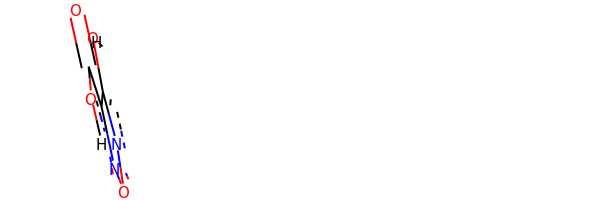

rdkit:  [H]OC(=O)c1nonc1O[H]
oechem:  c1(c(non1)O)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
14.389406074456936 kJ/mol 57997.322855775026 kJ/mol False
angle
105.94674907877105 kJ/mol 108.06748104813688 kJ/mol False


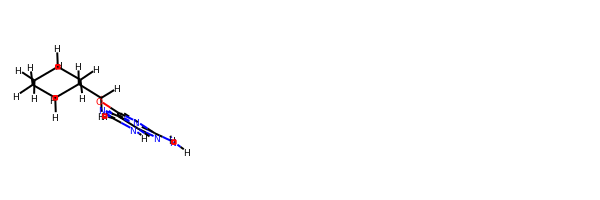

rdkit:  [H]c1nc2c(OC([H])([H])C3([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C3([H])[H])nc(N([H])[H])nc2n1[H]
oechem:  c1[nH]c2c(n1)c(nc(n2)N)OCC3CCCCC3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################

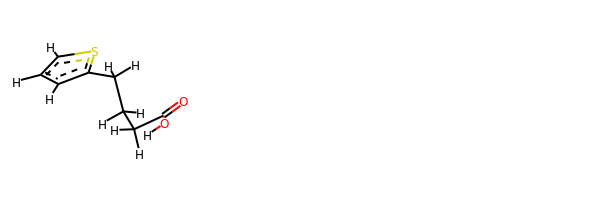

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])C([H])([H])c1sc([H])c([H])c1[H]
oechem:  c1cc(sc1)CCCC(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
20.569682820225047 kJ/mol 114926.53828697282 kJ/mol False
angle
97.80279315209333 kJ/mol 100.28813161556039 kJ/mol False
nb
10.685401903861168 kJ/mol 10.685401903861168 kJ/mol True
torsion
36.03007540202875 kJ/mol 1.

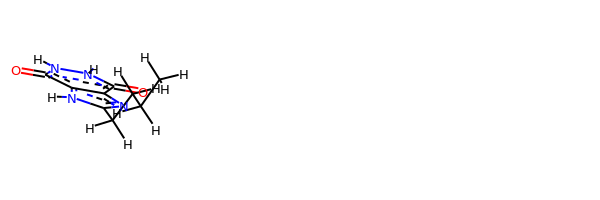

rdkit:  [H]n1c(C([H])([H])C([H])([H])C([H])([H])C([H])([H])[H])nc2c(=O)n([H])n([H])c(=O)c21
oechem:  CCCCc1[nH]c2c(n1)c(=O)[nH][nH]c2=O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

################################################

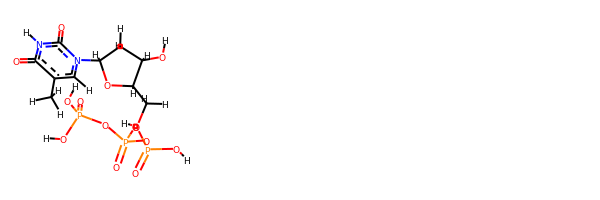

rdkit:  [H]OC1([H])C([H])([H])C([H])(n2c([H])c(C([H])([H])[H])c(=O)n([H])c2=O)OC1([H])C([H])([H])OP(=O)(O[H])OP(=O)(O[H])OP(=O)(O[H])O[H]
oechem:  Cc1cn(c(=O)[nH]c1=O)C2CC(C(O2)COP(=O)(O)OP(=O)(O)OP(=O)(O)O)O
###########################################################################
 #########################################################

bond
27.34715924338812 kJ/mol 58007.9276521196 kJ/mol False
angle
420.7536853708859 kJ/mol 420.7536853708859 kJ/mol True
nb
16.587411708358744 kJ/mol 16.587411708358744 kJ/mol True
torsion
88.10453881113295 kJ/mol 63.984836766127266 kJ/mol False
552.7927951337658 kJ/mol 58509.25358596497 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2175


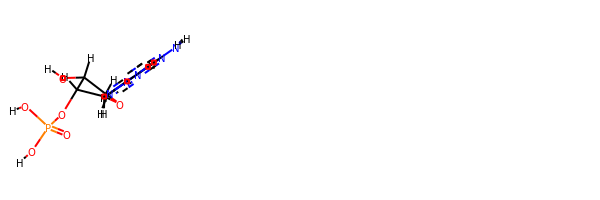

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)OC([H])([H])C1([H])OP(=O)(O[H])O[H]
oechem:  c1nc(c2c(n1)n(cn2)C3C(C(CO3)OP(=O)(O)O)O)N
###########################################################################
 #########################################################

bond
38.91638036508713 kJ/mol 56504.880351316424 kJ/mol False
angle
326.5226707234656 kJ/mol 326.5226707234656 kJ/mol True
nb
19.781479464018645 kJ/mol 19.781479464018645 kJ/mol True
torsion
114.0159109099372 kJ/mol 73.72675814877927 kJ/mol False
499.23644146250854 kJ/mol 56924.91125965269 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2177


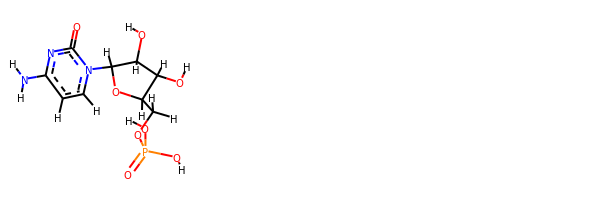

rdkit:  [H]OC1([H])C([H])(n2c([H])c([H])c(N([H])[H])nc2=O)OC([H])(C([H])([H])OP(=O)(O[H])O[H])C1([H])O[H]
oechem:  c1cn(c(=O)nc1N)C2C(C(C(O2)COP(=O)(O)O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
14.254583260869007 kJ/mol 42000.33900606312 kJ/mol False
angle
25.000695711091563 kJ/mol 21.099201086243905 kJ/mol False
nb
32.451808628408216 kJ/mol 32.45180

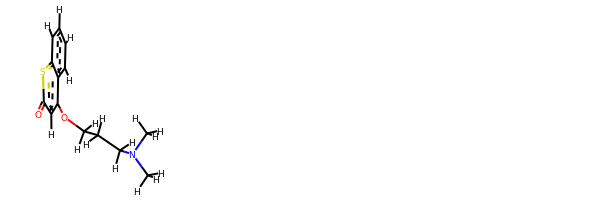

rdkit:  [H]c1c([H])c([H])c2c(OC([H])([H])C([H])([H])C([H])([H])N(C([H])([H])[H])C([H])([H])[H])c([H])c(=O)sc2c1[H]
oechem:  CN(C)CCCOc1cc(=O)sc2c1cccc2
###########################################################################
 #########################################################

bond
11.10744379593726 kJ/mol 57763.01279046275 kJ/mol False
angle
76.67971690782834 kJ/mol 77.91462971692431 kJ/mol False
nb
37.494722412426114 kJ/mol 37.494722412426114 kJ/mol True
torsion
32.433931681472714 kJ/mol 32.43394069901525 kJ/mol False
157.71581479766442 kJ/mol 57910.85608329112 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2184


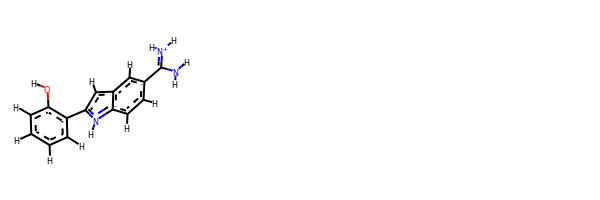

rdkit:  [H]Oc1c([H])c([H])c([H])c([H])c1-c1c([H])c2c([H])c(C(N([H])[H])=[N+]([H])[H])c([H])c([H])c2n1[H]
oechem:  c1ccc(c(c1)c2cc3cc(ccc3[nH]2)C(=[NH2+])N)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################

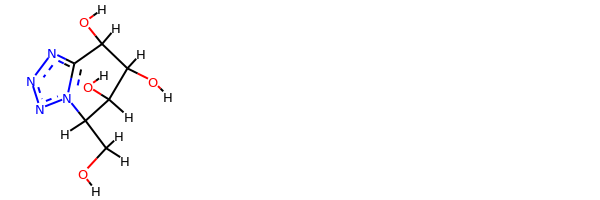

rdkit:  [H]OC([H])([H])C1([H])n2nnnc2C([H])(O[H])C([H])(O[H])C1([H])O[H]
oechem:  C(C1C(C(C(c2n1nnn2)O)O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
27.56063099096403 kJ/mol 58047.79719066034 kJ/mol False
angle
159.25017837695992 kJ/mol 159.25017837695992 kJ/mol True
nb
27.570663696649863 kJ/mol 27.570663696649863 kJ/mol True
torsion
94.24512792709203 kJ/mol 90.03466715048391 kJ/mol False
308.62660099166584 kJ/mol 58324.652699884435 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
----------------------------------------------

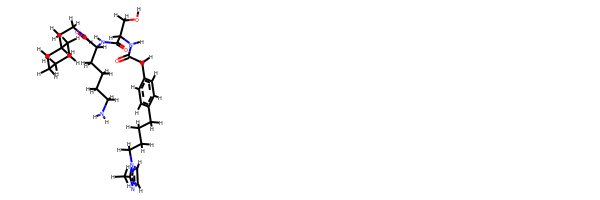

rdkit:  [H]OC([H])([H])C([H])(C(=O)N([H])C([H])(C(=O)N([H])C([H])([H])C([H])([H])C1([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C1([H])[H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])N([H])[H])N([H])C(=O)C([H])([H])c1c([H])c([H])c(C([H])([H])C([H])([H])C([H])([H])C([H])([H])n2c(C([H])([H])[H])nc([H])c2[H])c([H])c1[H]
oechem:  Cc1nccn1CCCCc2ccc(cc2)CC(=O)NC(CO)C(=O)NC(CCCCN)C(=O)NCCC3CCCCC3
###########################################################################
 #########################################################

bond
15.692054179526544 kJ/mol 57767.96175802501 kJ/mol False
angle
114.66645855637447 kJ/mol 114.66645855637447 kJ/mol True
nb
27.567975035842995 kJ/mol 27.567975035842995 kJ/mol True
torsion
75.99380778926783 kJ/mol 75.99382231538912 kJ/mol False
233.92029556101184 kJ/mol 57986.19001393262 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
------------------------------

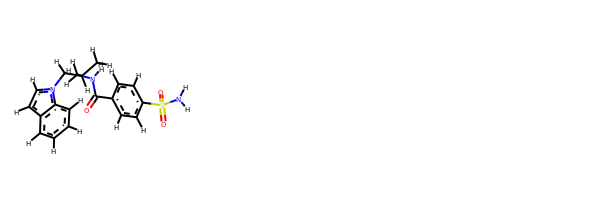

rdkit:  [H]c1c([H])c(S(=O)(=O)N([H])[H])c([H])c([H])c1C(=O)N([H])C([H])([H])C([H])(C([H])([H])[H])C([H])([H])n1c([H])c([H])c2c([H])c([H])c([H])c([H])c21
oechem:  CC(CNC(=O)c1ccc(cc1)S(=O)(=O)N)Cn2ccc3c2cccc3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ###################################

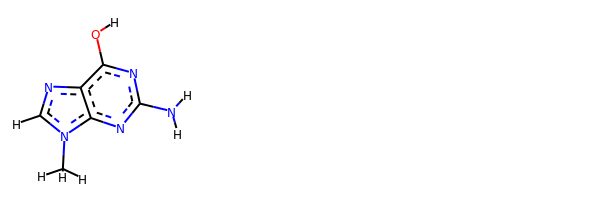

rdkit:  [H]Oc1nc(N([H])[H])nc2c1nc([H])n2C([H])([H])[H]
oechem:  Cn1cnc2c1nc(nc2O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
22.03640819001536 kJ/mol 114149.25253643717 kJ/mol False
angle
125.30043809030002 kJ/mol 125.65

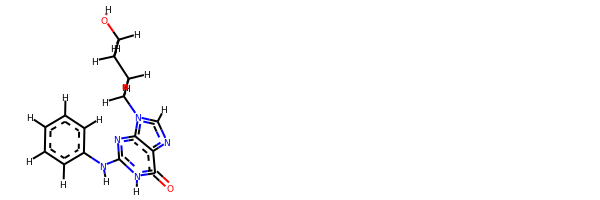

rdkit:  [H]OC([H])([H])C([H])([H])C([H])([H])C([H])([H])n1c([H])nc2c(=O)n([H])c(N([H])c3c([H])c([H])c([H])c([H])c3[H])nc21
oechem:  c1ccc(cc1)Nc2[nH]c(=O)c3c(n2)n(cn3)CCCCO
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
22.300391399153526 kJ/mol 114562.99277338882 kJ/mol False
angle
34.791393488278494 kJ/mol 35.492282974471884 kJ/mol False
nb
31.100900663146057 kJ/mol 31.100900663146057 kJ/mol True
torsion
52.447526541624015 kJ/mol 1.9233442422212796 kJ/mol False
140.6402120922021 kJ/mol 11463

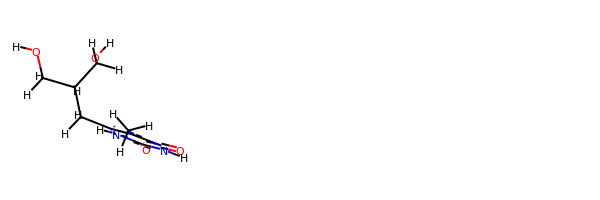

rdkit:  [H]OC([H])([H])C([H])(C([H])([H])O[H])C([H])([H])c1c(C([H])([H])[H])c(=O)n([H])c(=O)n1[H]
oechem:  Cc1c([nH]c(=O)[nH]c1=O)CC(CO)CO
###########################################################################
 #########################################################

bond
39.57854436861048 kJ/mol 114167.21808071232 kJ/mol False
angle
403.54242930426653 kJ/mol 403.8946647242419 kJ/mol False
nb
13.741780654529315 kJ/mol 13.741780654529315 kJ/mol True
torsion
111.44685639027755 kJ/mol 54.39619548270927 kJ/mol False
568.3096107176839 kJ/mol 114639.2507215738 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2220


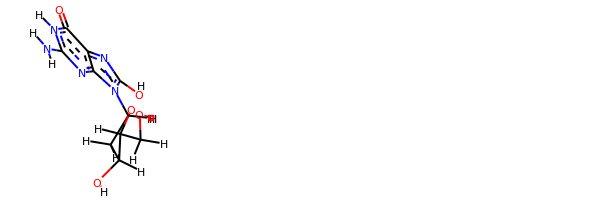

rdkit:  [H]Oc1nc2c(=O)n([H])c(N([H])[H])nc2n1C1([H])OC([H])(C([H])([H])O[H])C([H])(O[H])C1([H])[H]
oechem:  C1C(C(OC1n2c3c(c(=O)[nH]c(n3)N)nc2O)CO)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
28.74202877147102 kJ/mol 57780.647375438275 kJ/mol False
angle
116.90560285360488 kJ/mol 116.90560285360488 kJ/mol True
nb
32.878009778886806 kJ/mol 32.878009778886806 kJ/mol True
torsion
59.00168698645065 kJ/mol 36.10885171886916 kJ/mol False
237.52732839041335 kJ/mol 57966.539839789635 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2222


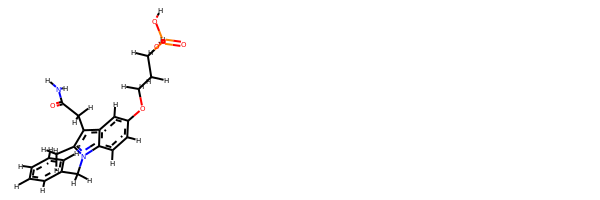

rdkit:  [H]OP(=O)(O[H])C([H])([H])C([H])([H])C([H])([H])Oc1c([H])c([H])c2c(c1[H])c(C([H])([H])C(=O)N([H])[H])c(C([H])([H])[H])n2C([H])([H])c1c([H])c([H])c([H])c([H])c1[H]
oechem:  Cc1c(c2cc(ccc2n1Cc3ccccc3)OCCCP(=O)(O)O)CC(=O)N
###########################################################################
 #########################################################

bond
25.165757085505984 kJ/mol 58046.13892476952 kJ/mol False
angle
116.13799719604943 kJ/mol 118.14773072620879 kJ/mol False
nb
813.9572046689447 kJ/mol 813.9572046689447 kJ/mol True
torsion
72.16286523920432 kJ/mol 56.210337956571955 kJ/mol False
1027.4238241897044 kJ/mol 59034.454198121246 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2223


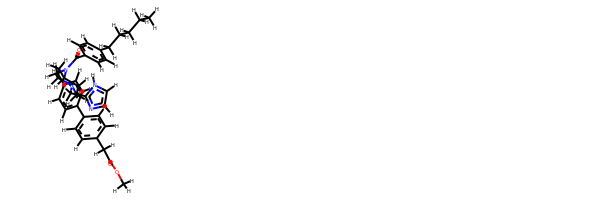

rdkit:  [H]c1nc(C([H])([H])N2C([H])([H])C([H])([H])C([H])(N(C(=O)c3c([H])c([H])c(C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])[H])c([H])c3[H])C([H])([H])c3c([H])c([H])c(-c4c([H])c([H])c(C([H])([H])C(=O)OC([H])([H])[H])c([H])c4[H])c([H])c3[H])C([H])([H])C2([H])[H])n([H])c1[H]
oechem:  CCCCCc1ccc(cc1)C(=O)N(Cc2ccc(cc2)c3ccc(cc3)CC(=O)OC)C4CCN(CC4)Cc5[nH]ccn5
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
22.00826177662874 kJ/mol 56752.66944790671 kJ/mol False
angle
25.252724761078213 kJ/mol 25.252724761078213 kJ/mol True
nb
90.49063193502799 kJ/mol 90.49063193502799 kJ/mol True
torsion
7.876462202898107 kJ/mol 2.4901583346656584 kJ/mol False
145.62808067563304 kJ/mol 56870.90296293748 kJ/mol

------------------------------------------------------------

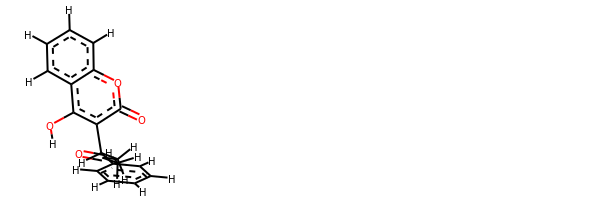

rdkit:  [H]Oc1c(C([H])(c2c([H])c([H])c([H])c([H])c2[H])C([H])([H])C(=O)C([H])([H])[H])c(=O)oc2c([H])c([H])c([H])c([H])c12
oechem:  CC(=O)CC(c1ccccc1)c2c(c3ccccc3oc2=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
46.46031291571016 kJ/mol 58029.134923433674 kJ/mol False
angle
707.7782166741924 kJ/mol 707.7782166741924 kJ/mol True
nb
7.248242709612366 kJ/mol 7.248242709612366 kJ/mol True
torsion
163.53885859233262 kJ/mol 139.44799772231087 kJ/mol False
925.0256308918475 kJ/mol 58883.60938053978 kJ/mol

-------------------------------------------------------------------
---------------------------------------------------------

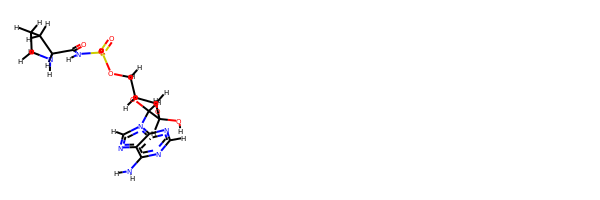

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)OC([H])(C([H])([H])OS(=O)(=O)N([H])C(=O)C2([H])N([H])C([H])([H])C([H])([H])C2([H])[H])C1([H])O[H]
oechem:  c1nc(c2c(n1)n(cn2)C3C(C(C(O3)COS(=O)(=O)NC(=O)C4CCCN4)O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ###############

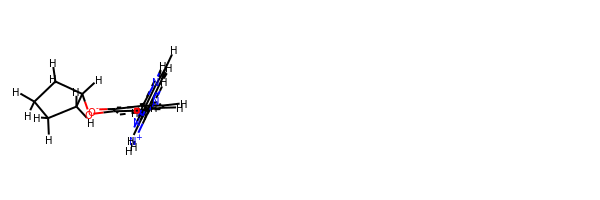

rdkit:  [H]c1c([H])c(OC2([H])C([H])([H])C([H])([H])C([H])([H])C2([H])[H])c([O-])c(-c2nc3c([H])c(C(N([H])[H])=[N+]([H])[H])c([H])c([H])c3n2[H])c1[H]
oechem:  c1cc(c(c(c1)OC2CCCC2)[O-])c3[nH]c4ccc(cc4n3)C(=[NH2+])N
###########################################################################
 #########################################################

bond
33.637114085166054 kJ/mol 58014.39645673102 kJ/mol False
angle
425.01006038032693 kJ/mol 425.01006038032693 kJ/mol True
nb
16.2398973839878 kJ/mol 16.2398973839878 kJ/mol True
torsion
91.54926684931289 kJ/mol 67.48779291048992 kJ/mol False
566.4363386987936 kJ/mol 58523.13420740583 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2245


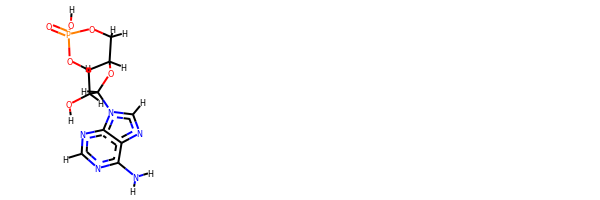

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)OC2([H])C([H])([H])OP(=O)(O[H])OC21[H]
oechem:  c1nc(c2c(n1)n(cn2)C3C(C4C(O3)COP(=O)(O4)O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

#############################

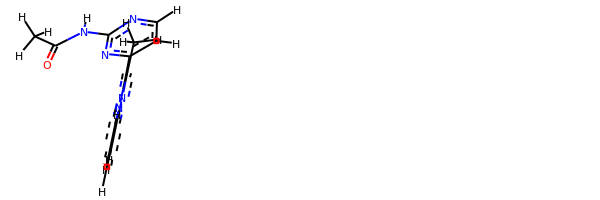

rdkit:  [H]c1nc(N([H])C(=O)C([H])([H])[H])nc(-c2c(C([H])([H])[H])nc3c([H])c([H])c([H])c([H])n23)c1[H]
oechem:  Cc1c(n2ccccc2n1)c3ccnc(n3)NC(=O)C
###########################################################################
 #########################################################

bond
25.109912207322 kJ/mol 57148.46312094908 kJ/mol False
angle
58.38438419242877 kJ/mol 58.64644514168162 kJ/mol False
nb
47.3710627664517 kJ/mol 47.3710627664517 kJ/mol True
torsion
41.43137389943497 kJ/mol 7.959405941933561 kJ/mol False
172.29673306563745 kJ/mol 57262.440034799154 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2257


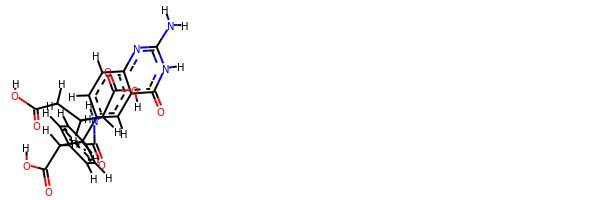

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])C([H])(C(=O)O[H])N([H])C(=O)c1c([H])c([H])c(C([H])(C(=O)O[H])C([H])([H])c2c([H])c([H])c3nc(N([H])[H])n([H])c(=O)c3c2[H])c([H])c1[H]
oechem:  c1cc(ccc1C(Cc2ccc3c(c2)c(=O)[nH]c(n3)N)C(=O)O)C(=O)NC(CCC(=O)O)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
16.821352852171756 kJ/mol 44742.68037490158 kJ/mol False
angle
51.7468708042606 kJ/mol 51.7468708042606 kJ/mol True
nb
48.97610559073151 kJ/mol 48.97610559073151 kJ/mol True
torsion
40.608089167187075 

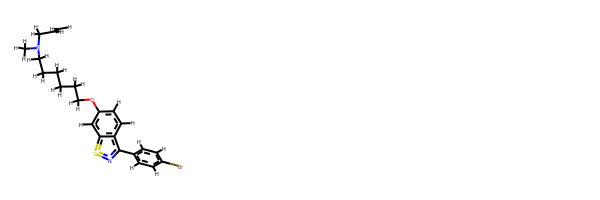

rdkit:  [H]C([H])=C([H])C([H])([H])N(C([H])([H])[H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])Oc1c([H])c([H])c2c(-c3c([H])c([H])c(Br)c([H])c3[H])nsc2c1[H]
oechem:  CN(CCCCCCOc1ccc2c(c1)snc2c3ccc(cc3)Br)CC=C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
56.063915320241044 kJ/mol 113463.8595884523 kJ/mol False
angle
386.1949679861636 kJ/mol 386.8155276726557 kJ/mol False
nb
17.800750441350164 kJ/mol 17.800750441350164 kJ/mol True
torsion
134.40757512209848 kJ/mol 77.3409

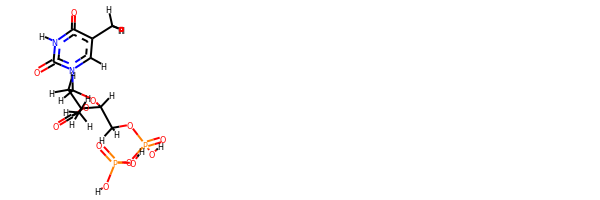

rdkit:  [H]OP(=O)(O[H])OP(=O)(O[H])OC([H])([H])C1([H])OC([H])(n2c([H])c(C([H])([H])[H])c(=O)n([H])c2=O)C([H])([H])C1([H])OC(=O)C([H])([H])[H]
oechem:  Cc1cn(c(=O)[nH]c1=O)C2CC(C(O2)COP(=O)(O)OP(=O)(O)O)OC(=O)C
###########################################################################
 #########################################################

bond
32.53025071753965 kJ/mol 58015.940428763315 kJ/mol False
angle
113.84027709430632 kJ/mol 113.84027709430632 kJ/mol True
nb
27.379022692686462 kJ/mol 27.379022692686462 kJ/mol True
torsion
55.72517465349604 kJ/mol 53.0001678935959 kJ/mol False
229.4747251580285 kJ/mol 58210.1598964439 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2267


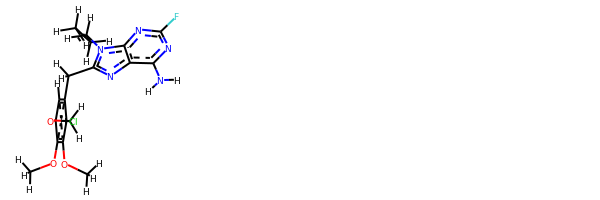

rdkit:  [H]C#CC([H])([H])C([H])([H])C([H])([H])n1c(C([H])([H])c2c([H])c(OC([H])([H])[H])c(OC([H])([H])[H])c(OC([H])([H])[H])c2Cl)nc2c(N([H])[H])nc(F)nc21
oechem:  COc1cc(c(c(c1OC)OC)Cl)Cc2nc3c(nc(nc3n2CCCC#C)F)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
45.97452775002648 kJ/mol 29114.79983963767 kJ/mol False
angle
150.82707850357642 kJ/mol 150.82707850357642 kJ/mol True
nb
81.50072738753269 kJ/mol 81.50072738753269 kJ/mol True
torsion
116.91978450573723 kJ/mol 122.85099977024171 kJ/mol False
395.22211814687284 kJ/mol 29469.978645299023 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_22

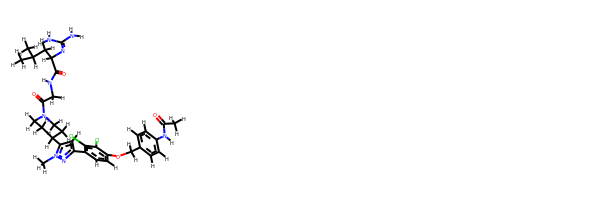

rdkit:  [H]c1c([H])c(-c2nn(C([H])([H])[H])c(C3([H])C([H])([H])C([H])([H])N(C(=O)C([H])([H])N([H])C(=O)C([H])(N=C(N([H])[H])N([H])[H])C([H])([H])C([H])(C([H])([H])[H])C([H])([H])[H])C([H])([H])C3([H])[H])c2[H])c(Cl)c(Cl)c1OC([H])([H])c1c([H])c([H])c(N([H])C(=O)C([H])([H])[H])c([H])c1[H]
oechem:  CC(C)CC(C(=O)NCC(=O)N1CCC(CC1)c2cc(nn2C)c3ccc(c(c3Cl)Cl)OCc4ccc(cc4)NC(=O)C)N=C(N)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################


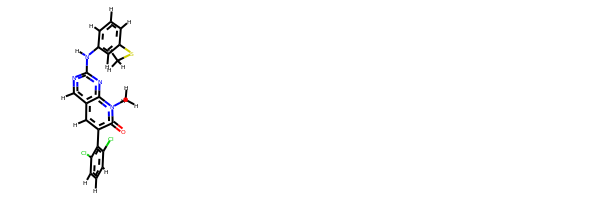

rdkit:  [H]c1c([H])c(Cl)c(-c2c([H])c3c([H])nc(N([H])c4c([H])c([H])c([H])c(SC([H])([H])[H])c4[H])nc3n(C([H])([H])[H])c2=O)c(Cl)c1[H]
oechem:  Cn1c2c(cc(c1=O)c3c(cccc3Cl)Cl)cnc(n2)Nc4cccc(c4)SC
###########################################################################
 #########################################################

bond
16.63847725953684 kJ/mol 115723.28678826855 kJ/mol False
angle
109.03365391248273 kJ/mol 110.90132831052415 kJ/mol False
nb
26.710503612592507 kJ/mol 26.710503612592507 kJ/mol True
torsion
20.711804858879514 kJ/mol 0.0003100195503440639 kJ/mol False
173.0944396434916 kJ/mol 115860.89893021122 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2284


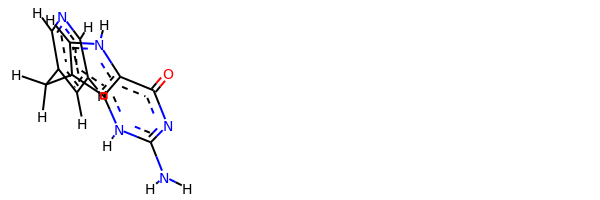

rdkit:  [H]c1nc([H])c(C([H])([H])c2c([H])n([H])c3c(=O)nc(N([H])[H])n([H])c23)c([H])c1[H]
oechem:  c1cc(cnc1)Cc2c[nH]c3c2[nH]c(nc3=O)N
###########################################################################
 #########################################################

bond
50.90263382010737 kJ/mol 113903.4371062832 kJ/mol False
angle
263.3331012780833 kJ/mol 263.9529400587062 kJ/mol False
nb
8.232586006492284 kJ/mol 8.232586006492284 kJ/mol True
torsion
116.06078088214258 kJ/mol 45.228899806282634 kJ/mol False
438.52910198682554 kJ/mol 114220.85153215469 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2285


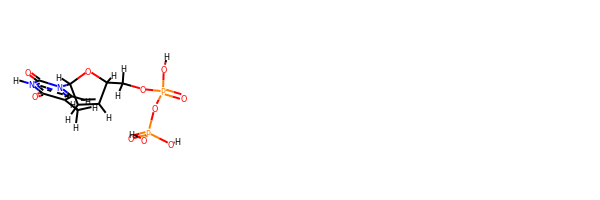

rdkit:  [H]OP(=O)(O[H])OP(=O)(O[H])OC([H])([H])C1([H])OC([H])(n2c([H])c(C([H])([H])[H])c(=O)n([H])c2=O)C([H])=C1[H]
oechem:  Cc1cn(c(=O)[nH]c1=O)C2C=CC(O2)COP(=O)(O)OP(=O)(O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
60.560289553021256 kJ/mol 114568.43394711727 kJ/mol False
angle
723.7413588430564 kJ/mol 723.7413588430564 kJ/mol True
nb
45.10438105802935 kJ/mol 45.10438105802935 kJ/mol True
torsion
196.00263662702818 kJ/mol 127.65156528778316 kJ/mol False
1025.4086660811352 kJ/mol 115464.93125230614 kJ/mol

-------------------------------------------------------------------
-----------------------------------------------

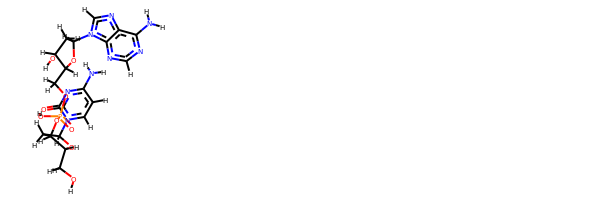

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])c([H])c(N([H])[H])nc2=O)C([H])([H])C1([H])OP(=O)(O[H])OC([H])([H])C1([H])OC([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)C([H])([H])C1([H])O[H]
oechem:  c1cn(c(=O)nc1N)C2CC(C(O2)CO)OP(=O)(O)OCC3C(CC(O3)n4cnc5c4ncnc5N)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

############################################################

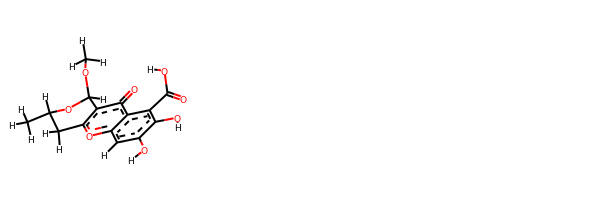

rdkit:  [H]OC(=O)c1c(O[H])c(O[H])c([H])c2oc3c(c(=O)c12)C([H])(OC([H])([H])[H])OC([H])(C([H])([H])[H])C3([H])[H]
oechem:  CC1Cc2c(c(=O)c3c(o2)cc(c(c3C(=O)O)O)O)C(O1)OC
###########################################################################
 #########################################################

bond
33.2265816927548 kJ/mol 56562.18228784281 kJ/mol False
angle
306.3111841928992 kJ/mol 306.3111841928992 kJ/mol True
nb
27.146728214485677 kJ/mol 27.146728214485677 kJ/mol True
torsion
91.07855953198207 kJ/mol 50.74137069091043 kJ/mol False
457.76305363212174 kJ/mol 56946.38157094111 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2308


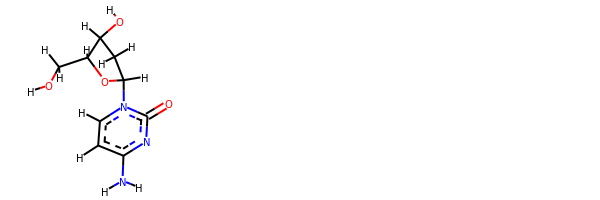

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])c([H])c(N([H])[H])nc2=O)C([H])([H])C1([H])O[H]
oechem:  c1cn(c(=O)nc1N)C2CC(C(O2)CO)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
11.568126336410494 kJ/mol 57132.85435935392 kJ/mol False
angle
15.682542958285664 kJ/mol 15.944255737697272 kJ/mol False
nb
29.64876064983907 kJ/mol 29.64876064983907 kJ/mol True
torsion
37.27824879923723 kJ/mol 3.8062718817338177 kJ/mol False
94.17767874377245 kJ/mol 57182.25364762319 kJ/mol

------------------------

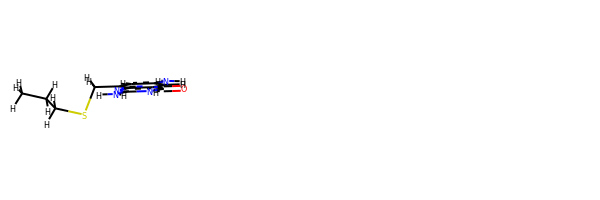

rdkit:  [H]c1c(N([H])[H])c([H])c2c(=O)n([H])c(N([H])[H])nc2c1C([H])([H])SC([H])([H])C([H])([H])C([H])([H])[H]
oechem:  CCCSCc1cc(cc2c1nc([nH]c2=O)N)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
29.839925105162777 kJ/mol 44184.6647327879 kJ/mol False
angle
113.55416179093801 kJ/mol 116.04684515760935 kJ/mol False
nb
25.05942685644024 kJ/mol 25.05942685644024 kJ/mol True
torsion
191.2595058263983 kJ/mol 191.26379016126853 kJ/mol False
359.71301957893934 kJ/mol 44517.03479496322 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2316


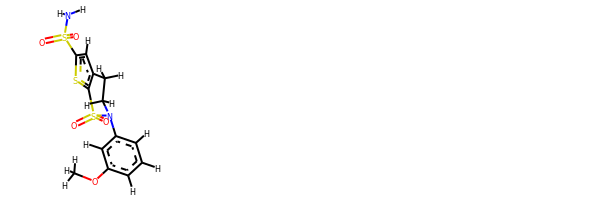

rdkit:  [H]c1c([H])c(OC([H])([H])[H])c([H])c(N2C([H])([H])C([H])([H])c3c(sc(S(=O)(=O)N([H])[H])c3[H])S2(=O)=O)c1[H]
oechem:  COc1cccc(c1)N2CCc3cc(sc3S2(=O)=O)S(=O)(=O)N
###########################################################################
 #########################################################

bond
15.22859958075316 kJ/mol 57933.698117869055 kJ/mol False
angle
90.75908391527392 kJ/mol 92.67607851111026 kJ/mol False
nb
36.61963955831919 kJ/mol 36.61963955831919 kJ/mol True
torsion
23.534463814835526 kJ/mol 23.53446792894638 kJ/mol False
166.1417868691818 kJ/mol 58086.52830386743 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2317


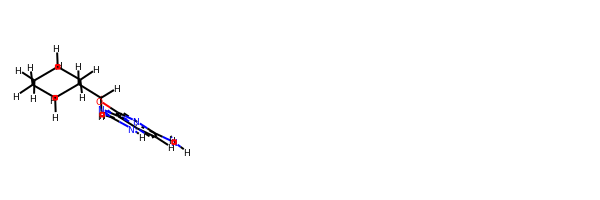

rdkit:  [H]c1c(N([H])[H])nc(OC([H])([H])C2([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C2([H])[H])c2nc([H])n([H])c12
oechem:  c1c2c(c(nc1N)OCC3CCCCC3)nc[nH]2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
32.94550374781326 kJ/mol 58015.62011426579 kJ/mol False
angle
431.452623655715 kJ/mol 431.452623655715 kJ/mol True
nb
13.108349046325577 kJ/mol 13.108349046325577 kJ/mol True
torsion
98.15137678934029 kJ/mol 74.06051591931858 kJ/mol False
575.6578532391941 kJ/mol 58534.24160288715 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------

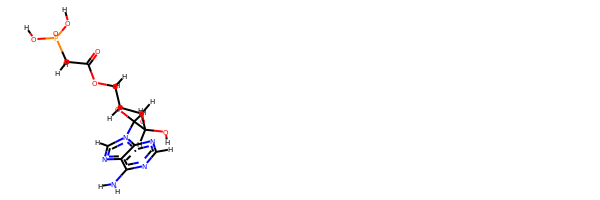

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)OC([H])(C([H])([H])OC(=O)C([H])([H])P(=O)(O[H])O[H])C1([H])O[H]
oechem:  c1nc(c2c(n1)n(cn2)C3C(C(C(O3)COC(=O)CP(=O)(O)O)O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ########################################################

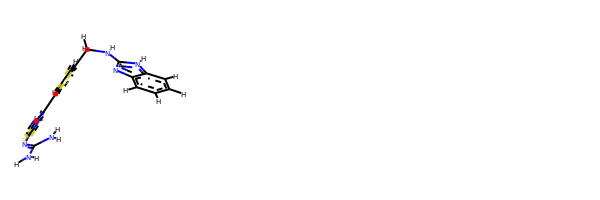

rdkit:  [H]c1sc(N=C(N([H])[H])N([H])[H])nc1-c1sc(C([H])([H])N([H])c2nc3c([H])c([H])c([H])c([H])c3n2[H])c([H])c1[H]
oechem:  c1ccc2c(c1)[nH]c(n2)NCc3ccc(s3)c4csc(n4)N=C(N)N
###########################################################################
 #########################################################

bond
8.70512523244877 kJ/mol 58029.84318648074 kJ/mol False
angle
101.74984505373304 kJ/mol 101.74984505373304 kJ/mol True
nb
60.5658309033717 kJ/mol 60.5658309033717 kJ/mol True
torsion
19.505402681300943 kJ/mol 15.340096371408535 kJ/mol False
190.52620387085446 kJ/mol 58207.49895880926 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2329


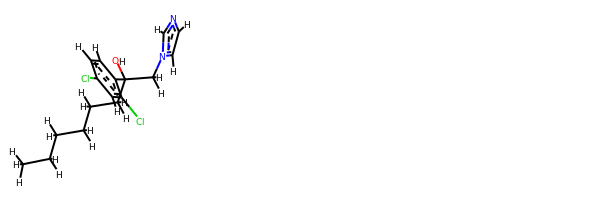

rdkit:  [H]OC(c1c([H])c([H])c(Cl)c([H])c1Cl)(C([H])([H])n1c([H])nc([H])c1[H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])[H]
oechem:  CCCCCCC(Cn1ccnc1)(c2ccc(cc2Cl)Cl)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ####################################################

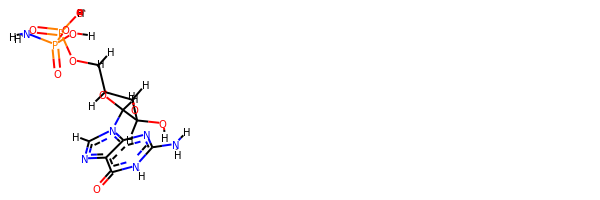

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c(=O)n([H])c(N([H])[H])nc32)OC([H])(C([H])([H])OP(=O)(O[H])OP(=O)(O[H])N([H])[H])C1([H])O[H]
oechem:  c1nc2c(=O)[nH]c(nc2n1C3C(C(C(O3)COP(=O)(O)OP(=O)(N)O)O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #############################################

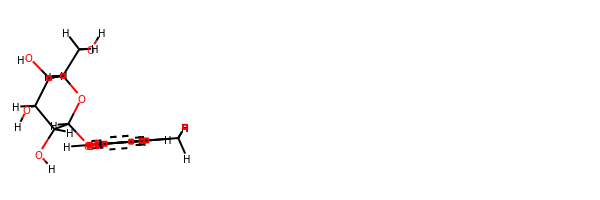

rdkit:  [H]OC([H])([H])C1([H])OC([H])(Oc2c([H])c([H])c3c(C([H])([H])[H])c([H])c(=O)oc3c2[H])C([H])(O[H])C([H])(O[H])C1([H])O[H]
oechem:  Cc1cc(=O)oc2c1ccc(c2)OC3C(C(C(C(O3)CO)O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###

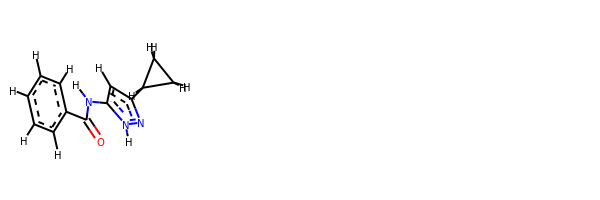

rdkit:  [H]c1c([H])c([H])c(C(=O)N([H])c2c([H])c(C3([H])C([H])([H])C3([H])[H])nn2[H])c([H])c1[H]
oechem:  c1ccc(cc1)C(=O)Nc2cc(n[nH]2)C3CC3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
51.743927893287164 kJ/mol 29103.74606066538 kJ/mol False
angle
177.21136935799947 kJ/mol 177.21136935799947 kJ/mol True
nb
81.90951450324282 kJ/mol 81.90951450324282 kJ/mol True
torsion
19.63941223285972 kJ/mol 4.053683592628468 kJ/mol False
330.5042239873892 kJ/mol 29366.920628119253 kJ/mol

------------------

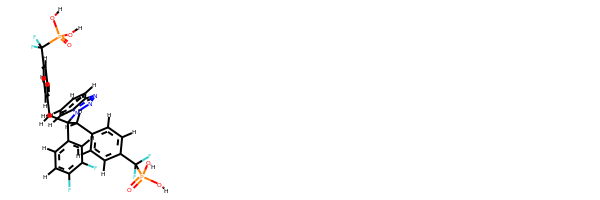

rdkit:  [H]OP(=O)(O[H])C(F)(F)c1c([H])c([H])c(C([H])([H])C(c2c([H])c([H])c(F)c(F)c2[H])(n2nnc3c([H])c([H])c([H])c([H])c32)C([H])([H])c2c([H])c([H])c(C(F)(F)P(=O)(O[H])O[H])c([H])c2[H])c([H])c1[H]
oechem:  c1ccc2c(c1)nnn2C(Cc3ccc(cc3)C(F)(F)P(=O)(O)O)(Cc4ccc(cc4)C(F)(F)P(=O)(O)O)c5ccc(c(c5)F)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
26.066483695282663 kJ/mol 57440.434586684016 kJ/mol False
angle
14.095418005455988 kJ/mol 14.095418005455988 kJ/mol True
nb
53.955922663902996 kJ/mol 53.955922663902996 kJ/mol True
torsion
30.23241040564351 kJ/mol 30.232428174409083 kJ/mol False
124.35023477028516 kJ/mol 57538.71835552778 kJ/

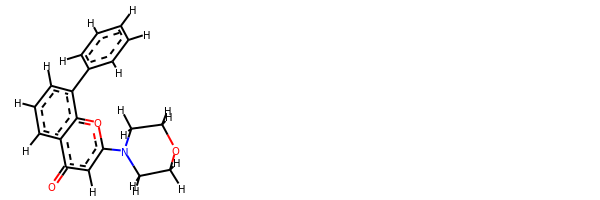

rdkit:  [H]c1c([H])c([H])c(-c2c([H])c([H])c([H])c3c(=O)c([H])c(N4C([H])([H])C([H])([H])OC([H])([H])C4([H])[H])oc23)c([H])c1[H]
oechem:  c1ccc(cc1)c2cccc3c2oc(cc3=O)N4CCOCC4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########

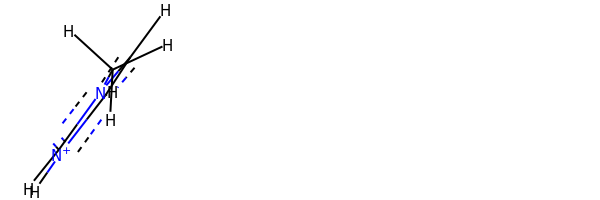

rdkit:  [H]c1c([H])[n+]([H])c([H])n1C([H])([H])[H]
oechem:  Cn1cc[nH+]c1
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ##################################

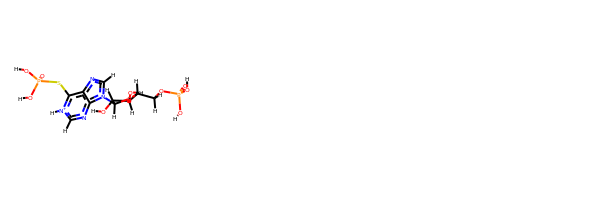

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c(SP(=O)(O[H])O[H])[n+]([H])c([H])nc32)OC([H])(C([H])([H])OP(=O)(O[H])O[H])C1([H])O[H]
oechem:  c1[nH+]c(c2c(n1)n(cn2)C3C(C(C(O3)COP(=O)(O)O)O)O)SP(=O)(O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
46.699300746889314 kJ/mol 58028.57013951448 kJ/mol False
angle
440.9097043228999 kJ/mol 440.9097043228999 kJ/mol True
nb
5.45339158748953 kJ/mol 5.45339158748953 kJ/mol True
torsion
138.0542650707088 kJ/mol 114.46979416141296 kJ/mol False
631.1166617279875 kJ/mol 58589.40302958628 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2393


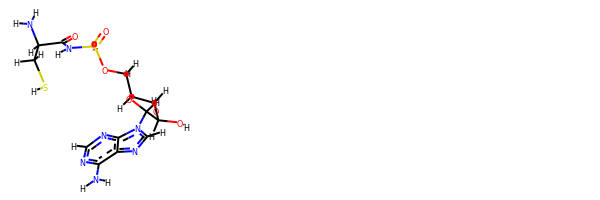

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)OC([H])(C([H])([H])OS(=O)(=O)N([H])C(=O)C([H])(N([H])[H])C([H])([H])S[H])C1([H])O[H]
oechem:  c1nc(c2c(n1)n(cn2)C3C(C(C(O3)COS(=O)(=O)NC(=O)C(CS)N)O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
8.093552067175821 kJ/mol 57358.37259609234 kJ/mol False
angle
12.321855440742226 kJ/mol 12.4502027588

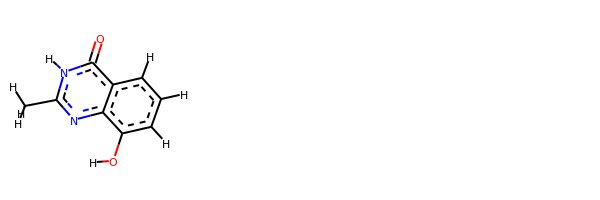

rdkit:  [H]Oc1c([H])c([H])c([H])c2c(=O)n([H])c(C([H])([H])[H])nc12
oechem:  Cc1[nH]c(=O)c2cccc(c2n1)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
10.187709763376706 kJ/mol 57392.24407147895 kJ/mol False
angle
27.317217038079722 kJ/mol 27.47600752076951 kJ/mol False
nb
36.67895194176636 kJ/mol 36.67895194176636 kJ/mol True
torsion
53.09419720746476 kJ/mol 19.62624953607302 kJ/mol False
127.27807595068755 kJ/mol 57476.02528047755 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2400


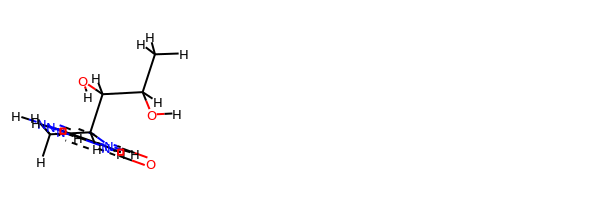

rdkit:  [H]OC([H])(C([H])([H])[H])C([H])(O[H])C1([H])N([H])c2c(nc(N([H])[H])n([H])c2=O)N([H])C1([H])[H]
oechem:  CC(C(C1CNc2c(c(=O)[nH]c(n2)N)N1)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
29.648950451223552 kJ/mol 58012.38076699791 kJ/mol False
angle
451.0519822749654 kJ/mol 451.0519822749654 kJ/mol True
nb
20.13548717704151 kJ/mol 20.13548717704151 kJ/mol True
torsion
98.87096727810776 kJ/mol 74.77972256306549 kJ/mol False
599.7073871813382 kJ/mol 58558.34795901297 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2402


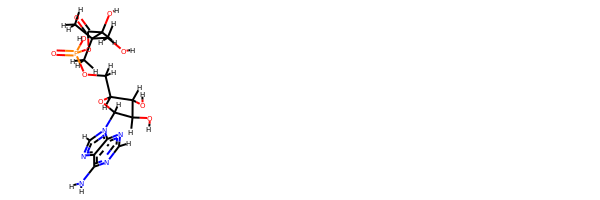

rdkit:  [H]OC([H])([H])C(C([H])([H])[H])(C([H])([H])[H])C([H])(O[H])C(=O)OP(=O)(O[H])OC([H])([H])C1([H])OC([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)C([H])(O[H])C1([H])O[H]
oechem:  CC(C)(CO)C(C(=O)OP(=O)(O)OCC1C(C(C(O1)n2cnc3c2ncnc3N)O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
56.64446587710027 kJ/mol 113327.21673650491 kJ/mol False
angle
400.97138804167497 kJ/mol 401.55979128591133 kJ/mol False
nb
3.65059459710186 kJ/mol 3.65059459710186 kJ/mol True
torsion
158.0522721020479 kJ/mol 101.02673763974221 kJ/mol False
619.318720617925 kJ/mol 113833.45386002766 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------

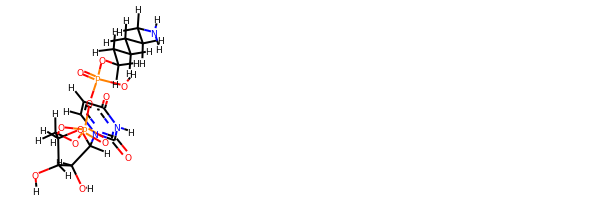

rdkit:  [H]OC1([H])C([H])(n2c([H])c([H])c(=O)n([H])c2=O)OC([H])(C([H])([H])OP(=O)(O[H])OP(=O)(O[H])OC([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])N([H])[H])C1([H])O[H]
oechem:  c1cn(c(=O)[nH]c1=O)C2C(C(C(O2)COP(=O)(O)OP(=O)(O)OCCCCCCN)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

#############################################################

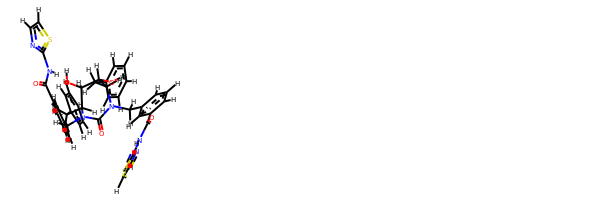

rdkit:  [H]OC1([H])C([H])(O[H])C([H])(C([H])([H])c2c([H])c([H])c([H])c([H])c2[H])N(C([H])([H])c2c([H])c([H])c([H])c(C(=O)N([H])c3nc([H])c([H])s3)c2[H])C(=O)N(C([H])([H])c2c([H])c([H])c([H])c(C(=O)N([H])c3nc([H])c([H])s3)c2[H])C1([H])C([H])([H])c1c([H])c([H])c([H])c([H])c1[H]
oechem:  c1ccc(cc1)CC2C(C(C(N(C(=O)N2Cc3cccc(c3)C(=O)Nc4nccs4)Cc5cccc(c5)C(=O)Nc6nccs6)Cc7ccccc7)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
26.99848698185688 kJ/mol 73007.57977531957 kJ/mol False
angle
140.67036626935237 kJ/mol 142.82290524801527 kJ/mol False
nb
12.539285211256173 kJ/mol 12.539285211256173 kJ/mol True
torsion
74.25486250986492 kJ/m

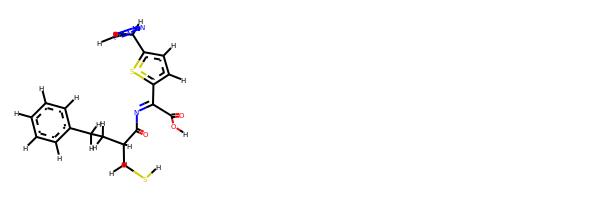

rdkit:  [H]OC(=O)C(=NC(=O)C([H])(C([H])([H])S[H])C([H])([H])C([H])([H])c1c([H])c([H])c([H])c([H])c1[H])c1sc(C([H])([H])n2nnnc2[H])c([H])c1[H]
oechem:  c1ccc(cc1)CCC(CS)C(=O)N=C(c2ccc(s2)Cn3cnnn3)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
76.94900404729087 kJ/mol 226956.381817252 kJ/mol False
angle
143.5957919406689 kJ/mol 144.28870922874702 kJ/mol False
nb
19.341610308335763 kJ/mol 19.341610308335763 kJ/mol True
torsion
96.91201551534688 kJ/mol 41.09098693358769 kJ/mol False
336.798

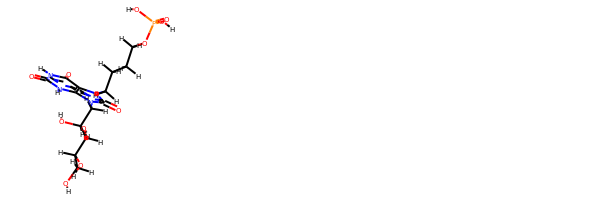

rdkit:  [H]OC([H])([H])C([H])(O[H])C([H])(O[H])C([H])(O[H])C([H])([H])n1c(=O)n(C([H])([H])C([H])([H])C([H])([H])C([H])([H])OP(=O)(O[H])O[H])c2c(=O)n([H])c(=O)n([H])c21
oechem:  C(CCOP(=O)(O)O)Cn1c2c([nH]c(=O)[nH]c2=O)n(c1=O)CC(C(C(CO)O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
49.325616307852954 kJ/mol 113320.8391138805 kJ/mol False
angle
337.0616406472333 kJ/mol 337.6496146750253 kJ/mol False
nb
15.229679273915682 kJ/mol 15.229679273915682 kJ/mol True
torsion
135.87285935757967 kJ/mol 78.84756562623825 kJ/mol False
537.4897955865816 kJ/mol 113752.5659734557 kJ/mol

----------------------------------------------------

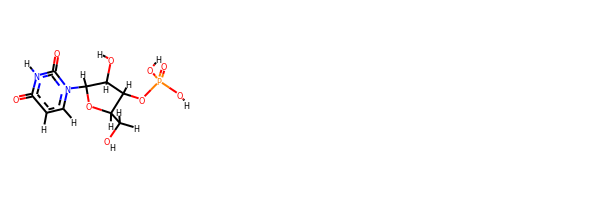

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])c([H])c(=O)n([H])c2=O)C([H])(O[H])C1([H])OP(=O)(O[H])O[H]
oechem:  c1cn(c(=O)[nH]c1=O)C2C(C(C(O2)CO)OP(=O)(O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
36.50562643234106 kJ/mol 57645.87171743887 kJ/mol False
angle
54.84383343905398 kJ/mol 55.26066471747329 kJ/mol False
nb
65.89869138650785 kJ/mol 65.89869138650785 kJ/mol True
torsion
53.157869753235 kJ/mol 51.42755787015522 kJ/mol False
210.4060210111379 kJ/mol 57818.458631413014 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2425


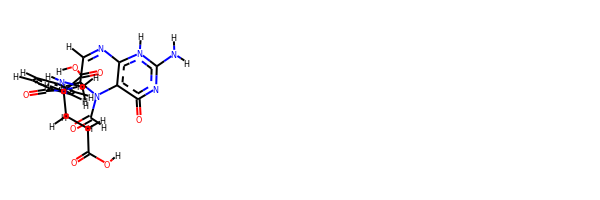

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])C([H])(C(=O)O[H])N([H])C(=O)c1c([H])c([H])c(N([H])C([H])([H])C2([H])C([H])=Nc3c(c(=O)nc(N([H])[H])n3[H])N2C([H])=O)c([H])c1[H]
oechem:  c1cc(ccc1C(=O)NC(CCC(=O)O)C(=O)O)NCC2C=Nc3c(c(=O)nc([nH]3)N)N2C=O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ##

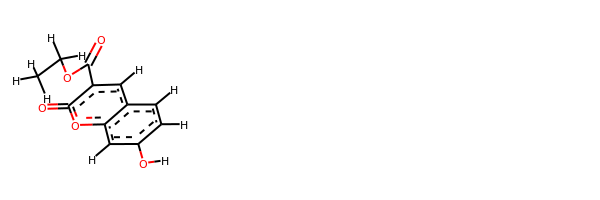

rdkit:  [H]Oc1c([H])c([H])c2c([H])c(C(=O)OC([H])([H])C([H])([H])[H])c(=O)oc2c1[H]
oechem:  CCOC(=O)c1cc2ccc(cc2oc1=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
12.23338920877409 kJ/mol 57994.2714458981 kJ/mol False
angle
147.58217663022495 kJ/mol 147.58217663022495 kJ/mol True
nb
49.642322047512344 kJ/mol 49.642322047512344 kJ/mol True
torsion
47.906280789632724 kJ/mol 33.53265853262008 kJ/mol False
257.3641686761441 kJ/mol 58225.028603108454 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2438


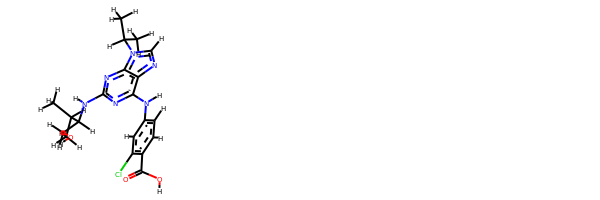

rdkit:  [H]OC(=O)c1c([H])c([H])c(N([H])c2nc(N([H])C([H])(C([H])([H])O[H])C([H])(C([H])([H])[H])C([H])([H])[H])nc3c2nc([H])n3C([H])(C([H])([H])[H])C([H])([H])[H])c([H])c1Cl
oechem:  CC(C)C(CO)Nc1nc(c2c(n1)n(cn2)C(C)C)Nc3ccc(c(c3)Cl)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
8.044652829635975 kJ/mol 57759.949999496435 kJ/mol False
angle
95.28984590417835 kJ/mol 96.51978021699705 kJ/mol False
nb
9.04880973430363 kJ/mol 9.04880973430363 kJ/mol True
torsion
0.42043335061193204 kJ/mol 0.4

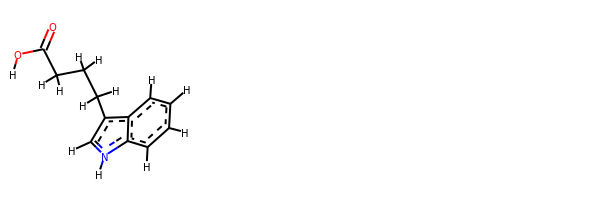

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])C([H])([H])c1c([H])n([H])c2c([H])c([H])c([H])c([H])c12
oechem:  c1ccc2c(c1)c(c[nH]2)CCCC(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
43.91321176295629 kJ/mol 113315.4267093356 kJ/mol False
angle
314.24652188282016 kJ/mol 314.83449591061225 kJ/mol False
nb
17.68848061543929 kJ/mol 17.68848061543929 kJ/mol True
torsion
122.91625030375931 kJ/mol 65.89095657241798 kJ/mol False
498.764464564975 kJ/mol 113713.84064243408 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
------------------------

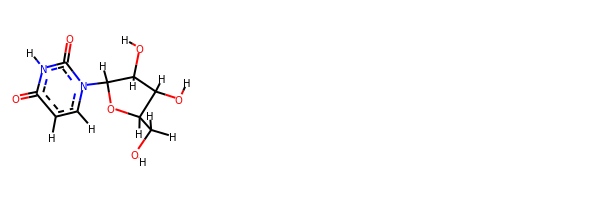

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])c([H])c(=O)n([H])c2=O)C([H])(O[H])C1([H])O[H]
oechem:  c1cn(c(=O)[nH]c1=O)C2C(C(C(O2)CO)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
30.23701213741243 kJ/mol 58014.72556596392 kJ/mol False
angle
111.5977296624184 kJ/mol 111.5977296624184 kJ/mol True
nb
84.94058502807546 kJ/mol 84.94058502807546 kJ/mol True
to

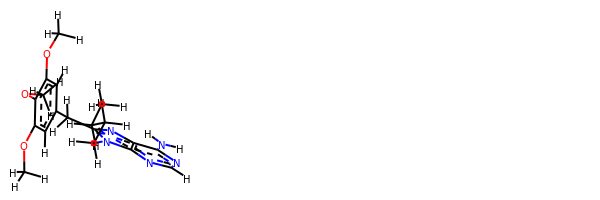

rdkit:  [H]c1nc(N([H])[H])c2nc(C([H])([H])c3c([H])c(OC([H])([H])[H])c(OC([H])([H])[H])c(OC([H])([H])[H])c3[H])n(C([H])([H])C([H])([H])C([H])([H])C([H])([H])[H])c2n1
oechem:  CCCCn1c(nc2c1ncnc2N)Cc3cc(c(c(c3)OC)OC)OC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
7.88868785292321 kJ/mol 29075.039957672234 kJ/mol False
angle
88.85487462301057 kJ/mol 90.52199443252552 kJ/mol False
nb
-0.7208267032687166 kJ/mol -0.7208267032687166 kJ/mol True
torsion
5.231540705751397 kJ/mol 0.0016565674545132535 kJ/mol False
101.25427647841647 kJ/mol 29164.842781968946 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
Dr

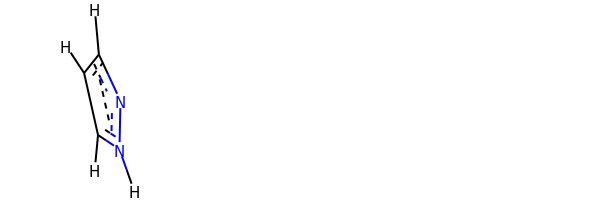

rdkit:  [H]c1nn([H])c([H])c1[H]
oechem:  c1c[nH]nc1
###########################################################################
 #########################################################

bond
7.644439908076586 kJ/mol 57759.549786574884 kJ/mol False
angle
88.84520517016696 kJ/mol 90.07513948298566 kJ/mol False
nb
11.897195281481139 kJ/mol 11.897195281481139 kJ/mol True
torsion
0.16389292481418158 kJ/mol 0.16389372888995415 kJ/mol False
108.55073328453886 kJ/mol 57861.68601506824 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2460


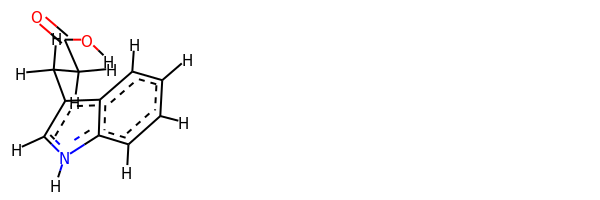

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])c1c([H])n([H])c2c([H])c([H])c([H])c([H])c12
oechem:  c1ccc2c(c1)c(c[nH]2)CCC(=O)O
###########################################################################
 #########################################################

bond
75.64476173198086 kJ/mol 56750.16308403364 kJ/mol False
angle
64.95702804112655 kJ/mol 64.95702804112655 kJ/mol True
nb
43.8270312104955 kJ/mol 43.8270312104955 kJ/mol True
torsion
151.27067694717763 kJ/mol 151.27070478254842 kJ/mol False
335.6994979307805 kJ/mol 57010.217848067805 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2461


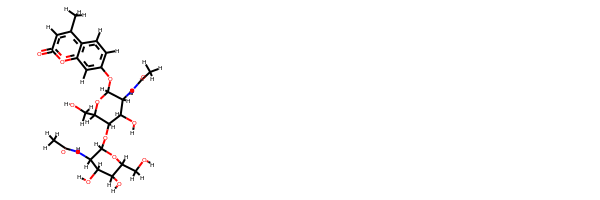

rdkit:  [H]OC([H])([H])C1([H])OC([H])(OC2([H])C([H])(C([H])([H])O[H])OC([H])(Oc3c([H])c([H])c4c(C([H])([H])[H])c([H])c(=O)oc4c3[H])C([H])(N([H])C(=O)C([H])([H])[H])C2([H])O[H])C([H])(N([H])C(=O)C([H])([H])[H])C([H])(O[H])C1([H])O[H]
oechem:  Cc1cc(=O)oc2c1ccc(c2)OC3C(C(C(C(O3)CO)OC4C(C(C(C(O4)CO)O)O)NC(=O)C)O)NC(=O)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
6.8088162203150615 kJ/mol 57988.53305263216 kJ/mol False
angle
107.44648941334167 kJ/mol 107.44648941334167 kJ/mol True
nb
19.225493

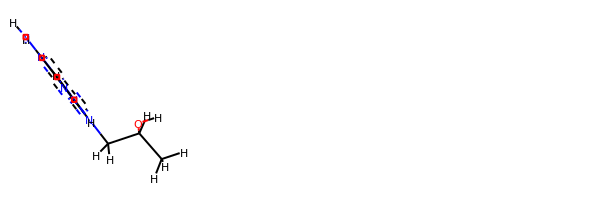

rdkit:  [H]OC([H])(C([H])([H])[H])C([H])([H])n1c([H])nc2c(N([H])[H])nc([H])nc21
oechem:  CC(Cn1cnc2c1ncnc2N)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
27.762322768187836 kJ/mol 58003.41199477896 kJ/mol False
angle
416.90887784072004 kJ/mol 416.90887784072004 kJ/mol True
nb
10.142127997766877 kJ/mol 10.142127997766877 kJ/mol True
torsion
98.5903050701943 kJ/mol 74.47975546474642 kJ/mol False
553.4036336768692 kJ/mol 58504.942756082186 kJ/mol

----------------------------------------------

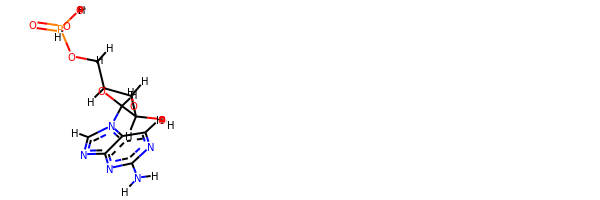

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3nc(N([H])[H])nc([H])c32)OC([H])(C([H])([H])OP(=O)(O[H])O[H])C1([H])O[H]
oechem:  c1c2c(ncn2C3C(C(C(O3)COP(=O)(O)O)O)O)nc(n1)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

#####################

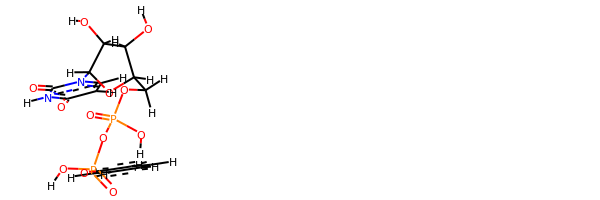

rdkit:  [H]OC1([H])C([H])(n2c([H])c([H])c(=O)n([H])c2=O)OC([H])(C([H])([H])OP(=O)(O[H])OP(=O)(O[H])Oc2c([H])c([H])c([H])c([H])c2[H])C1([H])O[H]
oechem:  c1ccc(cc1)OP(=O)(O)OP(=O)(O)OCC2C(C(C(O2)n3ccc(=O)[nH]c3=O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
26.788258872025164 kJ/mol 57291.02314805309 kJ/mol False
angle
472.15380243048213 kJ/mol 472.32024100150613 kJ/mol False
nb
6.666089088401412 kJ/mol 6.666089088401412 kJ/mol True
torsion
91.24566887376366 kJ/mol 74.50967836995088 kJ/mol False
596.8538192646724 kJ/mol 57844.51915651295 kJ/mol

-------------------------------------------------------------------
---------

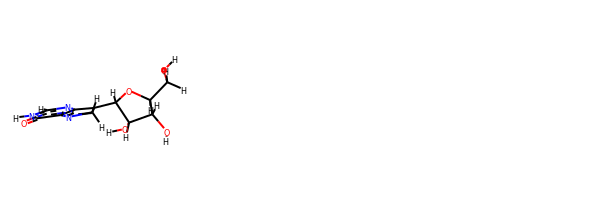

rdkit:  [H]OC([H])([H])C1([H])OC([H])(C2=c3nc([H])n([H])c(=O)c3=NC2([H])[H])C([H])(O[H])C1([H])O[H]
oechem:  c1[nH]c(=O)c2=NCC(=c2n1)C3C(C(C(O3)CO)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
34.36146949595068 kJ/mol 58017.03608001392 kJ/mol False
angle
414.08630031057237 kJ/mol 414.08630031057237 kJ/mol True
nb
9.933058543759364 kJ/mol 9.933058543759364 kJ/mol True
torsion
95.45195691202656 kJ/mol 71.36109604200486 kJ/mol False
553.8327852623089 kJ/mol 58512.41653491025 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2493


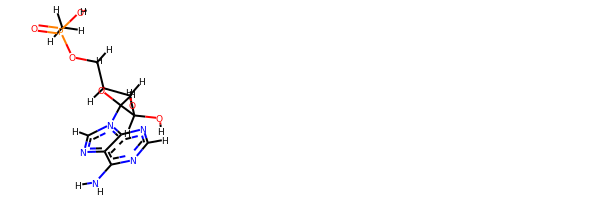

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)OC([H])(C([H])([H])OP(=O)(O[H])C([H])([H])[H])C1([H])O[H]
oechem:  CP(=O)(O)OCC1C(C(C(O1)n2cnc3c2ncnc3N)O)O
###########################################################################
 #########################################################

bond
45.02325123225983 kJ/mol 56588.26024876774 kJ/mol False
angle
211.67346516085553 kJ/mol 211.67346516085553 kJ/mol True
nb
23.265154090432297 kJ/mol 23.265154090432297 kJ/mol True
torsion
64.03852426344196 kJ/mol 51.94427125430835 kJ/mol False
344.0003947469896 kJ/mol 56875.14313927334 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2494


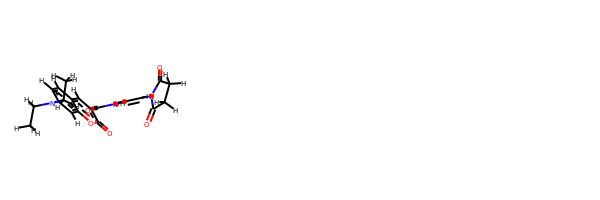

rdkit:  [H]C(=C([H])N1C(=O)C([H])([H])C([H])([H])C1=O)N([H])C(=O)c1c([H])c2c([H])c([H])c(N(C([H])([H])C([H])([H])[H])C([H])([H])C([H])([H])[H])c([H])c2oc1=O
oechem:  CCN(CC)c1ccc2cc(c(=O)oc2c1)C(=O)NC=CN3C(=O)CCC3=O
###########################################################################
 #########################################################

bond
30.199986192150554 kJ/mol 57757.43342378448 kJ/mol False
angle
51.76633644602979 kJ/mol 52.164014867627564 kJ/mol False
nb
67.08247591188412 kJ/mol 67.08247591188412 kJ/mol True
torsion
38.55342834820333 kJ/mol 24.208922841524398 kJ/mol False
187.60222689826782 kJ/mol 57900.888837405524 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2495


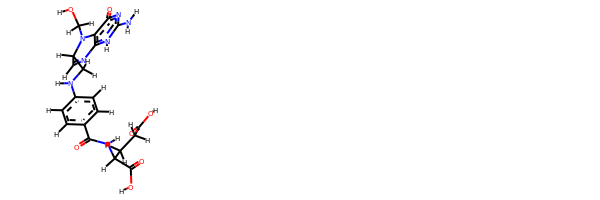

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])C([H])(C(=O)O[H])N([H])C(=O)c1c([H])c([H])c(N([H])C([H])([H])C2([H])C([H])=Nc3c(c(=O)nc(N([H])[H])n3[H])N2C([H])([H])O[H])c([H])c1[H]
oechem:  c1cc(ccc1C(=O)NC(CCC(=O)O)C(=O)O)NCC2C=Nc3c(c(=O)nc([nH]3)N)N2CO
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
49.325616307852954 kJ/mol 113320.8391138805 kJ/mol False
angle
337.0

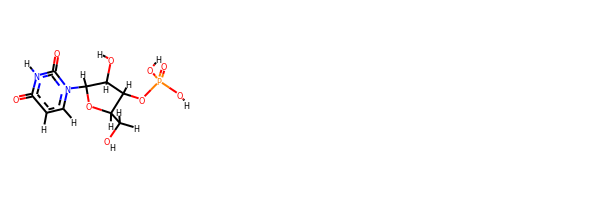

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])c([H])c(=O)n([H])c2=O)C([H])(O[H])C1([H])OP(=O)(O[H])O[H]
oechem:  c1cn(c(=O)[nH]c1=O)C2C(C(C(O2)CO)OP(=O)(O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

#########################

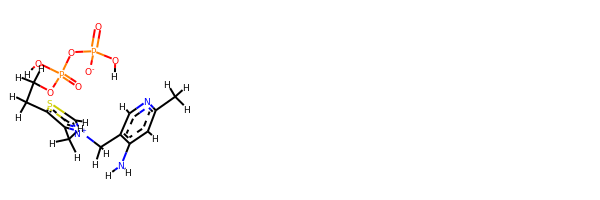

rdkit:  [H]OP(=O)([O-])OP(=O)(O[H])OC([H])([H])C([H])([H])c1sc([H])[n+](C([H])([H])c2c([H])nc(C([H])([H])[H])c([H])c2N([H])[H])c1C([H])([H])[H]
oechem:  Cc1cc(c(cn1)C[n+]2csc(c2C)CCOP(=O)(O)OP(=O)(O)[O-])N
###########################################################################
 #########################################################

bond
15.733612178637284 kJ/mol 29154.958950876586 kJ/mol False
angle
174.27135445427848 kJ/mol 174.27135445427848 kJ/mol True
nb
10.813866123943129 kJ/mol 10.813866123943129 kJ/mol True
torsion
47.388386562725174 kJ/mol 39.97987198073155 kJ/mol False
248.20721931958406 kJ/mol 29380.02404343554 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2510


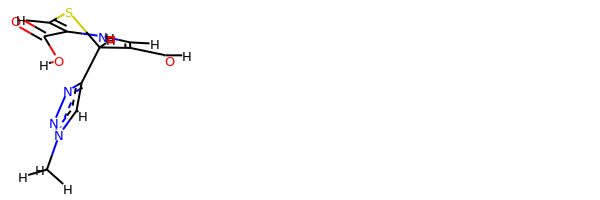

rdkit:  [H]OC(=O)C1=C([H])SC([H])(c2nnn(C([H])([H])[H])c2[H])C(C([H])=O)=C([H])N1[H]
oechem:  Cn1cc(nn1)C2C(=CNC(=CS2)C(=O)O)C=O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
29.37701503799562 kJ/mol 113842.44358512555 kJ/mol False
angle
51.80764088896052 kJ/mol 52.45718722836982 kJ/mol False
nb
16.670618064152972 kJ/mol 16.670618064152972 kJ/mol True
torsion
43.97882120551383 kJ/mol 7.776594323500805 kJ/mol False
141.83409519662294 kJ/mol 113919.34798474157 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2512


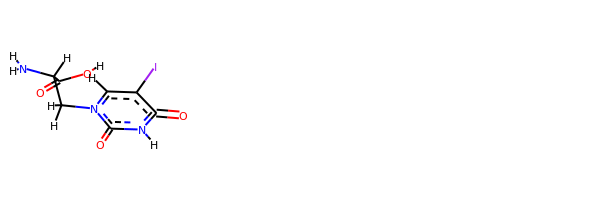

rdkit:  [H]OC(=O)C([H])(N([H])[H])C([H])([H])n1c([H])c(I)c(=O)n([H])c1=O
oechem:  c1c(c(=O)[nH]c(=O)n1CC(C(=O)O)N)I
###########################################################################
 #########################################################

bond
23.447136177610375 kJ/mol 57939.34663389916 kJ/mol False
angle
398.1009364279776 kJ/mol 398.1009364279776 kJ/mol True
nb
4.362485516610993 kJ/mol 4.362485516610993 kJ/mol True
torsion
98.29344195685046 kJ/mol 74.18291447600207 kJ/mol False
524.2040000790494 kJ/mol 58415.99297031975 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2513


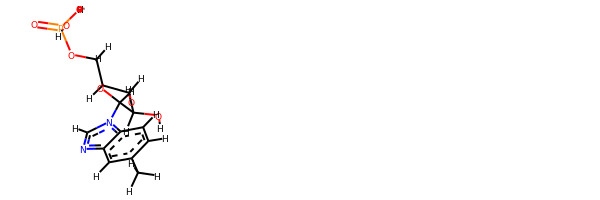

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c([H])c(C([H])([H])[H])c([H])c([H])c32)OC([H])(C([H])([H])OP(=O)(O[H])O[H])C1([H])O[H]
oechem:  Cc1ccc2c(c1)ncn2C3C(C(C(O3)COP(=O)(O)O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
56.

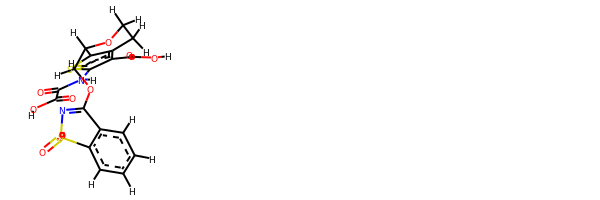

rdkit:  [H]OC(=O)C(=O)N([H])c1sc2c(c1C(=O)O[H])C([H])([H])C([H])([H])OC2([H])C([H])([H])OC1=NS(=O)(=O)c2c([H])c([H])c([H])c([H])c21
oechem:  c1ccc2c(c1)C(=NS2(=O)=O)OCC3c4c(c(c(s4)NC(=O)C(=O)O)C(=O)O)CCO3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
46.70545838281477 kJ/mol 115820.27183760992 kJ/mol False
angle
196.43457107576057 kJ/mol 196.43457107576057 kJ/mol True
nb
33.10056093409575 kJ/mol 33.10056093409575 kJ/mol True
torsion
41.42682372943796 kJ/mol 30.79230584162593 kJ/mol False
317.66741412210905 kJ/mol 116080.5992754614 kJ/mol

-------------------------------------------------------------------
--------------------

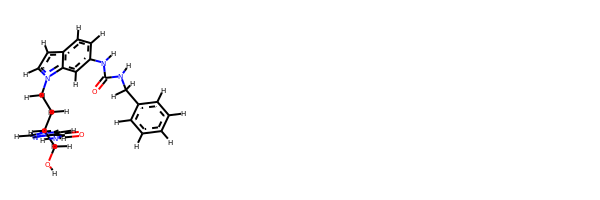

rdkit:  [H]OC([H])([H])C([H])(n1c([H])nc(C(=O)N([H])[H])c1[H])C([H])([H])C([H])([H])n1c([H])c([H])c2c([H])c([H])c(N([H])C(=O)N([H])C([H])([H])c3c([H])c([H])c([H])c([H])c3[H])c([H])c21
oechem:  c1ccc(cc1)CNC(=O)Nc2ccc3ccn(c3c2)CCC(CO)n4cc(nc4)C(=O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
22.717977471163206 kJ/mol 43694.511051228306 kJ/mol False
angle
82.14700909464176 kJ/mol 85.50227261947043 kJ/mol False
nb
48.851716270659914 kJ/mol 48.851716270659914 kJ/mol True
torsion
37.87615057285356 kJ/mol 21.046846941738522 kJ/mol False
191.59285340931845 kJ/mol 43849.91188706018 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-----------------------------------------

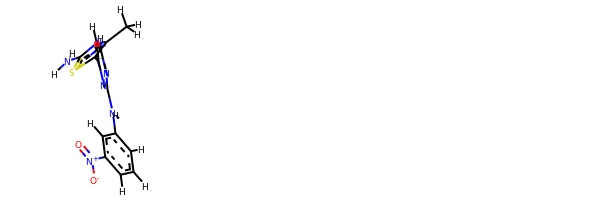

rdkit:  [H]c1nc(N([H])c2c([H])c([H])c([H])c([N+](=O)[O-])c2[H])nc(-c2sc(N([H])[H])nc2C([H])([H])[H])c1[H]
oechem:  Cc1c(sc(n1)N)c2ccnc(n2)Nc3cccc(c3)[N+](=O)[O-]
###########################################################################
 #########################################################

bond
23.45108915062626 kJ/mol 43627.10354524136 kJ/mol False
angle
52.64137762022966 kJ/mol 55.774630827331634 kJ/mol False
nb
6.56651279144756 kJ/mol 6.56651279144756 kJ/mol True
torsion
51.50508000547424 kJ/mol 34.370232697136245 kJ/mol False
134.1640595677777 kJ/mol 43723.814921557285 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2527


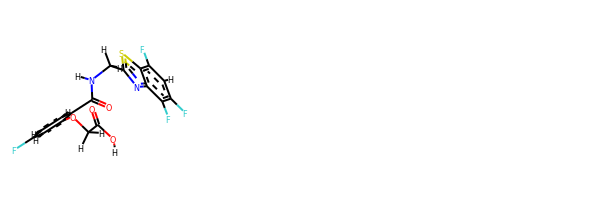

rdkit:  [H]OC(=O)C([H])([H])Oc1c([H])c(F)c([H])c([H])c1C(=O)N([H])C([H])([H])c1nc2c(F)c(F)c([H])c(F)c2s1
oechem:  c1cc(c(cc1F)OCC(=O)O)C(=O)NCc2nc3c(c(cc(c3s2)F)F)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
57.77487996742994 kJ/mol 114186.31303149936 kJ/mol False
angle
462.4294676308745 kJ/mol 462.7814941819878 kJ/mol False
nb
-11.905599558235847 kJ/mol -11.905599558235847 kJ/mol True
torsion
171.4403406171353 kJ/mol 113.99031404507113 kJ/mol False
679.739088657204 kJ/mol 114751.17924016819 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2529


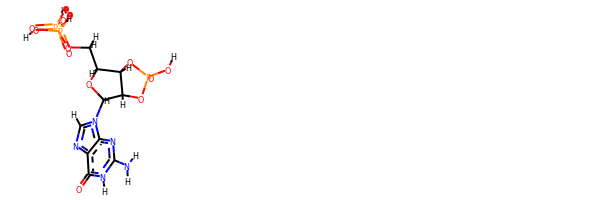

rdkit:  [H]OP1(=O)OC2([H])C([H])(n3c([H])nc4c(=O)n([H])c(N([H])[H])nc43)OC([H])(C([H])([H])OP(=O)(O[H])OP(=O)(O[H])O[H])C2([H])O1
oechem:  c1nc2c(=O)[nH]c(nc2n1C3C4C(C(O3)COP(=O)(O)OP(=O)(O)O)OP(=O)(O4)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
35.61706937703529 kJ/mol 29103.926718248415 kJ/mol False
angle
230.45005833327974 kJ/mol 232.15591466272662 kJ/mol False
nb
18.75616400097131 kJ/mol 18.75616400097131 kJ/mol True
torsion
70.1609278157447 kJ/mol 71.82539129962913 kJ/mol False
354

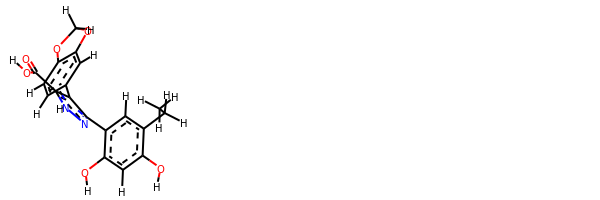

rdkit:  [H]OC(=O)c1c(-c2c([H])c([H])c3c(c2[H])OC([H])([H])O3)c(-c2c([H])c(C([H])([H])C([H])([H])[H])c(O[H])c([H])c2O[H])nn1[H]
oechem:  CCc1cc(c(cc1O)O)c2c(c([nH]n2)C(=O)O)c3ccc4c(c3)OCO4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
22.880149159141403 kJ/mol 58004.373850288925 kJ/mol False
angle
454.574641584307 kJ/mol 454.574641584307 kJ/mol True
nb
10.752253428702756 kJ/mol 10.752253428702756 kJ/mol True
torsion
112.52769917728864 kJ/mol 88.4369451849071 kJ/mol False
600.7347433494398 kJ/m

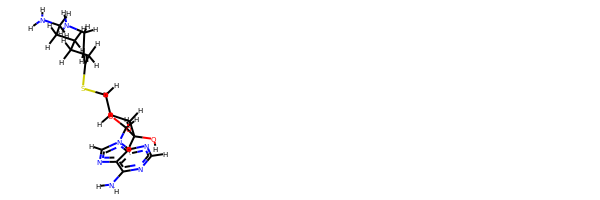

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)OC([H])(C([H])([H])SC(=C([H])C([H])([H])N([H])[H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])N([H])[H])C1([H])O[H]
oechem:  c1nc(c2c(n1)n(cn2)C3C(C(C(O3)CSC(=CCN)CCCCCN)O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
26.94650127909069 kJ/mol 43699.84837554967 kJ/mol False
angle
75.76578288545096 kJ/mol 79.1217022006537 kJ/mol False
nb
50.679701551166225 kJ/mol 50.679701551166225 kJ/mol True
torsion
76.83575914147319 

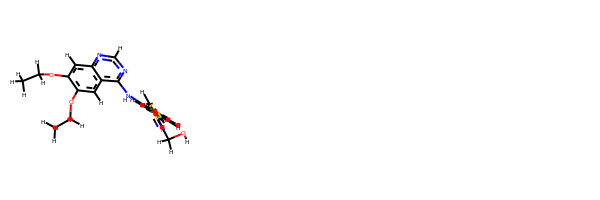

rdkit:  [H]OC([H])([H])c1nc(-c2c([H])c([H])c([H])c(N([H])c3nc([H])nc4c([H])c(OC([H])([H])C([H])([H])[H])c(OC([H])([H])C([H])([H])[H])c([H])c34)c2[H])c([H])s1
oechem:  CCOc1cc2c(cc1OCC)ncnc2Nc3cccc(c3)c4csc(n4)CO
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
33.58069187418279 kJ/mol 29101.19446326907 kJ/mol False
angle
109.10236007224482 kJ/mol 109.10236007224482 kJ/mol True
nb
70.97082953416353 kJ/mol 70.97082953416353 kJ/mol True
torsion
87.4452383536624 kJ/mol 79.70518408659836 kJ/mol False
301.09911983425354 kJ/mol 29360.97283696207 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2543


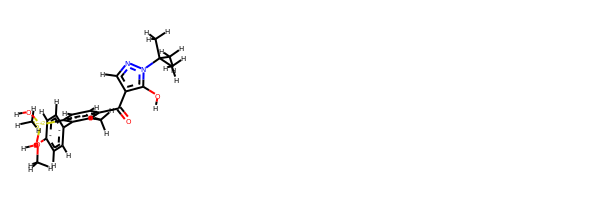

rdkit:  [H]Oc1c(C(=O)c2c([H])c([H])c([S+2](O[H])(O[H])C([H])([H])[H])c(-c3c([H])c([H])c(OC([H])([H])[H])c([H])c3[H])c2C([H])([H])[H])c([H])nn1C(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H]
oechem:  Cc1c(ccc(c1c2ccc(cc2)OC)[S+2](C)(O)O)C(=O)c3cnn(c3O)C(C)(C)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

############################################################

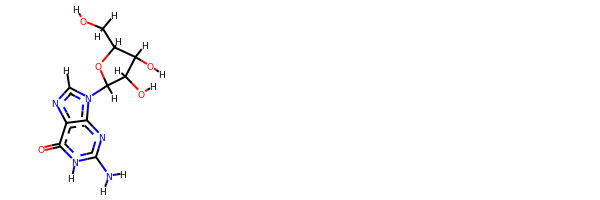

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])nc3c(=O)n([H])c(N([H])[H])nc32)C([H])(O[H])C1([H])O[H]
oechem:  c1nc2c(=O)[nH]c(nc2n1C3C(C(C(O3)CO)O)O)N
###########################################################################
 #########################################################

bond
82268.24359706859 kJ/mol 126055.89148653804 kJ/mol False
angle
71.32803779452809 kJ/mol 73.48104853721512 kJ/mol False
nb
944.6254797161096 kJ/mol 944.6254797161096 kJ/mol True
torsion
141.81319845364555 kJ/mol 141.81320136593087 kJ/mol False
83426.01031303288 kJ/mol 127215.8112161573 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2551


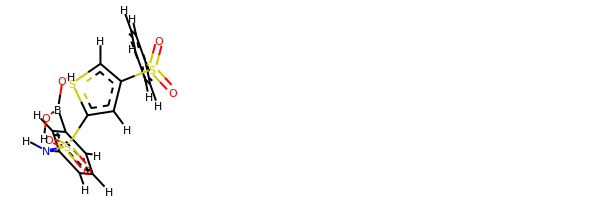

rdkit:  [H]OB(O[H])c1c([H])c([H])c([H])c(N([H])S(=O)(=O)c2sc([H])c(S(=O)(=O)c3c([H])c([H])c([H])c([H])c3[H])c2[H])c1[H]
oechem:  B(c1cccc(c1)NS(=O)(=O)c2cc(cs2)S(=O)(=O)c3ccccc3)(O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
82.80179422503763 kJ/mol 58330.79467683777 kJ/mol False
angle
585.1647620497218 kJ/mol 585.1647620497218 kJ/mol True
nb
302.5563095824204 kJ/mol 302.5563095824204 kJ/mol True
torsion
190.67399973983902 kJ/mol 190.67396687726182 kJ/mol False
1161.1968655970188 kJ/mol 59409.18971534718 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2553


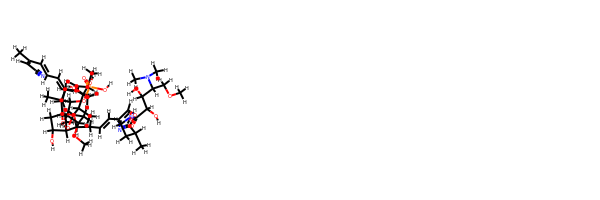

rdkit:  [H]OC([H])(C(=O)N([H])C([H])([H])C([H])([H])C([H])(c1nc(C([H])=C([H])C([H])([H])C2([H])OC3(OC([H])(C([H])(OC([H])([H])[H])C([H])([H])C([H])(O[H])C([H])(C([H])([H])[H])C([H])(O[H])C([H])(C([H])=C(C(=C([H])C([H])=C([H])C(=C([H])C#N)C([H])([H])[H])C([H])([H])[H])C([H])([H])[H])C([H])([H])[H])C([H])(OP(=O)(O[H])O[H])C3(C([H])([H])[H])C([H])([H])[H])C([H])([H])C([H])(O[H])C2([H])C([H])([H])[H])c([H])o1)C([H])([H])[H])C([H])(O[H])C([H])(N(C([H])([H])[H])C([H])([H])[H])C([H])([H])OC([H])([H])[H]
oechem:  CC1C(CC2(C(C(C(O2)C(CC(C(C)C(C(C)C=C(C)C(=CC=CC(=CC#N)C)C)O)O)OC)OP(=O)(O)O)(C)C)OC1CC=Cc3coc(n3)C(C)CCNC(=O)C(C(C(COC)N(C)C)O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
8.56701473047599 kJ/mol 57835.42437002935 kJ/mol False
angle
98.32797107368236 kJ

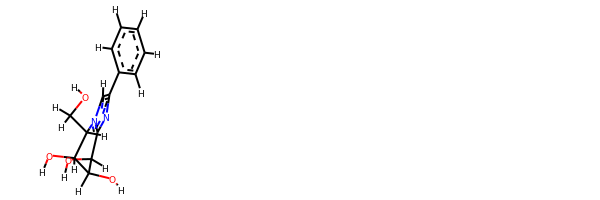

rdkit:  [H]OC([H])([H])C1([H])n2c(nc(-c3c([H])c([H])c([H])c([H])c3[H])c2[H])C([H])(O[H])C([H])(O[H])C1([H])O[H]
oechem:  c1ccc(cc1)c2cn3c(n2)C(C(C(C3CO)O)O)O
###########################################################################
 #########################################################

bond
38.131372563210384 kJ/mol 115772.01746254497 kJ/mol False
angle
360.1507927798889 kJ/mol 362.33708553461537 kJ/mol False
nb
201.4602424434285 kJ/mol 201.4602424434285 kJ/mol True
torsion
61.86807914063058 kJ/mol 61.868263906900225 kJ/mol False
661.6104869271584 kJ/mol 116397.68305442992 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2557


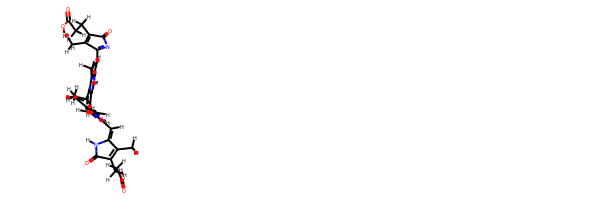

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])C1=C(C([H])([H])[H])C(C([H])=c2c(C([H])([H])[H])c(C([H])=C([H])[H])c(=C([H])c3c(C([H])([H])[H])c(C([H])=C([H])[H])c(C([H])=C4C(C([H])([H])[H])=C(C([H])([H])C([H])([H])C(=O)O[H])C(=O)N4[H])n3[H])n2[H])=NC1=O
oechem:  Cc1c(c([nH]c1C=c2c(c(c(=CC3=NC(=O)C(=C3C)CCC(=O)O)[nH]2)C)C=C)C=C4C(=C(C(=O)N4)CCC(=O)O)C)C=C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ##############################

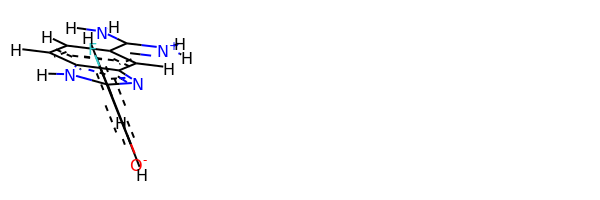

rdkit:  [H]c1c([H])c(F)c([H])c(-c2nc3c([H])c(C(N([H])[H])=[N+]([H])[H])c([H])c([H])c3n2[H])c1[O-]
oechem:  c1cc2c(cc1C(=[NH2+])N)nc([nH]2)c3cc(ccc3[O-])F
###########################################################################
 #########################################################

bond
43.510118946162784 kJ/mol 85716.45955885308 kJ/mol False
angle
149.26242009263885 kJ/mol 149.26242009263885 kJ/mol True
nb
16.21326215440892 kJ/mol 16.21326215440892 kJ/mol True
torsion
75.79931020524586 kJ/mol 75.7993501807613 kJ/mol False
284.7851113984564 kJ/mol 85957.7345912809 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2567


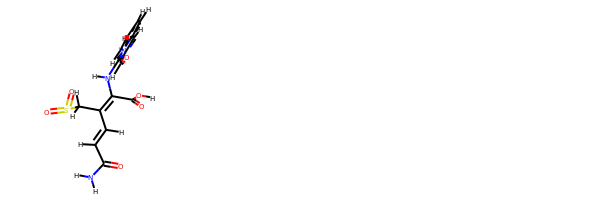

rdkit:  [H]OC(=O)C(=C(C([H])=C([H])C(=O)N([H])[H])C([H])([H])[S-](=O)=O)N([H])c1c(C([H])=O)c([H])c2c([H])c([H])c([H])c([H])n12
oechem:  c1ccn2c(c1)cc(c2NC(=C(C[S-](=O)=O)C=CC(=O)N)C(=O)O)C=O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ####################################################

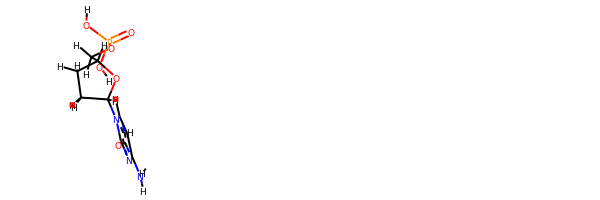

rdkit:  [H]OP(=O)(O[H])OC([H])([H])C1([H])OC([H])(n2c([H])c([H])c(N([H])[H])nc2=O)C([H])([H])C1([H])[H]
oechem:  c1cn(c(=O)nc1N)C2CCC(O2)COP(=O)(O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
57.32282247605652 kJ/mol 113360.79556419759 kJ/mol False
angle
304.00216657554967 kJ/mol 304.62358254063236 kJ/mol False
nb
1.4226074338222454 kJ/mol 1.4226074338222454 kJ/mol True
torsion
126.15846336649052 kJ/mol 50.92078342918588 kJ/mol False
488.90605985191894 kJ/mol 113717.76253760123 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2577


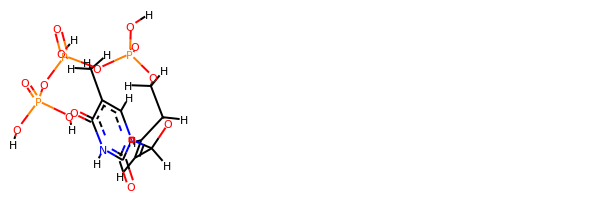

rdkit:  [H]OP(=O)(O[H])OP(=O)(O[H])OP(=O)(O[H])OC([H])([H])C1([H])OC([H])(n2c([H])c(C([H])([H])[H])c(=O)n([H])c2=O)C([H])=C1[H]
oechem:  Cc1cn(c(=O)[nH]c1=O)C2C=CC(O2)COP(=O)(O)OP(=O)(O)OP(=O)(O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
50.83845462351946 kJ/mol 113101.07590976206 kJ/mol False
angle
335.793934227313 kJ/mol 336.3797461586143 kJ/mol False
nb
32.01565523046355 kJ/mol 32.01565523046355 kJ/mol True
torsion
131.3549324966624 kJ/mol 73.72674257168121 kJ/mol False
550.0029765779584 kJ/mol 113543.19805372282 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2580


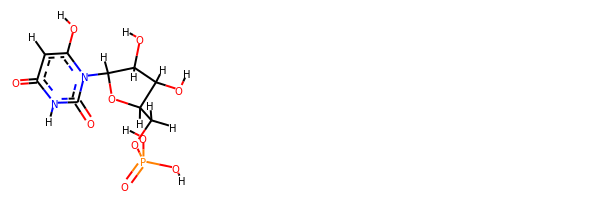

rdkit:  [H]Oc1c([H])c(=O)n([H])c(=O)n1C1([H])OC([H])(C([H])([H])OP(=O)(O[H])O[H])C([H])(O[H])C1([H])O[H]
oechem:  c1c(=O)[nH]c(=O)n(c1O)C2C(C(C(O2)COP(=O)(O)O)O)O
###########################################################################
 #########################################################

bond
17.682452371313794 kJ/mol 128974.37847862385 kJ/mol False
angle
148.75928070940824 kJ/mol 152.44144195381494 kJ/mol False
nb
27.671445274503643 kJ/mol 27.671445274503643 kJ/mol True
torsion
0.000248258714698345 kJ/mol 0.00029767249544124436 kJ/mol False
194.11342661394036 kJ/mol 129154.49166352466 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2581


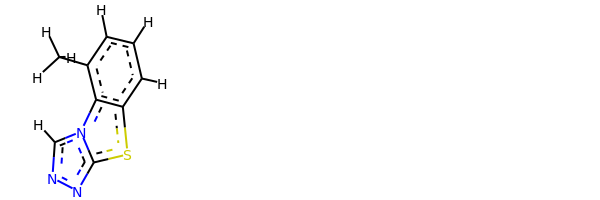

rdkit:  [H]c1c([H])c(C([H])([H])[H])c2c(sc3nnc([H])n32)c1[H]
oechem:  Cc1cccc2c1n3cnnc3s2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
21.247308441321916 kJ/mol 58002.73415356243 kJ/mol False
angle
399.6322532299133 kJ/mol 399.6322532299133 kJ/mol True
nb
19.166453998079927 kJ/mol 19.166453998079927 kJ/mol True
torsion
87.58626658104035 kJ/mol 63.47175547204

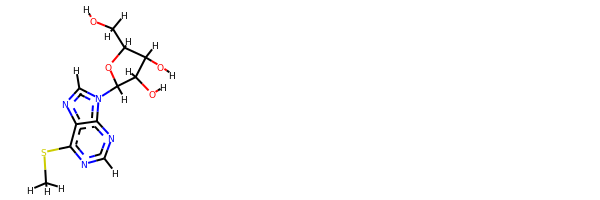

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])nc3c(SC([H])([H])[H])nc([H])nc32)C([H])(O[H])C1([H])O[H]
oechem:  CSc1c2c(ncn1)n(cn2)C3C(C(C(O3)CO)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
21.198275252060757 kJ/mol 57996.202697607056 kJ/mol False
angle
337.7000807006756 kJ/mol 339.7249692604668 kJ/mol False
nb
27.034160875949905 kJ/mol 27.034160875949905 kJ/mol True
torsion
32.27734528223797 kJ/mol 32.27762430343511 kJ/mol False
418.2098621109242 kJ/mol 58395.23945204691 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2588


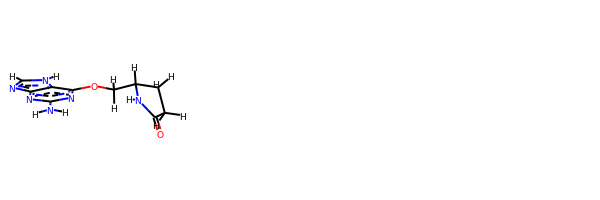

rdkit:  [H]c1nc2nc(N([H])[H])nc(OC([H])([H])C3([H])N([H])C(=O)C([H])([H])C3([H])[H])c2n1[H]
oechem:  c1[nH]c2c(n1)nc(nc2OCC3CCC(=O)N3)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
35.67023978613078 kJ/mol 58018.34485030409 kJ/mol False
angle
460.15505924919626 kJ/mol 460.15505924919626 kJ/mol True
nb
2.517330790837058 kJ/mol 2.517330790837058 kJ/mol True
torsion
124.69659939634418 kJ/mol 100.60574748610746 kJ/mol False
623.0392292225082 kJ/mol 58581.62298783023 kJ/mol

---------------------

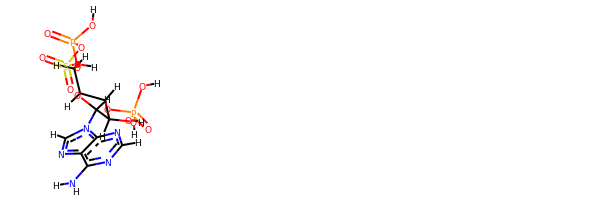

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)OC([H])(C([H])([H])OP(=O)(O[H])OS(=O)(=O)O[H])C1([H])OP(=O)(O[H])O[H]
oechem:  c1nc(c2c(n1)n(cn2)C3C(C(C(O3)COP(=O)(O)OS(=O)(=O)O)OP(=O)(O)O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
25.638372827580817 kJ/mol 58000.440071452336 kJ/mol False
angle
417.49168051410373 kJ/mol 417.49168051410373 kJ/mol True
nb
10.431414525601141 kJ/mol 10.431414525601141 kJ/mol True
torsion
98.428789145072 kJ/mol 74.31461203708265 kJ/mol False
551.9902570123577 kJ/mol 58502.67777852912 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2595


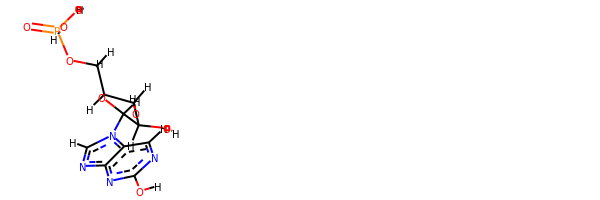

rdkit:  [H]Oc1nc([H])c2c(n1)nc([H])n2C1([H])OC([H])(C([H])([H])OP(=O)(O[H])O[H])C([H])(O[H])C1([H])O[H]
oechem:  c1c2c(ncn2C3C(C(C(O3)COP(=O)(O)O)O)O)nc(n1)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
12.737899423247839 kJ/mol 58377.947134844966 kJ/mol False
angle
104.49508278426822 kJ/mol 104.49508278426822 kJ/mol True
nb
14.601943511828386 kJ/mol 14.601943511828386 kJ/mol True
torsion
18.206339756063155 kJ/mol 15.695948921123277 kJ/mol False
150.04126547540758 kJ/mol 58512.74011006219 kJ

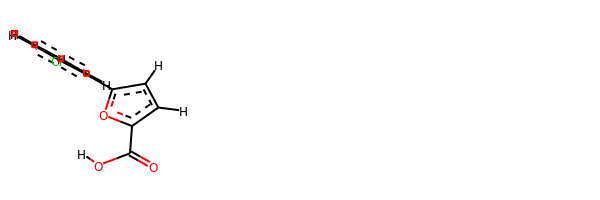

rdkit:  [H]OC(=O)c1oc(-c2c([H])c([H])c([H])c([H])c2Cl)c([H])c1[H]
oechem:  c1ccc(c(c1)c2ccc(o2)C(=O)O)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
68.9687499488767 kJ/mol 57667.86298320646 kJ/mol False
angle
532.4802033992482 kJ/mol 532.6810741190585 kJ/mol False
nb
26.059549053723163 kJ/mol 26.059549053723163 kJ/mol True
torsion
131.58849865292947 kJ/mol 104.43716703804974 kJ/mol False
759.0970010547776 kJ/mol 58331.04077341729 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2602


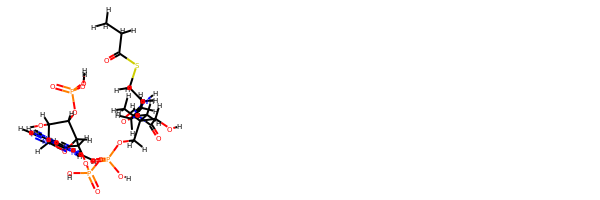

rdkit:  [H]OC([H])(C(=O)N([H])C([H])([H])C([H])([H])C(=O)N([H])C([H])([H])C([H])([H])SC(=O)C([H])([H])C([H])([H])[H])C(C([H])([H])[H])(C([H])([H])[H])C([H])([H])OP(=O)(O[H])OP(=O)(O[H])OC([H])([H])C1([H])OC([H])([n+]2c([H])nc3c(N([H])[H])nc([H])n([H])c2-3)C([H])(O[H])C1([H])OP(=O)(O[H])O[H]
oechem:  CCC(=O)SCCNC(=O)CCNC(=O)C(C(C)(C)COP(=O)(O)OP(=O)(O)OCC1C(C(C(O1)[n+]2cnc-3c(nc[nH]c23)N)O)OP(=O)(O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
15.464383424152283 kJ/mol 43686.62235115022 kJ/mol False
angle
87.97310050428017 kJ/mol 91.32807303603941 kJ/mol False
nb
46.1668304723158 kJ/mol 46.1668304723158 kJ/mol True
torsion
28.50248564680217 kJ/mol 20.87890992426464 kJ/mol False
178.10680004755042 kJ/mol 43844.99616458284 kJ/mol

---------------------------

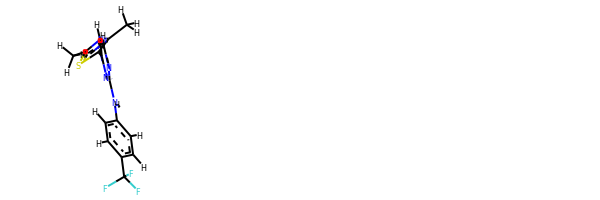

rdkit:  [H]c1nc(N([H])c2c([H])c([H])c(C(F)(F)F)c([H])c2[H])nc(-c2sc(C([H])([H])[H])nc2C([H])([H])[H])c1[H]
oechem:  Cc1c(sc(n1)C)c2ccnc(n2)Nc3ccc(cc3)C(F)(F)F
###########################################################################
 #########################################################

bond
26.496816071801526 kJ/mol 58009.17142658977 kJ/mol False
angle
417.45642728054423 kJ/mol 417.45642728054423 kJ/mol True
nb
6.280215460195926 kJ/mol 6.280215460195926 kJ/mol True
torsion
107.00594879573949 kJ/mol 82.91508792571784 kJ/mol False
557.2394076082811 kJ/mol 58515.82315725623 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2605


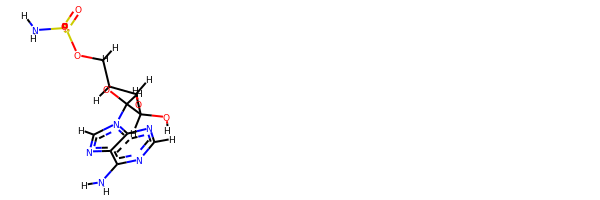

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)OC([H])(C([H])([H])OS(=O)(=O)N([H])[H])C1([H])O[H]
oechem:  c1nc(c2c(n1)n(cn2)C3C(C(C(O3)COS(=O)(=O)N)O)O)N
###########################################################################
 #########################################################

bond
22.983421634720695 kJ/mol 43810.36802607953 kJ/mol False
angle
82.75490197927867 kJ/mol 84.90739199760377 kJ/mol False
nb
33.9143796806397 kJ/mol 33.9143796806397 kJ/mol True
torsion
105.11132020001108 kJ/mol 105.11143636108577 kJ/mol False
244.76402349465013 kJ/mol 44034.30123411886 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2606


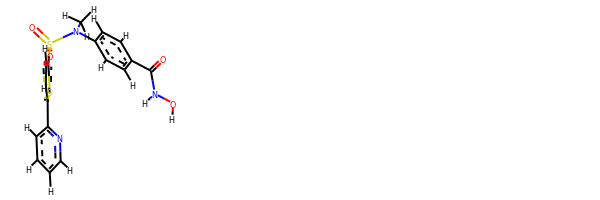

rdkit:  [H]ON([H])C(=O)c1c([H])c([H])c(N(C([H])([H])[H])S(=O)(=O)c2sc(-c3nc([H])c([H])c([H])c3[H])c([H])c2[H])c([H])c1[H]
oechem:  CN(c1ccc(cc1)C(=O)NO)S(=O)(=O)c2ccc(s2)c3ccccn3
###########################################################################
 #########################################################

bond
25.90479517123506 kJ/mol 28896.07597928121 kJ/mol False
angle
15.40432142373807 kJ/mol 15.752070021561238 kJ/mol False
nb
77.63341847104779 kJ/mol 77.63341847104779 kJ/mol True
torsion
33.63654583749953 kJ/mol 14.789223890290366 kJ/mol False
152.57908090352043 kJ/mol 29004.250691664107 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2607


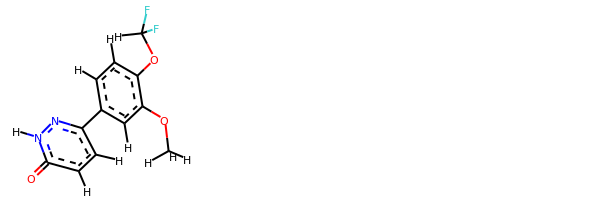

rdkit:  [H]c1c([H])c(-c2nn([H])c(=O)c([H])c2[H])c([H])c(OC([H])([H])[H])c1OC([H])(F)F
oechem:  COc1cc(ccc1OC(F)F)c2ccc(=O)[nH]n2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
35.311861780926975 kJ/mol 113350.10313393729 kJ/mol False
angle
192.97016393659047 kJ/mol 193.5895165441071 kJ/mol False
nb
21.316199424248655 kJ/mol 21.316199424248655 kJ/mol True
torsion
264.9926686652349 kJ/mol 196.58971207996748 kJ/mol False
514.590893807001 kJ/mol 113761.59856198561 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2610


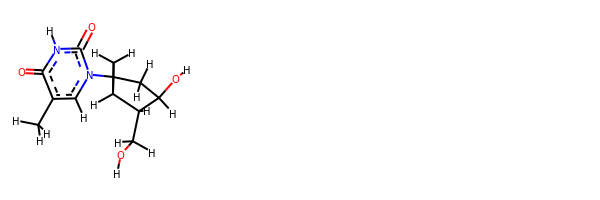

rdkit:  [H]OC([H])([H])C1([H])C([H])(O[H])C([H])([H])C2(n3c([H])c(C([H])([H])[H])c(=O)n([H])c3=O)C([H])([H])C12[H]
oechem:  Cc1cn(c(=O)[nH]c1=O)C23CC2C(C(C3)O)CO
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

######################

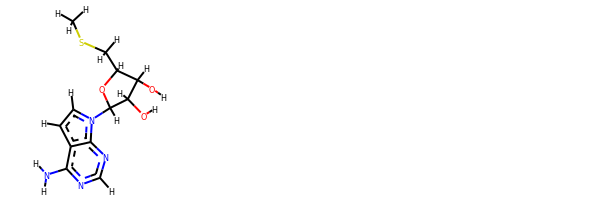

rdkit:  [H]OC1([H])C([H])(n2c([H])c([H])c3c(N([H])[H])nc([H])nc32)OC([H])(C([H])([H])SC([H])([H])[H])C1([H])O[H]
oechem:  CSCC1C(C(C(O1)n2ccc3c2ncnc3N)O)O
###########################################################################
 #########################################################

bond
19.935493532666705 kJ/mol 57999.30987990468 kJ/mol False
angle
401.046782088658 kJ/mol 401.046782088658 kJ/mol True
nb
14.699062268544084 kJ/mol 14.699062268544084 kJ/mol True
torsion
104.38239783508338 kJ/mol 80.28036177310432 kJ/mol False
540.0637357249523 kJ/mol 58495.33608603498 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2622


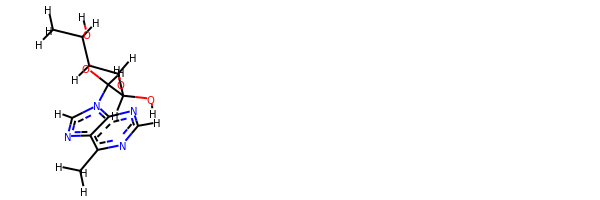

rdkit:  [H]OC([H])(C([H])([H])[H])C1([H])OC([H])(n2c([H])nc3c(C([H])([H])[H])nc([H])nc32)C([H])(O[H])C1([H])O[H]
oechem:  Cc1c2c(ncn1)n(cn2)C3C(C(C(O3)C(C)O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
22.045283872689218 kJ/mol 57773.95063053949 kJ/mol False
angle
101.25734391084195 kJ/mol 101.25734391084195 kJ/mol True
nb
37.814435044350944 kJ/mol 37.814435044350944 kJ/mol True
torsion
58.12155271377079 kJ/mol 35.2287174461893 kJ/mol False
219.2386155416529 kJ/mol 57948.25112694088 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2624


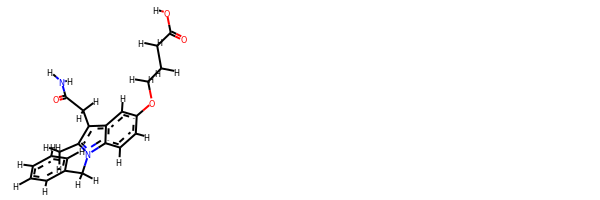

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])C([H])([H])Oc1c([H])c([H])c2c(c1[H])c(C([H])([H])C(=O)N([H])[H])c(C([H])([H])[H])n2C([H])([H])c1c([H])c([H])c([H])c([H])c1[H]
oechem:  Cc1c(c2cc(ccc2n1Cc3ccccc3)OCCCC(=O)O)CC(=O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ########################

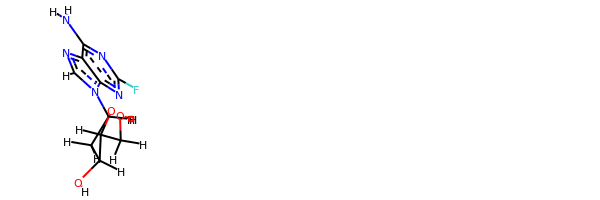

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])nc3c(N([H])[H])nc(F)nc32)C([H])([H])C1([H])O[H]
oechem:  c1nc2c(nc(nc2n1C3CC(C(O3)CO)O)F)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###############################################

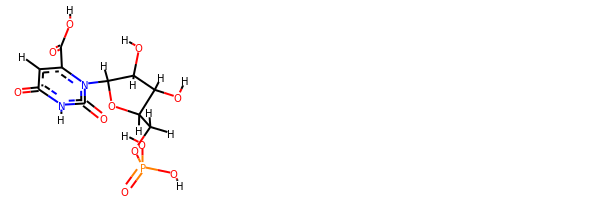

rdkit:  [H]OC(=O)c1c([H])c(=O)n([H])c(=O)n1C1([H])OC([H])(C([H])([H])OP(=O)(O[H])O[H])C([H])(O[H])C1([H])O[H]
oechem:  c1c(n(c(=O)[nH]c1=O)C2C(C(C(O2)COP(=O)(O)O)O)O)C(=O)O
###########################################################################
 #########################################################

bond
9.372120989795448 kJ/mol 57762.89912289836 kJ/mol False
angle
106.661855026784 kJ/mol 107.89031947264944 kJ/mol False
nb
5.655169536989192 kJ/mol 5.655169536989192 kJ/mol True
torsion
5.067332066812017 kJ/mol 5.067387583428105 kJ/mol False
126.75647762038065 kJ/mol 57881.51199949143 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2645


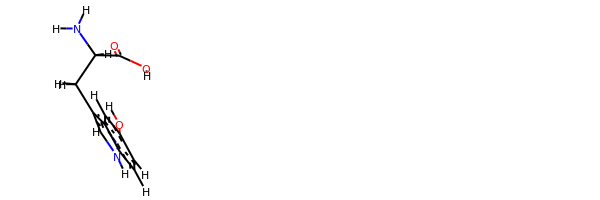

rdkit:  [H]OC(=O)C([H])(N([H])[H])C([H])([H])c1c([H])n([H])c2c([H])c([H])c(O[H])c([H])c12
oechem:  c1cc2c(cc1O)c(c[nH]2)CC(C(=O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
1.6824820566754672 kJ/mol 57916.794553710744 kJ/mol False
angle
77.33870875301369 kJ/mol 79.24283900776659 kJ/mol False
nb
11.795561897785442 kJ/mol 11.795561897785442 kJ/mol True
torsion
0.00016508814576116082 kJ/mol 0.00014346669447050682 kJ/mol False
90.81691779562037 kJ/mol 58007.83309808299 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
--------------

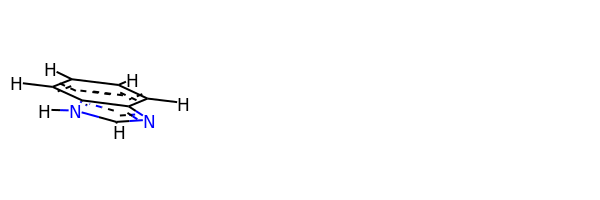

rdkit:  [H]c1c([H])c([H])c2c(nc([H])n2[H])c1[H]
oechem:  c1ccc2c(c1)[nH]cn2
###########################################################################
 #########################################################

bond
18.682607811396206 kJ/mol 56551.172393713176 kJ/mol False
angle
112.7596127678478 kJ/mol 112.7596127678478 kJ/mol True
nb
29.620805331110084 kJ/mol 29.620805331110084 kJ/mol True
torsion
31.86862632238734 kJ/mol 26.63918471405791 kJ/mol False
192.93165223274144 kJ/mol 56720.19199652619 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2649


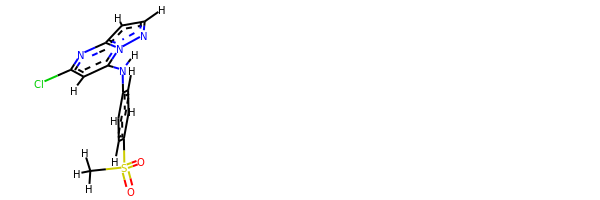

rdkit:  [H]c1nn2c(N([H])c3c([H])c([H])c(S(=O)(=O)C([H])([H])[H])c([H])c3[H])c([H])c(Cl)nc2c1[H]
oechem:  CS(=O)(=O)c1ccc(cc1)Nc2cc(nc3n2ncc3)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
30.550560850843333 kJ/mol 113635.34773788018 kJ/mol False
angle
52.40185705379495 kJ/mol 53.00986427963026 kJ/mol False
nb
16.20147493740927 kJ/mol 16.20147493740927 kJ/mol True
torsion
43.97975819819159 kJ/mol 7.777306483249523 kJ/mol False
143.13365104023913 kJ/mol 113712.33638358046 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
------------

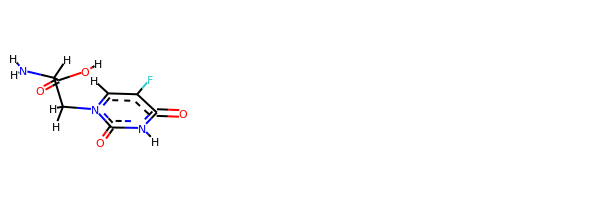

rdkit:  [H]OC(=O)C([H])(N([H])[H])C([H])([H])n1c([H])c(F)c(=O)n([H])c1=O
oechem:  c1c(c(=O)[nH]c(=O)n1CC(C(=O)O)N)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
6.917288453664003 kJ/mol 43677.57135126115 kJ/mol False
angle
42.41300532542174 kJ/mol 45.769529980678904 kJ/mol False
nb
-2.110931593848635 kJ/mol -2.110931593848635 kJ/mol True
torsion
7.155369632768958 kJ/mol 1.544666600274872 kJ/mol False
54.374731818006076 kJ/mol 43722.77461624825 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
----------------------------------------

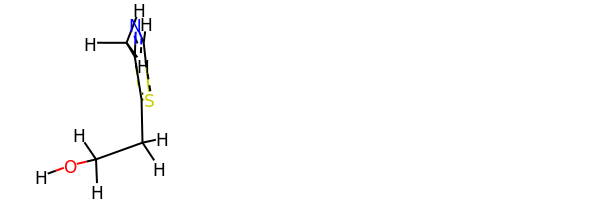

rdkit:  [H]OC([H])([H])C([H])([H])c1sc([H])nc1C([H])([H])[H]
oechem:  Cc1c(scn1)CCO
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
90.6085909041494 kJ/mol 261946.5274436699 kJ/mol False
angle
774.2579883314148 kJ/mol 793.3956418208655 kJ/mol False
nb
81.30980368118128 kJ/mol 81.30980368118128 kJ/mol True
torsion
215.6663348763044 kJ/mol 169.8883334975302 kJ/mo

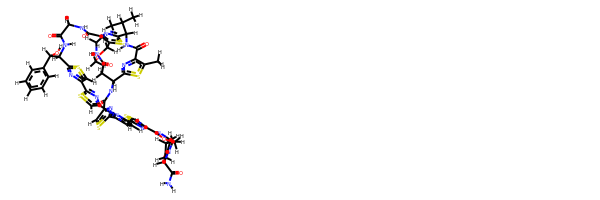

rdkit:  [H]OC([H])(c1c([H])c([H])c([H])c([H])c1[H])C1([H])c2nc(c([H])s2)-c2nc(c([H])s2)-c2nc(-c3nc(C4=NC([H])(C(=O)N5C([H])([H])C([H])([H])C([H])([H])C5([H])C(=O)N([H])[H])C([H])([H])O4)c([H])s3)c([H])c([H])c2-c2nc(c([H])s2)C(=O)N([H])C([H])(C([H])([H])C(=O)N([H])C([H])([H])[H])c2nc(c(C([H])([H])[H])s2)C(=O)N([H])C([H])(C([H])(C([H])([H])[H])C([H])([H])[H])c2nc(c(C([H])([H])OC([H])([H])[H])s2)C(=O)N([H])C([H])([H])C(=O)N1[H]
oechem:  Cc1c2nc(s1)C(NC(=O)c3csc(n3)-c4ccc(nc4-c5csc(n5)-c6csc(n6)C(NC(=O)CNC(=O)c7c(sc(n7)C(NC2=O)C(C)C)COC)C(c8ccccc8)O)c9nc(cs9)C1=NC(CO1)C(=O)N1CCCC1C(=O)N)CC(=O)NC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ####################################################

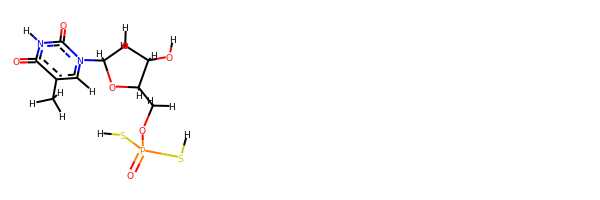

rdkit:  [H]OC1([H])C([H])([H])C([H])(n2c([H])c(C([H])([H])[H])c(=O)n([H])c2=O)OC1([H])C([H])([H])OP(=O)(S[H])S[H]
oechem:  Cc1cn(c(=O)[nH]c1=O)C2CC(C(O2)COP(=O)(S)S)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
15.913643155934933 kJ/mol 87590.0268768575 kJ/mol False
angle
146.8802007285065 kJ/mol 151.1829367554058 kJ/mol False
nb
-21.372159948670376 kJ/mol -21.372159948670376 kJ/mol True
torsion
162.82304545057474 kJ/mol 150.02236040409494 kJ/mol False
304.24472938634574 kJ/mol 87869.860014

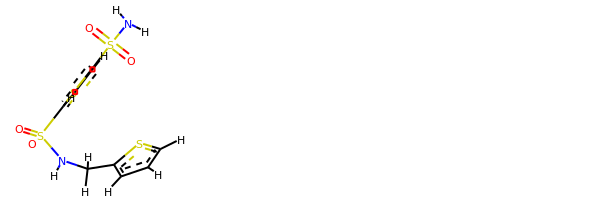

rdkit:  [H]c1sc(C([H])([H])N([H])S(=O)(=O)c2sc(S(=O)(=O)N([H])[H])c([H])c2[H])c([H])c1[H]
oechem:  c1cc(sc1)CNS(=O)(=O)c2ccc(s2)S(=O)(=O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
26.51944653256471 kJ/mol 114287.13916391468 kJ/mol False
angle
115.90890806165419 kJ/mol 116.24783393657262 kJ/mol False
nb
15.797001923721725 kJ/mol 15.797001923721725 kJ/mol True
torsion
33.47216865522459 kJ/mol 0.00026911594082417367 kJ/mol False
191.69752517316522 kJ/mol 114419.18426889092 kJ/mol

---------

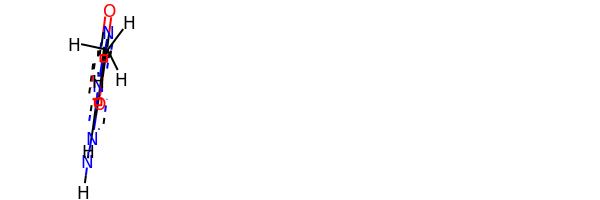

rdkit:  [H]N([H])c1nc2oc(C([H])([H])[H])nc2c(=O)n1[H]
oechem:  Cc1nc2c(=O)[nH]c(nc2o1)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
14.824839195503145 kJ/mol 143302.0276279075 kJ/mol False
angle
119.822469085159 kJ/mol 121.1284822047575 kJ/mol False
nb
-6.9006392164127766 kJ/mol -6.9006392164127766 kJ/mol True
torsion
10.503914441120862 kJ/mol 7.775182092692988 kJ/mol False
138.25058350537023 kJ/mol 143424.0306529885 kJ/mol

------------------------------------------------------------------

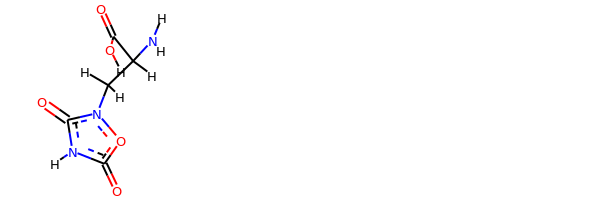

rdkit:  [H]OC(=O)C([H])(N([H])[H])C([H])([H])n1oc(=O)n([H])c1=O
oechem:  C(C(C(=O)O)N)n1c(=O)[nH]c(=O)o1
###########################################################################
 #########################################################

bond
6.8088162203150615 kJ/mol 57988.53305263216 kJ/mol False
angle
107.44648941334167 kJ/mol 107.44648941334167 kJ/mol True
nb
19.22549392348514 kJ/mol 19.22549392348514 kJ/mol True
torsion
12.02276094295091 kJ/mol 9.275328171487477 kJ/mol False
145.5035605000928 kJ/mol 58124.48036414048 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2683


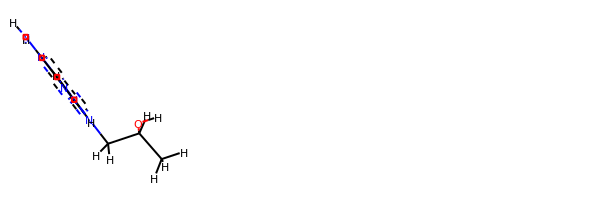

rdkit:  [H]OC([H])(C([H])([H])[H])C([H])([H])n1c([H])nc2c(N([H])[H])nc([H])nc21
oechem:  CC(Cn1cnc2c1ncnc2N)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
30.27915335723069 kJ/mol 29170.342188147977 kJ/mol False
angle
119.42111847155638 kJ/mol 119.42111847155638 kJ/mol True
nb
97.376806040441 kJ/mol 97.376806040441 kJ/mol True
torsion
58.828679539921986 kJ/m

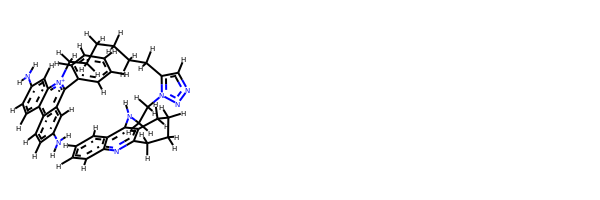

rdkit:  [H]c1nnn(C([H])([H])C([H])([H])N([H])c2c3c(nc4c([H])c([H])c([H])c([H])c24)C([H])([H])C([H])([H])C([H])([H])C3([H])[H])c1C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])[n+]1c(-c2c([H])c([H])c([H])c([H])c2[H])c2c([H])c(N([H])[H])c([H])c([H])c2c2c([H])c([H])c(N([H])[H])c([H])c21
oechem:  c1ccc(cc1)c2c3cc(ccc3c4ccc(cc4[n+]2CCCCCCc5cnnn5CCNc6c7ccccc7nc8c6CCCC8)N)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
37.81107577786689 kJ/mol 43710.89264617744 kJ/mol False
angle


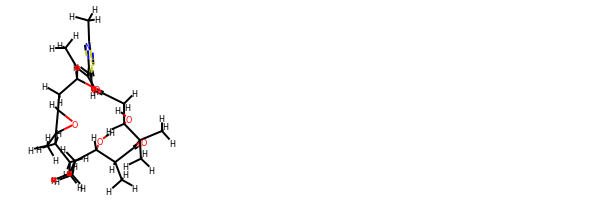

rdkit:  [H]OC1([H])C([H])(C([H])([H])[H])C(=O)C(C([H])([H])[H])(C([H])([H])[H])C([H])(O[H])C([H])([H])C(=O)OC([H])(C(=C([H])c2nc(C([H])([H])[H])sc2[H])C([H])([H])[H])C([H])([H])C2([H])OC2(C([H])([H])[H])C([H])([H])C([H])([H])C([H])([H])C1([H])C([H])([H])[H]
oechem:  Cc1nc(cs1)C=C(C)C2CC3C(O3)(CCCC(C(C(C(=O)C(C(CC(=O)O2)O)(C)C)C)O)C)C
###########################################################################
 #########################################################

bond
25.097237258612687 kJ/mol 58007.77184777659 kJ/mol False
angle
397.7880121466371 kJ/mol 397.7880121466371 kJ/mol True
nb
5.420422598793414 kJ/mol 5.420422598793414 kJ/mol True
torsion
95.41804649466118 kJ/mol 71.32718562463948 kJ/mol False
523.7237184987043 kJ/mol 58482.30746814666 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2694


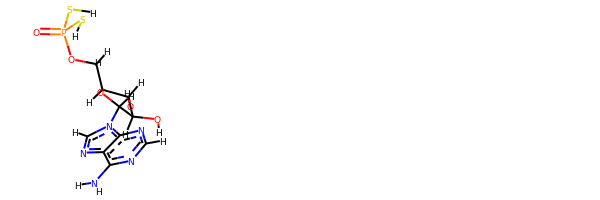

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)OC([H])(C([H])([H])OP(=O)(S[H])S[H])C1([H])O[H]
oechem:  c1nc(c2c(n1)n(cn2)C3C(C(C(O3)COP(=O)(S)S)O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
29.617444409563316 kJ/mol 58401.81642470614 kJ/mol False
angle
406.2790206587828 kJ/mol 407.08767339526935 kJ/mol False
nb
8.79852480048565 kJ/mol 8.79852480048565 kJ/mol True
torsion
111.34217432748851 kJ/mol 72.94621303901715 kJ/mol False
556.0371641963203 kJ/mol 58890.64883594091 kJ/mol

-------------------------------------------------------------------
--------------------------------------------------------------

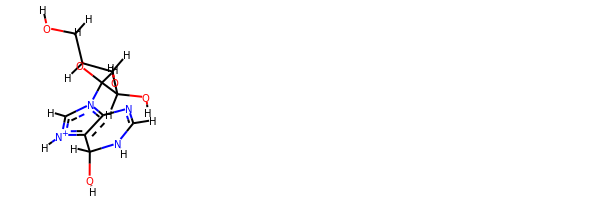

rdkit:  [H]OC1([H])c2c(n(C3([H])OC([H])(C([H])([H])O[H])C([H])(O[H])C3([H])O[H])c([H])[n+]2[H])N=C([H])N1[H]
oechem:  c1[nH+]c2c(n1C3C(C(C(O3)CO)O)O)N=CNC2O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
11.54301882727503 kJ/mol 43799.206645649334 kJ/mol False
angle
51.466373777633976 kJ/mol 53.61902541899433 kJ/mol False
nb
16.82113838405929 kJ/mol 16.82113838405929 kJ/mol True
torsion
15.872915826848445 kJ/mol 15.872916877591866 kJ/mol False
95.70344681581673 kJ/mol 43885.51972632998 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2699


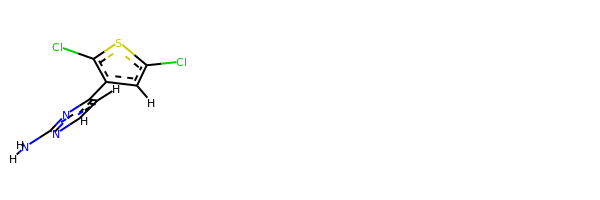

rdkit:  [H]c1nc(N([H])[H])nc(-c2c(Cl)sc(Cl)c2[H])c1[H]
oechem:  c1cnc(nc1c2cc(sc2Cl)Cl)N
###########################################################################
 #########################################################

bond
90.1934715406497 kJ/mol 173648.00188974311 kJ/mol False
angle
381.0663983136381 kJ/mol 381.0663983136381 kJ/mol True
nb
94.63604262149313 kJ/mol 94.63604262149313 kJ/mol True
torsion
97.9283113017048 kJ/mol 97.96298633815879 kJ/mol False
663.8242237774857 kJ/mol 174221.6673170164 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2701


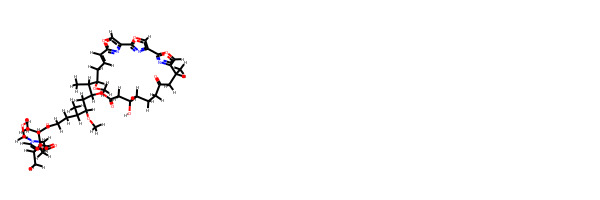

rdkit:  [H]OC([H])([H])N(C([H])=C([H])C([H])(C([H])([H])[H])C([H])(OC(=O)C([H])([H])[H])C([H])(C(=O)C([H])([H])C([H])([H])C([H])(C([H])([H])[H])C([H])(OC([H])([H])[H])C([H])([H])C1([H])OC(=O)C([H])([H])C([H])(O[H])C([H])([H])C([H])([H])C([H])([H])C(=O)C([H])([H])C([H])(C([H])([H])[H])c2nc(oc2[H])-c2nc(oc2[H])-c2nc(oc2[H])C([H])=C([H])C([H])([H])C([H])(OC([H])([H])[H])C1([H])C([H])([H])[H])C([H])([H])[H])C([H])([H])[H]
oechem:  CC1CC(=O)CCCC(CC(=O)OC(C(C(CC=Cc2nc(co2)-c3nc(co3)-c4nc1co4)OC)C)CC(C(C)CCC(=O)C(C)C(C(C)C=CN(C)CO)OC(=O)C)OC)O
###########################################################################
 #########################################################

bond
76.88157281273573 kJ/mol 226956.31438601736 kJ/mol False
angle
143.13225121191394 kJ/mol 143.82516849999206 kJ/mol False
nb
7.612984643971552 kJ/mol 7.612984643971552 kJ/mol True
torsion
95.42384195435089 kJ/mol 37.713187429082765 kJ/mol False
323.0506506229721 kJ/mol 227145.4657265904 kJ/mol

---------------------

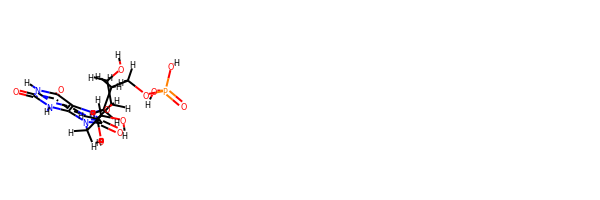

rdkit:  [H]OC([H])([H])C([H])(O[H])C([H])(O[H])C([H])(O[H])C([H])([H])n1c(=O)n(C([H])([H])C([H])([H])C([H])([H])OP(=O)(O[H])O[H])c2c(=O)n([H])c(=O)n([H])c21
oechem:  C(Cn1c2c([nH]c(=O)[nH]c2=O)n(c1=O)CC(C(C(CO)O)O)O)COP(=O)(O)O
###########################################################################
 #########################################################

bond
26.141774106026215 kJ/mol 28738.260635397895 kJ/mol False
angle
124.51123642571714 kJ/mol 124.59669642981254 kJ/mol False
nb
40.351983887968316 kJ/mol 40.351983887968316 kJ/mol True
torsion
8.675278376616694 kJ/mol 21.227538238598704 kJ/mol False
199.68027279632835 kJ/mol 28924.436853954277 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2703


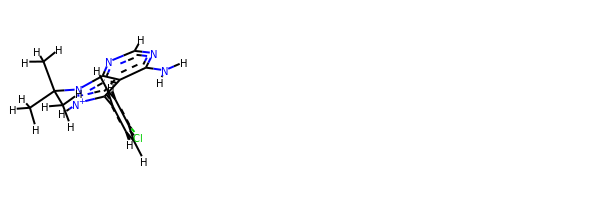

rdkit:  [H]c1nc(N([H])[H])c2c(-c3c([H])c([H])c(Cl)c([H])c3[H])[n+]([H])n(C(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H])c2n1
oechem:  CC(C)(C)n1c2c(c([nH+]1)c3ccc(cc3)Cl)c(ncn2)N
###########################################################################
 #########################################################

bond
7.198195214018536 kJ/mol 43677.33256765935 kJ/mol False
angle
44.914295500075035 kJ/mol 48.27213144891253 kJ/mol False
nb
2.729951928375315 kJ/mol 2.729951928375315 kJ/mol True
torsion
17.160678929262463 kJ/mol 0.33139375694316925 kJ/mol False
72.00312157173134 kJ/mol 43728.66604479358 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2704


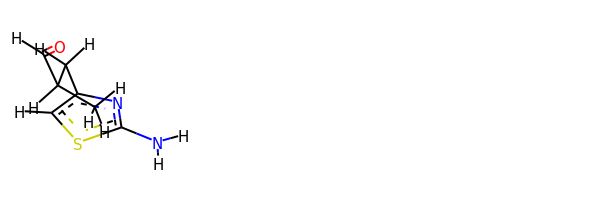

rdkit:  [H]C(=O)C([H])(C([H])([H])[H])C([H])([H])c1nc(N([H])[H])sc1[H]
oechem:  CC(Cc1csc(n1)N)C=O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
12.350060875995968 kJ/mol 101821.59073386021 kJ/mol False
angle
111.92521543344722 kJ/mol 114.07660604999455 kJ/mol False
nb
9.437954144976466 kJ/mol 9.437954144976466 kJ/mol True
torsion
20.311138096932016 kJ/mol 0.001783268553209741 kJ/mol False
154.02436855135167 kJ/mol 101945.10707732373 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
---------------------------------------------------

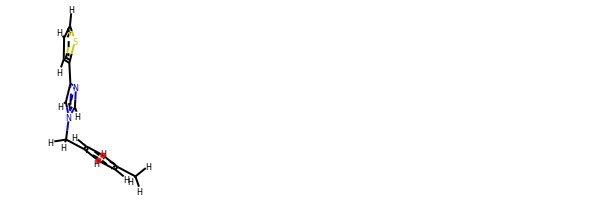

rdkit:  [H]c1sc(-c2nc([H])n(C([H])([H])c3c([H])c([H])c(C([H])([H])[H])c([H])c3[H])c2[H])c([H])c1[H]
oechem:  Cc1ccc(cc1)Cn2cc(nc2)c3cccs3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
27.695564526777257 kJ/mol 56853.84636378931 kJ/mol False
angle
31.45895164158687 kJ/mol 31.45895164158687 kJ/mol True
nb
61.08079376157799 kJ/mol 61.08079376157799 kJ/mol True
torsion
55.516206147785844 kJ/mol 51.26194047877018 kJ/mol False
175.75151607772796 kJ/mol 56997.64804967124 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
--------------------

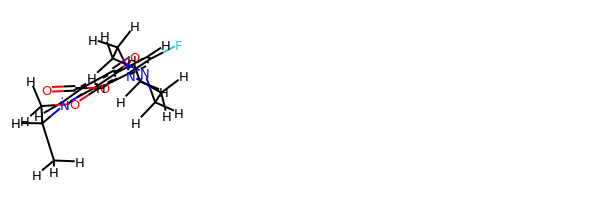

rdkit:  [H]OC(=O)c1c([H])n2c3c(c(N4C([H])([H])C([H])([H])N(C([H])([H])[H])C([H])([H])C4([H])[H])c(F)c([H])c3c1=O)OC([H])([H])C2([H])C([H])([H])[H]
oechem:  CC1COc2c3n1cc(c(=O)c3cc(c2N4CCN(CC4)C)F)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ########################################

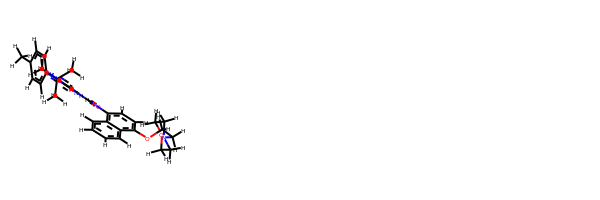

rdkit:  [H]c1c([H])c(C([H])([H])[H])c([H])c([H])c1-n1nc(C(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H])c([H])c1N([H])C(=O)N([H])c1c([H])c([H])c(OC([H])([H])C([H])([H])N2C([H])([H])C([H])([H])OC([H])([H])C2([H])[H])c2c([H])c([H])c([H])c([H])c12
oechem:  Cc1ccc(cc1)n2c(cc(n2)C(C)(C)C)NC(=O)Nc3ccc(c4c3cccc4)OCCN5CCOCC5
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
22.86697572464977 kJ/mol 114373.56792212879 kJ/mol False
angle
30.106582567081098 kJ/mol 30.736345621712726 kJ/mol False
nb
14.460926864521534 kJ/mol 14.460926864521534 kJ/mol True
torsion
54.18069709349323 kJ/mol 0.0004499139726927053 kJ/mol False
121.61518224974564 

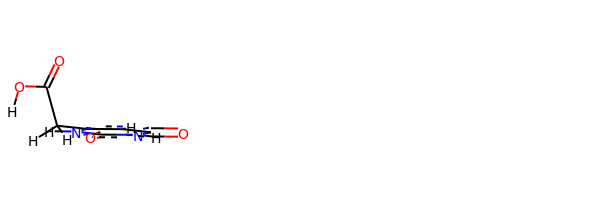

rdkit:  [H]OC(=O)C([H])([H])c1c([H])c(=O)n([H])c(=O)n1[H]
oechem:  c1c([nH]c(=O)[nH]c1=O)CC(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
12.142376257669639 kJ/mol 58032.54027784613 kJ/mol False
angle
95.95966746780807 kJ/mol 95.95966746780807 kJ/mol True
nb
36.583927334743734 kJ/mol 36.583927334743734 kJ/mol True
torsion
37.15858325666833 kJ/mol 32.75212160058438 kJ/mol False
181.8445543168898 kJ/mol 58197.83599424927 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2726


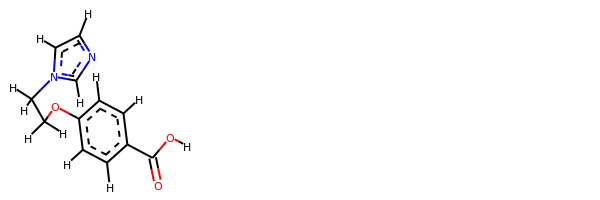

rdkit:  [H]OC(=O)c1c([H])c([H])c(OC([H])([H])C([H])([H])n2c([H])nc([H])c2[H])c([H])c1[H]
oechem:  c1cc(ccc1C(=O)O)OCCn2ccnc2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################

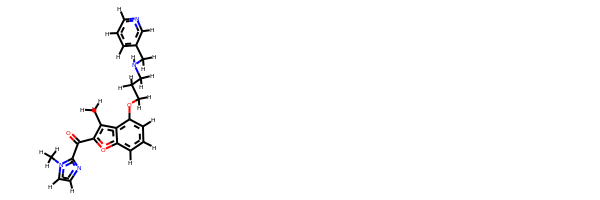

rdkit:  [H]c1nc([H])c(C([H])([H])N([H])C([H])([H])C([H])([H])C([H])([H])Oc2c([H])c([H])c([H])c3oc(C(=O)c4nc([H])c([H])n4C([H])([H])[H])c(C([H])([H])[H])c23)c([H])c1[H]
oechem:  Cc1c2c(cccc2OCCCNCc3cccnc3)oc1C(=O)c4nccn4C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
34.02817923419651 kJ/mol 56290.5975276362 kJ/mol False
angle
312.96726149193256 kJ/mol 312.967

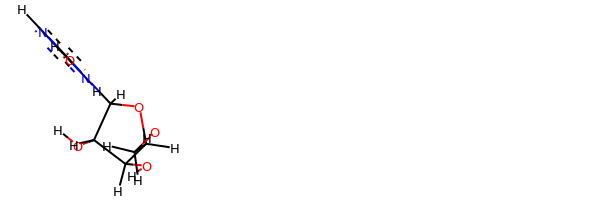

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])c([H])c([H])nc2=O)C([H])(O[H])C1([H])O[H]
oechem:  c1cnc(=O)n(c1)C2C(C(C(O2)CO)O)O
###########################################################################
 #########################################################

bond
14.201200846913398 kJ/mol 58036.42150034447 kJ/mol False
angle
123.93491653940006 kJ/mol 123.93491653940006 kJ/mol True
nb
-0.7256865188456224 kJ/mol -0.7256865188456224 kJ/mol True
torsion
48.98629147832307 kJ/mol 5.036350571753627 kJ/mol False
186.3967223457909 kJ/mol 58164.66708093678 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2744


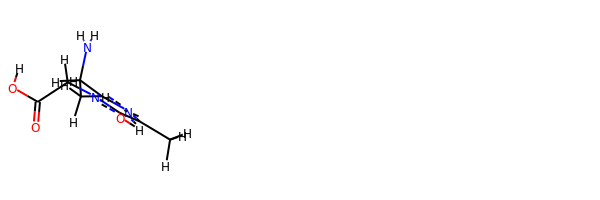

rdkit:  [H]OC(=O)C([H])([H])n1c(C([H])(N([H])[H])C([H])([H])[H])nc(C([H])([H])[H])c1O[H]
oechem:  Cc1c(n(c(n1)C(C)N)CC(=O)O)O
###########################################################################
 #########################################################

bond
12.28360148994029 kJ/mol 57365.28516367517 kJ/mol False
angle
23.13100422887788 kJ/mol 23.259747613781965 kJ/mol False
nb
63.13633482750941 kJ/mol 63.13633482750941 kJ/mol True
torsion
45.8328258078368 kJ/mol 28.440615669554486 kJ/mol False
144.38376635416438 kJ/mol 57480.12186178602 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2745


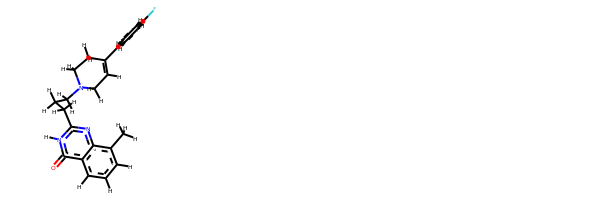

rdkit:  [H]C1=C(c2c([H])c([H])c(F)c([H])c2[H])C([H])([H])C([H])([H])N(C([H])([H])C([H])([H])C([H])([H])c2nc3c(C([H])([H])[H])c([H])c([H])c([H])c3c(=O)n2[H])C1([H])[H]
oechem:  Cc1cccc2c1nc([nH]c2=O)CCCN3CCC(=CC3)c4ccc(cc4)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
22.540912634182998 kJ/mol 114190.78949040583 kJ/mol False
angle
107.73344678335671 kJ/mol 109.55479355812713 kJ/mol False
nb
12.45100703452639 kJ/mol 12.45100703452639 kJ/mol True
torsion
33.472016475425676 kJ/mol 3.535656924379126e-05 kJ/mol False
176.19738292749176 kJ/mol 114312.79532635506 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------

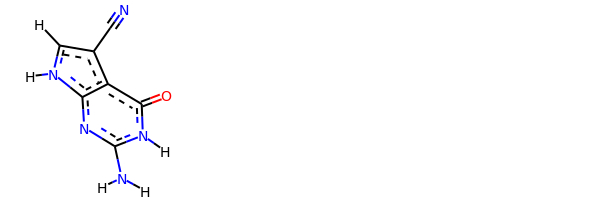

rdkit:  [H]c1c(C#N)c2c(=O)n([H])c(N([H])[H])nc2n1[H]
oechem:  c1c(c2c([nH]1)nc([nH]c2=O)N)C#N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
46.355747570485484 kJ/mol 73.05793848739403 kJ/mol False
angle
516.5341767589799 kJ/mol 516.5341767589799 kJ/mol True
nb
-8.124429411138625 kJ/mol -8.124429411138625 kJ/mol True
torsion
24.758224724309084 kJ/mol 24.758251024050708 kJ/mol False
579.5237196426359 kJ/mol 606.2259368592861 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
--------------------------------------------------------------

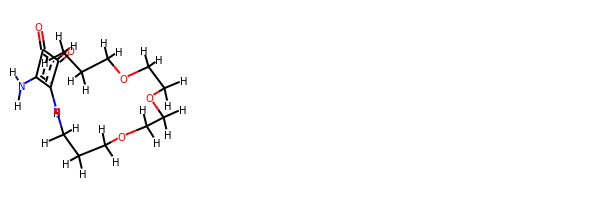

rdkit:  [H]N([H])c1c(N([H])C([H])([H])C([H])([H])C([H])([H])OC([H])([H])C([H])([H])OC([H])([H])C([H])([H])OC([H])([H])C([H])([H])C([H])([H])[H])c(=O)c1=O
oechem:  CCCOCCOCCOCCCNc1c(c(=O)c1=O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
22.92293503967131 kJ/mol 57939.37466162217 kJ/mol False
angle
397.26271251412356 kJ/mol 397.26271251412356 kJ/mol True
nb
3.2659508121776377 kJ/mol 3.2659508121776377 kJ/mol True
torsion
98.29713866689005 kJ/mol 74.18299082439128 kJ/mol False
521.7487370328626 kJ/mol 58414.08631577286 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2752


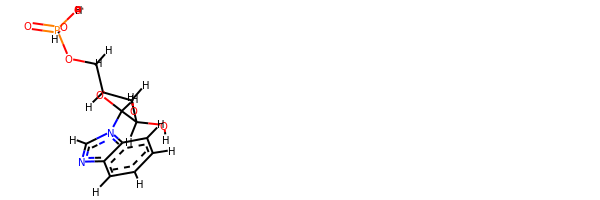

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c([H])c([H])c([H])c([H])c32)OC([H])(C([H])([H])OP(=O)(O[H])O[H])C1([H])O[H]
oechem:  c1ccc2c(c1)ncn2C3C(C(C(O3)COP(=O)(O)O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
17.386857186350408 kJ/mol 58037.80714305942 kJ/mol False
angle
115.86946648142121 kJ/mol 115.86946648142121 kJ/mol True
nb
36.311805342735944 kJ/mol 36.311805342735944 kJ/mol True
torsion
186.09087790191 kJ/mol 180.82264833672986 kJ/mol False
355.65900691241757 kJ/mol 58370.81106322032 kJ/mol

-------------------------------------------------------------------
------------------------------------------------------------

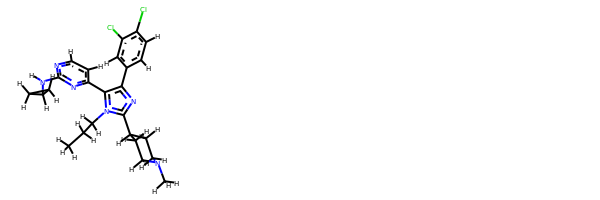

rdkit:  [H]c1nc(N([H])C2([H])C([H])([H])C2([H])[H])nc(-c2c(-c3c([H])c([H])c(Cl)c(Cl)c3[H])nc(C3([H])C([H])([H])C([H])([H])N(C([H])([H])[H])C([H])([H])C3([H])[H])n2C([H])([H])C([H])([H])C([H])([H])[H])c1[H]
oechem:  CCCn1c(c(nc1C2CCN(CC2)C)c3ccc(c(c3)Cl)Cl)c4ccnc(n4)NC5CC5
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
5.0681070517665745 kJ/mol 43675.49421545907 kJ/mol False
angle
39.3356269665837 kJ/mol 42.69169311747125 kJ/mol False
nb
1.0813810567444089 kJ/mol 1.0813810567444089 kJ/mol True
torsion
4.106182585848745 kJ/mol 1.9305895787237406 kJ/mol False
49.59129766094343 kJ/mol 43721.197879212006 kJ/mol

-------------------

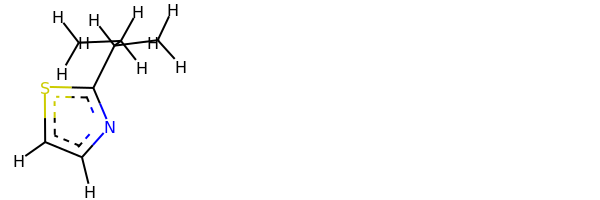

rdkit:  [H]c1nc(C([H])(C([H])([H])[H])C([H])([H])C([H])([H])[H])sc1[H]
oechem:  CCC(C)c1nccs1
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
23.414835500980935 kJ/mol 57997.85288836227 kJ/mol False
angle
102.59559633968851 kJ/

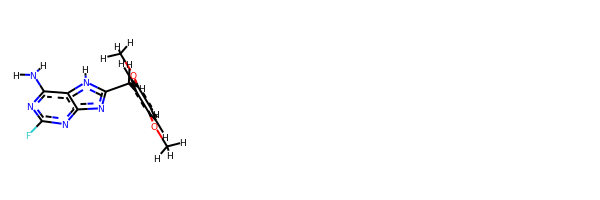

rdkit:  [H]c1c([H])c(OC([H])([H])[H])c(C([H])([H])c2nc3nc(F)nc(N([H])[H])c3n2[H])c([H])c1OC([H])([H])[H]
oechem:  COc1ccc(c(c1)Cc2[nH]c3c(nc(nc3n2)F)N)OC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
23.002586028645446 kJ/mol 57739.63536718072 kJ/mol False
angle
130.81093225871362 kJ/mol 130.81093225871362 kJ/mol True
nb
25.86054808009348 kJ/mol 25.86054808009348 kJ/mol True
torsion
7.878905002947009 kJ/mol 7.878903831666427 kJ/mol False
187.55297137039958 kJ/mol 57904.18575135119 kJ/mol

---

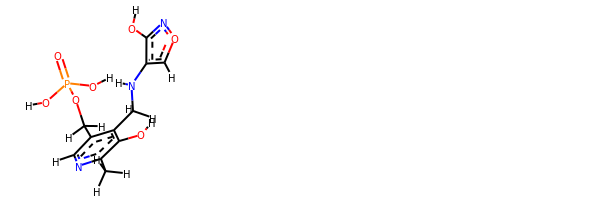

rdkit:  [H]Oc1noc([H])c1N([H])C([H])([H])c1c(O[H])c(C([H])([H])[H])nc([H])c1C([H])([H])OP(=O)(O[H])O[H]
oechem:  Cc1c(c(c(cn1)COP(=O)(O)O)CNc2conc2O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
40.33924924830362 kJ/mol 114663.74384031999 kJ/mol False
angle
28.236421596052452 kJ/mol 28.8683398161003 kJ/mol False
nb
16.404123782975585 kJ/mol 16.404123782975585 kJ/mol True
torsion
123.00965825874661 kJ/mol 85.35374914886198 kJ/mol False
207.98945288607825 kJ/mol 114794.37005306793 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2772


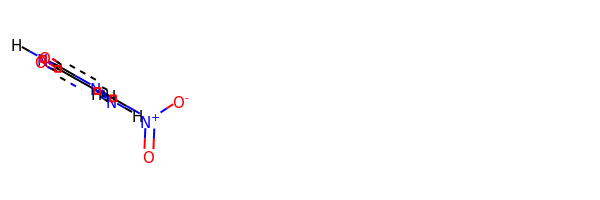

rdkit:  [H]N([H])c1c([N+](=O)[O-])n([H])c(=O)n([H])c1=O
oechem:  c1(c([nH]c(=O)[nH]c1=O)[N+](=O)[O-])N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
46.819109712962685 kJ/mol 44031.912418980646 kJ/mol False
angle
81.85077604553781 kJ/mol 84.10674033824137 kJ/mol False
nb
34.57991862749118 kJ/mol 34.57991862749118 kJ/mol True
torsion
46.05715247355967 kJ/mol 37.99254347075723 kJ/mol False
209.30695685955135 kJ/mol 44188.59162141713 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2774


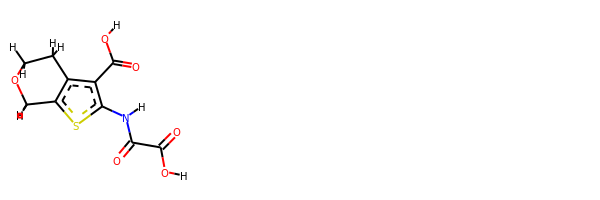

rdkit:  [H]OC(=O)C(=O)N([H])c1sc2c(c1C(=O)O[H])C([H])([H])C([H])([H])OC2([H])[H]
oechem:  C1COCc2c1c(c(s2)NC(=O)C(=O)O)C(=O)O
###########################################################################
 #########################################################

bond
52.24629436023443 kJ/mol 113464.28896847472 kJ/mol False
angle
377.2543609062978 kJ/mol 377.8746619538773 kJ/mol False
nb
12.18956231138534 kJ/mol 12.18956231138534 kJ/mol True
torsion
121.2885809237565 kJ/mol 64.2227128474644 kJ/mol False
562.9787985016741 kJ/mol 113918.57590558744 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2775


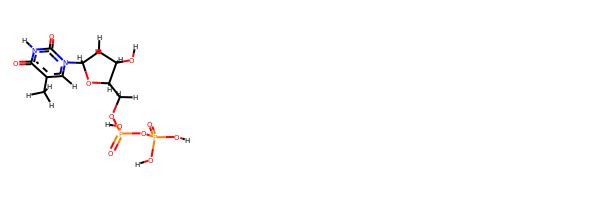

rdkit:  [H]OC1([H])C([H])([H])C([H])(n2c([H])c(C([H])([H])[H])c(=O)n([H])c2=O)OC1([H])C([H])([H])OP(=O)(O[H])OP(=O)(O[H])O[H]
oechem:  Cc1cn(c(=O)[nH]c1=O)C2CC(C(O2)COP(=O)(O)OP(=O)(O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #######################################################

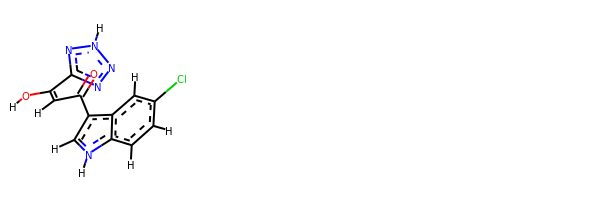

rdkit:  [H]OC(=C([H])C(=O)c1c([H])n([H])c2c([H])c([H])c(Cl)c([H])c12)c1nnn([H])n1
oechem:  c1cc2c(cc1Cl)c(c[nH]2)C(=O)C=C(c3n[nH]nn3)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
17.26801113563985 kJ/mol 57769.17335780245 kJ/mol False
angle
89.63268924949075 kJ/mol 89.63268924949075 kJ/mol True
nb
48.972493499349824 kJ/mol 48.972493499349824 kJ/mol True
torsion
23.186793533398987 kJ/mol 0.14881916522776312 kJ/mol False
179.05998741787943 kJ/mol 57907.927359716516 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2792


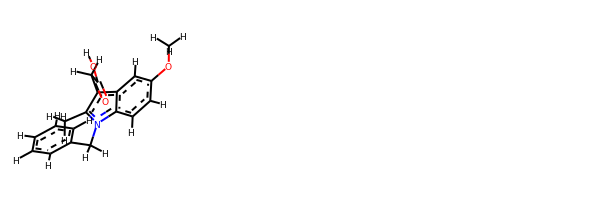

rdkit:  [H]OC(=O)C([H])([H])c1c(C([H])([H])[H])n(C([H])([H])c2c([H])c([H])c([H])c([H])c2[H])c2c([H])c([H])c(OC([H])([H])[H])c([H])c12
oechem:  Cc1c(c2cc(ccc2n1Cc3ccccc3)OC)CC(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
38.406144653553106 kJ/mol 58022.206991603714 kJ/mol False
angle
464.4291207861537 kJ/mol 464.4291207861537 kJ/mol True
nb
14.660754007728187 kJ/mol 14.660754007728187 kJ/mol True
torsion
120.57153863702948 kJ/mol 96.51688551176727 kJ/mol False
638.0675580844645 kJ/mol 58597.813751909365 kJ/mol

-------------------------------------------------------------------
-------------------------------------------

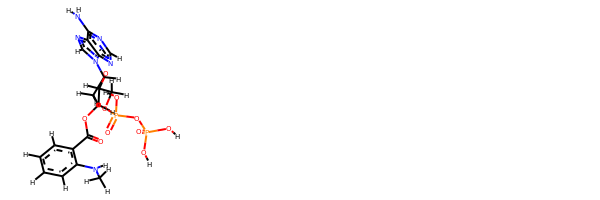

rdkit:  [H]OP(=O)(O[H])OP(=O)(O[H])OC([H])([H])C1([H])OC([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)C([H])([H])C1([H])OC(=O)c1c([H])c([H])c([H])c([H])c1N([H])C([H])([H])[H]
oechem:  CNc1ccccc1C(=O)OC2CC(OC2COP(=O)(O)OP(=O)(O)O)n3cnc4c3ncnc4N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
7.403956568020319 kJ/mol 43614.32140745054 kJ/mol False
angle
60.19319309647

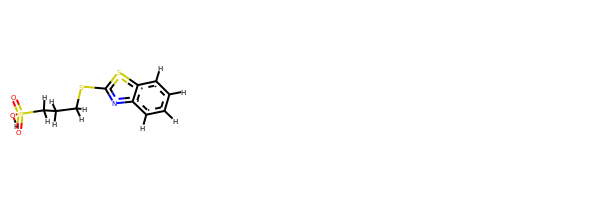

rdkit:  [H]OS(=O)(=O)C([H])([H])C([H])([H])C([H])([H])Sc1nc2c([H])c([H])c([H])c([H])c2s1
oechem:  c1ccc2c(c1)nc(s2)SCCCS(=O)(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
13.654541590239308 kJ/mol 43728.88346292463 kJ/mol False
angle
29.48822660281078 kJ/mol 31.328971173424172 kJ/mol False
nb
14.737288516947437 kJ/mol 14.737288516947437 kJ/mol True
torsion
16.74700432311162 kJ/mol 16.747008441844542 kJ/mol False
74.62706103310916 kJ/mol 43791.69673105684 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------

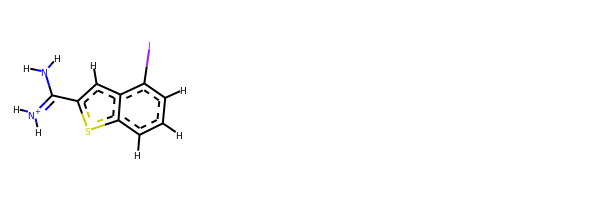

rdkit:  [H]c1c([H])c(I)c2c([H])c(C(N([H])[H])=[N+]([H])[H])sc2c1[H]
oechem:  c1cc2c(cc(s2)C(=[NH2+])N)c(c1)I
###########################################################################
 #########################################################

bond
25.08544709408925 kJ/mol 58008.81998102461 kJ/mol False
angle
112.31936397836203 kJ/mol 112.31936397836203 kJ/mol True
nb
72.55671241608 kJ/mol 72.55671241608 kJ/mol True
torsion
3.0063592461712605 kJ/mol 0.2810985888107843 kJ/mol False
212.96788273470253 kJ/mol 58193.977156007866 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2804


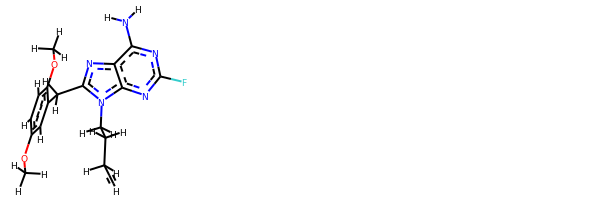

rdkit:  [H]C#CC([H])([H])C([H])([H])C([H])([H])n1c(C([H])([H])c2c([H])c(OC([H])([H])[H])c([H])c([H])c2OC([H])([H])[H])nc2c(N([H])[H])nc(F)nc21
oechem:  COc1ccc(c(c1)Cc2nc3c(nc(nc3n2CCCC#C)F)N)OC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ################################################

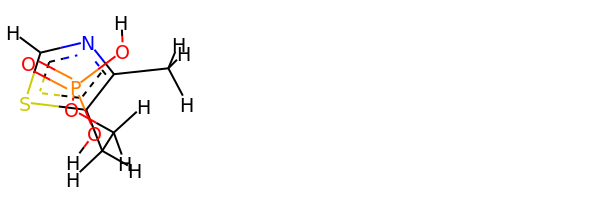

rdkit:  [H]OP(=O)(O[H])OC([H])([H])C([H])([H])c1sc([H])nc1C([H])([H])[H]
oechem:  Cc1c(scn1)CCOP(=O)(O)O
###########################################################################
 #########################################################

bond
32.490128990769875 kJ/mol 57997.12535092817 kJ/mol False
angle
420.63953143468285 kJ/mol 420.63953143468285 kJ/mol True
nb
4.713383898469913 kJ/mol 4.713383898469913 kJ/mol True
torsion
102.66672053946189 kJ/mol 78.56365422736715 kJ/mol False
560.5097648633845 kJ/mol 58501.04192048868 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2813


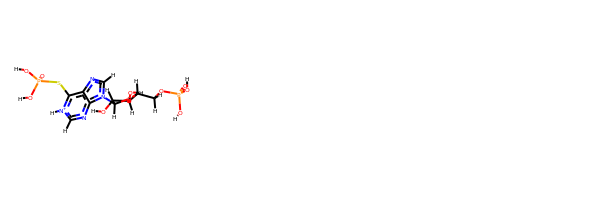

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c(SP(=O)(O[H])O[H])[n+]([H])c([H])nc32)OC([H])(C([H])([H])OP(=O)(O[H])O[H])C1([H])O[H]
oechem:  c1[nH+]c(c2c(n1)n(cn2)C3C(C(C(O3)COP(=O)(O)O)O)O)SP(=O)(O)O
###########################################################################
 #########################################################

bond
38.8472884897676 kJ/mol 58021.521899007734 kJ/mol False
angle
452.823845760995 kJ/mol 452.823845760995 kJ/mol True
nb
-0.9968165254169428 kJ/mol -0.9968165254169428 kJ/mol True
torsion
96.15142114185647 kJ/mol 72.06056027183479 kJ/mol False
586.8257388672021 kJ/mol 58545.40948851514 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2815


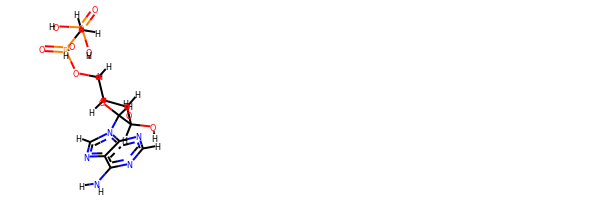

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)OC([H])(C([H])([H])OP(=O)(O[H])C([H])([H])P(=O)(O[H])O[H])C1([H])O[H]
oechem:  c1nc(c2c(n1)n(cn2)C3C(C(C(O3)COP(=O)(CP(=O)(O)O)O)O)O)N
###########################################################################
 #########################################################

bond
45.94587181018402 kJ/mol 113902.15828341985 kJ/mol False
angle
340.67187900291583 kJ/mol 341.2925015176674 kJ/mol False
nb
25.04506064087717 kJ/mol 25.04506064087717 kJ/mol True
torsion
112.98499202581644 kJ/mol 55.92161707691105 kJ/mol False
524.6478034797934 kJ/mol 114324.4174626553 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2817


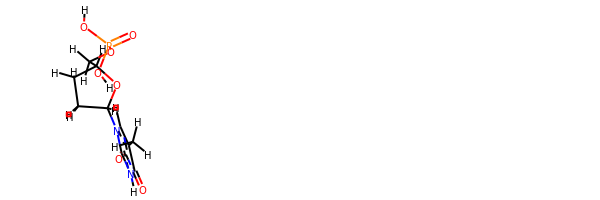

rdkit:  [H]OP(=O)(O[H])OC([H])([H])C1([H])OC([H])(n2c([H])c(C([H])([H])[H])c(=O)n([H])c2=O)C([H])([H])C1([H])[H]
oechem:  Cc1cn(c(=O)[nH]c1=O)C2CCC(O2)COP(=O)(O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
49.58877981322745 kJ/mol 113352.89505267862 kJ/mol False
angle
341.0598275791044 kJ/mol 341.6478131972076 kJ/mol False
nb
25.955417074122455 kJ/mol 25.955417074122455 kJ/mol True
torsion
124.83181250809436 kJ/mol 67.81288924606562 kJ/mol False
541.4358369745487 kJ/mol 113788.31117219602 

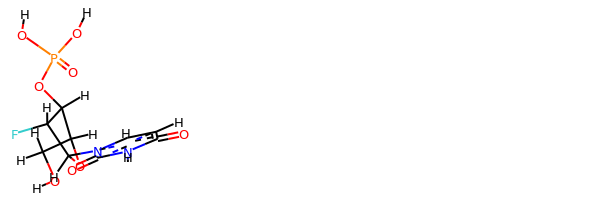

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])c([H])c(=O)n([H])c2=O)C([H])(F)C1([H])OP(=O)(O[H])O[H]
oechem:  c1cn(c(=O)[nH]c1=O)C2C(C(C(O2)CO)OP(=O)(O)O)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
31.63965339482335 kJ/mol 57784.738620146374 kJ/mol False
angle
78.9391192025079 kJ/mol 80.17261957852249 kJ/mol False
nb
48.14911379767516 kJ/mol 48.14911379767516 kJ/mol True
torsion
53.3509804716753 kJ/mol 53.35099083561098 kJ/mol False
212.07886686668172 kJ/mol 57966.41134435819 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
----

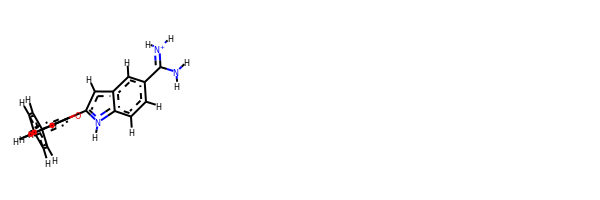

rdkit:  [H]c1c([H])c([H])c(-c2c([H])c([H])c([H])c(-c3c([H])c4c([H])c(C(N([H])[H])=[N+]([H])[H])c([H])c([H])c4n3[H])c2[O-])c([H])c1[H]
oechem:  c1ccc(cc1)c2cccc(c2[O-])c3cc4cc(ccc4[nH]3)C(=[NH2+])N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
65.8511282743488 kJ/mol 113472.71037615318 kJ/mol False
angle
389.6043441527019 kJ/mol 390.22510478901205 kJ/mol False
nb
17.76819662504757 kJ/mol 17.76819662504757 kJ/mol True
torsion
195.67612063210456 kJ/mol 138.6104179666126 kJ/mol False
668.8997896842029 kJ/mol 114019.31409553386 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2828


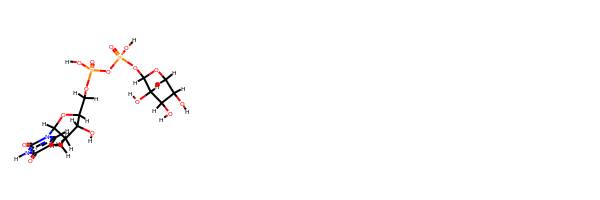

rdkit:  [H]OC1([H])C([H])([H])OC([H])(OP(=O)(O[H])OP(=O)(O[H])OC([H])([H])C2([H])OC([H])(n3c([H])c(C([H])([H])[H])c(=O)n([H])c3=O)C([H])([H])C2([H])O[H])C([H])(O[H])C1([H])O[H]
oechem:  Cc1cn(c(=O)[nH]c1=O)C2CC(C(O2)COP(=O)(O)OP(=O)(O)OC3C(C(C(CO3)O)O)O)O
###########################################################################
 #########################################################

bond
10.113315238685193 kJ/mol 45121.66015212851 kJ/mol False
angle
67.77725448962292 kJ/mol 67.77725448962292 kJ/mol True
nb
7.714426285674812 kJ/mol 7.714426285674812 kJ/mol True
torsion
0.00013020377776375497 kJ/mol 0.00013214058125587627 kJ/mol False
85.60512621776068 kJ/mol 45197.15196504439 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2829


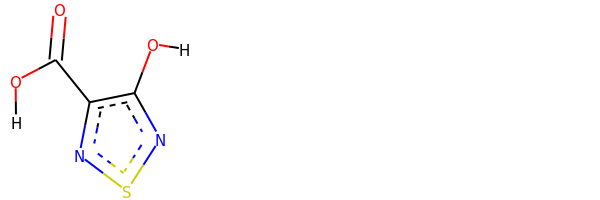

rdkit:  [H]OC(=O)c1nsnc1O[H]
oechem:  c1(c(nsn1)O)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
13.029614251669777 kJ/mol 57767.58422550203 kJ/mol False
angle
106.33821950251577 kJ/mol 107.5665075029508 kJ/mol False
nb
4.638717118865079 kJ/mol 4.638717118865079 kJ/mol True
torsion
9.542142892251825 kJ/mol 9.542148060007591 kJ/mol False
133.548693765302

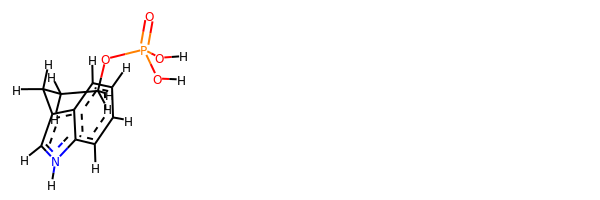

rdkit:  [H]OP(=O)(O[H])OC([H])([H])C([H])([H])C([H])([H])c1c([H])n([H])c2c([H])c([H])c([H])c([H])c12
oechem:  c1ccc2c(c1)c(c[nH]2)CCCOP(=O)(O)O
###########################################################################
 #########################################################

bond
22.006083790328958 kJ/mol 57878.64116005046 kJ/mol False
angle
397.7592703062668 kJ/mol 397.7592703062668 kJ/mol True
nb
11.894480476280105 kJ/mol 11.894480476280105 kJ/mol True
torsion
87.55283953290018 kJ/mol 66.6372097719825 kJ/mol False
519.212674105776 kJ/mol 58354.932120604986 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2837


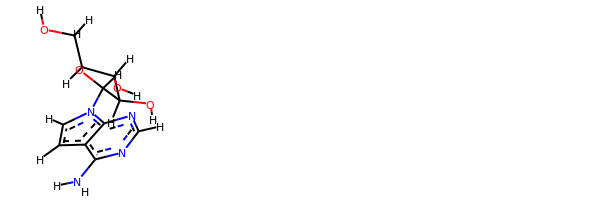

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])c([H])c3c(N([H])[H])nc([H])nc32)C([H])(O[H])C1([H])O[H]
oechem:  c1cn(c2c1c(ncn2)N)C3C(C(C(O3)CO)O)O
###########################################################################
 #########################################################

bond
39.005362346940686 kJ/mol 57791.076639001476 kJ/mol False
angle
441.3905504212628 kJ/mol 442.6238190250339 kJ/mol False
nb
39.47357156550721 kJ/mol 39.47357156550721 kJ/mol True
torsion
102.7992841326436 kJ/mol 102.79929253365856 kJ/mol False
622.6687684663543 kJ/mol 58375.973322125676 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2838


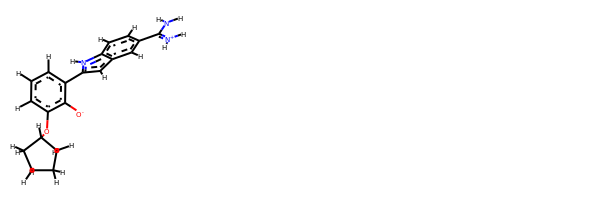

rdkit:  [H]c1c([H])c(OC2([H])C([H])([H])C([H])([H])C([H])([H])C2([H])[H])c([O-])c(-c2c([H])c3c([H])c(C(N([H])[H])=[N+]([H])[H])c([H])c([H])c3n2[H])c1[H]
oechem:  c1cc(c(c(c1)OC2CCCC2)[O-])c3cc4cc(ccc4[nH]3)C(=[NH2+])N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
2.1798790156718573 kJ/mol 57917.29195066973 kJ/mol False
angle
78.17791982990134 kJ/mol 80.0820536657432 kJ/mol False
nb
13.01960297426439 kJ/mol 13.01960297426439 kJ/mol True
torsion
2.0242978338231795e-05 kJ/mol 2.057642563027873e-

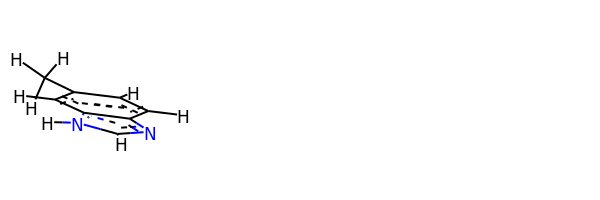

rdkit:  [H]c1c(C([H])([H])[H])c([H])c2c(nc([H])n2[H])c1[H]
oechem:  Cc1ccc2c(c1)[nH]cn2
###########################################################################
 #########################################################

bond
53.299255624302816 kJ/mol 114181.7463888658 kJ/mol False
angle
412.8581614764795 kJ/mol 413.21042917698566 kJ/mol False
nb
1.6114968274199843 kJ/mol 1.6114968274199843 kJ/mol True
torsion
164.34299648933427 kJ/mol 106.89402478753554 kJ/mol False
632.1119104175365 kJ/mol 114703.46233965772 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2843


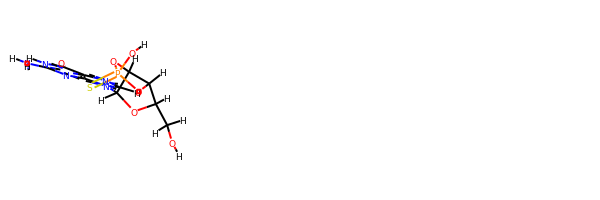

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])nc3c(=O)n([H])c(N([H])[H])nc32)C2([H])OP(=S)(O[H])OC12[H]
oechem:  c1nc2c(=O)[nH]c(nc2n1C3C4C(C(O3)CO)OP(=S)(O4)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
45.3021304620445 kJ/mol 85678.15642283794 kJ/mol False
angle
36.247828077719234 kJ/mol 36.63555514104131 kJ/mol False
nb
85.09966060509123 kJ/mol 85.09966060509123 kJ/mol True
torsion
61.8325157544094 kJ/mol 23.951461952582374 kJ/mol False
228.48213489926437 kJ/mol 85823.84310053666 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2846


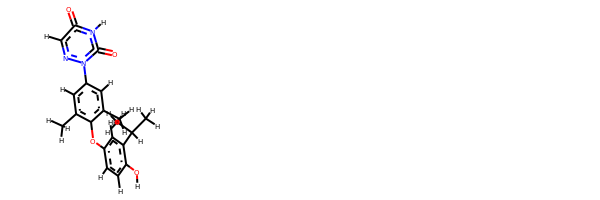

rdkit:  [H]Oc1c([H])c([H])c(Oc2c(C([H])([H])[H])c([H])c(-n3nc([H])c(=O)n([H])c3=O)c([H])c2C([H])([H])[H])c([H])c1C([H])(C([H])([H])[H])C([H])([H])[H]
oechem:  Cc1cc(cc(c1Oc2ccc(c(c2)C(C)C)O)C)n3c(=O)[nH]c(=O)cn3
###########################################################################
 #########################################################

bond
24.02023967725285 kJ/mol 29093.50553077866 kJ/mol False
angle
100.69002342529872 kJ/mol 100.69002342529872 kJ/mol True
nb
17.951472220553356 kJ/mol 17.951472220553356 kJ/mol True
torsion
38.28603627858627 kJ/mol 27.77604099910441 kJ/mol False
180.94777160169122 kJ/mol 29239.923067423617 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2848


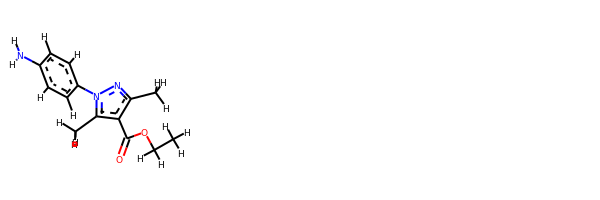

rdkit:  [H]c1c([H])c(-n2nc(C([H])([H])[H])c(C(=O)OC([H])([H])C([H])([H])[H])c2C([H])([H])[H])c([H])c([H])c1N([H])[H]
oechem:  CCOC(=O)c1c(nn(c1C)c2ccc(cc2)N)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

#########################

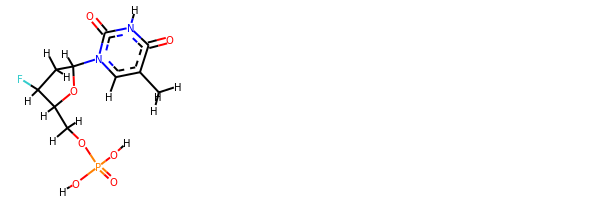

rdkit:  [H]OP(=O)(O[H])OC([H])([H])C1([H])OC([H])(n2c([H])c(C([H])([H])[H])c(=O)n([H])c2=O)C([H])([H])C1([H])F
oechem:  Cc1cn(c(=O)[nH]c1=O)C2CC(C(O2)COP(=O)(O)O)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
11.046492749332483 kJ/mol 57055.28238977179 kJ/mol False
angle
24.90697502177045 kJ/mol 25.142504452710796 kJ/mol False
nb
37.16473714667261 kJ/mol 37.16473714667261 kJ/mol True
torsion
33.47881440102418 kJ/mol 0.006842127398698159 kJ/mol False
106.59701931879972 kJ/mol 57117.596473498576 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2862


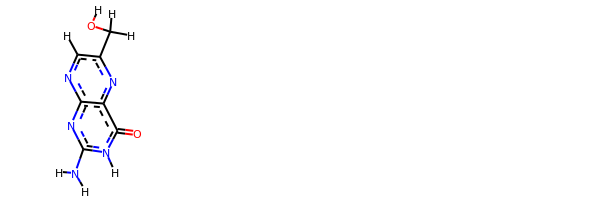

rdkit:  [H]OC([H])([H])c1nc2c(=O)n([H])c(N([H])[H])nc2nc1[H]
oechem:  c1c(nc2c(=O)[nH]c(nc2n1)N)CO
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
25.29894670967483 kJ/mol 58000.695906468165 kJ/mol False
angle
415.7325487392337 kJ/mol 415.7325487392337 kJ/mol True
nb
11.701769507143299 kJ/mol 11.701769507143299 kJ/mol True
torsion
98.42872268972495 kJ/mol 74.31418503945092 kJ/mol False
551.1619876457769 kJ/mol 58502.444409753996 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2865


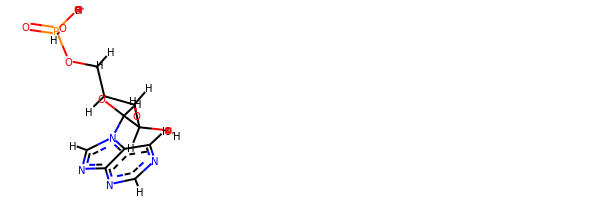

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3nc([H])nc([H])c32)OC([H])(C([H])([H])OP(=O)(O[H])O[H])C1([H])O[H]
oechem:  c1c2c(ncn1)ncn2C3C(C(C(O3)COP(=O)(O)O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
30.73295570750542 kJ/mol 56487.79661146228 kJ/mol False
angle
62.20334351341259 kJ/mol 62.20334351341259 kJ/mol True
nb
39.48981847725848 kJ/mol 39.48981847725848 kJ/mol True
torsion
96.23387700949905 kJ/mol 89.32919476064484 kJ/mol False
228.65999470767554 kJ/mol 56678.8189682136 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2867


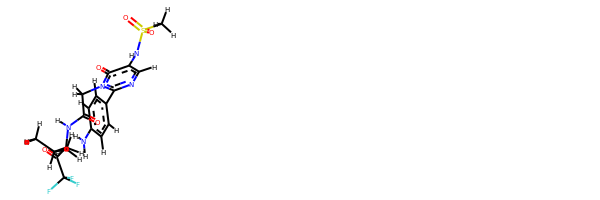

rdkit:  [H]c1nc(-c2c([H])c([H])c(N([H])[H])c([H])c2[H])n(C([H])([H])C(=O)N([H])C([H])(C(=O)C(F)(F)F)C([H])(C([H])([H])[H])C([H])([H])[H])c(=O)c1N([H])S(=O)(=O)C([H])([H])[H]
oechem:  CC(C)C(C(=O)C(F)(F)F)NC(=O)Cn1c(=O)c(cnc1c2ccc(cc2)N)NS(=O)(=O)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

########################################################################

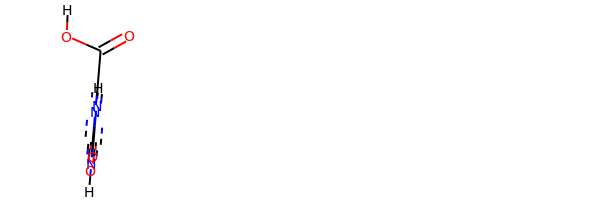

rdkit:  [H]OC(=O)c1nc(=O)n([H])c(=O)n1[H]
oechem:  c1([nH]c(=O)[nH]c(=O)n1)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
12.454793347300056 kJ/mol 57994.332480153775 kJ/mol False
angle
327.42187724450145 kJ/mol 327.421

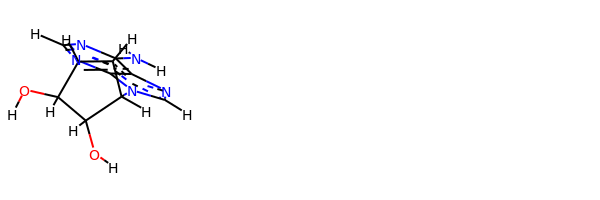

rdkit:  [H]OC1([H])C([H])=C([H])C([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)C1([H])O[H]
oechem:  c1nc(c2c(n1)n(cn2)C3C=CC(C3O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
19.979921576172863 kJ/mol 58042.55303119998 kJ/mol False
angle
101.19052601506652 kJ/mol 101.19052601506652 kJ/mol True
nb
31.05835493142233 kJ/mol 31.05835493142233 kJ/mol True
torsion
38.53676027634338 kJ/mol 28.243510144589152 kJ/mol False
190.76556279900512 kJ/mol 58203.04542229106 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
----------------------------

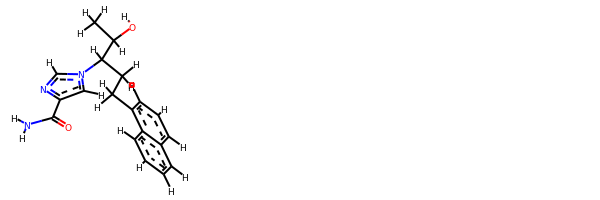

rdkit:  [H]OC([H])(C([H])([H])[H])C([H])(n1c([H])nc(C(=O)N([H])[H])c1[H])C([H])([H])C([H])([H])c1c([H])c([H])c([H])c2c([H])c([H])c([H])c([H])c12
oechem:  CC(C(CCc1cccc2c1cccc2)n3cc(nc3)C(=O)N)O
###########################################################################
 #########################################################

bond
30.63947854377091 kJ/mol 44194.09349731625 kJ/mol False
angle
114.2450558041609 kJ/mol 116.71413900257383 kJ/mol False
nb
25.897037195943394 kJ/mol 25.897037195943394 kJ/mol True
torsion
198.18591824637844 kJ/mol 198.19413706945306 kJ/mol False
368.96748979025364 kJ/mol 44534.89881058422 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2885


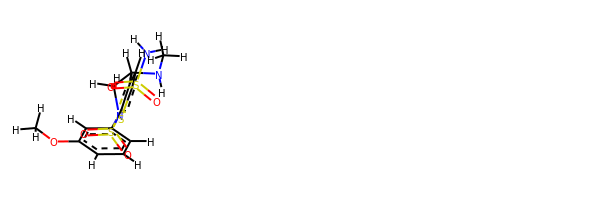

rdkit:  [H]c1c([H])c(OC([H])([H])[H])c([H])c(N2C([H])([H])C([H])(N([H])C([H])([H])[H])c3c(sc(S(=O)(=O)N([H])[H])c3[H])S2(=O)=O)c1[H]
oechem:  CNC1CN(S(=O)(=O)c2c1cc(s2)S(=O)(=O)N)c3cccc(c3)OC
###########################################################################
 #########################################################

bond
29.93685313468518 kJ/mol 58013.73770008482 kJ/mol False
angle
498.2963791148817 kJ/mol 498.2963791148817 kJ/mol True
nb
-9.149431251373972 kJ/mol -9.149431251373972 kJ/mol True
torsion
92.94098189851907 kJ/mol 68.8863287732569 kJ/mol False
612.024782896712 kJ/mol 58571.770976721586 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2886


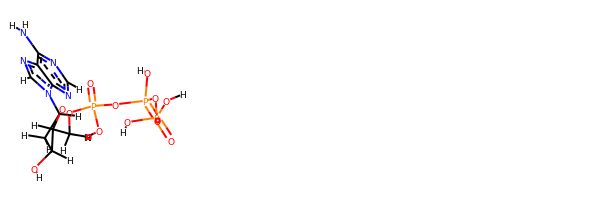

rdkit:  [H]OC1([H])C([H])([H])C([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)OC1([H])C([H])([H])OP(=O)(O[H])OP(=O)(O[H])OP(=O)(O[H])O[H]
oechem:  c1nc(c2c(n1)n(cn2)C3CC(C(O3)COP(=O)(O)OP(=O)(O)OP(=O)(O)O)O)N
###########################################################################
 #########################################################

bond
32.90358972146876 kJ/mol 58052.97370877366 kJ/mol False
angle
129.6372801666045 kJ/mol 131.64833129308417 kJ/mol False
nb
12.732295932393805 kJ/mol 12.732295932393805 kJ/mol True
torsion
32.007429046728504 kJ/mol 31.295031605032758 kJ/mol False
207.2805948671956 kJ/mol 58228.64936760417 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2887


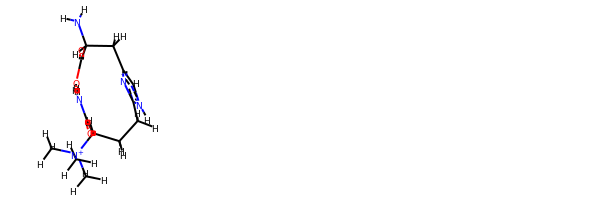

rdkit:  [H]OC(=O)C([H])(N([H])[H])C([H])([H])c1nc(C([H])([H])C([H])([H])C([H])(C(=O)N([H])[H])[N+](C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H])n([H])c1[H]
oechem:  C[N+](C)(C)C(CCc1[nH]cc(n1)CC(C(=O)O)N)C(=O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ###############################

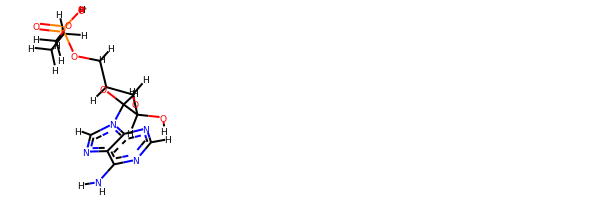

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)OC([H])(C([H])([H])OP(=O)(O[H])OC([H])([H])C([H])([H])C([H])([H])[H])C1([H])O[H]
oechem:  CCCOP(=O)(O)OCC1C(C(C(O1)n2cnc3c2ncnc3N)O)O
###########################################################################
 #########################################################

bond
36.867648075162904 kJ/mol 29.809834639790022 kJ/mol False
angle
124.50794368075763 kJ/mol 124.50794368075763 kJ/mol True
nb
68.71211470839341 kJ/mol 68.71211470839341 kJ/mol True
torsion
31.54255991040772 kJ/mol 21.082558487492932 kJ/mol False
261.6302663747217 kJ/mol 244.11245151643402 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2895


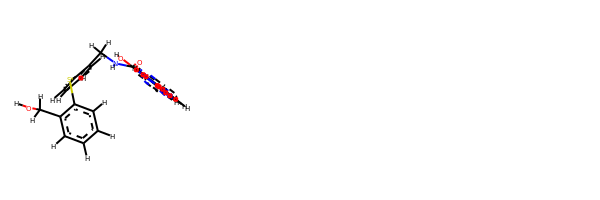

rdkit:  [H]Oc1nc(N([H])[H])nc2nn(-c3c([H])c([H])c([H])c(C(=O)N([H])C([H])([H])c4c([H])c([H])c([H])c([H])c4Sc4c([H])c([H])c([H])c([H])c4C([H])([H])O[H])c3[H])nc12
oechem:  c1ccc(c(c1)CNC(=O)c2cccc(c2)n3nc4c(n3)nc(nc4O)N)Sc5ccccc5CO
###########################################################################
 #########################################################

bond
51.02340044243003 kJ/mol 113351.59824599209 kJ/mol False
angle
358.611704827715 kJ/mol 359.2326747360237 kJ/mol False
nb
23.87904819459096 kJ/mol 23.87904819459096 kJ/mol True
torsion
108.58316060435428 kJ/mol 51.54266183658892 kJ/mol False
542.0973140690903 kJ/mol 113786.25263075929 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2897


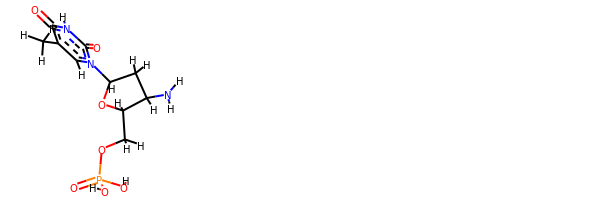

rdkit:  [H]OP(=O)(O[H])OC([H])([H])C1([H])OC([H])(n2c([H])c(C([H])([H])[H])c(=O)n([H])c2=O)C([H])([H])C1([H])N([H])[H]
oechem:  Cc1cn(c(=O)[nH]c1=O)C2CC(C(O2)COP(=O)(O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

############

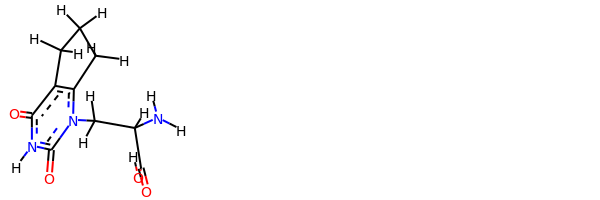

rdkit:  [H]OC(=O)C([H])(N([H])[H])C([H])([H])n1c2c(c(=O)n([H])c1=O)C([H])([H])C([H])([H])C2([H])[H]
oechem:  C1Cc2c(n(c(=O)[nH]c2=O)CC(C(=O)O)N)C1
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
14.552370735992646 kJ/mol 29153.239022917365 kJ/mol False
angle
121.11146762382626 kJ/mol 121.11146762382626 kJ/mol True
nb
-0.5098743450432078 kJ/mol -0.5098743450432078 kJ/mol True
torsion
21.733940083721237 kJ/mol 9.04592688615808 kJ/mol False
156.8879040984969 kJ/mol 29282.886543082306 kJ/mol

-----

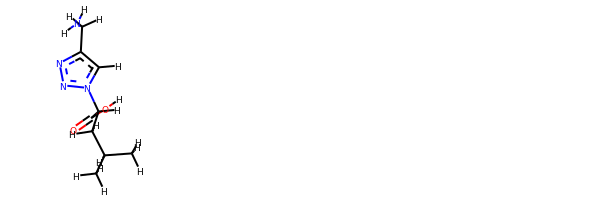

rdkit:  [H]OC(=O)C([H])(n1nnc(C([H])([H])N([H])[H])c1[H])C([H])([H])C([H])(C([H])([H])[H])C([H])([H])[H]
oechem:  CC(C)CC(C(=O)O)n1cc(nn1)CN
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
34.04563923586882 kJ/mol 113804.17220635699 kJ/mol False
angle
65.49902056269835 kJ/mol 65.96613741343569 kJ/mol False
nb
70.56483705771313 kJ/mol 70.56483705771313 kJ/mol True
torsion
75.8065075313341 kJ/mol 39.53340315498224 kJ/mol False
245.9160043876144 kJ/mol 113980.23658398312 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2911


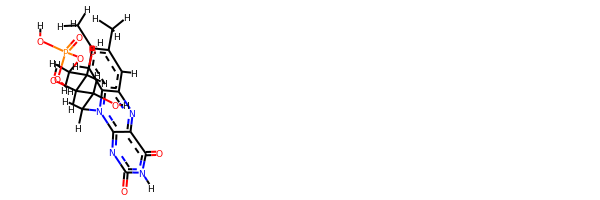

rdkit:  [H]OC([H])(C([H])([H])OP(=O)(O[H])O[H])C([H])(O[H])C([H])(O[H])C([H])([H])n1c2nc(=O)n([H])c(=O)c-2nc2c([H])c(C([H])([H])[H])c(C([H])([H])[H])c([H])c21
oechem:  Cc1cc2c(cc1C)n(c-3nc(=O)[nH]c(=O)c3n2)CC(C(C(COP(=O)(O)O)O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
55.628869393103194 kJ/mol 113407.44880905785 kJ/mol False
angle
338.45009073821444 kJ/mol 339.07026128620475 kJ/mol False
nb
21.69151679056567 kJ/mol 21.69151679056567 kJ/mol True
torsion
125.91845457810838 kJ/mol 66.93285389655239 kJ/mol False
541.6889314999917 kJ/mol 113835.14344103118 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-----------------------------------------------------------

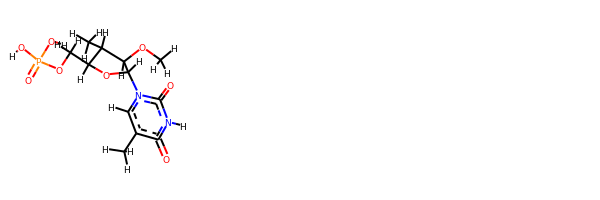

rdkit:  [H]OP(=O)(O[H])OC([H])([H])C1([H])OC([H])(n2c([H])c(C([H])([H])[H])c(=O)n([H])c2=O)C([H])(OC([H])([H])[H])C1([H])C([H])([H])[H]
oechem:  Cc1cn(c(=O)[nH]c1=O)C2C(C(C(O2)COP(=O)(O)O)C)OC
###########################################################################
 #########################################################

bond
16.14499026341697 kJ/mol 43621.5746400987 kJ/mol False
angle
46.78484857157048 kJ/mol 49.91705942650563 kJ/mol False
nb
17.682514631792433 kJ/mol 17.682514631792433 kJ/mol True
torsion
57.673754298124216 kJ/mol 55.49809818411254 kJ/mol False
138.2861077649041 kJ/mol 43744.672312341114 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2914


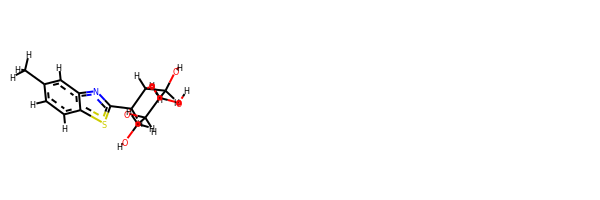

rdkit:  [H]OC([H])([H])C1([H])OC([H])(c2nc3c([H])c(C([H])([H])[H])c([H])c([H])c3s2)C([H])(O[H])C([H])(O[H])C1([H])O[H]
oechem:  Cc1ccc2c(c1)nc(s2)C3C(C(C(C(O3)CO)O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
43.40537927305065 kJ/mol 56569.2421413209 kJ/mol False
angle
407.00407995614216 kJ/mol 407.00407995614216 kJ/mol True
nb
1.2416413987639205 kJ/mol 

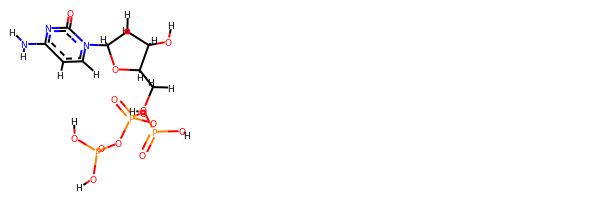

rdkit:  [H]OC1([H])C([H])([H])C([H])(n2c([H])c([H])c(N([H])[H])nc2=O)OC1([H])C([H])([H])OP(=O)(O[H])OP(=O)(O[H])OP(=O)(O[H])O[H]
oechem:  c1cn(c(=O)nc1N)C2CC(C(O2)COP(=O)(O)OP(=O)(O)OP(=O)(O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
37.6007766633454 kJ/mol 44146.97187677215 kJ/mol False
angle
109.47417476562696 kJ/mol 112.04111372741234 kJ/mol False
nb
14.061186221531344 kJ/mol 14.061186221531344 kJ/mol True
torsion
226.94686410168273 kJ/mol 226.9590736933218 kJ/mol False
388.0830017521864 kJ/mol 44500.03325041442 kJ/mol

-------------------------------------------------------------------
-----------------------------

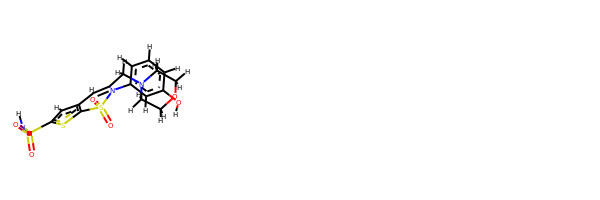

rdkit:  [H]Oc1c([H])c([H])c([H])c(N2C(C([H])([H])N3C([H])([H])C([H])([H])OC([H])([H])C3([H])[H])=C([H])c3c(sc(S(=O)(=O)N([H])[H])c3[H])S2(=O)=O)c1[H]
oechem:  c1cc(cc(c1)O)N2C(=Cc3cc(sc3S2(=O)=O)S(=O)(=O)N)CN4CCOCC4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
71.56219176962243 kJ/mol 169653.56527953292 kJ/mol False
angle
127.78550590187514 kJ/mol 129.95574475187766 kJ/mol False
nb
58.910099510323874 kJ/mol 58.910099510323874 kJ/mol True
torsion
24.411083537828297 kJ/mol 1.7943065775115647 kJ/mol False
282.66888071964974 kJ/mol 169844.22543037264 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
Dru

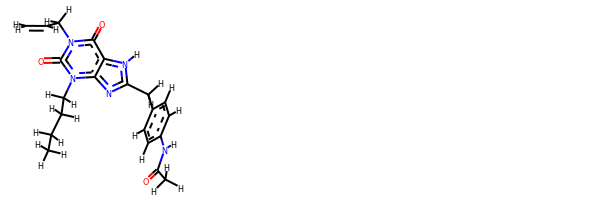

rdkit:  [H]C([H])=C([H])C([H])([H])n1c(=O)c2c(nc(C([H])([H])c3c([H])c([H])c(N([H])C(=O)C([H])([H])[H])c([H])c3[H])n2[H])n(C([H])([H])C([H])([H])C([H])([H])C([H])([H])[H])c1=O
oechem:  CCCCn1c2c(c(=O)n(c1=O)CC=C)[nH]c(n2)Cc3ccc(cc3)NC(=O)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
13.716512569627541 kJ/mol 29082.829161768543 kJ/mol False
angle
104.81615785872002 kJ/mol 104.81615785872002 kJ/mol True
nb
23.62825798557478 kJ/mol 23.62825798557478 kJ/mol True
torsion
33.67561274903112 kJ/mol 37.849228830575875 kJ/mol False
175.83654116295347 kJ/mol 29249.122806443414 kJ/mol

---------------------------------------------------

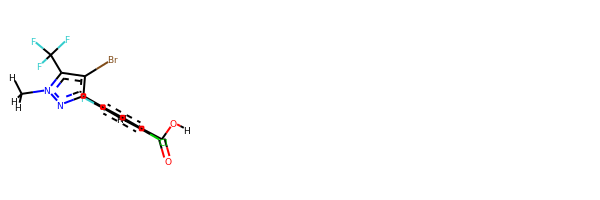

rdkit:  [H]OC(=O)c1c([H])c(-c2nn(C([H])([H])[H])c(C(F)(F)F)c2Br)c(F)c([H])c1Cl
oechem:  Cn1c(c(c(n1)c2cc(c(cc2F)Cl)C(=O)O)Br)C(F)(F)F
###########################################################################
 #########################################################

bond
23.209886654323707 kJ/mol 58006.25070504681 kJ/mol False
angle
333.87969935585613 kJ/mol 333.87969935585613 kJ/mol True
nb
9.295715219291143 kJ/mol 9.295715219291143 kJ/mol True
torsion
67.18668078434197 kJ/mol 43.071664789940506 kJ/mol False
433.57198201381294 kJ/mol 58392.4977844119 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2933


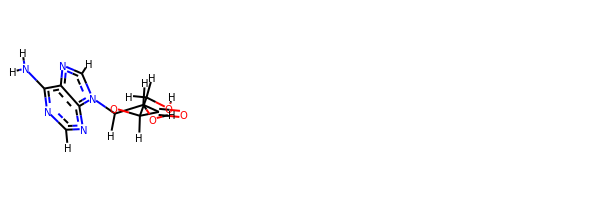

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)C([H])(O[H])C1=O
oechem:  c1nc(c2c(n1)n(cn2)C3C(C(=O)C(O3)CO)O)N
###########################################################################
 #########################################################

bond
43.99887366537524 kJ/mol 113374.74194081602 kJ/mol False
angle
311.9173356968044 kJ/mol 312.5055200150779 kJ/mol False
nb
21.052331400570232 kJ/mol 21.052331400570232 kJ/mol True
torsion
110.639842460997 kJ/mol 53.572828613785774 kJ/mol False
487.60838322374684 kJ/mol 113761.87262084546 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2934


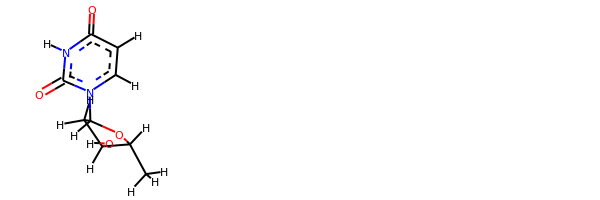

rdkit:  [H]OC1([H])C([H])([H])C([H])(n2c([H])c([H])c(=O)n([H])c2=O)OC1([H])C([H])([H])[H]
oechem:  CC1C(CC(O1)n2ccc(=O)[nH]c2=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

######################################################

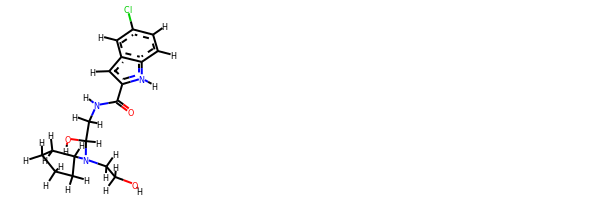

rdkit:  [H]OC([H])([H])C([H])([H])N(C([H])(O[H])C([H])([H])N([H])C(=O)c1c([H])c2c([H])c(Cl)c([H])c([H])c2n1[H])C1([H])C([H])([H])C([H])([H])C([H])([H])C1([H])[H]
oechem:  c1cc2c(cc1Cl)cc([nH]2)C(=O)NCC(N(CCO)C3CCCC3)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
68.43858513326806 kJ/mol 226962.67823727726 kJ/mol False
angle
98.82491824834183 kJ/mol 101.2670558462194 kJ/mol False
nb
9.482421457980776 kJ/mol 9.482421457980776 kJ/mol True
torsion
50.208022203433565 kJ/mol 7.770729072663471e-05 kJ/mol False
226.95394704302421 kJ/mol 227073.42779228874 kJ/mol

-------------------------------------------------------------------
--

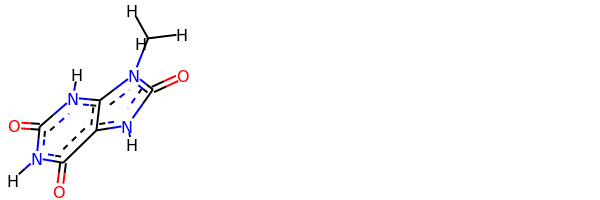

rdkit:  [H]n1c(=O)c2c(n([H])c1=O)n(C([H])([H])[H])c(=O)n2[H]
oechem:  Cn1c2c(c(=O)[nH]c(=O)[nH]2)[nH]c1=O
###########################################################################
 #########################################################

bond
6.237956989163387 kJ/mol 72155.8135597736 kJ/mol False
angle
60.76060848746214 kJ/mol 60.76060848746214 kJ/mol True
nb
11.123542463179694 kJ/mol 11.123542463179694 kJ/mol True
torsion
68.81371851208651 kJ/mol 68.81710909437723 kJ/mol False
146.93582645189173 kJ/mol 72296.5148198186 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2952


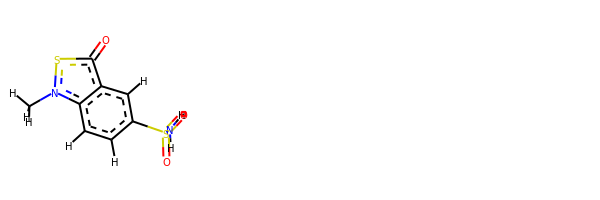

rdkit:  [H]c1c(S(=O)(=O)N([H])[H])c([H])c2c(=O)sn(C([H])([H])[H])c2c1[H]
oechem:  Cn1c2ccc(cc2c(=O)s1)S(=O)(=O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

#######################################################################

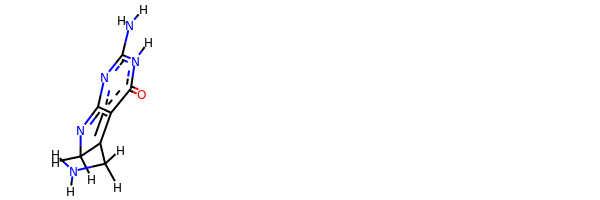

rdkit:  [H]N([H])c1nc2c(c(=O)n1[H])=C(C([H])([H])N([H])[H])C([H])([H])N=2
oechem:  C1C(=c2c(=O)[nH]c(nc2=N1)N)CN
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
38.73337329675673 kJ/mol 101995.2737655051 kJ/mol False
angle
159.

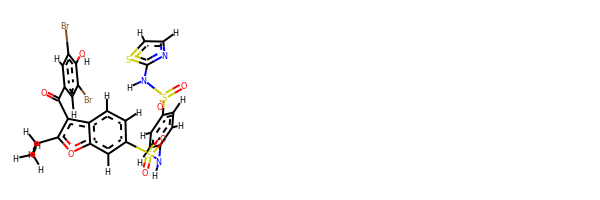

rdkit:  [H]Oc1c(Br)c([H])c(C(=O)c2c(C([H])([H])C([H])([H])[H])oc3c([H])c(S(=O)(=O)N([H])c4c([H])c([H])c(S(=O)(=O)N([H])c5nc([H])c([H])s5)c([H])c4[H])c([H])c([H])c23)c([H])c1Br
oechem:  CCc1c(c2ccc(cc2o1)S(=O)(=O)Nc3ccc(cc3)S(=O)(=O)Nc4nccs4)C(=O)c5cc(c(c(c5)Br)O)Br
###########################################################################
 #########################################################

bond
45.9888892315031 kJ/mol 113372.4105586925 kJ/mol False
angle
321.4970747960113 kJ/mol 322.11163336916655 kJ/mol False
nb
18.84284363677163 kJ/mol 18.84284363677163 kJ/mol True
torsion
128.64392986764457 kJ/mol 71.5749121441033 kJ/mol False
514.9727375319305 kJ/mol 113784.93994784253 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2970


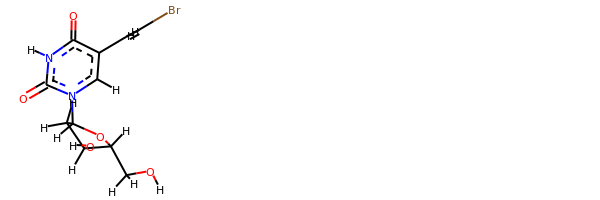

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])c(C([H])=C([H])Br)c(=O)n([H])c2=O)C([H])([H])C1([H])O[H]
oechem:  c1c(c(=O)[nH]c(=O)n1C2CC(C(O2)CO)O)C=CBr
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
9.641272383480944 kJ/mol 57764.50376720522 kJ/mol False
angle
106.1715453351061 kJ/mol 107.40006746857412 kJ/mol False
nb
6.183387134892223 kJ/mol 6.183387134892223 kJ/mol True
torsion
5.066620422538624 kJ/mol 5.066692431257498 kJ/mol False
127.06282527601789 kJ/mol 57883.15391423995 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2972


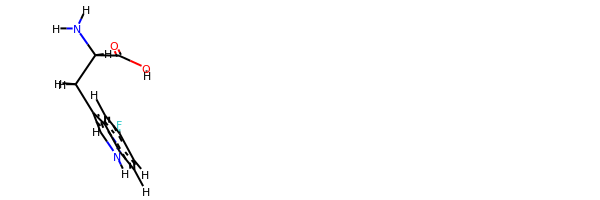

rdkit:  [H]OC(=O)C([H])(N([H])[H])C([H])([H])c1c([H])n([H])c2c([H])c([H])c(F)c([H])c12
oechem:  c1cc2c(cc1F)c(c[nH]2)CC(C(=O)O)N
###########################################################################
 #########################################################

bond
40.69238841032782 kJ/mol 114167.55618094523 kJ/mol False
angle
428.8525119879325 kJ/mol 429.20432573098117 kJ/mol False
nb
6.242769918308541 kJ/mol 6.242769918308541 kJ/mol True
torsion
137.10692068006298 kJ/mol 79.52251864389007 kJ/mol False
612.8945909966319 kJ/mol 114682.52579523841 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2973


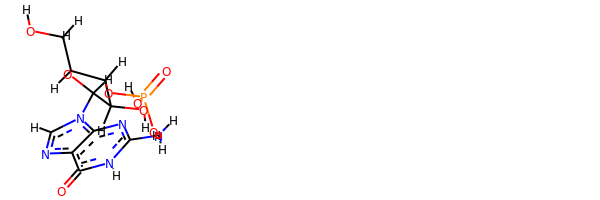

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])nc3c(=O)n([H])c(N([H])[H])nc32)C([H])(O[H])C1([H])OP(=O)(O[H])O[H]
oechem:  c1nc2c(=O)[nH]c(nc2n1C3C(C(C(O3)CO)OP(=O)(O)O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
32.22344228119193 kJ/mol 57974.513008882655 kJ/mol False
angle
457.66342242930216 kJ/mol 457.66342242930216 kJ/mol True
nb
6.029385748594302 kJ/mol 6.029385748594302 kJ/mol True
torsion
110.36506662344843 kJ/mol 86.23216776871354 kJ/mol False
606.2813170825368 kJ/mol 58524.43798482927 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2976


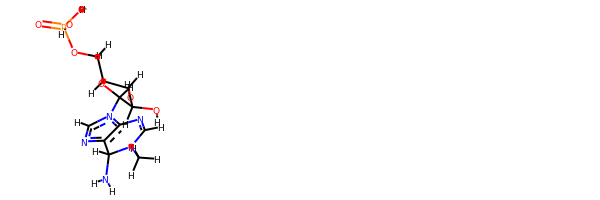

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c2N=C([H])N(C([H])([H])[H])C3([H])N([H])[H])OC([H])(C([H])([H])OP(=O)(O[H])O[H])C1([H])O[H]
oechem:  CN1C=Nc2c(ncn2C3C(C(C(O3)COP(=O)(O)O)O)O)C1N
###########################################################################
 #########################################################

bond
18.086154930511942 kJ/mol 57732.855019805516 kJ/mol False
angle
101.72437194581619 kJ/mol 101.72437194581619 kJ/mol True
nb
8.851288789059497 kJ/mol 8.851288789059497 kJ/mol True
torsion
9.820925063997143 kJ/mol 9.820622455461423 kJ/mol False
138.48274072938477 kJ/mol 57853.25130299585 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2977


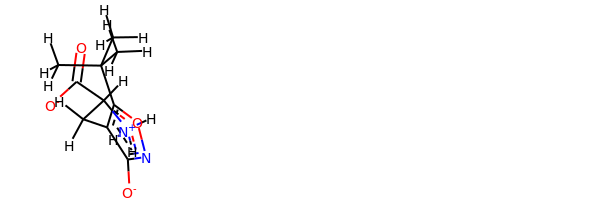

rdkit:  [H]C([H])([H])C(c1onc([O-])c1C([H])([H])C([H])(C(=O)[O-])[N+]([H])([H])[H])(C([H])([H])[H])C([H])([H])[H]
oechem:  CC(C)(C)c1c(c(no1)[O-])CC(C(=O)[O-])[NH3+]
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
47.88001735469775 kJ/mol 58029.64733807318 kJ/mol False
angle
441.3114560886006 kJ/mol 441.3114560886006 kJ/mol True
nb
9.33181860036819 kJ/mol 9.33181860036819 kJ/mol True
torsion
133.44468999248093 kJ/mol 109.86015303632921 kJ/mol False
631.9679820361474 kJ/mol 58590.15076579848 kJ/

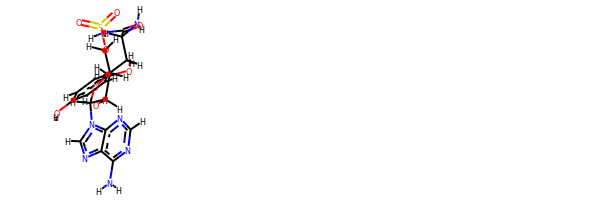

rdkit:  [H]Oc1c([H])c([H])c(C([H])([H])C([H])(C(=O)N([H])S(=O)(=O)OC([H])([H])C2([H])OC([H])(n3c([H])nc4c(N([H])[H])nc([H])nc43)C([H])(O[H])C2([H])O[H])N([H])[H])c([H])c1[H]
oechem:  c1cc(ccc1CC(C(=O)NS(=O)(=O)OCC2C(C(C(O2)n3cnc4c3ncnc4N)O)O)N)O
###########################################################################
 #########################################################

bond
75.66179585964325 kJ/mol 170729.74372920877 kJ/mol False
angle
731.5459053952757 kJ/mol 731.8974793412126 kJ/mol False
nb
41.47317357947115 kJ/mol 41.47317357947115 kJ/mol True
torsion
224.88300314993103 kJ/mol 122.57009002036861 kJ/mol False
1073.5638779843212 kJ/mol 171625.68447214982 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2983


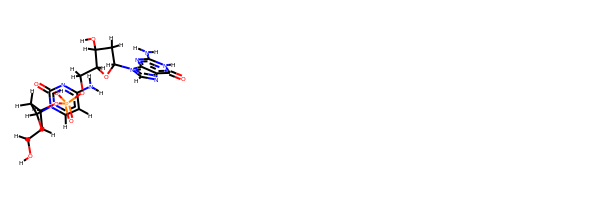

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])c([H])c(N([H])[H])nc2=O)C([H])([H])C1([H])OP(=O)(O[H])OC([H])([H])C1([H])OC([H])(n2c([H])nc3c(=O)n([H])c(N([H])[H])nc32)C([H])([H])C1([H])O[H]
oechem:  c1cn(c(=O)nc1N)C2CC(C(O2)CO)OP(=O)(O)OCC3C(CC(O3)n4cnc5c4nc([nH]c5=O)N)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
49.37582641112692 kJ/mol 58030.54161284913 kJ/mol False
angle
399.8406312846433 kJ/mol 399.8406312846433 kJ/mol True
nb
95.39774551671786 kJ/mol 95.39774551671786 kJ/mol True
torsi

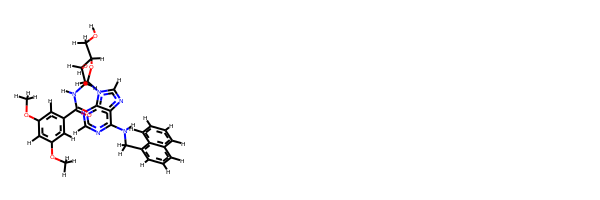

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])nc3c(N([H])C([H])([H])c4c([H])c([H])c([H])c5c([H])c([H])c([H])c([H])c45)nc([H])nc32)C([H])(N([H])C(=O)c2c([H])c(OC([H])([H])[H])c([H])c(OC([H])([H])[H])c2[H])C1([H])O[H]
oechem:  COc1cc(cc(c1)OC)C(=O)NC2C(C(OC2n3cnc4c3ncnc4NCc5cccc6c5cccc6)CO)O
###########################################################################
 #########################################################

bond
26.536921002987274 kJ/mol 57527.02791536165 kJ/mol False
angle
205.91291102860572 kJ/mol 206.1026962860106 kJ/mol False
nb
43.11534843458294 kJ/mol 43.11534843458294 kJ/mol True
torsion
76.19764039765774 kJ/mol 44.17141632176011 kJ/mol False
351.76282086383367 kJ/mol 57820.41737640401 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2989


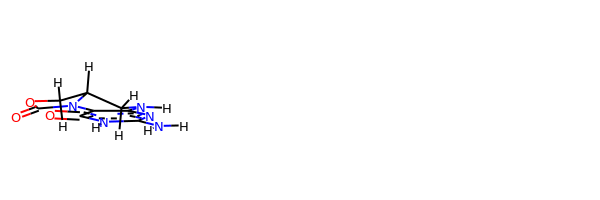

rdkit:  [H]N([H])c1nc2c(c(=O)n1[H])N1C(=O)OC([H])([H])C1([H])C([H])([H])N2[H]
oechem:  C1C2COC(=O)N2c3c(=O)[nH]c(nc3N1)N
###########################################################################
 #########################################################

bond
20.03610793064925 kJ/mol 43806.950976048945 kJ/mol False
angle
83.99601101036151 kJ/mol 86.1476830557867 kJ/mol False
nb
57.260924850303525 kJ/mol 57.260924850303525 kJ/mol True
torsion
93.82416741642254 kJ/mol 93.8242596247661 kJ/mol False
255.11721120773683 kJ/mol 44044.183843579805 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_2990


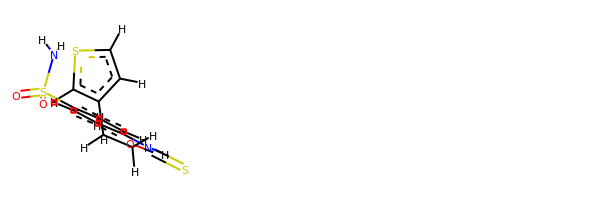

rdkit:  [H]c1sc([H])c(C([H])([H])C([H])([H])OC(=S)N([H])c2c([H])c([H])c(S(=O)(=O)N([H])[H])c([H])c2[H])c1[H]
oechem:  c1cc(ccc1NC(=S)OCCc2ccsc2)S(=O)(=O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

#############################

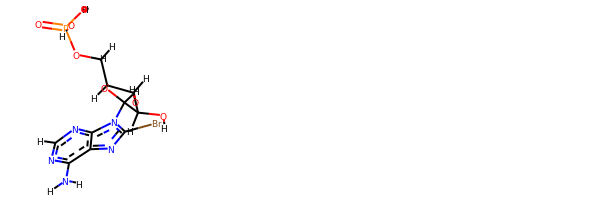

rdkit:  [H]OC1([H])C([H])(n2c(Br)nc3c(N([H])[H])nc([H])nc32)OC([H])(C([H])([H])OP(=O)(O[H])O[H])C1([H])O[H]
oechem:  c1nc(c2c(n1)n(c(n2)Br)C3C(C(C(O3)COP(=O)(O)O)O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
24.88756520793877 kJ/mol 58292.128062041746 kJ/mol False
angle
107.6478871610549 kJ/mol 107.6478871610549 kJ/mol True
nb
4.331650760344927 kJ/mol 4.331650760344927 kJ/mol True
torsion
55.45928463305774 kJ/mol 55.45915112677647 kJ/mol False
192.32638776239634 kJ/mol 58459.56675108992 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3010


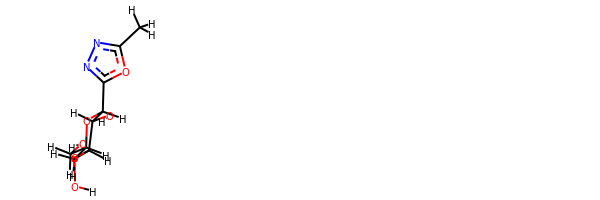

rdkit:  [H]OC([H])([H])C1([H])OC([H])(c2nnc(C([H])([H])[H])o2)C([H])(O[H])C([H])(O[H])C1([H])O[H]
oechem:  Cc1nnc(o1)C2C(C(C(C(O2)CO)O)O)O
###########################################################################
 #########################################################

bond
47.71283061936167 kJ/mol 58030.387441137325 kJ/mol False
angle
445.4842545392744 kJ/mol 445.4842545392744 kJ/mol True
nb
7.894174999543005 kJ/mol 7.894174999543005 kJ/mol True
torsion
142.72443464805204 kJ/mol 118.63358273781536 kJ/mol False
643.8156948062311 kJ/mol 58602.39945341396 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3011


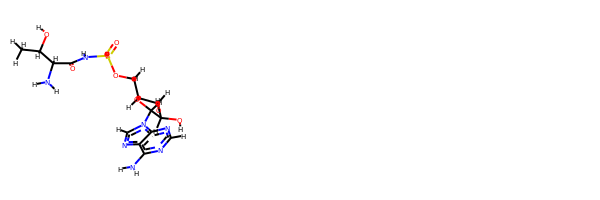

rdkit:  [H]OC([H])(C([H])([H])[H])C([H])(C(=O)N([H])S(=O)(=O)OC([H])([H])C1([H])OC([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)C([H])(O[H])C1([H])O[H])N([H])[H]
oechem:  CC(C(C(=O)NS(=O)(=O)OCC1C(C(C(O1)n2cnc3c2ncnc3N)O)O)N)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #####################

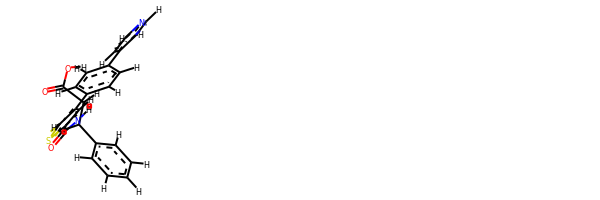

rdkit:  [H]OC(=O)C([H])([H])C([H])(c1c([H])c([H])c([H])c([H])c1[H])N([H])C(=O)c1sc([H])c(-c2c([H])c([H])c(-c3c([H])c([H])nc([H])c3[H])c([H])c2[H])c1[H]
oechem:  c1ccc(cc1)C(CC(=O)O)NC(=O)c2cc(cs2)c3ccc(cc3)c4ccncc4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
18.40712154195183 kJ/mol 58038.03172481939 kJ/mol False
angle
100.6075094762397 kJ/mol 100.6075094762397 kJ/mol True
nb
17.367102729698214 kJ/mol 17.367102729698214 kJ/mol True
torsion
38.52082582694645 kJ/mol 28.22870490965074 kJ/mol False
174.90255957483618 kJ/mol 58184.235041934975 kJ/mol

-------------------------------------------------------------------
----------

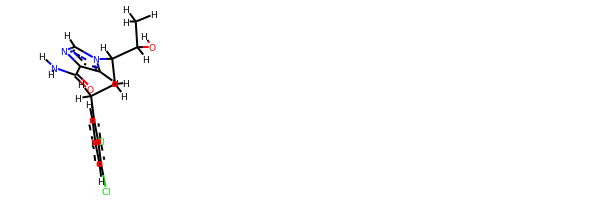

rdkit:  [H]OC([H])(C([H])([H])[H])C([H])(n1c([H])nc(C(=O)N([H])[H])c1[H])C([H])([H])C([H])([H])c1c([H])c([H])c([H])c(Cl)c1Cl
oechem:  CC(C(CCc1cccc(c1Cl)Cl)n2cc(nc2)C(=O)N)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
17.84144936543131 kJ/mol 57793.750711491164 kJ/mol False
angle
116.14991637940987 kJ/mol 117.50298033608566 kJ/mol False
nb
35.29223333879458 kJ/mol 35.29223333879458 kJ/mol True
torsion
26.00126882749329 kJ/mol 11.614336930857727 kJ/mol False
195.28486791112903 kJ/mol 57958.160262096906 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3026


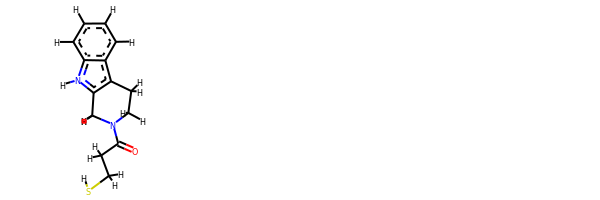

rdkit:  [H]SC([H])([H])C([H])([H])C(=O)N1C([H])([H])c2c(c3c([H])c([H])c([H])c([H])c3n2[H])C([H])([H])C1([H])[H]
oechem:  c1ccc2c(c1)c3c([nH]2)CN(CC3)C(=O)CCS
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
46.794273456397775 kJ/mol 58029.468883974376 kJ/mol False
angle
440.15783675249384 kJ/mol 440.15783675249384 kJ/mol True
nb
8.146088759226231 kJ/mol 8.146088759226231 kJ/mol True
torsion
131.34990253355755 kJ/mol 107.2590416635359 kJ/mol False
626.4481015016754 kJ/mol 58585.03185114963 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3028


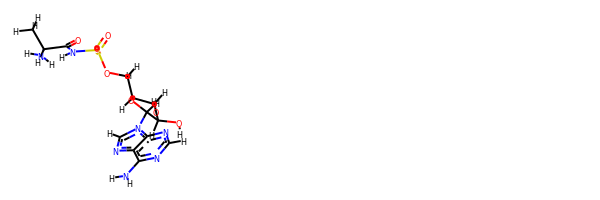

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)OC([H])(C([H])([H])OS(=O)(=O)N([H])C(=O)C([H])(N([H])[H])C([H])([H])[H])C1([H])O[H]
oechem:  CC(C(=O)NS(=O)(=O)OCC1C(C(C(O1)n2cnc3c2ncnc3N)O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
23.633515646780968 kJ/mol 57776.56335445753 kJ/mol False
angle
96.70103800722356 kJ/mol 97.93217201501503 kJ/mol False
nb
55.76304770620044 kJ/mol 55.76304770620044 kJ/mol True
torsion
54.00589288102555 kJ/mol 53.99808901090689 kJ/mol False
230.

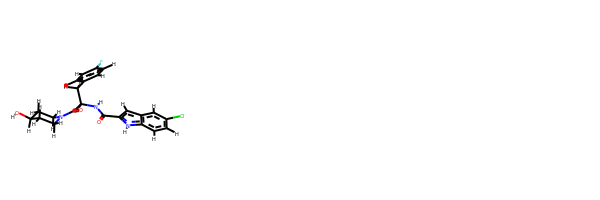

rdkit:  [H]OC1([H])C([H])([H])C([H])([H])N(C(=O)C([H])(N([H])C(=O)c2c([H])c3c([H])c(Cl)c([H])c([H])c3n2[H])C([H])([H])c2c([H])c([H])c(F)c([H])c2[H])C([H])([H])C1([H])[H]
oechem:  c1cc(ccc1CC(C(=O)N2CCC(CC2)O)NC(=O)c3cc4cc(ccc4[nH]3)Cl)F
###########################################################################
 #########################################################

bond
19.01928020403995 kJ/mol 57770.92462687085 kJ/mol False
angle
79.16120412254676 kJ/mol 80.39289003581132 kJ/mol False
nb
11.874849470520564 kJ/mol 11.874849470520564 kJ/mol True
torsion
5.157817839135293 kJ/mol 5.1500683323524905 kJ/mol False
115.21315163624256 kJ/mol 57868.342434709535 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3034


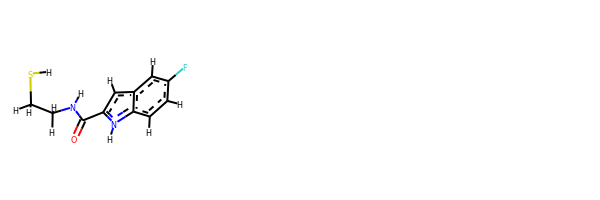

rdkit:  [H]SC([H])([H])C([H])([H])N([H])C(=O)c1c([H])c2c([H])c(F)c([H])c([H])c2n1[H]
oechem:  c1cc2c(cc1F)cc([nH]2)C(=O)NCCS
###########################################################################
 #########################################################

bond
9.664579453925075 kJ/mol 57761.75658107674 kJ/mol False
angle
106.25661229403643 kJ/mol 107.48664728864719 kJ/mol False
nb
6.757393147112153 kJ/mol 6.757393147112153 kJ/mol True
torsion
5.064207920186008 kJ/mol 5.064245186265741 kJ/mol False
127.74279281525966 kJ/mol 57881.06486669877 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3035


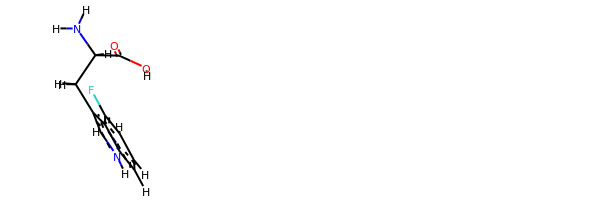

rdkit:  [H]OC(=O)C([H])(N([H])[H])C([H])([H])c1c([H])n([H])c2c([H])c([H])c([H])c(F)c12
oechem:  c1cc2c(c(c1)F)c(c[nH]2)CC(C(=O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
33.36882165170387 kJ/mol 43821.844803277294 kJ/mol False
angle
49.78504723587109 kJ/mol 51.93821045998777 kJ/mol False
nb
28.307229044148578 kJ/mol 28.307229044148578 kJ/mol True
torsion
54.63631356246166 kJ/mol 52.125926817335035 kJ/mol False
166.0974114941852 kJ/mol 43954.21616959877 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3037


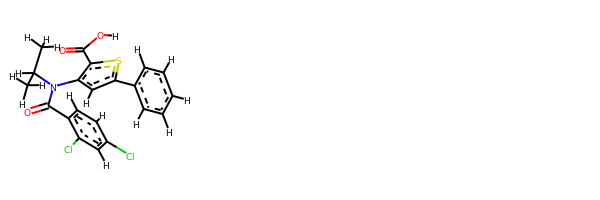

rdkit:  [H]OC(=O)c1sc(-c2c([H])c([H])c([H])c([H])c2[H])c([H])c1N(C(=O)c1c([H])c([H])c(Cl)c([H])c1Cl)C([H])(C([H])([H])[H])C([H])([H])[H]
oechem:  CC(C)N(c1cc(sc1C(=O)O)c2ccccc2)C(=O)c3ccc(cc3Cl)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
35.69790652869009 kJ/mol 58059.31886237157 kJ/mol False
angle
168.21423833083557 kJ/mol 170.22445811525424 kJ/mol Fals

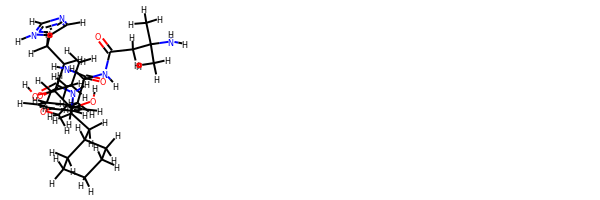

rdkit:  [H]OC([H])(C([H])([H])C([H])(C([H])([H])[H])C([H])([H])[H])C([H])(O[H])C([H])(N([H])C(=O)C([H])(N([H])C(=O)C([H])(N([H])C(=O)C([H])([H])C(N([H])[H])(C([H])([H])[H])C([H])([H])[H])C([H])([H])c1c([H])c([H])c(OC([H])([H])[H])c([H])c1[H])C([H])([H])c1c([H])nc([H])n1[H])C([H])([H])C1([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C1([H])[H]
oechem:  CC(C)CC(C(C(CC1CCCCC1)NC(=O)C(Cc2cnc[nH]2)NC(=O)C(Cc3ccc(cc3)OC)NC(=O)CC(C)(C)N)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

################

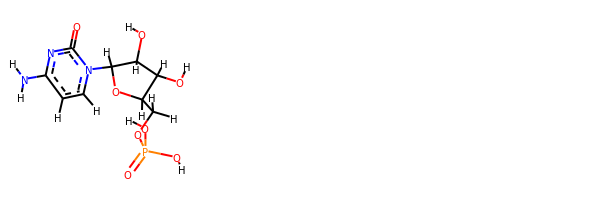

rdkit:  [H]OC1([H])C([H])(n2c([H])c([H])c(N([H])[H])nc2=O)OC([H])(C([H])([H])OP(=O)(O[H])O[H])C1([H])O[H]
oechem:  c1cn(c(=O)nc1N)C2C(C(C(O2)COP(=O)(O)O)O)O
###########################################################################
 #########################################################

bond
158.4273736627279 kJ/mol 148.91327342140596 kJ/mol False
angle
1262.4720683284816 kJ/mol 1262.4720683284816 kJ/mol True
nb
38.10963234206836 kJ/mol 38.10963234206836 kJ/mol True
torsion
24.336185577435014 kJ/mol 24.33657392111075 kJ/mol False
1483.345259910713 kJ/mol 1473.8315480130668 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3051


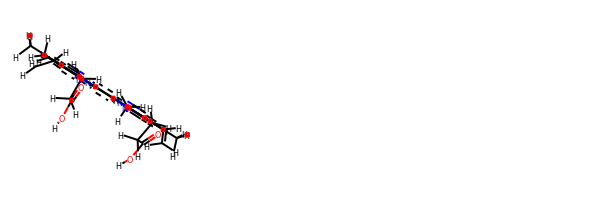

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])C1=C(C([H])([H])[H])c2nc1c([H])c1[n-]c(c([H])c3nc(c([H])c4[n-]c(c2[H])c(C([H])([H])[H])c4C([H])=C([H])[H])C(C([H])([H])[H])=C3C([H])=C([H])[H])c(C([H])([H])[H])c1C([H])([H])C([H])([H])C(=O)O[H]
oechem:  Cc1c2cc3nc(cc4c(c(c([n-]4)cc5nc(cc(c1CCC(=O)O)[n-]2)C(=C5C)CCC(=O)O)C)C=C)C(=C3C=C)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ####################################################

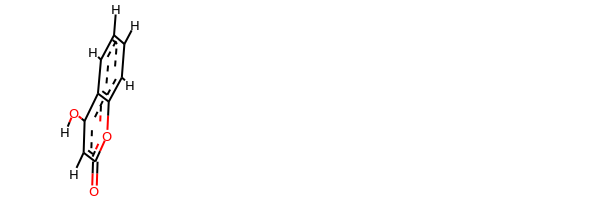

rdkit:  [H]Oc1c([H])c(=O)oc2c([H])c([H])c([H])c([H])c12
oechem:  c1ccc2c(c1)c(cc(=O)o2)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
52.19041128233305 kJ/mol 113384.95184230422 kJ/mol False
angle
375.32866140949477 kJ/mol 375.9171019314685 kJ/mol False
nb
8.593115266910031 kJ/mol 8.593115266910031 kJ/mol True
torsion
121.28847457523392 kJ/mol 64.222889431743 kJ/mol False
557.4006625339717 kJ/mol 113833.68494893433 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
D

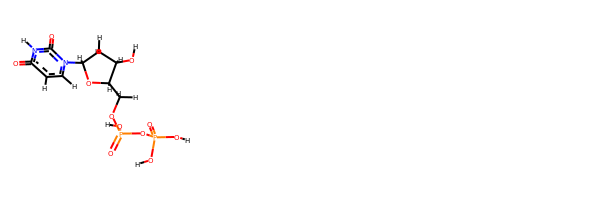

rdkit:  [H]OC1([H])C([H])([H])C([H])(n2c([H])c([H])c(=O)n([H])c2=O)OC1([H])C([H])([H])OP(=O)(O[H])OP(=O)(O[H])O[H]
oechem:  c1cn(c(=O)[nH]c1=O)C2CC(C(O2)COP(=O)(O)OP(=O)(O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
26.786665401693437 kJ/mol 43706.47054457258 kJ/mol False
angle
86.59409154028039 kJ/mol 88.89479447272306 kJ/mol False
nb
29.92380271428757 kJ/mol 29.92380271428757 kJ/mol True
torsion
31.49587700587049 kJ/mol 7.065759312750486 kJ/mol False
174.8004366621319 kJ/mol 43832.354901072336 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3063


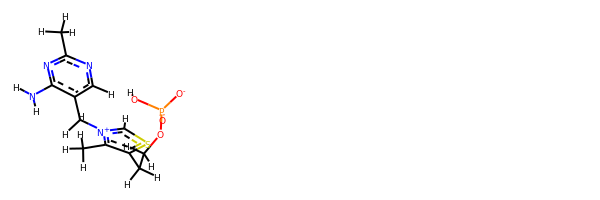

rdkit:  [H]OP(=O)([O-])OC([H])([H])C([H])([H])c1sc([H])[n+](C([H])([H])c2c([H])nc(C([H])([H])[H])nc2N([H])[H])c1C([H])([H])[H]
oechem:  Cc1c(sc[n+]1Cc2cnc(nc2N)C)CCOP(=O)(O)[O-]
###########################################################################
 #########################################################

bond
22.514582533736398 kJ/mol 114415.73446803662 kJ/mol False
angle
16.642939008533094 kJ/mol 17.263044270811864 kJ/mol False
nb
14.267781147196336 kJ/mol 14.267781147196336 kJ/mol True
torsion
50.208020434349244 kJ/mol 4.4984708321898255e-05 kJ/mol False
103.63332312381507 kJ/mol 114447.26533843935 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3066


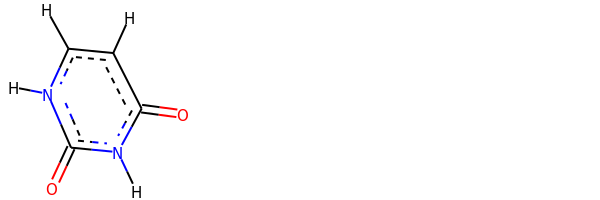

rdkit:  [H]c1c([H])n([H])c(=O)n([H])c1=O
oechem:  c1c[nH]c(=O)[nH]c1=O
###########################################################################
 #########################################################

bond
11.899496650984243 kJ/mol 57546.55085385061 kJ/mol False
angle
11.037177605024343 kJ/mol 11.360547049134537 kJ/mol False
nb
42.991387997632884 kJ/mol 42.991387997632884 kJ/mol True
torsion
19.591824508890397 kJ/mol 0.02735397228128445 kJ/mol False
85.51988676253187 kJ/mol 57600.930142869656 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3068


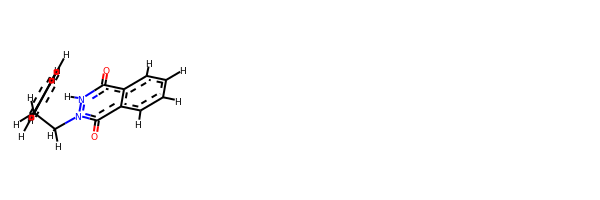

rdkit:  [H]c1c([H])c([H])c(C([H])([H])C([H])([H])n2c(=O)c3c([H])c([H])c([H])c([H])c3c(=O)n2[H])c([H])c1[H]
oechem:  c1ccc(cc1)CCn2c(=O)c3ccccc3c(=O)[nH]2
###########################################################################
 #########################################################

bond
6.168655746475974 kJ/mol 43677.35209234085 kJ/mol False
angle
42.82409398709886 kJ/mol 46.18046392536865 kJ/mol False
nb
5.366337477853815 kJ/mol 5.366337477853815 kJ/mol True
torsion
2.5106499260719914 kJ/mol 0.0003057448978409289 kJ/mol False
56.86973713750065 kJ/mol 43728.89919948897 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3069


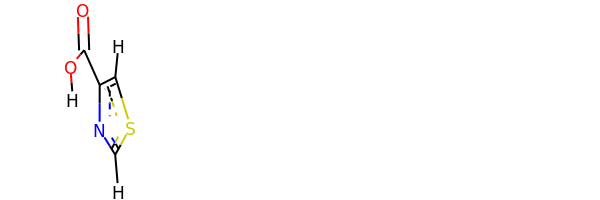

rdkit:  [H]OC(=O)c1nc([H])sc1[H]
oechem:  c1c(ncs1)C(=O)O
###########################################################################
 #########################################################

bond
34617.48414020346 kJ/mol 92600.15875072146 kJ/mol False
angle
492.5045693969209 kJ/mol 492.5045693969209 kJ/mol True
nb
719.3927789316284 kJ/mol 719.3927789316284 kJ/mol True
torsion
113.20499243164753 kJ/mol 89.11413156162588 kJ/mol False
35942.586480963655 kJ/mol 93901.17023061162 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3070


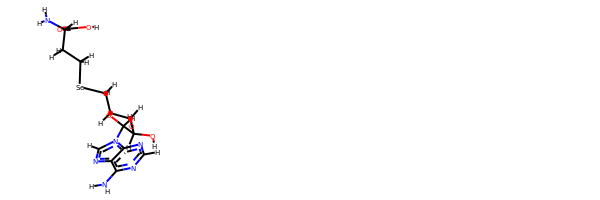

rdkit:  [H]OC(=O)C([H])(N([H])[H])C([H])([H])C([H])([H])[Se]C([H])([H])C1([H])OC([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)C([H])(O[H])C1([H])O[H]
oechem:  c1nc(c2c(n1)n(cn2)C3C(C(C(O3)C[Se]CCC(C(=O)O)N)O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
27.0230146472754 kJ/mol 58047.29845169592 kJ/mol False
angle
169.96147010072792 kJ/mol 171.97907698073658 kJ

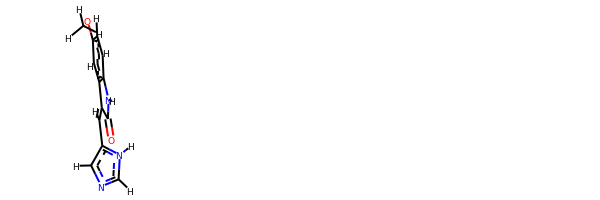

rdkit:  [H]C(=C1C(=O)N([H])c2c([H])c([H])c(OC([H])([H])[H])c([H])c21)c1c([H])nc([H])n1[H]
oechem:  COc1ccc2c(c1)C(=Cc3cnc[nH]3)C(=O)N2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
51.84872271773863 kJ/mol 113323.36222029041 kJ/mol False
angle
375.3263697130939 kJ/mol 375.914343740886 kJ/mol False
nb
5.982687967300435 kJ/mol 5.982687967300435 kJ/mol True
tors

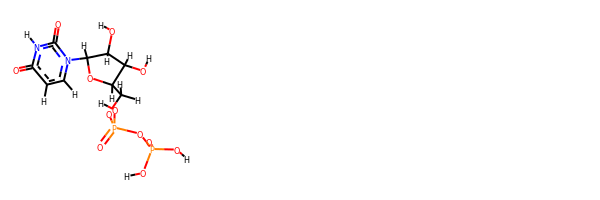

rdkit:  [H]OC1([H])C([H])(n2c([H])c([H])c(=O)n([H])c2=O)OC([H])(C([H])([H])OP(=O)(O[H])OP(=O)(O[H])O[H])C1([H])O[H]
oechem:  c1cn(c(=O)[nH]c1=O)C2C(C(C(O2)COP(=O)(O)OP(=O)(O)O)O)O
###########################################################################
 #########################################################

bond
26.279825529784066 kJ/mol 43695.14321092351 kJ/mol False
angle
309.53544974060844 kJ/mol 312.8935173657421 kJ/mol False
nb
56.50469742752964 kJ/mol 56.50469742752964 kJ/mol True
torsion
63.313089642746675 kJ/mol 46.48383486845748 kJ/mol False
455.63306234066886 kJ/mol 44111.025260585244 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3083


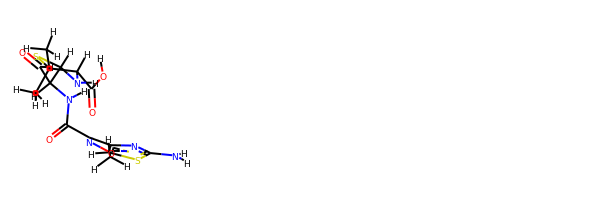

rdkit:  [H]OC(=O)C1([H])N([H])C([H])(C([H])(C([H])=O)N([H])C(=O)C(=NOC([H])([H])[H])c2nc(N([H])[H])sc2[H])SC1(C([H])([H])[H])C([H])([H])[H]
oechem:  CC1(C(NC(S1)C(C=O)NC(=O)C(=NOC)c2csc(n2)N)C(=O)O)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
29.501160572208654 kJ/mol 29098.80813621042 kJ/mol False
angle
145.84620209399108 kJ/mol 145.84620209399108 kJ/mol 

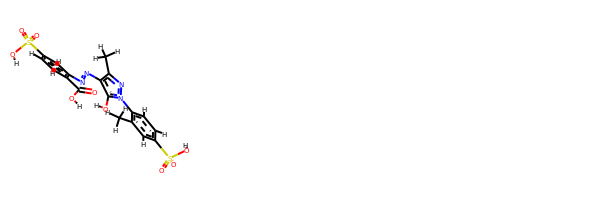

rdkit:  [H]OC(=O)c1c([H])c([H])c(S(=O)(=O)O[H])c([H])c1N=Nc1c(C([H])([H])[H])nn(-c2c([H])c([H])c(S(=O)(=O)O[H])c([H])c2C([H])([H])[H])c1O[H]
oechem:  Cc1cc(ccc1n2c(c(c(n2)C)N=Nc3cc(ccc3C(=O)O)S(=O)(=O)O)O)S(=O)(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
46.51358623402871 kJ/mol 29186.482816526852 kJ/mol False
angle
142.06600410468397 kJ/mol 142.06600410468397 kJ/mol True
nb
4.16159613161081 kJ/mol 4.16159613161081 kJ/mol True
torsion
16.801957666432106 kJ/mol 11.571959433609846 kJ/mol False
209.54314413675561 kJ/mol 29344.282376196756 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank

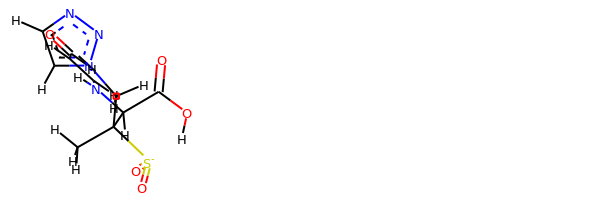

rdkit:  [H]OC(=O)C([H])(N([H])C([H])=C([H])C([H])=O)C([S-](=O)=O)(C([H])([H])[H])C([H])([H])n1nnc([H])c1[H]
oechem:  CC(Cn1ccnn1)(C(C(=O)O)NC=CC=O)[S-](=O)=O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
50.68758910918308 kJ/mol 113386.3360818054 kJ/mol False
angle
339.8010155367554 kJ/mol 340.3898336016347 kJ/mol False
nb
17.198639460620928 kJ/mol 17.198639460620928 kJ/mol True
torsion
131.82481694413664 kJ/mol 74.7519325546696 kJ/mol False
539.512061050696 kJ/mol 113818.67648742233 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3093


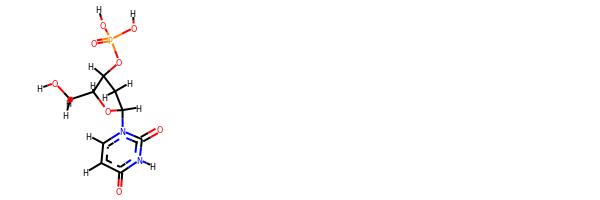

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])c([H])c(=O)n([H])c2=O)C([H])([H])C1([H])OP(=O)(O[H])O[H]
oechem:  c1cn(c(=O)[nH]c1=O)C2CC(C(O2)CO)OP(=O)(O)O
###########################################################################
 #########################################################

bond
25.873166946215797 kJ/mol 43811.298279198534 kJ/mol False
angle
96.64839324116318 kJ/mol 98.80136297966814 kJ/mol False
nb
20.61062988151231 kJ/mol 20.61062988151231 kJ/mol True
torsion
52.93620061039463 kJ/mol 46.67697802344366 kJ/mol False
196.06839067928593 kJ/mol 43977.387250083164 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3095


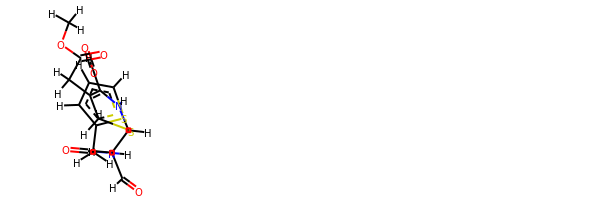

rdkit:  [H]OC(=O)C1=C(C([H])([H])C(=O)OC([H])([H])[H])C([H])([H])SC([H])(C([H])(C([H])=O)N([H])C(=O)C([H])([H])c2sc([H])c([H])c2[H])N1[H]
oechem:  COC(=O)CC1=C(NC(SC1)C(C=O)NC(=O)Cc2cccs2)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
13.943016708955186 kJ/mol 57764.14642890839 kJ/mol False
angle
99.27272672066637 kJ/mol 100.50296069024078 kJ/mol False
nb
5.95860940038104 kJ/mol 5.95860940038104 kJ/mol True
torsion
6.358027618157875 kJ/mol 4.728554833184098 kJ/mol False
125.532380448160

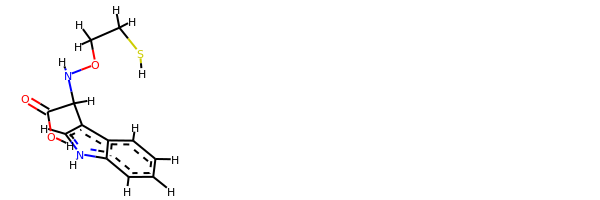

rdkit:  [H]OC(=O)C([H])(c1c([H])n([H])c2c([H])c([H])c([H])c([H])c12)N([H])OC([H])([H])C([H])([H])S[H]
oechem:  c1ccc2c(c1)c(c[nH]2)C(C(=O)O)NOCCS
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
27.324769212110677 kJ/mol 58007.488694037886 kJ/mol False
angle
431.59512978100827 kJ/mol 431.59512978100827 kJ/mol True
nb
30.60702716714377 kJ/mol 30.60702716714377 kJ/mol True
torsion
108.10577837273496 kJ/mol 84.00426383400011 kJ/mol False
597.6327045329976 kJ/mol 58553.69511482004 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3102


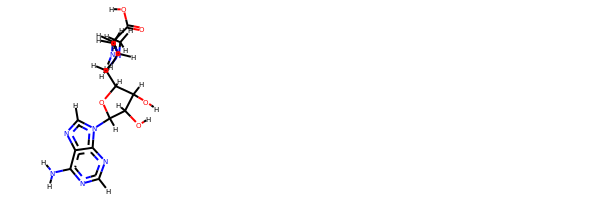

rdkit:  [H]OC(=O)C([H])(N([H])[H])C([H])([H])C([H])([H])N(C([H])([H])[H])C([H])([H])C1([H])OC([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)C([H])(O[H])C1([H])O[H]
oechem:  CN(CCC(C(=O)O)N)CC1C(C(C(O1)n2cnc3c2ncnc3N)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
23.201152371581625 kJ/mol 114488.6502169089 kJ/mol False
angle
18.50362503262985 kJ/mol 19.140335330654743 kJ/mol False
nb
17.885751295238858 kJ/mol 17.885751295238858 kJ/mol True
torsion
50.208039813944524 kJ/mol 8.96483950061885e-05 kJ/mol False
109.79856851339486 kJ/mol 114525.6763931832 kJ/mol

-------------------------------------------------------------------
-----

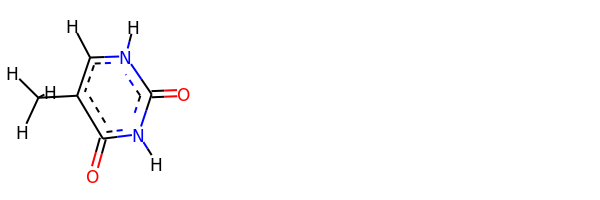

rdkit:  [H]c1c(C([H])([H])[H])c(=O)n([H])c(=O)n1[H]
oechem:  Cc1c[nH]c(=O)[nH]c1=O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ########################

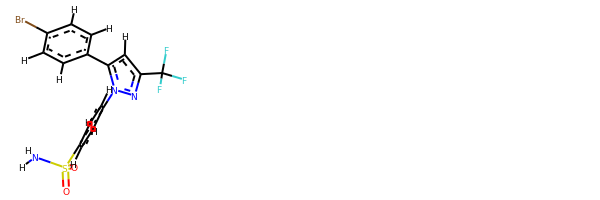

rdkit:  [H]c1c([H])c(-c2c([H])c(C(F)(F)F)nn2-c2c([H])c([H])c(S(=O)(=O)N([H])[H])c([H])c2[H])c([H])c([H])c1Br
oechem:  c1cc(ccc1c2cc(nn2c3ccc(cc3)S(=O)(=O)N)C(F)(F)F)Br
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
53.92495014

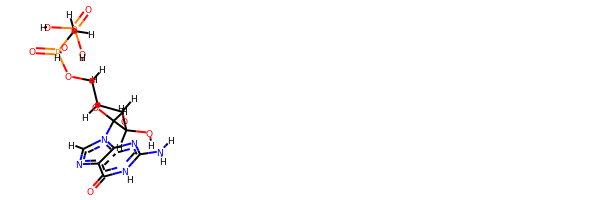

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c(=O)n([H])c(N([H])[H])nc32)OC([H])(C([H])([H])OP(=O)(O[H])C([H])([H])P(=O)(O[H])O[H])C1([H])O[H]
oechem:  c1nc2c(=O)[nH]c(nc2n1C3C(C(C(O3)COP(=O)(CP(=O)(O)O)O)O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
14.88546151607016 kJ/mol 28779.53316745746 kJ/mol False
angle
281.8372805123225 kJ/mol 283.4230176032859 kJ/mol False
nb
24.68370175069675 kJ/mol 24.68370175069675 kJ/mol True
torsion
10.459575651546071 kJ/mol 5.229577942979122 kJ/mol False
331.86601943063545 kJ/mol 29092.86946475442 kJ/mol

-------------------------------------------------------------------
-----------------------

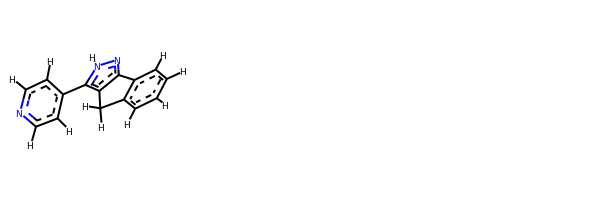

rdkit:  [H]c1nc([H])c([H])c(-c2c3c(nn2[H])-c2c([H])c([H])c([H])c([H])c2C3([H])[H])c1[H]
oechem:  c1ccc-2c(c1)Cc3c2n[nH]c3c4ccncc4
###########################################################################
 #########################################################

bond
43.11477234933857 kJ/mol 114169.06054145878 kJ/mol False
angle
465.05825619799725 kJ/mol 465.41019999642947 kJ/mol False
nb
-0.3456126665731971 kJ/mol -0.3456126665731971 kJ/mol True
torsion
120.49048890218344 kJ/mol 62.942328032672584 kJ/mol False
628.3179047829461 kJ/mol 114697.06745682131 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3134


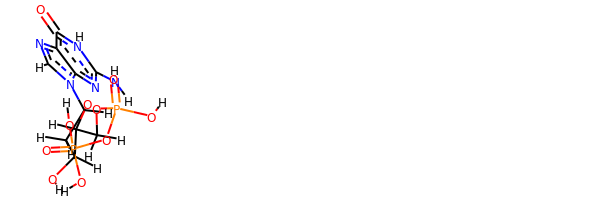

rdkit:  [H]OC1([H])C([H])([H])C([H])(n2c([H])nc3c(=O)n([H])c(N([H])[H])nc32)OC1([H])C([H])([H])OP(=O)(O[H])OP(=O)(O[H])O[H]
oechem:  c1nc2c(=O)[nH]c(nc2n1C3CC(C(O3)COP(=O)(O)OP(=O)(O)O)O)N
###########################################################################
 #########################################################

bond
40.7570885823105 kJ/mol 114625.68572561101 kJ/mol False
angle
415.7144551855533 kJ/mol 416.2588852273304 kJ/mol False
nb
7.650294380231896 kJ/mol 7.650294380231896 kJ/mol True
torsion
130.14243136054642 kJ/mol 66.22986975932982 kJ/mol False
594.2642695086421 kJ/mol 115115.82477497791 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3136


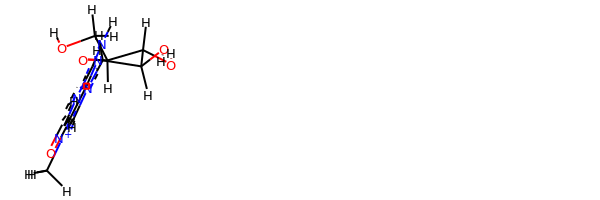

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])[n+](C([H])([H])[H])c3c(=O)n([H])c(N([H])[H])nc32)C([H])(O[H])C1([H])O[H]
oechem:  C[n+]1cn(c2c1c(=O)[nH]c(n2)N)C3C(C(C(O3)CO)O)O
###########################################################################
 #########################################################

bond
37.84205418793076 kJ/mol 57955.22656994507 kJ/mol False
angle
84.62345109694475 kJ/mol 86.52988150819236 kJ/mol False
nb
27.067201208403123 kJ/mol 27.067201208403123 kJ/mol True
torsion
57.03158301695966 kJ/mol 66.4338633079947 kJ/mol False
206.5642895102383 kJ/mol 58135.257515969664 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3137


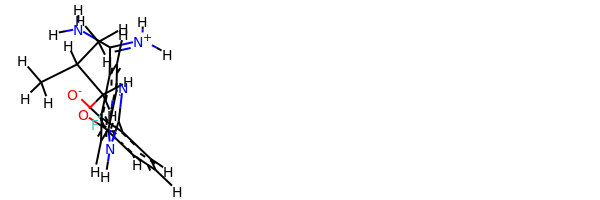

rdkit:  [H]c1c([H])c(OC([H])([H])C([H])(C([H])([H])[H])C([H])([H])[H])c([O-])c(-c2nc3c([H])c(C(N([H])[H])=[N+]([H])[H])c(F)c([H])c3n2[H])c1[H]
oechem:  CC(C)COc1cccc(c1[O-])c2[nH]c3cc(c(cc3n2)C(=[NH2+])N)F
###########################################################################
 #########################################################

bond
18.877529301912993 kJ/mol 57510.92428264112 kJ/mol False
angle
24.924402024341767 kJ/mol 24.924402024341767 kJ/mol True
nb
164.47805470345733 kJ/mol 164.47805470345733 kJ/mol True
torsion
29.158807274268057 kJ/mol 29.15522690400934 kJ/mol False
237.43879330398016 kJ/mol 57729.481966272935 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3139


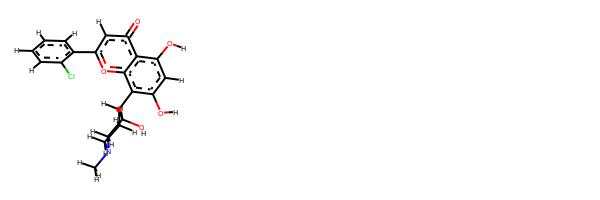

rdkit:  [H]Oc1c([H])c(O[H])c2c(=O)c([H])c(-c3c([H])c([H])c([H])c([H])c3Cl)oc2c1C1([H])C([H])([H])C([H])([H])N(C([H])([H])[H])C([H])([H])C1([H])O[H]
oechem:  CN1CCC(C(C1)O)c2c(cc(c3c2oc(cc3=O)c4ccccc4Cl)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
30.385048994871358 kJ/mol 58014.87360282139 kJ/mol False
angle
112.2085707574455 kJ/mol 112.2085707574455 kJ/

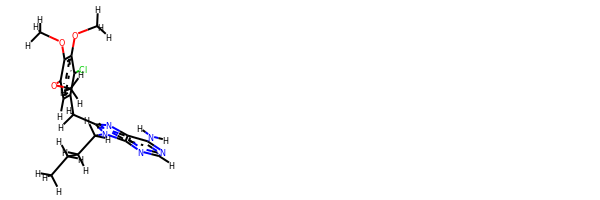

rdkit:  [H]c1nc(N([H])[H])c2nc(C([H])([H])c3c([H])c(OC([H])([H])[H])c(OC([H])([H])[H])c(OC([H])([H])[H])c3Cl)n(C([H])([H])C([H])([H])C([H])([H])C([H])([H])[H])c2n1
oechem:  CCCCn1c(nc2c1ncnc2N)Cc3cc(c(c(c3Cl)OC)OC)OC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
40.58493607722723 kJ/mol 101460.40312130634 kJ/mol False
angle
322.6191230045436 kJ/mol 325.6409699674853 kJ/mol False
nb
25.49546144069553 kJ/mol 25.49546144069553 kJ/mol True
torsion
41.426445277649485 kJ/mol 38.91612237265243 kJ/mol False
430.1259658001158 kJ/mol 101850.45567508717 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank

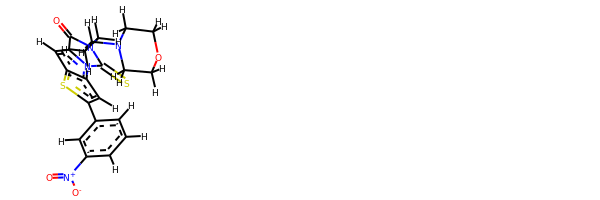

rdkit:  [H]c1c([H])c(-c2sc3c([H])c4n(c3c2[H])C(=S)N(C([H])([H])C([H])([H])C([H])([H])N2C([H])([H])C([H])([H])OC([H])([H])C2([H])[H])C4=O)c([H])c([N+](=O)[O-])c1[H]
oechem:  c1cc(cc(c1)[N+](=O)[O-])c2cc3c(s2)cc4n3C(=S)N(C4=O)CCCN5CCOCC5
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
32.26712784485342 kJ/mol 58012.90508337701 kJ/mol False
angle
452.9189605007365 kJ/mol 452.9189605007365 kJ/mol True
nb
13.582805296909408 kJ/mol 13.582805296909408 kJ/mol True
torsion
99.37956299462952 kJ/mol 75.2599249092588 kJ/mol False
598.1484566371289 kJ/mol 58554.66677408391 kJ/mol

------------------------------------------------------------

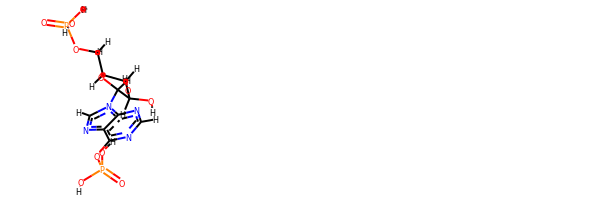

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c(OP(=O)(O[H])O[H])nc([H])nc32)OC([H])(C([H])([H])OP(=O)(O[H])O[H])C1([H])O[H]
oechem:  c1nc2c(c(n1)OP(=O)(O)O)ncn2C3C(C(C(O3)COP(=O)(O)O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
24.461718947786203 kJ/mol 114463.38961554725 kJ/mol False
angle
17.267936631244805 kJ/mol 17.90606216808881 kJ/mol False
nb
13.927481292603252 kJ/mol 13.927481292603252 kJ/mol True
torsion
50.20800889253671 kJ/mol 2.880238434698304e-05 kJ/mol False
105.86514576417096 kJ/m

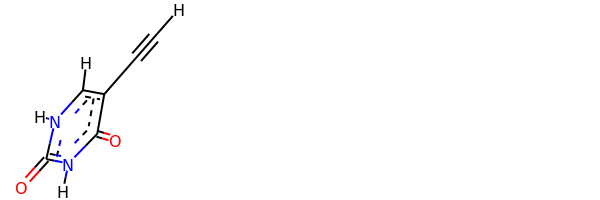

rdkit:  [H]C#Cc1c([H])n([H])c(=O)n([H])c1=O
oechem:  C#Cc1c[nH]c(=O)[nH]c1=O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
4.84146697287999 kJ/mol 57979.160911707615 kJ/mol False
angle
97.8270829071249 kJ/mol 99.85340638665895 kJ/mol False
nb
18.843797300319657 kJ/mol 18.843797300319657 kJ/mol True
torsion
4.44783638335311e-06 kJ/mol 3.794503938316131e-06 kJ/mol False
121.51235162816093 kJ/mol 58097.8581191891 kJ/mol

-------------------------------------------------------------------
-------

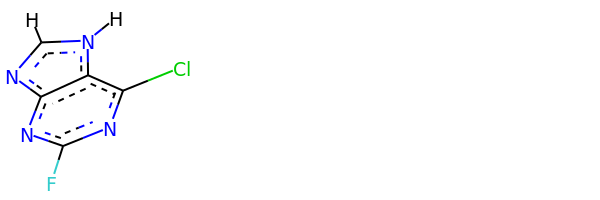

rdkit:  [H]c1nc2nc(F)nc(Cl)c2n1[H]
oechem:  c1[nH]c2c(n1)nc(nc2Cl)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
49.971853196009775 kJ/mol 43837.10184023569 kJ/mol False
angle
101.67130485367615 kJ/mol 103.82225747306758 kJ/mol False
nb
70.96834753957425 kJ/mol 70.96834753957425 kJ/mol True
torsion
129.20158860242532 kJ/mol 122.94268292617505 kJ/mol False
351.8130941916855 kJ/mol 44134.835128174505 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3165


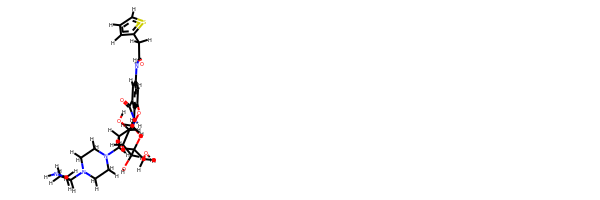

rdkit:  [H]OC([H])([H])C1([H])OC([H])(Oc2c([H])c(C(=O)N([H])C([H])([H])C([H])([H])C([H])([H])N3C([H])([H])C([H])([H])N(C([H])([H])C([H])([H])C([H])([H])N([H])[H])C([H])([H])C3([H])[H])c([H])c(N([H])C(=O)C([H])([H])c3sc([H])c([H])c3[H])c2[H])C([H])(O[H])C([H])(O[H])C1([H])O[H]
oechem:  c1cc(sc1)CC(=O)Nc2cc(cc(c2)OC3C(C(C(C(O3)CO)O)O)O)C(=O)NCCCN4CCN(CC4)CCCN
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
20.070133943858277 kJ/mol 43807.6657480869 kJ/mol False
angle
119.87585955312677 kJ/mol 122.02861795971374 kJ/mol False
nb
19.15008537807992 kJ/mol 19.15008537807992 kJ/mol True
torsion
149.78008537932615 kJ/mol 149.78009573868354 kJ/mol False
308.8761642543911 kJ/mol 44098.62454716339 kJ/mol

-------------------------------------------------------------------


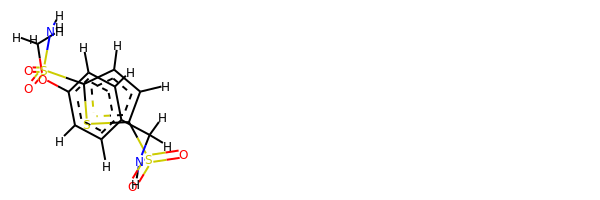

rdkit:  [H]c1c(S(=O)(=O)N([H])[H])sc(S(=O)(=O)N([H])C([H])([H])c2c([H])c([H])c(OC([H])([H])[H])c([H])c2[H])c1[H]
oechem:  COc1ccc(cc1)CNS(=O)(=O)c2ccc(s2)S(=O)(=O)N
###########################################################################
 #########################################################

bond
20.17571084043176 kJ/mol 58002.85032135839 kJ/mol False
angle
396.5785960216061 kJ/mol 396.5785960216061 kJ/mol True
nb
11.12035047439016 kJ/mol 11.12035047439016 kJ/mol True
torsion
90.72895663197885 kJ/mol 66.63809576195715 kJ/mol False
518.6036139684069 kJ/mol 58477.187363616344 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3168


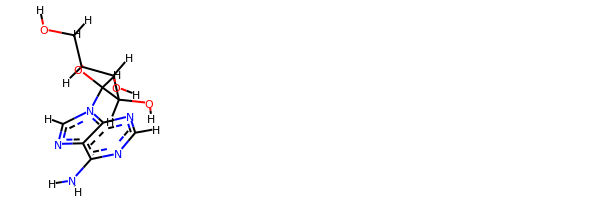

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)C([H])(O[H])C1([H])O[H]
oechem:  c1nc(c2c(n1)n(cn2)C3C(C(C(O3)CO)O)O)N
###########################################################################
 #########################################################

bond
36.155820202724605 kJ/mol 43706.81113010205 kJ/mol False
angle
104.69938512839191 kJ/mol 108.05655794727998 kJ/mol False
nb
78.7956175732932 kJ/mol 78.7956175732932 kJ/mol True
torsion
70.92832814692612 kJ/mol 54.099412785566216 kJ/mol False
290.5791510513358 kJ/mol 43947.76271840819 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3169


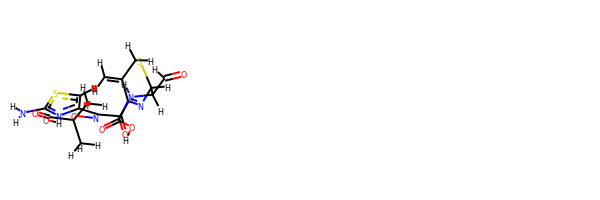

rdkit:  [H]OC(=O)C1=NC([H])(C([H])(C([H])=O)N([H])C(=O)C(=NOC(C(=O)O[H])(C([H])([H])[H])C([H])([H])[H])c2nc(N([H])[H])sc2[H])SC([H])([H])C1=C([H])[H]
oechem:  CC(C)(C(=O)O)ON=C(c1csc(n1)N)C(=O)NC(C=O)C2N=C(C(=C)CS2)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
33.158437544953955 kJ/mol 57786.63566753943 kJ/mol False
angle
96.35552074802543 kJ/mol 96.35552074802543 kJ/mol True
nb
45.1546440636574 kJ/mol 45.1546440636574 kJ/mol True
torsion
40.46653434128368 kJ/mol 25.40897072880984 kJ/mol False
215.13513669792047 kJ/mol 57953.55480307992 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBan

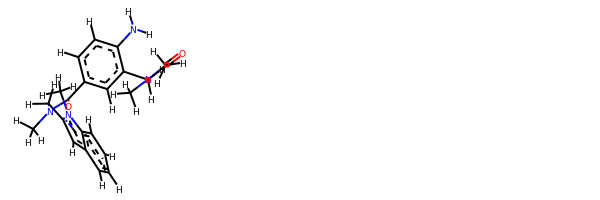

rdkit:  [H]c1c([H])c(N([H])[H])c(C([H])([H])N(C(=O)C([H])([H])[H])C([H])([H])[H])c([H])c1C(=O)N(C([H])([H])[H])C([H])([H])c1c([H])c2c([H])c([H])c([H])c([H])c2n1C([H])([H])[H]
oechem:  CC(=O)N(C)Cc1cc(ccc1N)C(=O)N(C)Cc2cc3ccccc3n2C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ############

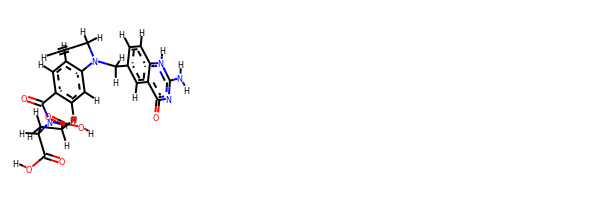

rdkit:  [H]C#CC([H])([H])N(c1c([H])c([H])c(C(=O)N([H])C([H])(C(=O)O[H])C([H])([H])C([H])([H])C(=O)O[H])c([H])c1[H])C([H])([H])c1c([H])c([H])c2c(c1[H])c(=O)nc(N([H])[H])n2[H]
oechem:  C#CCN(Cc1ccc2c(c1)c(=O)nc([nH]2)N)c3ccc(cc3)C(=O)NC(CCC(=O)O)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

#####################################################################

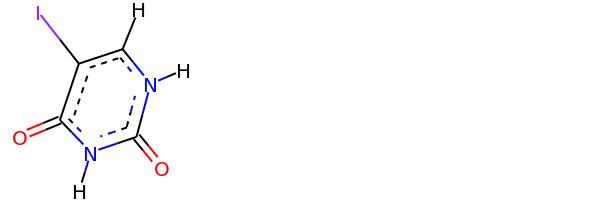

rdkit:  [H]c1c(I)c(=O)n([H])c(=O)n1[H]
oechem:  c1c(c(=O)[nH]c(=O)[nH]1)I
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #################################

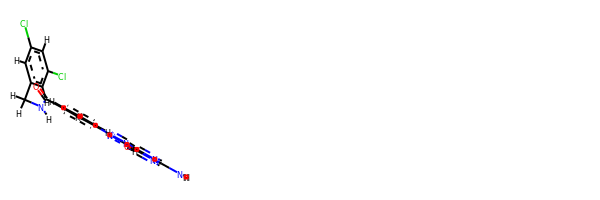

rdkit:  [H]Oc1nc(N([H])[H])nc2nn(-c3c([H])c([H])c([H])c(C(=O)N([H])C([H])([H])c4c([H])c(Cl)c([H])c(Cl)c4[H])c3[H])nc12
oechem:  c1cc(cc(c1)n2nc3c(n2)nc(nc3O)N)C(=O)NCc4cc(cc(c4)Cl)Cl
###########################################################################
 #########################################################

bond
19.152421384461295 kJ/mol 58042.35726792948 kJ/mol False
angle
100.10772925350788 kJ/mol 100.10772925350788 kJ/mol True
nb
26.928098127428928 kJ/mol 26.928098127428928 kJ/mol True
torsion
39.46587259084071 kJ/mol 22.375608286655822 kJ/mol False
185.65412135623882 kJ/mol 58191.76870359707 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3205


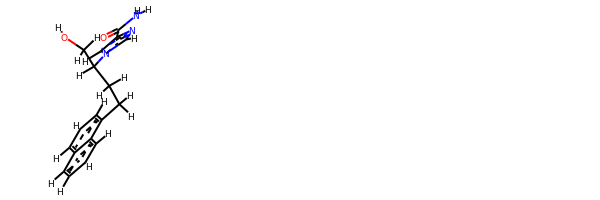

rdkit:  [H]OC([H])([H])C([H])(n1c([H])nc(C(=O)N([H])[H])c1[H])C([H])([H])C([H])([H])c1c([H])c([H])c([H])c2c([H])c([H])c([H])c([H])c12
oechem:  c1ccc2c(c1)cccc2CCC(CO)n3cc(nc3)C(=O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

##

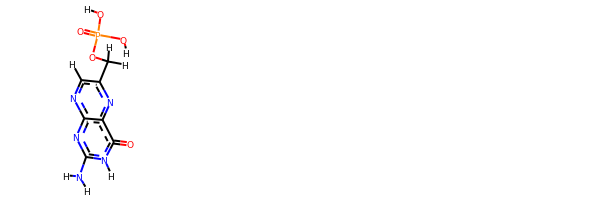

rdkit:  [H]OP(=O)(O[H])OC([H])([H])c1nc2c(=O)n([H])c(N([H])[H])nc2nc1[H]
oechem:  c1c(nc2c(=O)[nH]c(nc2n1)N)COP(=O)(O)O
###########################################################################
 #########################################################

bond
46.60765710427841 kJ/mol 114633.95227955254 kJ/mol False
angle
438.4534719116314 kJ/mol 438.99800073538097 kJ/mol False
nb
7.978567120340876 kJ/mol 7.978567120340876 kJ/mol True
torsion
137.9818373582693 kJ/mol 74.06845198820231 kJ/mol False
631.0215334945201 kJ/mol 115154.99729939648 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3225


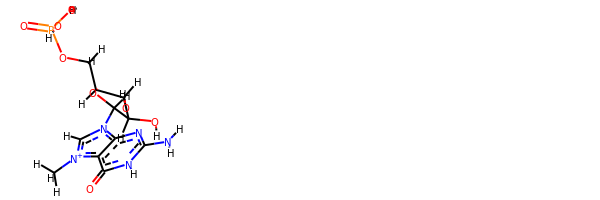

rdkit:  [H]OC1([H])C([H])(n2c([H])[n+](C([H])([H])[H])c3c(=O)n([H])c(N([H])[H])nc32)OC([H])(C([H])([H])OP(=O)(O[H])O[H])C1([H])O[H]
oechem:  C[n+]1cn(c2c1c(=O)[nH]c(n2)N)C3C(C(C(O3)COP(=O)(O)O)O)O
###########################################################################
 #########################################################

bond
40.599091393698416 kJ/mol 57955.71116304776 kJ/mol False
angle
82.88907417575906 kJ/mol 84.79634895145945 kJ/mol False
nb
42.62236723068746 kJ/mol 42.62236723068746 kJ/mol True
torsion
41.34774252682335 kJ/mol 50.76163698572404 kJ/mol False
207.4582753269683 kJ/mol 58133.891516215626 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3226


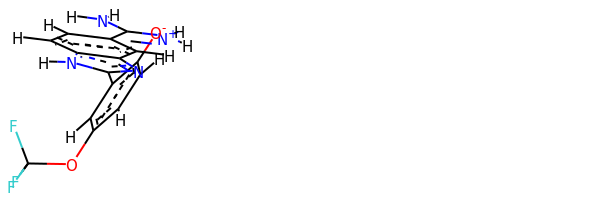

rdkit:  [H]c1c([H])c(OC(F)(F)F)c([H])c(-c2nc3c([H])c(C(N([H])[H])=[N+]([H])[H])c([H])c([H])c3n2[H])c1[O-]
oechem:  c1cc2c(cc1C(=[NH2+])N)nc([nH]2)c3cc(ccc3[O-])OC(F)(F)F
###########################################################################
 #########################################################

bond
17.332649462077377 kJ/mol 57769.046859943985 kJ/mol False
angle
114.78567826796271 kJ/mol 116.0149932491903 kJ/mol False
nb
29.773540557852154 kJ/mol 29.773540557852154 kJ/mol True
torsion
75.5708460400609 kJ/mol 75.57093925746503 kJ/mol False
237.46271432795314 kJ/mol 57990.40633300849 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3227


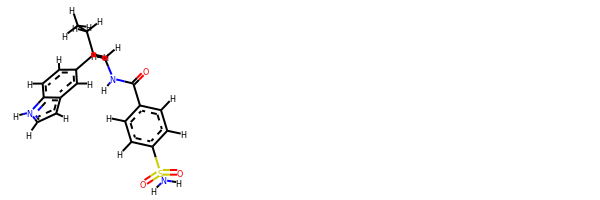

rdkit:  [H]c1c([H])c(S(=O)(=O)N([H])[H])c([H])c([H])c1C(=O)N([H])C([H])([H])C([H])(c1c([H])c([H])c2c(c1[H])c([H])c([H])n2[H])C([H])([H])C([H])([H])[H]
oechem:  CCC(CNC(=O)c1ccc(cc1)S(=O)(=O)N)c2ccc3c(c2)cc[nH]3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
44.41304401753364 kJ/mol 44153.78414412634 kJ/mol False
angle
110.09490187573573 kJ/mol 112.66184083752114 kJ/mol False
nb
36.49758939027364 kJ/mol 36.49758939027364 kJ/mol True
torsion
226.94857136334196 kJ/mol 226.96078095498103 kJ/mol False
417.95410664688495 kJ/mol 44529.90435530911 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_322

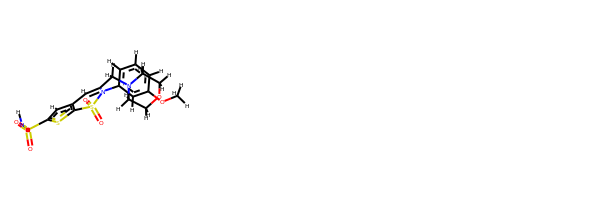

rdkit:  [H]C1=C(C([H])([H])N2C([H])([H])C([H])([H])OC([H])([H])C2([H])[H])N(c2c([H])c([H])c([H])c(OC([H])([H])[H])c2[H])S(=O)(=O)c2sc(S(=O)(=O)N([H])[H])c([H])c21
oechem:  COc1cccc(c1)N2C(=Cc3cc(sc3S2(=O)=O)S(=O)(=O)N)CN4CCOCC4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ###############

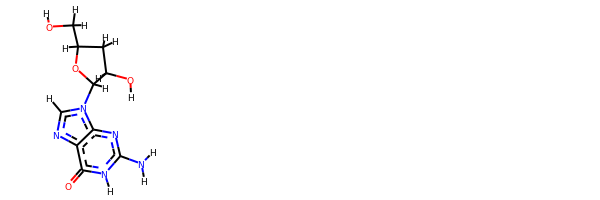

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])nc3c(=O)n([H])c(N([H])[H])nc32)C([H])(O[H])C1([H])[H]
oechem:  c1nc2c(=O)[nH]c(nc2n1C3C(CC(O3)CO)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

#####################################

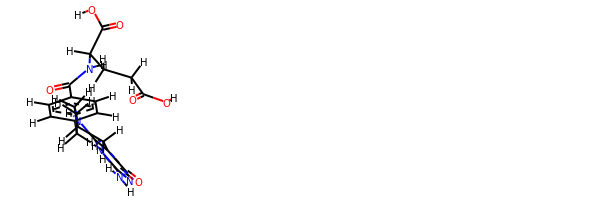

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])C([H])(C(=O)O[H])N([H])C(=O)c1c([H])c([H])c(C([H])([H])C([H])([H])C2([H])C([H])([H])c3c(n([H])c(N([H])[H])nc3=O)N([H])C2([H])[H])c([H])c1[H]
oechem:  c1cc(ccc1CCC2Cc3c([nH]c(nc3=O)N)NC2)C(=O)NC(CCC(=O)O)C(=O)O
###########################################################################
 #########################################################

bond
34.28015094684106 kJ/mol 57888.656133358265 kJ/mol False
angle
92.18856088435793 kJ/mol 92.18856088435793 kJ/mol True
nb
51.213211719194234 kJ/mol 51.213211719194234 kJ/mol True
torsion
17.642046318854668 kJ/mol 17.64206229795017 kJ/mol False
195.3239698692479 kJ/mol 58049.69996825977 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3256


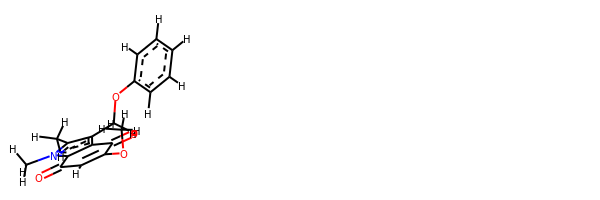

rdkit:  [H]C1=C(OC([H])([H])[H])C(=O)c2c(C([H])([H])Oc3c([H])c([H])c([H])c([H])c3[H])c(C([H])([H])[H])n(C([H])([H])[H])c2C1=O
oechem:  Cc1c(c2c(n1C)C(=O)C=C(C2=O)OC)COc3ccccc3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

########

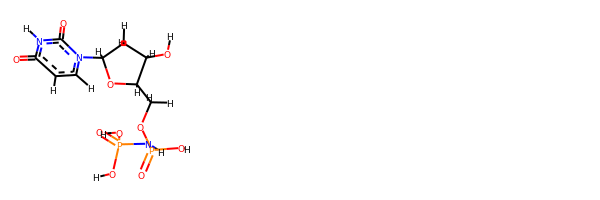

rdkit:  [H]OC1([H])C([H])([H])C([H])(n2c([H])c([H])c(=O)n([H])c2=O)OC1([H])C([H])([H])OP(=O)(O[H])N([H])P(=O)(O[H])O[H]
oechem:  c1cn(c(=O)[nH]c1=O)C2CC(C(O2)COP(=O)(NP(=O)(O)O)O)O
###########################################################################
 #########################################################

bond
27.472490083416986 kJ/mol 58311.70550529601 kJ/mol False
angle
156.90685378739835 kJ/mol 156.90685378739835 kJ/mol True
nb
34.826165314440665 kJ/mol 34.826165314440665 kJ/mol True
torsion
151.01934095837072 kJ/mol 148.50517934463412 kJ/mol False
370.2248501436267 kJ/mol 58651.94370374249 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3272


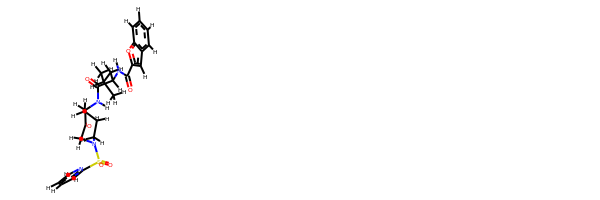

rdkit:  [H]c1nc(S(=O)(=O)N2C([H])([H])C(=O)C([H])(N([H])C(=O)C([H])(N([H])C(=O)c3oc4c([H])c([H])c([H])c([H])c4c3[H])C([H])([H])C([H])(C([H])([H])[H])C([H])([H])[H])C([H])([H])C([H])([H])C2([H])[H])c([H])c([H])c1[H]
oechem:  CC(C)CC(C(=O)NC1CCCN(CC1=O)S(=O)(=O)c2ccccn2)NC(=O)c3cc4ccccc4o3
###########################################################################
 #########################################################

bond
30.156435334522886 kJ/mol 57945.268506988585 kJ/mol False
angle
80.52102503288398 kJ/mol 82.42829980858437 kJ/mol False
nb
37.389606721658836 kJ/mol 37.389606721658836 kJ/mol True
torsion
23.022134491773766 kJ/mol 32.436243967657795 kJ/mol False
171.08920158083947 kJ/mol 58097.52265748648 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3273


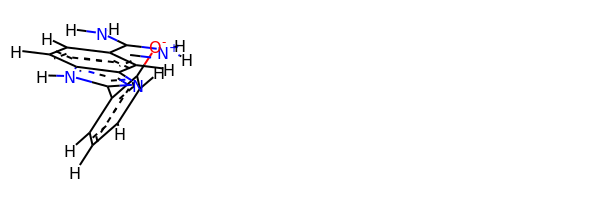

rdkit:  [H]c1c([H])c([H])c(-c2nc3c([H])c(C(N([H])[H])=[N+]([H])[H])c([H])c([H])c3n2[H])c([O-])c1[H]
oechem:  c1ccc(c(c1)c2[nH]c3ccc(cc3n2)C(=[NH2+])N)[O-]
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
34.06990637935607 kJ/mol 43821.73370920462 kJ/mol False
angle
49.62987818661869 kJ/mol 51.782787538176244 kJ/mol False
nb
41.85282110560518 kJ/mol 41.85282110560518 kJ/mol True
torsion
65.22603649126964 kJ/mol 59.94501165549904 kJ/mol False
190.7786421628496 kJ/mol 43975.314329503904 kJ/mol

---

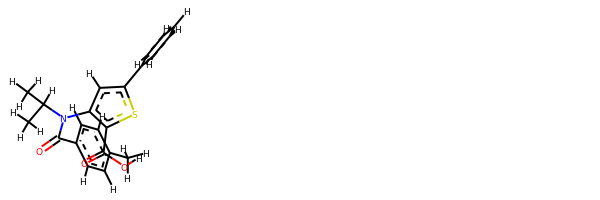

rdkit:  [H]OC(=O)c1sc(-c2c([H])c([H])c([H])c([H])c2[H])c([H])c1N(C(=O)c1c([H])c([H])c(C([H])([H])[H])c([H])c1[H])C([H])(C([H])([H])[H])C([H])([H])[H]
oechem:  Cc1ccc(cc1)C(=O)N(c2cc(sc2C(=O)O)c3ccccc3)C(C)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ####################################

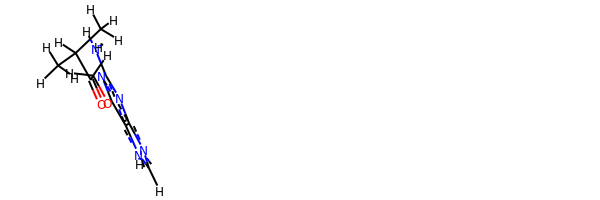

rdkit:  [H]c1nc2nc(N([H])[H])nc(OC([H])([H])C(=O)C([H])(C([H])([H])[H])C([H])([H])[H])c2n1[H]
oechem:  CC(C)C(=O)COc1c2c(nc[nH]2)nc(n1)N
###########################################################################
 #########################################################

bond
90.24135494353486 kJ/mol 113472.09688897028 kJ/mol False
angle
338.263729207283 kJ/mol 338.88365140747516 kJ/mol False
nb
23.568577986082232 kJ/mol 23.568577986082232 kJ/mol True
torsion
109.48337293791182 kJ/mol 52.414861626419025 kJ/mol False
561.5570350748119 kJ/mol 113886.96397999025 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3295


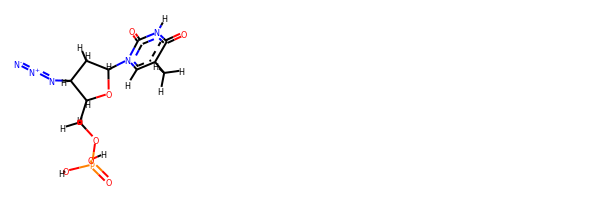

rdkit:  [H]OP(=O)(O[H])OC([H])([H])C1([H])OC([H])(n2c([H])c(C([H])([H])[H])c(=O)n([H])c2=O)C([H])([H])C1([H])N=[N+]=[N-]
oechem:  Cc1cn(c(=O)[nH]c1=O)C2CC(C(O2)COP(=O)(O)O)N=[N+]=[N-]
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
34.276448395430386 kJ/mol 44025.20402534462 kJ/mol False
angle
82.0503914331916 kJ/mol 84.31056991160268 kJ/mol False
nb
33.52687283846951 kJ/mol 33.52687283846951 kJ/mol True
torsion
70.40910971204723 kJ/mol 40.312724267604814 kJ/mol False
220.2628223791387 kJ/mol 4

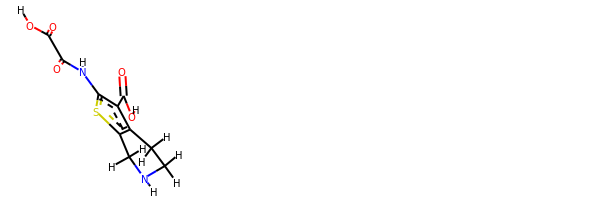

rdkit:  [H]OC(=O)C(=O)N([H])c1sc2c(c1C(=O)O[H])C([H])([H])C([H])([H])N([H])C2([H])[H]
oechem:  C1CNCc2c1c(c(s2)NC(=O)C(=O)O)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
9.293228213574418 kJ/mol 43794.46911608764 kJ/mol False
angle
57.881193918852766 kJ/mol 60.035812694412 kJ/mol False
nb
3.1900406325197546 kJ/mol 3.1900406325197546 kJ/mol True
torsion
9.613912049044783 kJ/mol 5.009488600065123 kJ/mol False
79.97837481399172 kJ/mol 43862.70445801464 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
----------------------------

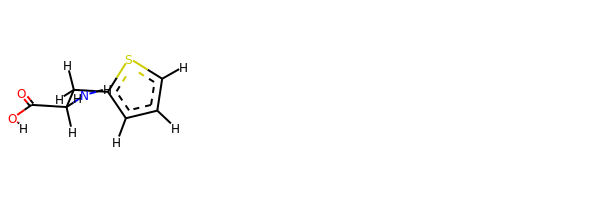

rdkit:  [H]OC(=O)C([H])(N([H])[H])C([H])([H])c1sc([H])c([H])c1[H]
oechem:  c1cc(sc1)CC(C(=O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
10.344339766864739 kJ/mol 58235.696012995584 kJ/mol False
angle
140.17988755250173 kJ/mol 140.17988755250173 kJ/mol True
nb
47.539856897606754 kJ/mol 47.539856897606754 kJ/mol True
torsion
31.799029344042562 kJ/mol 31.7

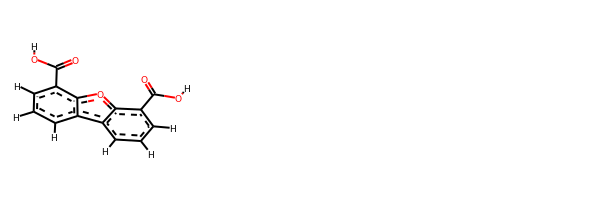

rdkit:  [H]OC(=O)c1c([H])c([H])c([H])c2c1oc1c(C(=O)O[H])c([H])c([H])c([H])c12
oechem:  c1cc2c3cccc(c3oc2c(c1)C(=O)O)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
49.76111546207133 kJ/mol 113321.27461303472 kJ/mol False
angle
336.9939335756773 kJ/mol 337.58190760346935 kJ/mol False
nb
18.035123581048808 kJ/mol 18.035123581048808 kJ/mol True
torsion
130.7523814177023 kJ/mol 73.72708768636089 kJ/mol False
535.5425540364997 kJ/mol 113750.6187319056 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3311


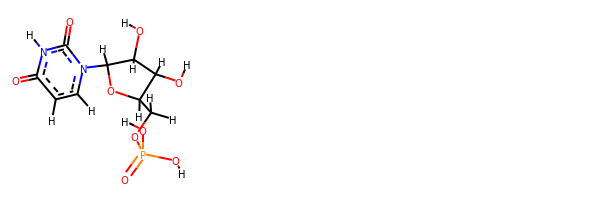

rdkit:  [H]OC1([H])C([H])(n2c([H])c([H])c(=O)n([H])c2=O)OC([H])(C([H])([H])OP(=O)(O[H])O[H])C1([H])O[H]
oechem:  c1cn(c(=O)[nH]c1=O)C2C(C(C(O2)COP(=O)(O)O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

#########################

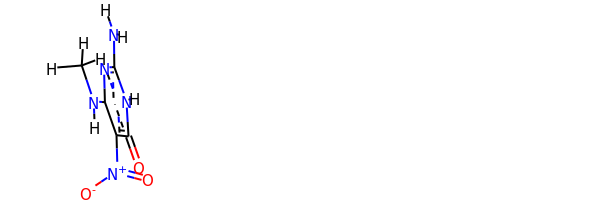

rdkit:  [H]N([H])c1nc(N([H])C([H])([H])[H])c([N+](=O)[O-])c(=O)n1[H]
oechem:  CNc1c(c(=O)[nH]c(n1)N)[N+](=O)[O-]
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
30.22804137307531 kJ/mol 58012.90265189104 kJ/mol False
angle
437.2764878600778 kJ/mol 437.2764878600778 kJ/mol True
nb
4.249684514030951 kJ/mol 4.249684514030951 kJ/mol True
torsion
112.60750732096282 kJ/mol 88.51664645094115 kJ/mol False
584.3617210681468 kJ/mol 58542.94547071609 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-----------------------------------------------

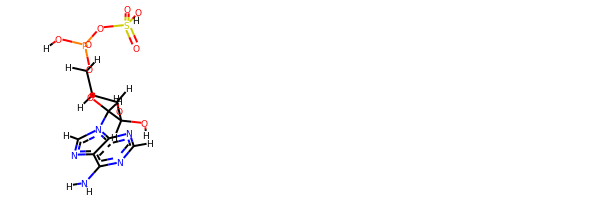

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)OC([H])(C([H])([H])OP(=O)(O[H])OS(=O)(=O)O[H])C1([H])O[H]
oechem:  c1nc(c2c(n1)n(cn2)C3C(C(C(O3)COP(=O)(O)OS(=O)(=O)O)O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################


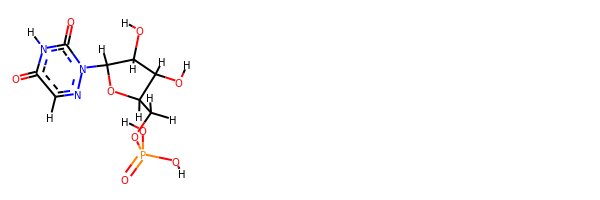

rdkit:  [H]OC1([H])C([H])(n2nc([H])c(=O)n([H])c2=O)OC([H])(C([H])([H])OP(=O)(O[H])O[H])C1([H])O[H]
oechem:  c1c(=O)[nH]c(=O)n(n1)C2C(C(C(O2)COP(=O)(O)O)O)O
###########################################################################
 #########################################################

bond
25.749514708789903 kJ/mol 58008.835413960296 kJ/mol False
angle
406.7397229490869 kJ/mol 406.7397229490869 kJ/mol True
nb
16.493147897893316 kJ/mol 16.493147897893316 kJ/mol True
torsion
90.45088854665012 kJ/mol 66.34184651624804 kJ/mol False
539.4332741024202 kJ/mol 58498.41013132352 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3341


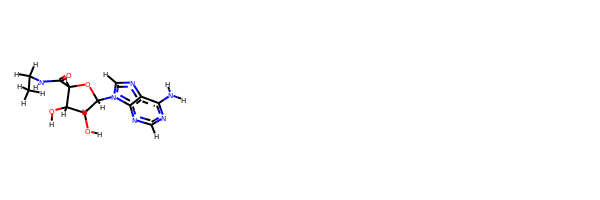

rdkit:  [H]OC1([H])C([H])(C(=O)N([H])C([H])([H])C([H])([H])[H])OC([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)C1([H])O[H]
oechem:  CCNC(=O)C1C(C(C(O1)n2cnc3c2ncnc3N)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
65.0962902386856 kJ/mol 113472.72058663519 kJ/mol False
angle
398.2802859310463 kJ/mol 398.90121831968645 kJ/mol False
nb
38.477383894262246 kJ/mol 38.477383894262246 kJ/mol True
torsion
195.4357462461276 kJ/mol 133.94546061869082 kJ/mol False
697.2897063101218 kJ/mol 114044.0446494678

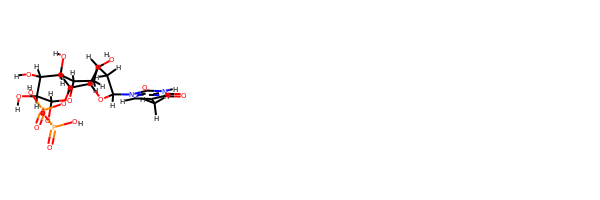

rdkit:  [H]OC1([H])C([H])(OP(=O)(O[H])OP(=O)(O[H])OC([H])([H])C2([H])OC([H])(n3c([H])c(C([H])([H])[H])c(=O)n([H])c3=O)C([H])([H])C2([H])O[H])OC([H])(C([H])([H])[H])C([H])(O[H])C1([H])O[H]
oechem:  Cc1cn(c(=O)[nH]c1=O)C2CC(C(O2)COP(=O)(O)OP(=O)(O)OC3C(C(C(C(O3)C)O)O)O)O
###########################################################################
 #########################################################

bond
6.921912456442751 kJ/mol 43679.058370132814 kJ/mol False
angle
62.03046743863312 kJ/mol 65.38781358995834 kJ/mol False
nb
-0.30321374499797915 kJ/mol -0.30321374499797915 kJ/mol True
torsion
22.32775922089243 kJ/mol 11.340177591141382 kJ/mol False
90.97692537097032 kJ/mol 43755.48314756891 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3346


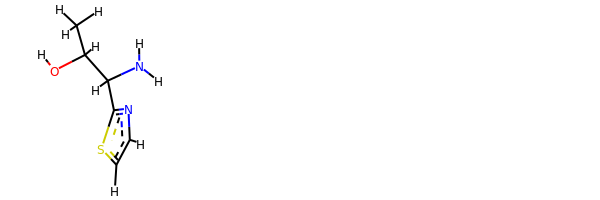

rdkit:  [H]OC([H])(C([H])([H])[H])C([H])(c1nc([H])c([H])s1)N([H])[H]
oechem:  CC(C(c1nccs1)N)O
###########################################################################
 #########################################################

bond
24.6663071234268 kJ/mol 58006.67164789195 kJ/mol False
angle
420.80093916939603 kJ/mol 420.80093916939603 kJ/mol True
nb
12.353940626867406 kJ/mol 12.353940626867406 kJ/mol True
torsion
98.27141656143837 kJ/mol 74.18625521402878 kJ/mol False
556.0926034811285 kJ/mol 58514.012782902246 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3348


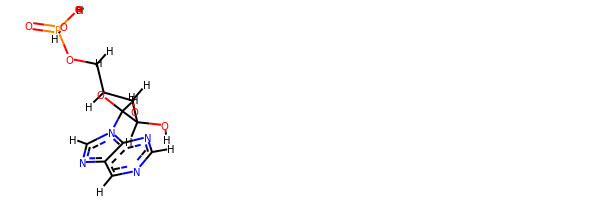

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c([H])nc([H])nc32)OC([H])(C([H])([H])OP(=O)(O[H])O[H])C1([H])O[H]
oechem:  c1c2c(ncn1)n(cn2)C3C(C(C(O3)COP(=O)(O)O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
7.652319981479367 kJ/mol 58082.73980056658 kJ/mol False
angle
87.84927439603302 kJ/mol 87.84927439603302 kJ/mol True
nb
35.194683578544364 kJ/mol 35.194683578544364 kJ/mol True
torsion
0.16399136313331564 kJ/mol 0.16400453296995143 kJ/mol False
130.86026931919008 kJ/mol 58205.947763074124 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3350


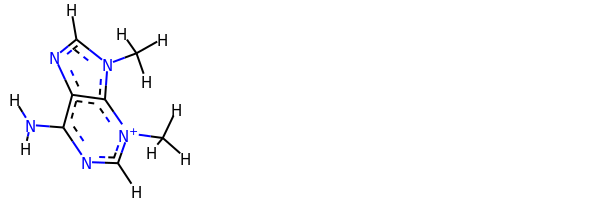

rdkit:  [H]c1nc2c(N([H])[H])nc([H])[n+](C([H])([H])[H])c2n1C([H])([H])[H]
oechem:  Cn1cnc2c1[n+](cnc2N)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
19.613892919279518 kJ/mol 58001.3382194142 kJ/mol False
angle
397.2241391276747 kJ/mol 397.2241391276747 kJ/mol True
nb
15.223278805189251 kJ/mol 15.223278805189251 kJ/mol True
torsion
78.4622211876469 kJ/mol 54.39656533173687 kJ/mol False
510.5235320397903 kJ/mol 58468.18220267881 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------

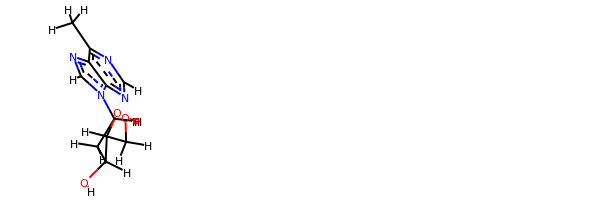

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])nc3c(C([H])([H])[H])nc([H])nc32)C([H])([H])C1([H])O[H]
oechem:  Cc1c2c(ncn1)n(cn2)C3CC(C(O3)CO)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
33.41876640309709 kJ/mol 57890.33116163306 kJ/mol False
angle
204.22404558808236 kJ/mol 205.62041900787858 kJ/mol False
nb
19.385131267944374 kJ/mol 19.385131267944374 kJ/mol True
torsion
40.12460078313447 kJ/mol 40.1256069646855 kJ/mol False
297.1525440422583 kJ/mol 58155.46231887357 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3357


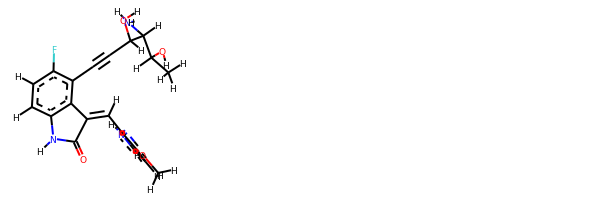

rdkit:  [H]OC([H])(C#Cc1c(F)c([H])c([H])c2c1C(=C([H])c1c(OC([H])([H])[H])c([H])c([H])n1[H])C(=O)N2[H])C([H])(N([H])[H])C([H])(O[H])C([H])([H])[H]
oechem:  CC(C(C(C#Cc1c(ccc2c1C(=Cc3c(cc[nH]3)OC)C(=O)N2)F)O)N)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #################################

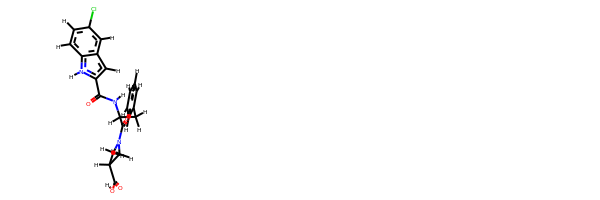

rdkit:  [H]OC(=O)C1([H])C([H])([H])N(C(=O)C([H])(N([H])C(=O)c2c([H])c3c([H])c(Cl)c([H])c([H])c3n2[H])C([H])([H])c2c([H])c([H])c([H])c([H])c2[H])C1([H])[H]
oechem:  c1ccc(cc1)CC(C(=O)N2CC(C2)C(=O)O)NC(=O)c3cc4cc(ccc4[nH]3)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
13.042902065625738 kJ/mol 87102.16378301835 kJ/mol False
angle
175.0702507963268 kJ/mol 178

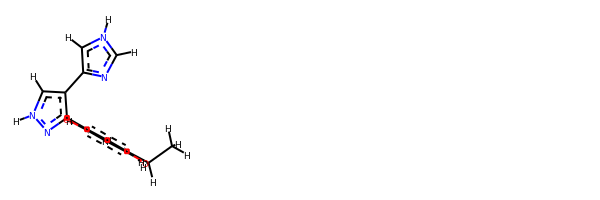

rdkit:  [H]Oc1c([H])c(O[H])c(C([H])([H])C([H])([H])[H])c([H])c1-c1nn([H])c([H])c1-c1nc([H])n([H])c1[H]
oechem:  CCc1cc(c(cc1O)O)c2c(c[nH]n2)c3c[nH]cn3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
13.394413826929647 kJ/mol 43800.95611807065 kJ/mol False
angle
41.75455181433118 kJ/mol 43.907746806938405 kJ/mol False
nb
21.295559515169117 kJ/mol 21.295559515169117 kJ/mol True
torsion
9.59371961503102 kJ/mol 4.307006927073647 kJ/mol False
86.03824477146097 kJ/mol 43870.46643131984 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3371


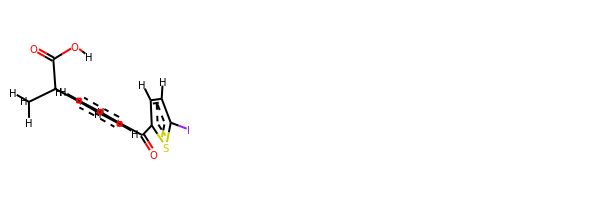

rdkit:  [H]OC(=O)C([H])(c1c([H])c([H])c(C(=O)c2sc(I)c([H])c2[H])c([H])c1[H])C([H])([H])[H]
oechem:  CC(c1ccc(cc1)C(=O)c2ccc(s2)I)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
35.64505739821337 kJ/mol 114174.32302618491

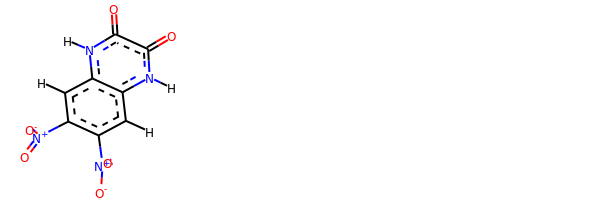

rdkit:  [H]c1c([N+](=O)[O-])c([N+](=O)[O-])c([H])c2c1n([H])c(=O)c(=O)n2[H]
oechem:  c1c2c(cc(c1[N+](=O)[O-])[N+](=O)[O-])[nH]c(=O)c(=O)[nH]2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
52.08548677132538 kJ/mol 113225.2990562744 kJ/mol False
angle
338.76853727330007 kJ/mol 339.3766698098364 kJ/mol False
nb
21.04192249460597 kJ/mol 21.04192249460597 kJ/mol True
torsion
120.56778968137581 kJ/mol 63.50259709410526 kJ/mol False
532.4637362206073 kJ/mol 113649.22024567294 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3380


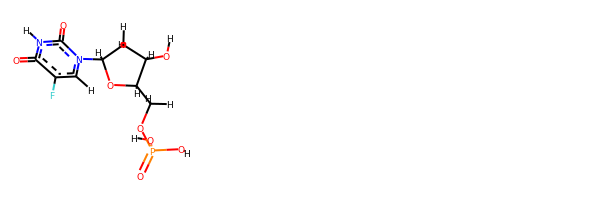

rdkit:  [H]OC1([H])C([H])([H])C([H])(n2c([H])c(F)c(=O)n([H])c2=O)OC1([H])C([H])([H])OP(=O)(O[H])O[H]
oechem:  c1c(c(=O)[nH]c(=O)n1C2CC(C(O2)COP(=O)(O)O)O)F
###########################################################################
 #########################################################

bond
40.90517891373301 kJ/mol 113895.44160443661 kJ/mol False
angle
318.143228934789 kJ/mol 318.763849039222 kJ/mol False
nb
16.41182429312813 kJ/mol 16.41182429312813 kJ/mol True
torsion
84.93635353981624 kJ/mol 51.46447314922623 kJ/mol False
460.39658568146643 kJ/mol 114282.0817509182 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3381


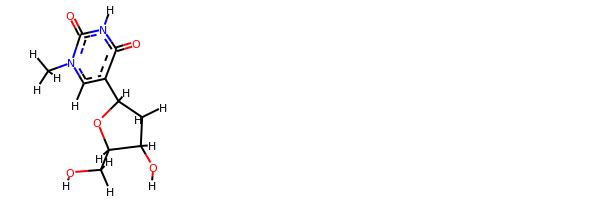

rdkit:  [H]OC([H])([H])C1([H])OC([H])(c2c([H])n(C([H])([H])[H])c(=O)n([H])c2=O)C([H])([H])C1([H])O[H]
oechem:  Cn1cc(c(=O)[nH]c1=O)C2CC(C(O2)CO)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
10.16695012432249 kJ/mol 57993.47833389496 kJ/mol False
angle
118.98392747191427 kJ/mol 118.98392747191427 kJ/mol True
nb
19.138043070897094 kJ/mol 19.138043070897094 kJ

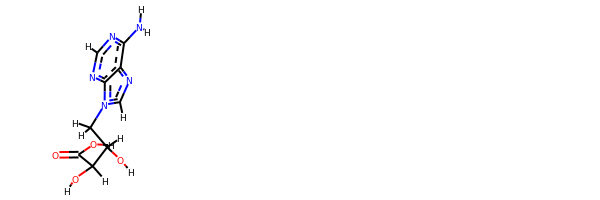

rdkit:  [H]OC(=O)C([H])(O[H])C([H])(O[H])C([H])([H])n1c([H])nc2c(N([H])[H])nc([H])nc21
oechem:  c1nc(c2c(n1)n(cn2)CC(C(C(=O)O)O)O)N
###########################################################################
 #########################################################

bond
20.538079862857984 kJ/mol 58305.41099314668 kJ/mol False
angle
104.18302350989644 kJ/mol 104.18302350989644 kJ/mol True
nb
43.45801709137235 kJ/mol 43.45801709137235 kJ/mol True
torsion
48.51224604823549 kJ/mol 48.51224790368881 kJ/mol False
216.69136651236226 kJ/mol 58501.56428165164 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3389


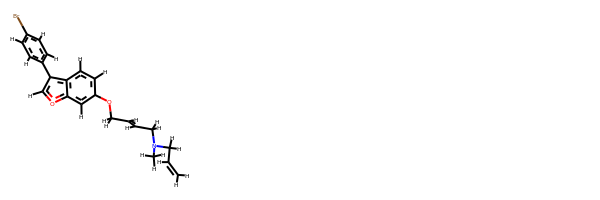

rdkit:  [H]C([H])=C([H])C([H])([H])N(C([H])([H])[H])C([H])([H])C([H])=C([H])C([H])([H])Oc1c([H])c([H])c2c(-c3c([H])c([H])c(Br)c([H])c3[H])c([H])oc2c1[H]
oechem:  CN(CC=C)CC=CCOc1ccc2c(c1)occ2c3ccc(cc3)Br
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #######################################

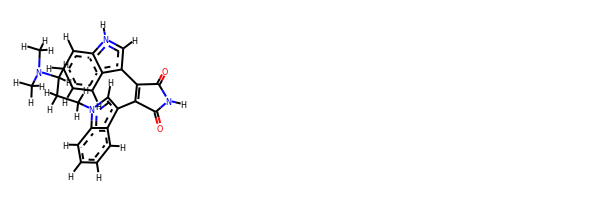

rdkit:  [H]c1c([H])c([H])c2c(c1[H])c(C1=C(c3c([H])n(C([H])([H])C([H])([H])C([H])([H])N(C([H])([H])[H])C([H])([H])[H])c4c([H])c([H])c([H])c([H])c34)C(=O)N([H])C1=O)c([H])n2[H]
oechem:  CN(C)CCCn1cc(c2c1cccc2)C3=C(C(=O)NC3=O)c4c[nH]c5c4cccc5
###########################################################################
 #########################################################

bond
8.715425672988399 kJ/mol 57130.001658690504 kJ/mol False
angle
12.521561550447203 kJ/mol 12.783274679338712 kJ/mol False
nb
28.744381326295567 kJ/mol 28.744381326295567 kJ/mol True
torsion
33.472177706890555 kJ/mol 0.00021356916901804746 kJ/mol False
83.45354625662172 kJ/mol 57171.5295282653 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3397


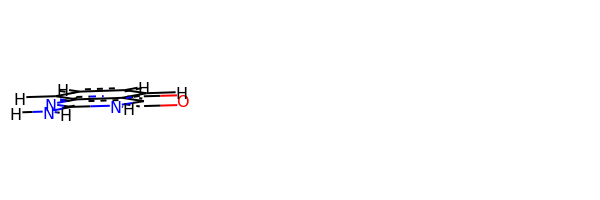

rdkit:  [H]c1c([H])c([H])c2c(=O)n([H])c(N([H])[H])nc2c1[H]
oechem:  c1ccc2c(c1)c(=O)[nH]c(n2)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ############

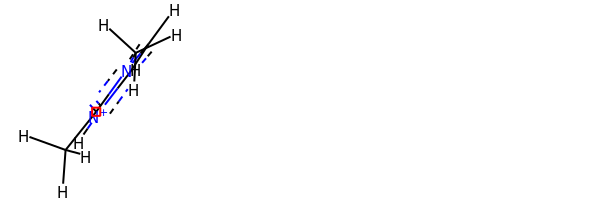

rdkit:  [H]c1c([H])[n+]([H])c(C([H])([H])[H])n1C([H])([H])[H]
oechem:  Cc1[nH+]ccn1C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
24.119168393144736 kJ/mol 114532.84200723717 kJ/mol False
angle
21.268510576756633 kJ/mol 21.904285540258968 kJ/mol False
nb
16.025538915841285 kJ/mol 16.025538915841285 kJ/mol True
torsion
50.20818579400695 kJ/mol 0.0004776445685256456 kJ/mol False
111.6214036797496 kJ/mol 114570.77230933784 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
----------------------------------------------------------------

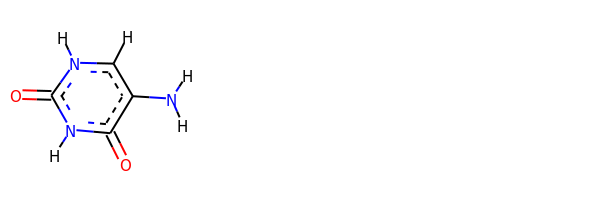

rdkit:  [H]c1c(N([H])[H])c(=O)n([H])c(=O)n1[H]
oechem:  c1c(c(=O)[nH]c(=O)[nH]1)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
39.2754212608181 kJ/mol 56565.11218330867 kJ/mol False
angle
326.22971885437534 kJ/mol 326.22971885437534 kJ/mol True
nb
22.329476826671026 kJ/mol 22.329476826671026 kJ/mol True
torsion
103.83213715506915 kJ/mol 63.5023455266226 kJ/m

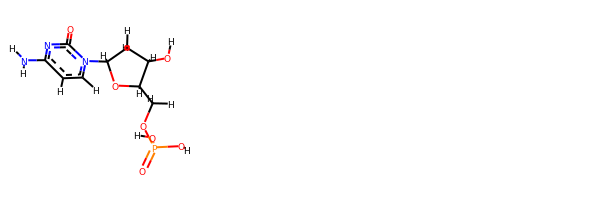

rdkit:  [H]OC1([H])C([H])([H])C([H])(n2c([H])c([H])c(N([H])[H])nc2=O)OC1([H])C([H])([H])OP(=O)(O[H])O[H]
oechem:  c1cn(c(=O)nc1N)C2CC(C(O2)COP(=O)(O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
49.924376371559916 kJ/mol 113385.57286906778 kJ/mol False
angle
339.6751149562528 kJ/mol 340.26393302113206 kJ/mol False
nb
22.962227964132275 kJ/mol 22.962227964132275 kJ/mol True
torsion
115.65068326333896 kJ/mol 58.57779887387193 kJ/mol False
528.2124025552839 kJ/mol 113807.37682892692 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3416


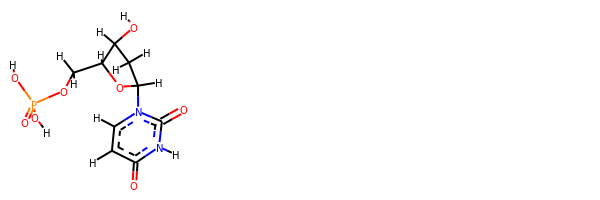

rdkit:  [H]OC1([H])C([H])([H])C([H])(n2c([H])c([H])c(=O)n([H])c2=O)OC1([H])C([H])([H])OP(=O)(O[H])O[H]
oechem:  c1cn(c(=O)[nH]c1=O)C2CC(C(O2)COP(=O)(O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
48.07045532962339 kJ/mol 157717.5761738351 kJ/mol False
angle
347.62838936123325 kJ/mol 350.41160108320446 kJ/mol False
nb
21.347738549178874 kJ/mol 21.347738549178874 kJ/mol True
torsion
123.35443828483815 kJ/mol 66.37942217476257 kJ/mol False
540.4010215248736 kJ/mol 158155.71493564226 kJ/mol


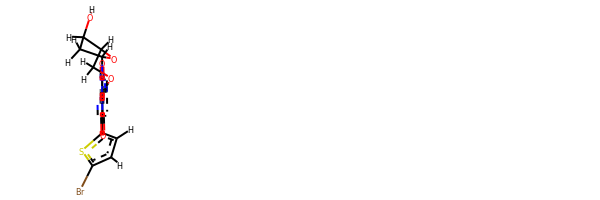

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])c(-c3sc(Br)c([H])c3[H])c(=O)n([H])c2=O)C([H])([H])C1([H])O[H]
oechem:  c1cc(sc1c2cn(c(=O)[nH]c2=O)C3CC(C(O3)CO)O)Br
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
22.031748359550967 kJ/mol 29092.242527136368 kJ/mol False
angle
101.50432680089494 kJ/mol 101.50432680089494 kJ/mol True
nb
21.10868585462973 kJ/mol 21.10868585462973 kJ/mol True
torsion
38.13911257946594 kJ/mol 27.62760957041854 kJ/mol False
182.78387359454157 kJ/mol 29242.483149362313 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3422


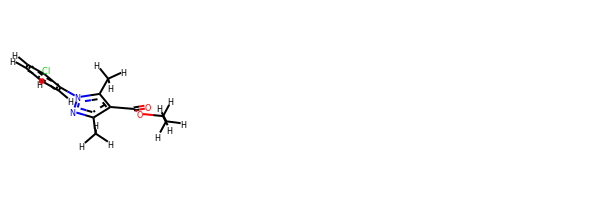

rdkit:  [H]c1c([H])c([H])c(-n2nc(C([H])([H])[H])c(C(=O)OC([H])([H])C([H])([H])[H])c2C([H])([H])[H])c(Cl)c1[H]
oechem:  CCOC(=O)c1c(nn(c1C)c2ccccc2Cl)C
###########################################################################
 #########################################################

bond
15.79768977049918 kJ/mol 58000.28624359699 kJ/mol False
angle
109.43636453028715 kJ/mol 109.43636453028715 kJ/mol True
nb
58.16244666514763 kJ/mol 58.16244666514763 kJ/mol True
torsion
4.6650674146532864 kJ/mol 1.9296845064096861 kJ/mol False
188.06156838058723 kJ/mol 58169.81473929883 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3424


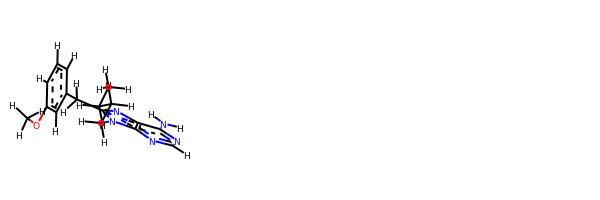

rdkit:  [H]c1nc(N([H])[H])c2nc(C([H])([H])c3c([H])c([H])c([H])c(OC([H])([H])[H])c3[H])n(C([H])([H])C([H])([H])C([H])([H])C([H])([H])[H])c2n1
oechem:  CCCCn1c(nc2c1ncnc2N)Cc3cccc(c3)OC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
76.88157281273573 kJ/mol 226956.31438601736 kJ/mol False
angle
143.13225121191394 kJ/mol 143.82516849999206 kJ/mol False
nb
7.612984643971552 kJ/mol 7.612984643971552 kJ/mol True
torsion
95.42384195435089 kJ/mol 37.713187429082765 kJ/mol False
323.0506506229721 kJ/mol 227145.4657265904 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3426


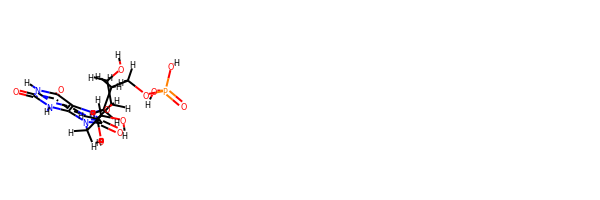

rdkit:  [H]OC([H])([H])C([H])(O[H])C([H])(O[H])C([H])(O[H])C([H])([H])n1c(=O)n(C([H])([H])C([H])([H])C([H])([H])OP(=O)(O[H])O[H])c2c(=O)n([H])c(=O)n([H])c21
oechem:  C(Cn1c2c([nH]c(=O)[nH]c2=O)n(c1=O)CC(C(C(CO)O)O)O)COP(=O)(O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ###############

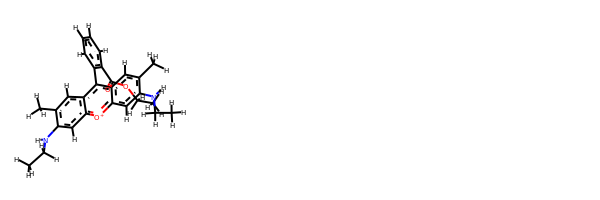

rdkit:  [H]c1c([H])c([H])c(-c2c3c([H])c(C([H])([H])[H])c(N([H])C([H])([H])C([H])([H])[H])c([H])c3[o+]c3c([H])c(N([H])C([H])([H])C([H])([H])[H])c(C([H])([H])[H])c([H])c23)c(C(=O)OC([H])([H])C([H])([H])[H])c1[H]
oechem:  CCNc1cc2c(cc1C)c(c3cc(c(cc3[o+]2)NCC)C)c4ccccc4C(=O)OCC
###########################################################################
 #########################################################

bond
21.45341429982131 kJ/mol 114625.9737145313 kJ/mol False
angle
22.08542322530893 kJ/mol 22.849661603167817 kJ/mol False
nb
16.697155407179874 kJ/mol 16.697155407179874 kJ/mol True
torsion
50.20810930731729 kJ/mol 0.00039316800037139226 kJ/mol False
110.4441022396274 kJ/mol 114665.52092470964 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3440


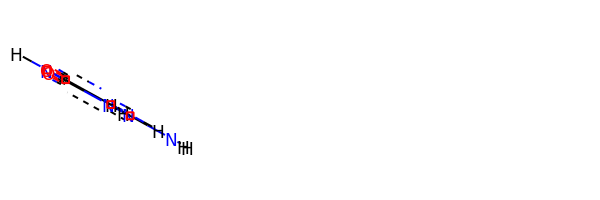

rdkit:  [H]N([H])c1c(N([H])[H])n([H])c(=O)n([H])c1=O
oechem:  c1(c([nH]c(=O)[nH]c1=O)N)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
43.67208782333299 kJ/mol 114509.22307134682 kJ/mol False
angle
341.740000025878 kJ/mol 342.37638257129237 kJ/mol False
nb
10.903123997943874 kJ/mol 10.903123997943874 kJ/mol True
torsion
121.95455516747553 kJ/mol 71.74660539830043 kJ/mol False
518.2697670146304 kJ/mol 114934.24918331434 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
------------------------------------------------------------------

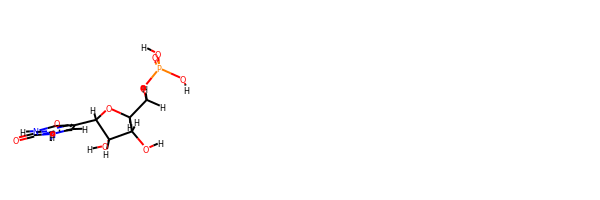

rdkit:  [H]OC1([H])C([H])(c2c([H])n([H])c(=O)n([H])c2=O)OC([H])(C([H])([H])OP(=O)(O[H])O[H])C1([H])O[H]
oechem:  c1c(c(=O)[nH]c(=O)[nH]1)C2C(C(C(O2)COP(=O)(O)O)O)O
###########################################################################
 #########################################################

bond
16.51763953648837 kJ/mol 57060.82351785666 kJ/mol False
angle
67.84685689660829 kJ/mol 68.0832202898102 kJ/mol False
nb
66.79282068900945 kJ/mol 66.79282068900945 kJ/mol True
torsion
34.50557892218915 kJ/mol 1.0336154951372294 kJ/mol False
185.66289604429528 kJ/mol 57196.73317433061 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3444


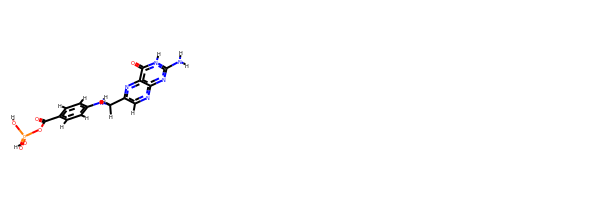

rdkit:  [H]OP(=O)(O[H])OC(=O)c1c([H])c([H])c(N([H])C([H])([H])c2nc3c(=O)n([H])c(N([H])[H])nc3nc2[H])c([H])c1[H]
oechem:  c1cc(ccc1C(=O)OP(=O)(O)O)NCc2cnc3c(n2)c(=O)[nH]c(n3)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
21.33627871232655 kJ/mol 58293.23818661304 kJ/mol False
angle
390.03715675072266 kJ/mol 390.03715675072266 kJ/mol True
nb
11.104328843891162 kJ/mol 11.104328843891162 kJ/mol True
torsion
38.385975977488236 kJ/mol 38.38583232594457 kJ/mol False
460.86374028442856 kJ/mol 58732.76550453359 kJ/mol

-------------------------------------------------------------------
------------------------------------------------

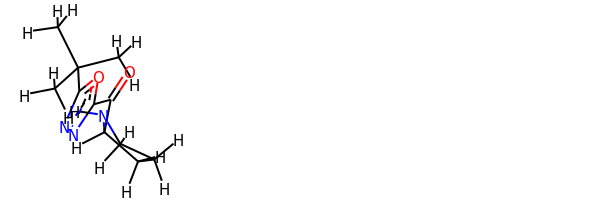

rdkit:  [H]N1C([H])([H])C([H])([H])C([H])([H])C1([H])C(=O)c1nnc(C(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H])o1
oechem:  CC(C)(C)c1nnc(o1)C(=O)C2CCCN2
###########################################################################
 #########################################################

bond
46.51358623402871 kJ/mol 29186.482816526852 kJ/mol False
angle
142.06600410468397 kJ/mol 142.06600410468397 kJ/mol True
nb
4.16159613161081 kJ/mol 4.16159613161081 kJ/mol True
torsion
16.801957666432106 kJ/mol 11.571959433609846 kJ/mol False
209.54314413675561 kJ/mol 29344.282376196756 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3448


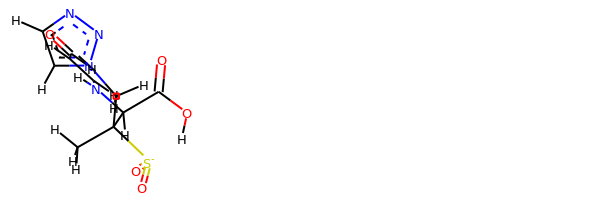

rdkit:  [H]OC(=O)C([H])(N([H])C([H])=C([H])C([H])=O)C([S-](=O)=O)(C([H])([H])[H])C([H])([H])n1nnc([H])c1[H]
oechem:  CC(Cn1ccnn1)(C(C(=O)O)NC=CC=O)[S-](=O)=O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
21.618371054720573 kJ/mol 29090.363089580766 kJ/mol False
angle
103.37074508009091 kJ/mol 103.37074508009091 kJ/mol True
nb
41.66184859553213 kJ/mol 41.66184

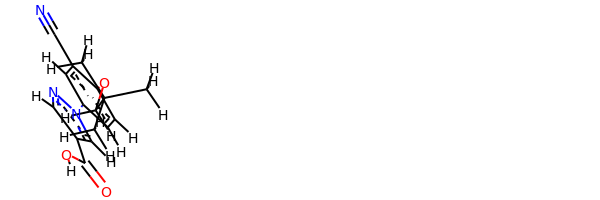

rdkit:  [H]OC(=O)c1c([H])nn(-c2c([H])c([H])c(OC([H])([H])C(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H])c(C#N)c2[H])c1[H]
oechem:  CC(C)(C)COc1ccc(cc1C#N)n2cc(cn2)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

#############

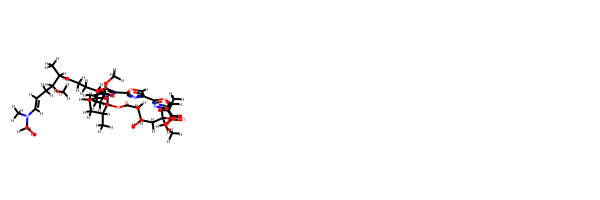

rdkit:  [H]OC([H])([H])N(C([H])=C([H])C([H])([H])C([H])(OC([H])([H])[H])C([H])(C(=O)C([H])([H])C([H])([H])C([H])(C([H])([H])[H])C([H])(OC([H])([H])[H])C([H])([H])C1([H])OC(=O)C([H])([H])C([H])(O[H])C([H])([H])C([H])(O[H])C([H])([H])C(=O)C([H])(C([H])([H])[H])C([H])(OC([H])([H])[H])c2nc(oc2[H])-c2nc(oc2[H])-c2nc(oc2[H])C([H])=C([H])C([H])([H])C([H])([H])C1([H])C([H])([H])[H])C([H])([H])[H])C([H])([H])[H]
oechem:  CC1CCC=Cc2nc(co2)-c3nc(co3)-c4nc(co4)C(C(C(=O)CC(CC(CC(=O)OC1CC(C(C)CCC(=O)C(C)C(CC=CN(C)CO)OC)OC)O)O)C)OC
###########################################################################
 #########################################################

bond
4.458493314431172 kJ/mol 57670.1569079701 kJ/mol False
angle
119.02401294569663 kJ/mol 119.02401294569663 kJ/mol True
nb
24.880977104147146 kJ/mol 24.880977104147146 kJ/mol True
torsion
0.08686929915152869 kJ/mol 0.0868835118025157 kJ/mol False
148.45035266342646 kJ/mol 57814.148781531745 kJ/mol

--------------------------------------

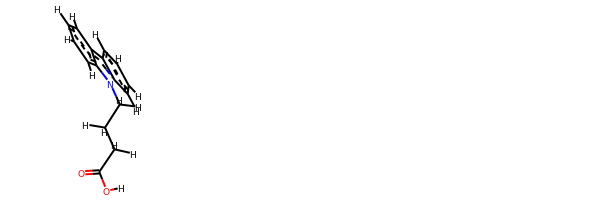

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])C([H])([H])n1c2c([H])c([H])c([H])c([H])c2c2c([H])c([H])c([H])c([H])c21
oechem:  c1ccc2c(c1)c3ccccc3n2CCCC(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

##################################

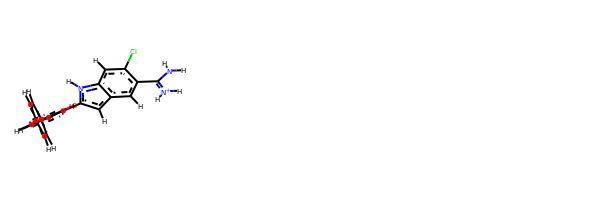

rdkit:  [H]Oc1c(-c2c([H])c([H])c([H])c([H])c2[H])c([H])c([H])c([H])c1-c1c([H])c2c([H])c(C(N([H])[H])=[N+]([H])[H])c(Cl)c([H])c2n1[H]
oechem:  c1ccc(cc1)c2cccc(c2O)c3cc4cc(c(cc4[nH]3)Cl)C(=[NH2+])N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
47.169053636464014 kJ/mol 58029.84366415444 kJ/mol False
angle
442.4681731403785 kJ/mol 442.4681731403785 kJ/mol True
nb
6.795460701994197 kJ/mol 6.795460701994197 kJ/mol True
torsion
134.9424883477543 kJ/mol 110.85162747773248 kJ/mol False
631.375175826

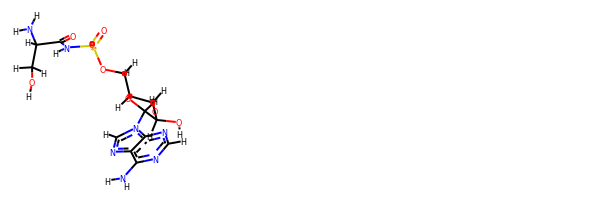

rdkit:  [H]OC([H])([H])C([H])(C(=O)N([H])S(=O)(=O)OC([H])([H])C1([H])OC([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)C([H])(O[H])C1([H])O[H])N([H])[H]
oechem:  c1nc(c2c(n1)n(cn2)C3C(C(C(O3)COS(=O)(=O)NC(=O)C(CO)N)O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
15.014970340353702 kJ/mol 43990.91176037855 kJ/mol False
angle
47.67067214111287 kJ/mol 49.7820113276

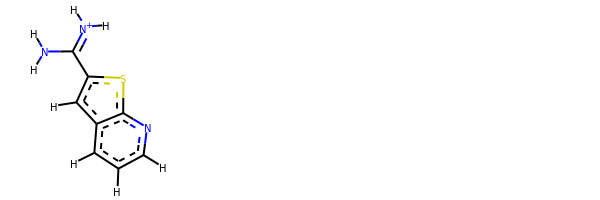

rdkit:  [H]c1nc2sc(C(N([H])[H])=[N+]([H])[H])c([H])c2c([H])c1[H]
oechem:  c1cc2cc(sc2nc1)C(=[NH2+])N
###########################################################################
 #########################################################

bond
23.995204060379738 kJ/mol 44188.49864423156 kJ/mol False
angle
116.24317192536698 kJ/mol 118.71503975257447 kJ/mol False
nb
-8.002642577598786 kJ/mol -8.002642577598786 kJ/mol True
torsion
202.6860901697761 kJ/mol 202.69569086265233 kJ/mol False
334.92182357792404 kJ/mol 44501.906732269184 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3490


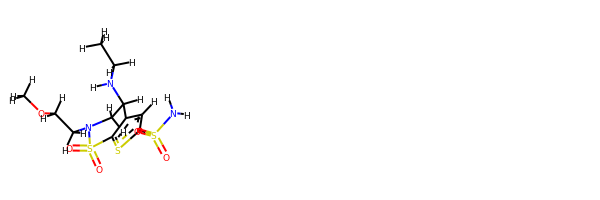

rdkit:  [H]c1c(S(=O)(=O)N([H])[H])sc2c1C([H])(N([H])C([H])([H])C([H])([H])[H])C([H])([H])N(C([H])([H])C([H])([H])OC([H])([H])[H])S2(=O)=O
oechem:  CCNC1CN(S(=O)(=O)c2c1cc(s2)S(=O)(=O)N)CCOC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
26.74805924484976 kJ/mol 43815.65260913506 kJ/mol False
angle
85.49605489644865 kJ/mol 87.64701696120453 kJ/mol False
nb
2.996027588240363 kJ/mol 2.996027588240363 kJ/mol True
torsion
57.51130138700407 kJ/mol 57.51156187696048 kJ/mol False
172.75144311654284 kJ/mol 43963.80721556147 kJ/mol

-------------------------------------------------------------------
-------------------------------------

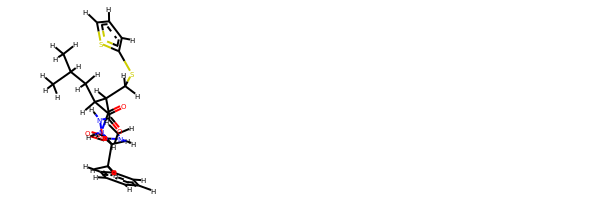

rdkit:  [H]ON([H])C(=O)C([H])(C([H])([H])Sc1sc([H])c([H])c1[H])C([H])(C(=O)N([H])C([H])(C(=O)N([H])C([H])([H])[H])C([H])([H])c1c([H])c([H])c([H])c([H])c1[H])C([H])([H])C([H])(C([H])([H])[H])C([H])([H])[H]
oechem:  CC(C)CC(C(CSc1cccs1)C(=O)NO)C(=O)NC(Cc2ccccc2)C(=O)NC
###########################################################################
 #########################################################

bond
19.94336029144723 kJ/mol 57285.566008814254 kJ/mol False
angle
472.4337995869079 kJ/mol 472.60034825530624 kJ/mol False
nb
3.3224990047033907 kJ/mol 3.3224990047033907 kJ/mol True
torsion
76.87240307561625 kJ/mol 60.13641344259859 kJ/mol False
572.5720619586748 kJ/mol 57821.62526951686 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3494


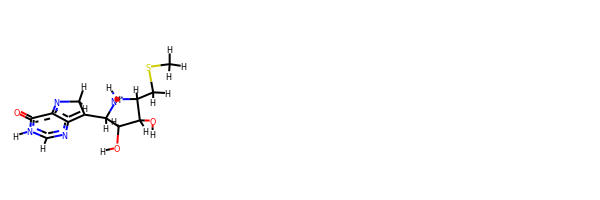

rdkit:  [H]OC1([H])C([H])(O[H])C([H])(C([H])([H])SC([H])([H])[H])[N+]([H])([H])C1([H])C1=c2nc([H])n([H])c(=O)c2=NC1([H])[H]
oechem:  CSCC1C(C(C([NH2+]1)C2=c3c(=NC2)c(=O)[nH]cn3)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
38.92894724858984 kJ/mol 171474.69129694646 kJ/mol False
angle
53.4583591017461 kJ/mol 54.13900146813305 kJ/mol False
nb
47.91089157097377 kJ/mol 47.91089157097377 kJ/mol True
torsion
82.3184934805629 kJ/mol 29.310364252605194 kJ/mol False
222.61669140187263 kJ/mol 171606.05155423816 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3496


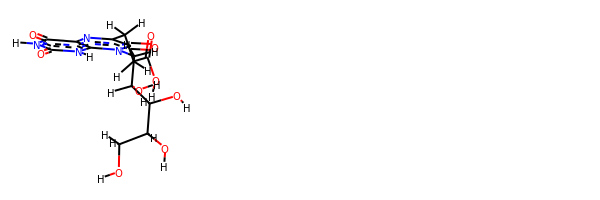

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])c1nc2c(=O)n([H])c(=O)n([H])c2n(C([H])([H])C([H])(O[H])C([H])(O[H])C([H])(O[H])C([H])([H])O[H])c1=O
oechem:  C(CC(=O)O)c1c(=O)n(c2c(n1)c(=O)[nH]c(=O)[nH]2)CC(C(C(CO)O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
13.316561348687577 kJ/mol 57057.55245837114 kJ/mol False
angle
34.673770832376036 kJ/mol 34.90930026331638 kJ/mol False
nb
41.40636885714683 kJ/mol 41.40636885714683 kJ/mol True
torsion
44.11403202442328 kJ/mol 10.642059750797797 kJ/mol False
133.51073306263373 kJ/mol 57144.5101872424 kJ/mol

-------------------------------------------------------------------
----------------

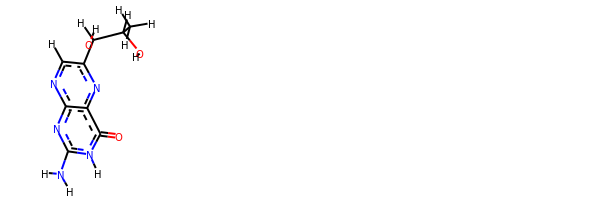

rdkit:  [H]OC([H])(c1nc2c(=O)n([H])c(N([H])[H])nc2nc1[H])C([H])(O[H])C([H])([H])[H]
oechem:  CC(C(c1cnc2c(n1)c(=O)[nH]c(n2)N)O)O
###########################################################################
 #########################################################

bond
26.604460290676286 kJ/mol 58001.37018171923 kJ/mol False
angle
414.771389876048 kJ/mol 414.771389876048 kJ/mol True
nb
13.303424611069197 kJ/mol 13.303424611069197 kJ/mol True
torsion
98.58699621640504 kJ/mol 74.47686655423372 kJ/mol False
553.2662709941985 kJ/mol 58503.92186276058 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3500


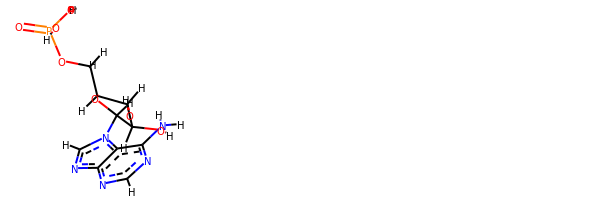

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3nc([H])nc(N([H])[H])c32)OC([H])(C([H])([H])OP(=O)(O[H])O[H])C1([H])O[H]
oechem:  c1nc(c2c(n1)ncn2C3C(C(C(O3)COP(=O)(O)O)O)O)N
###########################################################################
 #########################################################

bond
19.083597202028944 kJ/mol 28980.0582393674 kJ/mol False
angle
96.51468126995996 kJ/mol 96.51468126995996 kJ/mol True
nb
47.89602829740267 kJ/mol 47.89602829740267 kJ/mol True
torsion
45.84154543173052 kJ/mol 50.01387201363495 kJ/mol False
209.3358522011221 kJ/mol 29174.4828209484 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3501


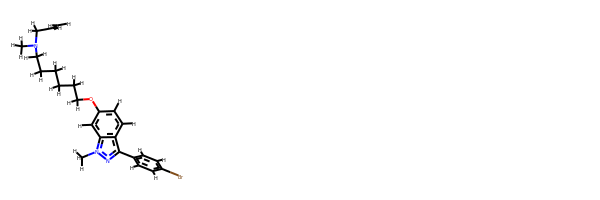

rdkit:  [H]C([H])=C([H])C([H])([H])N(C([H])([H])[H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])Oc1c([H])c([H])c2c(-c3c([H])c([H])c(Br)c([H])c3[H])nn(C([H])([H])[H])c2c1[H]
oechem:  Cn1c2cc(ccc2c(n1)c3ccc(cc3)Br)OCCCCCCN(C)CC=C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

######################################################################

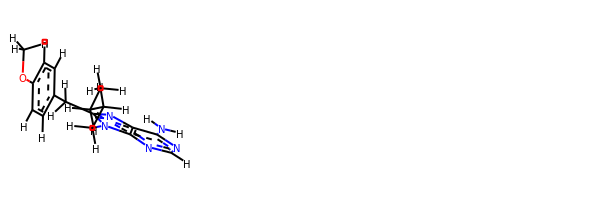

rdkit:  [H]c1nc(N([H])[H])c2nc(C([H])([H])c3c([H])c([H])c(OC([H])([H])[H])c([H])c3[H])n(C([H])([H])C([H])([H])C([H])([H])C([H])([H])[H])c2n1
oechem:  CCCCn1c(nc2c1ncnc2N)Cc3ccc(cc3)OC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################



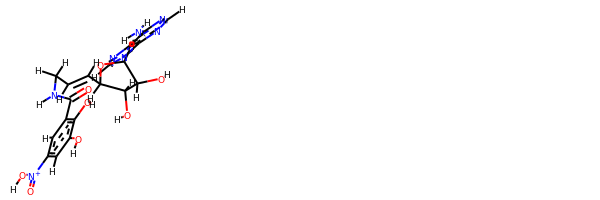

rdkit:  [H]Oc1c([H])c([N+](=O)O[H])c([H])c(C(=O)N([H])C([H])([H])C([H])=C([H])C2([H])OC([H])(n3c([H])nc4c(N([H])[H])nc([H])nc43)C([H])(O[H])C2([H])O[H])c1O[H]
oechem:  c1c(cc(c(c1C(=O)NCC=CC2C(C(C(O2)n3cnc4c3ncnc4N)O)O)O)O)[N+](=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
52.51991890142705 kJ/mol 113112.34618605742 kJ/mol False
angle
115.40178643563026 kJ/mol 115.9673509174386 kJ/mol False
nb
33.35623593509232 kJ/mol 33.35623593509232 kJ/mol True
torsion
123.8086784561379 kJ/mol 85.0249677631761 kJ/mol False
325.08661972828753 kJ/mol 113346.69474067312 kJ/mol

------------------------------------------------------------

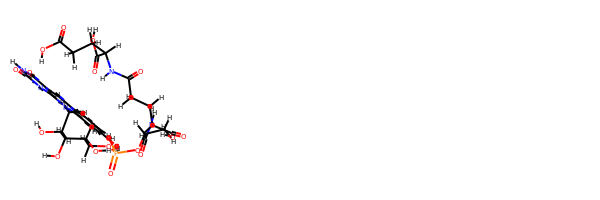

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])C([H])(C(=O)O[H])N([H])C(=O)C([H])([H])C([H])([H])C([H])(C(=O)O[H])N([H])C(=O)C([H])(OP(=O)(O[H])OC([H])([H])C([H])(O[H])C([H])(O[H])C([H])(O[H])C([H])([H])n1c2nc(=O)n([H])c(=O)c-2c([H])c2c([H])c([H])c(O[H])c([H])c21)C([H])([H])[H]
oechem:  CC(C(=O)NC(CCC(=O)NC(CCC(=O)O)C(=O)O)C(=O)O)OP(=O)(O)OCC(C(C(Cn1c2cc(ccc2cc-3c(=O)[nH]c(=O)nc13)O)O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

########################################################################

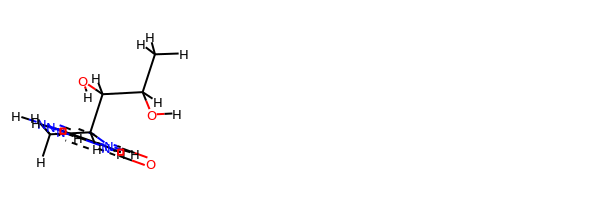

rdkit:  [H]OC([H])(C([H])([H])[H])C([H])(O[H])C1([H])N([H])c2c(nc(N([H])[H])n([H])c2=O)N([H])C1([H])[H]
oechem:  CC(C(C1CNc2c(c(=O)[nH]c(n2)N)N1)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
12.666180782915244 kJ/mol 29082.092320611486 kJ/mol False
angle
107.00587551255252 kJ/mol 108.66263993842392 kJ/mol False
nb
43.859774339320104 kJ/mol 43.859774339320104 kJ/mol True
torsion
28.241598497739997 kJ/mol 26.148768694360733 kJ/mol False
191.77342913252787 kJ/mol 29260.76350358359 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
--

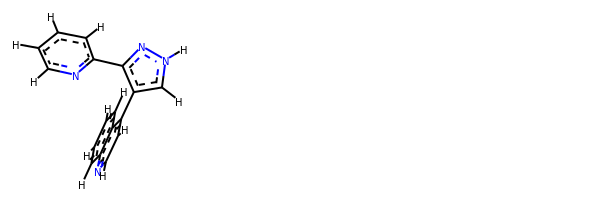

rdkit:  [H]c1nc(-c2nn([H])c([H])c2-c2c([H])c([H])nc3c([H])c([H])c([H])c([H])c23)c([H])c([H])c1[H]
oechem:  c1ccc2c(c1)c(ccn2)c3c[nH]nc3c4ccccn4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
43.92709702989749 kJ/mol 114770.06796768092 kJ/mol False
angle
145.52340845502135 kJ/mol 145.52340845502135 kJ/mol True
nb
33.00651884721018 kJ/mol 33.00651884721018 kJ/mol True
torsion
57.540382439100036 kJ/mol 50.67521599763704 kJ/mol False
279.99740677122907 kJ/mol 114999.27311098078 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3537


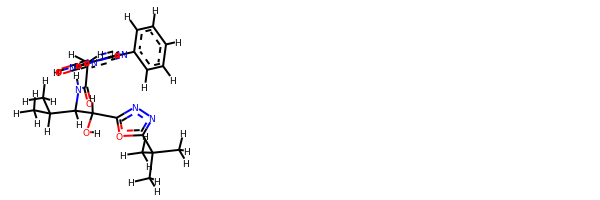

rdkit:  [H]OC([H])(c1nnc(C(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H])o1)C([H])(N([H])C(=O)C([H])([H])n1c(-c2c([H])c([H])c([H])c([H])c2[H])nc([H])c(N([H])[H])c1=O)C([H])(C([H])([H])[H])C([H])([H])[H]
oechem:  CC(C)C(C(c1nnc(o1)C(C)(C)C)O)NC(=O)Cn2c(=O)c(cnc2c3ccccc3)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
8.594300754649364 kJ/mol 57465.187684054275 kJ/mol False
angle
90.00278467128008 kJ/mol 90.00278467128008 kJ/mol True
nb
25.619995091942354 kJ/mol 25.619995091942354 kJ/mol True
torsion
0.023449269405191035 kJ/mol 0.023331760374699726 kJ/mol False
124.240529787277 kJ/mol 57580.83379557787 kJ/mol

-----------------

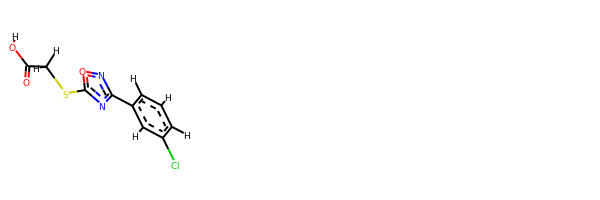

rdkit:  [H]OC(=O)C([H])([H])Sc1nc(-c2c([H])c([H])c([H])c(Cl)c2[H])no1
oechem:  c1cc(cc(c1)Cl)c2nc(on2)SCC(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

#########################################################################

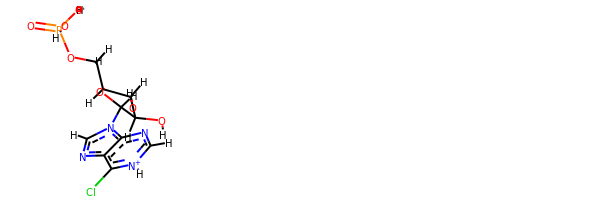

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c(Cl)[n+]([H])c([H])nc32)OC([H])(C([H])([H])OP(=O)(O[H])O[H])C1([H])O[H]
oechem:  c1[nH+]c(c2c(n1)n(cn2)C3C(C(C(O3)COP(=O)(O)O)O)O)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
15.692054179526544 kJ/mol 57767.96175802501 kJ/mol False
angle
114.66645855637447 kJ/mol 114.66645855637447 kJ/mol True
nb
27.567975035842995 kJ/mol 27.567975035842995 kJ/mol True
torsion
75.99380778926783 kJ/mol 75.99382231538912 kJ/mol False
233.92029556101184 kJ/mol 57986.19001393262 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3562


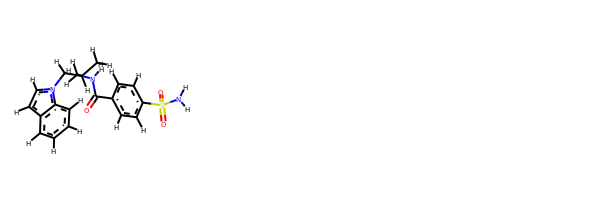

rdkit:  [H]c1c([H])c(S(=O)(=O)N([H])[H])c([H])c([H])c1C(=O)N([H])C([H])([H])C([H])(C([H])([H])[H])C([H])([H])n1c([H])c([H])c2c([H])c([H])c([H])c([H])c21
oechem:  CC(CNC(=O)c1ccc(cc1)S(=O)(=O)N)Cn2ccc3c2cccc3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
19.935493532666705 kJ/mol 57999.30987990468 kJ/mol False
angle
401.046782088658 kJ/mol 401.046782088658 kJ/mol True
nb
14.699062268544084 kJ/mol 14.699062268544084 kJ/mol True
torsion
104.38239783508338 kJ/mol 80.28036177310432 kJ/mol False
540.0637357249523 kJ/mol 58495.33608603498 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3564


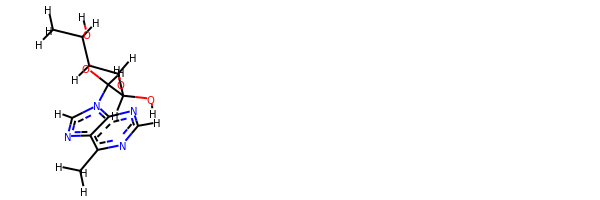

rdkit:  [H]OC([H])(C([H])([H])[H])C1([H])OC([H])(n2c([H])nc3c(C([H])([H])[H])nc([H])nc32)C([H])(O[H])C1([H])O[H]
oechem:  Cc1c2c(ncn1)n(cn2)C3C(C(C(O3)C(C)O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

#######################

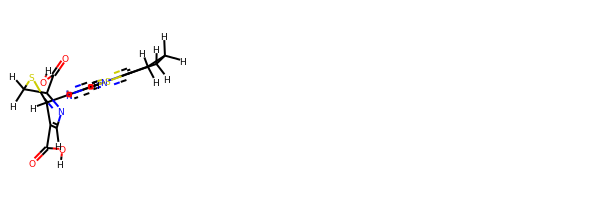

rdkit:  [H]OC(=O)C1=NC([H])=C(C(=O)O[H])C([H])(c2nc3sc4c(n3c2[H])C([H])([H])C([H])([H])C4([H])[H])SC1([H])[H]
oechem:  c1c(nc2n1c3c(s2)CCC3)C4C(=CN=C(CS4)C(=O)O)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
76.88157281273573 kJ/mol 226956.31438601736 kJ/mol False
angle
143.13225121191394 kJ/mol 143.82516849999206 kJ/mol False
nb
7.612984643971552 kJ/mol 7.612984643971552 kJ/mol True
torsion
95.42384195435089 kJ/mol 37.713187429082765 kJ/mol False
323.0506506229721 kJ/mol 227145.4657265904 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3582


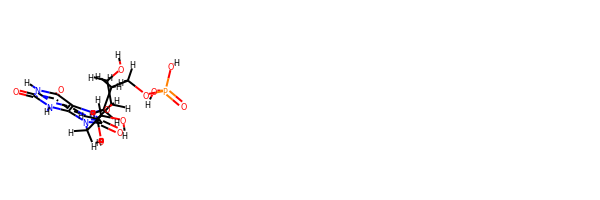

rdkit:  [H]OC([H])([H])C([H])(O[H])C([H])(O[H])C([H])(O[H])C([H])([H])n1c(=O)n(C([H])([H])C([H])([H])C([H])([H])OP(=O)(O[H])O[H])c2c(=O)n([H])c(=O)n([H])c21
oechem:  C(Cn1c2c([nH]c(=O)[nH]c2=O)n(c1=O)CC(C(C(CO)O)O)O)COP(=O)(O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
12.506664164603345 kJ/mol 58034.35061967896 kJ/mol False
angle
103.67187046986386 kJ/mo

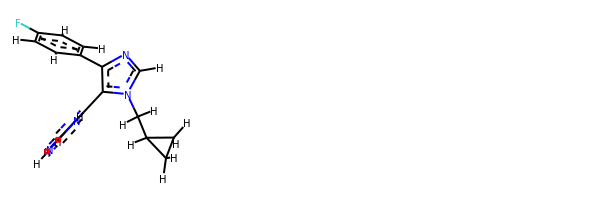

rdkit:  [H]c1nc(N([H])[H])nc(-c2c(-c3c([H])c([H])c(F)c([H])c3[H])nc([H])n2C([H])([H])C2([H])C([H])([H])C2([H])[H])c1[H]
oechem:  c1cc(ccc1c2c(n(cn2)CC3CC3)c4ccnc(n4)N)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
24.33336687295453 kJ/mol 56241.76679619949 kJ/mol False
angle
392.38572327678753 kJ/mol 392.38572327678753 kJ/mol True
nb
13.386897979266921 kJ/mo

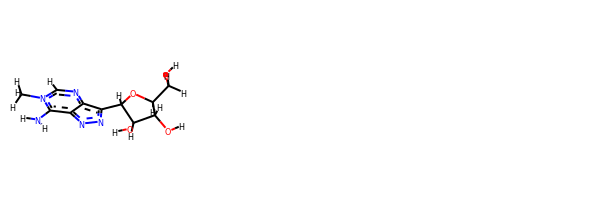

rdkit:  [H]OC([H])([H])C1([H])OC([H])(c2nnc3c(N([H])[H])n(C([H])([H])[H])c([H])nc2-3)C([H])(O[H])C1([H])O[H]
oechem:  Cn1cnc-2c(nnc2c1N)C3C(C(C(O3)CO)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

##############################

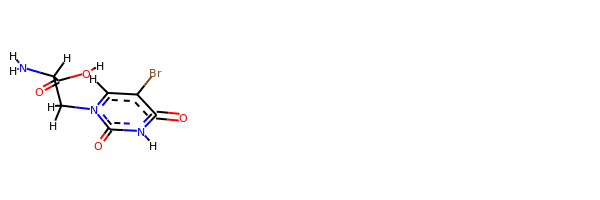

rdkit:  [H]OC(=O)C([H])(N([H])[H])C([H])([H])n1c([H])c(Br)c(=O)n([H])c1=O
oechem:  c1c(c(=O)[nH]c(=O)n1CC(C(=O)O)N)Br
###########################################################################
 #########################################################

bond
22.269847720538113 kJ/mol 57774.17519438734 kJ/mol False
angle
116.97115144080911 kJ/mol 118.20116734666692 kJ/mol False
nb
63.2273585641274 kJ/mol 63.2273585641274 kJ/mol True
torsion
33.8949764503795 kJ/mol 33.89500931397506 kJ/mol False
236.36333417585413 kJ/mol 57989.49872961211 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3609


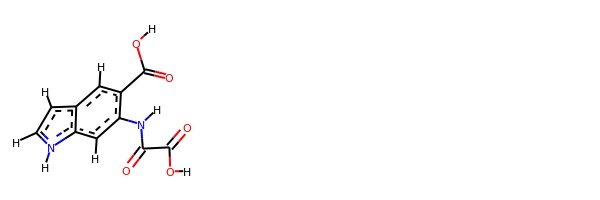

rdkit:  [H]OC(=O)C(=O)N([H])c1c(C(=O)O[H])c([H])c2c([H])c([H])n([H])c2c1[H]
oechem:  c1c[nH]c2c1cc(c(c2)NC(=O)C(=O)O)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
13.070556737037133 kJ/mol 57134.35678975456 kJ/mol False
angle
18.05822593786407 kJ/mol 18.319938717275676 kJ/mol False
nb
34.760725243661255 kJ/mol 34.760725243661255 kJ/mol True
torsion
44.93454929117686 kJ/mol 11.462572373673451 kJ/mol False
110.82405720973932 kJ/mol 57198.90002608918 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
------------------------------

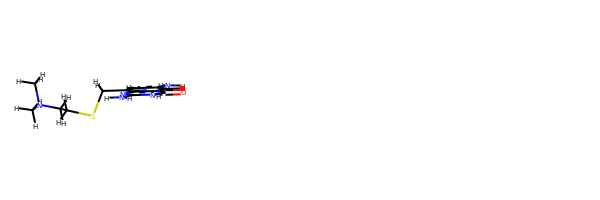

rdkit:  [H]c1c(N([H])[H])c([H])c2c(=O)n([H])c(N([H])[H])nc2c1C([H])([H])SC([H])([H])C([H])([H])N(C([H])([H])[H])C([H])([H])[H]
oechem:  CN(C)CCSCc1cc(cc2c1nc([nH]c2=O)N)N
###########################################################################
 #########################################################

bond
53.71203069780177 kJ/mol 113324.73356698768 kJ/mol False
angle
421.9486733906067 kJ/mol 422.537197401864 kJ/mol False
nb
-1.3556667741814332 kJ/mol -1.3556667741814332 kJ/mol True
torsion
132.61147131110496 kJ/mol 75.58617510708032 kJ/mol False
606.916508625332 kJ/mol 113821.50127272244 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3613


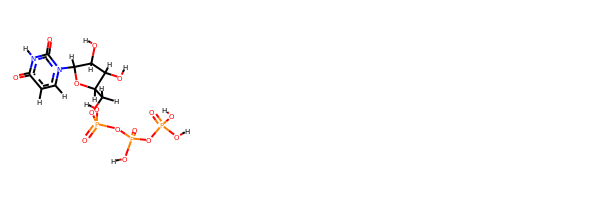

rdkit:  [H]OC1([H])C([H])(n2c([H])c([H])c(=O)n([H])c2=O)OC([H])(C([H])([H])OP(=O)(O[H])OP(=O)(O[H])OP(=O)(O[H])O[H])C1([H])O[H]
oechem:  c1cn(c(=O)[nH]c1=O)C2C(C(C(O2)COP(=O)(O)OP(=O)(O)OP(=O)(O)O)O)O
###########################################################################
 #########################################################

bond
19.98313428475392 kJ/mol 85818.64145143273 kJ/mol False
angle
86.7922750940314 kJ/mol 86.7922750940314 kJ/mol True
nb
40.67589693865661 kJ/mol 40.67589693865661 kJ/mol True
torsion
39.71501352593205 kJ/mol 16.88897127196585 kJ/mol False
187.16631984337397 kJ/mol 85962.9985947374 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3614


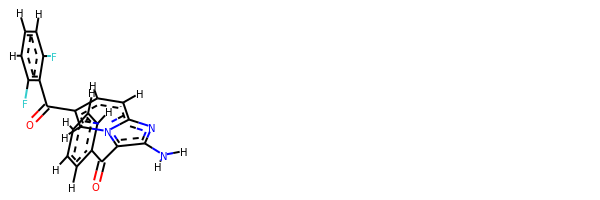

rdkit:  [H]c1c([H])c([H])c(C(=O)c2c(N([H])[H])nc3c([H])c([H])c(C(=O)c4c(F)c([H])c([H])c([H])c4F)c([H])n23)c([H])c1[H]
oechem:  c1ccc(cc1)C(=O)c2c(nc3n2cc(cc3)C(=O)c4c(cccc4F)F)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
17.062081712932905 kJ/mol 57932.174153366985 kJ/mol False
angle
79.55101666539065 kJ/mol 81.4584986561777 kJ/mol False
nb
75.91527463827128 kJ/mol 75.91527463827128 kJ/mol True
torsion
18.84147093511378 kJ/mol 21.976466001826623 kJ/mol False
191.36984395170862 kJ/mol 58111.524392663254 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3617


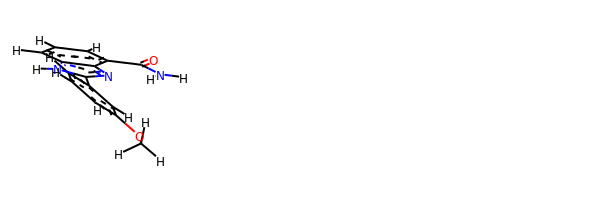

rdkit:  [H]c1c([H])c(OC([H])([H])[H])c([H])c(-c2nc3c(C(=O)N([H])[H])c([H])c([H])c([H])c3n2[H])c1[H]
oechem:  COc1cccc(c1)c2[nH]c3cccc(c3n2)C(=O)N
###########################################################################
 #########################################################

bond
8.689907333045888 kJ/mol 115839.4527273448 kJ/mol False
angle
159.90098817746343 kJ/mol 163.7142809610434 kJ/mol False
nb
78.33597041476293 kJ/mol 78.33597041476293 kJ/mol True
torsion
23.45664235119857 kJ/mol 29.731666334722473 kJ/mol False
270.3835082764708 kJ/mol 116111.23464505532 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3618


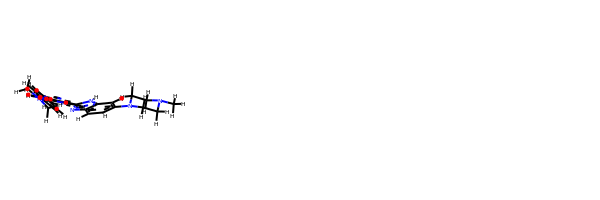

rdkit:  [H]c1c([H])c(N(C([H])([H])[H])C([H])([H])[H])c([H])c([H])c1-c1nc2c([H])c(-c3nc4c([H])c([H])c(N5C([H])([H])C([H])([H])N(C([H])([H])[H])C([H])([H])C5([H])[H])c([H])c4n3[H])c([H])c([H])c2n1[H]
oechem:  CN1CCN(CC1)c2ccc3c(c2)[nH]c(n3)c4ccc5c(c4)nc([nH]5)c6ccc(cc6)N(C)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
22.984631146563245 kJ/mol 57666.723940198346 kJ/mol False
angle
130.6450977886709 kJ/mol 131.72433809887386 kJ/mol False
nb
35.80043138659846 kJ/mol 35.80043138659846 kJ/mol True
torsion
30.454401259314444 kJ/mol 28.920501633764324 kJ/mol False
219.88456158114704 kJ/mol 57863.16921131758 kJ/mol

----------------

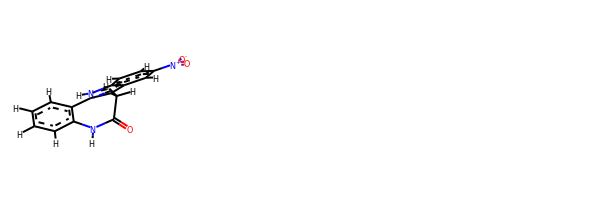

rdkit:  [H]c1c([H])c([H])c2c(c1[H])-c1c(c3c([H])c([N+](=O)[O-])c([H])c([H])c3n1[H])C([H])([H])C(=O)N2[H]
oechem:  c1ccc2c(c1)-c3c(c4cc(ccc4[nH]3)[N+](=O)[O-])CC(=O)N2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
30.992580452

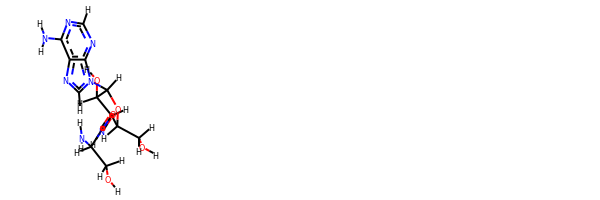

rdkit:  [H]OC([H])([H])C([H])(C(=O)N([H])C1([H])C([H])(C([H])([H])O[H])OC([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)C1([H])O[H])N([H])[H]
oechem:  c1nc(c2c(n1)n(cn2)C3C(C(C(O3)CO)NC(=O)C(CO)N)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
21.23220166119187 kJ/mol 57799.809760627984 kJ/mol False
angle
118.54951805493496 kJ/mol 118.54951805493496 kJ/mol True
n

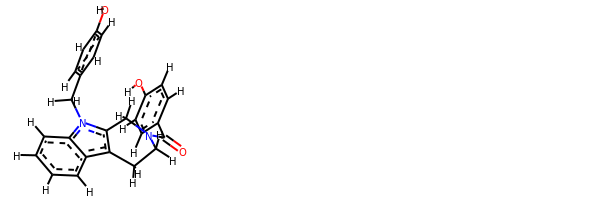

rdkit:  [H]Oc1c([H])c([H])c(C(=O)N2C([H])([H])c3c(c4c([H])c([H])c([H])c([H])c4n3C([H])([H])c3c([H])c([H])c(O[H])c([H])c3[H])C([H])([H])C2([H])[H])c([H])c1[H]
oechem:  c1ccc2c(c1)c3c(n2Cc4ccc(cc4)O)CN(CC3)C(=O)c5ccc(cc5)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
82014.4613575664 kJ/mol 125685.71131230815 kJ/mol False
angle
73.93994552163883 kJ/mol 77.29841170680486 kJ/mol False
nb
175.5457244395464 kJ/mol 175.5457244395464 kJ/mol True
torsion
53.030028755390546 kJ/mol 36.20072447106737 kJ

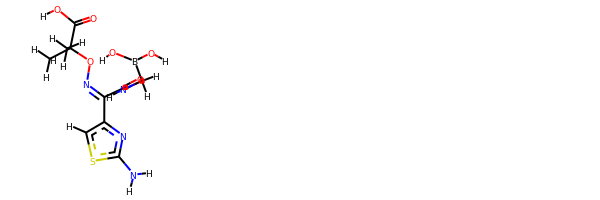

rdkit:  [H]OB(O[H])C([H])([H])N([H])C(=O)C(=NOC(C(=O)O[H])(C([H])([H])[H])C([H])([H])[H])c1nc(N([H])[H])sc1[H]
oechem:  B(CNC(=O)C(=NOC(C)(C)C(=O)O)c1csc(n1)N)(O)O
###########################################################################
 #########################################################

bond
9.845777484024525 kJ/mol 5.911906231287447 kJ/mol False
angle
89.10735195235038 kJ/mol 89.30101218229464 kJ/mol False
nb
29.38907543734635 kJ/mol 29.38907543734635 kJ/mol True
torsion
31.625689878835384 kJ/mol 21.16567094940321 kJ/mol False
159.96789475255665 kJ/mol 145.76766480033166 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3642


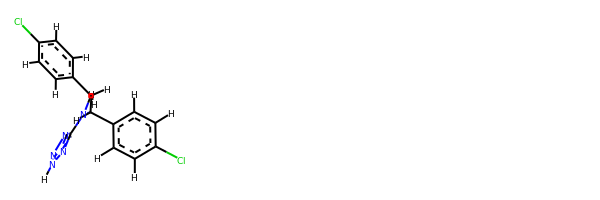

rdkit:  [H]c1c([H])c(C([H])([H])N(c2nnn([H])n2)C([H])([H])c2c([H])c([H])c(Cl)c([H])c2[H])c([H])c([H])c1Cl
oechem:  c1cc(ccc1CN(Cc2ccc(cc2)Cl)c3n[nH]nn3)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
55.57995515754481 kJ/mol 43842.630170781056 kJ/mol False
angle
117.77082466057388 kJ/mol 119.92246659839506 kJ/mol False
nb
36.96891980995281 kJ/mol 36.96891980995281 kJ/mol True
torsion
177.80642870324266 kJ/mol 166.18506718480694 kJ/mol False
388.12612833131413 kJ/mol 44165.70662437421 kJ/mol


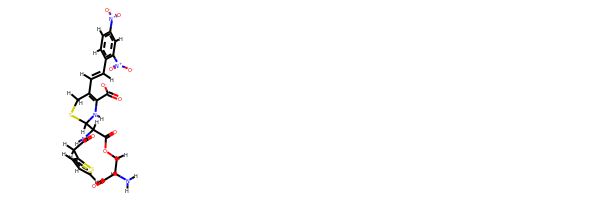

rdkit:  [H]C(=C([H])c1c([H])c([H])c([N+](=O)[O-])c([H])c1[N+](=O)[O-])C1=C(C(=O)[O-])N([H])C([H])(C([H])(C(=O)OC([H])([H])C([H])(C(=O)[O-])N([H])[H])N([H])C(=O)C([H])([H])c2sc([H])c([H])c2[H])SC1([H])[H]
oechem:  c1cc(sc1)CC(=O)NC(C2NC(=C(CS2)C=Cc3ccc(cc3[N+](=O)[O-])[N+](=O)[O-])C(=O)[O-])C(=O)OCC(C(=O)[O-])N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
19.514199659636336 kJ/mol 57063.7500966821 kJ/mol False
angle
85.37576078812381 kJ/mol 85.61129021906416 kJ/mol False
nb
24.225301430216586

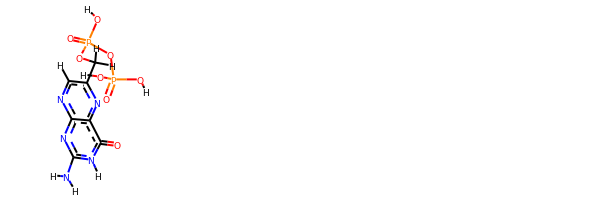

rdkit:  [H]OP(=O)(O[H])OP(=O)(O[H])OC([H])([H])c1nc2c(=O)n([H])c(N([H])[H])nc2nc1[H]
oechem:  c1c(nc2c(=O)[nH]c(nc2n1)N)COP(=O)(O)OP(=O)(O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################

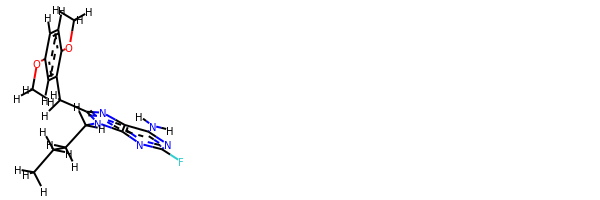

rdkit:  [H]c1c([H])c(OC([H])([H])[H])c(C([H])([H])c2nc3c(N([H])[H])nc(F)nc3n2C([H])([H])C([H])([H])C([H])([H])C([H])([H])[H])c([H])c1OC([H])([H])[H]
oechem:  CCCCn1c(nc2c1nc(nc2N)F)Cc3cc(ccc3OC)OC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
31.5973842431381 kJ/mol 57573.28766316371 kJ/mol False
angle
331.9786492636291 kJ/mol 332.1650835299241 kJ/mol False
nb
20.30633317405326 kJ/mol 20.30633317405326 kJ/mol True
torsion
76.03565475410507 kJ/mol 59.29973877769981 kJ/mol False
459.91802143492

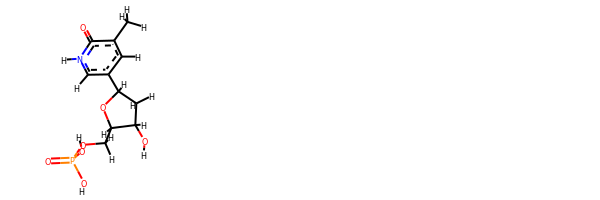

rdkit:  [H]OC1([H])C([H])([H])C([H])(c2c([H])c(C([H])([H])[H])c(=O)n([H])c2[H])OC1([H])C([H])([H])OP(=O)(O[H])O[H]
oechem:  Cc1cc(c[nH]c1=O)C2CC(C(O2)COP(=O)(O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

####################

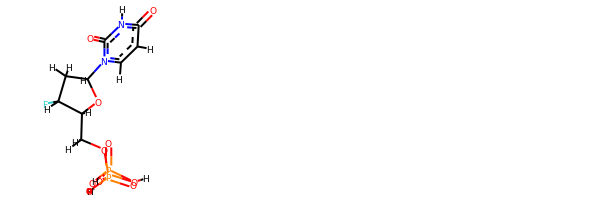

rdkit:  [H]OP(=O)(O[H])OP(=O)(O[H])OC([H])([H])C1([H])OC([H])(n2c([H])c([H])c(=O)n([H])c2=O)C([H])([H])C1([H])F
oechem:  c1cn(c(=O)[nH]c1=O)C2CC(C(O2)COP(=O)(O)OP(=O)(O)O)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########

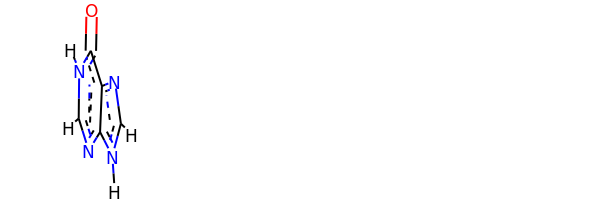

rdkit:  [H]c1nc2c(nc([H])n2[H])c(=O)n1[H]
oechem:  c1[nH]c2c(n1)c(=O)[nH]cn2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
14.479554492447134 kJ/mol 44146.35747749477 kJ/mol False
angle
116.21045039427985 kJ/mol 118.55843420511641 kJ/mol False
nb
1.3649938625641491 kJ/mol 1.3649938625641491 kJ/mol True
torsion
132.70391445365982 kJ/mol 132.76842488208158 kJ/mol False
264.75891320295096 kJ/mol 44399.04933044453 kJ/mol

-------------------------------------------------------------------
-------

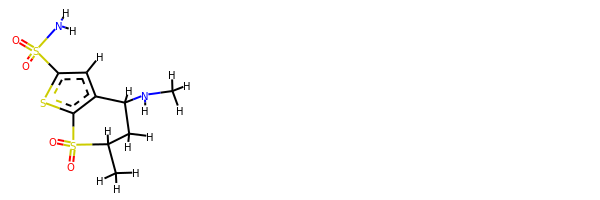

rdkit:  [H]c1c(S(=O)(=O)N([H])[H])sc2c1C([H])(N([H])C([H])([H])[H])C([H])([H])C([H])(C([H])([H])[H])S2(=O)=O
oechem:  CC1CC(c2cc(sc2S1(=O)=O)S(=O)(=O)N)NC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

#############################

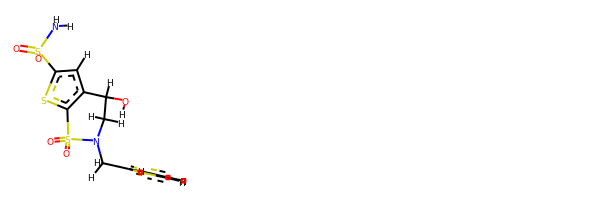

rdkit:  [H]OC1([H])c2c(sc(S(=O)(=O)N([H])[H])c2[H])S(=O)(=O)N(C([H])([H])c2sc([H])c([H])c2[H])C1([H])[H]
oechem:  c1cc(sc1)CN2CC(c3cc(sc3S2(=O)=O)S(=O)(=O)N)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

#########################

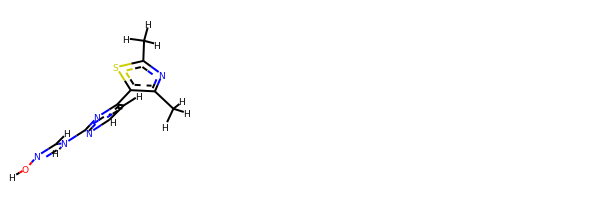

rdkit:  [H]ON=C([H])N([H])c1nc([H])c([H])c(-c2sc(C([H])([H])[H])nc2C([H])([H])[H])n1
oechem:  Cc1c(sc(n1)C)c2ccnc(n2)NC=NO
###########################################################################
 #########################################################

bond
23.485658573054078 kJ/mol 58004.42341154869 kJ/mol False
angle
412.5568309274092 kJ/mol 412.5568309274092 kJ/mol True
nb
9.56055237835908 kJ/mol 9.56055237835908 kJ/mol True
torsion
82.87966382369166 kJ/mol 58.77477750956436 kJ/mol False
528.482705702514 kJ/mol 58485.31557236402 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3705


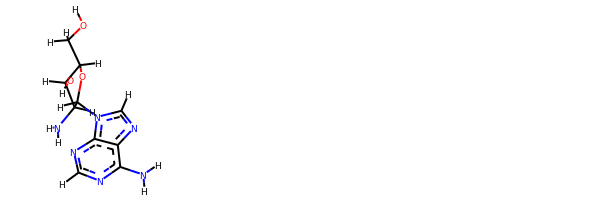

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)C([H])(N([H])[H])C1([H])O[H]
oechem:  c1nc(c2c(n1)n(cn2)C3C(C(C(O3)CO)O)N)N
###########################################################################
 #########################################################

bond
53.54495218832783 kJ/mol 57760.661293864265 kJ/mol False
angle
16.846993544764963 kJ/mol 17.096573661818297 kJ/mol False
nb
19.102559228849064 kJ/mol 19.102559228849064 kJ/mol True
torsion
39.7479846458634 kJ/mol 0.0002059236638129181 kJ/mol False
129.24248960780525 kJ/mol 57796.860632678596 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3706


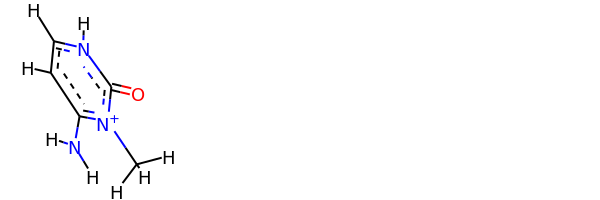

rdkit:  [H]c1c([H])n([H])c(=O)[n+](C([H])([H])[H])c1N([H])[H]
oechem:  C[n+]1c(cc[nH]c1=O)N
###########################################################################
 #########################################################

bond
5.59752093402175 kJ/mol 57426.693161524294 kJ/mol False
angle
90.70058875837097 kJ/mol 90.70058875837097 kJ/mol True
nb
16.194740058065285 kJ/mol 16.194740058065285 kJ/mol True
torsion
0.1099986064740953 kJ/mol 0.3537471679056814 kJ/mol False
112.6028483569321 kJ/mol 57533.94223750864 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3707


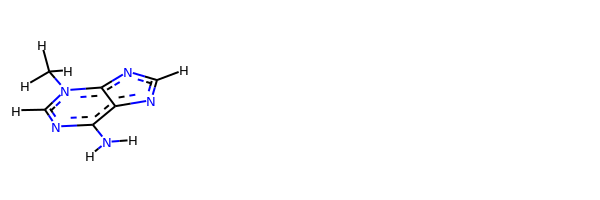

rdkit:  [H]c1nc2c(N([H])[H])nc([H])n(C([H])([H])[H])c-2n1
oechem:  Cn1cnc(c-2ncnc12)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #####################

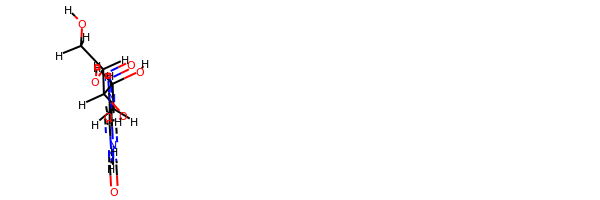

rdkit:  [H]OC([H])([H])C([H])(O[H])C([H])(O[H])C([H])(O[H])C([H])([H])N([H])c1c(N=O)c(=O)n([H])c(=O)n1[H]
oechem:  C(C(C(C(CO)O)O)O)Nc1c(c(=O)[nH]c(=O)[nH]1)N=O
###########################################################################
 #########################################################

bond
28.62732528982566 kJ/mol 113797.76570094627 kJ/mol False
angle
50.3222521112913 kJ/mol 50.911558902958674 kJ/mol False
nb
15.348161921789469 kJ/mol 15.348161921789469 kJ/mol True
torsion
43.97777213066173 kJ/mol 7.776145064278554 kJ/mol False
138.27551145356813 kJ/mol 113871.80156683529 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3732


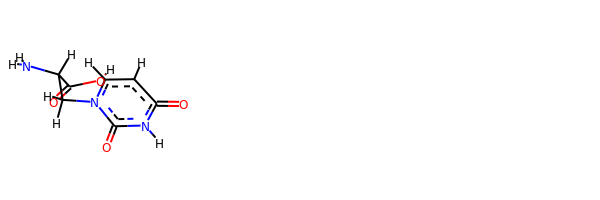

rdkit:  [H]OC(=O)C([H])(N([H])[H])C([H])([H])n1c([H])c([H])c(=O)n([H])c1=O
oechem:  c1cn(c(=O)[nH]c1=O)CC(C(=O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
19.46236727990766 kJ/mol 43807.648432937036 kJ/mol False
angle
79.05731155272208 kJ/mol 81.21062118979333 kJ/mol False
nb
17.738190795220476 kJ/mol 17.738190795220476 kJ/mol True
torsion
48.956646496164694 kJ/mol 42.69750790521248 kJ/mol False
165.21451612401492 kJ/mol 43949.29475282726 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
----------------------------------------

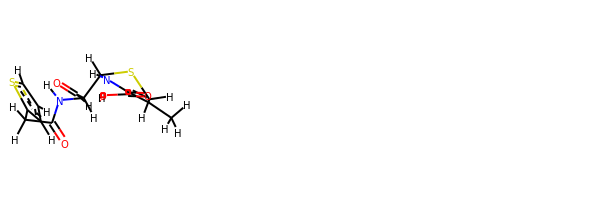

rdkit:  [H]OC(=O)C1=C(C([H])([H])[H])C([H])([H])SC([H])(C([H])(C([H])=O)N([H])C(=O)C([H])([H])c2sc([H])c([H])c2[H])N1[H]
oechem:  CC1=C(NC(SC1)C(C=O)NC(=O)Cc2cccs2)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
21.232314723894323 kJ/mol 114564.88003401294 kJ/mol False
angle
30.739608848565517 kJ/mol 31.44032641735847 kJ/mol False
nb
29.437799635543946 kJ/mol 29.437799635543946 kJ/mol True
torsion
54.45612260053409 kJ/mol 3.5477362719469543 kJ/mol False
135.86584580853787 kJ/mol 114629.3

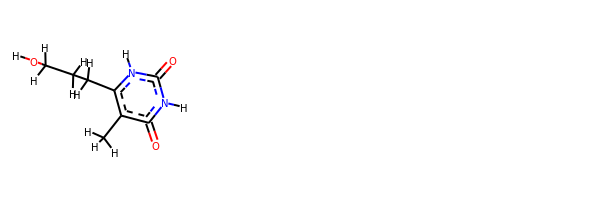

rdkit:  [H]OC([H])([H])C([H])([H])C([H])([H])c1c(C([H])([H])[H])c(=O)n([H])c(=O)n1[H]
oechem:  Cc1c([nH]c(=O)[nH]c1=O)CCCO
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
20.856415540565283 kJ/mol 58305.72932882439 kJ/mol False
angle
119.88746424183886 kJ/mol 119.88746424183886 kJ/mol True
nb
18.88571177889109 kJ/mol 18.88571177889109 kJ/mol True
torsion
93.40403905635856 kJ/mol 88.11398909078028 kJ/mol False
253.03363061765378 kJ/mol 58532.6164939359 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-----------------------------------

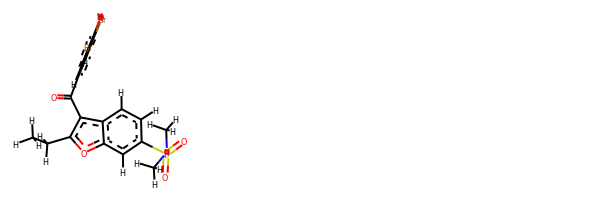

rdkit:  [H]Oc1c(Br)c([H])c(C(=O)c2c(C([H])([H])C([H])([H])[H])oc3c([H])c(S(=O)(=O)N(C([H])([H])[H])C([H])([H])[H])c([H])c([H])c23)c([H])c1Br
oechem:  CCc1c(c2ccc(cc2o1)S(=O)(=O)N(C)C)C(=O)c3cc(c(c(c3)Br)O)Br
###########################################################################
 #########################################################

bond
15.946500328464627 kJ/mol 57767.17077320717 kJ/mol False
angle
116.80890508308089 kJ/mol 118.03827246661201 kJ/mol False
nb
7.204340977989481 kJ/mol 7.204340977989481 kJ/mol True
torsion
28.232167948460116 kJ/mol 28.232175051352748 kJ/mol False
168.19191433799512 kJ/mol 57920.645561703124 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3744


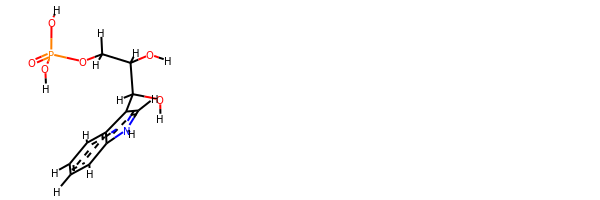

rdkit:  [H]OC([H])(c1c([H])n([H])c2c([H])c([H])c([H])c([H])c12)C([H])(O[H])C([H])([H])OP(=O)(O[H])O[H]
oechem:  c1ccc2c(c1)c(c[nH]2)C(C(COP(=O)(O)O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

################################

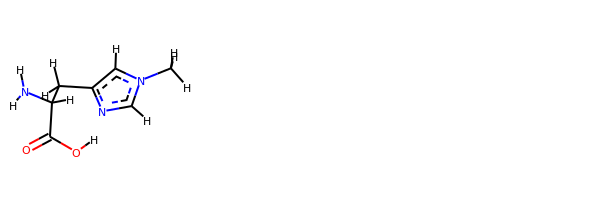

rdkit:  [H]OC(=O)C([H])(N([H])[H])C([H])([H])c1nc([H])n(C([H])([H])[H])c1[H]
oechem:  Cn1cc(nc1)CC(C(=O)O)N
###########################################################################
 #########################################################

bond
14.34443554361049 kJ/mol 85654.92046475939 kJ/mol False
angle
170.13867525547644 kJ/mol 172.46281237228274 kJ/mol False
nb
19.317799094235227 kJ/mol 19.317799094235227 kJ/mol True
torsion
25.7693069298823 kJ/mol 25.74515033490269 kJ/mol False
229.57021682320448 kJ/mol 85872.4462265608 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3752


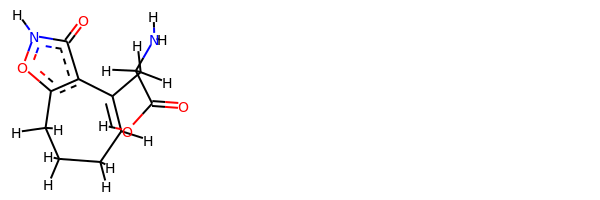

rdkit:  [H]OC(=O)C([H])(N([H])[H])C([H])([H])C1=C([H])C([H])([H])C([H])([H])C([H])([H])c2on([H])c(=O)c21
oechem:  C1CC=C(c2c(o[nH]c2=O)C1)CC(C(=O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
42.58272344908399 kJ/mol 57948.4185394903 kJ/mol False
angle
88.28739794897415 kJ/mol 88.28739794897415 kJ/mol True
nb
62.228526420385 kJ/mol 62.228526420385 kJ/mol True
torsion
25.76522664779212 kJ/mol 33.02968092187125 kJ/mol False
218.86387446623527 kJ/mol 58131.96414478153 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3754


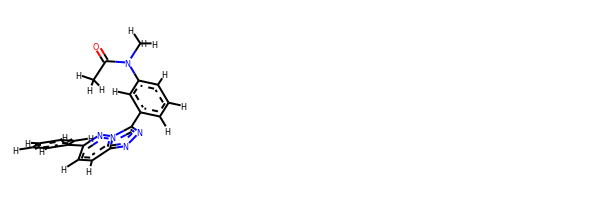

rdkit:  [H]c1c([H])c([H])c(-c2nn3c(-c4c([H])c([H])c([H])c(N(C(=O)C([H])([H])[H])C([H])([H])[H])c4[H])nnc3c([H])c2[H])c([H])c1[H]
oechem:  CC(=O)N(C)c1cccc(c1)c2nnc3n2nc(cc3)c4ccccc4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
43.37438444480463 kJ/mol 114231.32833183992 kJ/mol False
angle
39.59578967048666 kJ/mol 40.42799568365756 kJ/mol False
nb
24.52762365

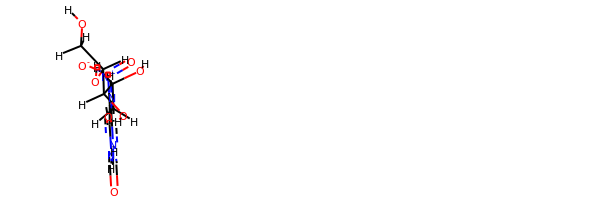

rdkit:  [H]OC([H])([H])C([H])(O[H])C([H])(O[H])C([H])(O[H])C([H])([H])N([H])c1c([N+](=O)[O-])c(=O)n([H])c(=O)n1[H]
oechem:  C(C(C(C(CO)O)O)O)Nc1c(c(=O)[nH]c(=O)[nH]1)[N+](=O)[O-]
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond


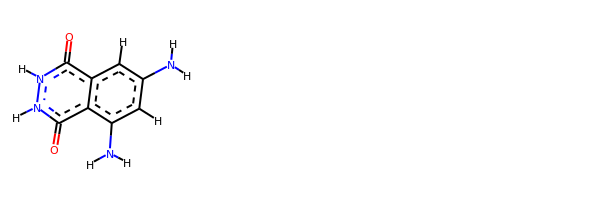

rdkit:  [H]c1c(N([H])[H])c([H])c2c(=O)n([H])n([H])c(=O)c2c1N([H])[H]
oechem:  c1c(cc(c2c1c(=O)[nH][nH]c2=O)N)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
10.383075093309934 kJ/mol 57762.288421760124 kJ/mol False
angle
96.16112518526268 kJ/mol 97.39299894679111 kJ/mol False
nb
30.917883489825005 kJ/mol 30.917883489825005 kJ/mol True
torsion
18.567484900784045 kJ/mol 16.057099083981146 kJ/mol False
156.02956866918169 kJ/mol 57906.65640328073 kJ/mol

------------------------------------------

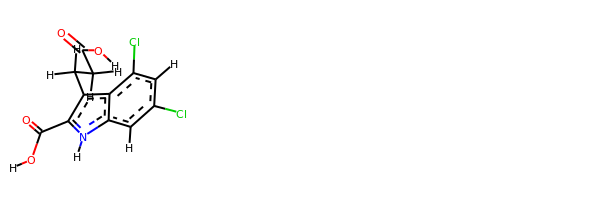

rdkit:  [H]OC(=O)c1c(C([H])([H])C([H])([H])C(=O)O[H])c2c(Cl)c([H])c(Cl)c([H])c2n1[H]
oechem:  c1c(cc(c2c1[nH]c(c2CCC(=O)O)C(=O)O)Cl)Cl
###########################################################################
 #########################################################

bond
30.114758715132538 kJ/mol 57945.30079447747 kJ/mol False
angle
398.3426852363804 kJ/mol 398.3426852363804 kJ/mol True
nb
27.512182748819686 kJ/mol 27.512182748819686 kJ/mol True
torsion
98.2951379228492 kJ/mol 74.18484973673466 kJ/mol False
554.2647646231818 kJ/mol 58445.3405121994 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3776


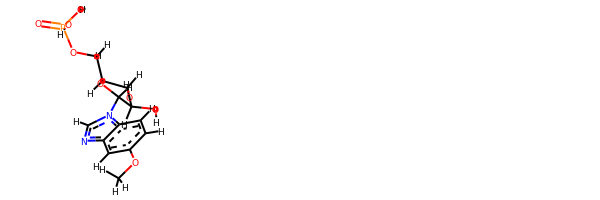

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c([H])c(OC([H])([H])[H])c([H])c([H])c32)OC([H])(C([H])([H])OP(=O)(O[H])O[H])C1([H])O[H]
oechem:  COc1ccc2c(c1)ncn2C3C(C(C(O3)COP(=O)(O)O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
8.192196868355076 kJ/mol 58293.065110152165 kJ/mol False
angle
89.97753231040448 kJ/mol 89.97753231040448 kJ/mol True
nb
11.925037840941384 kJ/mol 11.925037840941384 kJ/mol True
torsion
0.00016657216011774394 kJ/mol 0.00015130452072561942 kJ/mol False
110.09493359186105 kJ/mol 58394.96783160803 kJ/mol

-------------------------------------------------------------------
-------------------------------------

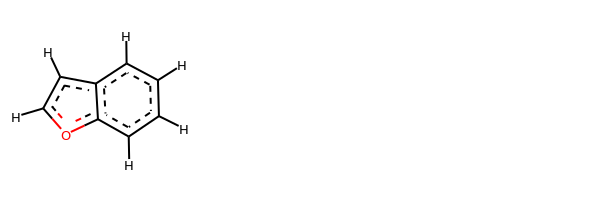

rdkit:  [H]c1oc2c([H])c([H])c([H])c([H])c2c1[H]
oechem:  c1ccc2c(c1)cco2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
33.82805720481254 kJ/mol 43705.04271846213 kJ/mol False
angle
111.08168575923095 kJ/mol 114.43791118588041 kJ/mol False
nb
79.5382385151095 kJ/mol 79.5382385151095 kJ/mol True
torsion
74.22109956671012 kJ/mol 57.39195300060222 kJ/mol False
298.6690810458631 kJ/mol 43956.41082116372 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3781


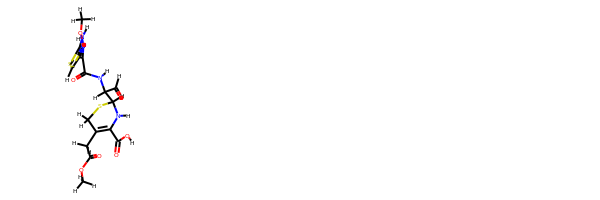

rdkit:  [H]OC(=O)C1=C(C([H])([H])C(=O)OC([H])([H])[H])C([H])([H])SC([H])(C([H])(C([H])=O)N([H])C(=O)C(=NOC([H])([H])[H])c2nc(N([H])[H])sc2[H])N1[H]
oechem:  COC(=O)CC1=C(NC(SC1)C(C=O)NC(=O)C(=NOC)c2csc(n2)N)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #############################

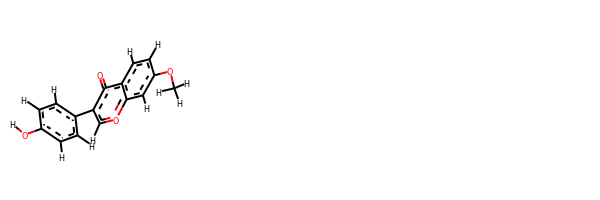

rdkit:  [H]Oc1c([H])c([H])c(-c2c([H])oc3c([H])c(OC([H])([H])[H])c([H])c([H])c3c2=O)c([H])c1[H]
oechem:  COc1ccc2c(c1)occ(c2=O)c3ccc(cc3)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
55.39525020169414 kJ/mol 113467.43792431614 kJ/mol False
angle
361.33662035659313 kJ/mol 361.95692140417265 kJ/mol False
nb
19.976047975216126 kJ/mol 19.976047975216126 kJ/mol True
torsion
132.93929960403565 kJ/mol 75.8734315277437 kJ/mol False
569.6472181375391 kJ/mol 113925.24432522326 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3801


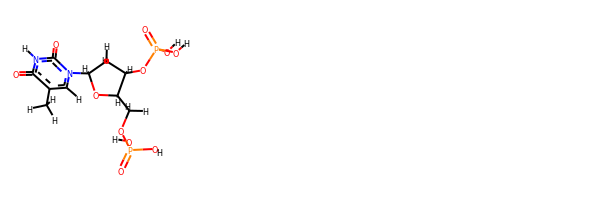

rdkit:  [H]OP(=O)(O[H])OC([H])([H])C1([H])OC([H])(n2c([H])c(C([H])([H])[H])c(=O)n([H])c2=O)C([H])([H])C1([H])OP(=O)(O[H])O[H]
oechem:  Cc1cn(c(=O)[nH]c1=O)C2CC(C(O2)COP(=O)(O)O)OP(=O)(O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #######################################################

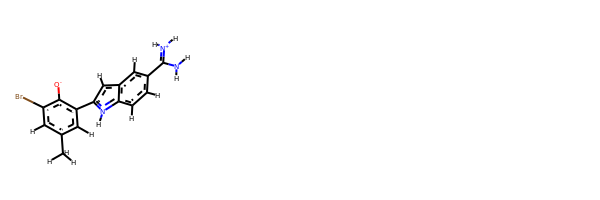

rdkit:  [H]c1c(Br)c([O-])c(-c2c([H])c3c([H])c(C(N([H])[H])=[N+]([H])[H])c([H])c([H])c3n2[H])c([H])c1C([H])([H])[H]
oechem:  Cc1cc(c(c(c1)Br)[O-])c2cc3cc(ccc3[nH]2)C(=[NH2+])N
###########################################################################
 #########################################################

bond
15.65270127723276 kJ/mol 57543.77175921337 kJ/mol False
angle
15.627056787584912 kJ/mol 15.627056787584912 kJ/mol True
nb
51.06945020915165 kJ/mol 51.06945020915165 kJ/mol True
torsion
15.574142468498215 kJ/mol 15.573236660680752 kJ/mol False
97.92335074246753 kJ/mol 57626.04150287079 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3811


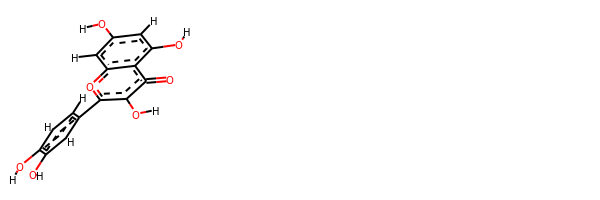

rdkit:  [H]Oc1c([H])c([H])c(-c2oc3c([H])c(O[H])c([H])c(O[H])c3c(=O)c2O[H])c([H])c1O[H]
oechem:  c1cc(c(cc1c2c(c(=O)c3c(cc(cc3o2)O)O)O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
19.448980018156565 kJ/mol 58003.760809253894 kJ/mol False
angle
390.20393267078543 kJ/mol 390.20393267078543 kJ/mol True
nb
7.47835485979821 kJ/mol 7.47835485979821 kJ/mol True
torsion
90.74683603468519 kJ/mol 66.63703845556303 kJ/mol False
507.87810358342546 kJ/mol 58468.08013524004 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3813


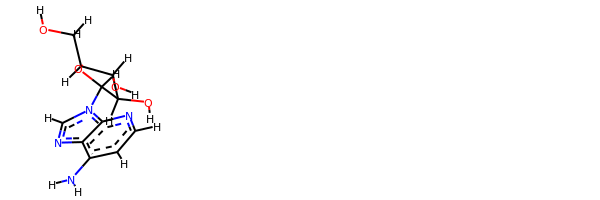

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])nc3c(N([H])[H])c([H])c([H])nc32)C([H])(O[H])C1([H])O[H]
oechem:  c1cnc2c(c1N)ncn2C3C(C(C(O3)CO)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
43.67360109167705 kJ/mol 114617.35834344903 kJ/mol False
angle
62.629144619157586 kJ/mol 63.3520628972647 kJ/mol False
nb
14.699530118887678 kJ/mol 14.699530118887678 kJ/mol True
torsion
86.5608446319086 kJ/mol 36.354266917625345 kJ/mol False
207.56312046163092 kJ/mol 114731.7642033828 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-----------

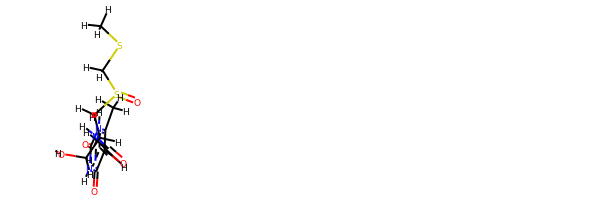

rdkit:  [H]OC([H])([H])C([H])(N([H])C(=O)C([H])=C([H])c1c(C([H])([H])[H])n([H])c(=O)n([H])c1=O)C([H])([H])S(=O)C([H])([H])SC([H])([H])[H]
oechem:  Cc1c(c(=O)[nH]c(=O)[nH]1)C=CC(=O)NC(CO)CS(=O)CSC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ###############################################

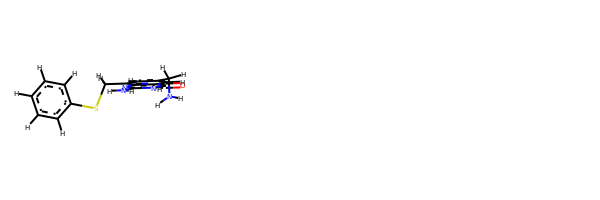

rdkit:  [H]c1c([H])c([H])c(SC([H])([H])c2c([H])c(C([H])([H])N([H])[H])c([H])c3c(=O)n([H])c(N([H])[H])nc23)c([H])c1[H]
oechem:  c1ccc(cc1)SCc2cc(cc3c2nc([nH]c3=O)N)CN
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
49.831276599118915 kJ/mol 113398.51790220037 kJ/mol False
angle
338.94387019293214 kJ/mol 339.56460971245826 kJ/mol False
nb
21.629417383294086 kJ/mol 21.629417383294086 kJ/mol True
torsion
130.7527197995482 kJ/mol 73.72693883274478 kJ/mol False
541.1572839748934 kJ/mol 113833.4388681

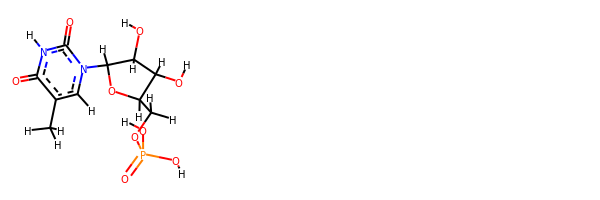

rdkit:  [H]OC1([H])C([H])(n2c([H])c(C([H])([H])[H])c(=O)n([H])c2=O)OC([H])(C([H])([H])OP(=O)(O[H])O[H])C1([H])O[H]
oechem:  Cc1cn(c(=O)[nH]c1=O)C2C(C(C(O2)COP(=O)(O)O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

#############

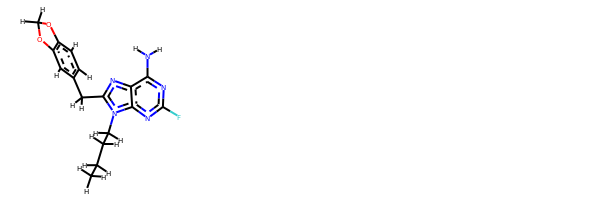

rdkit:  [H]c1c([H])c(C([H])([H])c2nc3c(N([H])[H])nc(F)nc3n2C([H])([H])C([H])([H])C([H])([H])C([H])([H])[H])c([H])c2c1OC([H])([H])O2
oechem:  CCCCn1c(nc2c1nc(nc2N)F)Cc3ccc4c(c3)OCO4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
32.95501094262817 kJ/mol 56979.852701774835 kJ/mol False
angle
469.15726892312887 kJ/mol 469.3860369974086 kJ/mol False
nb
2.953613936

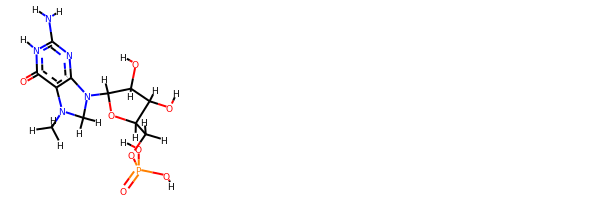

rdkit:  [H]OC1([H])C([H])(N2c3nc(N([H])[H])n([H])c(=O)c3N(C([H])([H])[H])C2([H])[H])OC([H])(C([H])([H])OP(=O)(O[H])O[H])C1([H])O[H]
oechem:  CN1CN(c2c1c(=O)[nH]c(n2)N)C3C(C(C(O3)COP(=O)(O)O)O)O
###########################################################################
 #########################################################

bond
43.48890019187042 kJ/mol 114171.58662063275 kJ/mol False
angle
153.7949903318831 kJ/mol 154.14683567919784 kJ/mol False
nb
14.914776588379082 kJ/mol 14.914776588379082 kJ/mol True
torsion
45.90147166068722 kJ/mol 7.768607583040953 kJ/mol False
258.10013877281983 kJ/mol 114348.41684048338 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3853


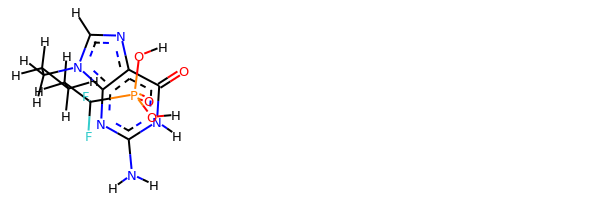

rdkit:  [H]OP(=O)(O[H])C(F)(F)C([H])([H])C([H])([H])C([H])([H])C([H])([H])n1c([H])nc2c(=O)n([H])c(N([H])[H])nc21
oechem:  c1nc2c(=O)[nH]c(nc2n1CCCCC(F)(F)P(=O)(O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
28.17058632232577 kJ/mol 113888.67282426562 kJ/mol False
angle
56.59344602366374 kJ/mol 57.07823739791545 kJ/mol False
nb
47.05814006234363 kJ/mol 47.05814006234363 kJ/mol True
torsion
65.64197149958476 kJ/mol 29.472584619221813 kJ/mol False
197.4641439079179 kJ/mol 114022.2817863451 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3855


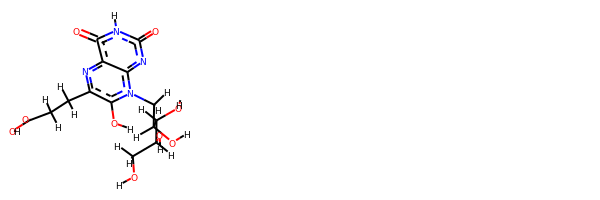

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])c1nc2c(=O)n([H])c(=O)nc-2n(C([H])([H])C([H])(O[H])C([H])(O[H])C([H])(O[H])C([H])([H])O[H])c1O[H]
oechem:  C(CC(=O)O)c1c(n(c-2nc(=O)[nH]c(=O)c2n1)CC(C(C(CO)O)O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
21.135769746616376 kJ/mol 57684.841045600944 kJ/mol False
angle
123.73887521152923 kJ/mol 123.73887521152923 kJ/mol True
nb
50.76003053844571 kJ/mol 50.76003053844571 kJ/mol True
torsion
26.62190466569976 kJ/mol 26.62191900087133 kJ/mol False
222.25

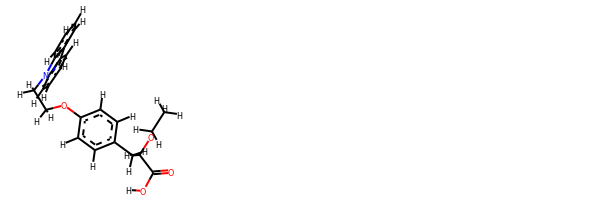

rdkit:  [H]OC(=O)C([H])(OC([H])([H])C([H])([H])[H])C([H])([H])c1c([H])c([H])c(OC([H])([H])C([H])([H])n2c3c([H])c([H])c([H])c([H])c3c3c([H])c([H])c([H])c([H])c32)c([H])c1[H]
oechem:  CCOC(Cc1ccc(cc1)OCCn2c3ccccc3c4c2cccc4)C(=O)O
###########################################################################
 #########################################################

bond
21.922014483977094 kJ/mol 29089.073284303293 kJ/mol False
angle
103.37412586263255 kJ/mol 105.0751701588936 kJ/mol False
nb
3.02330962536745 kJ/mol 3.02330962536745 kJ/mol True
torsion
22.412835440570085 kJ/mol 11.915594817474604 kJ/mol False
150.73228541254718 kJ/mol 29209.087358905028 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3864


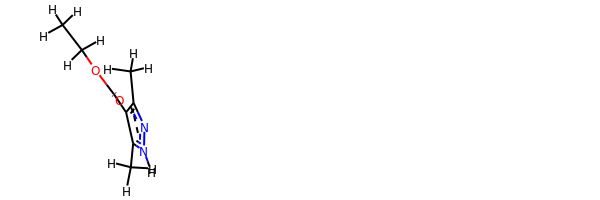

rdkit:  [H]n1nc(C([H])([H])[H])c(C(=O)OC([H])([H])C([H])([H])[H])c1C([H])([H])[H]
oechem:  CCOC(=O)c1c([nH]nc1C)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
13.784087315755855 kJ/mol 57765.68943398255 kJ/mol False
angle
95.57691302435741 kJ/mol 96.80690910360886 kJ/mol False
nb
4.6241114422793546 kJ/mol 4.6241114422793546 kJ/mol True
torsion
2.91988770128728 kJ/mol 2.9199385572448406 kJ/mol False
116.9049994836799 kJ/mol 57870.040393085685 kJ/mol

------------------------------------------

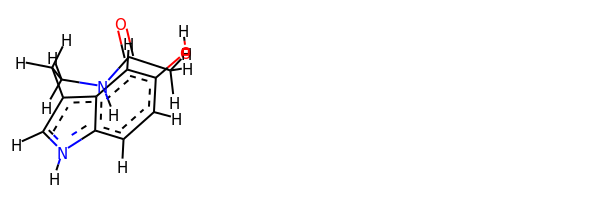

rdkit:  [H]Oc1c([H])c([H])c2c(c1[H])c(C([H])([H])C([H])([H])N([H])C(=O)C([H])([H])[H])c([H])n2[H]
oechem:  CC(=O)NCCc1c[nH]c2c1cc(cc2)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

################################################

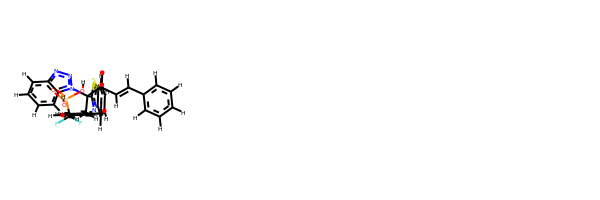

rdkit:  [H]OP(=O)(O[H])C(F)(F)c1c([H])c([H])c(C([H])([H])C(c2nc3c([H])c([H])c([H])c([H])c3s2)(n2nnc3c([H])c([H])c([H])c([H])c32)C([H])([H])C([H])=C([H])c2c([H])c([H])c([H])c([H])c2[H])c([H])c1[H]
oechem:  c1ccc(cc1)C=CCC(Cc2ccc(cc2)C(F)(F)P(=O)(O)O)(c3nc4ccccc4s3)n5c6ccccc6nn5
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
12.689175704903745 kJ/mol 57997.423878623114 kJ/mol False
angle
481.974184972536 kJ/mol 481.974184972536 kJ/mol True
nb
38.98783023991929 kJ/mol 38.98783023991929 kJ/mol True
torsion
63.64113434204542 kJ/mol 55.32938357814844 kJ/mol False
597.2923252594045 kJ/mol 58573.71527741373 kJ/mol

-------------------

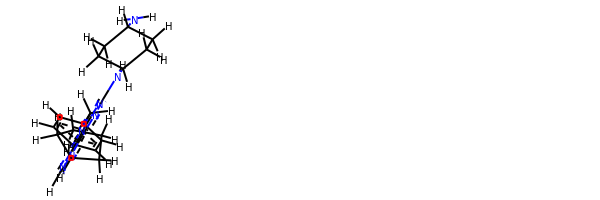

rdkit:  [H]c1c([H])c([H])c(C([H])([H])N([H])c2nc(N([H])C3([H])C([H])([H])C([H])([H])C([H])(N([H])[H])C([H])([H])C3([H])[H])nc3c2nc([H])n3C2([H])C([H])([H])C([H])([H])C([H])([H])C2([H])[H])c([H])c1[H]
oechem:  c1ccc(cc1)CNc2c3c(nc(n2)NC4CCC(CC4)N)n(cn3)C5CCCC5
###########################################################################
 #########################################################

bond
18.005691259139482 kJ/mol 57770.5156652388 kJ/mol False
angle
226.69596051891727 kJ/mol 227.92445801930606 kJ/mol False
nb
68.12420463363713 kJ/mol 68.12420463363713 kJ/mol True
torsion
29.257902361754745 kJ/mol 29.258048900365623 kJ/mol False
342.08375877344866 kJ/mol 58095.82237679211 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3882


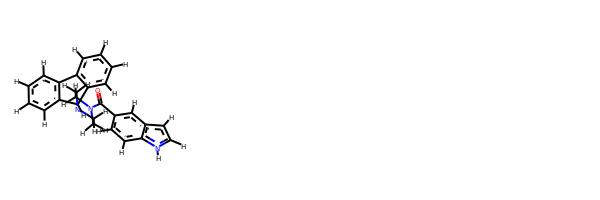

rdkit:  [H]c1c([H])c([H])c2c(c1[H])-c1c([H])c([H])c([H])c([H])c1C2([H])N1C([H])([H])C([H])([H])N(C(=O)c2c([H])c([H])c3c(c2[H])c([H])c([H])n3[H])C([H])([H])C1([H])[H]
oechem:  c1ccc2c(c1)-c3ccccc3C2N4CCN(CC4)C(=O)c5ccc6c(c5)cc[nH]6
###########################################################################
 #########################################################

bond
66.91536960552418 kJ/mol 56534.41334613028 kJ/mol False
angle
372.5937406549817 kJ/mol 372.5937406549817 kJ/mol True
nb
8.811473668128382 kJ/mol 8.811473668128382 kJ/mol True
torsion
137.32838550332053 kJ/mol 97.03963161244883 kJ/mol False
585.6489694319548 kJ/mol 57012.85819206583 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3883


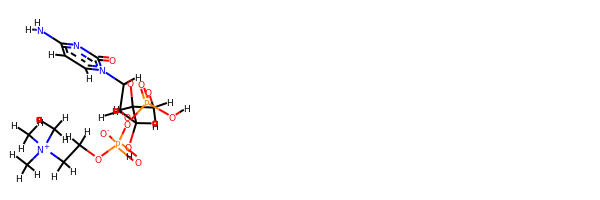

rdkit:  [H]OC1([H])C([H])(n2c([H])c([H])c(N([H])[H])nc2=O)OC([H])(C([H])([H])OP(=O)(O[H])OP(=O)([O-])OC([H])([H])C([H])([H])[N+](C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H])C1([H])O[H]
oechem:  C[N+](C)(C)CCOP(=O)([O-])OP(=O)(O)OCC1C(C(C(O1)n2ccc(nc2=O)N)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################

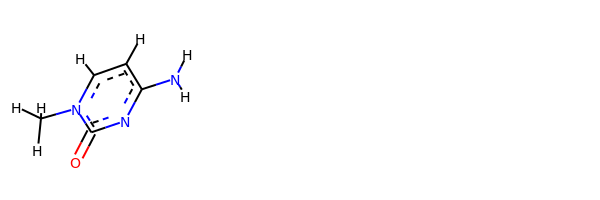

rdkit:  [H]c1c(N([H])[H])nc(=O)n(C([H])([H])[H])c1[H]
oechem:  Cn1ccc(nc1=O)N
###########################################################################
 #########################################################

bond
43.15521872104727 kJ/mol 114170.01901125595 kJ/mol False
angle
467.13773661655443 kJ/mol 467.48955035960313 kJ/mol False
nb
-3.7532798267292886 kJ/mol -3.7532798267292886 kJ/mol True
torsion
132.47686936838232 kJ/mol 74.89246733220945 kJ/mol False
639.0165448792548 kJ/mol 114708.64774912102 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3905


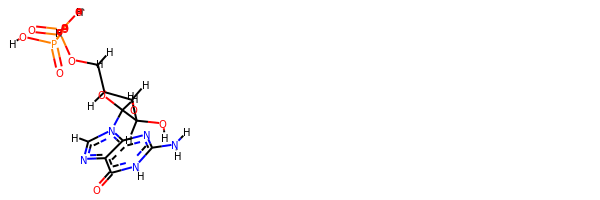

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c(=O)n([H])c(N([H])[H])nc32)OC([H])(C([H])([H])OP(=O)(O[H])OP(=O)(O[H])O[H])C1([H])O[H]
oechem:  c1nc2c(=O)[nH]c(nc2n1C3C(C(C(O3)COP(=O)(O)OP(=O)(O)O)O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ##################################################

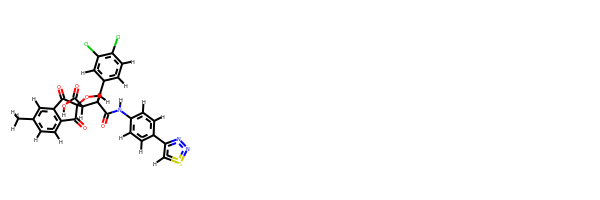

rdkit:  [H]OC(=O)C1([H])C2(OC([H])(c3c([H])c([H])c(Cl)c(Cl)c3[H])C1([H])C(=O)N([H])c1c([H])c([H])c(-c3nnsc3[H])c([H])c1[H])C(=O)c1c([H])c([H])c(C([H])([H])[H])c([H])c1C2=O
oechem:  Cc1ccc2c(c1)C(=O)C3(C2=O)C(C(C(O3)c4ccc(c(c4)Cl)Cl)C(=O)Nc5ccc(cc5)c6csnn6)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
25.92949340426791 kJ/mol 116507.31635133021 kJ/mol F

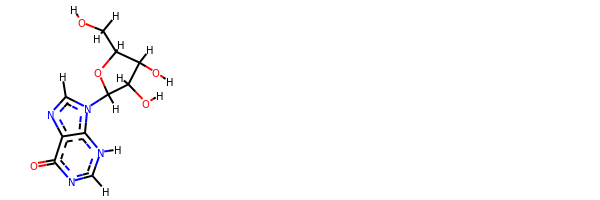

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])nc3c(=O)nc([H])n([H])c32)C([H])(O[H])C1([H])O[H]
oechem:  c1[nH]c2c(c(=O)n1)ncn2C3C(C(C(O3)CO)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
11.825358822223388 kJ/mol 58033.72262704187 kJ/mol False
angle
107.19552125679085 kJ/mol 107.19552125679085 kJ/mol True
nb
27.354986616726748 kJ/mol 27.354986616726748 kJ/mol True
torsion
61.47322527170135 kJ/mol 47.04113738818417 kJ/mol False
207.84909196744235 kJ/mol 58215.31427230357 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3928


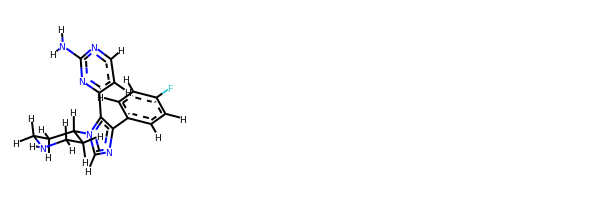

rdkit:  [H]c1nc(N([H])[H])nc(-c2c(-c3c([H])c([H])c(F)c([H])c3[H])nc([H])n2C2([H])C([H])([H])C([H])([H])N([H])C([H])([H])C2([H])[H])c1[H]
oechem:  c1cc(ccc1c2c(n(cn2)C3CCNCC3)c4ccnc(n4)N)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
51.01752574480997 kJ/mol 29247.04163520302 kJ/mol False
angle
415.2369449255725 kJ/mol 415.2369449255725 kJ/mol True
nb
13.089599729284014 kJ/mol 13.089599729284014 kJ/mol True
torsion
150.53706305583165 kJ/mol 145.3070944313786 kJ/mol False
629.8811334554981 kJ/

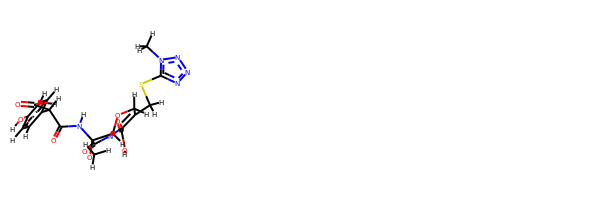

rdkit:  [H]OC(=O)C1=C(C([H])([H])Sc2nnnn2C([H])([H])[H])C([H])([H])OC2([H])N1C(=O)C2(OC([H])([H])[H])N([H])C(=O)C([H])(C(=O)O[H])c1c([H])c([H])c(O[H])c([H])c1[H]
oechem:  Cn1c(nnn1)SCC2=C(N3C(C(C3=O)(NC(=O)C(c4ccc(cc4)O)C(=O)O)OC)OC2)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
24.777963230700756 kJ/mol 113718.76726681563 kJ/mol False
angle
19.032878931709313 kJ/mol 19.69681838575014 kJ/mol False
nb
60.30049662027045 kJ/mol 60.30049662027045 kJ/mol True
torsion
50.208213497441704 kJ/mol 0.0003605420684230902 kJ/mol False
154.31955228012222 kJ/mol 113798.76494236372 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
---------------------------------------------

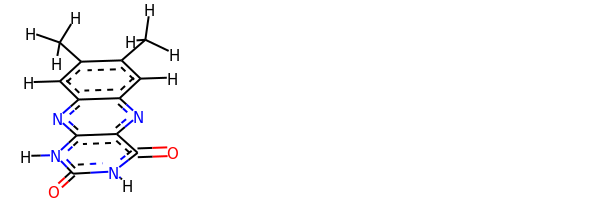

rdkit:  [H]c1c(C([H])([H])[H])c(C([H])([H])[H])c([H])c2nc3c(nc12)c(=O)n([H])c(=O)n3[H]
oechem:  Cc1cc2c(cc1C)nc3c(n2)c(=O)[nH]c(=O)[nH]3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
48.112891927418445 kJ/mol 58068.48378553692 kJ/mol False
angle
637.6302704282461 kJ/mol 639.6427944195318 kJ/mol False
nb
-2.3403326681639722 kJ/mol -2.3403326681639722 kJ/mol Tr

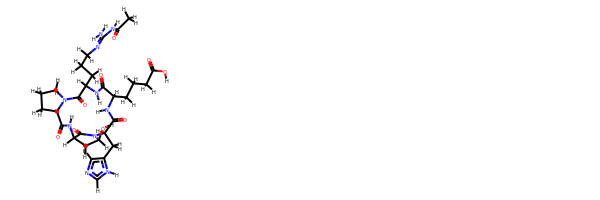

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])C([H])([H])C1([H])C(=O)N([H])C([H])(C([H])([H])C([H])([H])C([H])([H])N=C(N([H])[H])N([H])C(=O)C([H])([H])[H])C(=O)N2C([H])([H])C([H])([H])C([H])([H])C2([H])C(=O)N([H])C2([H])C(=O)N(C([H])(O[H])C2([H])[H])C([H])(C([H])([H])c2c([H])nc([H])n2[H])C(=O)N1[H]
oechem:  CC(=O)NC(=NCCCC1C(=O)N2CCCC2C(=O)NC3CC(N(C3=O)C(C(=O)NC(C(=O)N1)CCCC(=O)O)Cc4cnc[nH]4)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

################################################################

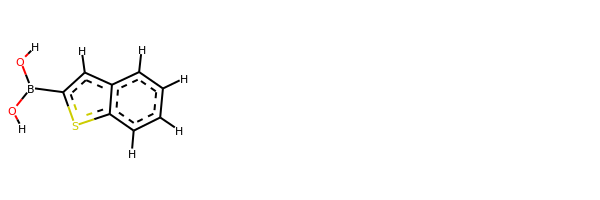

rdkit:  [H]OB(O[H])c1sc2c([H])c([H])c([H])c([H])c2c1[H]
oechem:  B(c1cc2ccccc2s1)(O)O
###########################################################################
 #########################################################

bond
57.91383801198522 kJ/mol 101709.32875014158 kJ/mol False
angle
502.44977726309236 kJ/mol 505.80666922292124 kJ/mol False
nb
-30.457697726998855 kJ/mol -30.457697726998855 kJ/mol True
torsion
114.6130454561524 kJ/mol 84.90536273716651 kJ/mol False
644.5189630042311 kJ/mol 102269.58308437465 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3948


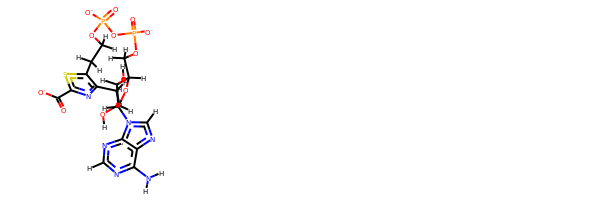

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)OC([H])(C([H])([H])OP(=O)([O-])OP(=O)([O-])OC([H])([H])C([H])([H])c2sc(C(=O)[O-])nc2C([H])([H])[H])C1([H])O[H]
oechem:  Cc1c(sc(n1)C(=O)[O-])CCOP(=O)([O-])OP(=O)([O-])OCC2C(C(C(O2)n3cnc4c3ncnc4N)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
31.45916706680753 kJ/mol 58011.71295111594 kJ/mol False
angle
474.259035390698 kJ/mol 474.259035390698 kJ/mol True
nb
-1.911594663810221 kJ/mol -1.911594663810221 kJ/mol True
torsion
94.59257386310972 kJ/mol 70.58542168795853 kJ/mol False
598.399181656805 kJ/mol 58554.645813530784 kJ/mol

-------------------------------------

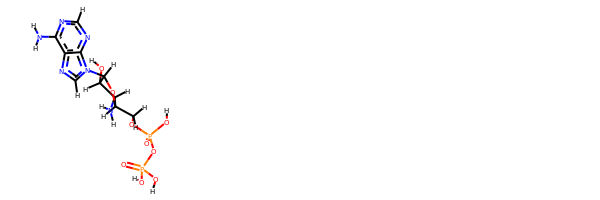

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)OC([H])(C([H])([H])OP(=O)(O[H])OP(=O)(O[H])O[H])C1([H])N([H])[H]
oechem:  c1nc(c2c(n1)n(cn2)C3C(C(C(O3)COP(=O)(O)OP(=O)(O)O)N)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
31.833369144378253 kJ/mol 44128.197624618995 kJ/mol False
angle
106.45869962075204 kJ/mol 109.0288363678005 kJ/mol False
nb
27.856874906876328 kJ/mol 27.856874906876328 kJ/mol True
torsion
195.148259880021 kJ/mol 195.16273750621042 kJ/mol False
361.29720355202

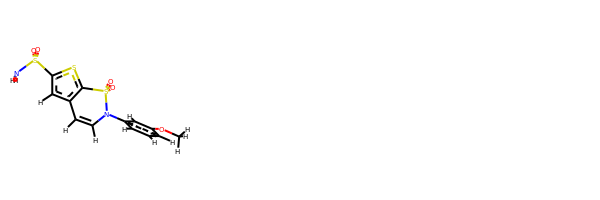

rdkit:  [H]C1=C([H])N(c2c([H])c([H])c([H])c(OC([H])([H])[H])c2[H])S(=O)(=O)c2sc(S(=O)(=O)N([H])[H])c([H])c21
oechem:  COc1cccc(c1)N2C=Cc3cc(sc3S2(=O)=O)S(=O)(=O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
10.190359882570153 kJ/mol 29150.0617394005 kJ/mol False
angle
111.44123816765838 kJ/mol 113.60376615037399 kJ/mol False
nb
3.246390062312496 kJ/mol 3.246390062312496 kJ/mol True
torsion
30.286995299305854 kJ/mol 22.54661176886835 kJ/mol False
155.16498341184686 kJ/mol 29289.45850738205 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------

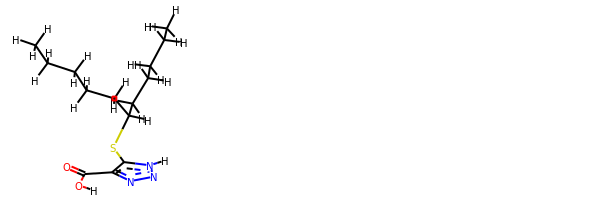

rdkit:  [H]OC(=O)c1nnn([H])c1SC([H])(C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])[H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])[H]
oechem:  CCCCCC(CCCCC)Sc1c(nn[nH]1)C(=O)O
###########################################################################
 #########################################################

bond
30.962515429183977 kJ/mol 57537.72777362219 kJ/mol False
angle
52.21639270627502 kJ/mol 52.40494207113384 kJ/mol False
nb
63.92362561546835 kJ/mol 63.92362561546835 kJ/mol True
torsion
48.654348551726066 kJ/mol 15.260513438799553 kJ/mol False
195.75688230265342 kJ/mol 57669.31685474759 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_3959


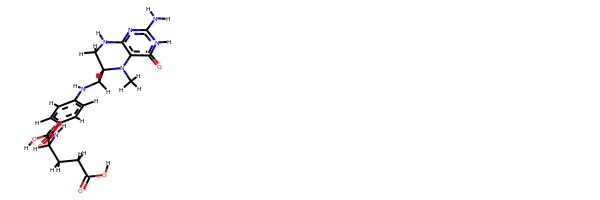

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])C([H])(C(=O)O[H])N([H])C(=O)c1c([H])c([H])c(N([H])C([H])([H])C2([H])N(C([H])([H])[H])c3c(nc(N([H])[H])n([H])c3=O)N([H])C2([H])[H])c([H])c1[H]
oechem:  CN1c2c(=O)[nH]c(nc2NCC1CNc3ccc(cc3)C(=O)NC(CCC(=O)O)C(=O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

#####################################################################

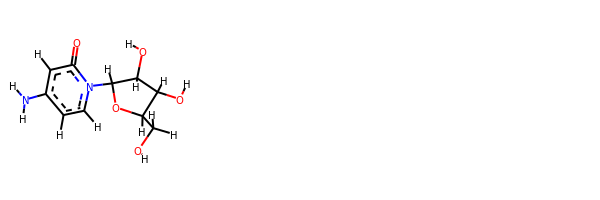

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])c([H])c(N([H])[H])c([H])c2=O)C([H])(O[H])C1([H])O[H]
oechem:  c1cn(c(=O)cc1N)C2C(C(C(O2)CO)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################

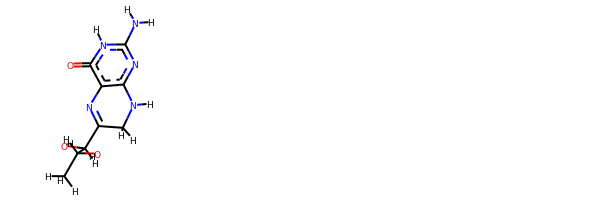

rdkit:  [H]OC([H])(C1=Nc2c(nc(N([H])[H])n([H])c2=O)N([H])C1([H])[H])C([H])(O[H])C([H])([H])[H]
oechem:  CC(C(C1=Nc2c(=O)[nH]c(nc2NC1)N)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
13.914581390139345 kJ/mol 43686.609775362704 kJ/mol False
angle
83.71851140532944 kJ/mol 87.07445215998519 kJ/mol False
nb
43.18547744890105 kJ/mol 43.18547744890105 kJ/mol Tru

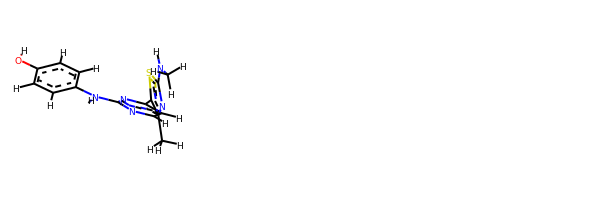

rdkit:  [H]Oc1c([H])c([H])c(N([H])c2nc([H])c([H])c(-c3sc(N([H])C([H])([H])[H])nc3C([H])([H])[H])n2)c([H])c1[H]
oechem:  Cc1c(sc(n1)NC)c2ccnc(n2)Nc3ccc(cc3)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################

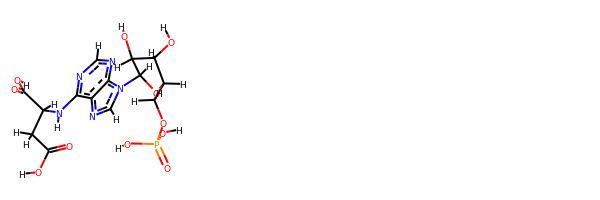

rdkit:  [H]OC(=O)C([H])([H])C([H])(C(=O)O[H])N([H])c1nc([H])nc2c1nc([H])n2C1([H])OC([H])(C([H])([H])OP(=O)(O[H])O[H])C([H])(O[H])C1([H])O[H]
oechem:  c1nc(c2c(n1)n(cn2)C3C(C(C(O3)COP(=O)(O)O)O)O)NC(CC(=O)O)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
10.483057855583821 kJ/mol 57604.681319460404 kJ/mol False
angle
28.71799527919632 kJ/mol 29.08641465047302 kJ/mol False
nb
40.108130917306475 kJ/mol 40.108130917306475 kJ/mol True
torsion
33.21123413888202 kJ/mol 16.47551462488078 kJ/mol False
112.52041819096863 kJ/mol 57690.35137965307 kJ/mol

-------------------------------------------------------------------
----------

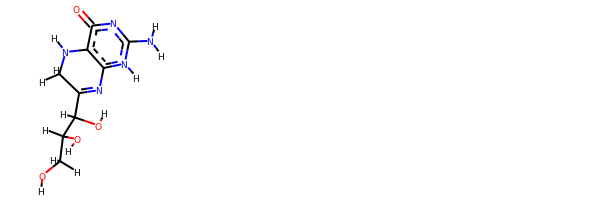

rdkit:  [H]OC([H])([H])C([H])(O[H])C([H])(O[H])C1=Nc2c(c(=O)nc(N([H])[H])n2[H])N([H])C1([H])[H]
oechem:  C1C(=Nc2c(c(=O)nc([nH]2)N)N1)C(C(CO)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
15.778657763000256 kJ/mol 11.865978375234718 kJ/mol False
angle
128.3103487964722 kJ/mol 128.50482526399966 kJ/mol False
nb
53.89154949366981 kJ/mol 53.89154949366981 kJ/mol True
torsion
20.942865933740787 kJ/mol 10.485231849135529 kJ/mol False
218.92342198688306 kJ/mol 204.7475849820397 kJ/mol

---------

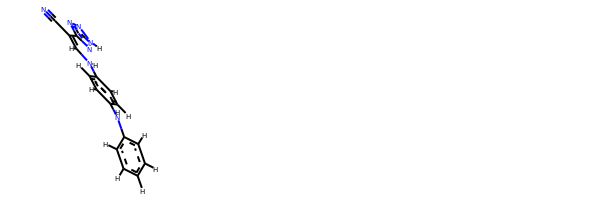

rdkit:  [H]C(=C(C#N)c1nnn([H])n1)N([H])c1c([H])c([H])c(N([H])c2c([H])c([H])c([H])c([H])c2[H])c([H])c1[H]
oechem:  c1ccc(cc1)Nc2ccc(cc2)NC=C(C#N)c3n[nH]nn3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
51.73565306886435 kJ/mol 113377.54754832237 kJ/mol False
angle
344.11829513304707 kJ/mol 344.7321108068814 kJ/mol False
nb
18.876088111419367 kJ/mol 18.87608811

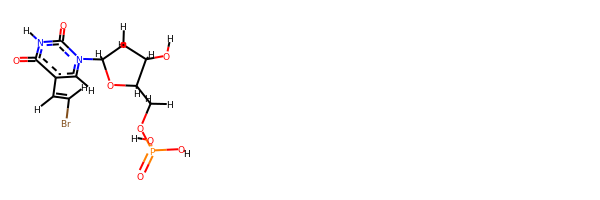

rdkit:  [H]OC1([H])C([H])([H])C([H])(n2c([H])c(C([H])=C([H])Br)c(=O)n([H])c2=O)OC1([H])C([H])([H])OP(=O)(O[H])O[H]
oechem:  c1c(c(=O)[nH]c(=O)n1C2CC(C(O2)COP(=O)(O)O)O)C=CBr
###########################################################################
 #########################################################

bond
29.115257505178874 kJ/mol 58509.62141517923 kJ/mol False
angle
394.7183941438423 kJ/mol 395.4704241606931 kJ/mol False
nb
9.610847486544452 kJ/mol 9.610847486544452 kJ/mol True
torsion
90.38990859488057 kJ/mol 66.23095866682583 kJ/mol False
523.8344077304462 kJ/mol 58980.9336454933 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4016


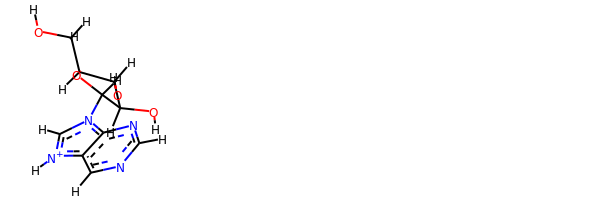

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])[n+]([H])c3c([H])nc([H])nc32)C([H])(O[H])C1([H])O[H]
oechem:  c1c2c(ncn1)n(c[nH+]2)C3C(C(C(O3)CO)O)O
###########################################################################
 #########################################################

bond
22.39189563631848 kJ/mol 58002.35983946014 kJ/mol False
angle
400.6217314441171 kJ/mol 400.6217314441171 kJ/mol True
nb
14.803167955253732 kJ/mol 14.803167955253732 kJ/mol True
torsion
87.73895610179974 kJ/mol 63.6364730005609 kJ/mol False
525.555751137489 kJ/mol 58481.42121186007 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4017


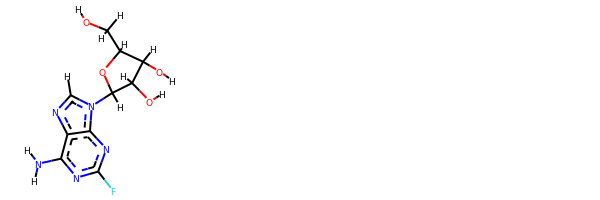

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])nc3c(N([H])[H])nc(F)nc32)C([H])(O[H])C1([H])O[H]
oechem:  c1nc2c(nc(nc2n1C3C(C(C(O3)CO)O)O)F)N
###########################################################################
 #########################################################

bond
13.387210179985102 kJ/mol 43728.616131514376 kJ/mol False
angle
28.122056374897127 kJ/mol 29.96280094551052 kJ/mol False
nb
14.226911724280107 kJ/mol 14.226911724280107 kJ/mol True
torsion
16.74599748385291 kJ/mol 16.746000946568344 kJ/mol False
72.48217576301525 kJ/mol 43789.551845130736 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4020


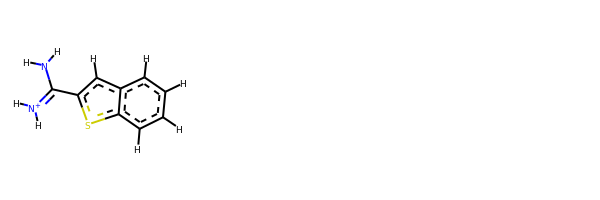

rdkit:  [H]c1c([H])c([H])c2c([H])c(C(N([H])[H])=[N+]([H])[H])sc2c1[H]
oechem:  c1ccc2c(c1)cc(s2)C(=[NH2+])N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################


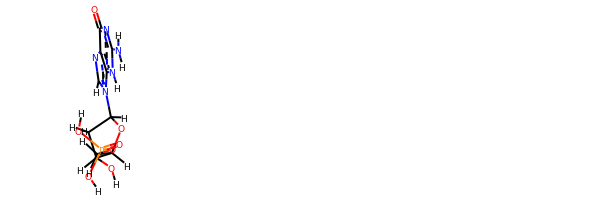

rdkit:  [H]OC1([H])C([H])([H])C([H])(n2c([H])nc3c(=O)nc(N([H])[H])n([H])c32)OC1([H])C([H])([H])OP(=O)(O[H])O[H]
oechem:  c1nc2c(n1C3CC(C(O3)COP(=O)(O)O)O)[nH]c(nc2=O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
14.819325136306173 kJ/mol 57171.030019297614 kJ/mol False
angle
10.818071040714726 kJ/mol 10.818071040714726 kJ/mol True
nb
28.988441110500073 kJ/mol 28.988441110500073 kJ/mol True
torsion
0.0004086147225238326 kJ/mol 0.0004655961255871095 kJ/mol False
54.6262459022435 kJ/mol 57210.83699704496 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4033


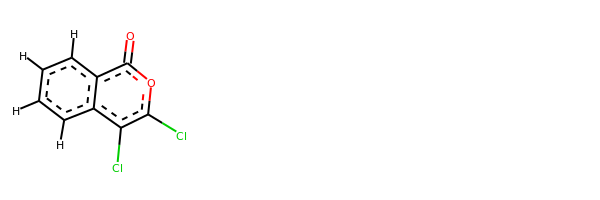

rdkit:  [H]c1c([H])c([H])c2c(=O)oc(Cl)c(Cl)c2c1[H]
oechem:  c1ccc2c(c1)c(c(oc2=O)Cl)Cl
###########################################################################
 #########################################################

bond
21.773111409763967 kJ/mol 13.565377860331482 kJ/mol False
angle
98.44775087734526 kJ/mol 98.45282629901014 kJ/mol False
nb
40.777745636378285 kJ/mol 40.777745636378285 kJ/mol True
torsion
10.463040510554272 kJ/mol 0.0030456966069623767 kJ/mol False
171.4616484340418 kJ/mol 152.79899549232687 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4035


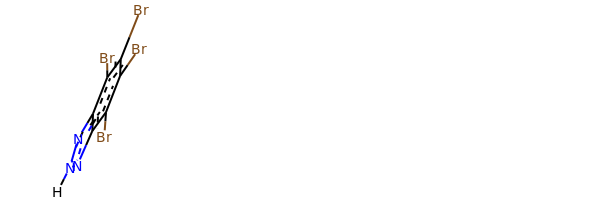

rdkit:  [H]n1nc2c(Br)c(Br)c(Br)c(Br)c2n1
oechem:  c12c(c(c(c(c1Br)Br)Br)Br)n[nH]n2
###########################################################################
 #########################################################

bond
14.072219533553762 kJ/mol 29098.701053665027 kJ/mol False
angle
117.54318975412758 kJ/mol 117.54318975412758 kJ/mol True
nb
40.24675115817248 kJ/mol 40.24675115817248 kJ/mol True
torsion
13.905418445389722 kJ/mol 21.227534391425575 kJ/mol False
185.76757889124355 kJ/mol 29277.71852896875 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4036


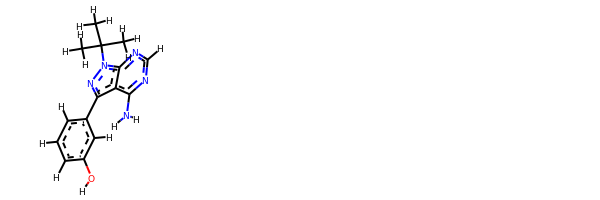

rdkit:  [H]Oc1c([H])c([H])c([H])c(-c2nn(C(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H])c3nc([H])nc(N([H])[H])c23)c1[H]
oechem:  CC(C)(C)n1c2c(c(n1)c3cccc(c3)O)c(ncn2)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
29.082836604834956 kJ/mol 29099.12560908091 kJ/mol False
angle
101.53870569082397 kJ/mol 101.53870569082397 kJ/mol True
nb
41.45326489157937 kJ/mo

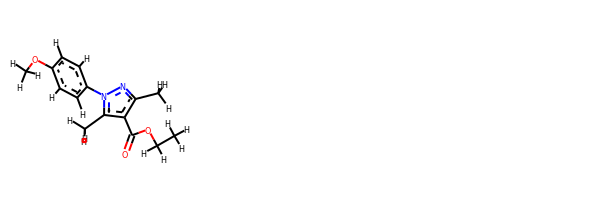

rdkit:  [H]c1c([H])c(-n2nc(C([H])([H])[H])c(C(=O)OC([H])([H])C([H])([H])[H])c2C([H])([H])[H])c([H])c([H])c1OC([H])([H])[H]
oechem:  CCOC(=O)c1c(nn(c1C)c2ccc(cc2)OC)C
###########################################################################
 #########################################################

bond
37.44598174110346 kJ/mol 57952.48204156273 kJ/mol False
angle
84.61460128202293 kJ/mol 86.52137484343048 kJ/mol False
nb
42.24906918566767 kJ/mol 42.24906918566767 kJ/mol True
torsion
48.67220471694678 kJ/mol 58.08390351402198 kJ/mol False
212.98185692574083 kJ/mol 58139.336389105854 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4043


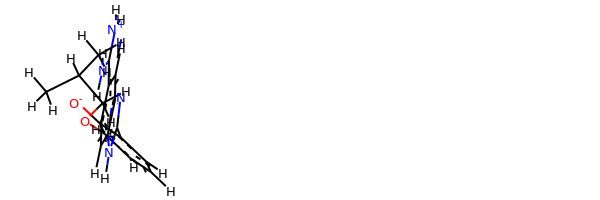

rdkit:  [H]c1c([H])c(OC([H])([H])C([H])(C([H])([H])[H])C([H])([H])[H])c([O-])c(-c2nc3c([H])c(C(N([H])[H])=[N+]([H])[H])c([H])c([H])c3n2[H])c1[H]
oechem:  CC(C)COc1cccc(c1[O-])c2[nH]c3ccc(cc3n2)C(=[NH2+])N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ######################################

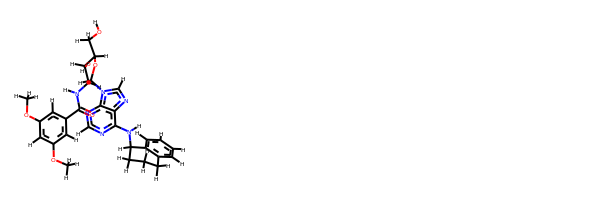

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])nc3c(N([H])C4([H])c5c([H])c([H])c([H])c([H])c5C([H])([H])C([H])([H])C4([H])[H])nc([H])nc32)C([H])(N([H])C(=O)c2c([H])c(OC([H])([H])[H])c([H])c(OC([H])([H])[H])c2[H])C1([H])O[H]
oechem:  COc1cc(cc(c1)OC)C(=O)NC2C(C(OC2n3cnc4c3ncnc4NC5CCCc6c5cccc6)CO)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
16.116725050364483 kJ/mol 29303.580226463386 kJ/mol False
angle
384.02102599862735 kJ/mol 384.02102599862735 kJ/mol True
nb
23.501984702243224 kJ/mol 23.501984702243224 kJ/mol True
torsion
39.08382823262159 kJ/mol 35.79664277414013 kJ/mol False
462.7235639838567 kJ/mol 29746.8998799384 kJ/

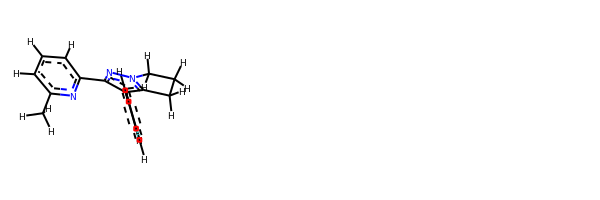

rdkit:  [H]c1c(-c2nn3c(c2-c2c([H])c([H])c(F)c([H])c2[H])C([H])([H])C([H])([H])C3([H])[H])nc(C([H])([H])[H])c([H])c1[H]
oechem:  Cc1cccc(n1)c2c(c3n(n2)CCC3)c4ccc(cc4)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
44.534104057784404 kJ/mol 113456.57677817227 kJ/mol False
angle
315.95163158560536 kJ/mol 316.5719326331849 kJ/mol False
nb
23.995533792358476 kJ/mol 23.995533792358476 kJ/mol True
torsion
112.73730194660001 kJ/mol 55.671433870307915 kJ/mol False
497.2185713823482 kJ/mol 113852.81567

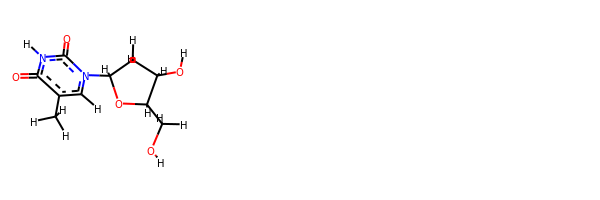

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])c(C([H])([H])[H])c(=O)n([H])c2=O)C([H])([H])C1([H])O[H]
oechem:  Cc1cn(c(=O)[nH]c1=O)C2CC(C(O2)CO)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

######################################

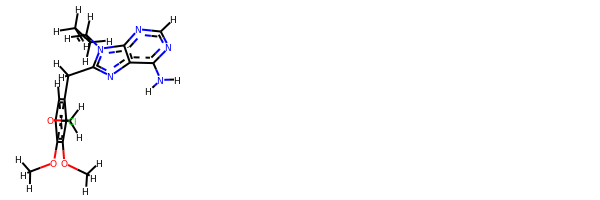

rdkit:  [H]C#CC([H])([H])C([H])([H])C([H])([H])n1c(C([H])([H])c2c([H])c(OC([H])([H])[H])c(OC([H])([H])[H])c(OC([H])([H])[H])c2Cl)nc2c(N([H])[H])nc([H])nc21
oechem:  COc1cc(c(c(c1OC)OC)Cl)Cc2nc3c(ncnc3n2CCCC#C)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ################################

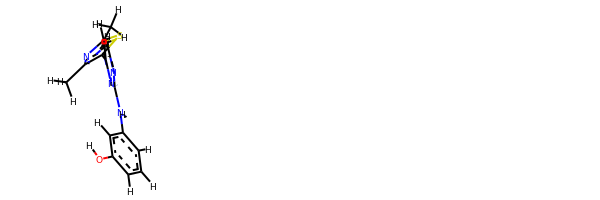

rdkit:  [H]Oc1c([H])c([H])c([H])c(N([H])c2nc([H])c([H])c(-c3sc(C([H])([H])[H])nc3C([H])([H])[H])n2)c1[H]
oechem:  Cc1c(sc(n1)C)c2ccnc(n2)Nc3cccc(c3)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

##################################

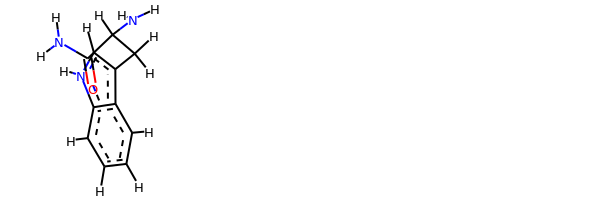

rdkit:  [H]c1c([H])c([H])c2c(c1[H])c(C([H])([H])C([H])(C(=O)N([H])[H])N([H])[H])c([H])n2[H]
oechem:  c1ccc2c(c1)c(c[nH]2)CC(C(=O)N)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
92.29518325865465 kJ/mol 113474.1507172854 kJ/mol False
angle
376.8096761654856 kJ/mol 377.42959836567775 kJ/mol False
nb
9.304545068175514 kJ/mol 9.304545068175514 kJ/mol True
torsi

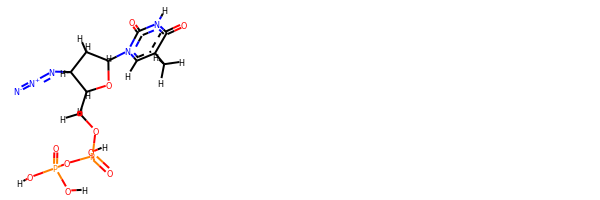

rdkit:  [H]OP(=O)(O[H])OP(=O)(O[H])OC([H])([H])C1([H])OC([H])(n2c([H])c(C([H])([H])[H])c(=O)n([H])c2=O)C([H])([H])C1([H])N=[N+]=[N-]
oechem:  Cc1cn(c(=O)[nH]c1=O)C2CC(C(O2)COP(=O)(O)OP(=O)(O)O)N=[N+]=[N-]
###########################################################################
 #########################################################

bond
15.144083157183458 kJ/mol 115156.50811087282 kJ/mol False
angle
97.76843896995855 kJ/mol 100.04065492034951 kJ/mol False
nb
27.91838155102681 kJ/mol 27.91838155102681 kJ/mol True
torsion
33.65685149199155 kJ/mol 0.1849352816294927 kJ/mol False
174.48775517016037 kJ/mol 115284.65208262583 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4109


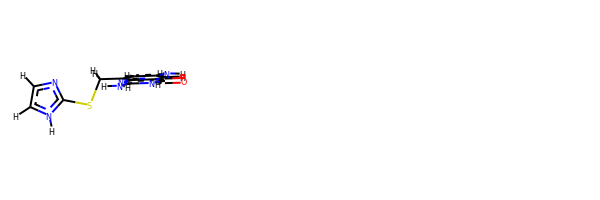

rdkit:  [H]c1nc(SC([H])([H])c2c([H])c(N([H])[H])c([H])c3c(=O)n([H])c(N([H])[H])nc23)n([H])c1[H]
oechem:  c1cnc([nH]1)SCc2cc(cc3c2nc([nH]c3=O)N)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
20.05919940499644 kJ/mol 57936.960051800146 kJ/mol False
angle
382.4409549111854 kJ/mol 382.4409549111854 kJ/mol True
nb
5.952251253239598 kJ/mol 5.952251253239598 kJ/mol True
torsion
90.74934009463853 kJ/mol 66.63698362702847 kJ/mol False
499.2017456640599 kJ/mol 58391.99024159161 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
---------------

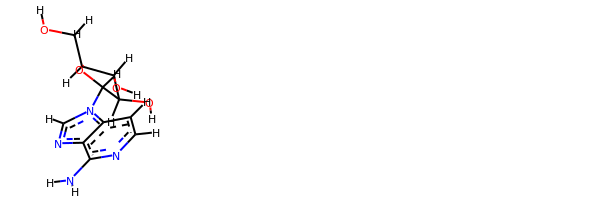

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])nc3c(N([H])[H])nc([H])c([H])c32)C([H])(O[H])C1([H])O[H]
oechem:  c1cnc(c2c1n(cn2)C3C(C(C(O3)CO)O)O)N
###########################################################################
 #########################################################

bond
55.5906473586408 kJ/mol 87628.39761000001 kJ/mol False
angle
131.7774481186191 kJ/mol 136.08340216786686 kJ/mol False
nb
36.973647583512346 kJ/mol 36.973647583512346 kJ/mol True
torsion
101.50126258645976 kJ/mol 101.5013410382143 kJ/mol False
325.843005647232 kJ/mol 87902.95600078959 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4113


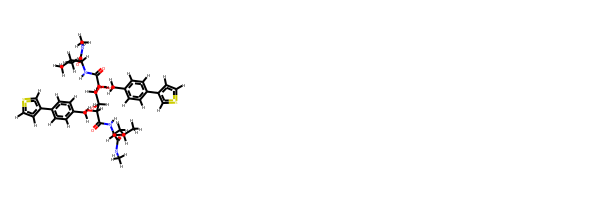

rdkit:  [H]OC([H])(C([H])(OC([H])([H])c1c([H])c([H])c(-c2c([H])sc([H])c2[H])c([H])c1[H])C(=O)N([H])C([H])(C(=O)N([H])C([H])([H])[H])C([H])(C([H])([H])[H])C([H])([H])[H])C([H])(O[H])C([H])(OC([H])([H])c1c([H])c([H])c(-c2c([H])sc([H])c2[H])c([H])c1[H])C(=O)N([H])C([H])(C(=O)N([H])C([H])([H])[H])C([H])(C([H])([H])[H])C([H])([H])[H]
oechem:  CC(C)C(C(=O)NC)NC(=O)C(C(C(C(C(=O)NC(C(C)C)C(=O)NC)OCc1ccc(cc1)c2ccsc2)O)O)OCc3ccc(cc3)c4ccsc4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

#####################

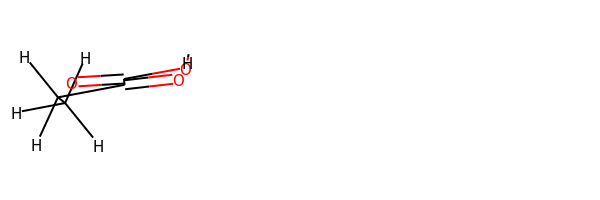

rdkit:  [H]OC(=O)C(=O)C([H])([H])C([H])([H])[H]
oechem:  CCC(=O)C(=O)O
###########################################################################
 #########################################################

bond
28.277658121292088 kJ/mol 58011.211204404695 kJ/mol False
angle
457.55060458656766 kJ/mol 457.55060458656766 kJ/mol True
nb
2.765026394610927 kJ/mol 2.765026394610927 kJ/mol True
torsion
98.60146591809021 kJ/mol 75.06041013694407 kJ/mol False
587.1947550205608 kJ/mol 58546.587245522824 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4120


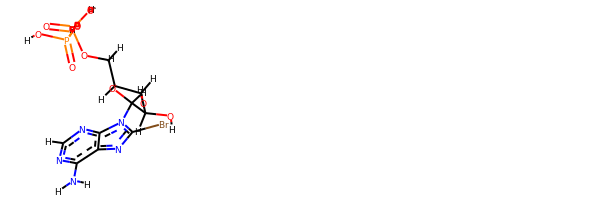

rdkit:  [H]OC1([H])C([H])(n2c(Br)nc3c(N([H])[H])nc([H])nc32)OC([H])(C([H])([H])OP(=O)(O[H])OP(=O)(O[H])O[H])C1([H])O[H]
oechem:  c1nc(c2c(n1)n(c(n2)Br)C3C(C(C(O3)COP(=O)(O)OP(=O)(O)O)O)O)N
###########################################################################
 #########################################################

bond
41.00398762075443 kJ/mol 56506.96795857208 kJ/mol False
angle
364.85510686088213 kJ/mol 364.85510686088213 kJ/mol True
nb
7.729330781465933 kJ/mol 7.729330781465933 kJ/mol True
torsion
114.72421731191815 kJ/mol 74.43506455076022 kJ/mol False
528.3126425750206 kJ/mol 56953.98746076519 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4121


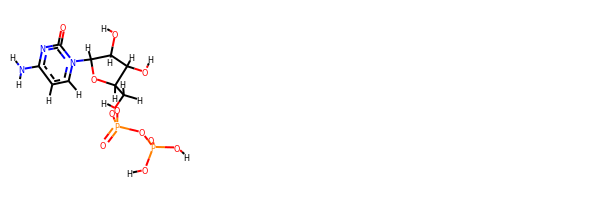

rdkit:  [H]OC1([H])C([H])(n2c([H])c([H])c(N([H])[H])nc2=O)OC([H])(C([H])([H])OP(=O)(O[H])OP(=O)(O[H])O[H])C1([H])O[H]
oechem:  c1cn(c(=O)nc1N)C2C(C(C(O2)COP(=O)(O)OP(=O)(O)O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

######

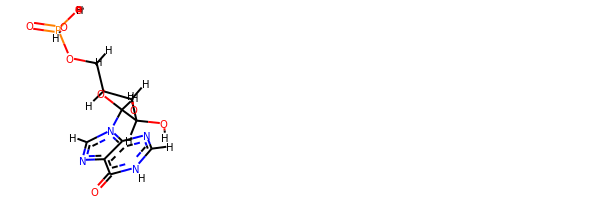

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c(=O)n([H])c([H])nc32)OC([H])(C([H])([H])OP(=O)(O[H])O[H])C1([H])O[H]
oechem:  c1[nH]c(=O)c2c(n1)n(cn2)C3C(C(C(O3)COP(=O)(O)O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
22.045559334664688 kJ/mol 58044.8633816186 kJ/mol False
angle
381.6110582434542 kJ/mol 381.6110582434542 kJ/mol True
nb
-7.322761473572418 kJ/mol -7.322761473572418 kJ/mol True
torsion
90.75098738047028 kJ/mol 66.62680730125727 kJ/mol False
487.08484348501673 kJ/mol 58485.778485689734 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4132


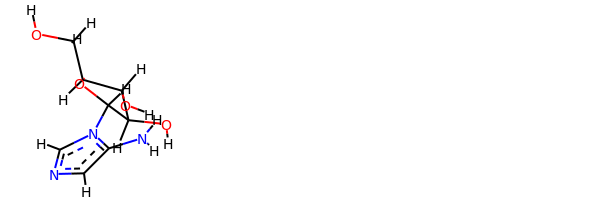

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])nc([H])c2N([H])[H])C([H])(O[H])C1([H])O[H]
oechem:  c1c(n(cn1)C2C(C(C(O2)CO)O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
32.57302741948655 kJ/mol 114915.50537224258 kJ/mol False
angle
101.1552088520782 kJ/mol 101.1552088520782 kJ/mol True
nb
32.26398291897629 kJ/mol 32.26398291897629 kJ/mol True
torsion
0.00033708689478720104 kJ/mol 0.00036855922947626066 kJ/mol False
165.99255627743582 kJ/mol 115048.92493257286 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4135


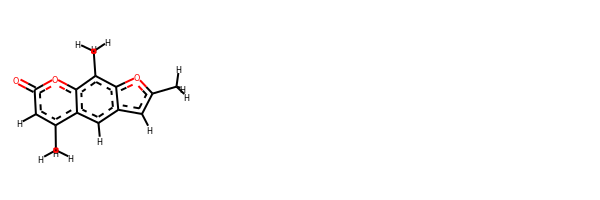

rdkit:  [H]c1c(C([H])([H])[H])c2c([H])c3c([H])c(C([H])([H])[H])oc3c(C([H])([H])[H])c2oc1=O
oechem:  Cc1cc(=O)oc2c1cc3cc(oc3c2C)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

#######################################################

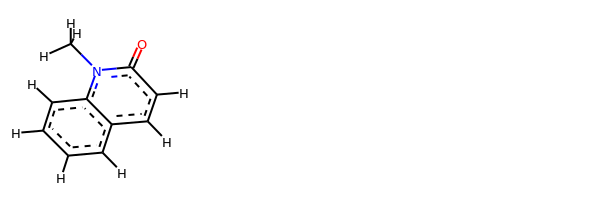

rdkit:  [H]c1c([H])c([H])c2c(c1[H])c([H])c([H])c(=O)n2C([H])([H])[H]
oechem:  Cn1c2ccccc2ccc1=O
###########################################################################
 #########################################################

bond
4.523195283213391 kJ/mol 58025.18151982418 kJ/mol False
angle
85.58808136676379 kJ/mol 85.58808136676379 kJ/mol True
nb
10.562187866218697 kJ/mol 10.562187866218697 kJ/mol True
torsion
20.322487675988896 kJ/mol 0.0005283710293405001 kJ/mol False
120.99595219218477 kJ/mol 58121.33231742819 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4144


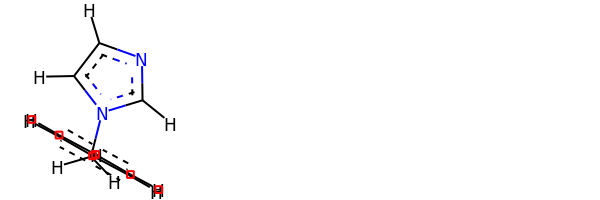

rdkit:  [H]c1nc([H])n(C([H])([H])c2c([H])c([H])c([H])c([H])c2[H])c1[H]
oechem:  c1ccc(cc1)Cn2ccnc2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
25.123766610720104 kJ/mol 29093.411935561766 kJ/mol False
angle
120.11558170636611 kJ/mol 121.86597015201774 kJ/mol False
nb
8.69625478350609 kJ/mol 8.69625478350609 kJ/mol True
torsion
103.91067072137554 kJ/mol 93.7

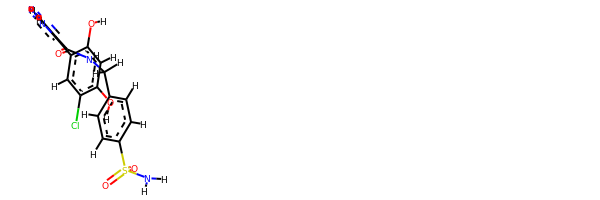

rdkit:  [H]Oc1c([H])c(O[H])c(-c2c(C(=O)N([H])C([H])([H])c3c([H])c([H])c(S(=O)(=O)N([H])[H])c([H])c3[H])c([H])nn2[H])c([H])c1Cl
oechem:  c1cc(ccc1CNC(=O)c2cn[nH]c2c3cc(c(cc3O)O)Cl)S(=O)(=O)N
###########################################################################
 #########################################################

bond
22.809103810685066 kJ/mol 87320.97546375246 kJ/mol False
angle
192.13732484259586 kJ/mol 192.13732484259586 kJ/mol True
nb
102.92913656745148 kJ/mol 102.92913656745148 kJ/mol True
torsion
27.931677831894227 kJ/mol 22.70159948896305 kJ/mol False
345.80724305262663 kJ/mol 87638.74352465148 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4152


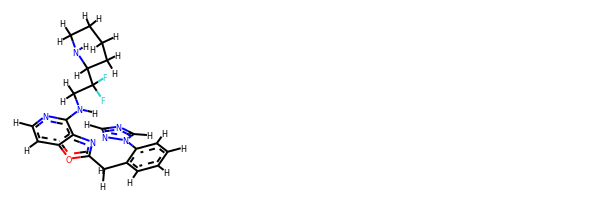

rdkit:  [H]c1nc([H])n(-c2c([H])c([H])c([H])c([H])c2C([H])([H])c2nc3c(N([H])C([H])([H])C(F)(F)C4([H])N([H])C([H])([H])C([H])([H])C([H])([H])C4([H])[H])nc([H])c([H])c3o2)n1
oechem:  c1ccc(c(c1)Cc2nc3c(o2)ccnc3NCC(C4CCCCN4)(F)F)n5cncn5
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
57.86750539438553 kJ/mol 57772.057014513506 kJ/mol False
angle
401.10615302408576 kJ/mol 401.10615302408576 kJ/mol True
nb
25.165442417351393 kJ/mol 25.165442417351393 kJ/mol True
torsion
126.65825867265795 kJ/mol 126.65825749896575 kJ/mol False
610.7973595084807 kJ/mol 58324.98686745391 kJ/mol

---------------------------------------------------------

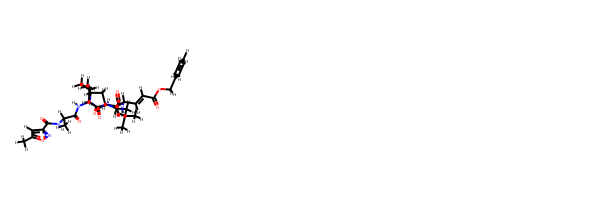

rdkit:  [H]C(C(=O)OC([H])([H])c1c([H])c([H])c([H])c([H])c1[H])=C([H])C([H])(N([H])C(=O)C([H])(N([H])C(=O)C([H])(N([H])C(=O)C([H])(N([H])C(=O)c1noc(C([H])([H])[H])c1[H])C([H])([H])[H])C([H])(C([H])([H])[H])C([H])([H])[H])C([H])([H])C([H])(C([H])([H])[H])C([H])([H])[H])C([H])([H])C1([H])C(=O)N([H])C([H])([H])C1([H])[H]
oechem:  Cc1cc(no1)C(=O)NC(C)C(=O)NC(C(C)C)C(=O)NC(CC(C)C)C(=O)NC(CC2CCNC2=O)C=CC(=O)OCc3ccccc3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

#########################################

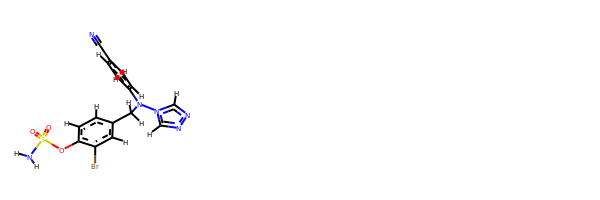

rdkit:  [H]c1c([H])c(N(n2c([H])nnc2[H])C([H])([H])c2c([H])c([H])c(OS(=O)(=O)N([H])[H])c(Br)c2[H])c([H])c([H])c1C#N
oechem:  c1cc(ccc1C#N)N(Cc2ccc(c(c2)Br)OS(=O)(=O)N)n3cnnc3
###########################################################################
 #########################################################

bond
17.009726350397294 kJ/mol 58256.67664713857 kJ/mol False
angle
110.5133551391899 kJ/mol 110.5133551391899 kJ/mol True
nb
28.008084908819473 kJ/mol 28.008084908819473 kJ/mol True
torsion
36.47460123912474 kJ/mol 36.47472813342327 kJ/mol False
192.00576763753142 kJ/mol 58431.67281532 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4162


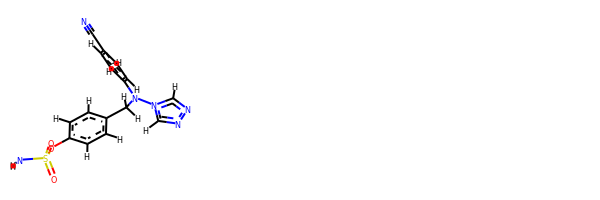

rdkit:  [H]c1c([H])c(N(n2c([H])nnc2[H])C([H])([H])c2c([H])c([H])c(OS(=O)(=O)N([H])[H])c([H])c2[H])c([H])c([H])c1C#N
oechem:  c1cc(ccc1CN(c2ccc(cc2)C#N)n3cnnc3)OS(=O)(=O)N
###########################################################################
 #########################################################

bond
31.7773604964883 kJ/mol 58013.2094673428 kJ/mol False
angle
437.9752732877725 kJ/mol 437.9752732877725 kJ/mol True
nb
41.30420615630691 kJ/mol 41.30420615630691 kJ/mol True
torsion
79.97271725184744 kJ/mol 55.98614804303669 kJ/mol False
591.0295571924152 kJ/mol 58548.47509482992 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4163


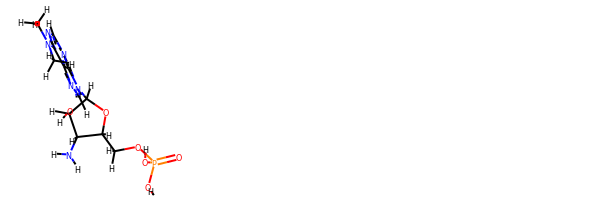

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c(N(C([H])([H])[H])C([H])([H])[H])nc([H])nc32)OC([H])(C([H])([H])OP(=O)(O[H])O[H])C1([H])N([H])[H]
oechem:  CN(C)c1c2c(ncn1)n(cn2)C3C(C(C(O3)COP(=O)(O)O)N)O
###########################################################################
 #########################################################

bond
24.241342576316104 kJ/mol 57878.09104329872 kJ/mol False
angle
403.2906522893006 kJ/mol 403.2906522893006 kJ/mol True
nb
15.769971537007965 kJ/mol 15.769971537007965 kJ/mol True
torsion
84.5568344773947 kJ/mol 63.63543104706988 kJ/mol False
527.8588008800194 kJ/mol 58360.787098172106 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4164


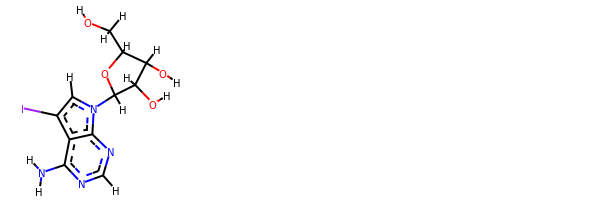

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])c(I)c3c(N([H])[H])nc([H])nc32)C([H])(O[H])C1([H])O[H]
oechem:  c1c(c2c(ncnc2n1C3C(C(C(O3)CO)O)O)N)I
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
22.446810479586606 kJ/mol 85821.10512762758 kJ/mol False
angle
140.557423543934 kJ/mol 140.557423543934 kJ/mol True
nb
55.22310087905625 kJ/mol 55.22310087905625 kJ/mol True
torsion
79.69742752478756 kJ/mol 77.18303814697649 kJ/mol False
297.9247624273644 kJ/mol 86094.06869019754 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4167


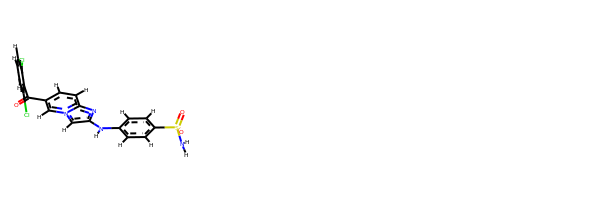

rdkit:  [H]c1c([H])c(Cl)c(C(=O)c2c([H])c([H])c3nc(N([H])c4c([H])c([H])c(S(=O)(=O)N([H])[H])c([H])c4[H])c([H])n3c2[H])c(Cl)c1[H]
oechem:  c1cc(c(c(c1)Cl)C(=O)c2ccc3nc(cn3c2)Nc4ccc(cc4)S(=O)(=O)N)Cl
###########################################################################
 #########################################################

bond
11.282084239519254 kJ/mol 57750.561879156194 kJ/mol False
angle
206.05015242112339 kJ/mol 207.09631296999356 kJ/mol False
nb
27.09803756612839 kJ/mol 27.09803756612839 kJ/mol True
torsion
20.92129424827855 kJ/mol 20.92152537726206 kJ/mol False
265.3515684750496 kJ/mol 58005.677755069584 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4168


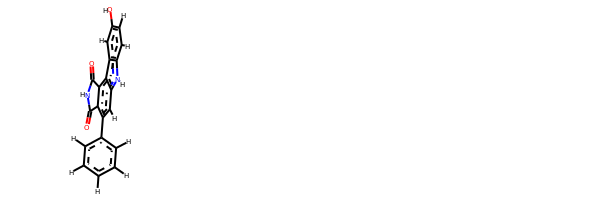

rdkit:  [H]Oc1c([H])c([H])c2c(c1[H])c1c3c(c(-c4c([H])c([H])c([H])c([H])c4[H])c([H])c1n2[H])C(=O)N([H])C3=O
oechem:  c1ccc(cc1)c2cc3c(c4cc(ccc4[nH]3)O)c5c2C(=O)NC5=O
###########################################################################
 #########################################################

bond
46.886967636636605 kJ/mol 43718.012972791716 kJ/mol False
angle
87.77636429779973 kJ/mol 91.13219466550132 kJ/mol False
nb
44.75477705777786 kJ/mol 44.75477705777786 kJ/mol True
torsion
220.66735006386017 kJ/mol 220.66743855890448 kJ/mol False
400.0854590560744 kJ/mol 44074.5673830739 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4169


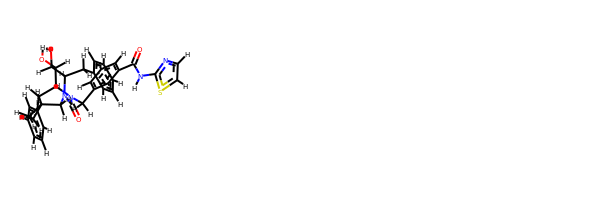

rdkit:  [H]OC1([H])C([H])(O[H])C([H])(C([H])([H])c2c([H])c([H])c([H])c([H])c2[H])N(C([H])([H])C2([H])C([H])([H])C2([H])[H])C(=O)N(C([H])([H])c2c([H])c([H])c([H])c(C(=O)N([H])c3nc([H])c([H])s3)c2[H])C1([H])C([H])([H])c1c([H])c([H])c([H])c([H])c1[H]
oechem:  c1ccc(cc1)CC2C(C(C(N(C(=O)N2Cc3cccc(c3)C(=O)Nc4nccs4)CC5CC5)Cc6ccccc6)O)O
###########################################################################
 #########################################################

bond
11.03660276372754 kJ/mol 57489.34124908852 kJ/mol False
angle
26.782164145758927 kJ/mol 26.924961088534353 kJ/mol False
nb
51.33980628123633 kJ/mol 51.33980628123633 kJ/mol True
torsion
41.93137050034306 kJ/mol 8.46009135115067 kJ/mol False
131.08994369106586 kJ/mol 57576.066107809434 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4170


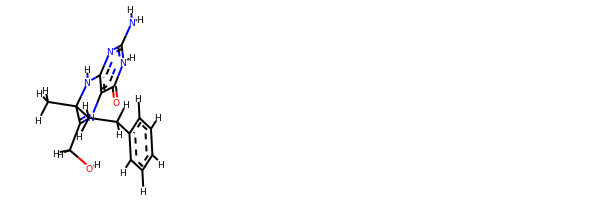

rdkit:  [H]OC([H])([H])C1=Nc2c(nc(N([H])[H])n([H])c2=O)N([H])C1(C([H])([H])[H])C([H])([H])C([H])([H])c1c([H])c([H])c([H])c([H])c1[H]
oechem:  CC1(C(=Nc2c(=O)[nH]c(nc2N1)N)CO)CCc3ccccc3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
53.828216862837714 kJ/mol 58419.89412293784 kJ/mol False
angle
415.1258811038468 kJ/mol 415.1258811038468 kJ/mol True
nb
14.921081888312694 kJ/mol 14.921081888312694 kJ/mol True
torsion
145.59259644916716 kJ/mol 140.99493449184612 kJ/mol False
629.4677763041643 kJ/mol 58990.936020421854 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4172


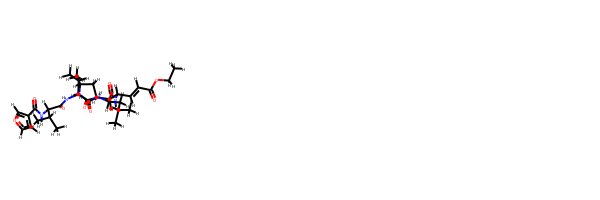

rdkit:  [H]C(C(=O)OC([H])([H])C([H])([H])[H])=C([H])C([H])(N([H])C(=O)C([H])(N([H])C(=O)C([H])(N([H])C(=O)C([H])(N([H])C(=O)c1c([H])oc([H])c1[H])C([H])(C([H])([H])[H])C([H])([H])[H])C([H])(C([H])([H])[H])C([H])([H])[H])C([H])([H])C([H])(C([H])([H])[H])C([H])([H])[H])C([H])([H])C1([H])C(=O)N([H])C([H])([H])C1([H])[H]
oechem:  CCOC(=O)C=CC(CC1CCNC1=O)NC(=O)C(CC(C)C)NC(=O)C(C(C)C)NC(=O)C(C(C)C)NC(=O)c2ccoc2
###########################################################################
 #########################################################

bond
16.60588218379777 kJ/mol 57393.25981375414 kJ/mol False
angle
35.072225948133784 kJ/mol 35.29067165219075 kJ/mol False
nb
75.32106598934968 kJ/mol 75.32106598934968 kJ/mol True
torsion
69.66723904682041 kJ/mol 51.68486447636804 kJ/mol False
196.66641316810166 kJ/mol 57555.55641587205 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
----------------------

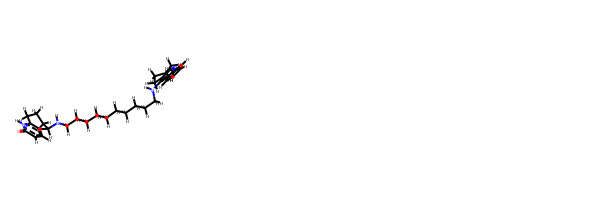

rdkit:  [H]c1c2c(n([H])c(=O)c1[H])C([H])([H])C([H])([H])C([H])([H])C2([H])N([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])N([H])c1c2c(nc3c([H])c([H])c([H])c([H])c13)C([H])([H])C([H])([H])C([H])([H])C2([H])[H]
oechem:  c1ccc2c(c1)c(c3c(n2)CCCC3)NCCCCCCCCCCNC4CCCc5c4ccc(=O)[nH]5
###########################################################################
 #########################################################

bond
16.96926713553485 kJ/mol 57392.32539434121 kJ/mol False
angle
35.16395995205752 kJ/mol 35.38233984058973 kJ/mol False
nb
74.08628878526964 kJ/mol 74.08628878526964 kJ/mol True
torsion
69.62742703944066 kJ/mol 51.64341985710623 kJ/mol False
195.84694291230267 kJ/mol 57553.43744282418 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4174


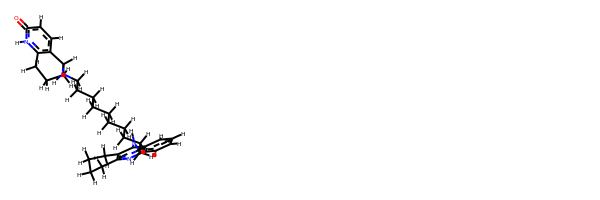

rdkit:  [H]c1c2c(n([H])c(=O)c1[H])C([H])([H])C([H])([H])C([H])([H])C2([H])N([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])N([H])c1c2c(nc3c([H])c([H])c([H])c([H])c13)C([H])([H])C([H])([H])C([H])([H])C2([H])[H]
oechem:  c1ccc2c(c1)c(c3c(n2)CCCC3)NCCCCCCCCCCNC4CCCc5c4ccc(=O)[nH]5
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #################################

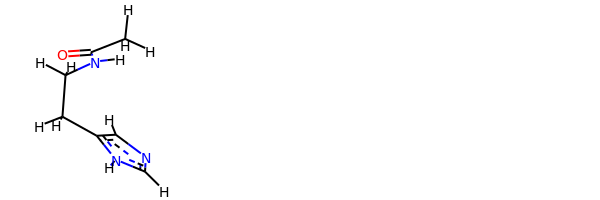

rdkit:  [H]c1nc([H])n([H])c1C([H])([H])C([H])([H])N([H])C(=O)C([H])([H])[H]
oechem:  CC(=O)NCCc1cnc[nH]1
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
32.03456247445154 kJ/mol 58165.511317763434 kJ/mol False
angle
299.49810845301687 kJ/mol 299.49810845301687 kJ/mol True
nb
7.760237891037204 kJ/mol 7.760237891037204 kJ/mol True
torsion
115.5218329928262 kJ/mol 77.12745873631034 kJ/mol False
454.8147418113318 kJ/mol 58549.897122843795 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
----------------------------------------------------

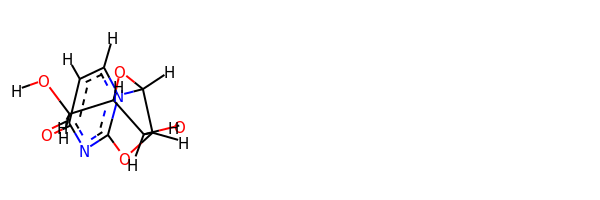

rdkit:  [H]OC([H])([H])C1([H])OC2([H])n3c(nc(=O)c([H])c3[H])OC2([H])C1([H])O[H]
oechem:  c1cn2c(nc1=O)OC3C2OC(C3O)CO
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
27.767994437345394 kJ/mol 57584.57222605116 kJ/mol False
angle
27.836513087502713 kJ/mol 28.0138875338583 kJ/mol False
nb
18.14512669436077 kJ/mol 18.14512669436077 kJ/mol True
torsion
90.03260199088487 kJ/mol 61.84311585653789 kJ/mol False
163.78223621009374 kJ/mol 57692.57435613592 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4188


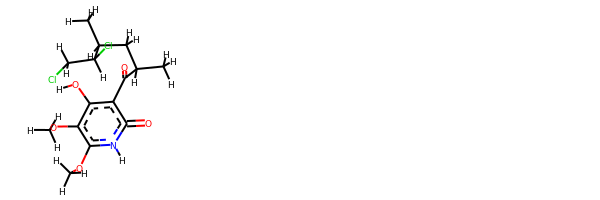

rdkit:  [H]Oc1c(OC([H])([H])[H])c(OC([H])([H])[H])n([H])c(=O)c1C(=O)C([H])(C([H])([H])[H])C([H])([H])C([H])(C([H])([H])[H])C([H])(Cl)C([H])([H])Cl
oechem:  CC(CC(C)C(=O)c1c(c(c([nH]c1=O)OC)OC)O)C(CCl)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ########################################

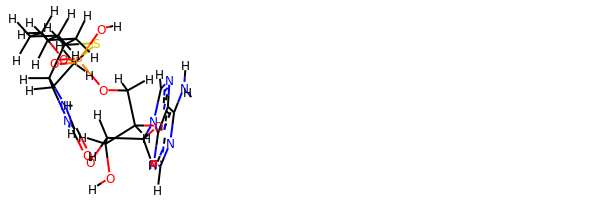

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)OC([H])(C([H])([H])OP(=O)(O[H])OC([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C2([H])SC([H])([H])C3([H])N([H])C(=O)N([H])C23[H])C1([H])O[H]
oechem:  c1nc(c2c(n1)n(cn2)C3C(C(C(O3)COP(=O)(O)OCCCCCC4C5C(CS4)NC(=O)N5)O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###############################

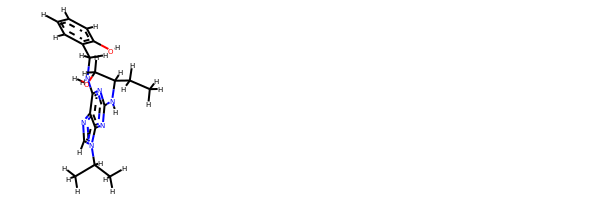

rdkit:  [H]Oc1c([H])c([H])c([H])c([H])c1C([H])([H])N([H])c1nc(N([H])C([H])(C([H])([H])O[H])C([H])([H])C([H])([H])[H])nc2c1nc([H])n2C([H])(C([H])([H])[H])C([H])([H])[H]
oechem:  CCC(CO)Nc1nc(c2c(n1)n(cn2)C(C)C)NCc3ccccc3O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
19.911184423532912 kJ/mol 56575.266814009956 kJ/mol False
angle
5.50958811092616 kJ/mol 5.50958811092616 kJ/mol True
nb
22.855286253288572 kJ/mol 22.855286253288572 kJ/mol True
torsion
0.0004781176318802308 kJ/mol 0.0007137552644980655 kJ/mol False
48.27653690537952 kJ/mol 56603.632402129435 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-----------------------------------------------------------------

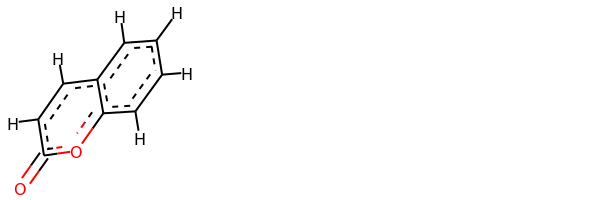

rdkit:  [H]c1c([H])c([H])c2c([H])c([H])c(=O)oc2c1[H]
oechem:  c1ccc2c(c1)ccc(=O)o2
###########################################################################
 #########################################################

bond
43.13764618626011 kJ/mol 28737.889814374623 kJ/mol False
angle
120.28868106838331 kJ/mol 122.68724985767338 kJ/mol False
nb
46.52692963795476 kJ/mol 46.52692963795476 kJ/mol True
torsion
15.69577349251422 kJ/mol 15.695732475425821 kJ/mol False
225.64903038511238 kJ/mol 28922.79972634568 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4222


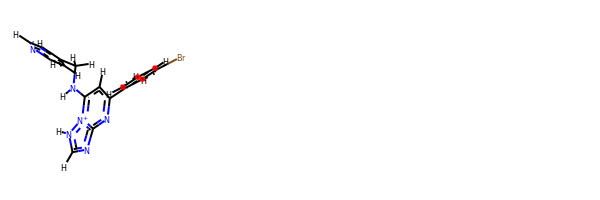

rdkit:  [H]c1nc([H])c([H])c(C([H])([H])N([H])c2c([H])c(-c3c([H])c([H])c([H])c(Br)c3[H])nc3nc([H])n([H])[n+]23)c1[H]
oechem:  c1cc(cc(c1)Br)c2cc([n+]3c(n2)nc[nH]3)NCc4ccncc4
###########################################################################
 #########################################################

bond
48.830706616666895 kJ/mol 113899.84180381877 kJ/mol False
angle
223.3116512882083 kJ/mol 223.93256607319762 kJ/mol False
nb
23.461900784386174 kJ/mol 23.461900784386174 kJ/mol True
torsion
115.27410642575761 kJ/mol 44.44207977409655 kJ/mol False
410.878365115019 kJ/mol 114191.67835045044 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4223


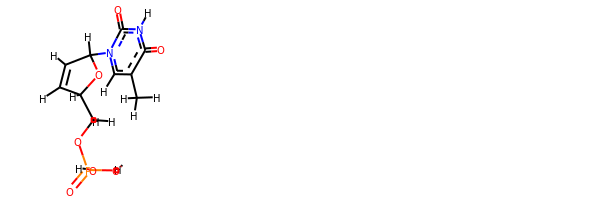

rdkit:  [H]OP(=O)(O[H])OC([H])([H])C1([H])OC([H])(n2c([H])c(C([H])([H])[H])c(=O)n([H])c2=O)C([H])=C1[H]
oechem:  Cc1cn(c(=O)[nH]c1=O)C2C=CC(O2)COP(=O)(O)O
###########################################################################
 #########################################################

bond
21.77817869791166 kJ/mol 57776.13664265749 kJ/mol False
angle
140.74507543487542 kJ/mol 141.97551756661468 kJ/mol False
nb
68.5279635576445 kJ/mol 68.5279635576445 kJ/mol True
torsion
103.81652927956581 kJ/mol 103.8168781821932 kJ/mol False
334.8677469699974 kJ/mol 58090.45700196394 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4224


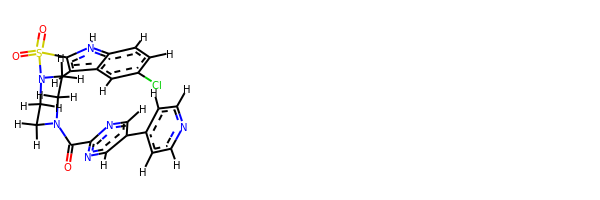

rdkit:  [H]c1nc([H])c([H])c(-c2c([H])nc(C(=O)N3C([H])([H])C([H])([H])N(S(=O)(=O)c4c([H])c5c([H])c(Cl)c([H])c([H])c5n4[H])C([H])([H])C3([H])[H])nc2[H])c1[H]
oechem:  c1cc2c(cc1Cl)cc([nH]2)S(=O)(=O)N3CCN(CC3)C(=O)c4ncc(cn4)c5ccncc5
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #############

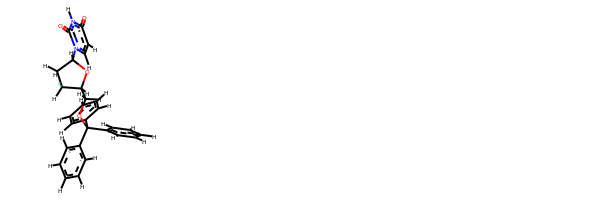

rdkit:  [H]c1c([H])c([H])c(C(OC([H])([H])C2([H])OC([H])(n3c([H])c([H])c(=O)n([H])c3=O)C([H])([H])C2([H])F)(c2c([H])c([H])c([H])c([H])c2[H])c2c([H])c([H])c([H])c([H])c2[H])c([H])c1[H]
oechem:  c1ccc(cc1)C(c2ccccc2)(c3ccccc3)OCC4C(CC(O4)n5ccc(=O)[nH]c5=O)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
27.939067375977935 kJ/mol 57781.00084878196 kJ/mol False
angle
101.81324321968465 kJ/mol 101.81324321968465 kJ/mol True
nb
82.81077361404836 kJ/mol 82.81077361404836 kJ/mol True
torsion
62.44868111405457 kJ/mol 42.351697209092464 kJ/mol False
275.01176532376553 kJ/mol 58007.97656282479 kJ/mol

-------------------------------------

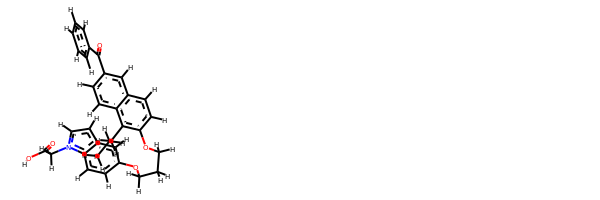

rdkit:  [H]OC(=O)C([H])([H])n1c([H])c([H])c2c([H])c(OC([H])([H])C([H])([H])C([H])([H])Oc3c([H])c([H])c4c([H])c(C(=O)c5c([H])c([H])c([H])c([H])c5[H])c([H])c([H])c4c3C([H])([H])C([H])([H])C([H])([H])[H])c([H])c([H])c21
oechem:  CCCc1c2ccc(cc2ccc1OCCCOc3ccc4c(c3)ccn4CC(=O)O)C(=O)c5ccccc5
###########################################################################
 #########################################################

bond
26.908223590136377 kJ/mol 57318.80263032565 kJ/mol False
angle
166.22471516350987 kJ/mol 166.22471516350987 kJ/mol True
nb
65.58242408068023 kJ/mol 65.58242408068023 kJ/mol True
torsion
31.76037553398985 kJ/mol 22.580878156164435 kJ/mol False
290.47573836831634 kJ/mol 57573.190647726005 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4240


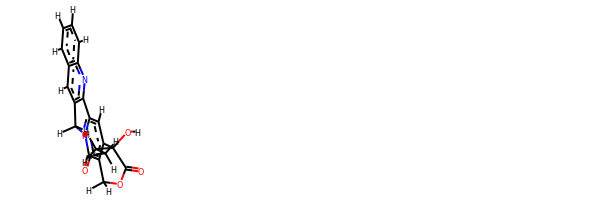

rdkit:  [H]OC1(C([H])([H])C([H])([H])[H])C(=O)OC([H])([H])c2c1c([H])c1n(c2=O)C([H])([H])c2c-1nc1c([H])c([H])c([H])c([H])c1c2[H]
oechem:  CCC1(c2cc-3n(c(=O)c2COC1=O)Cc4c3nc5ccccc5c4)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

#

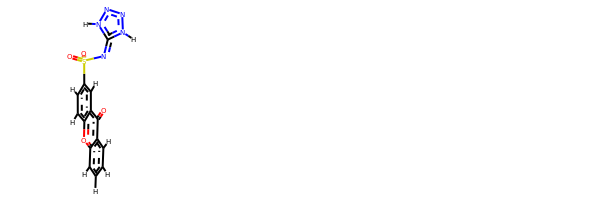

rdkit:  [H]c1c([H])c([H])c2c(=O)c3c([H])c(S(=O)(=O)N=c4n([H])nnn4[H])c([H])c([H])c3oc2c1[H]
oechem:  c1ccc2c(c1)c(=O)c3cc(ccc3o2)S(=O)(=O)N=c4[nH]nn[nH]4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

##############################

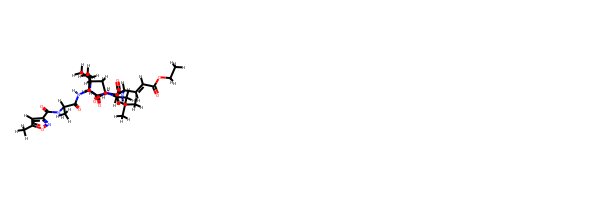

rdkit:  [H]C(C(=O)OC([H])([H])C([H])([H])[H])=C([H])C([H])(N([H])C(=O)C([H])(N([H])C(=O)C([H])(N([H])C(=O)C([H])(N([H])C(=O)c1noc(C([H])([H])[H])c1[H])C([H])([H])[H])C([H])(C([H])([H])[H])C([H])([H])[H])C([H])([H])C([H])(C([H])([H])[H])C([H])([H])[H])C([H])([H])C1([H])C(=O)N([H])C([H])([H])C1([H])[H]
oechem:  CCOC(=O)C=CC(CC1CCNC1=O)NC(=O)C(CC(C)C)NC(=O)C(C(C)C)NC(=O)C(C)NC(=O)c2cc(on2)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
11.780607895260763 kJ/mol 57926.94941691715 kJ/mol False
angle
106.16806443419905 kJ/mol 106.16806443419905 kJ/mol True
nb
25.058715828202732 kJ/mol 25.058715828202732 kJ/mol True
torsion
56.912431767474146 kJ/mol 47.02557107508461 kJ/mol False
199.9198199251367 kJ/mol 58105.201768254636 kJ/mol

-----------------------------------

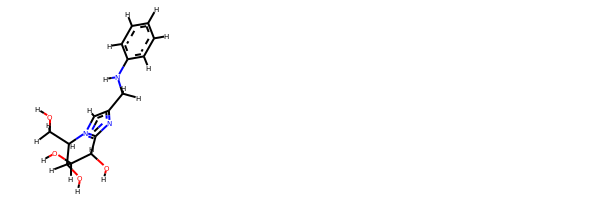

rdkit:  [H]OC([H])([H])C1([H])n2c(nc(C([H])([H])N([H])c3c([H])c([H])c([H])c([H])c3[H])c2[H])C([H])(O[H])C([H])(O[H])C1([H])O[H]
oechem:  c1ccc(cc1)NCc2cn3c(n2)C(C(C(C3CO)O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
21.669665063427217 kJ/mol 57688.36522586782 kJ/mol False
angle
98.25021308926361 kJ/mol 98.25021308926361 kJ/mol True
nb
33.204004090704586 kJ/mol 33.204004090704586 kJ/mol True
torsion
165.1859711632577 kJ/mol 158.69382644623235 kJ/mol False
318.30985340665313 kJ/mol 57978.51326949401 kJ/mol

-------------------------------------------------------------------
------------------------------------------------

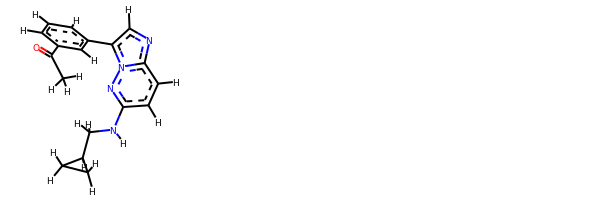

rdkit:  [H]c1nc2c([H])c([H])c(N([H])C([H])([H])C3([H])C([H])([H])C3([H])[H])nn2c1-c1c([H])c([H])c([H])c(C(=O)C([H])([H])[H])c1[H]
oechem:  CC(=O)c1cccc(c1)c2cnc3n2nc(cc3)NCC4CC4
###########################################################################
 #########################################################

bond
30.896353900542042 kJ/mol 115486.7312976786 kJ/mol False
angle
106.98004629936062 kJ/mol 109.06737417370273 kJ/mol False
nb
51.84125757867158 kJ/mol 51.84125757867158 kJ/mol True
torsion
19.234102835464068 kJ/mol 0.3635222533888406 kJ/mol False
208.9517606140383 kJ/mol 115648.00345168437 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4264


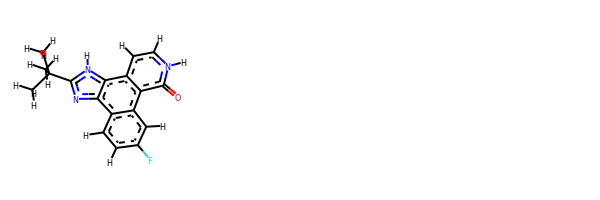

rdkit:  [H]c1c(F)c([H])c2c(c1[H])c1nc(C(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H])n([H])c1c1c([H])c([H])n([H])c(=O)c21
oechem:  CC(C)(C)c1[nH]c2c3cc[nH]c(=O)c3c4cc(ccc4c2n1)F
###########################################################################
 #########################################################

bond
5.163697067222219 kJ/mol 57920.27576872129 kJ/mol False
angle
90.47825574628301 kJ/mol 92.38246811788393 kJ/mol False
nb
48.9792770414452 kJ/mol 48.9792770414452 kJ/mol True
torsion
0.003297103133322212 kJ/mol 0.0032409533702728063 kJ/mol False
144.62452695808375 kJ/mol 58061.64075483398 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4267


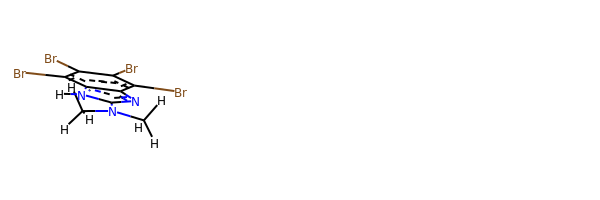

rdkit:  [H]n1c(N(C([H])([H])[H])C([H])([H])[H])nc2c(Br)c(Br)c(Br)c(Br)c21
oechem:  CN(C)c1[nH]c2c(n1)c(c(c(c2Br)Br)Br)Br
###########################################################################
 #########################################################

bond
3.757748538385752 kJ/mol 57918.86982019245 kJ/mol False
angle
83.54552322135233 kJ/mol 85.44959876111157 kJ/mol False
nb
40.78983144243907 kJ/mol 40.78983144243907 kJ/mol True
torsion
0.004830429019441327 kJ/mol 0.003431552913907673 kJ/mol False
128.09793363119658 kJ/mol 58045.11268194891 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4268


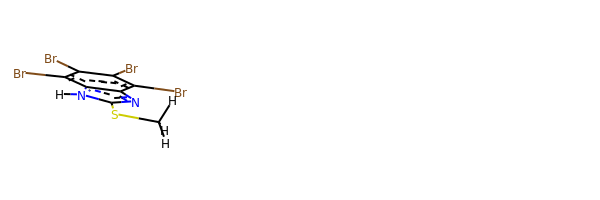

rdkit:  [H]n1c(SC([H])([H])[H])nc2c(Br)c(Br)c(Br)c(Br)c21
oechem:  CSc1[nH]c2c(n1)c(c(c(c2Br)Br)Br)Br
###########################################################################
 #########################################################

bond
10.010564072834066 kJ/mol 58574.868804450496 kJ/mol False
angle
326.3837445098727 kJ/mol 326.3837445098727 kJ/mol True
nb
40.350332781184015 kJ/mol 40.350332781184015 kJ/mol True
torsion
22.621337522996665 kJ/mol 13.11974566793254 kJ/mol False
399.3659788868875 kJ/mol 58954.72262740949 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4269


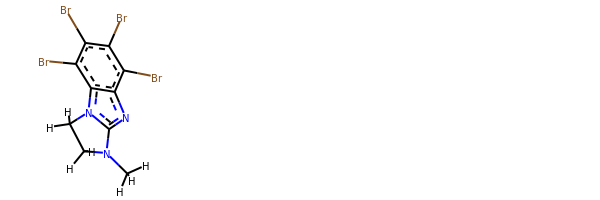

rdkit:  [H]C([H])([H])N1c2nc3c(Br)c(Br)c(Br)c(Br)c3n2C([H])([H])C1([H])[H]
oechem:  CN1CCn2c1nc3c2c(c(c(c3Br)Br)Br)Br
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
18.497079572816165 kJ/mol 58564.58342294239 kJ/mol False
angle
378.1271727901648 kJ/mol 378.1271727901648 kJ/mol True
nb
10.492958992373431 kJ/mol 10.492958992373431 kJ/mol True
torsion
54.12035292344056 kJ/mol 47.938855427205816 kJ/mol False
461.237564278795 kJ/mol 59001.14241015213 kJ/mol

----------------------------------------

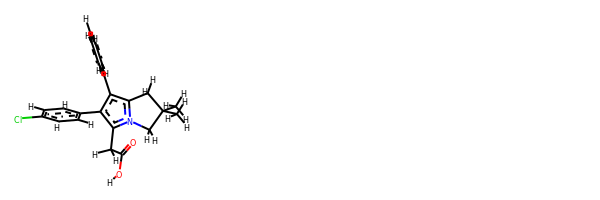

rdkit:  [H]OC(=O)C([H])([H])c1c(-c2c([H])c([H])c(Cl)c([H])c2[H])c(-c2c([H])c([H])c([H])c([H])c2[H])c2n1C([H])([H])C(C([H])([H])[H])(C([H])([H])[H])C2([H])[H]
oechem:  CC1(Cc2c(c(c(n2C1)CC(=O)O)c3ccc(cc3)Cl)c4ccccc4)C
###########################################################################
 #########################################################

bond
24.212576751638146 kJ/mol 113791.69753103139 kJ/mol False
angle
27.486469101311446 kJ/mol 27.953834231334746 kJ/mol False
nb
69.14455470728991 kJ/mol 69.14455470728991 kJ/mol True
torsion
33.47259765423291 kJ/mol 0.0012594827695181915 kJ/mol False
154.31619821447242 kJ/mol 113888.79717945278 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4274


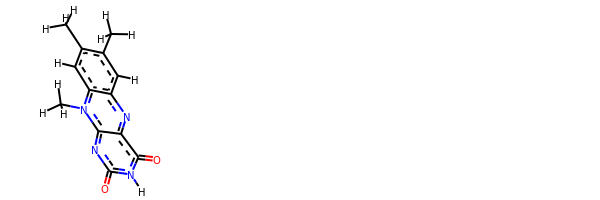

rdkit:  [H]c1c(C([H])([H])[H])c(C([H])([H])[H])c([H])c2c1nc1c(=O)n([H])c(=O)nc-1n2C([H])([H])[H]
oechem:  Cc1cc2c(cc1C)n(c-3nc(=O)[nH]c(=O)c3n2)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

######################################

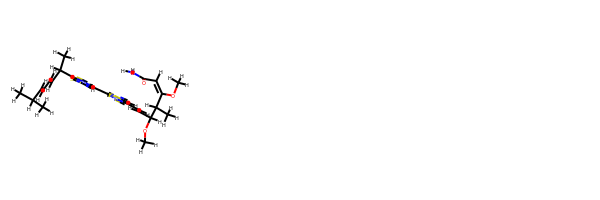

rdkit:  [H]C(C([H])=C([H])C([H])(C([H])([H])[H])C([H])([H])[H])=C([H])C([H])(c1nc(-c2nc(C([H])=C([H])C([H])(OC([H])([H])[H])C([H])(C(OC([H])([H])[H])=C([H])C(=O)N([H])[H])C([H])([H])[H])c([H])s2)c([H])s1)C([H])([H])[H]
oechem:  CC(C)C=CC=CC(C)c1nc(cs1)c2nc(cs2)C=CC(C(C)C(=CC(=O)N)OC)OC
###########################################################################
 #########################################################

bond
22.254324237166287 kJ/mol 43810.40838497106 kJ/mol False
angle
71.69077229684086 kJ/mol 73.84320489834404 kJ/mol False
nb
7.833088406368178 kJ/mol 7.833088406368178 kJ/mol True
torsion
51.90525080011072 kJ/mol 45.646136683153124 kJ/mol False
153.68343574048606 kJ/mol 43937.73081495892 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4288


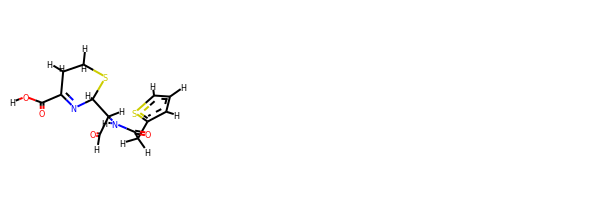

rdkit:  [H]OC(=O)C1=NC([H])(C([H])(C([H])=O)N([H])C(=O)C([H])([H])c2sc([H])c([H])c2[H])SC([H])([H])C1([H])[H]
oechem:  c1cc(sc1)CC(=O)NC(C=O)C2N=C(CCS2)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
9.335602637887078 kJ/mol 56860.198224588916 kJ/mol False
angle
5.060411591798956 kJ/mol 5.20208288505787 kJ/mol False
nb
24.25250418397115 kJ/mol 24.25250418397115 kJ/mol True
torsion
16.73607382917837 kJ/mol 9.167632448819678e-05 kJ/mol False
55.38459224283555 kJ/mol 56889.65290333427 kJ/mol

-------------------------------------------------------------------
-----------------------------------------------------------------

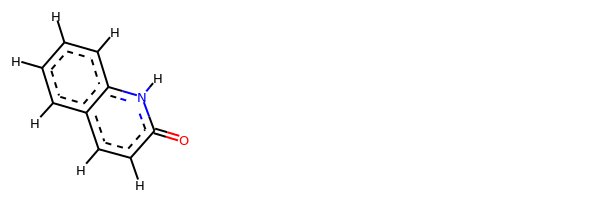

rdkit:  [H]c1c([H])c([H])c2c(c1[H])c([H])c([H])c(=O)n2[H]
oechem:  c1ccc2c(c1)ccc(=O)[nH]2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
42.070372674143485 kJ/mol 43712.11175992781 kJ/mol False
angle
300.80191784473527 kJ/mol 304.15911668723004 kJ/mol False
nb
11.915489426332966 kJ/mol 11.915489426332966 kJ/mol True
torsion
190.01697447037105 kJ/mol 182.39329242246635 kJ/mol False
544.8047544155828 kJ/mol 44210.57965846384 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
--------------------------------------------------------------

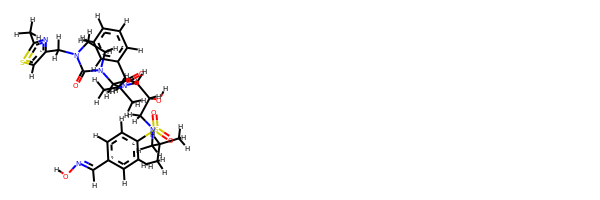

rdkit:  [H]ON=C([H])c1c([H])c([H])c(S(=O)(=O)N(C([H])([H])C([H])(O[H])C([H])(N([H])C(=O)C([H])(N2C(=O)N(C([H])([H])c3nc(C([H])([H])[H])sc3[H])C([H])([H])C2([H])[H])C([H])(C([H])([H])[H])C([H])([H])[H])C([H])([H])c2c([H])c([H])c([H])c([H])c2[H])C([H])([H])C([H])(C([H])([H])[H])C([H])([H])[H])c([H])c1[H]
oechem:  Cc1nc(cs1)CN2CCN(C2=O)C(C(C)C)C(=O)NC(Cc3ccccc3)C(CN(CC(C)C)S(=O)(=O)c4ccc(cc4)C=NO)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
22.478206095766147 kJ/mol 57599.59822625189 kJ/mol False
angle
30.694130463237776 kJ/mol 30.694130463237776 kJ/mol True
nb
54.772094082215865 kJ/mol 54.772094082215865 kJ/mol True
torsion
58.98499046995903 kJ/mol 58.98525802987206 kJ/mol False
166.9294211111788 kJ/mol 57744.04970882721 kJ/mol

-----------------------------

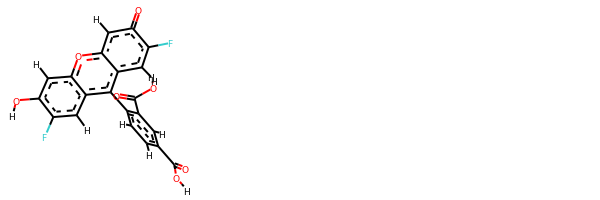

rdkit:  [H]OC(=O)c1c([H])c([H])c(-c2c3c([H])c(F)c(=O)c([H])c-3oc3c([H])c(O[H])c(F)c([H])c23)c(C(=O)O[H])c1[H]
oechem:  c1cc(c(cc1C(=O)O)C(=O)O)c2c3cc(c(cc3oc-4cc(=O)c(cc24)F)O)F
###########################################################################
 #########################################################

bond
11.117404530066926 kJ/mol 57993.15546121938 kJ/mol False
angle
137.4850749118145 kJ/mol 137.4850749118145 kJ/mol True
nb
48.840416771894766 kJ/mol 48.840416771894766 kJ/mol True
torsion
25.73822209348491 kJ/mol 11.364599836472232 kJ/mol False
223.1811183072611 kJ/mol 58190.84555273956 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4297


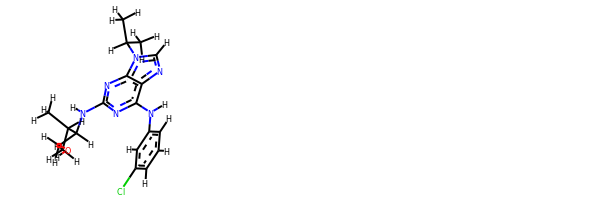

rdkit:  [H]OC([H])([H])C([H])(N([H])c1nc(N([H])c2c([H])c([H])c([H])c(Cl)c2[H])c2nc([H])n(C([H])(C([H])([H])[H])C([H])([H])[H])c2n1)C([H])(C([H])([H])[H])C([H])([H])[H]
oechem:  CC(C)C(CO)Nc1nc(c2c(n1)n(cn2)C(C)C)Nc3cccc(c3)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
53.01989078150251 kJ/mol 115986.20115672321 kJ/mol False
angle
481.3265313389678 kJ/mol 483.34568255075317 kJ/mol False
nb
-2.4696395041651993 kJ/mol -2.4696395041651993 kJ/mol True
torsion
93.56201837098418 kJ/mol 93.56217293248923 kJ/mol False
625.4388009872894 kJ/mol 116560.6393727023 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
----------------------------------------------------------------

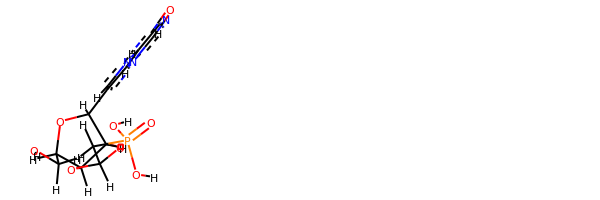

rdkit:  [H]OC([H])([H])C1([H])OC([H])(c2c([H])n([H])c3c(=O)nc([H])n([H])c23)C2([H])OC([H])(C([H])([H])P(=O)(O[H])O[H])OC12[H]
oechem:  c1c(c2c([nH]1)c(=O)nc[nH]2)C3C4C(C(O3)CO)OC(O4)CP(=O)(O)O
###########################################################################
 #########################################################

bond
55.87412513513641 kJ/mol 116297.1907807338 kJ/mol False
angle
468.98730281779933 kJ/mol 469.30317089067626 kJ/mol False
nb
-10.380294478389336 kJ/mol -10.380294478389336 kJ/mol True
torsion
137.29300810078772 kJ/mol 96.61046488621014 kJ/mol False
651.774141575334 kJ/mol 116852.72412203229 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4300


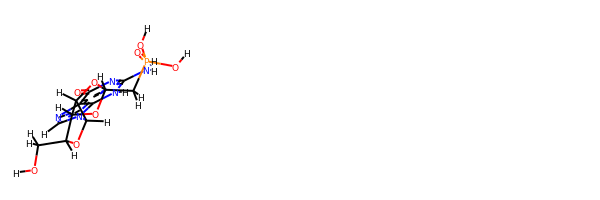

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])nc3c(=O)nc(N([H])[H])n([H])c32)C2([H])OC([H])(C([H])([H])P(=O)(O[H])O[H])OC12[H]
oechem:  c1nc2c(n1C3C4C(C(O3)CO)OC(O4)CP(=O)(O)O)[nH]c(nc2=O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
56.64287968520812 kJ/mol 116293.93125526527 kJ/mol False
angle
479.4901361560531 kJ/mol 479.8058042486294 kJ/mol False
nb
-4.721244830504393 kJ/mol -4.721244830504393 kJ/mol True
torsion
131.66931365410818 kJ/mol 90.98802088443026 kJ/mol False
663.081084664865 kJ/mol 116860.00383556781 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4302


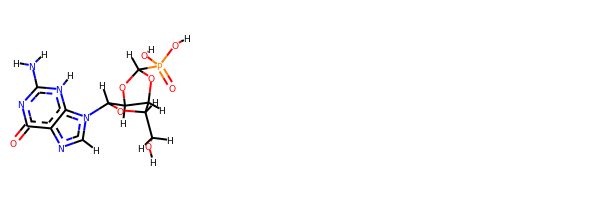

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])nc3c(=O)nc(N([H])[H])n([H])c32)C2([H])OC([H])(P(=O)(O[H])O[H])OC12[H]
oechem:  c1nc2c(n1C3C4C(C(O3)CO)OC(O4)P(=O)(O)O)[nH]c(nc2=O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

######

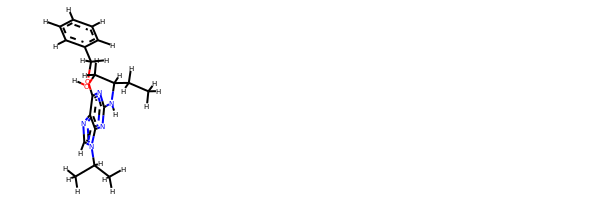

rdkit:  [H]OC([H])([H])C([H])(N([H])c1nc(OC([H])([H])c2c([H])c([H])c([H])c([H])c2[H])c2nc([H])n(C([H])(C([H])([H])[H])C([H])([H])[H])c2n1)C([H])([H])C([H])([H])[H]
oechem:  CCC(CO)Nc1nc2c(c(n1)OCc3ccccc3)ncn2C(C)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
9.46168141489392 kJ/mol 57989.26317929528 kJ/mol False
angle
114.72207968252839 kJ/mol 114.72207968252839 kJ/mol True
nb
72.84197024252498 kJ/mol 72.84197024252498 kJ/mol True
torsion
20.32463146095991 kJ/mol 12.437552999895306 kJ/mol Fa

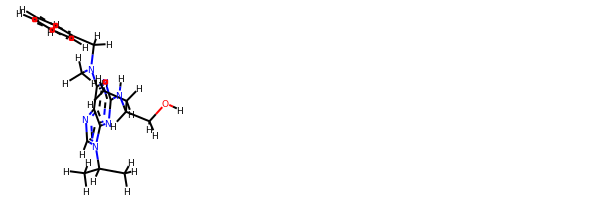

rdkit:  [H]OC([H])([H])C([H])(N([H])c1nc(N(C([H])([H])[H])C([H])([H])c2c([H])c([H])c([H])c([H])c2[H])c2nc([H])n(C([H])(C([H])([H])[H])C([H])([H])[H])c2n1)C([H])([H])C([H])([H])[H]
oechem:  CCC(CO)Nc1nc2c(c(n1)N(C)Cc3ccccc3)ncn2C(C)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ##########

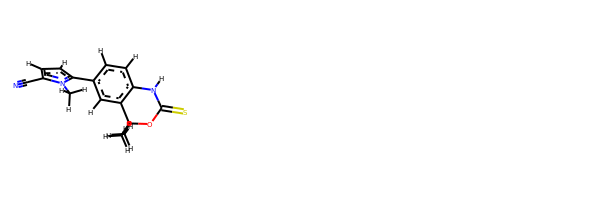

rdkit:  [H]c1c([H])c2c(c([H])c1-c1c([H])c([H])c(C#N)n1C([H])([H])[H])C(C([H])([H])[H])(C([H])([H])[H])OC(=S)N2[H]
oechem:  CC1(c2cc(ccc2NC(=S)O1)c3ccc(n3C)C#N)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
31.47030766970876 kJ/mol 57876.654176201766 kJ/mol False
angle
47.253142969916304 kJ/mol 47.56889927334513 kJ/mol False
nb
63.81831245959343 kJ/mol 63.81831245959343 kJ/mol True
torsion
32.16553640203189 kJ/mol 15.792698616086048 kJ/mol False
174.7072995012504 kJ/mol 58003.8340865508 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4333


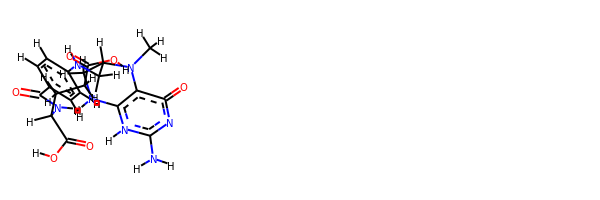

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])C([H])(C(=O)O[H])N([H])C(=O)c1c([H])c([H])c(N([H])C([H])([H])C2([H])N(C([H])([H])[H])c3c(n([H])c(N([H])[H])nc3=O)N([H])C2([H])[H])c([H])c1[H]
oechem:  CN1c2c([nH]c(nc2=O)N)NCC1CNc3ccc(cc3)C(=O)NC(CCC(=O)O)C(=O)O
###########################################################################
 #########################################################

bond
12.606057651264056 kJ/mol 43799.606196737965 kJ/mol False
angle
40.25102154334216 kJ/mol 42.40321359447415 kJ/mol False
nb
17.392328721729402 kJ/mol 17.392328721729402 kJ/mol True
torsion
0.029738874187509347 kJ/mol 0.01998973785179619 kJ/mol False
70.27914679052313 kJ/mol 43859.42172879202 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4339


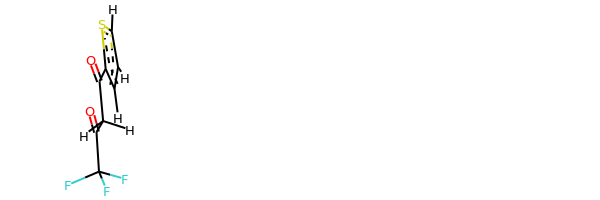

rdkit:  [H]c1sc(C(=O)C([H])([H])C(=O)C(F)(F)F)c([H])c1[H]
oechem:  c1cc(sc1)C(=O)CC(=O)C(F)(F)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
20.1837168752384 kJ/mol 144464.06153287803 kJ/mol False
angle
172.76142810893867 kJ/mol 172.76142810893867 kJ/mol True
nb
14.850079245053571 kJ/mol 14.850079245053571 kJ/mol True
torsion
33.00310726067405 kJ/mol 31.601152826783064 kJ/mol False
240.79833148990468 kJ/mol 144683.27419305878 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4341


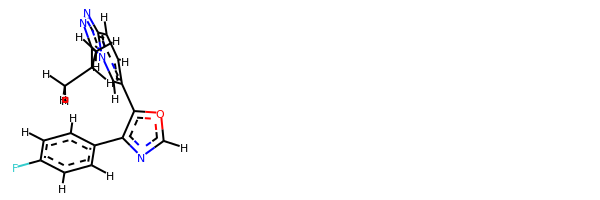

rdkit:  [H]c1nc(-c2c([H])c([H])c(F)c([H])c2[H])c(-c2c([H])c([H])c3nnc(C([H])(C([H])([H])[H])C([H])([H])[H])n3c2[H])o1
oechem:  CC(C)c1nnc2n1cc(cc2)c3c(nco3)c4ccc(cc4)F
###########################################################################
 #########################################################

bond
19.061485440681288 kJ/mol 44773.48691611117 kJ/mol False
angle
66.20933801160791 kJ/mol 66.20933801160791 kJ/mol True
nb
31.97875292053907 kJ/mol 31.97875292053907 kJ/mol True
torsion
3.761698553086343 kJ/mol 3.7617048852994275 kJ/mol False
121.0112749259146 kJ/mol 44875.43671192862 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4342


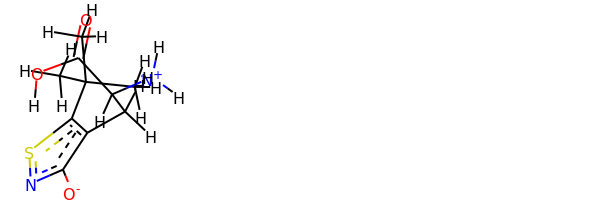

rdkit:  [H]OC(=O)C([H])(C([H])([H])c1c([O-])nsc1C(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H])[N+]([H])([H])[H]
oechem:  CC(C)(C)c1c(c(ns1)[O-])CC(C(=O)O)[NH3+]
###########################################################################
 #########################################################

bond
20.281365216331622 kJ/mol 43958.261463927985 kJ/mol False
angle
59.37660869110196 kJ/mol 62.944074604942195 kJ/mol False
nb
23.222710476871416 kJ/mol 23.222710476871416 kJ/mol True
torsion
13.943831651986065 kJ/mol 13.9432625276718 kJ/mol False
116.82451603629106 kJ/mol 44058.37151153747 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4343


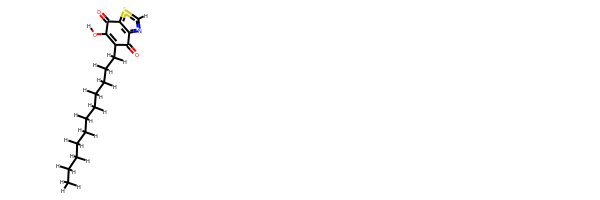

rdkit:  [H]OC1=C(C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])[H])C(=O)c2nc([H])sc2C1=O
oechem:  CCCCCCCCCCCC1=C(C(=O)c2c(ncs2)C1=O)O
###########################################################################
 #########################################################

bond
22.511218397190603 kJ/mol 29090.289069278464 kJ/mol False
angle
101.14074534182247 kJ/mol 101.14074534182247 kJ/mol True
nb
12.457242509551321 kJ/mol 12.457242509551321 kJ/mol True
torsion
31.55933168722944 kJ/mol 29.46629014851155 kJ/mol False
167.66853793579384 kJ/mol 29233.353347278346 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4344


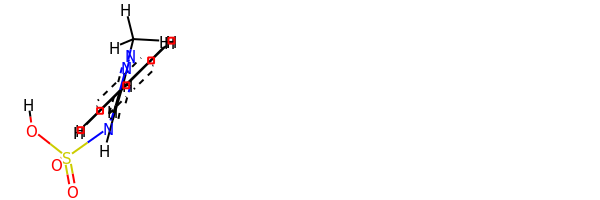

rdkit:  [H]OS(=O)(=O)N([H])c1c([H])c(-c2c([H])c([H])c([H])c([H])c2[H])nn1C([H])([H])[H]
oechem:  Cn1c(cc(n1)c2ccccc2)NS(=O)(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
75.45008287920305 kJ/mol 134.75348107796043 kJ/mol False
angle
1187.841992968168 kJ/mol 1187.8487035911533 kJ/mol False
nb
28.426751033485992 kJ/mol 28.426751033485992 kJ/mol True
torsion
72.65594561825382 kJ/mol 281.0520118009526 kJ/mol False
1364.3747724991108 kJ/mol 1632.0809475035524 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4346


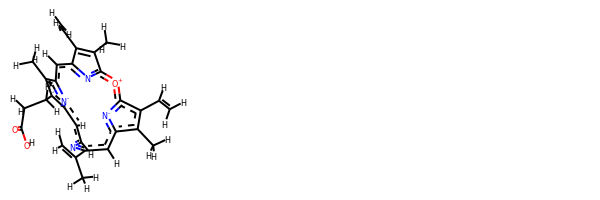

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])c1c(C([H])([H])[H])c2[n-]c1c([H])c([H])nc(C(=C([H])[H])C([H])([H])[H])c([H])c1[n-]c([o+]c3nc(c2[H])C(C([H])=C([H])[H])=C3C([H])([H])[H])c(C([H])=C([H])[H])c1C([H])([H])[H]
oechem:  Cc1c2cc3nc([o+]c4c(c(c([n-]4)cc(nccc(c1CCC(=O)O)[n-]2)C(=C)C)C)C=C)C(=C3C=C)C
###########################################################################
 #########################################################

bond
22.77447527751338 kJ/mol 57776.8841220977 kJ/mol False
angle
97.83826109804983 kJ/mol 99.06729237074188 kJ/mol False
nb
21.19962939182872 kJ/mol 21.19962939182872 kJ/mol True
torsion
75.45092692325852 kJ/mol 75.45096655212731 kJ/mol False
217.26329269065045 kJ/mol 57972.60201041239 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4348


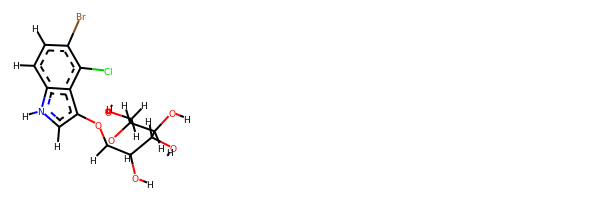

rdkit:  [H]OC([H])([H])C1([H])OC([H])(Oc2c([H])n([H])c3c([H])c([H])c(Br)c(Cl)c23)C([H])(O[H])C([H])(O[H])C1([H])O[H]
oechem:  c1cc(c(c2c1[nH]cc2OC3C(C(C(C(O3)CO)O)O)O)Cl)Br
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########

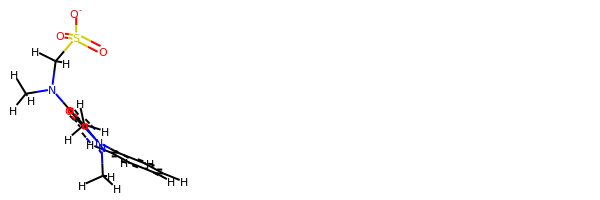

rdkit:  [H]c1c([H])c([H])c(-n2c(=O)c(N(C([H])([H])[H])C([H])([H])S(=O)(=O)[O-])c(C([H])([H])[H])n2C([H])([H])[H])c([H])c1[H]
oechem:  Cc1c(c(=O)n(n1C)c2ccccc2)N(C)CS(=O)(=O)[O-]
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
11.785237636324048 kJ/mol 43799.64627332537 kJ/mol False
angle
42.670181408050645 kJ/mol 44.82265988016039 kJ/mol False
nb
51.72795064764156 kJ/mol 51.72795064764156 kJ/mol True
torsion
32.74264026402662 kJ/mol 18.741889037364928 kJ/mol False
138.9260099560429 kJ/mol 43914.93877289054 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4361


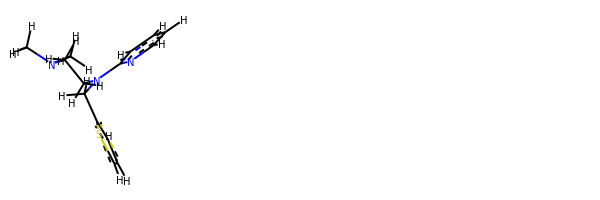

rdkit:  [H]c1nc(N(C([H])([H])c2sc([H])c([H])c2[H])C([H])([H])C([H])([H])N(C([H])([H])[H])C([H])([H])[H])c([H])c([H])c1[H]
oechem:  CN(C)CCN(Cc1cccs1)c2ccccn2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
10.268158593203083 kJ/mol 43796.605248962944 kJ/mol False
angle
35.649279980038756 kJ/mol 37.80217550565702 kJ/mol False
nb
48.587216759010644 kJ/mol 48.5872

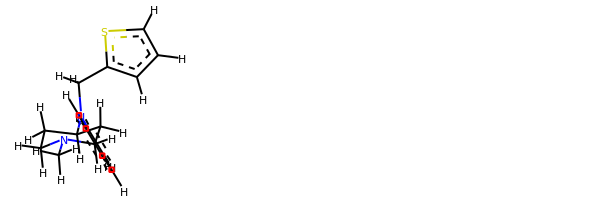

rdkit:  [H]c1sc(C([H])([H])N(c2c([H])c([H])c([H])c([H])c2[H])C2([H])C([H])([H])C([H])([H])N(C([H])([H])[H])C([H])([H])C2([H])[H])c([H])c1[H]
oechem:  CN1CCC(CC1)N(Cc2cccs2)c3ccccc3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
16.056296577667922 kJ/mol 57873.46428634707 kJ/mol False
angle
86.94194222884767 kJ/mol 86.94194222884767 kJ/mol True
nb
12.24152452491161 kJ/mol 12.24152452491161 kJ/mol True
torsion
24.56501542557275 kJ/mol 8.512234643611029 kJ/mol False
139.80477875699995 kJ/mol 57981.159987744446 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4370


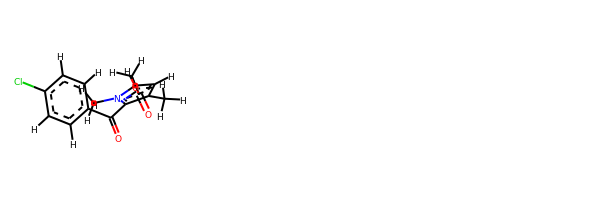

rdkit:  [H]OC(=O)C([H])([H])c1c([H])c(C([H])([H])[H])c(C(=O)c2c([H])c([H])c(Cl)c([H])c2[H])n1C([H])([H])[H]
oechem:  Cc1cc(n(c1C(=O)c2ccc(cc2)Cl)C)CC(=O)O
###########################################################################
 #########################################################

bond
27.06601142480574 kJ/mol 57544.42603187396 kJ/mol False
angle
113.5536262212329 kJ/mol 114.760123880903 kJ/mol False
nb
66.58003705765763 kJ/mol 66.58003705765763 kJ/mol True
torsion
25.651329905738834 kJ/mol 25.659171141877007 kJ/mol False
232.8510046094351 kJ/mol 57751.4253639544 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4371


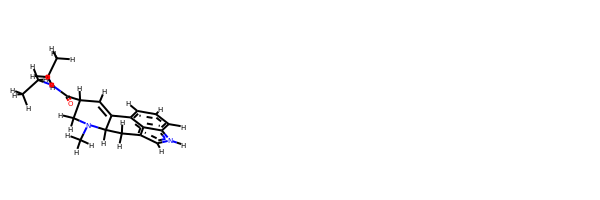

rdkit:  [H]C1=C2c3c([H])c([H])c([H])c4c3c(c([H])n4[H])C([H])([H])C2([H])N(C([H])([H])[H])C([H])([H])C1([H])C(=O)N(C([H])([H])C([H])([H])[H])C([H])([H])C([H])([H])[H]
oechem:  CCN(CC)C(=O)C1CN(C2Cc3c[nH]c4c3c(ccc4)C2=C1)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
19.36423900101262 kJ/mol 43804.22255300927 kJ/mol False
angle
47.02196874477379 kJ/mol 49.17516590182859 kJ/mol False
nb
13.301310668632981 kJ/mol 13.301310668632981 kJ/mol True
torsion
26.308380862531084 kJ/mol 26.30846219232275 kJ/mol False
105.99589927695047 kJ/mol 43893.007491772056 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
Dr

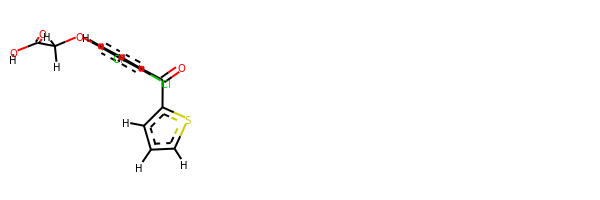

rdkit:  [H]OC(=O)C([H])([H])Oc1c([H])c([H])c(C(=O)c2sc([H])c([H])c2[H])c(Cl)c1Cl
oechem:  c1cc(sc1)C(=O)c2ccc(c(c2Cl)Cl)OCC(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
21.4287202729596 kJ/mol 56423.8446054331 kJ/mol False
angle
12.244563664719577 kJ/mol 12.244563664719577 kJ/mol True
nb
69.89275671700544 kJ/mol 69.89275671700544 kJ/mol True
torsion
16.45861075103805 kJ/mol 18.008945883191483 kJ/mol False
120.02465140572266 kJ/mol 56523.99087169801 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4375


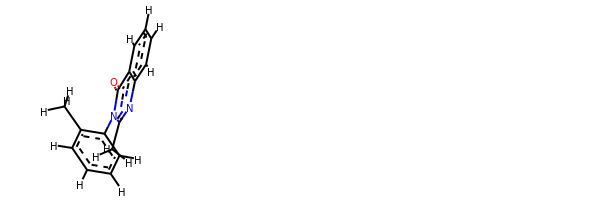

rdkit:  [H]c1c([H])c([H])c(C([H])([H])[H])c(-n2c(C([H])([H])[H])nc3c([H])c([H])c([H])c([H])c3c2=O)c1[H]
oechem:  Cc1ccccc1n2c(nc3ccccc3c2=O)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
24.32137909198588 kJ/mol 58261.063517713774 kJ/mol False
angle
470.24700279108987 kJ/mol 470.24700279108987 kJ/mol True
nb
86.46999760571853 kJ/mol 86.46999760571853 kJ/mol True
torsion
126.43458525140697 kJ/mol 103.57755397661293 kJ/mol False
707.4729647402012 kJ/mol 58921.35807208719 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4377


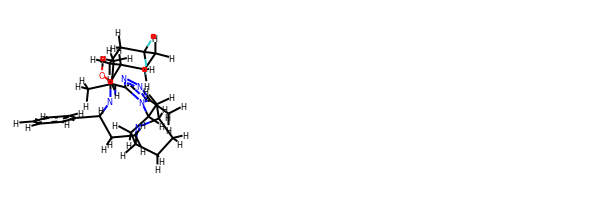

rdkit:  [H]OC(=NC([H])(c1c([H])c([H])c([H])c([H])c1[H])C([H])([H])C([H])([H])N1C2([H])C([H])([H])C([H])([H])C1([H])C([H])([H])C([H])(n1c(C([H])([H])[H])nnc1C([H])(C([H])([H])[H])C([H])([H])[H])C2([H])[H])C1([H])C([H])([H])C([H])([H])C(F)(F)C([H])([H])C1([H])[H]
oechem:  Cc1nnc(n1C2CC3CCC(C2)N3CCC(c4ccccc4)N=C(C5CCC(CC5)(F)F)O)C(C)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #############################################

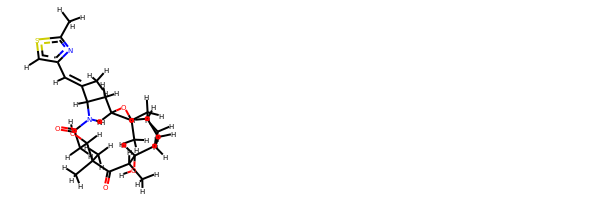

rdkit:  [H]OC1([H])C([H])(C([H])([H])[H])C(=O)C(C([H])([H])[H])(C([H])([H])[H])C([H])(O[H])C([H])([H])C(=O)N([H])C([H])(C(=C([H])c2nc(C([H])([H])[H])sc2[H])C([H])([H])[H])C([H])([H])C2([H])OC2(C([H])([H])[H])C([H])([H])C([H])([H])C([H])([H])C1([H])C([H])([H])[H]
oechem:  Cc1nc(cs1)C=C(C)C2CC3C(O3)(CCCC(C(C(C(=O)C(C(CC(=O)N2)O)(C)C)C)O)C)C
###########################################################################
 #########################################################

bond
33.85440918231827 kJ/mol 57786.372855980764 kJ/mol False
angle
386.10902309803515 kJ/mol 387.3399203917111 kJ/mol False
nb
84.2994963288214 kJ/mol 84.2994963288214 kJ/mol True
torsion
82.01228698158685 kJ/mol 82.01235617924524 kJ/mol False
586.2752155907616 kJ/mol 58340.02462888054 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4389


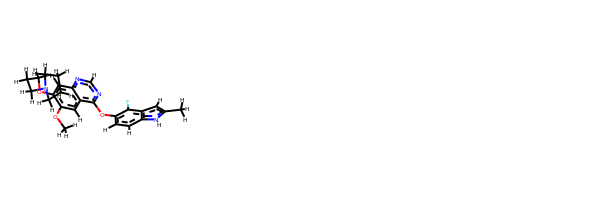

rdkit:  [H]c1nc(Oc2c([H])c([H])c3c(c([H])c(C([H])([H])[H])n3[H])c2F)c2c([H])c(OC([H])([H])[H])c(OC([H])([H])C([H])([H])C([H])([H])N3C([H])([H])C([H])([H])C([H])([H])C3([H])[H])c([H])c2n1
oechem:  Cc1cc2c([nH]1)ccc(c2F)Oc3c4cc(c(cc4ncn3)OCCCN5CCCC5)OC
###########################################################################
 #########################################################

bond
47.00271170270956 kJ/mol 57764.553536772444 kJ/mol False
angle
292.08501497464397 kJ/mol 292.08501497464397 kJ/mol True
nb
70.47972341017834 kJ/mol 70.47972341017834 kJ/mol True
torsion
90.25322242675517 kJ/mol 78.53802369806735 kJ/mol False
499.8206725142871 kJ/mol 58205.65629885534 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4390


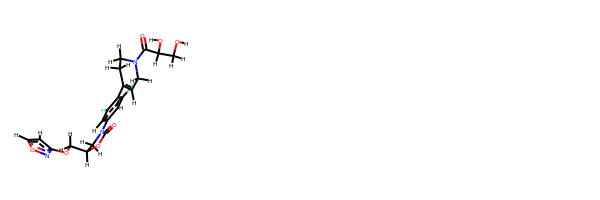

rdkit:  [H]OC([H])([H])C([H])(O[H])C(=O)N1C([H])([H])C([H])=C(c2c(F)c([H])c(N3C(=O)OC([H])(C([H])([H])Oc4noc([H])c4[H])C3([H])[H])c([H])c2F)C([H])([H])C1([H])[H]
oechem:  c1conc1OCC2CN(C(=O)O2)c3cc(c(c(c3)F)C4=CCN(CC4)C(=O)C(CO)O)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
14.316957608924472 kJ/mol 57786.015489519836 kJ/mol False
angle
508.97020554130404 kJ/mol 508.97020554130404 kJ/mol True
nb
43.282703398353895 kJ/mol 43.282703398353895 kJ/mol True
torsion
72.66450051064155 kJ/mol 52.410510102658066 kJ/mol False
639.2343670592239 kJ/mol 58390.67890856216 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
----------------------------------------------------------

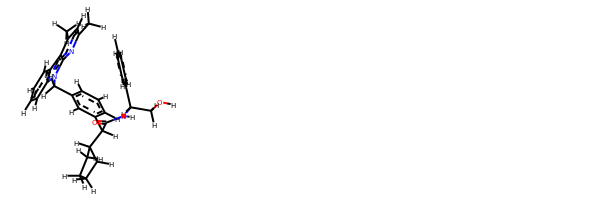

rdkit:  [H]OC([H])([H])C([H])(c1c([H])c([H])c([H])c([H])c1[H])N([H])C(=O)C([H])(c1c([H])c([H])c([H])c(C([H])([H])n2c3nc(C([H])([H])[H])c([H])c(C([H])([H])[H])c3c3c([H])c([H])c([H])c([H])c32)c1[H])C1([H])C([H])([H])C([H])([H])C([H])([H])C1([H])[H]
oechem:  Cc1cc(nc2c1c3ccccc3n2Cc4cccc(c4)C(C5CCCC5)C(=O)NC(CO)c6ccccc6)C
###########################################################################
 #########################################################

bond
25.593360600830746 kJ/mol 58006.34446069892 kJ/mol False
angle
412.815459969513 kJ/mol 412.815459969513 kJ/mol True
nb
29.649831547690088 kJ/mol 29.649831547690088 kJ/mol True
torsion
106.5147956447962 kJ/mol 82.36259311002813 kJ/mol False
574.5734477628299 kJ/mol 58531.17234532615 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4393


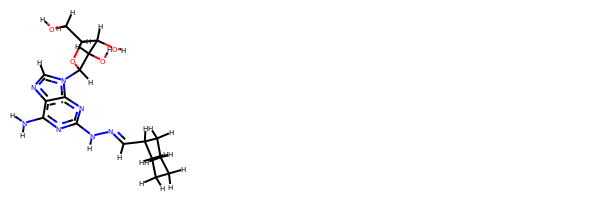

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])nc3c(N([H])[H])nc(N([H])N=C([H])C4([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C4([H])[H])nc32)C([H])(O[H])C1([H])O[H]
oechem:  c1nc2c(nc(nc2n1C3C(C(C(O3)CO)O)O)NN=CC4CCCCC4)N
###########################################################################
 #########################################################

bond
19.836094387574725 kJ/mol 43690.415493101646 kJ/mol False
angle
56.29308460944112 kJ/mol 59.650017463163856 kJ/mol False
nb
33.94975096926266 kJ/mol 33.94975096926266 kJ/mol True
torsion
29.144327517275475 kJ/mol 28.113948679851653 kJ/mol False
139.22325748355397 kJ/mol 43812.12921021392 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4394


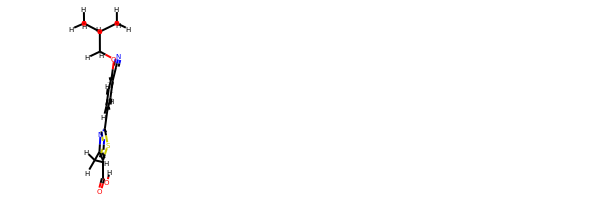

rdkit:  [H]OC(=O)c1sc(-c2c([H])c([H])c(OC([H])([H])C([H])(C([H])([H])[H])C([H])([H])[H])c(C#N)c2[H])nc1C([H])([H])[H]
oechem:  Cc1c(sc(n1)c2ccc(c(c2)C#N)OCC(C)C)C(=O)O
###########################################################################
 #########################################################

bond
33.661443343235 kJ/mol 58318.28219936146 kJ/mol False
angle
130.57180082499036 kJ/mol 130.57180082499036 kJ/mol True
nb
38.38690403035834 kJ/mol 38.38690403035834 kJ/mol True
torsion
90.21969729494772 kJ/mol 84.94585468903045 kJ/mol False
292.8398454935314 kJ/mol 58572.186758905846 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4395


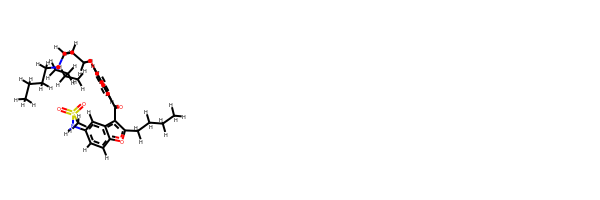

rdkit:  [H]c1c([H])c(C(=O)c2c(C([H])([H])C([H])([H])C([H])([H])C([H])([H])[H])oc3c([H])c([H])c(N([H])S(=O)(=O)C([H])([H])[H])c([H])c23)c([H])c([H])c1OC([H])([H])C([H])([H])C([H])([H])N(C([H])([H])C([H])([H])C([H])([H])C([H])([H])[H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])[H]
oechem:  CCCCc1c(c2cc(ccc2o1)NS(=O)(=O)C)C(=O)c3ccc(cc3)OCCCN(CCCC)CCCC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ##########################

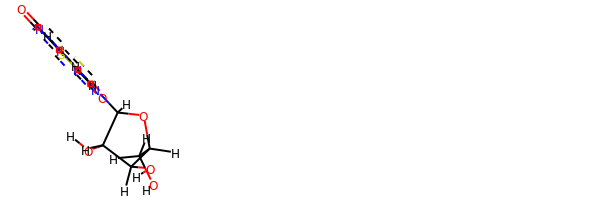

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c(=O)sc3c(=O)nc(N([H])[H])n([H])c32)C([H])(O[H])C1([H])O[H]
oechem:  C(C1C(C(C(O1)n2c3c(c(=O)nc([nH]3)N)sc2=O)O)O)O
###########################################################################
 #########################################################

bond
62.750581840477125 kJ/mol 58307.940519856274 kJ/mol False
angle
449.01918562922856 kJ/mol 449.01918562922856 kJ/mol True
nb
89.32243271149427 kJ/mol 89.32243271149427 kJ/mol True
torsion
81.23670194493185 kJ/mol 81.23670251509299 kJ/mol False
682.3289021261318 kJ/mol 58927.518840712095 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4402


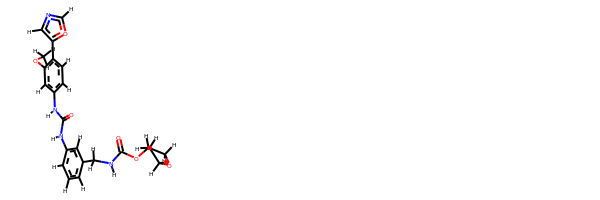

rdkit:  [H]c1nc([H])c(-c2c([H])c([H])c(N([H])C(=O)N([H])c3c([H])c([H])c([H])c(C([H])([H])N([H])C(=O)OC4([H])C([H])([H])OC([H])([H])C4([H])[H])c3[H])c([H])c2OC([H])([H])[H])o1
oechem:  COc1cc(ccc1c2cnco2)NC(=O)Nc3cccc(c3)CNC(=O)OC4CCOC4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
15.03972115205155 kJ/mol 57441.14627757171 kJ/mol False
angle
54.76101720462419 kJ/mol 54.98667422298866 kJ/mol False
nb
54.5656890722144 kJ/mol 54.5656890722144 kJ/mol True
torsion
74.29328105006601 kJ/mol 53.212114772422446 kJ/mol False
198.65970847895613 kJ/mol 57603.910755639336 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-----------------------------------------------------------

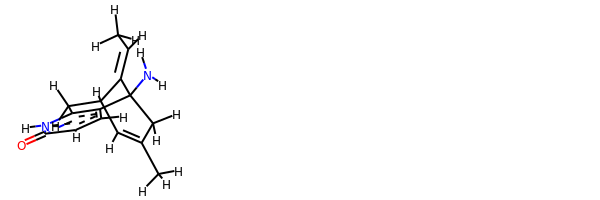

rdkit:  [H]C(=C1C2([H])C([H])=C(C([H])([H])[H])C([H])([H])C1(N([H])[H])c1c([H])c([H])c(=O)n([H])c1C2([H])[H])C([H])([H])[H]
oechem:  CC=C1C2Cc3c(ccc(=O)[nH]3)C1(CC(=C2)C)N
###########################################################################
 #########################################################

bond
28.10946634081681 kJ/mol 101451.21407283662 kJ/mol False
angle
140.29007353434022 kJ/mol 143.64489585181386 kJ/mol False
nb
27.33384499673817 kJ/mol 27.33384499673817 kJ/mol True
torsion
43.86097939369681 kJ/mol 17.914140277502884 kJ/mol False
239.59436426559202 kJ/mol 101640.10695396268 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4407


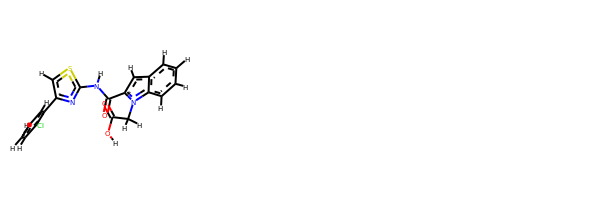

rdkit:  [H]OC(=O)C([H])([H])n1c(C(=O)N([H])c2nc(-c3c([H])c([H])c([H])c([H])c3Cl)c([H])s2)c([H])c2c([H])c([H])c([H])c([H])c21
oechem:  c1ccc2c(c1)cc(n2CC(=O)O)C(=O)Nc3nc(cs3)c4ccccc4Cl
###########################################################################
 #########################################################

bond
29.068726179169396 kJ/mol 58051.185149152574 kJ/mol False
angle
152.84642643064922 kJ/mol 152.84642643064922 kJ/mol True
nb
139.42950322432455 kJ/mol 139.42950322432455 kJ/mol True
torsion
22.779438070395546 kJ/mol 22.77937390501248 kJ/mol False
344.1240939045387 kJ/mol 58366.240452712555 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4408


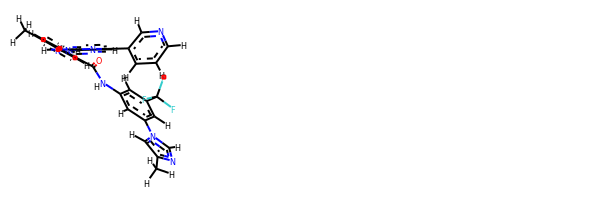

rdkit:  [H]c1nc(N([H])c2c([H])c(C(=O)N([H])c3c([H])c(-n4c([H])nc(C([H])([H])[H])c4[H])c([H])c(C(F)(F)F)c3[H])c([H])c([H])c2C([H])([H])[H])nc(-c2c([H])nc([H])c([H])c2[H])c1[H]
oechem:  Cc1ccc(cc1Nc2nccc(n2)c3cccnc3)C(=O)Nc4cc(cc(c4)n5cc(nc5)C)C(F)(F)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
23.83136604416986 kJ/mol 57640.555614615936 kJ/mol False
angle
9

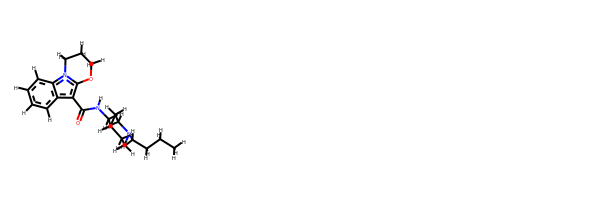

rdkit:  [H]c1c([H])c([H])c2c(c1[H])c(C(=O)N([H])C([H])([H])C1([H])C([H])([H])C([H])([H])N(C([H])([H])C([H])([H])C([H])([H])C([H])([H])[H])C([H])([H])C1([H])[H])c1n2C([H])([H])C([H])([H])C([H])([H])O1
oechem:  CCCCN1CCC(CC1)CNC(=O)c2c3ccccc3n4c2OCCC4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
36.838572558808615 kJ/mol 113371.4904717021 kJ/mol False
angle
84

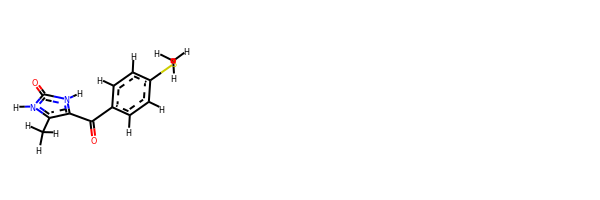

rdkit:  [H]c1c([H])c(C(=O)c2c(C([H])([H])[H])n([H])c(=O)n2[H])c([H])c([H])c1SC([H])([H])[H]
oechem:  Cc1c([nH]c(=O)[nH]1)C(=O)c2ccc(cc2)SC
###########################################################################
 #########################################################

bond
43.34403054253723 kJ/mol 56591.06891368588 kJ/mol False
angle
26.149814811619574 kJ/mol 26.33348328565941 kJ/mol False
nb
105.54576223100653 kJ/mol 105.54576223100653 kJ/mol True
torsion
71.96357656350743 kJ/mol 71.96423920927867 kJ/mol False
247.00318414867078 kJ/mol 56794.91239841182 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4421


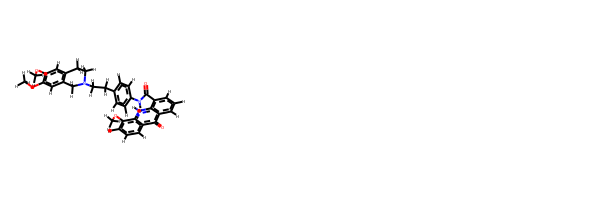

rdkit:  [H]c1c([H])c(C([H])([H])C([H])([H])N2C([H])([H])c3c([H])c(OC([H])([H])[H])c(OC([H])([H])[H])c([H])c3C([H])([H])C2([H])[H])c([H])c([H])c1N([H])C(=O)c1c([H])c([H])c([H])c2c(=O)c3c([H])c([H])c([H])c(OC([H])([H])[H])c3n([H])c12
oechem:  COc1cccc2c1[nH]c3c(c2=O)cccc3C(=O)Nc4ccc(cc4)CCN5CCc6cc(c(cc6C5)OC)OC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
15.299997122017153 kJ/mol 116041.46575895583 kJ/mol False
angle
220.59765476323983 kJ/mol 220.59765476323983 kJ/mol True
nb
28.21736576213158 kJ/mol 28.21736576213158 kJ/mol True
torsion
13.38617688753661 kJ/mol 7.867501558882677 kJ/mol False
277.50119453492516 kJ/mol 116298.

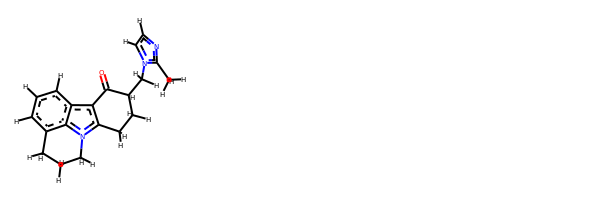

rdkit:  [H]c1nc(C([H])([H])[H])n(C([H])([H])C2([H])C(=O)c3c(n4c5c(c([H])c([H])c([H])c35)C([H])([H])C([H])([H])C4([H])[H])C([H])([H])C2([H])[H])c1[H]
oechem:  Cc1nccn1CC2CCc3c(c4cccc5c4n3CCC5)C2=O
###########################################################################
 #########################################################

bond
46.56941816356467 kJ/mol 56668.479786167394 kJ/mol False
angle
33.138207264966596 kJ/mol 33.138207264966596 kJ/mol True
nb
92.36962252642296 kJ/mol 92.36962252642296 kJ/mol True
torsion
51.382462781045085 kJ/mol 51.38477392111076 kJ/mol False
223.4597107359993 kJ/mol 56845.37238987989 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4426


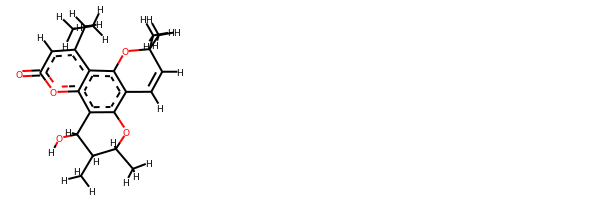

rdkit:  [H]OC1([H])c2c(c3c(c4c(C([H])([H])C([H])([H])C([H])([H])[H])c([H])c(=O)oc24)OC(C([H])([H])[H])(C([H])([H])[H])C([H])=C3[H])OC([H])(C([H])([H])[H])C1([H])C([H])([H])[H]
oechem:  CCCc1cc(=O)oc2c1c3c(c4c2C(C(C(O4)C)C)O)C=CC(O3)(C)C
###########################################################################
 #########################################################

bond
71.06698389599562 kJ/mol 43744.039318690215 kJ/mol False
angle
654.6377773793942 kJ/mol 657.994086237028 kJ/mol False
nb
43.678638927034314 kJ/mol 43.678638927034314 kJ/mol True
torsion
249.4281395311344 kJ/mol 241.80484889556396 kJ/mol False
1018.8115397335584 kJ/mol 44687.51689274984 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4427


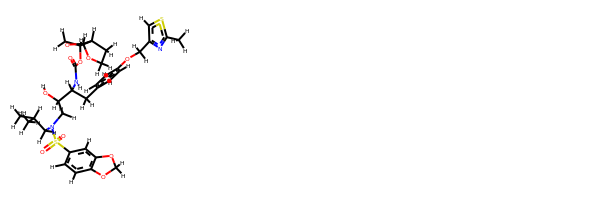

rdkit:  [H]OC([H])(C([H])([H])N(C([H])([H])C([H])(C([H])([H])[H])C([H])([H])[H])S(=O)(=O)c1c([H])c([H])c2c(c1[H])OC([H])([H])O2)C([H])(N([H])C(=O)OC1([H])C([H])([H])OC2([H])OC([H])([H])C([H])([H])C21[H])C([H])([H])c1c([H])c([H])c(OC([H])([H])c2nc(C([H])([H])[H])sc2[H])c([H])c1[H]
oechem:  Cc1nc(cs1)COc2ccc(cc2)CC(C(CN(CC(C)C)S(=O)(=O)c3ccc4c(c3)OCO4)O)NC(=O)OC5COC6C5CCO6
###########################################################################
 #########################################################

bond
25.386997721566033 kJ/mol 114270.25337818627 kJ/mol False
angle
86.17240486047235 kJ/mol 88.12946995455763 kJ/mol False
nb
67.96420405041398 kJ/mol 67.96420405041398 kJ/mol True
torsion
28.002043237016977 kJ/mol 28.00204863522503 kJ/mol False
207.52564986946936 kJ/mol 114454.34910082647 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-----------------------------------------------------

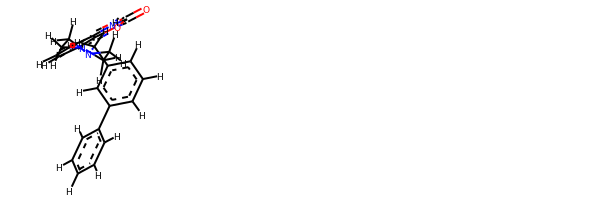

rdkit:  [H]c1c([H])c([H])c(-c2c([H])c([H])c([H])c(C([H])([H])N3C([H])([H])C([H])([H])N(c4c([H])c([H])c([H])c5c4oc(=O)n5[H])C([H])([H])C3([H])[H])c2[H])c([H])c1[H]
oechem:  c1ccc(cc1)c2cccc(c2)CN3CCN(CC3)c4cccc5c4oc(=O)[nH]5
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ###################

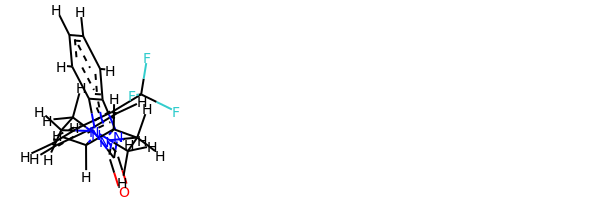

rdkit:  [H]c1c([H])c(N2C([H])([H])C([H])([H])N(C([H])([H])C([H])([H])n3c(=O)n([H])c4c([H])c([H])c([H])c([H])c43)C([H])([H])C2([H])[H])c([H])c(C(F)(F)F)c1[H]
oechem:  c1ccc2c(c1)[nH]c(=O)n2CCN3CCN(CC3)c4cccc(c4)C(F)(F)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
28.17606099746837 kJ/mol 57943.28813265152 kJ/mol False
angle
106.20763715435068 kJ/mol 108.11187589885289 kJ/mol False
nb
31.22861672476347 kJ/mol 31.22861672476347 kJ/mol True
torsion
35.26488424454095 kJ/mol 18.528864707249213 kJ/mol False
200.87719912112345 kJ/mol 58101.15748998239 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugB

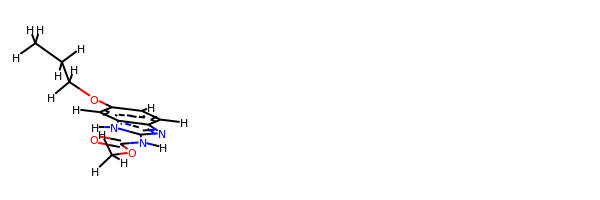

rdkit:  [H]c1c(OC([H])([H])C([H])([H])C([H])([H])[H])c([H])c2c(nc(N([H])C(=O)OC([H])([H])[H])n2[H])c1[H]
oechem:  CCCOc1ccc2c(c1)[nH]c(n2)NC(=O)OC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
35.86036645693935 kJ/mol 44510.386199357716 kJ/mol False
angle
859.826377178486 kJ/mol 859.826377178486 kJ/mol True
nb
604.7110831611618 kJ/mol 604.7110831611618 kJ/mol True
torsion
180.33062101367355 kJ/mol 163.50093162184004 kJ/mol False
1680.7284478102606 kJ/mol 46138.424591319206 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4444


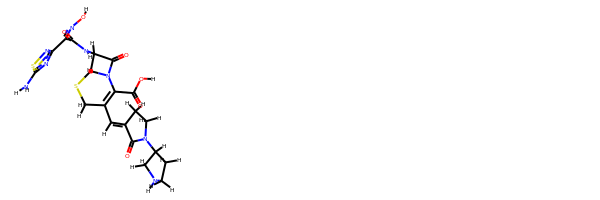

rdkit:  [H]ON=C(C(=O)N([H])C1([H])C(=O)N2C(C(=O)O[H])=C(C([H])=C3C(=O)N(C4([H])C([H])([H])N([H])C([H])([H])C4([H])[H])C([H])([H])C3([H])[H])C([H])([H])SC21[H])c1nsc(N([H])[H])n1
oechem:  C1CNCC1N2CCC(=CC3=C(N4C(C(C4=O)NC(=O)C(=NO)c5nc(sn5)N)SC3)C(=O)O)C2=O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###############################################################

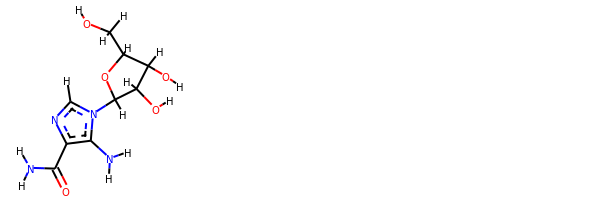

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])nc(C(=O)N([H])[H])c2N([H])[H])C([H])(O[H])C1([H])O[H]
oechem:  c1nc(c(n1C2C(C(C(O2)CO)O)O)N)C(=O)N
###########################################################################
 #########################################################

bond
29.323168114943908 kJ/mol 57669.159145534984 kJ/mol False
angle
102.78290621114627 kJ/mol 102.78290621114627 kJ/mol True
nb
62.700012110517264 kJ/mol 62.700012110517264 kJ/mol True
torsion
46.421895561288736 kJ/mol 46.42192382787887 kJ/mol False
241.22798199789617 kJ/mol 57881.06398768453 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4456


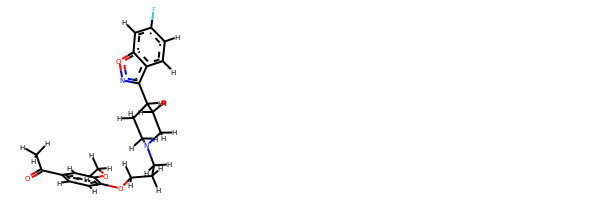

rdkit:  [H]c1c([H])c(C(=O)C([H])([H])[H])c([H])c(OC([H])([H])[H])c1OC([H])([H])C([H])([H])C([H])([H])N1C([H])([H])C([H])([H])C([H])(c2noc3c([H])c(F)c([H])c([H])c23)C([H])([H])C1([H])[H]
oechem:  CC(=O)c1ccc(c(c1)OC)OCCCN2CCC(CC2)c3c4ccc(cc4on3)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
28.26533481047085 kJ/mol 56307.80688790868 kJ/mol False
angle
10.873688179348049 kJ/mol 10.873688179348049 kJ/mol True
nb
53.10761779412432 kJ/mol 53.10761779412432 kJ/mol True
torsion
5.855682012924069 kJ/mol 6.834203186520543 kJ/mol False
98.1023227968673 kJ/mol 56378.62239706866 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
--------------------------------------------------

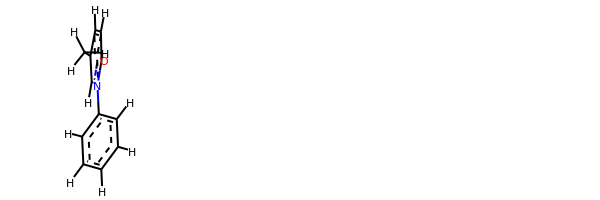

rdkit:  [H]c1c([H])c([H])c(-n2c([H])c(C([H])([H])[H])c([H])c([H])c2=O)c([H])c1[H]
oechem:  Cc1ccc(=O)n(c1)c2ccccc2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
34.829411895367606 kJ/mol 58015.77165451059 kJ/mol False
angle
699.4039852198409 kJ/mol 699.4039852198409 kJ/mol True
nb
16.675425898834423 kJ/mol 16.675425898834423 kJ/mol True
torsion
119.17950315671474 kJ/mol 95.07699777038424 kJ/mol False
870.0883261707577 kJ/mol 58826.928063399646 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4462


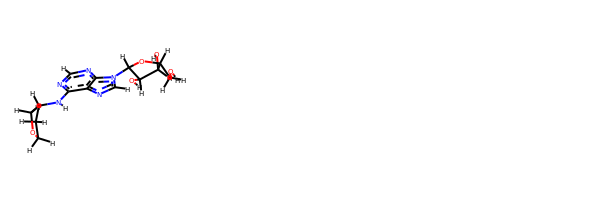

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])nc3c(N([H])C4([H])C([H])([H])OC([H])([H])C4([H])[H])nc([H])nc32)C([H])(O[H])C1([H])O[H]
oechem:  c1nc(c2c(n1)n(cn2)C3C(C(C(O3)CO)O)O)NC4CCOC4
###########################################################################
 #########################################################

bond
33.28567368192448 kJ/mol 58399.83779820669 kJ/mol False
angle
228.36003668213226 kJ/mol 228.36003668213226 kJ/mol True
nb
66.28779713311596 kJ/mol 66.28779713311596 kJ/mol True
torsion
41.167534465674976 kJ/mol 41.1675435083261 kJ/mol False
369.1010419628477 kJ/mol 58735.653175530264 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4463


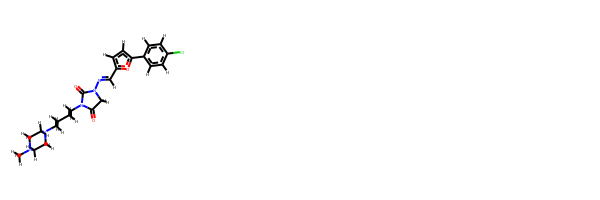

rdkit:  [H]C(=NN1C(=O)N(C([H])([H])C([H])([H])C([H])([H])C([H])([H])N2C([H])([H])C([H])([H])N(C([H])([H])[H])C([H])([H])C2([H])[H])C(=O)C1([H])[H])c1oc(-c2c([H])c([H])c(Cl)c([H])c2[H])c([H])c1[H]
oechem:  CN1CCN(CC1)CCCCN2C(=O)CN(C2=O)N=Cc3ccc(o3)c4ccc(cc4)Cl
###########################################################################
 #########################################################

bond
46.150150098543065 kJ/mol 114101.48074828004 kJ/mol False
angle
130.8662737240736 kJ/mol 130.8662737240736 kJ/mol True
nb
75.07547515234359 kJ/mol 75.07547515234359 kJ/mol True
torsion
53.000287886262164 kJ/mol 25.876571860832225 kJ/mol False
305.09218686122244 kJ/mol 114333.29906901729 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4464


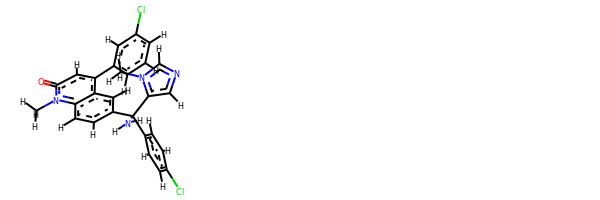

rdkit:  [H]c1nc([H])n(C([H])([H])[H])c1C(c1c([H])c([H])c(Cl)c([H])c1[H])(c1c([H])c([H])c2c(c1[H])c(-c1c([H])c([H])c([H])c(Cl)c1[H])c([H])c(=O)n2C([H])([H])[H])N([H])[H]
oechem:  Cn1cncc1C(c2ccc(cc2)Cl)(c3ccc4c(c3)c(cc(=O)n4C)c5cccc(c5)Cl)N
###########################################################################
 #########################################################

bond
18.60726446675964 kJ/mol 41581.38179030515 kJ/mol False
angle
26.068042994584637 kJ/mol 22.90423075100162 kJ/mol False
nb
155.53966168852224 kJ/mol 155.53966168852224 kJ/mol True
torsion
18.195170017326785 kJ/mol 26.784537612128112 kJ/mol False
218.4101391671933 kJ/mol 41786.6102203568 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4466


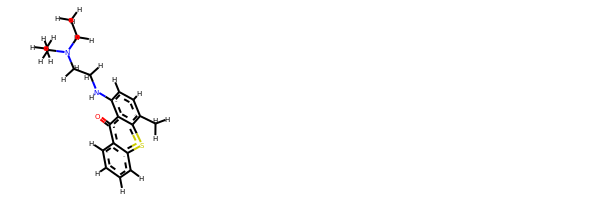

rdkit:  [H]c1c([H])c([H])c2c(=O)c3c(N([H])C([H])([H])C([H])([H])N(C([H])([H])C([H])([H])[H])C([H])([H])C([H])([H])[H])c([H])c([H])c(C([H])([H])[H])c3sc2c1[H]
oechem:  CCN(CC)CCNc1ccc(c2c1c(=O)c3ccccc3s2)C
###########################################################################
 #########################################################

bond
13.402921505372563 kJ/mol 29082.668914496015 kJ/mol False
angle
115.50487135079561 kJ/mol 115.50487135079561 kJ/mol True
nb
54.36787037532424 kJ/mol 54.36787037532424 kJ/mol True
torsion
26.36994057433932 kJ/mol 21.14001373264952 kJ/mol False
209.64560380583174 kJ/mol 29273.681669954785 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4467


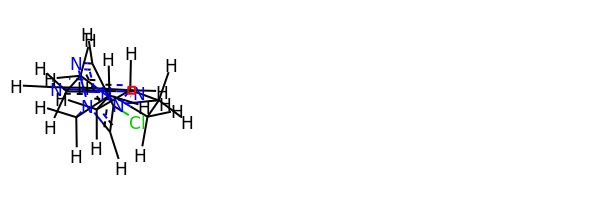

rdkit:  [H]c1nc(N2C([H])([H])C([H])([H])N(C([H])([H])C([H])([H])C([H])([H])C([H])([H])n3nc([H])c(Cl)c3[H])C([H])([H])C2([H])[H])nc([H])c1[H]
oechem:  c1cnc(nc1)N2CCN(CC2)CCCCn3cc(cn3)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
34.63959482221219 kJ/mol 58014.77358158254 kJ/mol False
angle
425.84952371955 kJ/mol 425.84952371955 kJ/mol True
nb
40.42984281574062 kJ/mol 40.42984281574062 kJ/mol True
torsion
102.39520314627372 kJ/mol 78.22490528404272 kJ/mol False
603.3141645037765 kJ/mol 5855

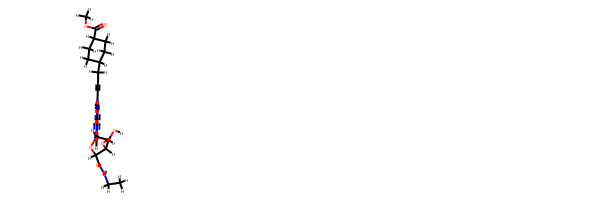

rdkit:  [H]OC1([H])C([H])(C(=O)N([H])C([H])([H])C([H])([H])[H])OC([H])(n2c([H])nc3c(N([H])[H])nc(C#CC([H])([H])C4([H])C([H])([H])C([H])([H])C([H])(C(=O)OC([H])([H])[H])C([H])([H])C4([H])[H])nc32)C1([H])O[H]
oechem:  CCNC(=O)C1C(C(C(O1)n2cnc3c2nc(nc3N)C#CCC4CCC(CC4)C(=O)OC)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
9.417075852685159 kJ/mol 57465.318745646684 kJ/mol False
angle
101.13939276453975 kJ/mol 101.13939276453975 kJ/mol True
nb
67.78662495499846 kJ/mol 67.78662495499846 kJ/mol True
torsion
15.899835933781588 kJ/mol 15.899738487789502 kJ/mol False
194.24292950600494 kJ/mol 57650.14450185401 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
--------------

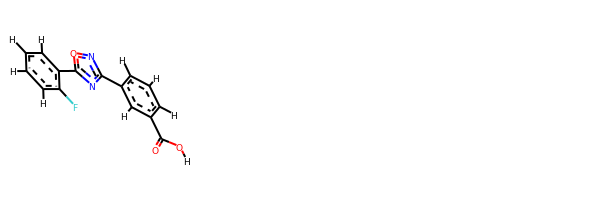

rdkit:  [H]OC(=O)c1c([H])c([H])c([H])c(-c2noc(-c3c([H])c([H])c([H])c([H])c3F)n2)c1[H]
oechem:  c1ccc(c(c1)c2nc(no2)c3cccc(c3)C(=O)O)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
17.413150654029987 kJ/mol 56868.982798067256 kJ/mol False
angle
245.2600113258329 kJ/mol 245.4014045791108 kJ/mol False
nb
98.84576179936461 kJ/mol 98.84576179936461 kJ/mol True
torsion
40.65382906890122 kJ/mol 23.917872403163276 kJ/mol False
402.17275284812865 kJ/mol 57237.1478368489 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-----------------------

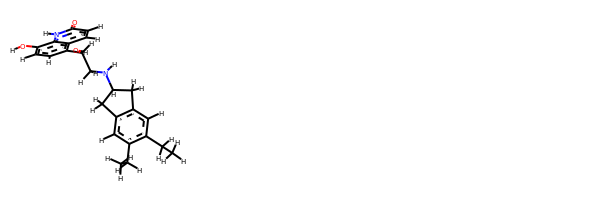

rdkit:  [H]Oc1c([H])c([H])c(C([H])(O[H])C([H])([H])N([H])C2([H])C([H])([H])c3c([H])c(C([H])([H])C([H])([H])[H])c(C([H])([H])C([H])([H])[H])c([H])c3C2([H])[H])c2c([H])c([H])c(=O)n([H])c12
oechem:  CCc1cc2c(cc1CC)CC(C2)NCC(c3ccc(c4c3ccc(=O)[nH]4)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
14.483215738254758 kJ/mol 58034.22811669107 kJ/mol False
angle
107.66287604710334 kJ/mol 107.66287604710334 kJ/mol True
nb
40.11639697584461 kJ/mol 40.11639697584461 kJ/mol True
torsion
100.1913505658193

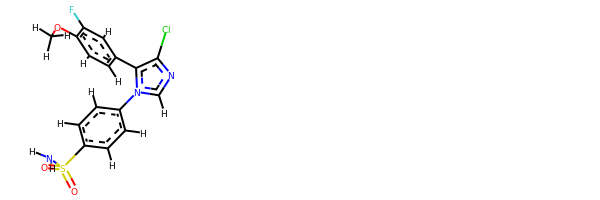

rdkit:  [H]c1c([H])c(-c2c(Cl)nc([H])n2-c2c([H])c([H])c(S(=O)(=O)N([H])[H])c([H])c2[H])c([H])c(F)c1OC([H])([H])[H]
oechem:  COc1ccc(cc1F)c2c(ncn2c3ccc(cc3)S(=O)(=O)N)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
45.03166009566556 kJ/mol 57757.89486152572 kJ/mol False
angle
379.6120361036847 kJ/mol 379.6120361036847 kJ/mol True
nb
-12.052670752152306 kJ/mol -12.052670752152306 kJ/mol True
torsion
63.25403065657552 kJ/mol 63.25403124614687 kJ/mol False
475.8450561037735 kJ/mol 58188.708258123406 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4489


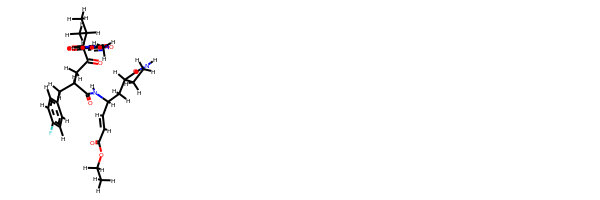

rdkit:  [H]C(C(=O)OC([H])([H])C([H])([H])[H])=C([H])C([H])(N([H])C(=O)C([H])(C([H])([H])C(=O)C([H])(N([H])C(=O)c1noc(C([H])([H])[H])c1[H])C([H])(C([H])([H])[H])C([H])([H])[H])C([H])([H])c1c([H])c([H])c(F)c([H])c1[H])C([H])([H])C1([H])C(=O)N([H])C([H])([H])C1([H])[H]
oechem:  CCOC(=O)C=CC(CC1CCNC1=O)NC(=O)C(Cc2ccc(cc2)F)CC(=O)C(C(C)C)NC(=O)c3cc(on3)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
29.508448509185822 kJ/mol 115198.96594569205 kJ/mol False
angle
192.83025126773407 kJ/mol 192.83025126773407 kJ/mol True
nb
26.89423974231166 kJ/mol 26.89423974231166 kJ/mol True
torsion
27.583847119995866 kJ/mol 27.583826814152733 kJ/mol False
276.8167866392274 kJ/mol 115446.27426351624 kJ/mol

-------------------------------------------------------------------
------

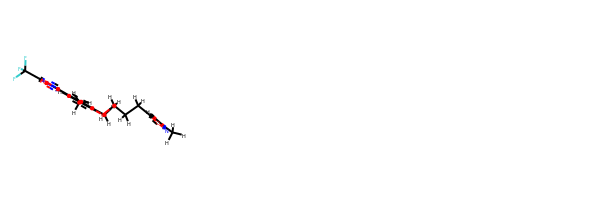

rdkit:  [H]c1c(C([H])([H])[H])noc1C([H])([H])C([H])([H])C([H])([H])Oc1c(C([H])([H])[H])c([H])c(-c2noc(C(F)(F)F)n2)c([H])c1C([H])([H])[H]
oechem:  Cc1cc(cc(c1OCCCc2cc(no2)C)C)c3nc(on3)C(F)(F)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
100.17142669097768 kJ/mol 112581.83750090725 kJ/mol False
angle
63.69278187585588 kJ/mol 63.69278187585588 kJ/mol True
nb
176.01289364894396 kJ/mol 176.01289364894396 kJ/mol True
torsion
143.1514142385181 kJ/mol 143.15142844409013 kJ/mol False
483.02851645429

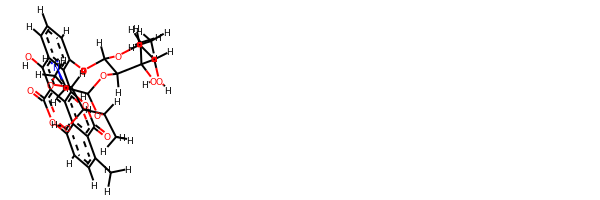

rdkit:  [H]Oc1c2c([H])c([H])c([H])c(OC3([H])OC([H])(C([H])([H])[H])C([H])(O[H])C(O[H])(C([H])([H])[H])C3([H])OC3([H])OC([H])(C([H])([H])[H])C([H])(O[H])C([H])(OC([H])([H])[H])C3([H])N([H])[H])c2c2oc(=O)c3c(C([H])([H])[H])c([H])c([H])c4oc(=O)c1c2c43
oechem:  Cc1ccc2c3c1c(=O)oc4c3c(c(c5c4c(ccc5)OC6C(C(C(C(O6)C)O)(C)O)OC7C(C(C(C(O7)C)O)OC)N)O)c(=O)o2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
33.774592860468324 kJ/mol 58176.7369730046 kJ/mol False
angle
98.0302760591989 kJ/mol 98.0302760591989 kJ/mol True
nb
36.31489755185034 kJ/mol 36.31489755185034 kJ/mol True
torsion
52.08720776517888 kJ/mol 33.351580630697875 kJ/mol False

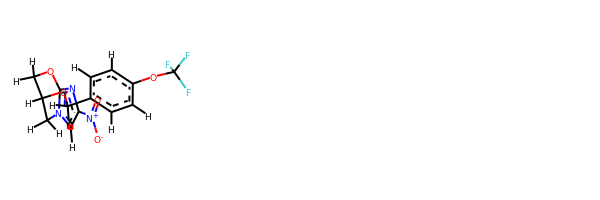

rdkit:  [H]c1c([H])c(C([H])([H])OC2([H])C([H])([H])Oc3nc([N+](=O)[O-])c([H])n3C2([H])[H])c([H])c([H])c1OC(F)(F)F
oechem:  c1cc(ccc1COC2Cn3cc(nc3OC2)[N+](=O)[O-])OC(F)(F)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
19.52406982137597 kJ/mol 57001.38508835504 kJ/mol False
angle
307.96317279216345 kJ/mol 308.1142602305711 kJ/mol False
nb
414.46520948512773 kJ/

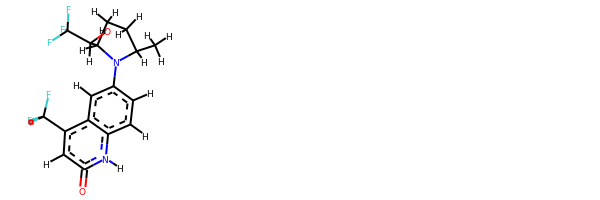

rdkit:  [H]OC([H])(C(F)(F)F)C1([H])N(c2c([H])c([H])c3c(c2[H])c(C(F)(F)F)c([H])c(=O)n3[H])C([H])(C([H])([H])[H])C([H])([H])C1([H])[H]
oechem:  CC1CCC(N1c2ccc3c(c2)c(cc(=O)[nH]3)C(F)(F)F)C(C(F)(F)F)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
41.39697391936298 kJ/mol 56482.62870034049 kJ/mol False
angle
340.31670005037427 kJ/mol 340.31670005037427 kJ/mol True
nb
24.52020824159955 kJ/mol 24.52020824159955 kJ/mol True
torsion
108.19736196423888 kJ/mol 67.90236487396982 kJ/mol False
514.4312441755757 kJ/mol 56915.36797350643 kJ/mol

-------------------------------------------------------------------
----------------------------

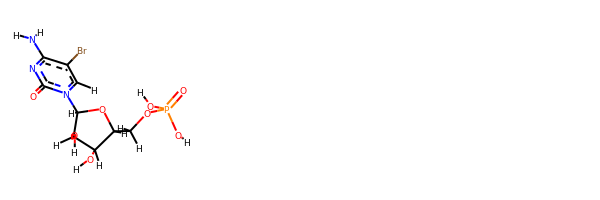

rdkit:  [H]OC1([H])C([H])(n2c([H])c(Br)c(N([H])[H])nc2=O)OC([H])(C([H])([H])OP(=O)(O[H])O[H])C1([H])O[H]
oechem:  c1c(c(nc(=O)n1C2C(C(C(O2)COP(=O)(O)O)O)O)N)Br
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
29.124183631244357 kJ/mol 114026.94419339526 kJ/mol False
angle
103.3644281926811 kJ/mol 106.82953647690435 kJ/mol False
nb
9.250333468910739 kJ/mol 9.250333468910739 kJ/mol True
torsion
48.760987013378674 kJ/mol 12.208559104020726 kJ/mol False
190.49993230621487 kJ/mol 114155.2326224451 kJ/mol

-------------------------------------------------------------------
--------------------------------------------------------------

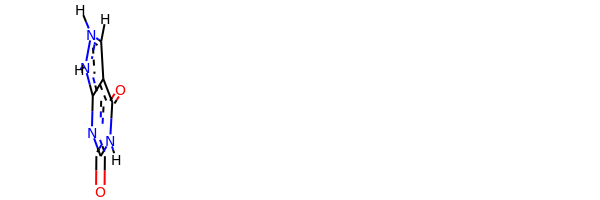

rdkit:  [H]c1c2c(=O)n([H])c(=O)nc-2n([H])n1[H]
oechem:  c1c-2c(=O)[nH]c(=O)nc2[nH][nH]1
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
19.59536631055969 kJ/mol 56625.8783091922 kJ/mol False
angle
96.053526224683 kJ/mol 96.053526224683 kJ/mol True
nb
9.82642568081257 kJ/mol 9.82642568081257 kJ/mol True
torsion
26.247500811596762 kJ/mol 6.575443169595591 kJ/mol False
151.722819027652 kJ/mol 56738.333704267294 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4516


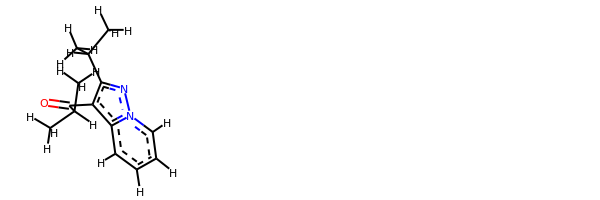

rdkit:  [H]c1c([H])c([H])n2nc(C([H])(C([H])([H])[H])C([H])([H])[H])c(C(=O)C([H])(C([H])([H])[H])C([H])([H])[H])c2c1[H]
oechem:  CC(C)c1c(c2ccccn2n1)C(=O)C(C)C
###########################################################################
 #########################################################

bond
8.920443769111575 kJ/mol 43796.19188130781 kJ/mol False
angle
41.77303486075334 kJ/mol 43.92515681497163 kJ/mol False
nb
75.4742354790931 kJ/mol 75.4742354790931 kJ/mol True
torsion
41.09720148303888 kJ/mol 36.43498336108228 kJ/mol False
167.2649155919969 kJ/mol 43952.026256962956 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4517


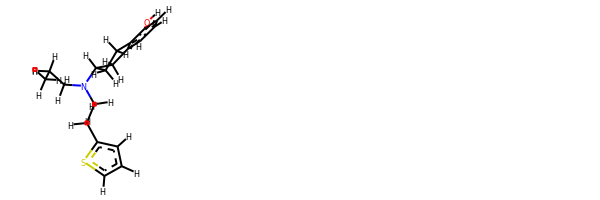

rdkit:  [H]Oc1c([H])c([H])c([H])c2c1C([H])([H])C([H])([H])C([H])(N(C([H])([H])C([H])([H])c1sc([H])c([H])c1[H])C([H])([H])C([H])([H])C([H])([H])[H])C2([H])[H]
oechem:  CCCN(CCc1cccs1)C2CCc3c(cccc3O)C2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ###########################################

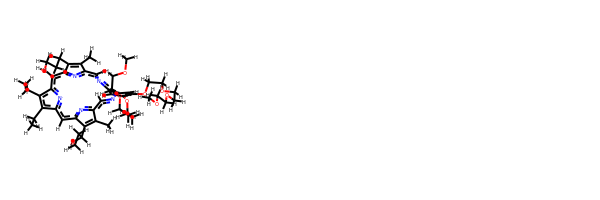

rdkit:  [H]OC([H])([H])C([H])([H])C([H])([H])C1=C(C([H])([H])[H])c2nc1c([H])c1[n-]c(c([H])c3nc(c([H])nc4c([H])c(OC([H])([H])C([H])([H])OC([H])([H])C([H])([H])OC([H])([H])C([H])([H])OC([H])([H])[H])c(OC([H])([H])C([H])([H])OC([H])([H])C([H])([H])OC([H])([H])C([H])([H])OC([H])([H])[H])c([H])c4nc2[H])C(C([H])([H])[H])=C3C([H])([H])C([H])([H])C([H])([H])O[H])c(C([H])([H])C([H])([H])[H])c1C([H])([H])C([H])([H])[H]
oechem:  CCc1c2cc3nc(cnc4cc(c(cc4ncc5nc(cc(c1CC)[n-]2)C(=C5C)CCCO)OCCOCCOCCOC)OCCOCCOCCOC)C(=C3CCCO)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
23.111475796996633 kJ/mol 43696.682607091716 kJ/mol False
angle
56.007953050830814 kJ/mol 59.36433177854244 kJ/mol False
nb
74.8915470144845 kJ/mol 74.8915470144845 kJ/mol True
torsion
46.92713893881554 kJ/mo

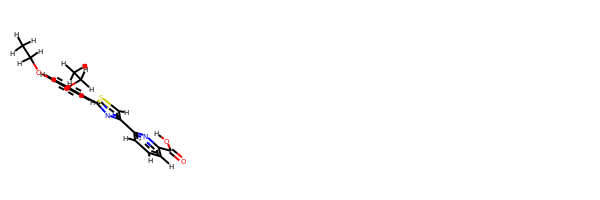

rdkit:  [H]OC(=O)c1nc(-c2nc(-c3c([H])c([H])c(OC([H])([H])C([H])([H])[H])c(OC([H])([H])C([H])([H])[H])c3[H])sc2[H])c([H])c([H])c1[H]
oechem:  CCOc1ccc(cc1OCC)c2nc(cs2)c3cccc(n3)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
38.907677700084946 kJ/mol 57909.28915928839 kJ/mol False
angle
269.7050360348624 kJ/mol 269.7050360348624 kJ/mol True
nb
21.61423538

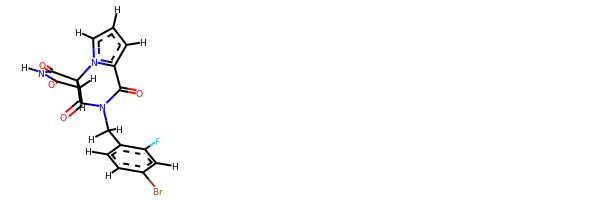

rdkit:  [H]c1c([H])c(C([H])([H])N2C(=O)c3c([H])c([H])c([H])n3C3(C(=O)N([H])C(=O)C3([H])[H])C2=O)c(F)c([H])c1Br
oechem:  c1cc2n(c1)C3(CC(=O)NC3=O)C(=O)N(C2=O)Cc4ccc(cc4F)Br
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
66.51062710607113 kJ/mol 169653.48006347363 kJ/mol False
angle
656.3682359782047 kJ/mol 658.5365829350374 kJ/mol False
nb
50.22214067153933 kJ/mol 50.22214067153933 kJ/mol True
torsion
82.16976760145955 kJ/mol 69.61042131161675 kJ/mol False
855.2707713572746 kJ/mol 170431.84920839182 kJ/mol

-------------------------------------------------------------------
------------------------------------------------------

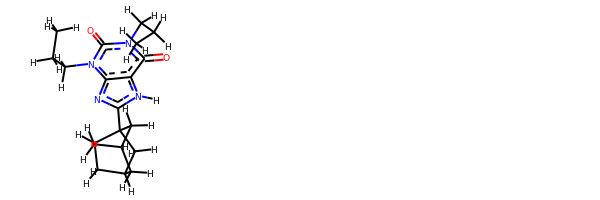

rdkit:  [H]n1c(C23C([H])([H])C4([H])C([H])([H])C([H])(C([H])([H])C2([H])C4([H])[H])C3([H])[H])nc2c1c(=O)n(C([H])([H])C([H])([H])C([H])([H])[H])c(=O)n2C([H])([H])C([H])([H])C([H])([H])[H]
oechem:  CCCn1c2c(c(=O)n(c1=O)CCC)[nH]c(n2)C34CC5CC(C3)CC4C5
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
4.850794414087823 kJ/mol 58027.59229427109 kJ/mol False
angle
103.93237917157082 kJ/mol 105.94210186494286 kJ/mol False
nb
-2.1276476451209176 kJ/mol -2.1276476451209176 kJ/mol True
torsion
5.320601661928529 kJ/mol 4.9858400335355375 kJ/mol False
111.97612760246626 kJ/mol 58136.392588524446 kJ/mol

---------------------------------------

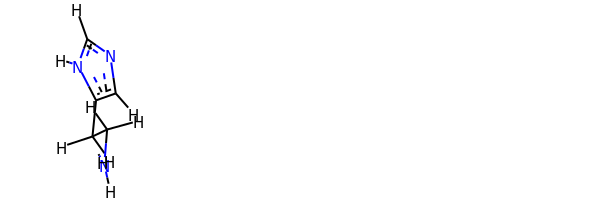

rdkit:  [H]c1nc([H])n([H])c1C([H])([H])C([H])([H])N([H])[H]
oechem:  c1c([nH]cn1)CCN
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
70.4299463209581 kJ/mol 114616.22210179253 kJ/mol False
angle
1137.8580649060966 kJ/mol 1137.8

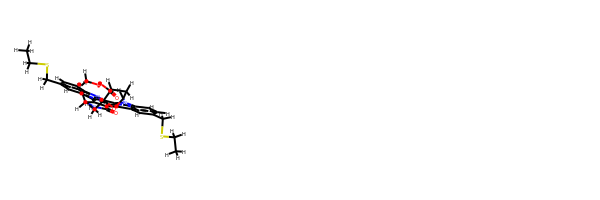

rdkit:  [H]c1c(C([H])([H])SC([H])([H])C([H])([H])[H])c([H])c2c3c4c(c5c6c([H])c(C([H])([H])SC([H])([H])C([H])([H])[H])c([H])c([H])c6n6c5c3n(c2c1[H])C1([H])OC6(C([H])([H])[H])C([H])(C(=O)OOC([H])([H])[H])C1([H])[H])C([H])([H])N([H])C4=O
oechem:  CCSCc1ccc2c(c1)c3c4c(c5c6cc(ccc6n7c5c3n2C8CC(C7(O8)C)C(=O)OOC)CSCC)CNC4=O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
16.788781002855508 kJ/mol 57768.240133593084 kJ/mol False
angle
84.8099540405237 kJ/mol 84.8099540405237 kJ/mol True
nb
48.49936946645441 kJ/mol 48.49936946645441 kJ/mol True
torsion
78.45952226082626 kJ/mol 58.132153219225756 kJ/mol False
228.5576267706599 kJ/mol 57959.68161031928 kJ/mol

-------------------------------------------------------------------
----------------------------------------------

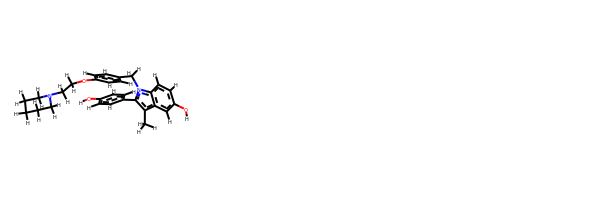

rdkit:  [H]Oc1c([H])c([H])c(-c2c(C([H])([H])[H])c3c([H])c(O[H])c([H])c([H])c3n2C([H])([H])c2c([H])c([H])c(OC([H])([H])C([H])([H])N3C([H])([H])C([H])([H])C([H])([H])C([H])([H])C3([H])[H])c([H])c2[H])c([H])c1[H]
oechem:  Cc1c2cc(ccc2n(c1c3ccc(cc3)O)Cc4ccc(cc4)OCCN5CCCCC5)O
###########################################################################
 #########################################################

bond
21.444516335740303 kJ/mol 43692.41348829832 kJ/mol False
angle
63.27399502141003 kJ/mol 66.62985348077952 kJ/mol False
nb
35.62509293596531 kJ/mol 35.62509293596531 kJ/mol True
torsion
32.121354037230745 kJ/mol 27.9648153839682 kJ/mol False
152.4649583303464 kJ/mol 43822.63325009903 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4549


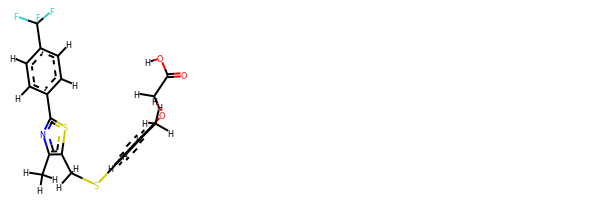

rdkit:  [H]OC(=O)C([H])([H])Oc1c([H])c([H])c(SC([H])([H])c2sc(-c3c([H])c([H])c(C(F)(F)F)c([H])c3[H])nc2C([H])([H])[H])c([H])c1C([H])([H])[H]
oechem:  Cc1cc(ccc1OCC(=O)O)SCc2c(nc(s2)c3ccc(cc3)C(F)(F)F)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
251.5790510066033 kJ/mol 251.7693256538926 kJ/mol False
angle
756.4733603982257 kJ/mol 756.4733603982257 kJ/mol True
nb
50.46312342919153 kJ/mol 50.46312342919153 kJ/mol True
torsion
89.0760402369135 kJ/mol 89.07607354131274 kJ/mol False
1147.591575070934 kJ/mol 1147.7818830226224 kJ/mol

-------------------------------------------------------------------
---------------------------

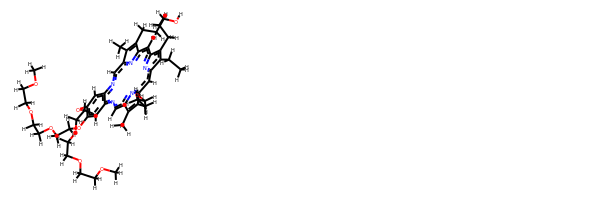

rdkit:  [H]OC([H])([H])C([H])([H])C([H])([H])C1=C(C([H])([H])[H])c2nc1c([H])c1[n-]c(c([H])c3nc(c([H])nc4c([H])c(OC([H])([H])C([H])([H])OC([H])([H])C([H])([H])OC([H])([H])C([H])([H])OC([H])([H])[H])c(OC([H])([H])C([H])([H])OC([H])([H])C([H])([H])OC([H])([H])C([H])([H])OC([H])([H])[H])c([H])c4nc2[H])C(C([H])([H])[H])=C3C([H])([H])C([H])([H])C([H])([H])O[H])c(C([H])([H])C([H])([H])[H])c1C([H])([H])C([H])([H])[H]
oechem:  CCc1c2cc3nc(cnc4cc(c(cc4ncc5nc(cc(c1CC)[n-]2)C(=C5C)CCCO)OCCOCCOCCOC)OCCOCCOCCOC)C(=C3CCCO)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 

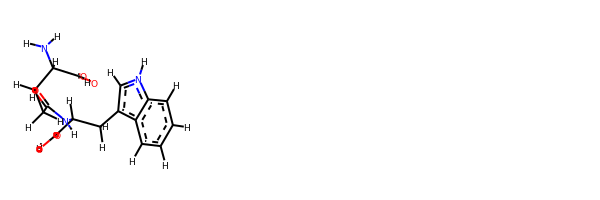

rdkit:  [H]OC(=O)C([H])(N([H])C(=O)C([H])([H])C([H])([H])C([H])(C(=O)O[H])N([H])[H])C([H])([H])c1c([H])n([H])c2c([H])c([H])c([H])c([H])c12
oechem:  c1ccc2c(c1)c(c[nH]2)CC(C(=O)O)NC(=O)CCC(C(=O)O)N
###########################################################################
 #########################################################

bond
32.742962385436485 kJ/mol 58011.62952490256 kJ/mol False
angle
128.10423345580506 kJ/mol 128.10423345580506 kJ/mol True
nb
18.579301774510988 kJ/mol 18.579301774510988 kJ/mol True
torsion
21.558680368272963 kJ/mol 18.840233408872017 kJ/mol False
200.9851779840255 kJ/mol 58177.15329354175 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4565


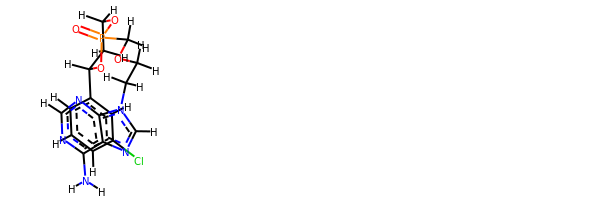

rdkit:  [H]c1nc(N([H])[H])c2nc([H])n(C([H])([H])C([H])([H])OC([H])([H])P3(=O)OC([H])([H])C([H])([H])C([H])(c4c([H])c([H])c([H])c(Cl)c4[H])O3)c2n1
oechem:  c1cc(cc(c1)Cl)C2CCOP(=O)(O2)COCCn3cnc4c3ncnc4N
###########################################################################
 #########################################################

bond
27.937596012776588 kJ/mol 57319.832002748284 kJ/mol False
angle
169.74624660989593 kJ/mol 169.74624660989593 kJ/mol True
nb
73.7925965499169 kJ/mol 73.7925965499169 kJ/mol True
torsion
31.85202311369895 kJ/mol 22.67255193266761 kJ/mol False
303.32846228628836 kJ/mol 57586.04339784076 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4567


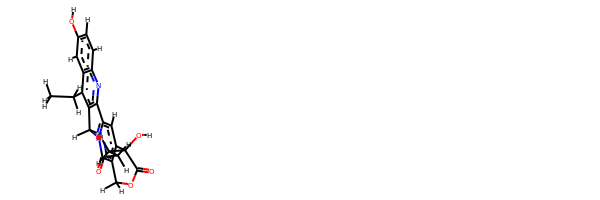

rdkit:  [H]Oc1c([H])c([H])c2nc3c(c(C([H])([H])C([H])([H])[H])c2c1[H])C([H])([H])n1c-3c([H])c2c(c1=O)C([H])([H])OC(=O)C2(O[H])C([H])([H])C([H])([H])[H]
oechem:  CCc1c2cc(ccc2nc-3c1Cn4c3cc5c(c4=O)COC(=O)C5(CC)O)O
###########################################################################
 #########################################################

bond
15.031772281622857 kJ/mol 56659.38106953618 kJ/mol False
angle
31.57475444688668 kJ/mol 31.57475444688668 kJ/mol True
nb
66.86498406086702 kJ/mol 66.86498406086702 kJ/mol True
torsion
197.94997181218767 kJ/mol 160.03251209188775 kJ/mol False
311.4214826015642 kJ/mol 56917.85332013582 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4568


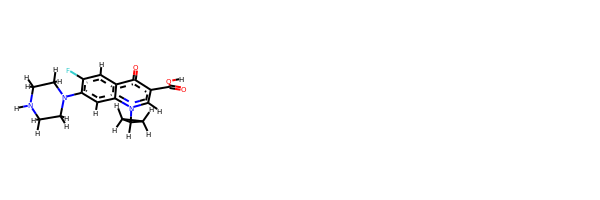

rdkit:  [H]OC(=O)c1c([H])n(C2([H])C([H])([H])C2([H])[H])c2c([H])c(N3C([H])([H])C([H])([H])N([H])C([H])([H])C3([H])[H])c(F)c([H])c2c1=O
oechem:  c1c2c(cc(c1F)N3CCNCC3)n(cc(c2=O)C(=O)O)C4CC4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
24.979293788195356 kJ/mol 43827.84426241968 kJ/mol False
angle
97.9317614668408 kJ/mol 99.69589706104021 kJ/mol False
nb
91.67255625563102 kJ/mol 91.67255625563102 kJ/mol True
torsion
42.59018508810136 kJ/mol 38.60720409807117 kJ/mol False
257.17379659876855 kJ/mol 44057.81991983443 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4572


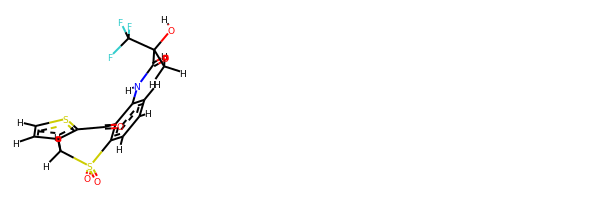

rdkit:  [H]OC(C(=O)N([H])c1c([H])c([H])c([H])c2c1C(=O)c1sc([H])c([H])c1C([H])([H])S2(=O)=O)(C([H])([H])[H])C(F)(F)F
oechem:  CC(C(=O)Nc1cccc2c1C(=O)c3c(ccs3)CS2(=O)=O)(C(F)(F)F)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
27.59125142576841 kJ/mol 58008.81462278338 kJ/mol False
angle
410.2461222025379 kJ/mol 410.2461222025379 kJ/mol True
nb
34.45692864361764 kJ/mol 34.45692864361764 kJ/mol True
torsion
85.18217925153803 kJ/mol 55.97813015656791 kJ/mol False
557.476481523462 kJ/mol 58509.4958037861 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4574


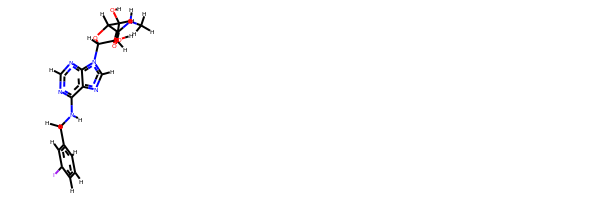

rdkit:  [H]OC1([H])C([H])(C(=O)N([H])C([H])([H])[H])OC([H])(n2c([H])nc3c(N([H])C([H])([H])c4c([H])c([H])c([H])c(I)c4[H])nc([H])nc32)C1([H])O[H]
oechem:  CNC(=O)C1C(C(C(O1)n2cnc3c2ncnc3NCc4cccc(c4)I)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
44.14467144463526 kJ/mol 114671.07874490895 kJ/mol False
angle
686.613502164816 kJ/mol 686.613502164816 kJ/mol True
nb
-4.453930046868693 kJ/mol -4.453930046868693 kJ/mol True
torsion
107.93621384660099 kJ/mol 107.93616643874643 kJ/mol False
834.2404574091836 kJ/mol 115461.17448346564 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4578


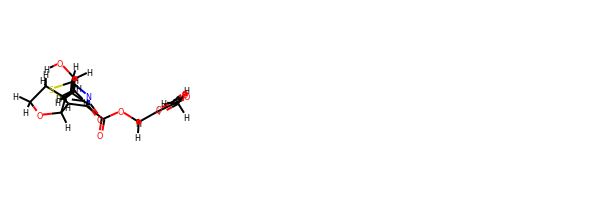

rdkit:  [H]OC([H])(C([H])([H])[H])C1([H])C(=O)N2C(C(=O)OC([H])([H])c3oc(=O)oc3C([H])([H])[H])=C(C3([H])OC([H])([H])C([H])([H])C3([H])[H])SC21[H]
oechem:  Cc1c(oc(=O)o1)COC(=O)C2=C(SC3N2C(=O)C3C(C)O)C4CCCO4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
30.64993905520547 kJ/mol 57511.98975250465 kJ/mol False
angle
120.92656183787756 kJ/mol 120.92656183787756 kJ/mol True
nb
73.03158657310387 kJ/mol 73.03158657310387 kJ/mol True
torsion
38.2716302694944 kJ/mol 32.02505708685654 kJ/mol False
262.8

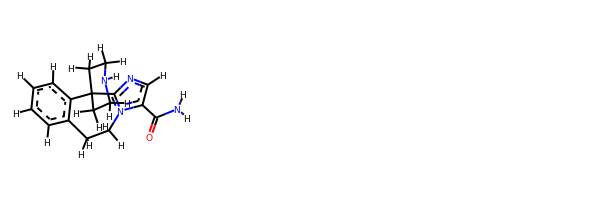

rdkit:  [H]c1nc2n(c1C(=O)N([H])[H])C([H])([H])C([H])([H])c1c([H])c([H])c([H])c([H])c1C21C([H])([H])C([H])([H])N([H])C([H])([H])C1([H])[H]
oechem:  c1ccc2c(c1)CCn3c(cnc3C24CCNCC4)C(=O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################


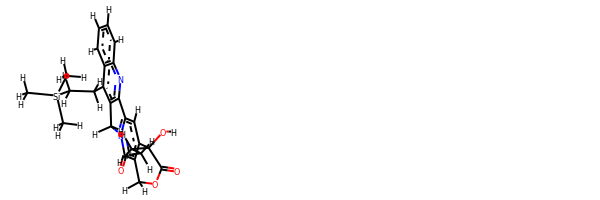

rdkit:  [H]OC1(C([H])([H])C([H])([H])[H])C(=O)OC([H])([H])c2c1c([H])c1n(c2=O)C([H])([H])c2c-1nc1c([H])c([H])c([H])c([H])c1c2C([H])([H])C([H])([H])[Si](C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H]
oechem:  CCC1(c2cc-3n(c(=O)c2COC1=O)Cc4c3nc5ccccc5c4CC[Si](C)(C)C)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
26.052097513768455 kJ/mol 56121.13335360847 kJ/mol False
angle
315.6929825714581 kJ/mol 315.6929825714581 kJ/mol True
nb
49.84475042275158 kJ/mol 49.84475042275158 kJ/mol True
torsion
12

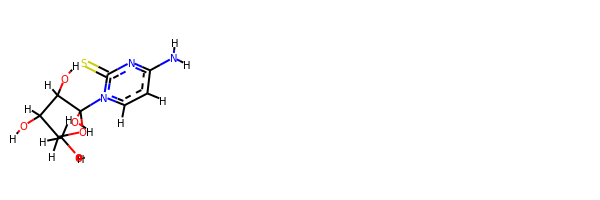

rdkit:  [H]OC([H])([H])C1([H])OC(O[H])(n2c([H])c([H])c(N([H])[H])nc2=S)C([H])(O[H])C1([H])O[H]
oechem:  c1cn(c(=S)nc1N)C2(C(C(C(O2)CO)O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
50.52034741919482 kJ/mol 56122.99236705453 kJ/mol False
angle
23.895044904834304 kJ/mol 23.895044904834304 kJ/mol True
nb
121.60936027162744 kJ/mol 121.60936027162744 kJ/mol True
torsion
48.60854845724334 kJ/mol 31.26551583202947 kJ/mol False
244.63330105289992 kJ/mol 56299.76228806302 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
----------------

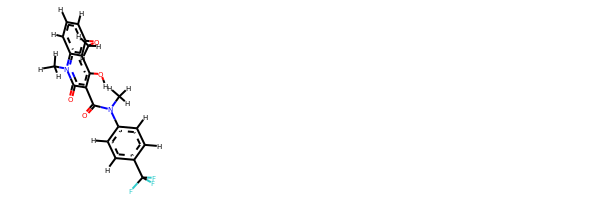

rdkit:  [H]Oc1c(C(=O)N(c2c([H])c([H])c(C(F)(F)F)c([H])c2[H])C([H])([H])[H])c(=O)n(C([H])([H])[H])c2c([H])c([H])c([H])c(OC([H])([H])[H])c12
oechem:  Cn1c2cccc(c2c(c(c1=O)C(=O)N(C)c3ccc(cc3)C(F)(F)F)O)OC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
55.36409095204994 kJ/mol 43726.37009622063 kJ/mol False
angle
771.7453935174069 kJ/mol 775.101127474175 kJ/mol False
nb
51.79746216328689 kJ/mol 51.79746216328689 kJ/mol True
torsion
341.2282864257784 kJ/mol 334.07580952163823 kJ/mol False
1220.135233058522 kJ/mol 44887.34449537973 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4601


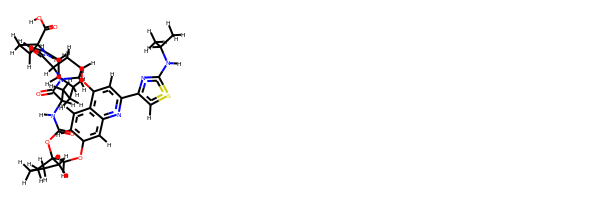

rdkit:  [H]OC(=O)C12N([H])C(=O)C3([H])N(C(=O)C([H])(N([H])C(=O)OC4([H])C([H])([H])C([H])([H])C([H])([H])C4([H])[H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])=C([H])C1([H])C2([H])[H])C([H])([H])C([H])(Oc1c([H])c(-c2nc(N([H])C([H])(C([H])([H])[H])C([H])([H])[H])sc2[H])nc2c([H])c(OC([H])([H])[H])c([H])c([H])c12)C3([H])[H]
oechem:  CC(C)Nc1nc(cs1)c2cc(c3ccc(cc3n2)OC)OC4CC5C(=O)NC6(CC6C=CCCCCCC(C(=O)N5C4)NC(=O)OC7CCCC7)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
23.20492720635911 kJ/mol 58387.779426227986 kJ/mol False
angle
139.12641855764187 kJ/mol 139.12641855764187 kJ/mol True
nb
3.614632943123453 kJ/mol 3.614632943123453 kJ/mol True
torsion
69.23413066489765 kJ/mol 69.23413103555038 kJ/mol False
235.1801093720221 kJ/mol 58599.754608

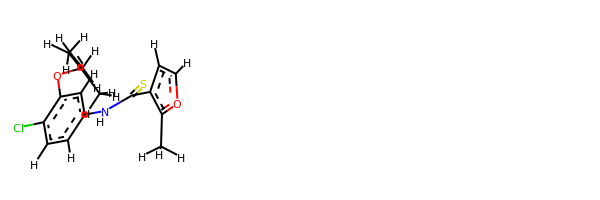

rdkit:  [H]C(=C(C([H])([H])[H])C([H])([H])[H])C([H])([H])Oc1c([H])c(N([H])C(=S)c2c(C([H])([H])[H])oc([H])c2[H])c([H])c([H])c1Cl
oechem:  Cc1c(cco1)C(=S)Nc2ccc(c(c2)OCC=C(C)C)Cl
###########################################################################
 #########################################################

bond
37.06568284513857 kJ/mol 58321.93859612896 kJ/mol False
angle
122.72196508972982 kJ/mol 122.72196508972982 kJ/mol True
nb
14.474970298180999 kJ/mol 14.474970298180999 kJ/mol True
torsion
93.95768401459141 kJ/mol 88.86999194216114 kJ/mol False
268.2203022476408 kJ/mol 58548.00552345903 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4604


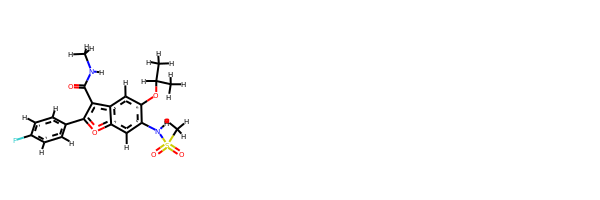

rdkit:  [H]c1c([H])c(-c2oc3c([H])c(N([H])S(=O)(=O)C([H])([H])[H])c(OC([H])(C([H])([H])[H])C([H])([H])[H])c([H])c3c2C(=O)N([H])C([H])([H])[H])c([H])c([H])c1F
oechem:  CC(C)Oc1cc2c(cc1NS(=O)(=O)C)oc(c2C(=O)NC)c3ccc(cc3)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
4.850794414087823 kJ/mol 58027.59229427109 kJ/mol False
angle
103.93237917157082 kJ/mol 105.94210186494286 kJ/mol False
nb
-2.1276476451209176 kJ/mol -2.1276476451209176 kJ/mol True
torsion
5.320601661928529 kJ/mol 4.9858400335355375 kJ/mol False
111.97612760246626 kJ/mol 58136.392588524446 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------


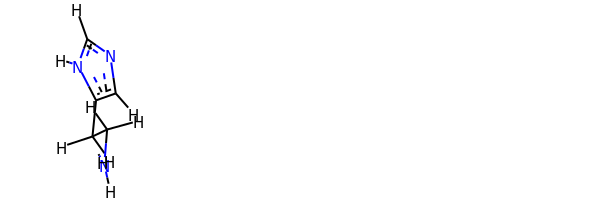

rdkit:  [H]c1nc([H])n([H])c1C([H])([H])C([H])([H])N([H])[H]
oechem:  c1c([nH]cn1)CCN
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
21.86456448733061 kJ/mol 58304.02763819676 kJ/mol False
angle
106.7455229495935 kJ/mol 106.7455229495935 kJ/mol True
nb
62.596321951371 kJ/mol 62.596321951371 kJ/mol True
torsion
82.88635543004652 kJ/mol 80.37226319496085 kJ/mol False
274.09276481834166 kJ/mol 58553.74174629269 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_46

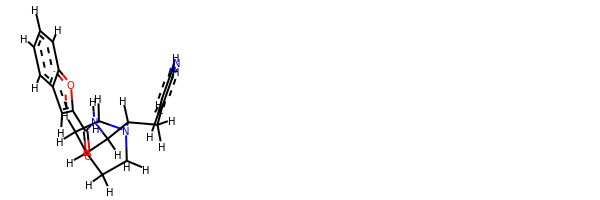

rdkit:  [H]c1nc([H])c(C([H])([H])C2([H])N3C([H])([H])C([H])([H])C([H])(C([H])([H])C3([H])[H])C2([H])N([H])C(=O)c2oc3c([H])c([H])c([H])c([H])c3c2[H])c([H])c1[H]
oechem:  c1ccc2c(c1)cc(o2)C(=O)NC3C4CCN(C3Cc5cccnc5)CC4
###########################################################################
 #########################################################

bond
28.94885936699517 kJ/mol 57780.99940463333 kJ/mol False
angle
272.11813252656316 kJ/mol 272.11813252656316 kJ/mol True
nb
25.59052471762561 kJ/mol 25.59052471762561 kJ/mol True
torsion
57.27629942592379 kJ/mol 57.27631028077939 kJ/mol False
383.93381603710776 kJ/mol 58135.9843721583 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4610


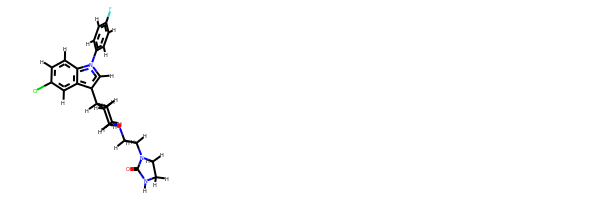

rdkit:  [H]c1c([H])c(-n2c([H])c(C3([H])C([H])([H])C([H])([H])N(C([H])([H])C([H])([H])N4C(=O)N([H])C([H])([H])C4([H])[H])C([H])([H])C3([H])[H])c3c([H])c(Cl)c([H])c([H])c32)c([H])c([H])c1F
oechem:  c1cc(ccc1n2cc(c3c2ccc(c3)Cl)C4CCN(CC4)CCN5CCNC5=O)F
###########################################################################
 #########################################################

bond
14.38669233236869 kJ/mol 43685.2322402764 kJ/mol False
angle
48.03761008693165 kJ/mol 51.39411290287277 kJ/mol False
nb
12.27810171641199 kJ/mol 12.27810171641199 kJ/mol True
torsion
79.99079202653768 kJ/mol 79.99082499544639 kJ/mol False
154.69319616225 kJ/mol 43828.89527989113 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4611


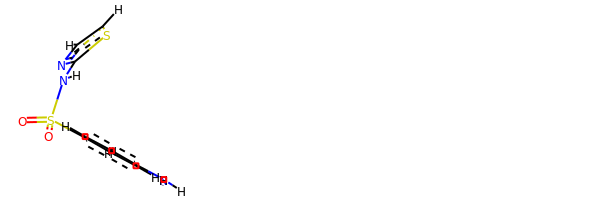

rdkit:  [H]c1nc(N([H])S(=O)(=O)c2c([H])c([H])c(N([H])[H])c([H])c2[H])sc1[H]
oechem:  c1cc(ccc1N)S(=O)(=O)Nc2nccs2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
21.95258561470374 kJ/mol 29090.325678527322 kJ/mol False
angle
93.3250558930383 kJ/mol 93.3250558930383 kJ/mol True
nb
34.746012737403966 kJ/mol 34.746012737403966 kJ/mol True
torsion
47.27261525744074 kJ/mol 42.04284190768946 kJ/mol False
197.29626950258674 kJ/mol 29260.439589065452 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
--------------------------------------------

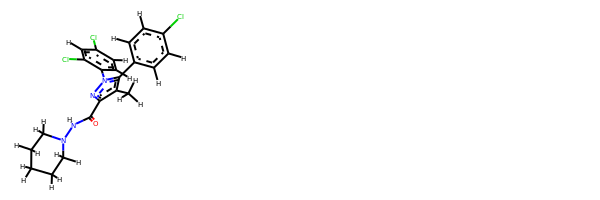

rdkit:  [H]c1c([H])c(-c2c(C([H])([H])[H])c(C(=O)N([H])N3C([H])([H])C([H])([H])C([H])([H])C([H])([H])C3([H])[H])nn2-c2c([H])c([H])c(Cl)c([H])c2Cl)c([H])c([H])c1Cl
oechem:  Cc1c(n(nc1C(=O)NN2CCCCC2)c3ccc(cc3Cl)Cl)c4ccc(cc4)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
18.932070230750092 kJ/mol 29158.769813635507 kJ/mol False
angle
83.42562155404622 kJ/mol 83.42562155404622 kJ/mol True
nb
16.04776595839179 kJ/mol 16.04776595839179 kJ/mol True
torsion
30.987306656418394 kJ/mol 16.7492468915610

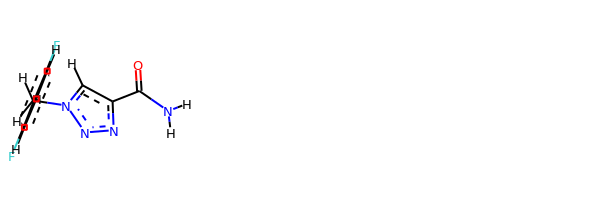

rdkit:  [H]c1c([H])c(F)c(C([H])([H])n2nnc(C(=O)N([H])[H])c2[H])c(F)c1[H]
oechem:  c1cc(c(c(c1)F)Cn2cc(nn2)C(=O)N)F
###########################################################################
 #########################################################

bond
37.698830391277774 kJ/mol 112813.62388235594 kJ/mol False
angle
43.701635847117096 kJ/mol 43.701635847117096 kJ/mol True
nb
59.23562076849803 kJ/mol 59.23562076849803 kJ/mol True
torsion
50.28120311333355 kJ/mol 30.081650003953477 kJ/mol False
190.91729012022645 kJ/mol 112946.6427889755 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4621


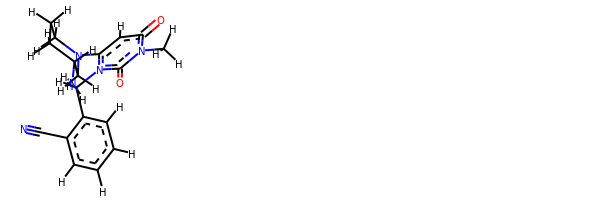

rdkit:  [H]c1c([H])c([H])c(C([H])([H])n2c(N3C([H])([H])C([H])([H])C([H])([H])C([H])(N([H])[H])C3([H])[H])c([H])c(=O)n(C([H])([H])[H])c2=O)c(C#N)c1[H]
oechem:  Cn1c(=O)cc(n(c1=O)Cc2ccccc2C#N)N3CCCC(C3)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################

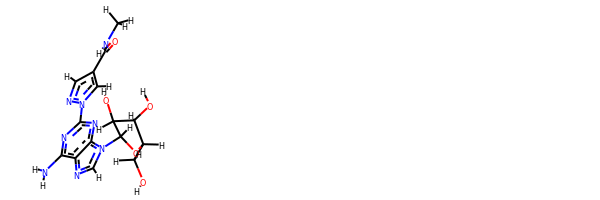

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])nc3c(N([H])[H])nc(-n4nc([H])c(C(=O)N([H])C([H])([H])[H])c4[H])nc32)C([H])(O[H])C1([H])O[H]
oechem:  CNC(=O)c1cnn(c1)c2nc(c3c(n2)n(cn3)C4C(C(C(O4)CO)O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
60.22517420781116 kJ/mol 43847.245452809795 kJ/mol False
angle
229.26432004467324 kJ/mol 231.41650104078946 kJ/mol False
nb
71.01607885754758 kJ/mol 71.01607885754758 kJ/mol True
torsion
62.40780085475502 kJ/mol 59.89358427803837 kJ/mol False
422.913373964787 kJ/mol 44209.57161698617 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4633


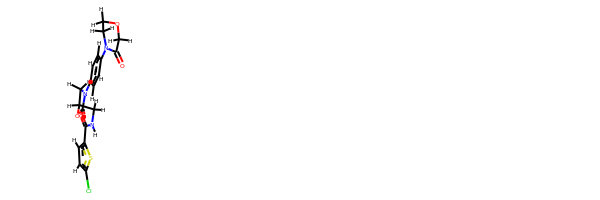

rdkit:  [H]c1c(Cl)sc(C(=O)N([H])C([H])([H])C2([H])OC(=O)N(c3c([H])c([H])c(N4C(=O)C([H])([H])OC([H])([H])C4([H])[H])c([H])c3[H])C2([H])[H])c1[H]
oechem:  c1cc(ccc1N2CCOCC2=O)N3CC(OC3=O)CNC(=O)c4ccc(s4)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
55.733618745960136 kJ/mol 101558.88145060856 kJ/mol False
angle
253.6651829111461 kJ/mol 255.8163655729543 kJ/mo

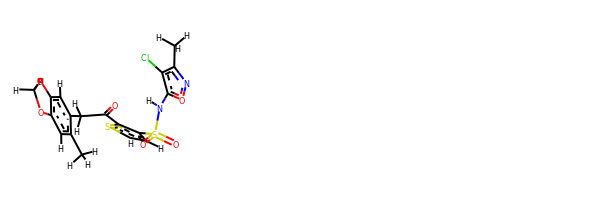

rdkit:  [H]c1sc(C(=O)C([H])([H])c2c([H])c3c(c([H])c2C([H])([H])[H])OC([H])([H])O3)c(S(=O)(=O)N([H])c2onc(C([H])([H])[H])c2Cl)c1[H]
oechem:  Cc1cc2c(cc1CC(=O)c3c(ccs3)S(=O)(=O)Nc4c(c(no4)C)Cl)OCO2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
64.75399417949104 kJ/mol 43736.89913726381 kJ/mol False
angle
464.0788946004261 kJ/mol 467.435870628407 kJ/mol False
nb
96.49142295217959 kJ/mol 96.49142295217959 kJ/mol True
torsion
494.3550022614484 kJ/mol 497.4872843525037 kJ/mol False
1119.6793139935453 kJ/mol 44798.3137151969 kJ/mol

-------------------------------------------------------------------
---------------------------------

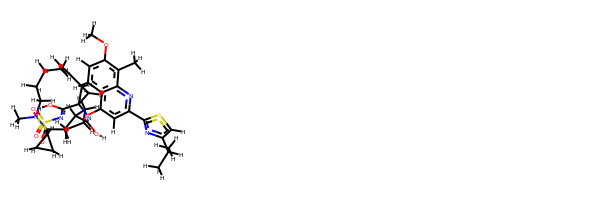

rdkit:  [H]OC1=NC2(C(=NS(=O)(=O)C3([H])C([H])([H])C3([H])[H])O[H])C([H])([H])C2([H])C([H])=C([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])N(C([H])([H])[H])C(=O)C2([H])C([H])([H])C([H])(Oc3c([H])c(-c4nc(C([H])(C([H])([H])[H])C([H])([H])[H])c([H])s4)nc4c(C([H])([H])[H])c(OC([H])([H])[H])c([H])c([H])c34)C([H])([H])C12[H]
oechem:  Cc1c(ccc2c1nc(cc2OC3CC4C(C3)C(=O)N(CCCCC=CC5CC5(N=C4O)C(=NS(=O)(=O)C6CC6)O)C)c7nc(cs7)C(C)C)OC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
17.085326619707768 kJ/mol 57769.452638710936 kJ/mol False
angle
102.68516407684916 kJ/mol 102.68516407684916 kJ/mol True
nb
48.151488251693976 kJ/mol 48.1514882

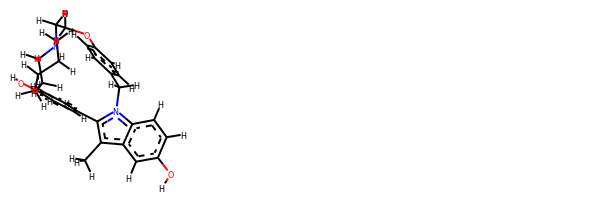

rdkit:  [H]Oc1c([H])c([H])c(-c2c(C([H])([H])[H])c3c([H])c(O[H])c([H])c([H])c3n2C([H])([H])c2c([H])c([H])c(OC([H])([H])C([H])([H])N3C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C3([H])[H])c([H])c2[H])c([H])c1[H]
oechem:  Cc1c2cc(ccc2n(c1c3ccc(cc3)O)Cc4ccc(cc4)OCCN5CCCCCC5)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

####################################

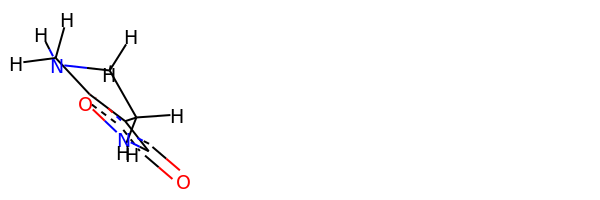

rdkit:  [H]N1C([H])([H])c2on([H])c(=O)c2C([H])([H])C1([H])[H]
oechem:  C1CNCc2c1c(=O)[nH]o2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
29.37700063741611 kJ/mol 29088.799392704503 kJ/mol False
angle
178.86251725176285 kJ/mol 178.86251725176285 kJ/mol True
nb
92.22971534124433 kJ/mol 92.22971534124433 kJ/mol True
torsion
110.09237296031334 kJ/mol 104.86254741180481 kJ/mol False
410.56160619073665 kJ/mol 29464.754172709316 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4661


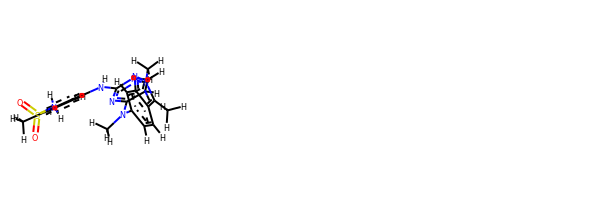

rdkit:  [H]c1nc(N([H])c2c([H])c([H])c(C([H])([H])[H])c(S(=O)(=O)N([H])[H])c2[H])nc(N(c2c([H])c([H])c3c(C([H])([H])[H])n(C([H])([H])[H])nc3c2[H])C([H])([H])[H])c1[H]
oechem:  Cc1ccc(cc1S(=O)(=O)N)Nc2nccc(n2)N(C)c3ccc4c(n(nc4c3)C)C
###########################################################################
 #########################################################

bond
51.52800266594185 kJ/mol 88194.45362252094 kJ/mol False
angle
441.009646969105 kJ/mol 444.3668416703539 kJ/mol False
nb
-29.10937072284126 kJ/mol -29.10937072284126 kJ/mol True
torsion
195.71583076400853 kJ/mol 195.71582800084227 kJ/mol False
659.1441096762142 kJ/mol 88805.4269214693 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4662


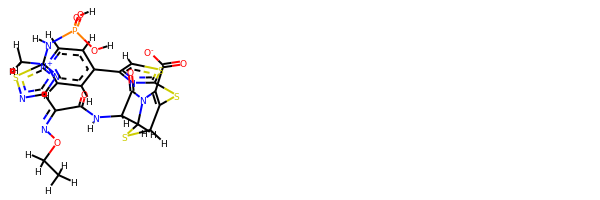

rdkit:  [H]OP(=O)(O[H])N([H])c1nc(C(=NOC([H])([H])C([H])([H])[H])C(=O)N([H])C2([H])C(=O)N3C(C(=O)[O-])=C(Sc4nc(-c5c([H])c([H])[n+](C([H])([H])[H])c([H])c5[H])c([H])s4)C([H])([H])SC32[H])ns1
oechem:  CCON=C(c1nc(sn1)NP(=O)(O)O)C(=O)NC2C3N(C2=O)C(=C(CS3)Sc4nc(cs4)c5cc[n+](cc5)C)C(=O)[O-]
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
14.087523393677394 kJ/mol 57767.40757064365 kJ/mol False
angle
113.45495082288325 kJ/mol 114.68644013097276 kJ/mol False
nb
46.08369256977 kJ/mol 46.08369256977 kJ/mol True
torsion
2.5049498738531604 kJ/mol 2.5050469472989145 kJ/mol False
176.13111666018378 kJ/mol 57930.68275029169 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
---------

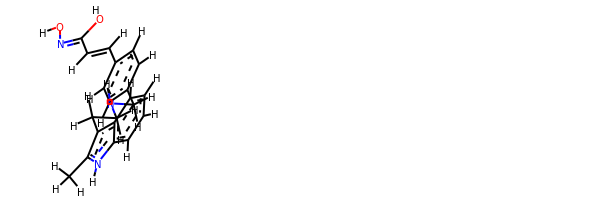

rdkit:  [H]ON=C(O[H])C([H])=C([H])c1c([H])c([H])c(C([H])([H])N([H])C([H])([H])C([H])([H])c2c(C([H])([H])[H])n([H])c3c([H])c([H])c([H])c([H])c23)c([H])c1[H]
oechem:  Cc1c(c2ccccc2[nH]1)CCNCc3ccc(cc3)C=CC(=NO)O
###########################################################################
 #########################################################

bond
77.73590323878881 kJ/mol 29124.67261225539 kJ/mol False
angle
105.61664403606687 kJ/mol 105.61664403606687 kJ/mol True
nb
119.72145233629217 kJ/mol 119.72145233629217 kJ/mol True
torsion
72.61565181687632 kJ/mol 67.16145370834101 kJ/mol False
375.68965142802415 kJ/mol 29417.17216233609 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4665


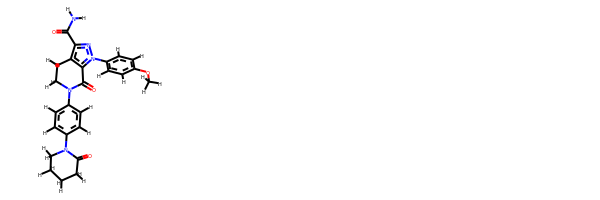

rdkit:  [H]c1c([H])c(-n2nc(C(=O)N([H])[H])c3c2C(=O)N(c2c([H])c([H])c(N4C(=O)C([H])([H])C([H])([H])C([H])([H])C4([H])[H])c([H])c2[H])C([H])([H])C3([H])[H])c([H])c([H])c1OC([H])([H])[H]
oechem:  COc1ccc(cc1)n2c3c(c(n2)C(=O)N)CCN(C3=O)c4ccc(cc4)N5CCCCC5=O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
9.500021900372522 kJ/mol 58050.69354010467 kJ/mol False
angle
18.06158766236981 kJ/mol 18.076133910126764 kJ/mol False
nb
13.42125808614703 kJ/mol 13.42125808614703 kJ/mol True
torsion
5.988600221887462e-05 kJ/mol 0.00019781876344778386 kJ/mol False
40.98292753489159 kJ/mol 58082.191129919716 kJ/mol

--------------------------------

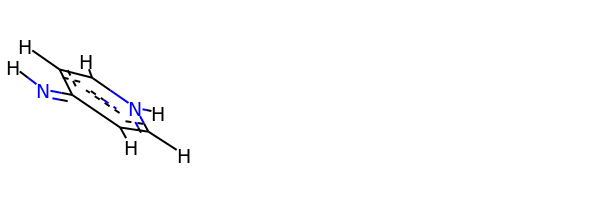

rdkit:  [H]N=c1c([H])c([H])n([H])c([H])c1[H]
oechem:  c1c[nH]ccc1=N
###########################################################################
 #########################################################

bond
61.47008042228209 kJ/mol 57813.73018605446 kJ/mol False
angle
465.380257415664 kJ/mol 466.608969602627 kJ/mol False
nb
61.52576256937763 kJ/mol 61.52576256937763 kJ/mol True
torsion
276.76912833826515 kJ/mol 276.76914056509435 kJ/mol False
865.145228745589 kJ/mol 58618.634058791555 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4671


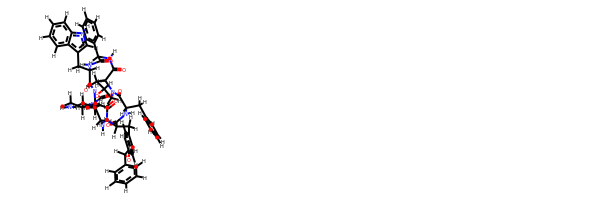

rdkit:  [H]c1c([H])c([H])c(C([H])([H])Oc2c([H])c([H])c(C([H])([H])C3([H])C(=O)N([H])C([H])(C([H])([H])c4c([H])c([H])c([H])c([H])c4[H])C(=O)N4C([H])([H])C([H])(OC(=O)N([H])C([H])([H])C([H])([H])N([H])[H])C([H])([H])C4([H])C(=O)N([H])C([H])(c4c([H])c([H])c([H])c([H])c4[H])C(=O)N([H])C([H])(C([H])([H])c4c([H])n([H])c5c([H])c([H])c([H])c([H])c45)C(=O)N([H])C([H])(C([H])([H])C([H])([H])C([H])([H])C([H])([H])N([H])[H])C(=O)N3[H])c([H])c2[H])c([H])c1[H]
oechem:  c1ccc(cc1)CC2C(=O)N3CC(CC3C(=O)NC(C(=O)NC(C(=O)NC(C(=O)NC(C(=O)N2)Cc4ccc(cc4)OCc5ccccc5)CCCCN)Cc6c[nH]c7c6cccc7)c8ccccc8)OC(=O)NCCN
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
29.153134403421806 kJ/mol 116066.34946693634 kJ/mol False
angle
170.25441772625067 kJ/mol 171.48364180079471 kJ/mol False
nb
39.993

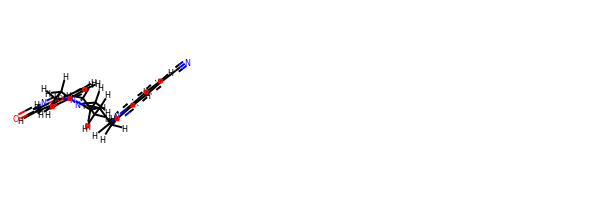

rdkit:  [H]c1c(N2C([H])([H])C([H])([H])N(C([H])([H])C([H])([H])C([H])([H])C([H])([H])c3c([H])n([H])c4c([H])c([H])c(C#N)c([H])c34)C([H])([H])C2([H])[H])c([H])c2c([H])c(C(=O)N([H])[H])oc2c1[H]
oechem:  c1cc2c(cc1C#N)c(c[nH]2)CCCCN3CCN(CC3)c4ccc5c(c4)cc(o5)C(=O)N
###########################################################################
 #########################################################

bond
43.409180961396515 kJ/mol 56115.87640970049 kJ/mol False
angle
22.887686198661104 kJ/mol 22.887686198661104 kJ/mol True
nb
113.85869048167292 kJ/mol 113.85869048167292 kJ/mol True
torsion
31.913227987988797 kJ/mol 19.904830921853446 kJ/mol False
212.06878562971934 kJ/mol 56272.52761730268 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4674


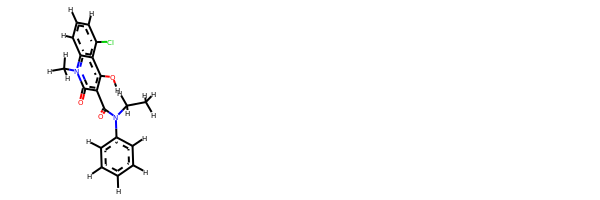

rdkit:  [H]Oc1c(C(=O)N(c2c([H])c([H])c([H])c([H])c2[H])C([H])([H])C([H])([H])[H])c(=O)n(C([H])([H])[H])c2c([H])c([H])c([H])c(Cl)c12
oechem:  CCN(c1ccccc1)C(=O)c2c(c3c(cccc3Cl)n(c2=O)C)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

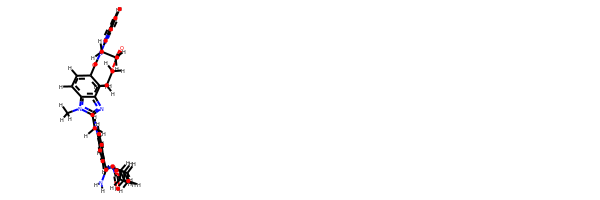

rdkit:  [H]c1nc(N(C(=O)c2c([H])c([H])c3c(nc(C([H])([H])N([H])c4c([H])c([H])c(C(=NC(=O)OC([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])[H])N([H])[H])c([H])c4[H])n3C([H])([H])[H])c2[H])C([H])([H])C([H])([H])C(=O)OC([H])([H])C([H])([H])[H])c([H])c([H])c1[H]
oechem:  CCCCCCOC(=O)N=C(c1ccc(cc1)NCc2nc3cc(ccc3n2C)C(=O)N(CCC(=O)OCC)c4ccccn4)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #######################

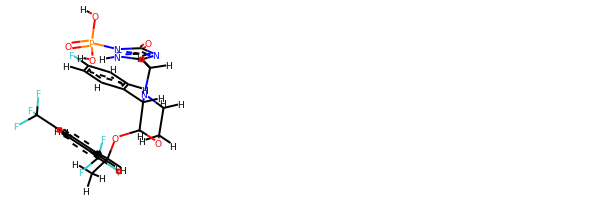

rdkit:  [H]OP(=O)(O[H])n1c(=O)nc(C([H])([H])N2C([H])([H])C([H])([H])OC([H])(OC([H])(c3c([H])c(C(F)(F)F)c([H])c(C(F)(F)F)c3[H])C([H])([H])[H])C2([H])c2c([H])c([H])c(F)c([H])c2[H])n1[H]
oechem:  CC(c1cc(cc(c1)C(F)(F)F)C(F)(F)F)OC2C(N(CCO2)Cc3[nH]n(c(=O)n3)P(=O)(O)O)c4ccc(cc4)F
###########################################################################
 #########################################################

bond
30.301157522209323 kJ/mol 29051.350918901622 kJ/mol False
angle
444.7270272075444 kJ/mol 446.3279684373435 kJ/mol False
nb
67.1212444654051 kJ/mol 67.1212444654051 kJ/mol True
torsion
131.7956914770908 kJ/mol 126.6014652350799 kJ/mol False
673.9451206722496 kJ/mol 29691.40159703945 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4703


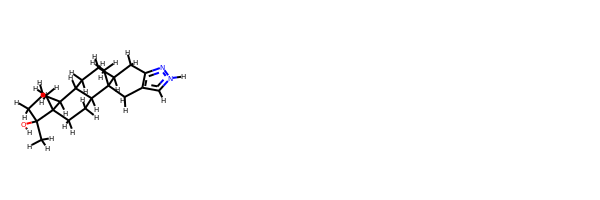

rdkit:  [H]OC1(C([H])([H])[H])C([H])([H])C([H])([H])C2([H])C3([H])C([H])([H])C([H])([H])C4([H])C([H])([H])c5nn([H])c([H])c5C([H])([H])C4(C([H])([H])[H])C3([H])C([H])([H])C([H])([H])C21C([H])([H])[H]
oechem:  CC12CCC3C(C1CCC2(C)O)CCC4C3(Cc5c[nH]nc5C4)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
29.007219423786864 kJ/mol 43627.69798258824 kJ/mol False
angle
90.27746756895905 kJ/mol 92.07940830158174 kJ/mol False
nb
53.12813591682539 kJ/mol 53.12813591682539 kJ/mol True
torsion
134.67578185160536 kJ/mol 134.68155666576718 kJ/mol False
307.08860476117667 kJ/mol 43907.58708347241 kJ/mol

----------------------------------------

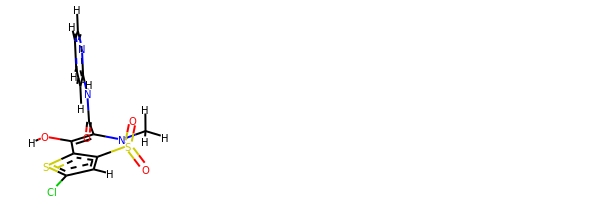

rdkit:  [H]OC1=C(C(=O)N([H])c2nc([H])c([H])c([H])c2[H])N(C([H])([H])[H])S(=O)(=O)c2c1sc(Cl)c2[H]
oechem:  CN1C(=C(c2c(cc(s2)Cl)S1(=O)=O)O)C(=O)Nc3ccccn3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
20.936357027019522 kJ/mol 29090.828838719768 kJ/mol False
angle
101.03740384091809 kJ/mol 101.03740384091809 kJ/mol True
nb
31.182533395785537 kJ/mol 31.182533395785537 kJ/mol True
torsion
103.89068492909458 kJ/mol 98.66083263109775 kJ/mol False
257.04697919281773 kJ/mol 29321.709608587567 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------

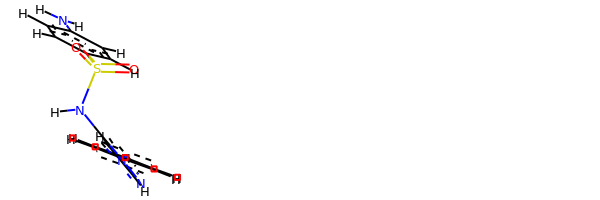

rdkit:  [H]c1nn(-c2c([H])c([H])c([H])c([H])c2[H])c(N([H])S(=O)(=O)c2c([H])c([H])c(N([H])[H])c([H])c2[H])c1[H]
oechem:  c1ccc(cc1)n2c(ccn2)NS(=O)(=O)c3ccc(cc3)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
20.896635034607524 kJ/mol 57653.55015272762 kJ/mol False
angle
22.192845629512327 kJ/mol 22.192845629512327 kJ/mol True
nb
57.93227370015717 kJ/mol 57.93227370015717 kJ/mol True
torsion
15.563305792068101 kJ/mol 15.586441551556225 kJ/mol False
116.58506015634512 kJ/mol 57749.261713608845 kJ/mol

-------------------------------------------------------------------
--------------------------------------------------------------

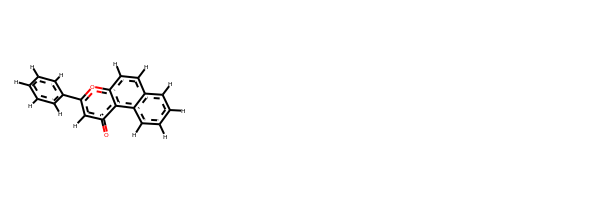

rdkit:  [H]c1c([H])c([H])c(-c2oc3c([H])c([H])c4c([H])c([H])c([H])c([H])c4c3c(=O)c2[H])c([H])c1[H]
oechem:  c1ccc(cc1)c2cc(=O)c3c4ccccc4ccc3o2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

##########################################

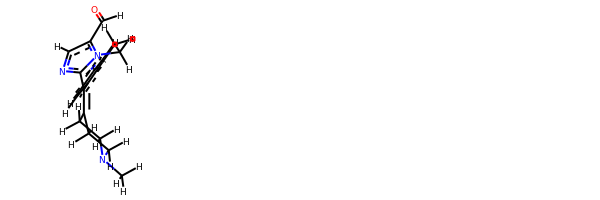

rdkit:  [H]C(=O)c1c([H])nc2n1C([H])([H])C([H])([H])c1c([H])c([H])c([H])c([H])c1C2=C1C([H])([H])C([H])([H])N(C([H])([H])[H])C([H])([H])C1([H])[H]
oechem:  CN1CCC(=C2c3ccccc3CCn4c2ncc4C=O)CC1
###########################################################################
 #########################################################

bond
11.278942675524124 kJ/mol 57926.39101432957 kJ/mol False
angle
102.97971338426366 kJ/mol 102.97971338426366 kJ/mol True
nb
29.674640521378056 kJ/mol 29.674640521378056 kJ/mol True
torsion
9.632137218213124 kJ/mol 8.93933886998332 kJ/mol False
153.56543379937895 kJ/mol 58067.9847071052 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4732


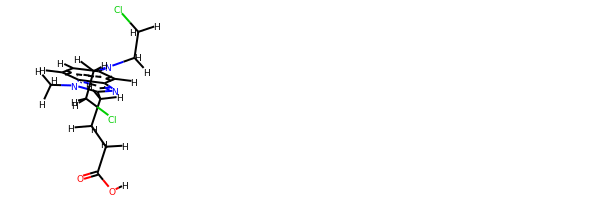

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])C([H])([H])c1nc2c([H])c(N(C([H])([H])C([H])([H])Cl)C([H])([H])C([H])([H])Cl)c([H])c([H])c2n1C([H])([H])[H]
oechem:  Cn1c2ccc(cc2nc1CCCC(=O)O)N(CCCl)CCCl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
16.74893657490749 kJ/mol 56662.74906501618 kJ/mol False
angle
72.18501064138654 kJ/mol 72.18501064138654 kJ/mol True
nb
91.09941354242376 kJ/mol 91.09941354242376 kJ/mol True
torsion
223.46782920400258 kJ/mol 181.02176764438923 kJ/mol False
403.5011899627204 kJ/mol 57007.055256844375 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4734


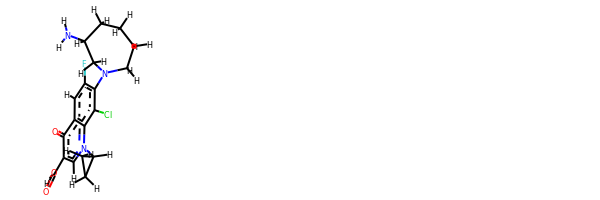

rdkit:  [H]OC(=O)c1c([H])n(C2([H])C([H])([H])C2([H])[H])c2c(Cl)c(N3C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])(N([H])[H])C3([H])[H])c(F)c([H])c2c1=O
oechem:  c1c2c(c(c(c1F)N3CCCCC(C3)N)Cl)n(cc(c2=O)C(=O)O)C4CC4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################

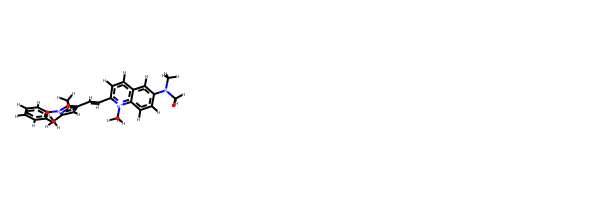

rdkit:  [H]C(=C([H])c1c([H])c([H])c2c([H])c(N(C([H])([H])[H])C([H])([H])[H])c([H])c([H])c2[n+]1C([H])([H])[H])c1c([H])c(C([H])([H])[H])n(-c2c([H])c([H])c([H])c([H])c2[H])c1C([H])([H])[H]
oechem:  Cc1cc(c(n1c2ccccc2)C)C=Cc3ccc4cc(ccc4[n+]3C)N(C)C
###########################################################################
 #########################################################

bond
37.5693340136297 kJ/mol 115098.51129864097 kJ/mol False
angle
123.77936391404049 kJ/mol 123.77936391404049 kJ/mol True
nb
304.66797492064387 kJ/mol 304.66797492064387 kJ/mol True
torsion
51.01112410294975 kJ/mol 27.697402302641756 kJ/mol False
517.0277969512638 kJ/mol 115554.65603977829 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4763


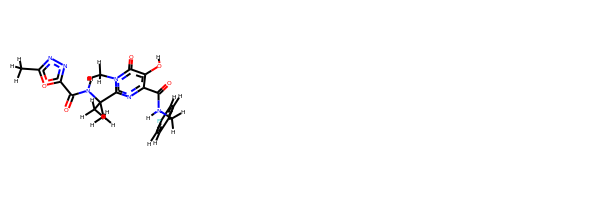

rdkit:  [H]Oc1c(C(=O)N([H])C([H])([H])c2c([H])c([H])c(F)c([H])c2[H])nc(C(N([H])C(=O)c2nnc(C([H])([H])[H])o2)(C([H])([H])[H])C([H])([H])[H])n(C([H])([H])[H])c1=O
oechem:  Cc1nnc(o1)C(=O)NC(C)(C)c2nc(c(c(=O)n2C)O)C(=O)NCc3ccc(cc3)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
16.666334320519365 kJ/mol 115627.32806558347 kJ/mol False
angle
159.59490891196282 kJ/mol 160.82395400124258 kJ/mol False
nb
18.623968315640266 kJ/mol 18.623968315640266 kJ/mol True
torsion
16.846266204791785 kJ/mol 16.84

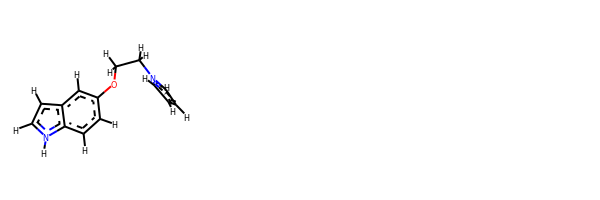

rdkit:  [H]c1c(OC([H])([H])C([H])([H])n2c([H])c([H])c([H])c2[H])c([H])c2c([H])c([H])n([H])c2c1[H]
oechem:  c1ccn(c1)CCOc2ccc3c(c2)cc[nH]3
###########################################################################
 #########################################################

bond
19.928821828304965 kJ/mol 43808.08417033654 kJ/mol False
angle
67.93812932959207 kJ/mol 70.09130705857424 kJ/mol False
nb
33.5566994675728 kJ/mol 33.5566994675728 kJ/mol True
torsion
67.12122751584836 kJ/mol 67.12122384818234 kJ/mol False
188.54487814131818 kJ/mol 43978.85340071087 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4772


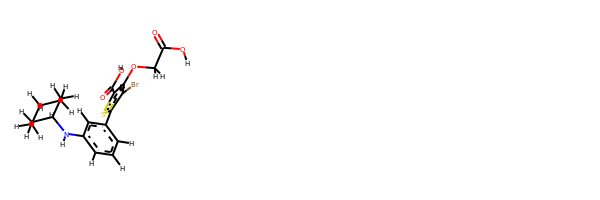

rdkit:  [H]OC(=O)c1sc(-c2c([H])c([H])c([H])c(N([H])C3([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C3([H])[H])c2[H])c(Br)c1OC([H])([H])C(=O)O[H]
oechem:  c1cc(cc(c1)NC2CCCCC2)c3c(c(c(s3)C(=O)O)OCC(=O)O)Br
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
32.65817748588829 kJ/mol 114417.67755312966 kJ/mol False
angle
116.69765697132968 kJ/mol 118.8156263150313 kJ/mol False
nb
67.63654440623218 kJ/mol 67.63654440623218 kJ/mol True
torsion
43.32230960224286 kJ/mol 44.872649952229075 kJ/mol False
260.314688465693 kJ/mol 114649.00237380316 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4774


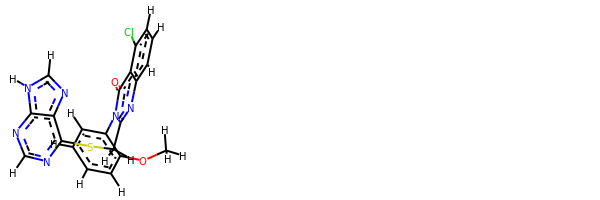

rdkit:  [H]c1nc(SC([H])([H])c2nc3c([H])c([H])c([H])c(Cl)c3c(=O)n2-c2c([H])c([H])c([H])c([H])c2OC([H])([H])[H])c2nc([H])n([H])c2n1
oechem:  COc1ccccc1n2c(nc3cccc(c3c2=O)Cl)CSc4c5c([nH]cn5)ncn4
###########################################################################
 #########################################################

bond
9.876977103288123 kJ/mol 58154.77653598156 kJ/mol False
angle
95.7837578905164 kJ/mol 95.7837578905164 kJ/mol True
nb
36.04167239221082 kJ/mol 36.04167239221082 kJ/mol True
torsion
5.5810742333229575 kJ/mol 5.581053983761783 kJ/mol False
147.2834816193383 kJ/mol 58292.18302024805 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4775


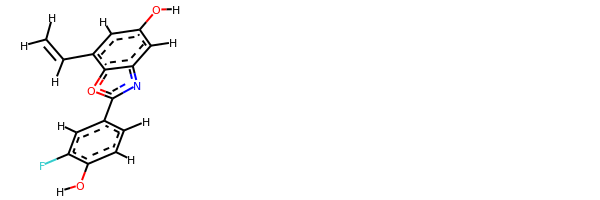

rdkit:  [H]Oc1c([H])c([H])c(-c2nc3c([H])c(O[H])c([H])c(C([H])=C([H])[H])c3o2)c([H])c1F
oechem:  C=Cc1cc(cc2c1oc(n2)c3ccc(c(c3)F)O)O
###########################################################################
 #########################################################

bond
10.779565919676463 kJ/mol 57762.98842831952 kJ/mol False
angle
84.16301296034102 kJ/mol 84.16301296034102 kJ/mol True
nb
33.723814057799366 kJ/mol 33.723814057799366 kJ/mol True
torsion
30.8313952594144 kJ/mol 30.831615702056702 kJ/mol False
159.49778819723124 kJ/mol 57911.70687103972 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4776


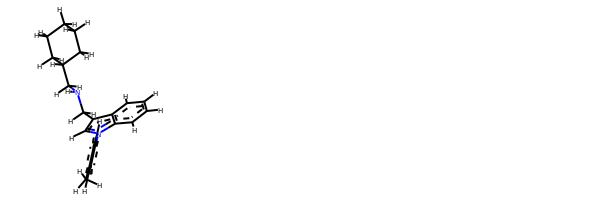

rdkit:  [H]c1c([H])c(C([H])([H])[H])c([H])c([H])c1-n1c([H])c(C([H])([H])N([H])C([H])([H])C2([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C2([H])[H])c2c([H])c([H])c([H])c([H])c21
oechem:  Cc1ccc(cc1)n2cc(c3c2cccc3)CNCC4CCCCC4
###########################################################################
 #########################################################

bond
17.798418452681474 kJ/mol 115628.4438787121 kJ/mol False
angle
179.98303918266956 kJ/mol 181.36559076273892 kJ/mol False
nb
48.05558229041484 kJ/mol 48.05558229041484 kJ/mol True
torsion
25.14510031892622 kJ/mol 25.145379055847403 kJ/mol False
270.9821402446921 kJ/mol 115883.0104308211 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4777


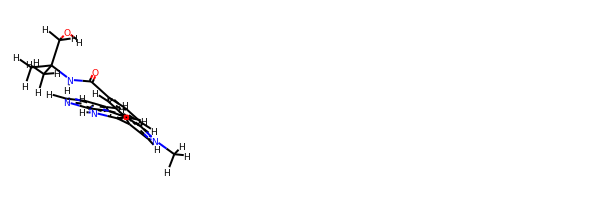

rdkit:  [H]OC([H])([H])C(N([H])C(=O)c1c([H])c([H])c2c(c1[H])c(-c1c([H])c3c([H])c([H])c([H])nc3n1[H])c([H])n2C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H]
oechem:  CC(C)(CO)NC(=O)c1ccc2c(c1)c(cn2C)c3cc4cccnc4[nH]3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
6.82034318052218 kJ/mol 99053.96644193357 kJ/mol False
angle
86.08273277674223 kJ/mol 89.25556807703279 kJ/mol False
nb
19.790328284180458 kJ/mol 19.790328284180458 kJ/mol True
torsion
106.49119273126392 kJ/mol 106.49087859839571 kJ/mol False
219.18459697270876 kJ/mol 99269.5032168932 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_477

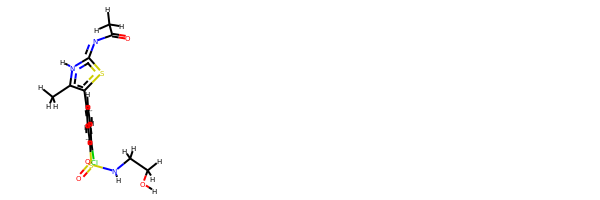

rdkit:  [H]OC([H])([H])C([H])([H])N([H])S(=O)(=O)c1c([H])c(-c2sc(=NC(=O)C([H])([H])[H])n([H])c2C([H])([H])[H])c([H])c([H])c1Cl
oechem:  Cc1c(sc(=NC(=O)C)[nH]1)c2ccc(c(c2)S(=O)(=O)NCCO)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ########################################################

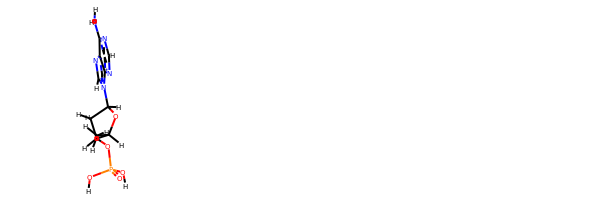

rdkit:  [H]OP(=O)(O[H])OC1([H])C([H])([H])C([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)OC1([H])C([H])([H])[H]
oechem:  CC1C(CC(O1)n2cnc3c2ncnc3N)OP(=O)(O)O
###########################################################################
 #########################################################

bond
54.120784823136695 kJ/mol 43873.07223469633 kJ/mol False
angle
172.10893446873365 kJ/mol 175.3149540701526 kJ/mol False
nb
25.040156983644305 kJ/mol 25.040156983644305 kJ/mol True
torsion
87.50235374229561 kJ/mol 87.50240109579951 kJ/mol False
338.7722300178103 kJ/mol 44160.92974684593 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4787


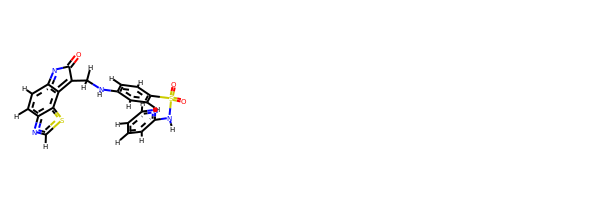

rdkit:  [H]c1nc2c([H])c([H])c3c(c2s1)=C(C([H])([H])N([H])c1c([H])c([H])c(S(=O)(=O)N([H])c2nc([H])c([H])c([H])c2[H])c([H])c1[H])C(=O)N=3
oechem:  c1ccnc(c1)NS(=O)(=O)c2ccc(cc2)NCC3=c4c(=NC3=O)ccc5c4scn5
###########################################################################
 #########################################################

bond
10.183470886413609 kJ/mol 57763.149266891625 kJ/mol False
angle
116.5047955031312 kJ/mol 116.5047955031312 kJ/mol True
nb
33.22874872561679 kJ/mol 33.22874872561679 kJ/mol True
torsion
43.104331440830805 kJ/mol 42.39869590465581 kJ/mol False
203.0213465559924 kJ/mol 57955.28150702503 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4789


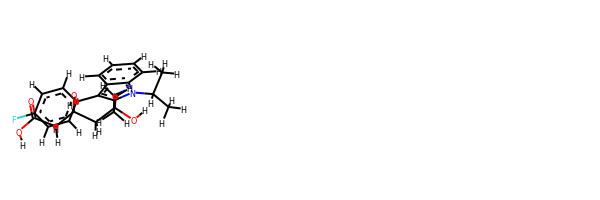

rdkit:  [H]OC(=O)C([H])([H])C([H])(O[H])C([H])([H])C([H])(O[H])C([H])([H])C([H])([H])c1c(-c2c([H])c([H])c(F)c([H])c2[H])c2c([H])c([H])c([H])c([H])c2n1C([H])(C([H])([H])[H])C([H])([H])[H]
oechem:  CC(C)n1c2ccccc2c(c1CCC(CC(CC(=O)O)O)O)c3ccc(cc3)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
37.919439860592014 kJ/mol 43459.01617583692 kJ/mol False
angle
289.38837622960074 kJ/mol 291.15055109551884 kJ/mol False
nb
21.235444665968977 kJ/mol 21.235444665968977 kJ/mol True
torsion
69.68097044562612 kJ/mol 52.356308739470066 kJ/mol False
418.2242312017879 kJ/mol 43823.75848033788 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
--------------------------------------------

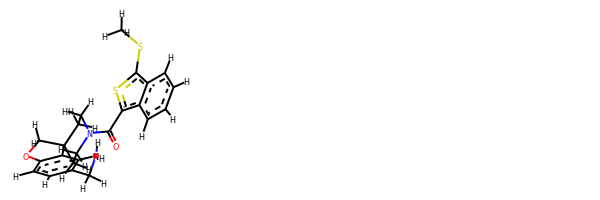

rdkit:  [H]c1c([H])c(C([H])([H])N([H])[H])c([H])c2c1OC([H])([H])C21C([H])([H])C([H])([H])N(C(=O)c2sc(SC([H])([H])[H])c3c([H])c([H])c([H])c([H])c23)C([H])([H])C1([H])[H]
oechem:  CSc1c2ccccc2c(s1)C(=O)N3CCC4(CC3)COc5c4cc(cc5)CN
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
24.73754750529451 kJ/mol 115133.98134362654 kJ/mol False
angle
101.08874953733776 kJ/mol 103.17490982221723 kJ/mol False
nb
73.65533936737323 kJ/mol 73.65533936737323 kJ/mol True
torsion
102.68449809074127 kJ/mol 95.36657571771256 kJ/mol False
302.1661345007468 kJ/mol 115406.17816853384 kJ/mol

----------------------------------------------------------------

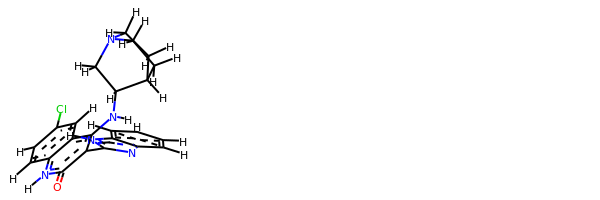

rdkit:  [H]c1c([H])c([H])c2c(nc(-c3c(N([H])C4([H])C([H])([H])N5C([H])([H])C([H])([H])C4([H])C([H])([H])C5([H])[H])c4c([H])c(Cl)c([H])c([H])c4n([H])c3=O)n2[H])c1[H]
oechem:  c1ccc2c(c1)[nH]c(n2)c3c(c4cc(ccc4[nH]c3=O)Cl)NC5CN6CCC5CC6
###########################################################################
 #########################################################

bond
37.84205418793076 kJ/mol 57955.22656994507 kJ/mol False
angle
84.62345109694475 kJ/mol 86.52988150819236 kJ/mol False
nb
27.067201208403123 kJ/mol 27.067201208403123 kJ/mol True
torsion
57.03158301695966 kJ/mol 66.4338633079947 kJ/mol False
206.5642895102383 kJ/mol 58135.257515969664 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4798


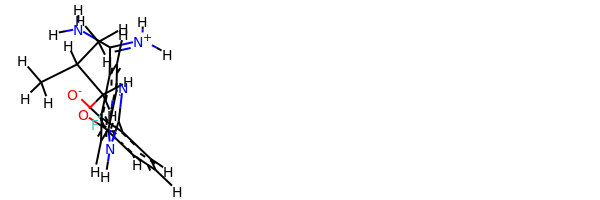

rdkit:  [H]c1c([H])c(OC([H])([H])C([H])(C([H])([H])[H])C([H])([H])[H])c([O-])c(-c2nc3c([H])c(C(N([H])[H])=[N+]([H])[H])c(F)c([H])c3n2[H])c1[H]
oechem:  CC(C)COc1cccc(c1[O-])c2[nH]c3cc(c(cc3n2)C(=[NH2+])N)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #####################################

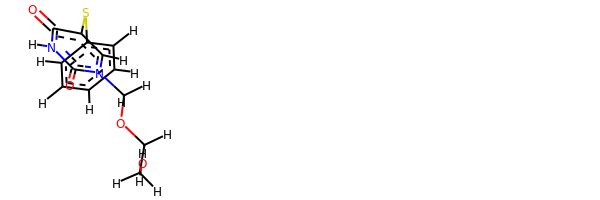

rdkit:  [H]OC([H])([H])C([H])([H])OC([H])([H])n1c([H])c(Sc2c([H])c([H])c([H])c([H])c2[H])c(=O)n([H])c1=O
oechem:  c1ccc(cc1)Sc2cn(c(=O)[nH]c2=O)COCCO
###########################################################################
 #########################################################

bond
42.29282696682379 kJ/mol 113894.09053295672 kJ/mol False
angle
26.412892681840823 kJ/mol 27.033232307450902 kJ/mol False
nb
61.53037201973603 kJ/mol 61.53037201973603 kJ/mol True
torsion
69.58994140496466 kJ/mol 11.220528036431327 kJ/mol False
199.8260330733653 kJ/mol 113993.87466532034 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4815


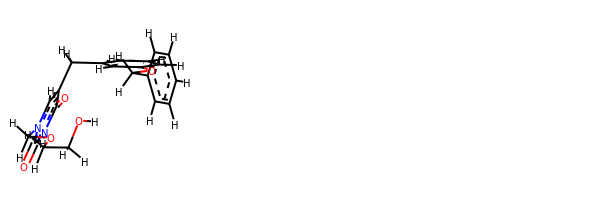

rdkit:  [H]OC([H])([H])C([H])([H])OC([H])([H])n1c([H])c(C([H])([H])c2c([H])c([H])c([H])c(OC([H])([H])c3c([H])c([H])c([H])c([H])c3[H])c2[H])c(=O)n([H])c1=O
oechem:  c1ccc(cc1)COc2cccc(c2)Cc3cn(c(=O)[nH]c3=O)COCCO
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
26.29981898783517 kJ/mol 57884.0106583892 kJ/mol False
angle
121.89044583402396 kJ/mol 123.27209794691414 kJ/mol False
nb
80.25146906871805 kJ/mol 80.25146906871805 kJ/mol True
torsion
26.35009639406896 kJ/mol 26.350135687546913 kJ/mol False
254.79183028464615 kJ/mol 58113.88436109238 kJ/mol

-------------------------------------------------------------------
-------------

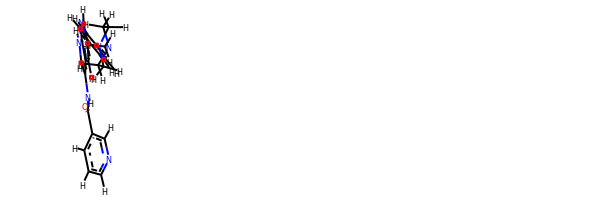

rdkit:  [H]c1nc([H])c(C(=O)N([H])c2c([H])n([H])c3nc([H])c(-c4c([H])c([H])c(N5C([H])([H])C([H])([H])N(C([H])([H])[H])C([H])([H])C5([H])[H])c([H])c4[H])c([H])c23)c([H])c1[H]
oechem:  CN1CCN(CC1)c2ccc(cc2)c3cc4c(c[nH]c4nc3)NC(=O)c5cccnc5
###########################################################################
 #########################################################

bond
31.407016661020915 kJ/mol 86955.52199625832 kJ/mol False
angle
168.8831821633768 kJ/mol 171.88656165145505 kJ/mol False
nb
9.649200146578558 kJ/mol 9.649200146578558 kJ/mol True
torsion
41.57308923115409 kJ/mol 27.23176204971011 kJ/mol False
251.51248820213036 kJ/mol 87164.28952010606 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4819


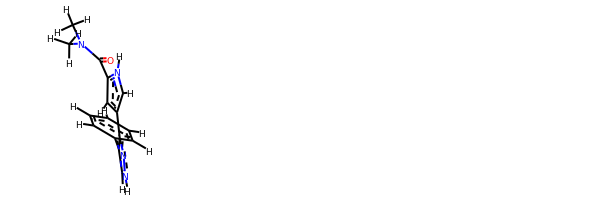

rdkit:  [H]c1c([H])c([H])c(-c2c(-c3c([H])c(C(=O)N(C([H])([H])[H])C([H])([H])[H])n([H])c3[H])nn([H])c2[H])c([H])c1[H]
oechem:  CN(C)C(=O)c1cc(c[nH]1)c2c(c[nH]n2)c3ccccc3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
47.891487095374714 kJ/mol 29116.445311432377 kJ/mol False
angle
128.77181700227115 kJ/mol 128.77181700227115 kJ/mol True
nb
52.635000338911844 kJ/

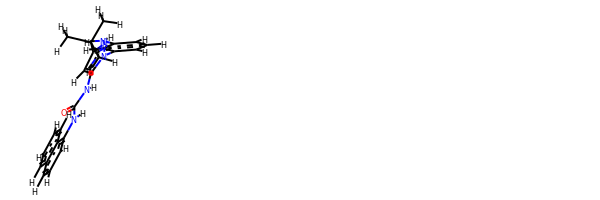

rdkit:  [H]c1c([H])c(N([H])[H])c([H])c(-n2nc(C(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H])c([H])c2N([H])C(=O)N([H])c2c([H])c([H])c([H])c3c([H])c([H])c([H])c([H])c23)c1[H]
oechem:  CC(C)(C)c1cc(n(n1)c2cccc(c2)N)NC(=O)Nc3cccc4c3cccc4
###########################################################################
 #########################################################

bond
47.3658282282058 kJ/mol 29116.056868710915 kJ/mol False
angle
121.087226931232 kJ/mol 121.087226931232 kJ/mol True
nb
57.51371630146883 kJ/mol 57.51371630146883 kJ/mol True
torsion
21.174920854226322 kJ/mol 15.944941894545584 kJ/mol False
247.14169231513293 kJ/mol 29310.60275383816 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4825


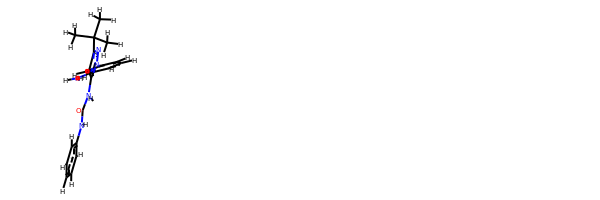

rdkit:  [H]c1c([H])c([H])c(N([H])C(=O)N([H])c2c([H])c(C(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H])nn2-c2c([H])c([H])c([H])c(N([H])[H])c2[H])c([H])c1[H]
oechem:  CC(C)(C)c1cc(n(n1)c2cccc(c2)N)NC(=O)Nc3ccccc3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
35.026995300487904 kJ/mol 114086.09253516338 kJ/mol False
angle
362.7511052293332 kJ/mol 362.95145794136

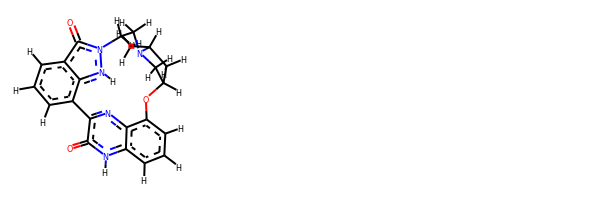

rdkit:  [H]c1c([H])c([H])c2c3nc(c(=O)n2[H])-c2c([H])c([H])c([H])c4c(=O)n(n([H])c24)C([H])([H])C([H])([H])N2C([H])([H])C([H])(Oc13)C([H])([H])C2([H])C([H])([H])[H]
oechem:  CC1CC2CN1CCn3c(=O)c4cccc(c4[nH]3)-c5c(=O)[nH]c6cccc(c6n5)O2
###########################################################################
 #########################################################

bond
29.92574871100269 kJ/mol 129809.89755724878 kJ/mol False
angle
152.1582552038134 kJ/mol 156.97979508801956 kJ/mol False
nb
18.65583457002159 kJ/mol 18.65583457002159 kJ/mol True
torsion
56.6215228244484 kJ/mol 5.263518562899136 kJ/mol False
257.36136130928605 kJ/mol 129990.79670546972 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4831


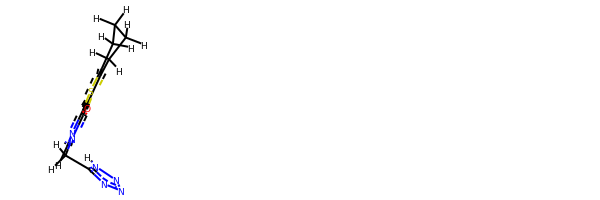

rdkit:  [H]c1nc2sc3c(c2c(=O)n1C([H])([H])c1nnnn1[H])C([H])([H])C([H])([H])C([H])([H])C3([H])[H]
oechem:  c1nc2c(c3c(s2)CCCC3)c(=O)n1Cc4[nH]nnn4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
20.19502053300951 kJ/mol 43708.02759273388 kJ/mol False
angle
66.88014893963731 kJ/mol 71.27549572061116 kJ/mol False
nb
9.495039034793962 kJ/mol 9.495039034793962 kJ/mol True
torsion
149.29259849587123 kJ/mol 149.29253493153726 kJ/mol False
245.862807003312 kJ/mol 43938.09066242082 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4833


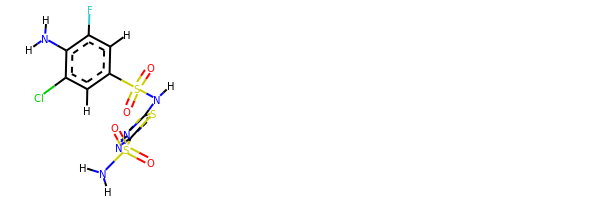

rdkit:  [H]c1c(F)c(N([H])[H])c(Cl)c([H])c1S(=O)(=O)N([H])c1nnc(S(=O)(=O)N([H])[H])s1
oechem:  c1c(cc(c(c1F)N)Cl)S(=O)(=O)Nc2nnc(s2)S(=O)(=O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
58.936826368081434 kJ/mol 114190.58530131978 kJ/mol False
angle
121.91473534010234 kJ/mol 123.2954760738443 kJ/mol False
nb
102.50964442494416 kJ/mol 102.50964442494416 kJ/mol True
torsion
53.40342447841674 kJ/mol 40.44087211584579 kJ/mol False
336.76463061154465 kJ/mol 114456.83129393442 kJ/mol

-----------

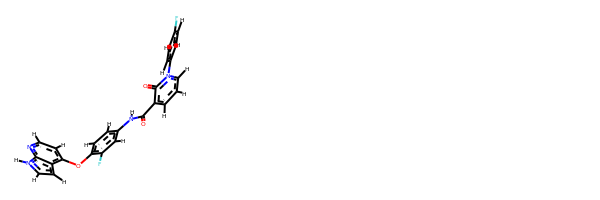

rdkit:  [H]c1nc2c(c([H])c([H])n2[H])c(Oc2c([H])c([H])c(N([H])C(=O)c3c([H])c([H])c([H])n(-c4c([H])c([H])c(F)c([H])c4[H])c3=O)c([H])c2F)c1[H]
oechem:  c1cc(c(=O)n(c1)c2ccc(cc2)F)C(=O)Nc3ccc(c(c3)F)Oc4ccnc5c4cc[nH]5
###########################################################################
 #########################################################

bond
20.692424217117694 kJ/mol 57685.71310397176 kJ/mol False
angle
97.32160308451576 kJ/mol 97.32160308451576 kJ/mol True
nb
45.23480029940123 kJ/mol 45.23480029940123 kJ/mol True
torsion
20.53407517219627 kJ/mol 29.944363682131755 kJ/mol False
183.78290277323094 kJ/mol 57858.213871037806 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4838


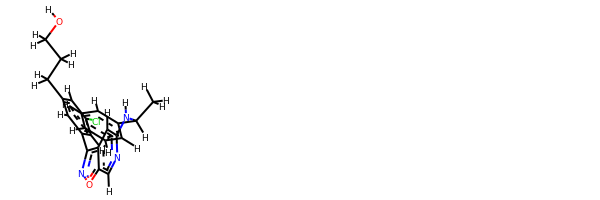

rdkit:  [H]OC([H])([H])C([H])([H])C([H])([H])c1c([H])c(Cl)c([H])c(-c2noc3c([H])nc(N([H])C([H])(c4c([H])c([H])c([H])c([H])c4[H])C([H])([H])[H])c([H])c23)c1[H]
oechem:  CC(c1ccccc1)Nc2cc3c(cn2)onc3c4cc(cc(c4)Cl)CCCO
###########################################################################
 #########################################################

bond
7.451687386833764 kJ/mol 57947.897652007974 kJ/mol False
angle
97.59428461780692 kJ/mol 97.59428461780692 kJ/mol True
nb
43.263500167259494 kJ/mol 43.263500167259494 kJ/mol True
torsion
22.21986246195375 kJ/mol 5.3905031360507225 kJ/mol False
170.52933463385392 kJ/mol 58094.14593992909 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4839


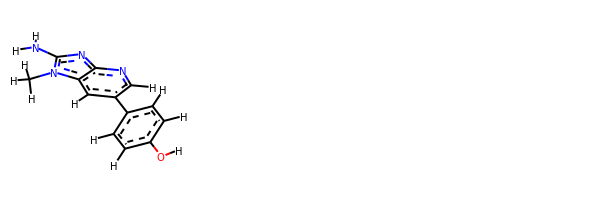

rdkit:  [H]Oc1c([H])c([H])c(-c2c([H])nc3nc(N([H])[H])n(C([H])([H])[H])c3c2[H])c([H])c1[H]
oechem:  Cn1c2cc(cnc2nc1N)c3ccc(cc3)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

########################################################

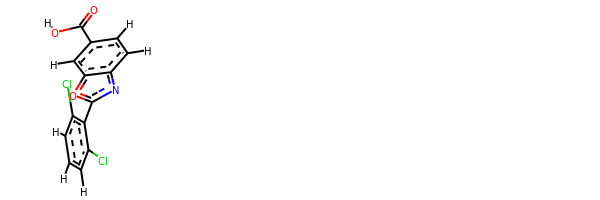

rdkit:  [H]OC(=O)c1c([H])c([H])c2nc(-c3c(Cl)c([H])c([H])c([H])c3Cl)oc2c1[H]
oechem:  c1cc(c(c(c1)Cl)c2nc3ccc(cc3o2)C(=O)O)Cl
###########################################################################
 #########################################################

bond
24.778261506850505 kJ/mol 116021.80892871515 kJ/mol False
angle
196.63860622341284 kJ/mol 196.63860622341284 kJ/mol True
nb
32.39293894660421 kJ/mol 32.39293894660421 kJ/mol True
torsion
32.12923321868174 kJ/mol 15.016853289629246 kJ/mol False
285.9390398955493 kJ/mol 116265.8573271748 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4849


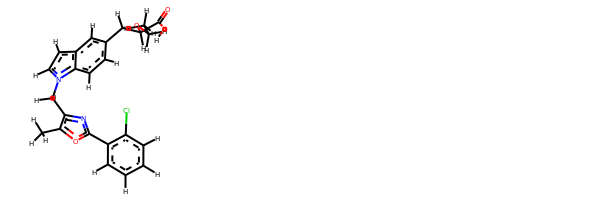

rdkit:  [H]OC(=O)C([H])(OC([H])([H])C([H])([H])[H])C([H])([H])c1c([H])c([H])c2c(c1[H])c([H])c([H])n2C([H])([H])c1nc(-c2c([H])c([H])c([H])c([H])c2Cl)oc1C([H])([H])[H]
oechem:  CCOC(Cc1ccc2c(c1)ccn2Cc3c(oc(n3)c4ccccc4Cl)C)C(=O)O
###########################################################################
 #########################################################

bond
29.61378946329108 kJ/mol 29104.184623347763 kJ/mol False
angle
118.33125106688594 kJ/mol 118.33125106688594 kJ/mol True
nb
24.288997075696948 kJ/mol 24.288997075696948 kJ/mol True
torsion
37.30131856603626 kJ/mol 32.071437325013584 kJ/mol False
209.53535617191022 kJ/mol 29278.87630881536 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4850


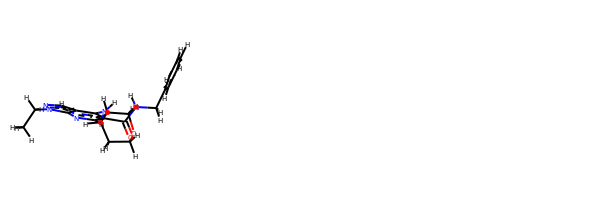

rdkit:  [H]c1nc2c(c([H])nn2C([H])([H])C([H])([H])[H])c(N([H])C2([H])C([H])([H])C([H])([H])OC([H])([H])C2([H])[H])c1C(=O)N([H])C([H])([H])c1c([H])c([H])c([H])c([H])c1[H]
oechem:  CCn1c2c(cn1)c(c(cn2)C(=O)NCc3ccccc3)NC4CCOCC4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
25.8104926561689 kJ/mol 58047.419098740065 kJ/mol False
angle
334.4224082704248 kJ/mol 334.

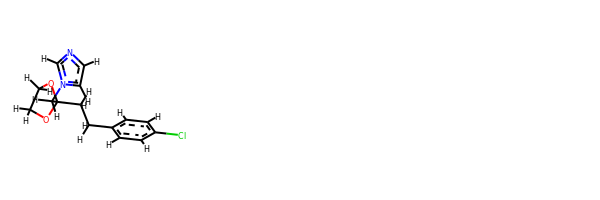

rdkit:  [H]c1nc([H])n(C([H])([H])C2(C([H])([H])C([H])([H])c3c([H])c([H])c(Cl)c([H])c3[H])OC([H])([H])C([H])([H])O2)c1[H]
oechem:  c1cc(ccc1CCC2(OCCO2)Cn3ccnc3)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
34.555881153093765 kJ/mol 58056.54401700405 kJ/mol False
angle
538.0153948341258 kJ/mol 538.0153948341258 kJ/mol True
nb
48.09247343008502 kJ/mol 48.09247343008502 kJ/mol True
torsion
64.98492095167065 kJ/mol 64.98493721686201 kJ/mol False
685.6486703689752 kJ/mol 58707.636822485125 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4857


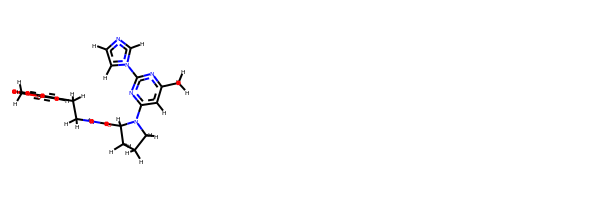

rdkit:  [H]c1nc([H])n(-c2nc(N3C([H])([H])C([H])([H])C([H])([H])C3([H])C(=O)N([H])C([H])([H])C([H])([H])c3c([H])c([H])c4c(c3[H])OC([H])([H])O4)c([H])c(C([H])([H])[H])n2)c1[H]
oechem:  Cc1cc(nc(n1)n2ccnc2)N3CCCC3C(=O)NCCc4ccc5c(c4)OCO5
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
71.27027494736797 kJ/mol 56323.64816590858 kJ/mol False
angle
351.99287688556285 kJ/mol 351.99287688556285 kJ/mol True
nb
127.35876387894231 kJ/mol 127.35876387894231 kJ/mol True
torsion
61.415547756832964 kJ/mol 62.393189106945066 kJ/mol False
612.037463468706 kJ/mol 56865.39299578002 kJ/mol

----------------------------------------------------------

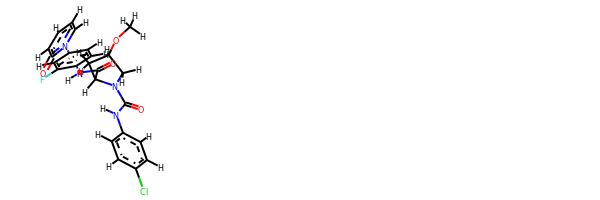

rdkit:  [H]c1c([H])c(N([H])C(=O)N2C([H])([H])C([H])(OC([H])([H])[H])C([H])([H])C2([H])C(=O)N([H])c2c([H])c([H])c(-n3c([H])c([H])c([H])c([H])c3=O)c([H])c2F)c([H])c([H])c1Cl
oechem:  COC1CC(N(C1)C(=O)Nc2ccc(cc2)Cl)C(=O)Nc3ccc(cc3F)n4ccccc4=O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ###

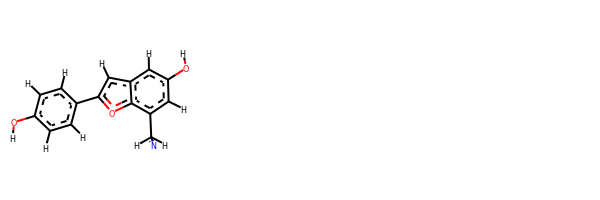

rdkit:  [H]Oc1c([H])c([H])c(-c2oc3c(C([H])([H])C#N)c([H])c(O[H])c([H])c3c2[H])c([H])c1[H]
oechem:  c1cc(ccc1c2cc3cc(cc(c3o2)CC#N)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###################################################

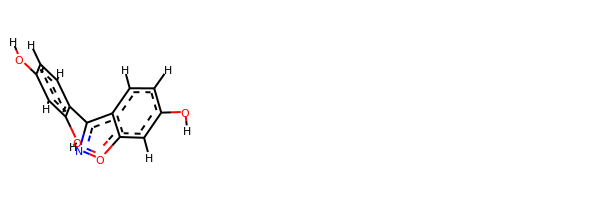

rdkit:  [H]Oc1c([H])c([H])c(-c2noc3c([H])c(O[H])c([H])c([H])c23)c(O[H])c1[H]
oechem:  c1cc2c(cc1O)onc2c3ccc(cc3O)O
###########################################################################
 #########################################################

bond
36.7604415500582 kJ/mol 57951.872513204115 kJ/mol False
angle
128.74715793484216 kJ/mol 130.65140019599988 kJ/mol False
nb
74.8597716460289 kJ/mol 74.8597716460289 kJ/mol True
torsion
17.771772068487234 kJ/mol 17.77175669131003 kJ/mol False
258.1391431994165 kJ/mol 58175.15544173746 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4879


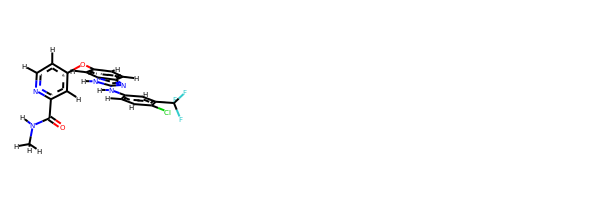

rdkit:  [H]c1nc(C(=O)N([H])C([H])([H])[H])c([H])c(Oc2c([H])c([H])c3nc(N([H])c4c([H])c([H])c(Cl)c(C(F)(F)F)c4[H])n([H])c3c2[H])c1[H]
oechem:  CNC(=O)c1cc(ccn1)Oc2ccc3c(c2)[nH]c(n3)Nc4ccc(c(c4)C(F)(F)F)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
35.767460526938834 kJ/mol 57896.357220991886 kJ/mol False
angle
111.41684038192436 kJ/mol 111.41684038192436 kJ/mol True
nb
53.498920720989126 kJ/mol 53.498920720989126 kJ/mol True
torsion
33.60509865280311 kJ/mol 18.394637321887416 kJ/mol False
234.28832028265543 kJ/mol 58079.66761941669 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4881


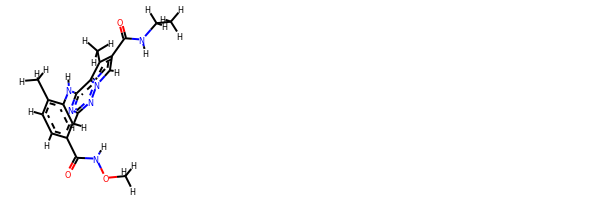

rdkit:  [H]c1nc(N([H])c2c([H])c(C(=O)N([H])OC([H])([H])[H])c([H])c([H])c2C([H])([H])[H])c2c(C([H])([H])[H])c(C(=O)N([H])C([H])([H])C([H])([H])[H])c([H])n2n1
oechem:  CCNC(=O)c1cn2c(c1C)c(ncn2)Nc3cc(ccc3C)C(=O)NOC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
21.87016284958676 kJ/mol 29092.219802552292 kJ/mol False
angle
109.58454413674885 kJ/mol 111.22496691610692 kJ/mol False
nb
24.34950519898356 kJ/mol 24.34950519898356 kJ/mol True
torsion
147.97626089073916 kJ/mol 127.26174074187247 kJ/mol False
303.7804730760583 kJ/mol 29355.056015409256 kJ/mol

-------------------------------------------------------------------
---------

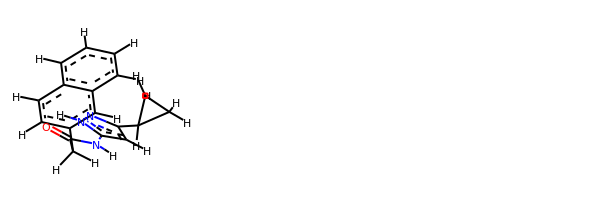

rdkit:  [H]c1c([H])c([H])c2c([H])c(C([H])([H])C(=O)N([H])c3c([H])c(C4([H])C([H])([H])C4([H])[H])nn3[H])c([H])c([H])c2c1[H]
oechem:  c1ccc2cc(ccc2c1)CC(=O)Nc3cc(n[nH]3)C4CC4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
16.42240199781406 kJ/mol 57992.406661239605 kJ/mol False
angle
120.10493117463055 kJ/mol 122.12883035867583 kJ/mol False
nb
64.68998380573 kJ/mol 64.68998380573 kJ/mol True
torsion
28.590386933563842 kJ/mol 28.59065331973681 kJ/mol False
229.80770391173843 kJ/mol 58207.816128723745 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------

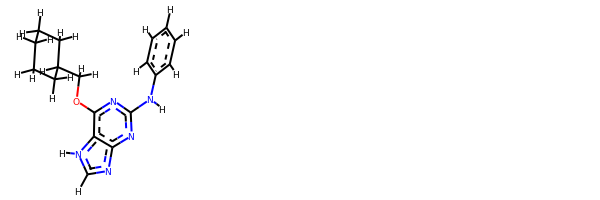

rdkit:  [H]c1c([H])c([H])c(N([H])c2nc(OC([H])([H])C3([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C3([H])[H])c3c(n2)nc([H])n3[H])c([H])c1[H]
oechem:  c1ccc(cc1)Nc2nc3c(c(n2)OCC4CCCCC4)[nH]cn3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
20.222167791425804 kJ/mol 58041.61764327386 kJ/mol False
angle
100.24596323850308 kJ/mol 100.24596323850308 kJ/mol True


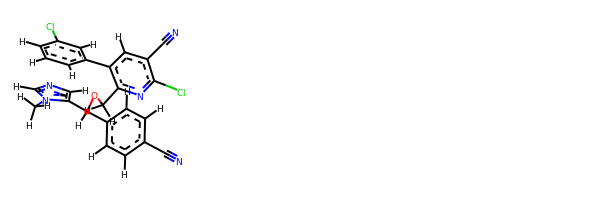

rdkit:  [H]c1nc([H])n(C([H])([H])[H])c1C([H])(OC([H])([H])c1nc(Cl)c(C#N)c([H])c1-c1c([H])c([H])c([H])c(Cl)c1[H])c1c([H])c([H])c(C#N)c([H])c1[H]
oechem:  Cn1cncc1C(c2ccc(cc2)C#N)OCc3c(cc(c(n3)Cl)C#N)c4cccc(c4)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
18.388142208579197 kJ/mol 173383.9327994267 kJ/mol False
angle
249.5332888428111 kJ/mol 253.3763854093837 kJ/mol False
nb
-3.358645802878449 kJ/mol -3.358645802878449 kJ/mol True
torsion
78.66007282372824 kJ/mol 73.63948197664841 kJ/mol False
343.22285807224006 kJ/mol 173707.59002100985 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_489

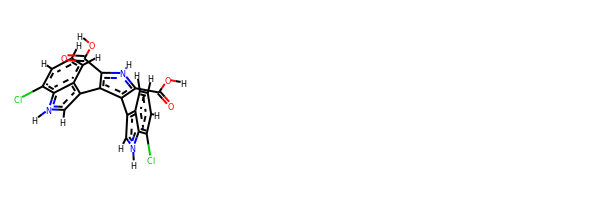

rdkit:  [H]OC(=O)c1c(-c2c([H])n([H])c3c(Cl)c([H])c([H])c([H])c23)c(-c2c([H])n([H])c3c(Cl)c([H])c([H])c([H])c23)c(C(=O)O[H])n1[H]
oechem:  c1cc2c(c[nH]c2c(c1)Cl)c3c(c([nH]c3C(=O)O)C(=O)O)c4c[nH]c5c4cccc5Cl
###########################################################################
 #########################################################

bond
27.573909185634815 kJ/mol 29096.64916239695 kJ/mol False
angle
112.04854703726006 kJ/mol 113.79799057604272 kJ/mol False
nb
60.17841919898198 kJ/mol 60.17841919898198 kJ/mol True
torsion
30.769942141956875 kJ/mol 23.019609761901158 kJ/mol False
230.5708175638337 kJ/mol 29293.645181933876 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4897


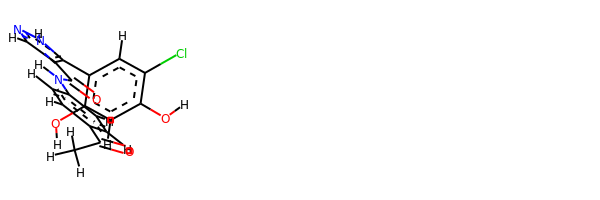

rdkit:  [H]Oc1c([H])c(O[H])c(-c2c(C(=O)N([H])c3c([H])c([H])c(C(=O)C([H])([H])[H])c([H])c3[H])c([H])nn2[H])c([H])c1Cl
oechem:  CC(=O)c1ccc(cc1)NC(=O)c2cn[nH]c2c3cc(c(cc3O)O)Cl
###########################################################################
 #########################################################

bond
12.671814687990725 kJ/mol 29080.366150133337 kJ/mol False
angle
108.1896273271401 kJ/mol 109.9428180660446 kJ/mol False
nb
25.424554921362038 kJ/mol 25.424554921362038 kJ/mol True
torsion
59.82189997835277 kJ/mol 54.591916931637755 kJ/mol False
206.10789691484564 kJ/mol 29270.32544005238 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4898


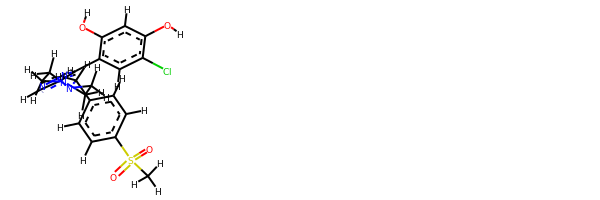

rdkit:  [H]Oc1c([H])c(O[H])c(-c2c(N3C([H])([H])C([H])([H])N(C([H])([H])c4c([H])c([H])c(S(=O)(=O)C([H])([H])[H])c([H])c4[H])C([H])([H])C3([H])[H])c([H])nn2[H])c([H])c1Cl
oechem:  CS(=O)(=O)c1ccc(cc1)CN2CCN(CC2)c3cn[nH]c3c4cc(c(cc4O)O)Cl
###########################################################################
 #########################################################

bond
24.89963367690937 kJ/mol 29094.268265925355 kJ/mol False
angle
96.83126557876348 kJ/mol 98.58853849661303 kJ/mol False
nb
9.503381144639786 kJ/mol 9.503381144639786 kJ/mol True
torsion
57.54919291273731 kJ/mol 52.319216050432644 kJ/mol False
188.78347331304994 kJ/mol 29254.679401617042 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4899


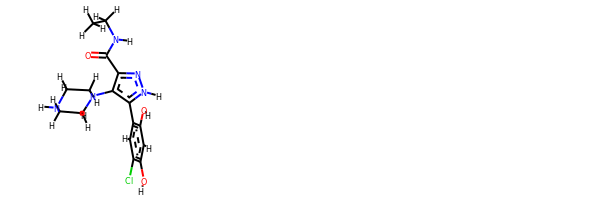

rdkit:  [H]Oc1c([H])c(O[H])c(-c2c(N3C([H])([H])C([H])([H])N([H])C([H])([H])C3([H])[H])c(C(=O)N([H])C([H])([H])C([H])([H])[H])nn2[H])c([H])c1Cl
oechem:  CCNC(=O)c1c(c([nH]n1)c2cc(c(cc2O)O)Cl)N3CCNCC3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
35.42668207505849 kJ/mol 57752.432403057166 kJ/mol False
angle
104.32484339477371 kJ/mol 104.32484339477371 kJ/mol True
nb
35.90853498744465 kJ/mol 35.90853498744465 kJ/mol True
torsion
49.29861780757592 kJ/mol 49.29861822582512 kJ/mol False
224.95867826485275 kJ/mol 57941.96439966521 kJ/mol

-------------------------------------------------------------------
--------------------------

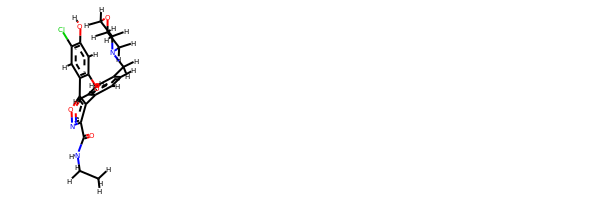

rdkit:  [H]Oc1c([H])c(O[H])c(-c2onc(C(=O)N([H])C([H])([H])C([H])([H])[H])c2-c2c([H])c([H])c(C([H])([H])N3C([H])([H])C([H])([H])OC([H])([H])C3([H])[H])c([H])c2[H])c([H])c1Cl
oechem:  CCNC(=O)c1c(c(on1)c2cc(c(cc2O)O)Cl)c3ccc(cc3)CN4CCOCC4
###########################################################################
 #########################################################

bond
38.105079732727155 kJ/mol 58402.833891297414 kJ/mol False
angle
304.32649561988427 kJ/mol 304.32649561988427 kJ/mol True
nb
28.24434104786674 kJ/mol 28.24434104786674 kJ/mol True
torsion
56.94724728896545 kJ/mol 44.7273163618952 kJ/mol False
427.62316368944363 kJ/mol 58780.13204432706 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4903


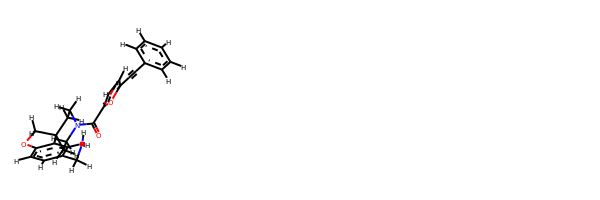

rdkit:  [H]c1c(C#Cc2c([H])c([H])c([H])c([H])c2[H])oc(C(=O)N2C([H])([H])C([H])([H])C3(c4c([H])c(C([H])([H])N([H])[H])c([H])c([H])c4OC3([H])[H])C([H])([H])C2([H])[H])c1[H]
oechem:  c1ccc(cc1)C#Cc2ccc(o2)C(=O)N3CCC4(CC3)COc5c4cc(cc5)CN
###########################################################################
 #########################################################

bond
23.620424356387893 kJ/mol 28990.60948495556 kJ/mol False
angle
113.29394059647177 kJ/mol 113.29394059647177 kJ/mol True
nb
82.84179124616044 kJ/mol 82.84179124616044 kJ/mol True
torsion
39.5875698300056 kJ/mol 34.35768828055528 kJ/mol False
259.34372602902573 kJ/mol 29221.102905078744 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4904


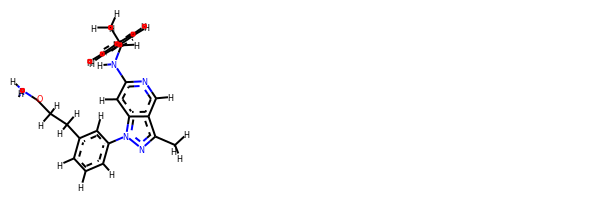

rdkit:  [H]c1c([H])c([H])c(C([H])(N([H])c2nc([H])c3c(C([H])([H])[H])nn(-c4c([H])c([H])c([H])c(C([H])([H])C([H])([H])C(=O)N([H])[H])c4[H])c3c2[H])C([H])([H])[H])c([H])c1[H]
oechem:  Cc1c2cnc(cc2n(n1)c3cccc(c3)CCC(=O)N)NC(C)c4ccccc4
###########################################################################
 #########################################################

bond
32.72265425162946 kJ/mol 57745.24257627351 kJ/mol False
angle
101.76358836750256 kJ/mol 101.76358836750256 kJ/mol True
nb
46.629386878742054 kJ/mol 46.629386878742054 kJ/mol True
torsion
35.613365874049414 kJ/mol 35.61336674696422 kJ/mol False
216.72899537192347 kJ/mol 57929.24891826671 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4905


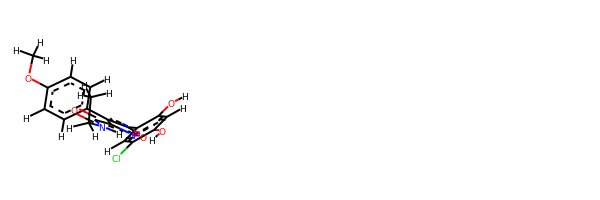

rdkit:  [H]Oc1c([H])c(O[H])c(-c2onc(C(=O)N([H])C([H])([H])C([H])([H])[H])c2-c2c([H])c([H])c(OC([H])([H])[H])c([H])c2[H])c([H])c1Cl
oechem:  CCNC(=O)c1c(c(on1)c2cc(c(cc2O)O)Cl)c3ccc(cc3)OC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
18.287838171602544 kJ/mol 57683.9862528273 kJ/mol False
angle
134.28388766820953 kJ/mol 134.28388766820953 kJ/mol True
nb
41.00689936006481 kJ/mol 41.00689936006481 kJ/mol True
torsion
24.65851844214184 kJ/mol 24.658871368773845 kJ/mol False
218.2371436420187 kJ/mol 57883.93591122435 kJ/mol

-------------------------------------------------------------------
--------------------------------------

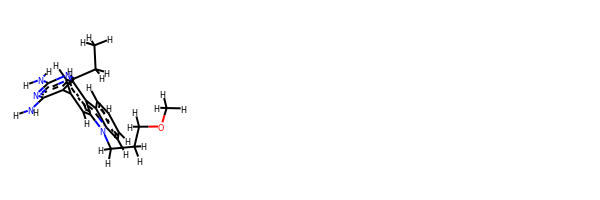

rdkit:  [H]c1c([H])c([H])c2c(c1[H])c1c([H])c([H])c(-c3c(N([H])[H])nc(N([H])[H])nc3C([H])([H])C([H])([H])[H])c([H])c1n2C([H])([H])C([H])([H])C([H])([H])OC([H])([H])[H]
oechem:  CCc1c(c(nc(n1)N)N)c2ccc3c4ccccc4n(c3c2)CCCOC
###########################################################################
 #########################################################

bond
7.440495289823673 kJ/mol 116048.69282724944 kJ/mol False
angle
174.66673824741994 kJ/mol 174.66673824741994 kJ/mol True
nb
-3.5189793180253184 kJ/mol -3.5189793180253184 kJ/mol True
torsion
10.708717675672887 kJ/mol 5.251499102271614 kJ/mol False
189.2969718948912 kJ/mol 116225.09208528111 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4909


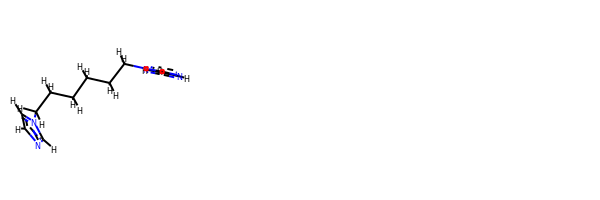

rdkit:  [H]c1nc([H])n(C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])n2c([H])nc([H])c2[H])c1[H]
oechem:  c1cn(cn1)CCCCCCn2ccnc2
###########################################################################
 #########################################################

bond
34.618970204154415 kJ/mol 44016.850006456094 kJ/mol False
angle
351.66007078579304 kJ/mol 353.80687750660053 kJ/mol False
nb
28.76170527599993 kJ/mol 28.76170527599993 kJ/mol True
torsion
96.21022349362418 kJ/mol 96.2024883762959 kJ/mol False
511.2509697595716 kJ/mol 44495.62107761499 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4910


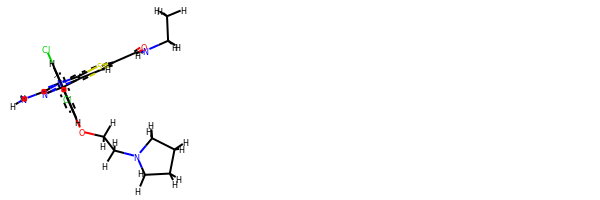

rdkit:  [H]c1c(Cl)c(OC([H])([H])C([H])([H])N2C([H])([H])C([H])([H])C([H])([H])C2([H])[H])c([H])c(-c2nc(N([H])[H])nc3sc(C(=O)N([H])C([H])([H])C([H])([H])[H])c([H])c23)c1Cl
oechem:  CCNC(=O)c1cc2c(nc(nc2s1)N)c3cc(c(cc3Cl)Cl)OCCN4CCCC4
###########################################################################
 #########################################################

bond
44.87929081242894 kJ/mol 44249.453625244765 kJ/mol False
angle
335.8226031304729 kJ/mol 338.62741866983174 kJ/mol False
nb
27.818946522246115 kJ/mol 27.818946522246115 kJ/mol True
torsion
119.74028447801518 kJ/mol 117.04123175019583 kJ/mol False
528.2611249431632 kJ/mol 44732.94122218704 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4911


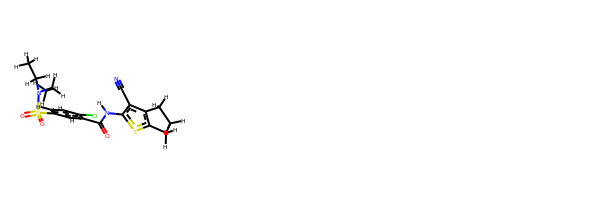

rdkit:  [H]c1c([H])c(S(=O)(=O)N(C([H])([H])C([H])([H])[H])C([H])([H])C([H])([H])[H])c([H])c(C(=O)N([H])c2sc3c(c2C#N)C([H])([H])C([H])([H])C3([H])[H])c1Cl
oechem:  CCN(CC)S(=O)(=O)c1ccc(c(c1)C(=O)Nc2c(c3c(s2)CCC3)C#N)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
29.00723078630239 kJ/mol 28666.972874478914 kJ/mol False
angle
59.1434062697859 kJ/mol 59.1434062697859 kJ/mol True
nb
75.22729253283458 kJ/mol 75.22729253283458 kJ/mol True
torsion
124.80326086574993 kJ/mol 126.48079964064137 kJ/mo

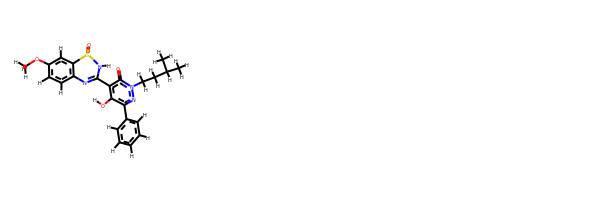

rdkit:  [H]Oc1c(-c2c([H])c([H])c([H])c([H])c2[H])nn(C([H])([H])C([H])([H])C([H])(C([H])([H])[H])C([H])([H])[H])c(=O)c1C1=Nc2c([H])c([H])c(OC([H])([H])[H])c([H])c2S(=O)(=O)N1[H]
oechem:  CC(C)CCn1c(=O)c(c(c(n1)c2ccccc2)O)C3=Nc4ccc(cc4S(=O)(=O)N3)OC
###########################################################################
 #########################################################

bond
45.34810159324676 kJ/mol 29115.046159812155 kJ/mol False
angle
751.3258028366355 kJ/mol 753.0326946132125 kJ/mol False
nb
26.841816517755273 kJ/mol 26.841816517755273 kJ/mol True
torsion
105.1464787218957 kJ/mol 76.23978649586886 kJ/mol False
928.6621996695333 kJ/mol 29971.16045743899 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4916


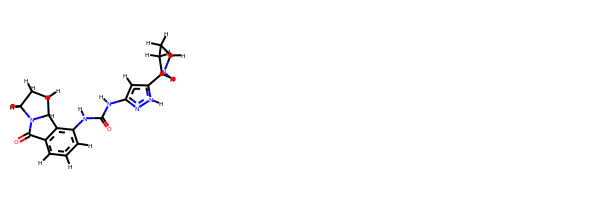

rdkit:  [H]c1c([H])c2c(c(N([H])C(=O)N([H])c3nn([H])c(C4([H])N([H])C([H])([H])C([H])([H])C4([H])[H])c3[H])c1[H])C1([H])N(C2=O)C([H])([H])C([H])([H])C1([H])[H]
oechem:  c1cc2c(c(c1)NC(=O)Nc3cc([nH]n3)C4CCCN4)C5CCCN5C2=O
###########################################################################
 #########################################################

bond
22.63446330538855 kJ/mol 28982.76935404461 kJ/mol False
angle
270.2571285370653 kJ/mol 271.82404823193275 kJ/mol False
nb
47.31846327001379 kJ/mol 47.31846327001379 kJ/mol True
torsion
72.74395892298355 kJ/mol 67.51426273934537 kJ/mol False
412.9540140354512 kJ/mol 29369.426128285904 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4917


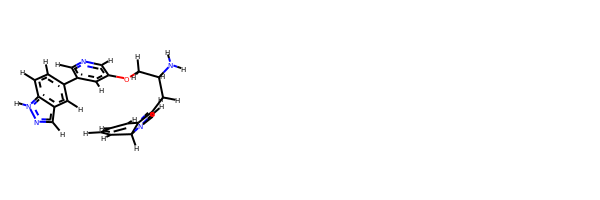

rdkit:  [H]C1=NC2([H])C([H])=C([H])C([H])=C([H])C2=C1C([H])([H])C([H])(N([H])[H])C([H])([H])Oc1c([H])nc([H])c(-c2c([H])c([H])c3c(c([H])nn3[H])c2[H])c1[H]
oechem:  c1cc2c(cc1c3cc(cnc3)OCC(CC4=C5C=CC=CC5N=C4)N)cn[nH]2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
9.53342866939012 kJ/mol 29149.257130829203 kJ/mol False
angle
109.12390037765954 kJ/mol 111.28578802335522 kJ/mol False
nb
6.046356752172134 kJ/mol 6.046356752172134 kJ/mol True
torsion
27.681690898203342 kJ/mol 19.941304035207537 kJ/mol False
152.38537669742513 kJ/mol 29286.53057963994 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBan

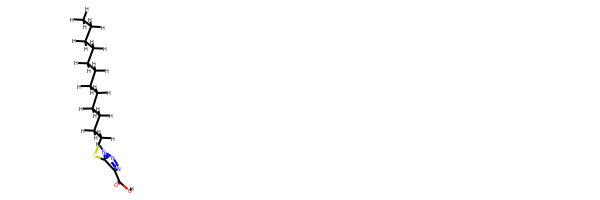

rdkit:  [H]OC(=O)c1nnn([H])c1SC([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])[H]
oechem:  CCCCCCCCCCCCSc1c(nn[nH]1)C(=O)O
###########################################################################
 #########################################################

bond
6.029448571977021 kJ/mol 57760.20470639866 kJ/mol False
angle
92.02091729653036 kJ/mol 93.2493046180987 kJ/mol False
nb
10.46523196537885 kJ/mol 10.46523196537885 kJ/mol True
torsion
5.337971392690061 kJ/mol 3.6810756615273657 kJ/mol False
113.8535692265763 kJ/mol 57867.600318643665 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4920


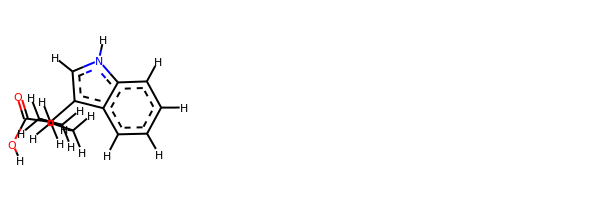

rdkit:  [H]OC(=O)C([H])(c1c([H])n([H])c2c([H])c([H])c([H])c([H])c12)C([H])([H])C([H])([H])C([H])([H])C([H])([H])[H]
oechem:  CCCCC(c1c[nH]c2c1cccc2)C(=O)O
###########################################################################
 #########################################################

bond
5.6961324845285475 kJ/mol 57757.31099698171 kJ/mol False
angle
91.0641464884004 kJ/mol 92.29332519889257 kJ/mol False
nb
10.548939620041793 kJ/mol 10.548939620041793 kJ/mol True
torsion
3.691805932121267 kJ/mol 1.996893312253639 kJ/mol False
111.001024525092 kJ/mol 57862.1501551129 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4921


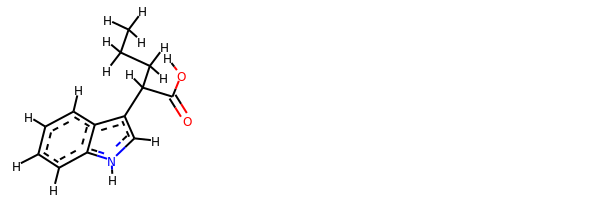

rdkit:  [H]OC(=O)C([H])(c1c([H])n([H])c2c([H])c([H])c([H])c([H])c12)C([H])([H])C([H])([H])C([H])([H])[H]
oechem:  CCCC(c1c[nH]c2c1cccc2)C(=O)O
###########################################################################
 #########################################################

bond
17.685127583727027 kJ/mol 57769.22950034798 kJ/mol False
angle
115.44729966438841 kJ/mol 116.67633769109271 kJ/mol False
nb
94.98387990615532 kJ/mol 94.98387990615532 kJ/mol True
torsion
31.73742646998203 kJ/mol 30.050971158527936 kJ/mol False
259.8537336242528 kJ/mol 58010.94068910375 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4922


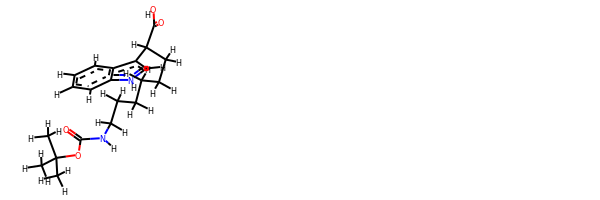

rdkit:  [H]OC(=O)C([H])(c1c([H])n([H])c2c([H])c([H])c([H])c([H])c12)C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])N([H])C(=O)OC(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H]
oechem:  CC(C)(C)OC(=O)NCCCCCCC(c1c[nH]c2c1cccc2)C(=O)O
###########################################################################
 #########################################################

bond
27.573298214636434 kJ/mol 56626.77045359527 kJ/mol False
angle
104.72626521123304 kJ/mol 104.72626521123304 kJ/mol True
nb
57.8400297726656 kJ/mol 57.8400297726656 kJ/mol True
torsion
7.326116207926623 kJ/mol 5.189405066391162 kJ/mol False
197.4657094064617 kJ/mol 56794.52615364556 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4923


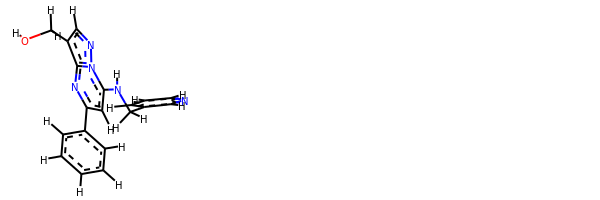

rdkit:  [H]OC([H])([H])c1c([H])nn2c(N([H])C([H])([H])c3c([H])nc([H])c([H])c3[H])c([H])c(-c3c([H])c([H])c([H])c([H])c3[H])nc12
oechem:  c1ccc(cc1)c2cc(n3c(n2)c(cn3)CO)NCc4cccnc4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
39.773960728817244 kJ/mol 101918.27385581606 kJ/mol False
angle
385.3766080858002 kJ/mol 390.5484726535014 kJ/mol False
nb
6.626969631160823 kJ/mol 6.626969631160823 kJ/mol True
torsion
23.244713511483013 kJ/mol 23.236928133307003 kJ/mol False
455.02225195726135 kJ/mol 102338.68622623404 kJ/mol

-------------------------------------------------------------------
---------------------------------------------

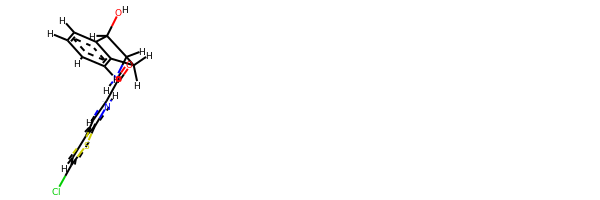

rdkit:  [H]OC1([H])c2c([H])c([H])c([H])c([H])c2C([H])([H])C1([H])N([H])C(=O)c1c([H])c2c([H])c(Cl)sc2n1[H]
oechem:  c1ccc2c(c1)CC(C2O)NC(=O)c3cc4cc(sc4[nH]3)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
34.11259357115927 kJ/mol 114415.66259263341 kJ/mol False
angle
55.47937811116284 kJ/mol 56.076906559022035 kJ/mol False
nb
56.56817350888452 kJ/mol 56.56817350888452 kJ/mol True
torsion
71.65385433647215 kJ/mol 21.44610817404266 kJ/mol False
217.8139995276788 kJ/mol 114549.75378087537 kJ/mol

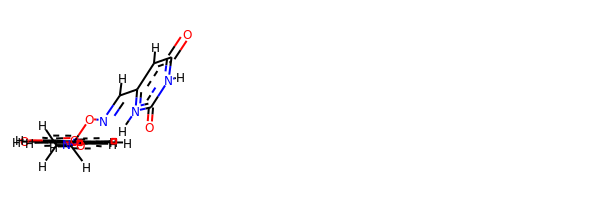

rdkit:  [H]OC(=O)c1c([H])c([H])c(C([H])=NOC([H])([H])C([H])([H])ON=C([H])c2c([H])c(=O)n([H])c(=O)n2[H])c([H])c1[H]
oechem:  c1cc(ccc1C=NOCCON=Cc2cc(=O)[nH]c(=O)[nH]2)C(=O)O
###########################################################################
 #########################################################

bond
34.99492783683855 kJ/mol 43707.58282067471 kJ/mol False
angle
59.218082971086694 kJ/mol 62.57426555487194 kJ/mol False
nb
74.08925282253398 kJ/mol 74.08925282253398 kJ/mol True
torsion
11.026902124086426 kJ/mol 3.6785517953554425 kJ/mol False
179.32916575454564 kJ/mol 43847.92489084747 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4931


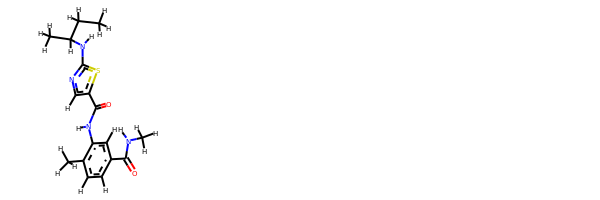

rdkit:  [H]c1nc(N([H])C([H])(C([H])([H])[H])C([H])([H])C([H])([H])[H])sc1C(=O)N([H])c1c([H])c(C(=O)N([H])C([H])([H])[H])c([H])c([H])c1C([H])([H])[H]
oechem:  CCC(C)Nc1ncc(s1)C(=O)Nc2cc(ccc2C)C(=O)NC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
16.64170450466196 kJ/mol 57471.96457791063 kJ/mol False
angle
429.75914313917696 kJ/mol 429.75914313917696 kJ/mol True
nb
0.32336849332348727 kJ/mol 0.32336849332348727 kJ/mol True
torsion
205.38229302218244 kJ/mol 214.7958196312594 kJ/mol False
652.1065091593449 kJ/mol 58116.84290917439 kJ/mol

-------------------------------------------------------------------
-----------------------

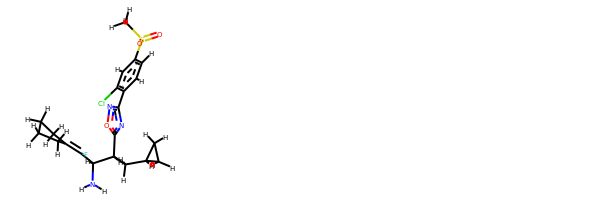

rdkit:  [H]c1c([H])c(S(=O)(=O)C([H])([H])[H])c([H])c(Cl)c1-c1noc(C([H])(C([H])(C(F)=C2C([H])([H])C([H])([H])C([H])([H])C2([H])[H])N([H])[H])C([H])([H])C2([H])C([H])([H])C2([H])[H])n1
oechem:  CS(=O)(=O)c1ccc(c(c1)Cl)c2nc(on2)C(CC3CC3)C(C(=C4CCCC4)F)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
49.398625478354205 kJ/mol 57910.37061484735 kJ/mol False
angle
132.55427697361947 kJ/mol 133.93544237222247 kJ/mol False
nb
69.58862471832256 kJ/mol 69.58862471832256 kJ/mol True
torsion
26.364855680458827 kJ/mol 26.364920734667344 kJ/mol False
277.90638285075505 kJ/mol 58140.259602672566 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
--------------------------------------

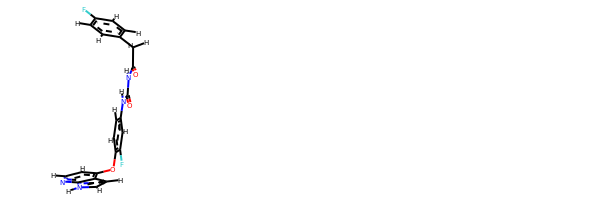

rdkit:  [H]c1nc2c(c([H])c([H])n2[H])c(Oc2c([H])c([H])c(N([H])C(=O)N([H])C(=O)C([H])([H])c3c([H])c([H])c(F)c([H])c3[H])c([H])c2F)c1[H]
oechem:  c1cc(ccc1CC(=O)NC(=O)Nc2ccc(c(c2)F)Oc3ccnc4c3cc[nH]4)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
19.517086244128148 kJ/mol 57878.83532732638 kJ/mol False
angle
124.564074023048 kJ/mol 125.94385276294426 kJ/mol False
nb
11.36918674040111 kJ/mol 11.36918674040111 kJ/mol True
torsion
45.71688753991128 kJ/mol 40.43872388075553 kJ/mol False
201.16723454748853 kJ/mol 58056.587090710476 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4939


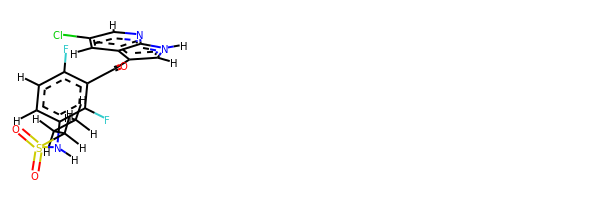

rdkit:  [H]c1nc2c(c([H])c1Cl)c(C(=O)c1c(F)c([H])c([H])c(N([H])S(=O)(=O)C([H])([H])C([H])([H])C([H])([H])[H])c1F)c([H])n2[H]
oechem:  CCCS(=O)(=O)Nc1ccc(c(c1F)C(=O)c2c[nH]c3c2cc(cn3)Cl)F
###########################################################################
 #########################################################

bond
21.51248216440095 kJ/mol 57881.9687431611 kJ/mol False
angle
132.78917832162483 kJ/mol 134.16963791761552 kJ/mol False
nb
34.18185677616028 kJ/mol 34.18185677616028 kJ/mol True
torsion
50.89399421700247 kJ/mol 45.61587281514126 kJ/mol False
239.37751147918854 kJ/mol 58095.936110670016 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4940


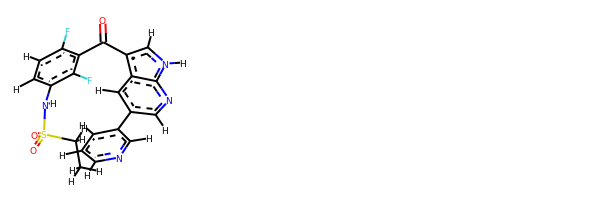

rdkit:  [H]c1nc([H])c(-c2c([H])nc3c(c2[H])c(C(=O)c2c(F)c([H])c([H])c(N([H])S(=O)(=O)C([H])([H])C([H])([H])[H])c2F)c([H])n3[H])c([H])c1[H]
oechem:  CCS(=O)(=O)Nc1ccc(c(c1F)C(=O)c2c[nH]c3c2cc(cn3)c4cccnc4)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
15.597675448117819 kJ/mol 43635.849334264305 kJ/mol False
angle
57.66805082761679 kJ/mol 59.28118658779056 kJ/mol False
nb
12.183458429969386 kJ/mol 12.183458429969386 kJ/mol True
torsion
46.89922659251598 kJ/mol 46.94910861389887 kJ/mol False
132.34841129822 kJ/mol 43754.26308789597 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4943


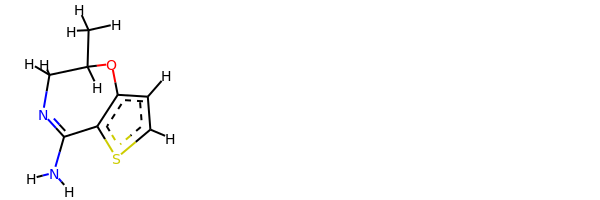

rdkit:  [H]c1sc2c(c1[H])OC([H])(C([H])([H])[H])C([H])([H])N=C2N([H])[H]
oechem:  CC1CN=C(c2c(ccs2)O1)N
###########################################################################
 #########################################################

bond
26.450948642081432 kJ/mol 58394.10662879378 kJ/mol False
angle
100.91358964231864 kJ/mol 100.91358964231864 kJ/mol True
nb
7.339510095808569 kJ/mol 7.339510095808569 kJ/mol True
torsion
21.0781573844971 kJ/mol 18.566117723907055 kJ/mol False
155.78220576470574 kJ/mol 58520.925846255814 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4944


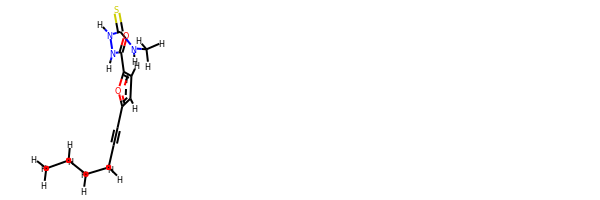

rdkit:  [H]c1c(C#CC([H])([H])C([H])([H])C([H])([H])C([H])([H])[H])oc(C(=O)N([H])N([H])C(=S)N([H])C([H])([H])[H])c1[H]
oechem:  CCCCC#Cc1ccc(o1)C(=O)NNC(=S)NC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
19.961756819606197 kJ/mol 57759.24155173628 kJ/mol False
angle
215.50312503998305 kJ/mol 215.50312503998305 kJ/mol True
nb
52.45723147493951 kJ/mol 52.45723147493951 kJ/mol True
torsion
24.234103604947837 kJ/mol 24.23421573001806 kJ/mol False
312.1562169394766 kJ/mol 58051.43612398122 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4946


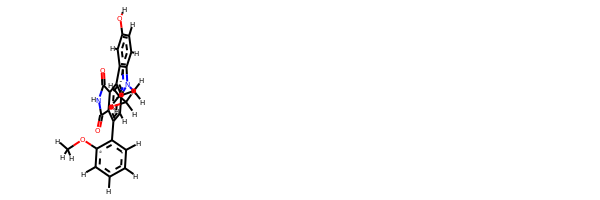

rdkit:  [H]Oc1c([H])c([H])c2c(c1[H])c1c3c(c(-c4c([H])c([H])c([H])c([H])c4OC([H])([H])[H])c([H])c1n2C([H])([H])C([H])([H])C([H])([H])O[H])C(=O)N([H])C3=O
oechem:  COc1ccccc1c2cc3c(c4cc(ccc4n3CCCO)O)c5c2C(=O)NC5=O
###########################################################################
 #########################################################

bond
23.68558432925284 kJ/mol 43648.69126128554 kJ/mol False
angle
62.57508294708974 kJ/mol 64.19102478456088 kJ/mol False
nb
44.24493117057237 kJ/mol 44.24493117057237 kJ/mol True
torsion
60.29402516978692 kJ/mol 60.34033230842128 kJ/mol False
190.79962361670187 kJ/mol 43817.46754954909 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4947


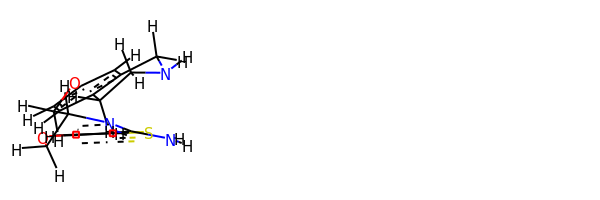

rdkit:  [H]c1sc2c(c1[H])OC([H])([H])C([H])(C([H])([H])Oc1c([H])c([H])c3c(c1[H])C([H])([H])N([H])C([H])([H])C3([H])[H])N=C2N([H])[H]
oechem:  c1cc2c(cc1OCC3COc4ccsc4C(=N3)N)CNCC2
###########################################################################
 #########################################################

bond
49.18469766248485 kJ/mol 58066.70791603457 kJ/mol False
angle
233.51687563135062 kJ/mol 233.51687563135062 kJ/mol True
nb
64.36204118075104 kJ/mol 64.36204118075104 kJ/mol True
torsion
54.38510706363915 kJ/mol 54.385126279798804 kJ/mol False
401.44872153822564 kJ/mol 58418.971959126466 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4948


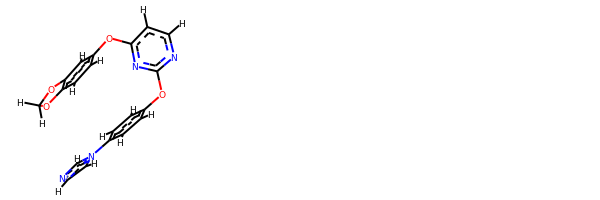

rdkit:  [H]c1nc(Oc2c([H])c([H])c(-n3c([H])nc([H])c3[H])c([H])c2[H])nc(Oc2c([H])c([H])c3c(c2[H])OC([H])([H])O3)c1[H]
oechem:  c1cc(ccc1n2ccnc2)Oc3nccc(n3)Oc4ccc5c(c4)OCO5
###########################################################################
 #########################################################

bond
8.921724484298299 kJ/mol 58152.68086543401 kJ/mol False
angle
94.7280784332601 kJ/mol 94.7280784332601 kJ/mol True
nb
42.29677586006995 kJ/mol 42.29677586006995 kJ/mol True
torsion
6.269217000719096 kJ/mol 15.671709295041946 kJ/mol False
152.21579577834743 kJ/mol 58305.37742902239 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4949


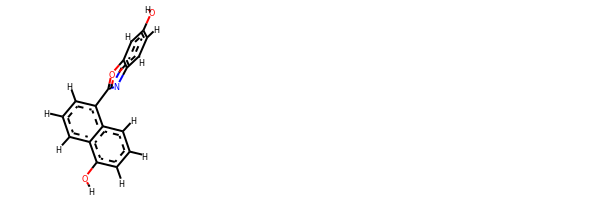

rdkit:  [H]Oc1c([H])c([H])c2nc(-c3c([H])c([H])c([H])c4c(O[H])c([H])c([H])c([H])c34)oc2c1[H]
oechem:  c1cc2c(cccc2O)c(c1)c3nc4ccc(cc4o3)O
###########################################################################
 #########################################################

bond
30.15482286104817 kJ/mol 86957.03872686609 kJ/mol False
angle
169.6905175946828 kJ/mol 172.69655024376755 kJ/mol False
nb
13.75874704323829 kJ/mol 13.75874704323829 kJ/mol True
torsion
33.67615186284134 kJ/mol 31.57585951901985 kJ/mol False
247.2802393618106 kJ/mol 87175.0698836721 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4950


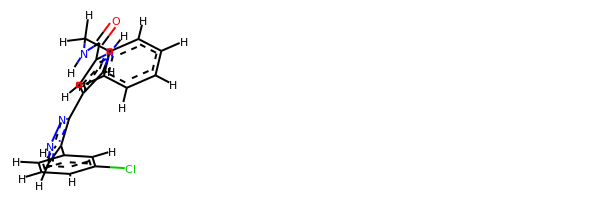

rdkit:  [H]c1c([H])c([H])c(C([H])([H])N([H])C(=O)c2c([H])c(-c3nn([H])c([H])c3-c3c([H])c([H])c([H])c(Cl)c3[H])c([H])n2[H])c([H])c1[H]
oechem:  c1ccc(cc1)CNC(=O)c2cc(c[nH]2)c3c(c[nH]n3)c4cccc(c4)Cl
###########################################################################
 #########################################################

bond
35.096888183255125 kJ/mol 58054.65180686604 kJ/mol False
angle
218.98975420221586 kJ/mol 218.98975420221586 kJ/mol True
nb
52.00508662032602 kJ/mol 52.00508662032602 kJ/mol True
torsion
72.18987229766968 kJ/mol 72.18987347725249 kJ/mol False
378.2816013034667 kJ/mol 58397.83652116583 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4951


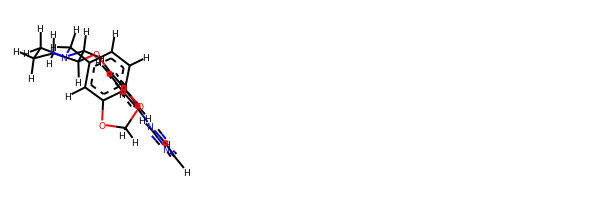

rdkit:  [H]c1nc([H])n(-c2c([H])c([H])c(OC3([H])C([H])([H])N(C([H])([H])c4c([H])c([H])c5c(c4[H])OC([H])([H])O5)C([H])([H])C([H])([H])C3([H])[H])c([H])c2[H])c1[H]
oechem:  c1cc(ccc1n2ccnc2)OC3CCCN(C3)Cc4ccc5c(c4)OCO5
###########################################################################
 #########################################################

bond
9.941537740444929 kJ/mol 115089.78710666082 kJ/mol False
angle
88.91488478129803 kJ/mol 91.07922711197075 kJ/mol False
nb
24.959033277752223 kJ/mol 24.959033277752223 kJ/mol True
torsion
33.47216853972749 kJ/mol 0.0003222163730713434 kJ/mol False
157.28762433922265 kJ/mol 115205.82568926693 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4952


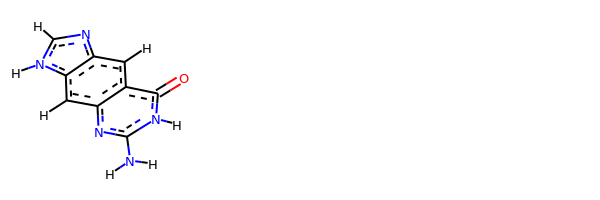

rdkit:  [H]c1c2nc([H])n([H])c2c([H])c2nc(N([H])[H])n([H])c(=O)c12
oechem:  c1c2c(cc3c1nc[nH]3)nc([nH]c2=O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
39.14715876685749 kJ/mol 58308.513028596666 kJ/mol False
angle
217.55985440206123 kJ/mol 217.55985440206123 kJ/mol True
nb
53.83193250720801 kJ/mol 53.83193250720801 kJ/mol True
torsion
19.25527939696814 kJ/mol 19.255242626174244 kJ/mol False
329.7942250730949 kJ/mol 58599.16005813211 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4954


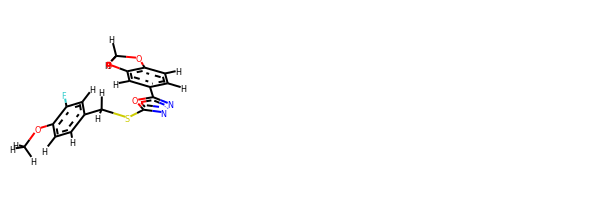

rdkit:  [H]c1c([H])c(C([H])([H])Sc2nnc(-c3c([H])c([H])c4c(c3[H])OC([H])([H])O4)o2)c([H])c(F)c1OC([H])([H])[H]
oechem:  COc1ccc(cc1F)CSc2nnc(o2)c3ccc4c(c3)OCO4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
19.966751121895214 kJ/mol 57672.660080595255 kJ/mol False
angle
28.13159093822086 kJ/mol 28.43905735092908 kJ/mol False
nb
83.67424264310479 kJ/mol 83.67424264310479 kJ/mol True
torsion
44.853720526419586 kJ/mol 23.043516573069837 kJ/mol False
176.62630522964045 kJ/mol 57807.81689716236 kJ/mol

-------------------------------------------------------------------
----------------------------------------------------------------

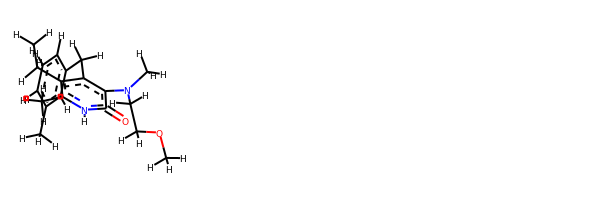

rdkit:  [H]c1c([H])c(C([H])([H])[H])c([H])c(C([H])([H])c2c(C([H])([H])C([H])([H])[H])c(C([H])([H])[H])n([H])c(=O)c2N(C([H])([H])[H])C([H])([H])C([H])([H])OC([H])([H])[H])c1[H]
oechem:  CCc1c([nH]c(=O)c(c1Cc2cccc(c2)C)N(C)CCOC)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
60.38761749929672 kJ/mol 117079.32939832524 kJ/mol False
angle
286.1987766328821 kJ/mol 294.53061810176433 kJ/mol False
nb
60.10731766966396 kJ/mol 60.10731766966396 kJ/mol True
torsion
19.286903391057038 kJ/mol 15.727013265446947 kJ/mol False
425.9806151928998 kJ/mol 117449.69434736212 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
---------------------------------------------------------------

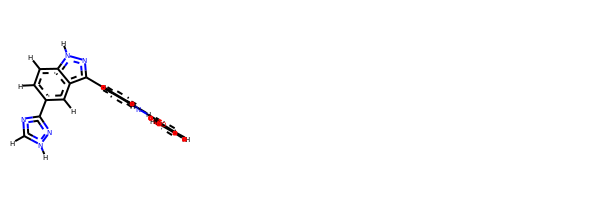

rdkit:  [H]c1oc(C(=O)N([H])c2c([H])c([H])c([H])c(-c3nn([H])c4c([H])c([H])c(-c5nc([H])n([H])n5)c([H])c34)c2[H])c([H])c1[H]
oechem:  c1cc(cc(c1)NC(=O)c2ccco2)c3c4cc(ccc4[nH]n3)c5nc[nH]n5
###########################################################################
 #########################################################

bond
10.711219999255515 kJ/mol 57847.29971366346 kJ/mol False
angle
129.44912709596517 kJ/mol 129.44912709596517 kJ/mol True
nb
41.74903838305749 kJ/mol 41.74903838305749 kJ/mol True
torsion
16.71251471894001 kJ/mol 9.910650268564876 kJ/mol False
198.6219001972182 kJ/mol 58028.40852941105 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4961


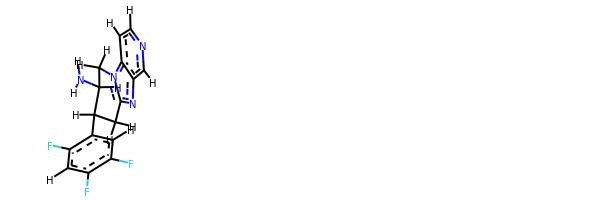

rdkit:  [H]c1nc([H])c2nc3n(c2c1[H])C([H])([H])C([H])(N([H])[H])C([H])(c1c([H])c(F)c(F)c([H])c1F)C3([H])[H]
oechem:  c1cncc2c1n3c(n2)CC(C(C3)N)c4cc(c(cc4F)F)F
###########################################################################
 #########################################################

bond
28.509424213941713 kJ/mol 57557.428227072196 kJ/mol False
angle
283.8151615584931 kJ/mol 283.8151615584931 kJ/mol True
nb
27.29160510777316 kJ/mol 27.29160510777316 kJ/mol True
torsion
100.04562652908301 kJ/mol 100.04491391093201 kJ/mol False
439.66181740929096 kJ/mol 57968.57990764939 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4964


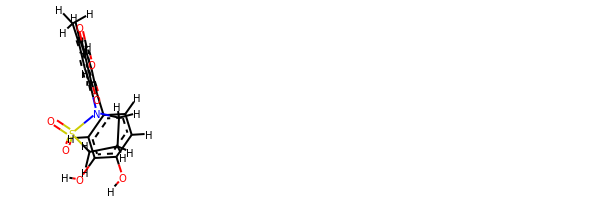

rdkit:  [H]Oc1c([H])c([H])c(-c2oc3c(N4C([H])([H])C([H])([H])C([H])([H])S4(=O)=O)c([H])c(C([H])([H])[H])c([H])c3c(=O)c2O[H])c([H])c1O[H]
oechem:  Cc1cc2c(=O)c(c(oc2c(c1)N3CCCS3(=O)=O)c4ccc(c(c4)O)O)O
###########################################################################
 #########################################################

bond
20.27502824785246 kJ/mol 114695.47413561361 kJ/mol False
angle
112.19418464288583 kJ/mol 113.61396080547547 kJ/mol False
nb
54.710161356421715 kJ/mol 54.710161356421715 kJ/mol True
torsion
43.897586815716465 kJ/mol 27.200480259330146 kJ/mol False
231.07696106287645 kJ/mol 114890.99873803483 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4965


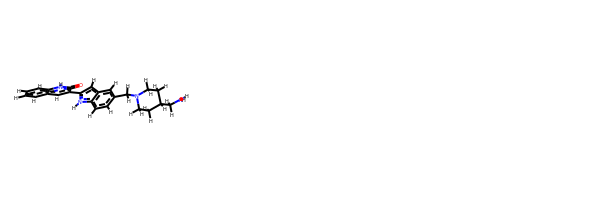

rdkit:  [H]c1c([H])c([H])c2c(c1[H])c([H])c(-c1c([H])c3c([H])c(C([H])([H])N4C([H])([H])C([H])([H])C([H])(C([H])([H])N([H])[H])C([H])([H])C4([H])[H])c([H])c([H])c3n1[H])c(=O)n2[H]
oechem:  c1ccc2c(c1)cc(c(=O)[nH]2)c3cc4cc(ccc4[nH]3)CN5CCC(CC5)CN
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
49.79573322364628 kJ/mol 58070.94076948375 kJ/mol False
angle
233.81233253277512 kJ/mol 233.81233253277512 kJ/mol True
nb
64.98064860534738 kJ/mol 64.98064860534738 kJ/mol True
torsion
54.3849673488706 kJ/mo

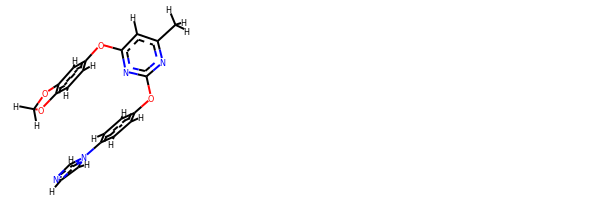

rdkit:  [H]c1nc([H])n(-c2c([H])c([H])c(Oc3nc(Oc4c([H])c([H])c5c(c4[H])OC([H])([H])O5)c([H])c(C([H])([H])[H])n3)c([H])c2[H])c1[H]
oechem:  Cc1cc(nc(n1)Oc2ccc(cc2)n3ccnc3)Oc4ccc5c(c4)OCO5
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
9.591608210715286 kJ/mol 58294.46452149453 kJ/mol False
angle
91.91041066713903 kJ/mol 91.91041066713903 kJ/mol True
nb
32.14421318473295 kJ/mol 32.14421318473295 kJ/mol True
torsion
0.0003338568659514207 kJ/mol 0.00033148441261976653 kJ/mol False
133.64656591945322 kJ/mol 58418.519476830814 kJ/mol

-------------------------------------------------------------------
--------------------------------

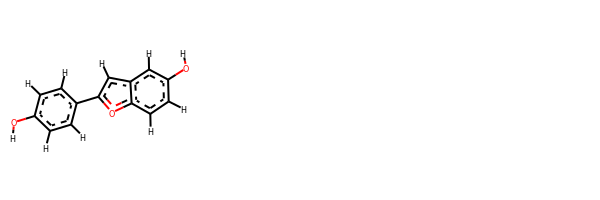

rdkit:  [H]Oc1c([H])c([H])c(-c2oc3c([H])c([H])c(O[H])c([H])c3c2[H])c([H])c1[H]
oechem:  c1cc(ccc1c2cc3cc(ccc3o2)O)O
###########################################################################
 #########################################################

bond
52.15031326383656 kJ/mol 57907.700051667256 kJ/mol False
angle
161.79304233155128 kJ/mol 163.18069743460433 kJ/mol False
nb
2.6035976665769627 kJ/mol 2.6035976665769627 kJ/mol True
torsion
10.224413191274524 kJ/mol 5.418210982560994 kJ/mol False
226.77136645323932 kJ/mol 58078.902557751 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4973


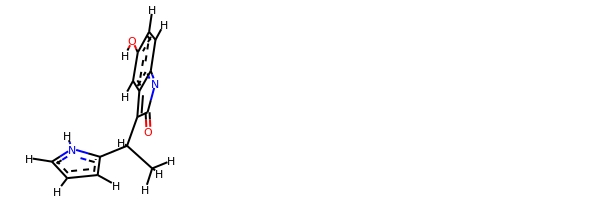

rdkit:  [H]Oc1c([H])c([H])c2c(c1[H])=C(C([H])(c1c([H])c([H])c([H])n1[H])C([H])([H])[H])C(=O)N=2
oechem:  CC(c1ccc[nH]1)C2=c3cc(ccc3=NC2=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
20.17279460258043 kJ/mol 57492.66205177372 kJ/mol False
angle
27.96585743728614 kJ/mol 28.301591184740772 kJ/mol False
nb
64.35501336068388 kJ/mol 64.35501336068388 kJ/mol True
torsion
37.075923552450305 kJ/mol 20.529579063436074 kJ/mol False
149.56958895300076 kJ/mol 57605.848235382575 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4975


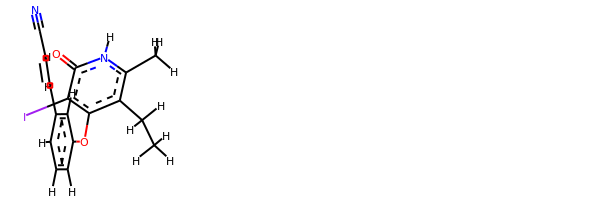

rdkit:  [H]C(C#N)=C([H])c1c([H])c([H])c([H])c(Oc2c(C([H])([H])C([H])([H])[H])c(C([H])([H])[H])n([H])c(=O)c2I)c1[H]
oechem:  CCc1c([nH]c(=O)c(c1Oc2cccc(c2)C=CC#N)I)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
24.45292031670602 kJ/mol 57705.16806752008 kJ/mol False
angle
15.140572519681688 kJ/mol 15.140572519681688 kJ/mol True
nb
40.694265354341425 kJ/mol 40

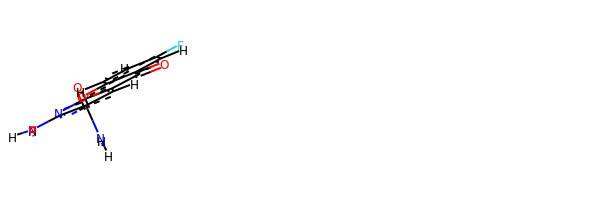

rdkit:  [H]c1c(F)c([H])c2c(=O)c3c([H])c(C(=O)N([H])[H])c(N([H])[H])nc3oc2c1[H]
oechem:  c1cc2c(cc1F)c(=O)c3cc(c(nc3o2)N)C(=O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
27.19218225884864 kJ/mol 58049.62380631951 kJ/mol False
angle
116.84998976896429 kJ/mol 118.85760923910516 kJ/mol False
nb
48.67018141667317 kJ/mol 48.67018141667317 kJ/mol True
torsion
28.02313469631466 kJ/mol 28.023186107635432 kJ/mol False
220.73548814080075 kJ/mol 58245.17478308293 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4982


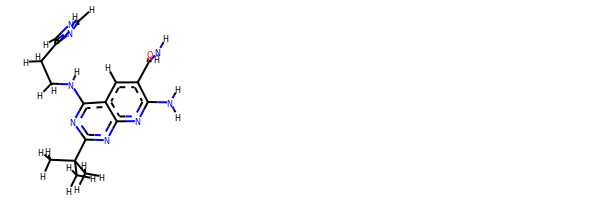

rdkit:  [H]c1c(C(=O)N([H])[H])c(N([H])[H])nc2nc(C(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H])nc(N([H])C([H])([H])C([H])([H])c3nc([H])n([H])c3[H])c12
oechem:  CC(C)(C)c1nc2c(cc(c(n2)N)C(=O)N)c(n1)NCCc3c[nH]cn3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
24.775055600448738 kJ/mol 58004.95747635153 kJ/mol False
angle
409.1960874777911 kJ/mol 409.1960874777911 kJ/mol True
nb
28.357051743363563 kJ/mol 28.357051743363563 kJ/mol True
torsion
97.87477743463445 kJ/mol 74.3171100772833 kJ/mol False
560.2029722562378 kJ/mol 58516.827725649964 kJ/mol

-------------------------------------------------------------------
--------------

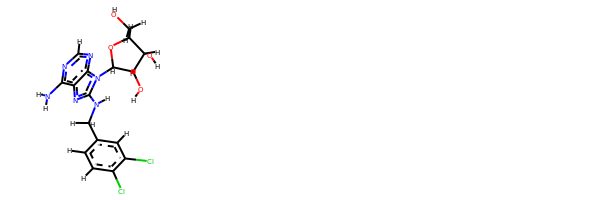

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c(N([H])C([H])([H])c3c([H])c([H])c(Cl)c(Cl)c3[H])nc3c(N([H])[H])nc([H])nc32)C([H])(O[H])C1([H])O[H]
oechem:  c1cc(c(cc1CNc2nc3c(ncnc3n2C4C(C(C(O4)CO)O)O)N)Cl)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
17.408466842851187 kJ/mol 43703.92146781849 kJ/mol False
angle
65.92474177840093 kJ/mol 70.32123632333267 kJ/mol F

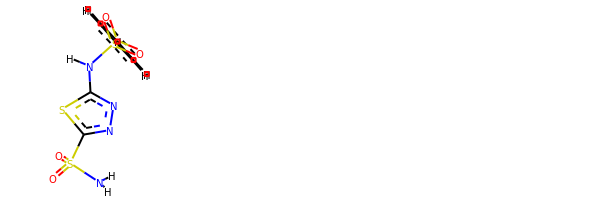

rdkit:  [H]c1c([H])c([H])c(S(=O)(=O)N([H])c2nnc(S(=O)(=O)N([H])[H])s2)c([H])c1[H]
oechem:  c1ccc(cc1)S(=O)(=O)Nc2nnc(s2)S(=O)(=O)N
###########################################################################
 #########################################################

bond
39.62658943217254 kJ/mol 28712.46538541936 kJ/mol False
angle
114.51509453457585 kJ/mol 114.626029872519 kJ/mol False
nb
15.9639780212191 kJ/mol 15.9639780212191 kJ/mol True
torsion
32.893094471981335 kJ/mol 27.613082405232134 kJ/mol False
202.99875645994882 kJ/mol 28870.66847571833 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4991


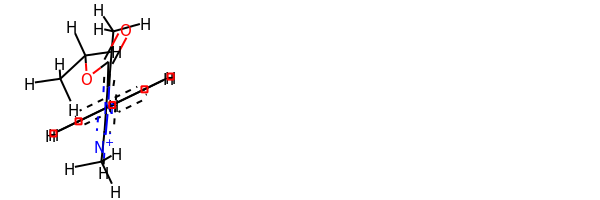

rdkit:  [H]c1c([H])c([H])c(-n2c(C([H])([H])[H])c(C(=O)OC([H])([H])C([H])([H])[H])c(C([H])([H])[H])[n+]2[H])c([H])c1[H]
oechem:  CCOC(=O)c1c([nH+]n(c1C)c2ccccc2)C
###########################################################################
 #########################################################

bond
21.97875188180569 kJ/mol 58002.14267670756 kJ/mol False
angle
398.6321279008505 kJ/mol 398.6321279008505 kJ/mol True
nb
12.442971099687975 kJ/mol 12.442971099687975 kJ/mol True
torsion
83.9764479908666 kJ/mol 59.87493345213179 kJ/mol False
517.0302988732108 kJ/mol 58473.09270916023 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4992


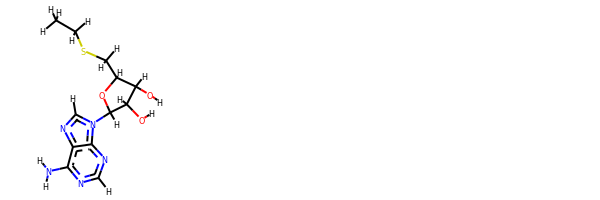

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)OC([H])(C([H])([H])SC([H])([H])C([H])([H])[H])C1([H])O[H]
oechem:  CCSCC1C(C(C(O1)n2cnc3c2ncnc3N)O)O
###########################################################################
 #########################################################

bond
34.51410682592571 kJ/mol 115425.98725169679 kJ/mol False
angle
190.5041689820772 kJ/mol 190.5041689820772 kJ/mol True
nb
23.56455480426039 kJ/mol 23.56455480426039 kJ/mol True
torsion
58.846658490449954 kJ/mol 38.749816922307545 kJ/mol False
307.42948910271326 kJ/mol 115678.80579240544 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_4993


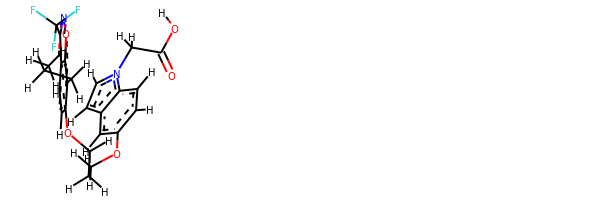

rdkit:  [H]OC(=O)C([H])([H])n1c([H])c([H])c2c([H])c(OC([H])([H])C([H])([H])C([H])([H])Oc3c([H])c([H])c4c(C(F)(F)F)noc4c3C([H])([H])C([H])([H])C([H])([H])[H])c([H])c([H])c21
oechem:  CCCc1c(ccc2c1onc2C(F)(F)F)OCCCOc3ccc4c(c3)ccn4CC(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
17.25866014185311 kJ/mol 29212.351601439135 kJ/mol False
angle
155.7928621317543 kJ/mol 158.53431439351553 kJ/mol False
nb
0.31051784966664847 kJ/mol 0.31051784966664847 kJ/mol True
torsion
11.646862141216385 kJ/mol 5.723900831098026 kJ/mol False
185.00890226449044 kJ/mol 29376.920334513416 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
---------------------------------------------------

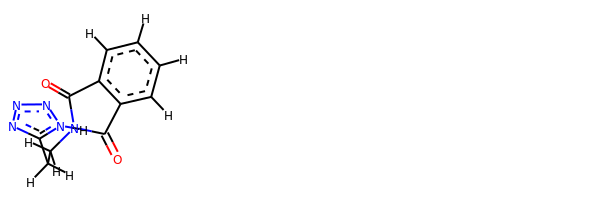

rdkit:  [H]c1c([H])c([H])c2c(c1[H])C(=O)N(C([H])([H])C([H])([H])c1nnnn1[H])C2=O
oechem:  c1ccc2c(c1)C(=O)N(C2=O)CCc3[nH]nnn3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
17.927337526765328 kJ/mol 145508.88715087244 kJ/mol False
angle
176.64797887642771 kJ/mol 178.6470488545753 kJ/mol False
nb
81.62604829131257 kJ/mol 81.62604829131257 kJ/mol True
torsion
10.47017847156722 kJ/mol 5.240199952254891 kJ/mol False
286.6715431660728 kJ/mol 145774.40044797058 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------

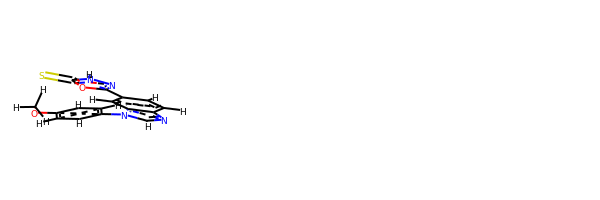

rdkit:  [H]c1c([H])c(-n2c([H])nc3c([H])c([H])c(-c4nn([H])c(=S)o4)c([H])c32)c([H])c([H])c1OC([H])([H])[H]
oechem:  COc1ccc(cc1)n2cnc3c2cc(cc3)c4n[nH]c(=S)o4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
8.081561641598077 kJ/mol 57759.986908308405 kJ/mol False
angle
91.95846007421801 kJ/mol 93.18839438703671 kJ/mol False
nb
13.466298138296054 kJ/mol 13.466298138296054 kJ/mol True
torsion
3.905926563690258 kJ/mol 3.9059273677660302 kJ/mol False
117.4122464178024 kJ/mol 57870.547528201496 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5000


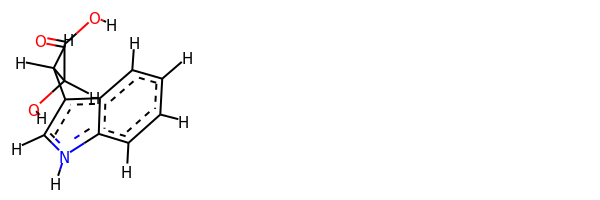

rdkit:  [H]OC(=O)C([H])(O[H])C([H])([H])c1c([H])n([H])c2c([H])c([H])c([H])c([H])c12
oechem:  c1ccc2c(c1)c(c[nH]2)CC(C(=O)O)O
###########################################################################
 #########################################################

bond
10.492440239831033 kJ/mol 57808.41763897761 kJ/mol False
angle
119.51268831695353 kJ/mol 119.51268831695353 kJ/mol True
nb
26.775340570152444 kJ/mol 26.775340570152444 kJ/mol True
torsion
35.528867078085966 kJ/mol 34.313899964514356 kJ/mol False
192.309336205023 kJ/mol 57989.01956782923 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5001


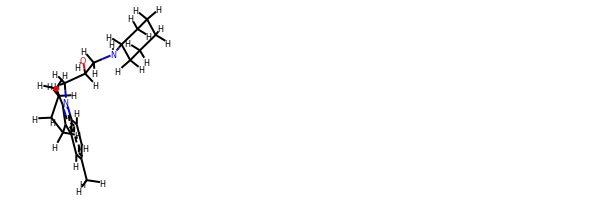

rdkit:  [H]OC([H])(C([H])([H])N([H])C1([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C1([H])[H])C([H])([H])n1c2c(c3c([H])c(C([H])([H])[H])c([H])c([H])c31)C([H])([H])C([H])([H])C([H])([H])C2([H])[H]
oechem:  Cc1ccc2c(c1)c3c(n2CC(CNC4CCCCC4)O)CCCC3
###########################################################################
 #########################################################

bond
35.11205305811699 kJ/mol 86272.62156013143 kJ/mol False
angle
150.8384823090322 kJ/mol 150.8384823090322 kJ/mol True
nb
32.13195702355206 kJ/mol 32.13195702355206 kJ/mol True
torsion
144.99480719864536 kJ/mol 142.1495625485601 kJ/mol False
363.07729958934664 kJ/mol 86597.74156201257 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5002


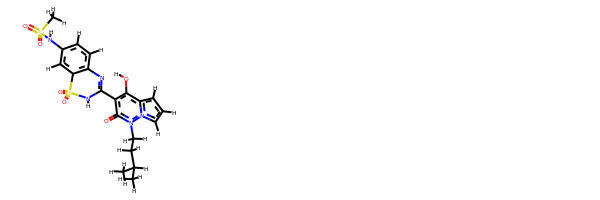

rdkit:  [H]Oc1c(C2=Nc3c([H])c([H])c(N([H])S(=O)(=O)C([H])([H])[H])c([H])c3S(=O)(=O)N2[H])c(=O)n(C([H])([H])C([H])([H])C([H])(C([H])([H])[H])C([H])([H])[H])n2c([H])c([H])c([H])c12
oechem:  CC(C)CCn1c(=O)c(c(c2n1ccc2)O)C3=Nc4ccc(cc4S(=O)(=O)N3)NS(=O)(=O)C
###########################################################################
 #########################################################

bond
12.86662434034925 kJ/mol 101369.0348980565 kJ/mol False
angle
127.16120747272613 kJ/mol 130.29439290359997 kJ/mol False
nb
13.563270770248481 kJ/mol 13.563270770248481 kJ/mol True
torsion
29.602696897399085 kJ/mol 0.0022590821387050404 kJ/mol False
183.19379948072296 kJ/mol 101512.89482081248 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5003


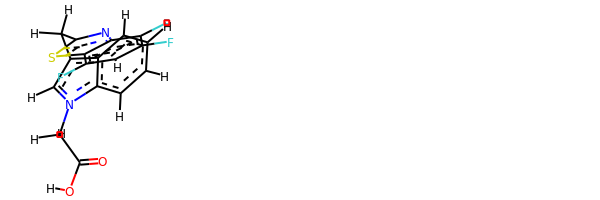

rdkit:  [H]OC(=O)C([H])([H])n1c([H])c(C([H])([H])c2nc3c(F)c(F)c([H])c(F)c3s2)c2c([H])c([H])c([H])c([H])c21
oechem:  c1ccc2c(c1)c(cn2CC(=O)O)Cc3nc4c(c(cc(c4s3)F)F)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
37.6897534899955 kJ/mol 56636.88690887063 kJ/mol False
angle
102.92073735662525 kJ/mol 102.92073735662525 kJ/mol True
nb
45.82087476367037 kJ/mol 45.82087476367037 kJ/mol True
torsion
15.763128798512135 kJ/mol 20.044924913842134 kJ/mol False
202.19449440880325 kJ/mol 56805.67344590476 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5005


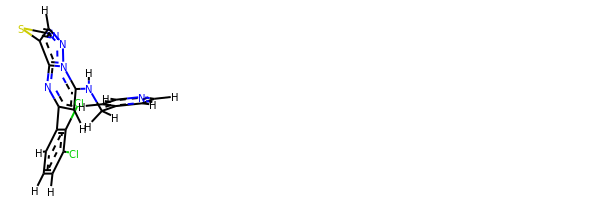

rdkit:  [H]c1nc([H])c([H])c(C([H])([H])N([H])c2c([H])c(-c3c([H])c([H])c([H])c(Cl)c3Cl)nc3c(SC#N)c([H])nn23)c1[H]
oechem:  c1cc(c(c(c1)Cl)Cl)c2cc(n3c(n2)c(cn3)SC#N)NCc4ccncc4
###########################################################################
 #########################################################

bond
44.98372414737326 kJ/mol 101921.40198810796 kJ/mol False
angle
159.1769315738508 kJ/mol 164.3507156852086 kJ/mol False
nb
20.038359901034905 kJ/mol 20.038359901034905 kJ/mol True
torsion
41.45510692082592 kJ/mol 41.4473658122054 kJ/mol False
265.6541225430849 kJ/mol 102147.23842950641 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5006


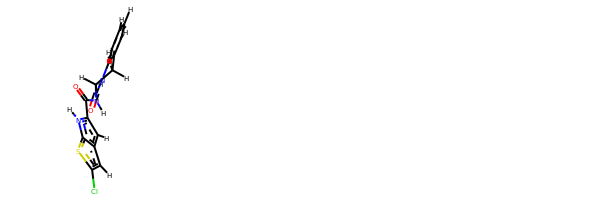

rdkit:  [H]c1c([H])c([H])c2c(c1[H])N([H])C(=O)C([H])(N([H])C(=O)c1c([H])c3c([H])c(Cl)sc3n1[H])C2([H])[H]
oechem:  c1ccc2c(c1)CC(C(=O)N2)NC(=O)c3cc4cc(sc4[nH]3)Cl
###########################################################################
 #########################################################

bond
15.833173072031878 kJ/mol 57468.15321001643 kJ/mol False
angle
432.7770440963686 kJ/mol 432.7770440963686 kJ/mol True
nb
29.602646136605948 kJ/mol 29.602646136605948 kJ/mol True
torsion
62.01305742172557 kJ/mol 62.013057285107365 kJ/mol False
540.225920726732 kJ/mol 57992.54595753451 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5007


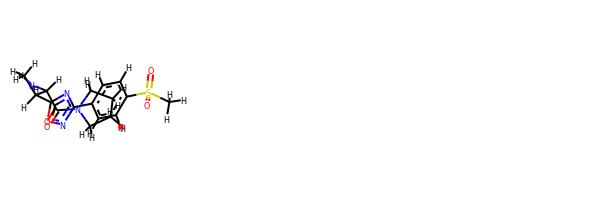

rdkit:  [H]c1c([H])c(S(=O)(=O)C([H])([H])[H])c([H])c([H])c1-c1noc(C([H])(C([H])([H])[H])C([H])(C(=O)N2C([H])([H])C([H])([H])C([H])([H])C2([H])[H])N([H])[H])n1
oechem:  CC(c1nc(no1)c2ccc(cc2)S(=O)(=O)C)C(C(=O)N3CCCC3)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
18.272089705626623 kJ/mol 58376.16444003623 kJ/mol False
angle
110.81423129873522 kJ/mol 110.81423129873522 kJ/mol True
nb
82.83604300392726 kJ/mol 82.83604300392726 kJ/mol True
torsion
42.186652319059434 kJ/mol 32.162315485661516 kJ

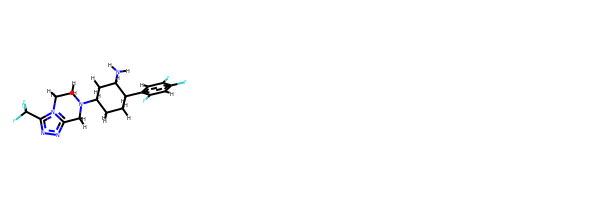

rdkit:  [H]c1c(F)c(F)c([H])c(C2([H])C([H])([H])C([H])([H])C([H])(N3C([H])([H])c4nnc(C(F)(F)F)n4C([H])([H])C3([H])[H])C([H])([H])C2([H])N([H])[H])c1F
oechem:  c1c(c(cc(c1F)F)F)C2CCC(CC2N)N3CCn4c(nnc4C(F)(F)F)C3
###########################################################################
 #########################################################

bond
19.657722566735185 kJ/mol 43930.86327938244 kJ/mol False
angle
53.608622399714385 kJ/mol 57.127915031918185 kJ/mol False
nb
32.09816029568179 kJ/mol 32.09816029568179 kJ/mol True
torsion
17.392823578442098 kJ/mol 11.673485800358863 kJ/mol False
122.75732884057345 kJ/mol 44031.762840510404 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5013


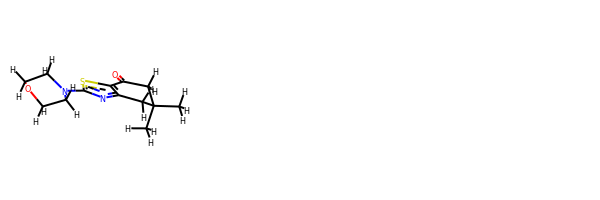

rdkit:  [H]C([H])([H])C1(C([H])([H])[H])C([H])([H])C(=O)c2sc(N3C([H])([H])C([H])([H])OC([H])([H])C3([H])[H])nc2C1([H])[H]
oechem:  CC1(Cc2c(sc(n2)N3CCOCC3)C(=O)C1)C
###########################################################################
 #########################################################

bond
16.30178856119498 kJ/mol 86731.46658065908 kJ/mol False
angle
181.3487592294492 kJ/mol 184.1661015116489 kJ/mol False
nb
33.30869564499121 kJ/mol 33.30869564499121 kJ/mol True
torsion
29.203965328749497 kJ/mol 27.108242523212276 kJ/mol False
260.1632087643849 kJ/mol 86976.04962033893 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5015


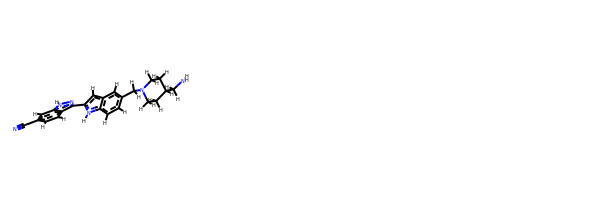

rdkit:  [H]c1c(C#N)c([H])c2c(c(-c3c([H])c4c([H])c(C([H])([H])N5C([H])([H])C([H])([H])C([H])(C([H])([H])N([H])[H])C([H])([H])C5([H])[H])c([H])c([H])c4n3[H])nn2[H])c1[H]
oechem:  c1cc2c(cc1CN3CCC(CC3)CN)cc([nH]2)c4c5ccc(cc5[nH]n4)C#N
###########################################################################
 #########################################################

bond
30.4578052032493 kJ/mol 57887.78159307431 kJ/mol False
angle
167.33651158083978 kJ/mol 168.7296752761665 kJ/mol False
nb
69.87656149111719 kJ/mol 69.87656149111719 kJ/mol True
torsion
23.79113983311048 kJ/mol 23.791207594031473 kJ/mol False
291.4620181083168 kJ/mol 58150.17903743563 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5018


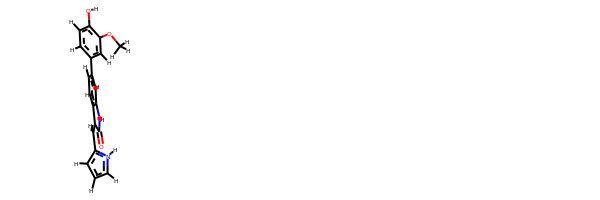

rdkit:  [H]Oc1c([H])c([H])c(-c2c([H])c([H])c3c(c2[H])N([H])C(=O)C3=C([H])c2c([H])c([H])c([H])n2[H])c([H])c1OC([H])([H])[H]
oechem:  COc1cc(ccc1O)c2ccc3c(c2)NC(=O)C3=Cc4ccc[nH]4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
24.30088105185049 kJ/mol 29058.989662024345 kJ/mol False
angle
128.99550141507962 kJ/mol 128.99550141507962 kJ/mol True
nb
47.37843544876326 kJ/mol 47.37843544876326 kJ/mol True
torsion
33.37172561372533 kJ/mol 20.732785904029075 kJ/mol False
234.0465435294187 kJ/mol 29256.096384792218 kJ/mol

-------------------------------------------------------------------
-----------------------------------------------

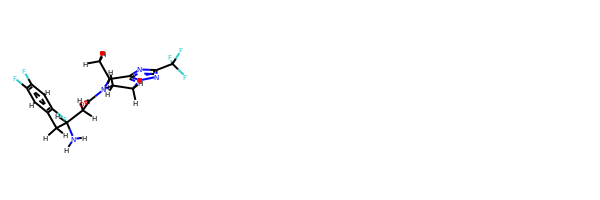

rdkit:  [H]c1c(F)c(F)c([H])c(C([H])([H])C([H])(N([H])[H])C([H])([H])C(=O)N2C([H])([H])C([H])([H])n3nc(C(F)(F)F)nc3C2([H])C([H])([H])[H])c1F
oechem:  CC1c2nc(nn2CCN1C(=O)CC(Cc3cc(c(cc3F)F)F)N)C(F)(F)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ###########################################

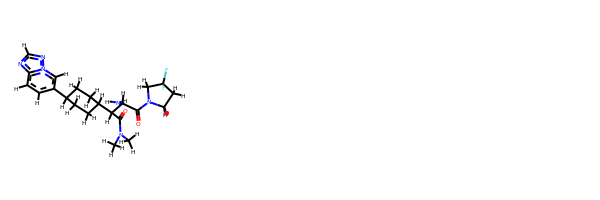

rdkit:  [H]c1nc2c([H])c([H])c(C3([H])C([H])([H])C([H])([H])C([H])(C([H])(C(=O)N(C([H])([H])[H])C([H])([H])[H])C([H])(C(=O)N4C([H])([H])C([H])([H])C(F)(F)C4([H])[H])N([H])[H])C([H])([H])C3([H])[H])c([H])n2n1
oechem:  CN(C)C(=O)C(C1CCC(CC1)c2ccc3ncnn3c2)C(C(=O)N4CCC(C4)(F)F)N
###########################################################################
 #########################################################

bond
41.759666842137214 kJ/mol 156683.90254288018 kJ/mol False
angle
62.26703252095853 kJ/mol 65.39828800982899 kJ/mol False
nb
36.66728170463905 kJ/mol 36.66728170463905 kJ/mol True
torsion
57.24147464234832 kJ/mol 0.04698531971203764 kJ/mol False
197.9354557100831 kJ/mol 156786.01509791435 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5033


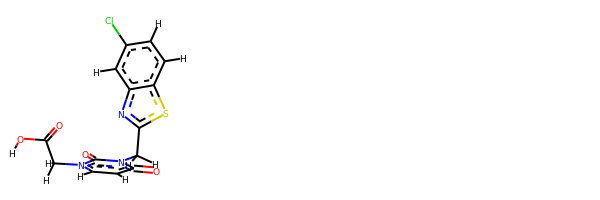

rdkit:  [H]OC(=O)C([H])([H])n1c([H])c([H])c(=O)n(C([H])([H])c2nc3c([H])c(Cl)c([H])c([H])c3s2)c1=O
oechem:  c1cc2c(cc1Cl)nc(s2)Cn3c(=O)ccn(c3=O)CC(=O)O
###########################################################################
 #########################################################

bond
17.525679202073565 kJ/mol 87592.97996585026 kJ/mol False
angle
80.36455791084705 kJ/mol 84.66953054987242 kJ/mol False
nb
-3.9286050705978495 kJ/mol -3.9286050705978495 kJ/mol True
torsion
36.75747431000558 kJ/mol 10.236869563336853 kJ/mol False
130.71910635232834 kJ/mol 87683.95776089287 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5034


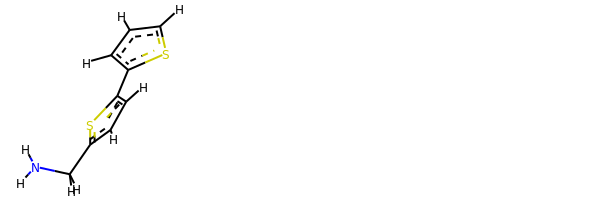

rdkit:  [H]c1sc(-c2sc(C([H])([H])N([H])[H])c([H])c2[H])c([H])c1[H]
oechem:  c1cc(sc1)c2ccc(s2)CN
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
10.540418853095186 kJ/mol 29079.729439043123 kJ/mol False
angle
93.7667246937243 kJ/mol 95.52073683295372 kJ/mol False
nb
12.63678432175247 kJ/mol 12.63678432175247 kJ/mol True
torsion
40.088337995190194 kJ/mol 34.8583

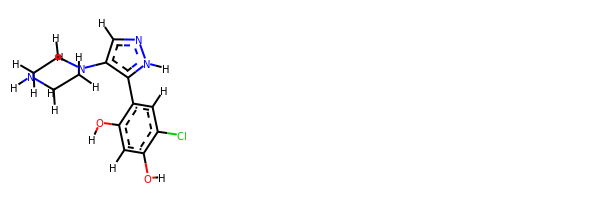

rdkit:  [H]Oc1c([H])c(O[H])c(-c2c(N3C([H])([H])C([H])([H])N([H])C([H])([H])C3([H])[H])c([H])nn2[H])c([H])c1Cl
oechem:  c1c(c(cc(c1Cl)O)O)c2c(cn[nH]2)N3CCNCC3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
21.162880014826154 kJ/mol 57774.539130251105 kJ/mol False
angle
127.69338636416657 kJ/mol 128.92236000323655 kJ/mol False
nb
54.04794192686779 kJ/mol 54.0479

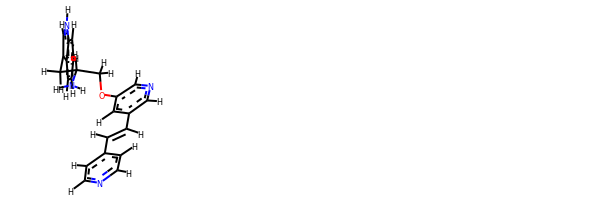

rdkit:  [H]C(=C([H])c1c([H])c([H])nc([H])c1[H])c1c([H])nc([H])c(OC([H])([H])C([H])(N([H])[H])C([H])([H])c2c([H])n([H])c3c([H])c([H])c([H])c([H])c23)c1[H]
oechem:  c1ccc2c(c1)c(c[nH]2)CC(COc3cc(cnc3)C=Cc4ccncc4)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ###############################

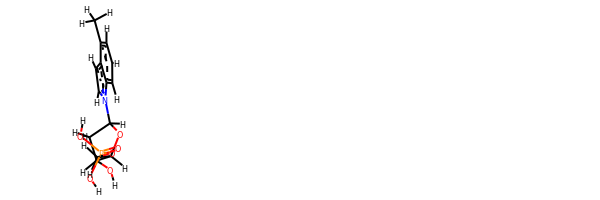

rdkit:  [H]OC1([H])C([H])([H])C([H])(n2c([H])c([H])c3c(C([H])([H])[H])c([H])c([H])c([H])c32)OC1([H])C([H])([H])OP(=O)(O[H])O[H]
oechem:  Cc1cccc2c1ccn2C3CC(C(O3)COP(=O)(O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
19.611358340233934 kJ/mol 56694.7183796639 kJ/mol False
angle
9.589096109296598 kJ/mol 9.589096109296598 kJ/mol True
nb
31.792466019937194 kJ/mol 31.792466019937194 kJ/mol True
torsion
0.0005175691960954841 kJ/mol 0.000545320975586548 kJ/mol False
60.993438038663825 kJ/mol 56736.100487114105 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5058


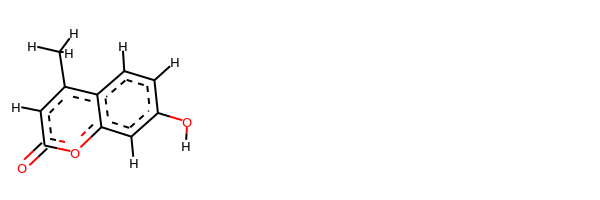

rdkit:  [H]Oc1c([H])c([H])c2c(C([H])([H])[H])c([H])c(=O)oc2c1[H]
oechem:  Cc1cc(=O)oc2c1ccc(c2)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
21.074266265484532 kJ/mol 57690.585869451985 kJ/mol False
angle
100.35415588119646 kJ/mol 100.35415588119646 kJ/mol True
nb
54.49248991878576 kJ/mol 54.49248991878576 kJ/mol True
torsion
45.6306204281176 kJ/mol 33.3245

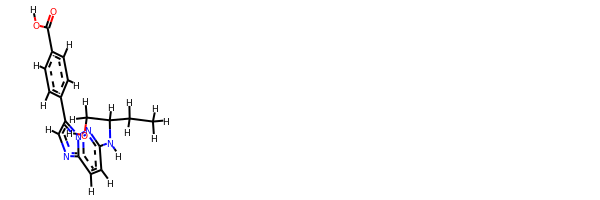

rdkit:  [H]OC(=O)c1c([H])c([H])c(-c2c([H])nc3c([H])c([H])c(N([H])C([H])(C([H])([H])O[H])C([H])([H])C([H])([H])[H])nn23)c([H])c1[H]
oechem:  CCC(CO)Nc1ccc2ncc(n2n1)c3ccc(cc3)C(=O)O
###########################################################################
 #########################################################

bond
17.504082976222502 kJ/mol 58000.354079317316 kJ/mol False
angle
150.50966336171035 kJ/mol 152.62952070390097 kJ/mol False
nb
63.98326889604278 kJ/mol 63.98326889604278 kJ/mol True
torsion
97.39809160751157 kJ/mol 97.39808561274924 kJ/mol False
329.3951068414872 kJ/mol 58314.364954530014 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5066


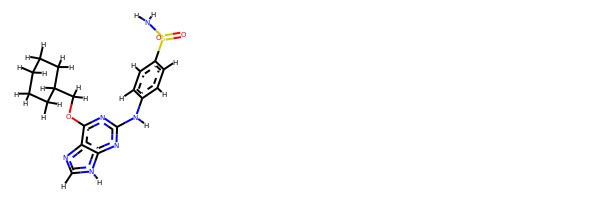

rdkit:  [H]c1c([H])c(S(=O)(=O)N([H])[H])c([H])c([H])c1N([H])c1nc(OC([H])([H])C2([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C2([H])[H])c2nc([H])n([H])c2n1
oechem:  c1cc(ccc1Nc2nc3c(c(n2)OCC4CCCCC4)nc[nH]3)S(=O)(=O)N
###########################################################################
 #########################################################

bond
47.85518750708144 kJ/mol 114956.8765263194 kJ/mol False
angle
221.96307284794318 kJ/mol 221.96307284794318 kJ/mol True
nb
16.93533497721421 kJ/mol 16.93533497721421 kJ/mol True
torsion
32.38317211760367 kJ/mol 32.38249775788459 kJ/mol False
319.1367674498425 kJ/mol 115228.15743190245 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5067


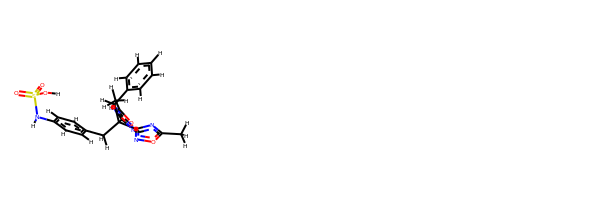

rdkit:  [H]OS(=O)(=O)N([H])c1c([H])c([H])c(C([H])([H])C(c2noc(C([H])([H])[H])n2)(c2noc(C([H])([H])[H])n2)C([H])([H])c2c([H])c([H])c([H])c([H])c2[H])c([H])c1[H]
oechem:  Cc1nc(no1)C(Cc2ccccc2)(Cc3ccc(cc3)NS(=O)(=O)O)c4nc(on4)C
###########################################################################
 #########################################################

bond
25.755179399074105 kJ/mol 56630.23492799917 kJ/mol False
angle
126.75504771245798 kJ/mol 126.75504771245798 kJ/mol True
nb
42.06253411014259 kJ/mol 42.06253411014259 kJ/mol True
torsion
12.237141004102089 kJ/mol 7.007073851767183 kJ/mol False
206.80990222577677 kJ/mol 56806.05958367354 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5068


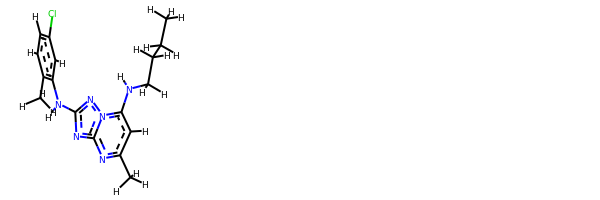

rdkit:  [H]c1c([H])c(C([H])([H])[H])c(N([H])c2nc3nc(C([H])([H])[H])c([H])c(N([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])[H])n3n2)c([H])c1Cl
oechem:  CCCCNc1cc(nc2n1nc(n2)Nc3cc(ccc3C)Cl)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
18.05755989577957 kJ/mol 43804.72000971411 kJ/mol False
angle
61.38955488256442 kJ/mol 63.543848910516594 kJ/mol False
nb
16.201426288467715 kJ/mol 16.201426288467715 kJ/mol True
torsion
54.394868136596386 kJ/mol 54.39486535605478 kJ/mol False
150.0434092034081 kJ/mol 43938.86015026915 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5070


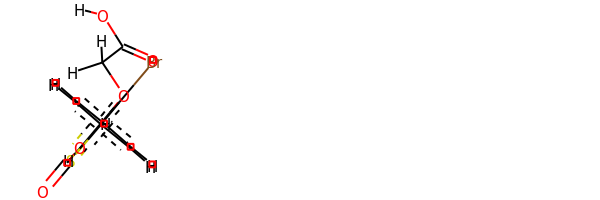

rdkit:  [H]OC(=O)c1sc(-c2c([H])c([H])c([H])c([H])c2[H])c(Br)c1OC([H])([H])C(=O)O[H]
oechem:  c1ccc(cc1)c2c(c(c(s2)C(=O)O)OCC(=O)O)Br
###########################################################################
 #########################################################

bond
62.890063016853155 kJ/mol 57920.34006495993 kJ/mol False
angle
172.0063461533245 kJ/mol 173.39351519927482 kJ/mol False
nb
20.128694789668582 kJ/mol 20.128694789668582 kJ/mol True
torsion
32.194223801672074 kJ/mol 27.38995534902527 kJ/mol False
287.21932776151834 kJ/mol 58141.2522302979 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5072


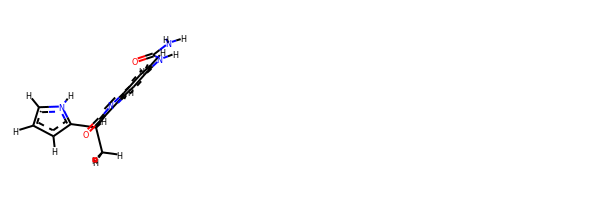

rdkit:  [H]c1c(N([H])C(=O)N([H])[H])c([H])c2c(c1[H])=NC(=O)C=2C([H])(c1c([H])c([H])c([H])n1[H])C([H])([H])[H]
oechem:  CC(c1ccc[nH]1)C2=c3cc(ccc3=NC2=O)NC(=O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
35.05906301856755 kJ/mol 43824.296097128725 kJ/mol False
angle
169.8762734040723 kJ/mol 172.02798577726583 kJ/mol False
nb
4.402156969090069 kJ/mol 4.402156969090069 kJ/mol True
torsion
63.019581764171434 kJ/mol 63.01960097171624 kJ/mol False
272.3570751559013 kJ/mol 44063.7458408468 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5074


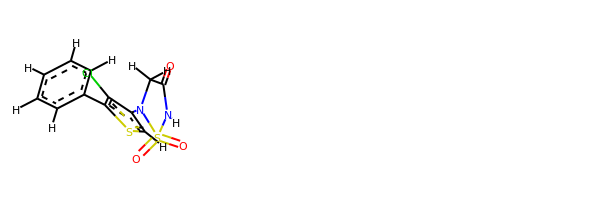

rdkit:  [H]c1sc(-c2c([H])c([H])c([H])c([H])c2[H])c(Cl)c1N1C([H])([H])C(=O)N([H])S1(=O)=O
oechem:  c1ccc(cc1)c2c(c(cs2)N3CC(=O)NS3(=O)=O)Cl
###########################################################################
 #########################################################

bond
27.424523690931046 kJ/mol 56406.449733541725 kJ/mol False
angle
431.976031169374 kJ/mol 431.976031169374 kJ/mol True
nb
89.19928983302403 kJ/mol 89.19928983302403 kJ/mol True
torsion
75.9875252284374 kJ/mol 70.00218135416029 kJ/mol False
624.5873699217665 kJ/mol 56997.62723589828 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5075


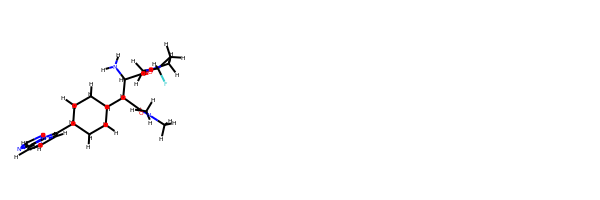

rdkit:  [H]c1nc2c([H])c([H])c([H])c(C3([H])C([H])([H])C([H])([H])C([H])(C([H])(C(=O)N(C([H])([H])[H])C([H])([H])[H])C([H])(C(=O)N4C([H])([H])C([H])([H])C([H])(F)C4([H])[H])N([H])[H])C([H])([H])C3([H])[H])n2n1
oechem:  CN(C)C(=O)C(C1CCC(CC1)c2cccc3n2ncn3)C(C(=O)N4CCC(C4)F)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
18.920307072710425 kJ/mol 57145.23798537735 kJ/mol False
angle
30.172107285061546 kJ/mol 30.172107285061546 kJ/mol True
nb
46.38296709675566 kJ/mol 46.38296709675566 kJ/mol True
torsion
34.50951128292769 kJ/mol 29.279532235544163 kJ/mol False
129.9848927374553 kJ/mol 57251.072591994714 kJ/mol

------------------

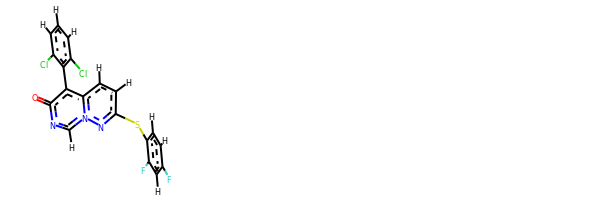

rdkit:  [H]c1c([H])c(Cl)c(-c2c(=O)nc([H])n3nc(Sc4c([H])c([H])c(F)c([H])c4F)c([H])c([H])c23)c(Cl)c1[H]
oechem:  c1cc(c(c(c1)Cl)c2c3ccc(nn3cnc2=O)Sc4ccc(cc4F)F)Cl
###########################################################################
 #########################################################

bond
19.97845207450734 kJ/mol 43805.996155096924 kJ/mol False
angle
44.9206994145417 kJ/mol 47.074381409974855 kJ/mol False
nb
24.756009575613536 kJ/mol 24.756009575613536 kJ/mol True
torsion
22.14495950480249 kJ/mol 15.860421205081396 kJ/mol False
111.80012056946507 kJ/mol 43893.6869672876 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5079


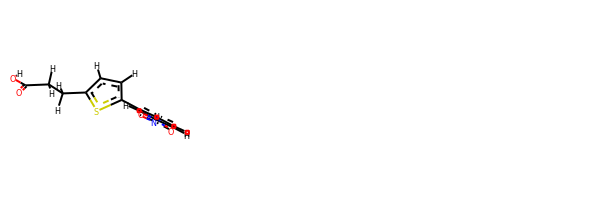

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])c1sc(-c2c([H])c([H])c([H])c([N+](=O)[O-])c2[H])c([H])c1[H]
oechem:  c1cc(cc(c1)[N+](=O)[O-])c2ccc(s2)CCC(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###################################

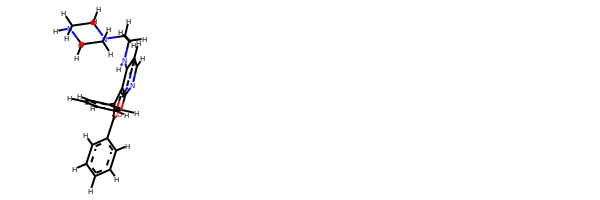

rdkit:  [H]c1nc2oc(-c3c([H])c([H])c([H])c([H])c3[H])c(-c3c([H])c([H])c([H])c([H])c3[H])c2c(N([H])C([H])([H])C([H])([H])N2C([H])([H])C([H])([H])N([H])C([H])([H])C2([H])[H])c1[H]
oechem:  c1ccc(cc1)c2c3c(ccnc3oc2c4ccccc4)NCCN5CCNCC5
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
22.097232269276766 kJ/mol 57627.370084448135 kJ/mol False
angle
449.6740834771181 kJ/mol 449.6740834771181 kJ/mol True
nb
47.70433053950869 kJ/mol 47.70433053950869 kJ/mol True
torsion
65.09889982027138 kJ/mol 40.54626381479926 kJ/mol False
584.5745461061749 kJ/mol 58165.29476227956 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
----------------------------------------------------------------

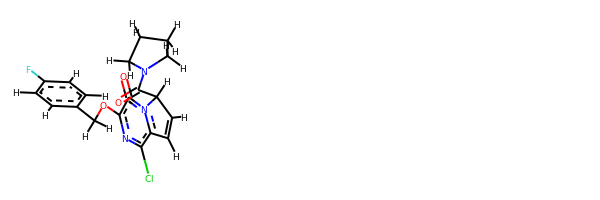

rdkit:  [H]C1=C([H])C([H])(C(=O)N2C([H])([H])C([H])([H])C([H])([H])C2([H])[H])n2c1c(Cl)nc(OC([H])([H])c1c([H])c([H])c(F)c([H])c1[H])c2=O
oechem:  c1cc(ccc1COc2c(=O)n3c(c(n2)Cl)C=CC3C(=O)N4CCCC4)F
###########################################################################
 #########################################################

bond
20.733842125393686 kJ/mol 57911.2033515871 kJ/mol False
angle
107.51833429867894 kJ/mol 109.08372901215351 kJ/mol False
nb
37.347411197771784 kJ/mol 37.347411197771784 kJ/mol True
torsion
38.40495966807408 kJ/mol 36.18298959792168 kJ/mol False
204.00454728991846 kJ/mol 58093.81748139495 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5089


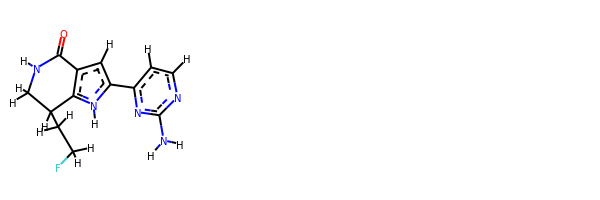

rdkit:  [H]c1nc(N([H])[H])nc(-c2c([H])c3c(n2[H])C([H])(C([H])([H])C([H])([H])F)C([H])([H])N([H])C3=O)c1[H]
oechem:  c1cnc(nc1c2cc3c([nH]2)C(CNC3=O)CCF)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
25.571401502756338 kJ/mol 58044.86819585207 kJ/mol False
angle
114.56810141104984 kJ/mol 116.58420335530099 kJ/mol False
nb
51.921198536811694 kJ/mol 51.921198536811694 kJ/mol True
torsion
20.94354811826114 kJ/mol 20.943824581709958 kJ/mol False
213.004249568879 kJ/mol 58234.31742232588 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
--

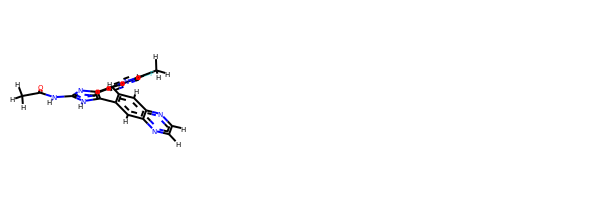

rdkit:  [H]c1nc2c([H])c([H])c(-c3c(-c4nc(C([H])([H])[H])c(F)c([H])c4[H])nc(N([H])C(=O)C([H])([H])[H])n3[H])c([H])c2nc1[H]
oechem:  Cc1c(ccc(n1)c2c([nH]c(n2)NC(=O)C)c3ccc4c(c3)nccn4)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

b

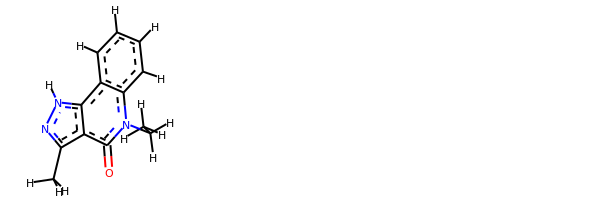

rdkit:  [H]c1c([H])c([H])c2c(c1[H])c1c(c(C([H])([H])[H])nn1[H])c(=O)n2C([H])([H])C([H])([H])[H]
oechem:  CCn1c2ccccc2c3c(c1=O)c(n[nH]3)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
8.60393621730527 kJ/mol 28970.26567128681 kJ/mol False
angle
86.35704969295683 kJ/mol 87.93019511614654 kJ/mol False
nb
39.17534131133911 kJ/mol 39.17534131133911 kJ/mol True
torsion
27.44843220345906 kJ/mol 5.3891103357754 kJ/mol False
161.58475942506027 kJ/mol 29102.76031805007 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------

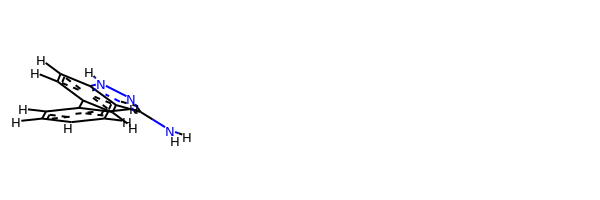

rdkit:  [H]c1c([H])c([H])c(-c2c([H])c([H])c3c(c(N([H])[H])nn3[H])c2[H])c([H])c1[H]
oechem:  c1ccc(cc1)c2ccc3c(c2)c(n[nH]3)N
###########################################################################
 #########################################################

bond
11.497033594750947 kJ/mol 28972.744937177526 kJ/mol False
angle
124.35032463029498 kJ/mol 125.92050575374903 kJ/mol False
nb
83.04130375638714 kJ/mol 83.04130375638714 kJ/mol True
torsion
117.07416755719026 kJ/mol 95.01450942604097 kJ/mol False
335.96282953862334 kJ/mol 29276.721256113702 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5102


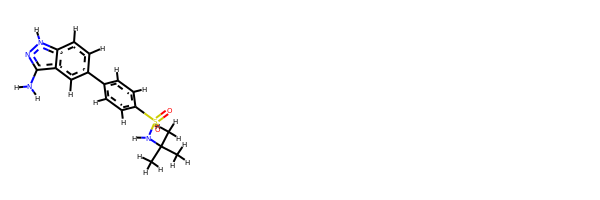

rdkit:  [H]c1c([H])c(S(=O)(=O)N([H])C(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H])c([H])c([H])c1-c1c([H])c([H])c2c(c(N([H])[H])nn2[H])c1[H]
oechem:  CC(C)(C)NS(=O)(=O)c1ccc(cc1)c2ccc3c(c2)c(n[nH]3)N
###########################################################################
 #########################################################

bond
31.47197267832813 kJ/mol 57888.13290365694 kJ/mol False
angle
191.4019032622782 kJ/mol 192.79194898993853 kJ/mol False
nb
29.61079485813665 kJ/mol 29.61079485813665 kJ/mol True
torsion
20.668092771112764 kJ/mol 20.668298401588554 kJ/mol False
273.1527635698558 kJ/mol 58131.20394590659 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5103


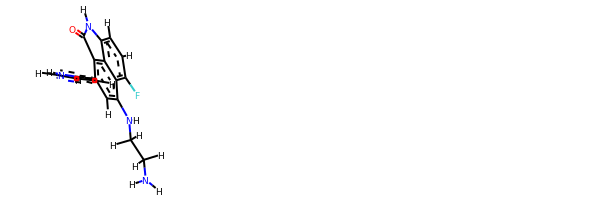

rdkit:  [H]c1c([H])c2c3c(c(-c4c([H])c([H])c([H])n4[H])c([H])c(N([H])C([H])([H])C([H])([H])N([H])[H])c3c1F)C(=O)N2[H]
oechem:  c1cc([nH]c1)c2cc(c3c(ccc4c3c2C(=O)N4)F)NCCN
###########################################################################
 #########################################################

bond
24.76838394897435 kJ/mol 28746.63399451639 kJ/mol False
angle
122.8692573326657 kJ/mol 122.8692573326657 kJ/mol True
nb
40.51177279448139 kJ/mol 40.51177279448139 kJ/mol True
torsion
154.9451573720361 kJ/mol 144.48532482403164 kJ/mol False
343.0945714481575 kJ/mol 29054.50034946757 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5104


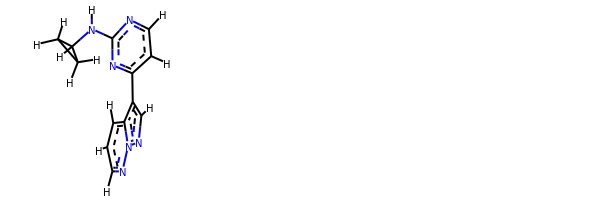

rdkit:  [H]c1nc(N([H])C2([H])C([H])([H])C2([H])[H])nc(-c2c([H])nn3nc([H])c([H])c([H])c23)c1[H]
oechem:  c1cc2c(cnn2nc1)c3ccnc(n3)NC4CC4
###########################################################################
 #########################################################

bond
18.84020893369904 kJ/mol 43731.77389984183 kJ/mol False
angle
67.86074126975575 kJ/mol 69.70276079763222 kJ/mol False
nb
41.28664523339994 kJ/mol 41.28664523339994 kJ/mol True
torsion
81.87112096925428 kJ/mol 81.87112120280538 kJ/mol False
209.858716406109 kJ/mol 43924.63442707567 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5105


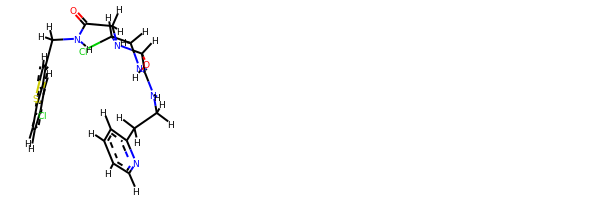

rdkit:  [H]OC1([H])C(N([H])C([H])([H])C([H])([H])c2nc([H])c([H])c([H])c2[H])=NC([H])([H])C([H])(Cl)N1C([H])([H])C(=O)N([H])C([H])([H])c1c([H])sc2c([H])c([H])c(Cl)c([H])c12
oechem:  c1ccnc(c1)CCNC2=NCC(N(C2O)CC(=O)NCc3csc4c3cc(cc4)Cl)Cl
###########################################################################
 #########################################################

bond
26.565510958264657 kJ/mol 58391.278306620625 kJ/mol False
angle
105.61693215336457 kJ/mol 105.61693215336457 kJ/mol True
nb
59.02903005654573 kJ/mol 59.02903005654573 kJ/mol True
torsion
30.667625279068847 kJ/mol 28.147137548859035 kJ/mol False
221.87909844724382 kJ/mol 58584.0714063794 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5106


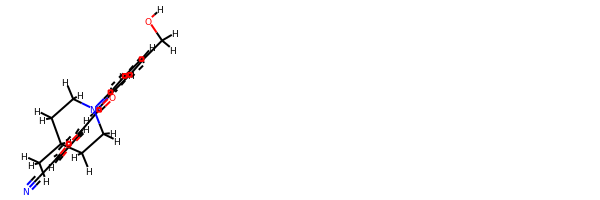

rdkit:  [H]OC([H])([H])c1c([H])c([H])c(N2C([H])([H])C([H])([H])C([H])(C([H])([H])[H])C([H])([H])C2([H])[H])c(N([H])C(=O)c2oc(C#N)c([H])c2[H])c1[H]
oechem:  CC1CCN(CC1)c2ccc(cc2NC(=O)c3ccc(o3)C#N)CO
###########################################################################
 #########################################################

bond
26.72261955082638 kJ/mol 29097.61072324415 kJ/mol False
angle
142.27277215688827 kJ/mol 143.9596772785931 kJ/mol False
nb
46.550283264116665 kJ/mol 46.550283264116665 kJ/mol True
torsion
137.31372568248963 kJ/mol 132.51945267933297 kJ/mol False
352.85940065432095 kJ/mol 29420.64013646619 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5107


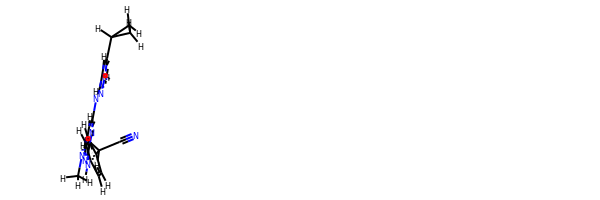

rdkit:  [H]c1c(N([H])c2nn([H])c(C3([H])C([H])([H])C3([H])[H])c2[H])nc(N([H])c2c([H])c([H])c(C([H])([H])C#N)c([H])c2[H])nc1N([H])C([H])([H])[H]
oechem:  CNc1cc(nc(n1)Nc2ccc(cc2)CC#N)Nc3cc([nH]n3)C4CC4
###########################################################################
 #########################################################

bond
20.096978859793282 kJ/mol 43806.902579364956 kJ/mol False
angle
186.3769446788323 kJ/mol 188.5300858235192 kJ/mol False
nb
6.614519746907698 kJ/mol 6.614519746907698 kJ/mol True
torsion
58.207345874664995 kJ/mol 58.207396002686366 kJ/mol False
271.2957891601983 kJ/mol 44060.25458093807 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5108


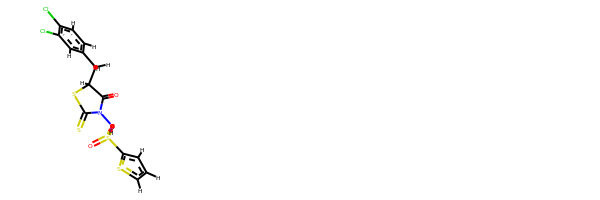

rdkit:  [H]c1sc(S(=O)(=O)N([H])N2C(=O)C([H])(C([H])([H])c3c([H])c([H])c(Cl)c(Cl)c3[H])SC2=S)c([H])c1[H]
oechem:  c1cc(sc1)S(=O)(=O)NN2C(=O)C(SC2=S)Cc3ccc(c(c3)Cl)Cl
###########################################################################
 #########################################################

bond
21.197790094340473 kJ/mol 58002.958685814454 kJ/mol False
angle
400.6574117796915 kJ/mol 400.6574117796915 kJ/mol True
nb
16.284938891534438 kJ/mol 16.284938891534438 kJ/mol True
torsion
69.75046029043953 kJ/mol 45.707265167299916 kJ/mol False
507.89060105600595 kJ/mol 58465.60830165298 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5109


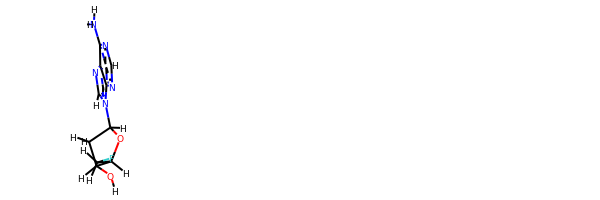

rdkit:  [H]OC1([H])C([H])([H])C([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)OC1([H])C([H])([H])F
oechem:  c1nc(c2c(n1)n(cn2)C3CC(C(O3)CF)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
23.832502028924107 kJ/mol 57877.68220275134 kJ/mol False
angle
401.0129575636238 kJ/mol 401.0129575636238 kJ/mol True
nb
17.20410435469999 kJ/mol 17.20410435469999 kJ/mol True
torsion
82.29195295682918 kJ/mol 61.37054952650436 kJ/mol False
524.341516904077 kJ/mol 58357.26981419617 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
------------------------

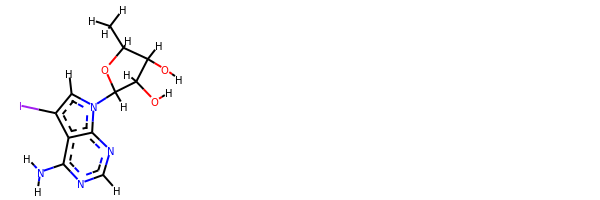

rdkit:  [H]OC1([H])C([H])(n2c([H])c(I)c3c(N([H])[H])nc([H])nc32)OC([H])(C([H])([H])[H])C1([H])O[H]
oechem:  CC1C(C(C(O1)n2cc(c3c2ncnc3N)I)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
24.718032429752228 kJ/mol 56623.91518

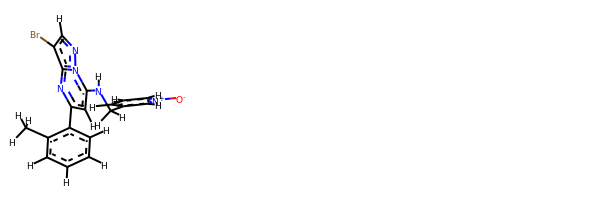

rdkit:  [H]c1nn2c(N([H])C([H])([H])c3c([H])c([H])c([H])[n+]([O-])c3[H])c([H])c(-c3c([H])c([H])c([H])c([H])c3C([H])([H])[H])nc2c1Br
oechem:  Cc1ccccc1c2cc(n3c(n2)c(cn3)Br)NCc4ccc[n+](c4)[O-]
###########################################################################
 #########################################################

bond
39.53106041136689 kJ/mol 57898.2926799001 kJ/mol False
angle
172.75553444228248 kJ/mol 174.14476578919763 kJ/mol False
nb
13.065266318985529 kJ/mol 13.065266318985529 kJ/mol True
torsion
30.820274322035864 kJ/mol 25.727621236388106 kJ/mol False
256.1721354946708 kJ/mol 58111.23033324467 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5119


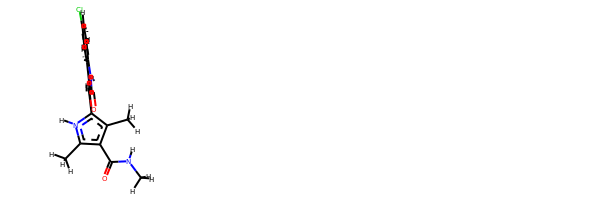

rdkit:  [H]C(=C1C(=O)N([H])c2c([H])c([H])c(Cl)c([H])c21)c1c(C([H])([H])[H])c(C(=O)N([H])C([H])([H])[H])c(C([H])([H])[H])n1[H]
oechem:  Cc1c([nH]c(c1C(=O)NC)C)C=C2c3cc(ccc3NC2=O)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
34.374207900951006 kJ/mol 113624.82475206834 kJ/mol False
angle
31.32217768886196 kJ/mol 31.929995132347376 kJ/mol False
nb
96.35927172751914 kJ/mol 96.35927172751914 kJ/mol True
torsion
84.08264026367848 kJ/mol 29.800514851005243 kJ/mol False
246.1382975810106 kJ/mol 113782.9145337792 kJ/mol

-------------------------------------------------------------------
--------------------------------------------

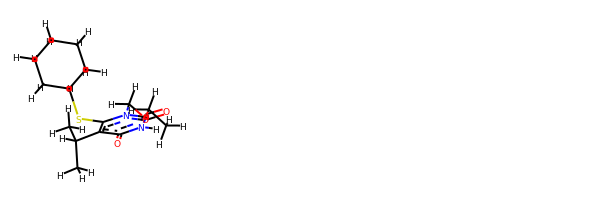

rdkit:  [H]n1c(=O)c(C([H])(C([H])([H])[H])C([H])([H])[H])c(SC2([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C2([H])[H])n(C([H])([H])OC([H])([H])C([H])([H])[H])c1=O
oechem:  CCOCn1c(c(c(=O)[nH]c1=O)C(C)C)SC2CCCCC2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
63.70384516077541 kJ/mol 129137.74398290312 kJ/mol False
angle
338.51895418994377 kJ/mol 343.2103111703752 kJ/mol False
nb
39.83889321591764 kJ/mol 39.83889321591764 kJ/mol True
torsion
32.60726702793911 kJ/mol 21.122042554515488 kJ/mol False
474.66895959457594 kJ/mol 129541.91522984393 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBan

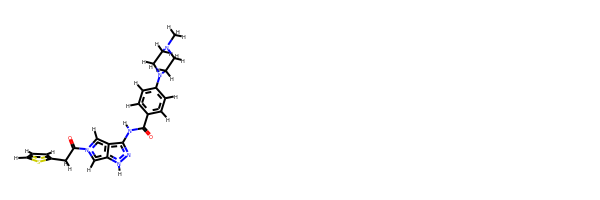

rdkit:  [H]c1sc(C([H])([H])C(=O)n2c([H])c3c(N([H])C(=O)c4c([H])c([H])c(N5C([H])([H])C([H])([H])N(C([H])([H])[H])C([H])([H])C5([H])[H])c([H])c4[H])nn([H])c3c2[H])c([H])c1[H]
oechem:  CN1CCN(CC1)c2ccc(cc2)C(=O)Nc3c4cn(cc4[nH]n3)C(=O)Cc5cccs5
###########################################################################
 #########################################################

bond
19.621159837900176 kJ/mol 87113.62253910645 kJ/mol False
angle
114.55446120193251 kJ/mol 114.88294226675346 kJ/mol False
nb
15.733333106257636 kJ/mol 15.733333106257636 kJ/mol True
torsion
68.30101200754879 kJ/mol 46.335110635558955 kJ/mol False
218.20996615363913 kJ/mol 87290.57392511501 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5126


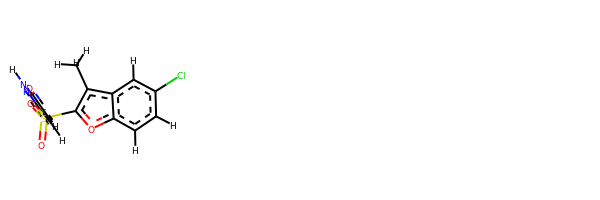

rdkit:  [H]c1c(S(=O)(=O)c2oc3c([H])c([H])c(Cl)c([H])c3c2C([H])([H])[H])nn([H])c(=O)c1[H]
oechem:  Cc1c2cc(ccc2oc1S(=O)(=O)c3ccc(=O)[nH]n3)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
10.707532147559018 kJ/mol 57843.625184

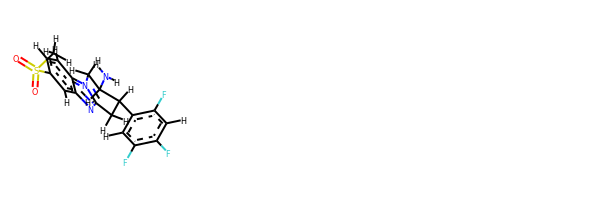

rdkit:  [H]c1c(F)c(F)c([H])c(C2([H])C([H])([H])c3nc4c([H])c(S(=O)(=O)C([H])([H])[H])c([H])c([H])c4n3C([H])([H])C2([H])N([H])[H])c1F
oechem:  CS(=O)(=O)c1ccc2c(c1)nc3n2CC(C(C3)c4cc(c(cc4F)F)F)N
###########################################################################
 #########################################################

bond
21.2774049471269 kJ/mol 43692.58298649327 kJ/mol False
angle
91.09562532873987 kJ/mol 94.45365293555962 kJ/mol False
nb
61.44575746874384 kJ/mol 61.44575746874384 kJ/mol True
torsion
16.6707826121531 kJ/mol 14.157139022123758 kJ/mol False
190.4895703567637 kJ/mol 43862.63953591969 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5133


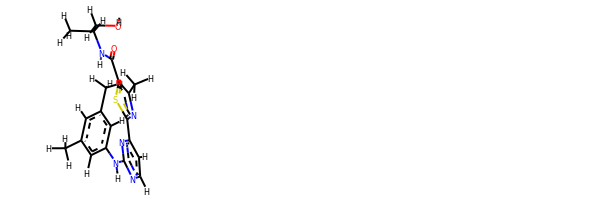

rdkit:  [H]OC([H])([H])C([H])(N([H])C(=O)c1sc(-c2nc(N([H])c3c([H])c(C([H])([H])[H])c([H])c(C([H])([H])[H])c3[H])nc([H])c2[H])nc1C([H])([H])[H])C([H])([H])[H]
oechem:  Cc1cc(cc(c1)Nc2nccc(n2)c3nc(c(s3)C(=O)NC(C)CO)C)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
9.568060921931012 kJ/mol 43795.89836501296 kJ/mol False
angle
34.07228493780555 kJ/mol 36.22519850629493 kJ/mol False
nb
9.69894014796611 kJ/mol 9.69894014796611 kJ/mol True
torsion
20.976446749467062 kJ/mol 20.976740455552992 kJ/mol False
74.31573275716974 kJ/mol 43862.799244122776 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5

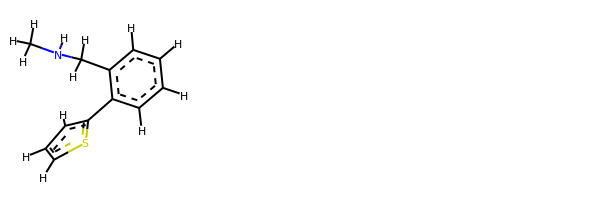

rdkit:  [H]c1sc(-c2c([H])c([H])c([H])c([H])c2C([H])([H])N([H])C([H])([H])[H])c([H])c1[H]
oechem:  CNCc1ccccc1c2cccs2
###########################################################################
 #########################################################

bond
18.302933909190376 kJ/mol 43803.64956347409 kJ/mol False
angle
61.878953160128546 kJ/mol 64.03228816925908 kJ/mol False
nb
15.860076294896333 kJ/mol 15.860076294896333 kJ/mol True
torsion
54.393302890914335 kJ/mol 54.39329821060374 kJ/mol False
150.4352662551296 kJ/mol 43937.93522614885 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5136


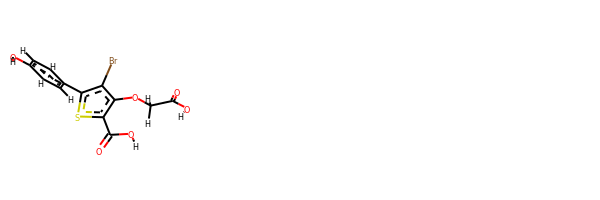

rdkit:  [H]OC(=O)c1sc(-c2c([H])c([H])c(O[H])c([H])c2[H])c(Br)c1OC([H])([H])C(=O)O[H]
oechem:  c1cc(ccc1c2c(c(c(s2)C(=O)O)OCC(=O)O)Br)O
###########################################################################
 #########################################################

bond
11.166206346910887 kJ/mol 58296.039119630725 kJ/mol False
angle
92.38793825180237 kJ/mol 92.38793825180237 kJ/mol True
nb
30.417405896633475 kJ/mol 30.417405896633475 kJ/mol True
torsion
0.0005263884866276523 kJ/mol 0.0005277692254416527 kJ/mol False
133.97207688383335 kJ/mol 58418.84499154838 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5137


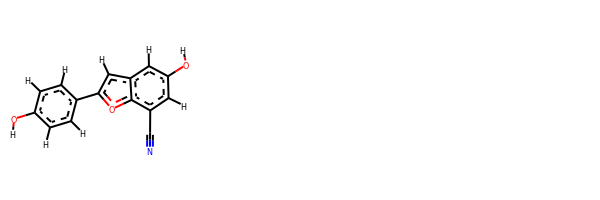

rdkit:  [H]Oc1c([H])c([H])c(-c2oc3c(C#N)c([H])c(O[H])c([H])c3c2[H])c([H])c1[H]
oechem:  c1cc(ccc1c2cc3cc(cc(c3o2)C#N)O)O
###########################################################################
 #########################################################

bond
31.29693274872159 kJ/mol 43702.59082677767 kJ/mol False
angle
372.53806748135014 kJ/mol 375.8944317107836 kJ/mol False
nb
135.207684781256 kJ/mol 135.207684781256 kJ/mol True
torsion
78.50498768461397 kJ/mol 70.797931613787 kJ/mol False
617.5476726959417 kJ/mol 44284.49087488349 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5138


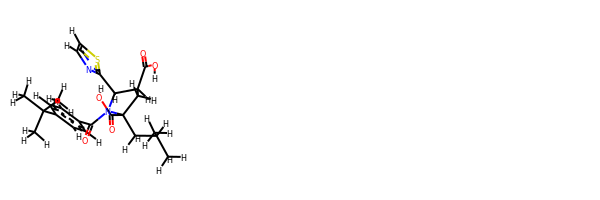

rdkit:  [H]OC(=O)C1([H])C([H])(c2nc([H])c([H])s2)N(C(=O)c2c([H])c([H])c(C(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H])c([H])c2[H])C(C(=O)O[H])(C([H])([H])C([H])(C([H])([H])[H])C([H])([H])[H])C1([H])[H]
oechem:  CC(C)CC1(CC(C(N1C(=O)c2ccc(cc2)C(C)(C)C)c3nccs3)C(=O)O)C(=O)O
###########################################################################
 #########################################################

bond
29.228809251464217 kJ/mol 43817.44695309285 kJ/mol False
angle
364.8896339617371 kJ/mol 367.04164980132407 kJ/mol False
nb
141.53837604240425 kJ/mol 141.53837604240425 kJ/mol True
torsion
94.15853818281809 kJ/mol 86.42378217217853 kJ/mol False
629.8153574384237 kJ/mol 44412.45076110875 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5139


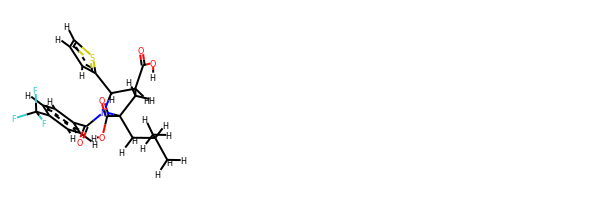

rdkit:  [H]OC(=O)C1([H])C([H])(c2sc([H])c([H])c2[H])N(C(=O)c2c([H])c([H])c(C(F)(F)F)c([H])c2[H])C(C(=O)O[H])(C([H])([H])C([H])(C([H])([H])[H])C([H])([H])[H])C1([H])[H]
oechem:  CC(C)CC1(CC(C(N1C(=O)c2ccc(cc2)C(F)(F)F)c3cccs3)C(=O)O)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
28.087835632797745 kJ/mol 114930.54868013509 kJ/mol False
angle
83.48119880854144 kJ/mol 83.64693443116944 kJ/mol False
nb
24.40204801481117 kJ/mol 24.40204801481117 kJ/mol True
torsion
58.5765022886068 kJ/mol 41.840629418698285 kJ/mol False
194.54758474475716 kJ/mol 115080.43829199977 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-----------------------------------------------------

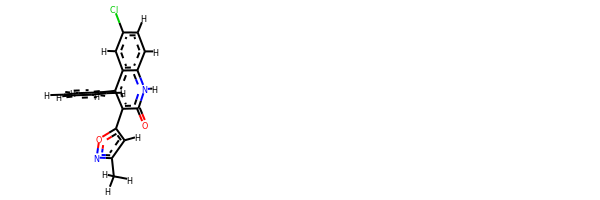

rdkit:  [H]c1c(C([H])([H])[H])noc1-c1c(-c2c([H])c([H])c([H])c([H])c2[H])c2c([H])c(Cl)c([H])c([H])c2n([H])c1=O
oechem:  Cc1cc(on1)c2c(c3cc(ccc3[nH]c2=O)Cl)c4ccccc4
###########################################################################
 #########################################################

bond
16.438002562303407 kJ/mol 57992.422261804095 kJ/mol False
angle
120.14105901811133 kJ/mol 122.16495820215661 kJ/mol False
nb
62.89027984865876 kJ/mol 62.89027984865876 kJ/mol True
torsion
28.586721737873898 kJ/mol 28.586988124046865 kJ/mol False
228.05606316694738 kJ/mol 58206.064487978954 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5142


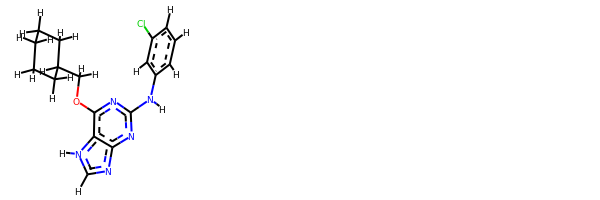

rdkit:  [H]c1c([H])c(Cl)c([H])c(N([H])c2nc(OC([H])([H])C3([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C3([H])[H])c3c(n2)nc([H])n3[H])c1[H]
oechem:  c1cc(cc(c1)Cl)Nc2nc3c(c(n2)OCC4CCCCC4)[nH]cn3
###########################################################################
 #########################################################

bond
17.08056924483919 kJ/mol 57770.1508295116 kJ/mol False
angle
127.4031440511797 kJ/mol 128.63274395231014 kJ/mol False
nb
60.30605703919026 kJ/mol 60.30605703919026 kJ/mol True
torsion
35.961180665888996 kJ/mol 35.961192714753004 kJ/mol False
240.75095100109814 kJ/mol 57995.050823217854 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5143


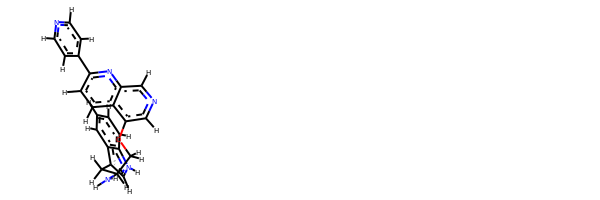

rdkit:  [H]c1nc([H])c([H])c(-c2nc3c([H])nc([H])c(OC([H])([H])C([H])(N([H])[H])C([H])([H])c4c([H])n([H])c5c([H])c([H])c([H])c([H])c45)c3c([H])c2[H])c1[H]
oechem:  c1ccc2c(c1)c(c[nH]2)CC(COc3cncc4c3ccc(n4)c5ccncc5)N
###########################################################################
 #########################################################

bond
29.311435194460376 kJ/mol 58009.566959475924 kJ/mol False
angle
431.2462110876555 kJ/mol 431.2462110876555 kJ/mol True
nb
22.845173749071712 kJ/mol 22.845173749071712 kJ/mol True
torsion
99.199814521607 kJ/mol 75.0980492933191 kJ/mol False
582.6026345527946 kJ/mol 58538.75639360597 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5144


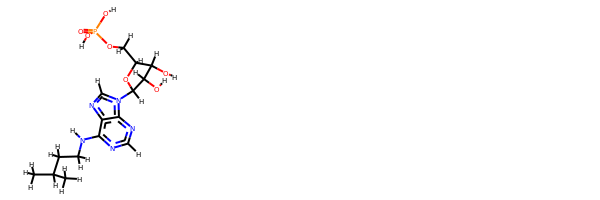

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c(N([H])C([H])([H])C([H])([H])C([H])(C([H])([H])[H])C([H])([H])[H])nc([H])nc32)OC([H])(C([H])([H])OP(=O)(O[H])O[H])C1([H])O[H]
oechem:  CC(C)CCNc1c2c(ncn1)n(cn2)C3C(C(C(O3)COP(=O)(O)O)O)O
###########################################################################
 #########################################################

bond
9.808277759286673 kJ/mol 57761.36186526751 kJ/mol False
angle
88.85122495707576 kJ/mol 90.08077939544138 kJ/mol False
nb
23.854050552770428 kJ/mol 23.854050552770428 kJ/mol True
torsion
0.30392641374432205 kJ/mol 0.3039362751771053 kJ/mol False
122.81747968287718 kJ/mol 57875.6006314909 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5145


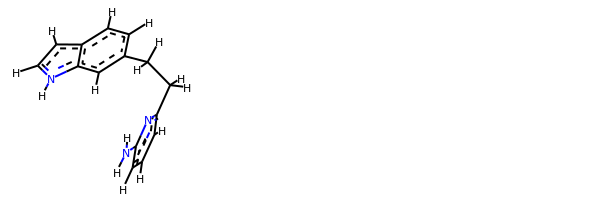

rdkit:  [H]c1c(N([H])[H])nc(C([H])([H])C([H])([H])c2c([H])c([H])c3c([H])c([H])n([H])c3c2[H])c([H])c1[H]
oechem:  c1cc(nc(c1)N)CCc2ccc3cc[nH]c3c2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
24.84436726745383 kJ/mol 56624.04152264808 kJ/mol False
angle
100.64354897343749 kJ/mol 100.64354897343749 kJ/mol True
nb
60.30282550573453 kJ/mol 60.30282550573453 kJ/mol True
torsion
7.312019549993952 kJ/mol 5.17566354904262 kJ/mol False
193.1027612966198 kJ/mol 56790.1635606763 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
----------------

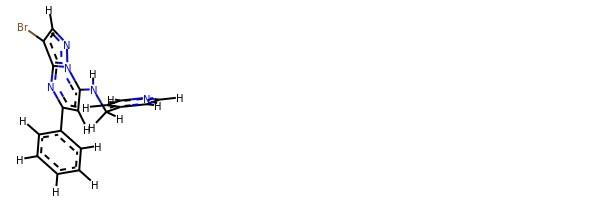

rdkit:  [H]c1nc([H])c([H])c(C([H])([H])N([H])c2c([H])c(-c3c([H])c([H])c([H])c([H])c3[H])nc3c(Br)c([H])nn23)c1[H]
oechem:  c1ccc(cc1)c2cc(n3c(n2)c(cn3)Br)NCc4ccncc4
###########################################################################
 #########################################################

bond
36.766116006479066 kJ/mol 43823.959906305965 kJ/mol False
angle
325.13594076995895 kJ/mol 327.2903202831607 kJ/mol False
nb
40.34388072195152 kJ/mol 40.34388072195152 kJ/mol True
torsion
193.09795825116962 kJ/mol 193.09796055687207 kJ/mol False
595.3438957495592 kJ/mol 44384.692067867945 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5150


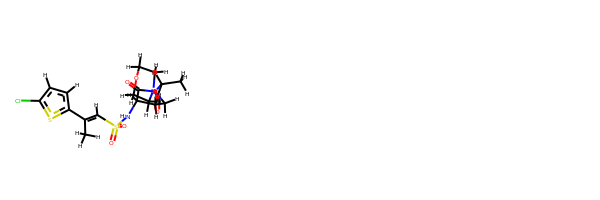

rdkit:  [H]C(=C(c1sc(Cl)c([H])c1[H])C([H])([H])[H])S(=O)(=O)N([H])C1([H])C(=O)N(C([H])(C(=O)N2C([H])([H])C([H])([H])OC([H])([H])C2([H])[H])C([H])([H])[H])C([H])([H])C1([H])[H]
oechem:  CC(C(=O)N1CCOCC1)N2CCC(C2=O)NS(=O)(=O)C=C(C)c3ccc(s3)Cl
###########################################################################
 #########################################################

bond
25.422272152757344 kJ/mol 86730.52933600804 kJ/mol False
angle
255.8175209682629 kJ/mol 258.668928277609 kJ/mol False
nb
21.532570571389435 kJ/mol 21.532570571389435 kJ/mol True
torsion
37.88362091998271 kJ/mol 34.74207422986248 kJ/mol False
340.6559846123924 kJ/mol 87045.4729090869 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5152


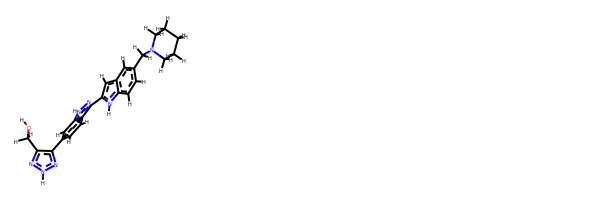

rdkit:  [H]OC([H])([H])c1nn([H])nc1-c1c([H])c([H])c2c(-c3c([H])c4c([H])c(C([H])([H])N5C([H])([H])C([H])([H])C([H])([H])C([H])([H])C5([H])[H])c([H])c([H])c4n3[H])nn([H])c2c1[H]
oechem:  c1cc2c(cc1CN3CCCCC3)cc([nH]2)c4c5ccc(cc5[nH]n4)c6c(n[nH]n6)CO
###########################################################################
 #########################################################

bond
27.145096972998573 kJ/mol 43697.3073541315 kJ/mol False
angle
66.58869531035276 kJ/mol 69.94644389534409 kJ/mol False
nb
75.82886670730724 kJ/mol 75.82886670730724 kJ/mol True
torsion
41.56173610588488 kJ/mol 40.526471105031575 kJ/mol False
211.12439509654345 kJ/mol 43883.609135839186 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5153


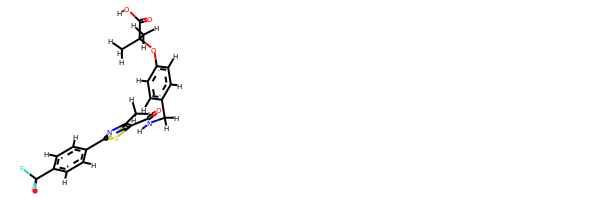

rdkit:  [H]OC(=O)C(Oc1c([H])c([H])c(C([H])([H])N([H])C(=O)c2sc(-c3c([H])c([H])c(C(F)(F)F)c([H])c3[H])nc2C([H])([H])[H])c([H])c1[H])(C([H])([H])[H])C([H])([H])[H]
oechem:  Cc1c(sc(n1)c2ccc(cc2)C(F)(F)F)C(=O)NCc3ccc(cc3)OC(C)(C)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
30.957705748143997 kJ/mol 44009.16681482032 kJ/mol False
angle
58.64192425452323 kJ/mol 60.845976280784114 kJ/mol False
nb
56.15099553072977 kJ/mol 56.15099553072977 kJ/mol True
torsion
10.025500649156722 kJ/mol 7.242142132156321 kJ/mol False
155.77612618255372 kJ/mol 44133.40592876398 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-----------------------------------------------------------

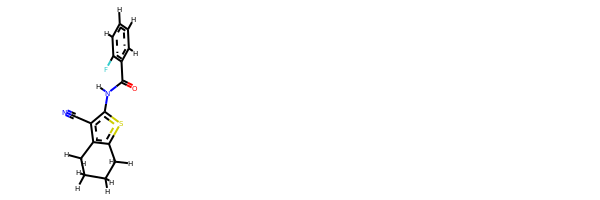

rdkit:  [H]c1c([H])c([H])c(C(=O)N([H])c2sc3c(c2C#N)C([H])([H])C([H])([H])C([H])([H])C3([H])[H])c(F)c1[H]
oechem:  c1ccc(c(c1)C(=O)Nc2c(c3c(s2)CCCC3)C#N)F
###########################################################################
 #########################################################

bond
27.742335092429684 kJ/mol 86341.7077367649 kJ/mol False
angle
102.52105295724918 kJ/mol 102.52105295724918 kJ/mol True
nb
40.99025521046729 kJ/mol 40.99025521046729 kJ/mol True
torsion
5.230780310684661 kJ/mol 0.002683996760218726 kJ/mol False
176.4844235708308 kJ/mol 86485.22172892938 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5156


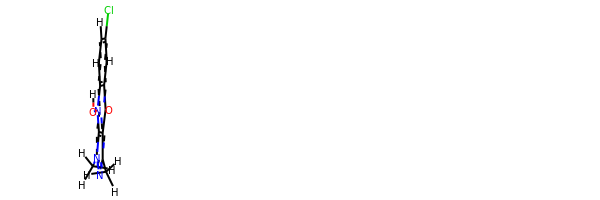

rdkit:  [H]On1c2c([H])c([H])c(Cl)c([H])c2c(=O)c2c(C([H])([H])[H])nn(C([H])([H])[H])c21
oechem:  Cc1c2c(=O)c3cc(ccc3n(c2n(n1)C)O)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
31.011634318410675 kJ/mol 28993.146760315605 kJ/mol False
angle
379.0561687661323 kJ/mol 380.60670075245736 kJ/mol False
nb
42.682552562001234 kJ/mol 42.682552562001234 kJ/mol True
torsion
92.39944925989873 kJ/mol 87.16946956672234 kJ/mol False
545.149804906443 kJ/mol 29503.605483196785 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5158


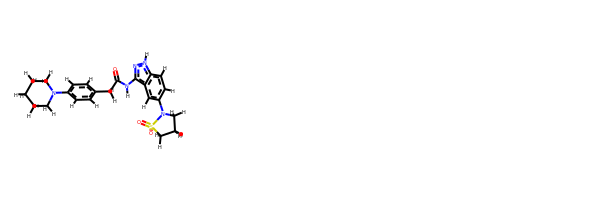

rdkit:  [H]c1c([H])c(C([H])([H])C(=O)N([H])c2nn([H])c3c([H])c([H])c(N4C([H])([H])C([H])([H])C([H])([H])S4(=O)=O)c([H])c23)c([H])c([H])c1N1C([H])([H])C([H])([H])C([H])([H])C([H])([H])C1([H])[H]
oechem:  c1cc(ccc1CC(=O)Nc2c3cc(ccc3[nH]n2)N4CCCS4(=O)=O)N5CCCCC5
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

#############################################################

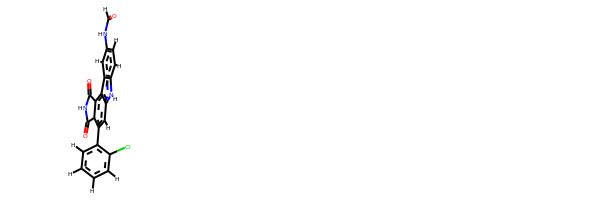

rdkit:  [H]C(=O)N([H])c1c([H])c([H])c2c(c1[H])c1c3c(c(-c4c([H])c([H])c([H])c([H])c4Cl)c([H])c1n2[H])C(=O)N([H])C3=O
oechem:  c1ccc(c(c1)c2cc3c(c4cc(ccc4[nH]3)NC=O)c5c2C(=O)NC5=O)Cl
###########################################################################
 #########################################################

bond
26.00736158147842 kJ/mol 58047.272859179575 kJ/mol False
angle
93.69086952421421 kJ/mol 93.69086952421421 kJ/mol True
nb
36.728435361490845 kJ/mol 36.728435361490845 kJ/mol True
torsion
68.74261633199761 kJ/mol 27.48406660260984 kJ/mol False
225.1692827991811 kJ/mol 58205.17623066789 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5165


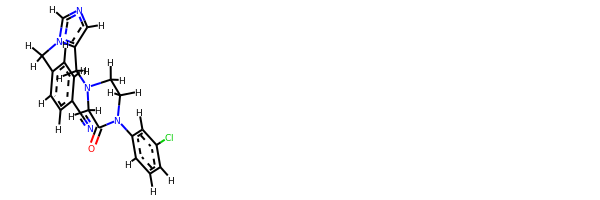

rdkit:  [H]c1nc([H])n(C([H])([H])c2c([H])c([H])c(C#N)c([H])c2[H])c1C([H])([H])N1C([H])([H])C(=O)N(c2c([H])c([H])c([H])c(Cl)c2[H])C([H])([H])C1([H])[H]
oechem:  c1cc(cc(c1)Cl)N2CCN(CC2=O)Cc3cncn3Cc4ccc(cc4)C#N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
38.668299214307446 kJ/mol 57791.63286691652 kJ/mol False
angle
79.86078455009523 kJ/mol 81.09459889323516 kJ/mol False
nb
72.20904592840769 kJ/mol 72.20904592840769 kJ/mol True
torsion
53.35655682270629 kJ/mol 53.35656810299562 kJ/mol False
244.09468651551668 kJ/mol 57998.29307984116 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5167


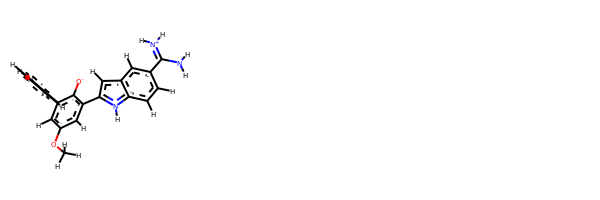

rdkit:  [H]c1c([H])c([H])c(-c2c([H])c(OC([H])([H])[H])c([H])c(-c3c([H])c4c([H])c(C(N([H])[H])=[N+]([H])[H])c([H])c([H])c4n3[H])c2[O-])c([H])c1[H]
oechem:  COc1cc(c(c(c1)c2cc3cc(ccc3[nH]2)C(=[NH2+])N)[O-])c4ccccc4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
11.656610074408627 kJ/mol 57927.88479629199 kJ/mol False
angle
361.6087336889406 kJ/mol 363.51289284040985 kJ/mol False
nb
19.986121948436878 kJ/mol 19.986121948436878 kJ/mol True
torsion
64.86629345784456 kJ/mol 56.228634220522 kJ/mol False
458.1177591696307 kJ/mol 58367.612445301354 kJ/mol

-------------------------------------------------------------------
------------

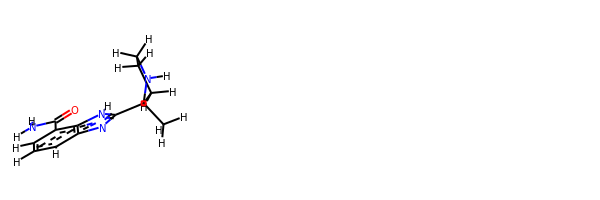

rdkit:  [H]c1c([H])c(C(=O)N([H])[H])c2c(nc(C3(C([H])([H])[H])N([H])C([H])([H])C([H])([H])C3([H])[H])n2[H])c1[H]
oechem:  CC1(CCCN1)c2[nH]c3c(cccc3n2)C(=O)N
###########################################################################
 #########################################################

bond
20.076535701477276 kJ/mol 57771.79152604598 kJ/mol False
angle
125.23982372350127 kJ/mol 126.46933450312585 kJ/mol False
nb
5.090992488997525 kJ/mol 5.090992488997525 kJ/mol True
torsion
94.89564825423169 kJ/mol 94.89565946021561 kJ/mol False
245.30300016820775 kJ/mol 57998.24751249832 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5171


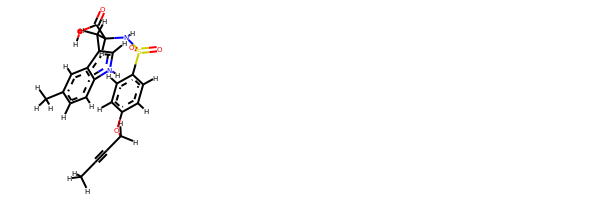

rdkit:  [H]OC(=O)C([H])(N([H])S(=O)(=O)c1c([H])c([H])c(OC([H])([H])C#CC([H])([H])[H])c([H])c1[H])C([H])([H])c1c([H])n([H])c2c([H])c([H])c(C([H])([H])[H])c([H])c12
oechem:  CC#CCOc1ccc(cc1)S(=O)(=O)NC(Cc2c[nH]c3c2cc(cc3)C)C(=O)O
###########################################################################
 #########################################################

bond
34.095462231007836 kJ/mol 60.75860163000353 kJ/mol False
angle
534.419916388642 kJ/mol 534.419916388642 kJ/mol True
nb
23.197849328150014 kJ/mol 23.197849328150014 kJ/mol True
torsion
21.44285963555147 kJ/mol 21.442883061714067 kJ/mol False
613.1560875833513 kJ/mol 639.8192504085097 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5172


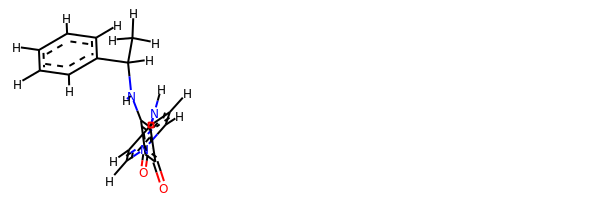

rdkit:  [H]c1nc([H])c([H])c(N([H])c2c(N([H])C([H])(c3c([H])c([H])c([H])c([H])c3[H])C([H])([H])[H])c(=O)c2=O)c1[H]
oechem:  CC(c1ccccc1)Nc2c(c(=O)c2=O)Nc3ccncc3
###########################################################################
 #########################################################

bond
23.443876085643623 kJ/mol 43813.76184457915 kJ/mol False
angle
84.98807138111162 kJ/mol 87.13976741085604 kJ/mol False
nb
54.39903810918975 kJ/mol 54.39903810918975 kJ/mol True
torsion
21.025229703563728 kJ/mol 18.511115600736403 kJ/mol False
183.85621527950872 kJ/mol 43973.81176569993 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5173


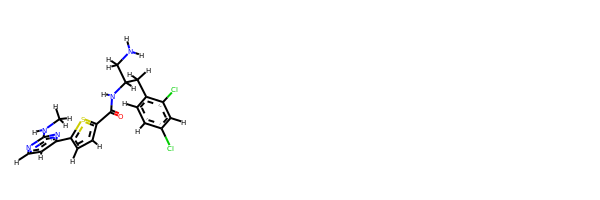

rdkit:  [H]c1nc(N([H])C([H])([H])[H])nc(-c2sc(C(=O)N([H])C([H])(C([H])([H])c3c([H])c([H])c(Cl)c([H])c3Cl)C([H])([H])N([H])[H])c([H])c2[H])c1[H]
oechem:  CNc1nccc(n1)c2ccc(s2)C(=O)NC(Cc3ccc(cc3Cl)Cl)CN
###########################################################################
 #########################################################

bond
12.072489694672774 kJ/mol 57651.343876761515 kJ/mol False
angle
83.85572506615304 kJ/mol 83.85572506615304 kJ/mol True
nb
33.7531907459087 kJ/mol 33.7531907459087 kJ/mol True
torsion
6.274482596015207 kJ/mol 15.685815792976658 kJ/mol False
135.95588810274973 kJ/mol 57784.63860836655 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5174


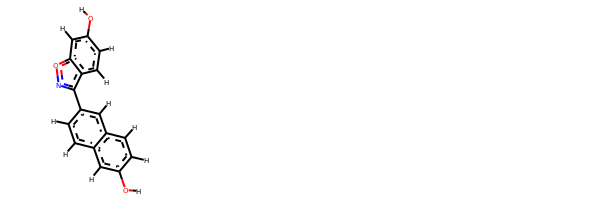

rdkit:  [H]Oc1c([H])c([H])c2c(-c3c([H])c([H])c4c([H])c(O[H])c([H])c([H])c4c3[H])noc2c1[H]
oechem:  c1cc(cc2c1cc(cc2)O)c3c4ccc(cc4on3)O
###########################################################################
 #########################################################

bond
20.0279496718402 kJ/mol 43806.961497232085 kJ/mol False
angle
325.9415073142059 kJ/mol 328.0946244062962 kJ/mol False
nb
42.049934115655184 kJ/mol 42.049934115655184 kJ/mol True
torsion
69.36580474016019 kJ/mol 69.36583978510579 kJ/mol False
457.38519584186145 kJ/mol 44246.471895539136 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5175


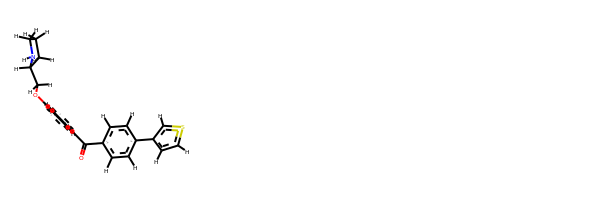

rdkit:  [H]c1sc([H])c(-c2c([H])c([H])c(C(=O)c3c([H])c([H])c(OC([H])([H])C4([H])N([H])C([H])([H])C([H])([H])C4([H])[H])c([H])c3[H])c([H])c2[H])c1[H]
oechem:  c1cc(ccc1c2ccsc2)C(=O)c3ccc(cc3)OCC4CCCN4
###########################################################################
 #########################################################

bond
32.08200210989356 kJ/mol 58317.73485671375 kJ/mol False
angle
121.41653824262727 kJ/mol 121.41653824262727 kJ/mol True
nb
14.376067421536726 kJ/mol 14.376067421536726 kJ/mol True
torsion
215.6964713953211 kJ/mol 210.59495188264094 kJ/mol False
383.57107916937866 kJ/mol 58664.12241426056 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5176


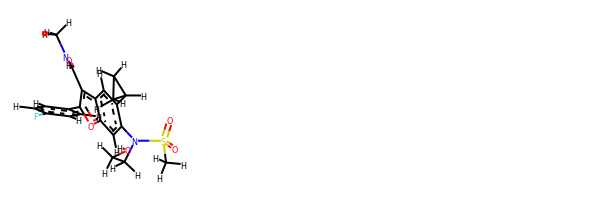

rdkit:  [H]OC([H])([H])C([H])([H])N(c1c(C2([H])C([H])([H])C2([H])[H])c([H])c2c(C(=O)N([H])C([H])([H])[H])c(-c3c([H])c([H])c(F)c([H])c3[H])oc2c1[H])S(=O)(=O)C([H])([H])[H]
oechem:  CNC(=O)c1c2cc(c(cc2oc1c3ccc(cc3)F)N(CCO)S(=O)(=O)C)C4CC4
###########################################################################
 #########################################################

bond
6.304498778710814 kJ/mol 57921.416570432775 kJ/mol False
angle
102.96351187609305 kJ/mol 102.96351187609305 kJ/mol True
nb
48.51113154023124 kJ/mol 48.51113154023124 kJ/mol True
torsion
25.89719090210434 kJ/mol 25.89720182331265 kJ/mol False
183.67633309713943 kJ/mol 58098.78841567241 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5177


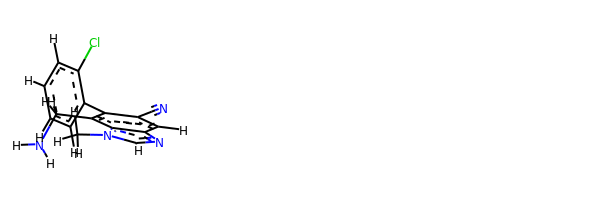

rdkit:  [H]c1c([H])c([H])c(-c2c(C#N)c([H])c3nc([H])n(C([H])([H])[H])c3c2C([H])([H])N([H])[H])c(Cl)c1[H]
oechem:  Cn1cnc2c1c(c(c(c2)C#N)c3ccccc3Cl)CN
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
27.46149797823592 kJ/mol 172045.16042801662 kJ/mol False
angle
415.4425649011276 kJ/mol 425.58324082894023 kJ/mol False
nb
25.10578415295822 kJ/mol 25.10578415295822 kJ/mol True
torsion
25.73282940861614 kJ/mol 8.369053319951039 kJ/mol False
493.7426764409379 kJ/mol 172504.21850631846 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5179


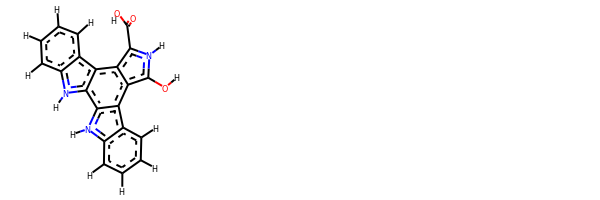

rdkit:  [H]OC(=O)c1c2c(c(O[H])n1[H])c1c3c([H])c([H])c([H])c([H])c3n([H])c1c1c2c2c([H])c([H])c([H])c([H])c2n1[H]
oechem:  c1ccc2c(c1)c3c4c(c5c6ccccc6[nH]c5c3[nH]2)c([nH]c4C(=O)O)O
###########################################################################
 #########################################################

bond
23.011608402890946 kJ/mol 57763.631188691164 kJ/mol False
angle
120.10596070066705 kJ/mol 120.10596070066705 kJ/mol True
nb
66.20557030104561 kJ/mol 66.20557030104561 kJ/mol True
torsion
51.19253991513146 kJ/mol 50.54636828876673 kJ/mol False
260.51567931973506 kJ/mol 58000.489087981645 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5180


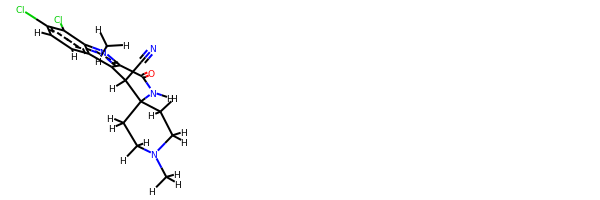

rdkit:  [H]c1c(Cl)c(Cl)c2c(c1[H])c1c(n2C([H])([H])[H])C(=O)N([H])C2(C1([H])C#N)C([H])([H])C([H])([H])N(C([H])([H])[H])C([H])([H])C2([H])[H]
oechem:  Cn1c2c(ccc(c2Cl)Cl)c3c1C(=O)NC4(C3C#N)CCN(CC4)C
###########################################################################
 #########################################################

bond
14.155142145343667 kJ/mol 57873.03149962724 kJ/mol False
angle
471.14005475385073 kJ/mol 472.52021228127614 kJ/mol False
nb
44.22361214875414 kJ/mol 44.22361214875414 kJ/mol True
torsion
85.91958328770887 kJ/mol 85.91963068201511 kJ/mol False
615.4383923356575 kJ/mol 58475.69495473929 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5181


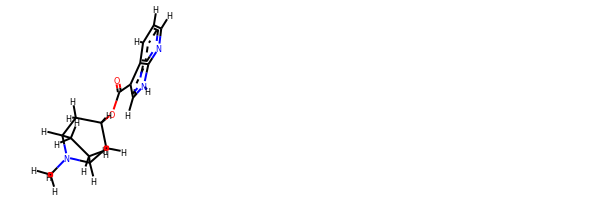

rdkit:  [H]c1nc2c(c([H])c1[H])c(C(=O)OC1([H])C([H])([H])C3([H])N(C([H])([H])[H])C([H])(C([H])([H])C3([H])[H])C1([H])[H])c([H])n2[H]
oechem:  CN1C2CCC1CC(C2)OC(=O)c3c[nH]c4c3cccn4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
18.00618021882451 kJ/mol 57772.15646217128 kJ/mol False
angle
97.57823441713876 kJ/mol 98.82244992881267 kJ/mol False
nb
35.81073526875943 kJ/mol 35.81073526875943 kJ/mol True
torsion
63.813353215683065 kJ/mol 63.81338114343707 kJ/mol False
215.20850312040577 kJ/mol 57970

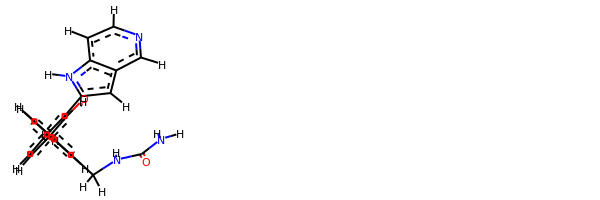

rdkit:  [H]Oc1c(-c2c([H])c([H])c([H])c(C([H])([H])N([H])C(=O)N([H])[H])c2[H])c([H])c([H])c([H])c1-c1c([H])c2c([H])nc([H])c([H])c2n1[H]
oechem:  c1cc(cc(c1)c2cccc(c2O)c3cc4cnccc4[nH]3)CNC(=O)N
###########################################################################
 #########################################################

bond
32.82981362271357 kJ/mol 57889.0594580612 kJ/mol False
angle
133.92650400085245 kJ/mol 133.92650400085245 kJ/mol True
nb
92.7185357183569 kJ/mol 92.7185357183569 kJ/mol True
torsion
57.95330014137688 kJ/mol 57.953372691251495 kJ/mol False
317.4281534832998 kJ/mol 58173.65787047166 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5186


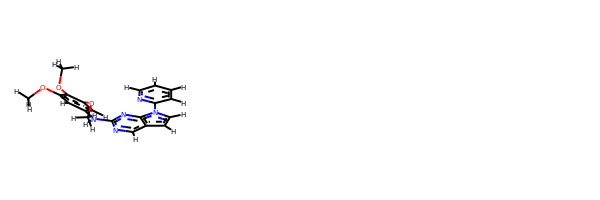

rdkit:  [H]c1nc(-n2c([H])c([H])c3c([H])nc(N([H])c4c([H])c(OC([H])([H])[H])c(OC([H])([H])[H])c(OC([H])([H])[H])c4[H])nc32)c([H])c([H])c1[H]
oechem:  COc1cc(cc(c1OC)OC)Nc2ncc3ccn(c3n2)c4ccccn4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ####################################################

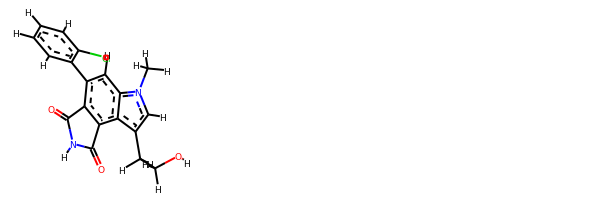

rdkit:  [H]OC([H])([H])C([H])([H])c1c([H])n(C([H])([H])[H])c2c([H])c(-c3c([H])c([H])c([H])c([H])c3Cl)c3c(c12)C(=O)N([H])C3=O
oechem:  Cn1cc(c2c1cc(c3c2C(=O)NC3=O)c4ccccc4Cl)CCO
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
9.275871304325833 kJ/mol 43797.431162482964 kJ/mol False
angle
52.5090660509302 kJ/mol 54.66303805427871 kJ/mol False
nb
11.152544992789904 kJ/mol 11.152544992789904 kJ/mol True
torsion
20.70374510552304 kJ/mol 20.704036374787083 kJ/mol False
93.64122745356897 kJ/mol 43883.950781904816 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5197


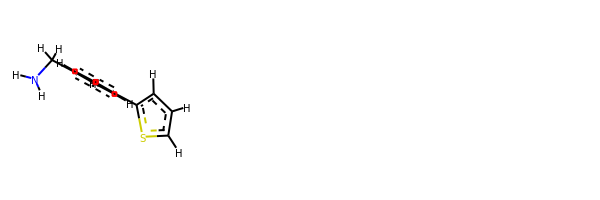

rdkit:  [H]c1sc(-c2c([H])c([H])c(C([H])([H])N([H])[H])c([H])c2[H])c([H])c1[H]
oechem:  c1cc(sc1)c2ccc(cc2)CN
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
20.468912949134523 kJ/mol 43768.338657568485 kJ/mol False
angle
343.86264466951496 kJ/mol 345.7719185344828 kJ/mol False
nb
20.939899831570067 kJ/mol 20.939899831570067 kJ/mol True
torsion
124.83428067527886 kJ/mol 124.83428323920835 kJ/mol False
510.1057381254984 kJ/mol 44259.88475917374 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5199


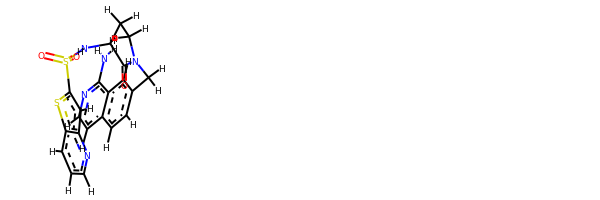

rdkit:  [H]c1nc2c([H])c(S(=O)(=O)N([H])C3([H])C(=O)N(C([H])([H])c4c([H])c([H])c5c([H])c([H])nc(N([H])[H])c5c4[H])C([H])([H])C3([H])[H])sc2c([H])c1[H]
oechem:  c1cc2c(cc(s2)S(=O)(=O)NC3CCN(C3=O)Cc4ccc5ccnc(c5c4)N)nc1
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
31.15992837970468 kJ/mol 86958.04383238475 kJ/mol False
angle
174.28877549852757 kJ/mol 177.29480814761231 kJ/mol False
nb
11.117325333509783 kJ/mol 11.117325333509783 kJ/mol True
torsion
42.59172348588961 kJ/mol 40.49143114206818 kJ/mol False
259.1577526976317 kJ/mol 87186.94739700794 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank

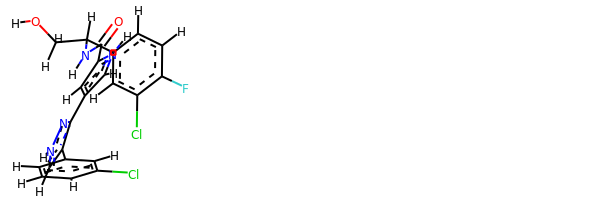

rdkit:  [H]OC([H])([H])C([H])(c1c([H])c([H])c(F)c(Cl)c1[H])N([H])C(=O)c1c([H])c(-c2nn([H])c([H])c2-c2c([H])c([H])c([H])c(Cl)c2[H])c([H])n1[H]
oechem:  c1cc(cc(c1)Cl)c2c[nH]nc2c3cc([nH]c3)C(=O)NC(CO)c4ccc(c(c4)Cl)F
###########################################################################
 #########################################################

bond
13.449535282108169 kJ/mol 57752.72933019879 kJ/mol False
angle
221.49925312341895 kJ/mol 221.49925312341895 kJ/mol True
nb
27.135708711069753 kJ/mol 27.135708711069753 kJ/mol True
torsion
21.012755638283146 kJ/mol 21.012867763353373 kJ/mol False
283.09725275488006 kJ/mol 58022.377159796626 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5203


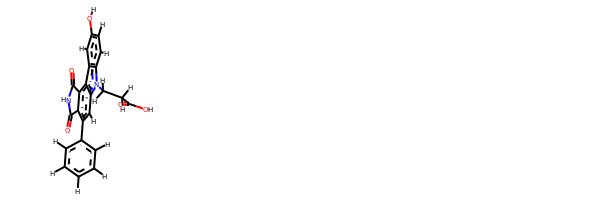

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])n1c2c([H])c([H])c(O[H])c([H])c2c2c3c(c(-c4c([H])c([H])c([H])c([H])c4[H])c([H])c21)C(=O)N([H])C3=O
oechem:  c1ccc(cc1)c2cc3c(c4cc(ccc4n3CCC(=O)O)O)c5c2C(=O)NC5=O
###########################################################################
 #########################################################

bond
29.050333775581354 kJ/mol 86713.87622539504 kJ/mol False
angle
342.1649974010303 kJ/mol 344.9831031269778 kJ/mol False
nb
4.138749323404244 kJ/mol 4.138749323404244 kJ/mol True
torsion
11.28056574326745 kJ/mol 6.05709696862596 kJ/mol False
386.6346462432833 kJ/mol 87069.05517481404 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5204


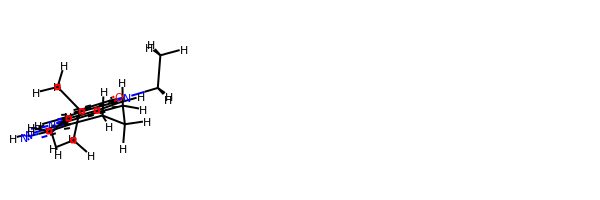

rdkit:  [H]c1c2c(c([H])c3c1c1c(n3[H])-c3c(c(C([H])([H])[H])nn3[H])C([H])([H])C([H])([H])C1([H])[H])C(C([H])([H])[H])(C([H])([H])[H])C(=O)N2C([H])([H])C([H])([H])[H]
oechem:  CCN1c2cc3c(cc2C(C1=O)(C)C)[nH]c-4c3CCCc5c4[nH]nc5C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
29.524637639649463 kJ/mol 58174.42419651792 kJ/mol False
angle
102.012028284228 kJ/mol 102.012028284228 kJ/mol True
nb
49.813769964090696 kJ/mol 49.813769964090696 kJ/mol True
torsion
113.97057859752957 kJ/mol 97.2345747899068

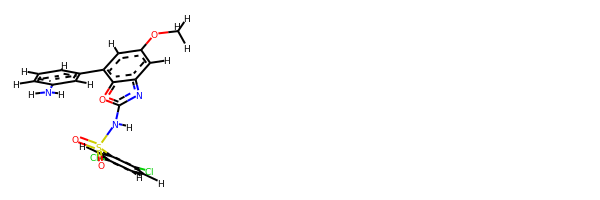

rdkit:  [H]c1c([H])c(-c2c([H])c(OC([H])([H])[H])c([H])c3nc(N([H])S(=O)(=O)c4c([H])c(Cl)c([H])c([H])c4Cl)oc23)c([H])c(N([H])[H])c1[H]
oechem:  COc1cc(c2c(c1)nc(o2)NS(=O)(=O)c3cc(ccc3Cl)Cl)c4cccc(c4)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
30.402311032111363 kJ/mol 56102.869539771236 kJ/mol False
angle
41.09441652645476 kJ/mol 41.09441652645476 kJ/mol Tr

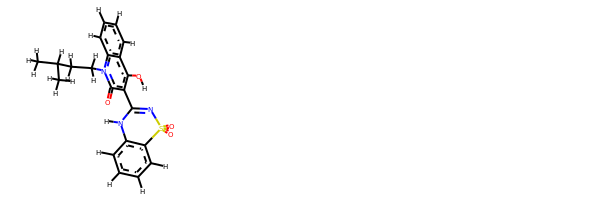

rdkit:  [H]Oc1c(C2=NS(=O)(=O)c3c([H])c([H])c([H])c([H])c3N2[H])c(=O)n(C([H])([H])C([H])([H])C([H])(C([H])([H])[H])C([H])([H])[H])c2c([H])c([H])c([H])c([H])c12
oechem:  CC(C)CCn1c2ccccc2c(c(c1=O)C3=NS(=O)(=O)c4ccccc4N3)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
34.71229244271372 kJ/mol 43824.99795882209 kJ/mol False
angle
330.66509012854806 kJ/mol 332.8158628607534 kJ/mol False
nb
33.99539302453361 kJ/mol 33.99539302453361 kJ/mol True
torsion
140.10797439858666 kJ/mol 134.4991041992688 kJ/mol False
539.4807499943821 kJ/mol 44326.308318906646 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugB

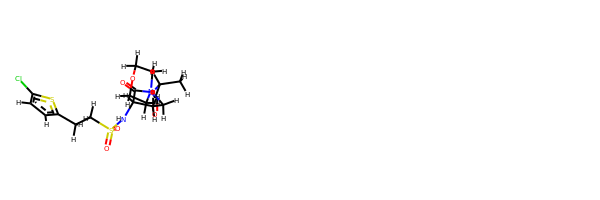

rdkit:  [H]c1c(Cl)sc(C([H])([H])C([H])([H])S(=O)(=O)N([H])C2([H])C(=O)N(C([H])(C(=O)N3C([H])([H])C([H])([H])OC([H])([H])C3([H])[H])C([H])([H])[H])C([H])([H])C2([H])[H])c1[H]
oechem:  CC(C(=O)N1CCOCC1)N2CCC(C2=O)NS(=O)(=O)CCc3ccc(s3)Cl
###########################################################################
 #########################################################

bond
35.67215795167785 kJ/mol 43821.94857588577 kJ/mol False
angle
322.7160285583466 kJ/mol 324.87079370413886 kJ/mol False
nb
37.832536168386234 kJ/mol 37.832536168386234 kJ/mol True
torsion
177.54367197525502 kJ/mol 177.54367483155178 kJ/mol False
573.7643946536657 kJ/mol 44362.195580589854 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5216


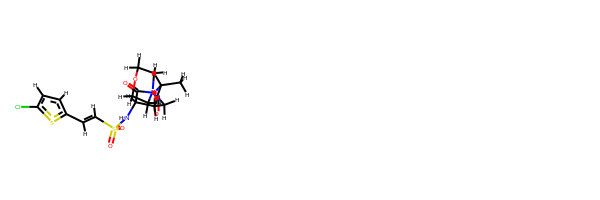

rdkit:  [H]C(=C([H])S(=O)(=O)N([H])C1([H])C(=O)N(C([H])(C(=O)N2C([H])([H])C([H])([H])OC([H])([H])C2([H])[H])C([H])([H])[H])C([H])([H])C1([H])[H])c1sc(Cl)c([H])c1[H]
oechem:  CC(C(=O)N1CCOCC1)N2CCC(C2=O)NS(=O)(=O)C=Cc3ccc(s3)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
9.35118708525978 kJ/mol 57804.25648542887 kJ/mol False
angle
119.3162604812242 kJ/mol 11

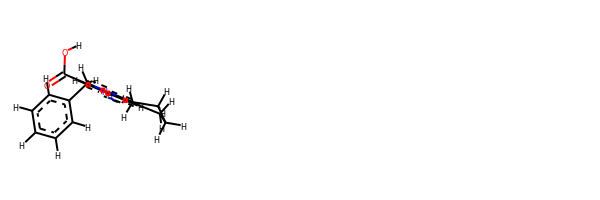

rdkit:  [H]OC(=O)c1c([H])c([H])c([H])c2c3c(n(C([H])([H])c4c([H])c([H])c([H])c([H])c4[H])c12)C([H])([H])C([H])([H])C([H])([H])C3([H])[H]
oechem:  c1ccc(cc1)Cn2c3c(c4c2c(ccc4)C(=O)O)CCCC3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

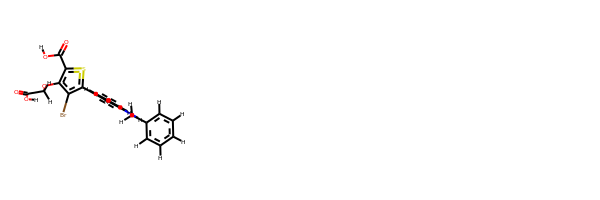

rdkit:  [H]OC(=O)c1sc(-c2c([H])c([H])c([H])c(N([H])C([H])([H])c3c([H])c([H])c([H])c([H])c3[H])c2[H])c(Br)c1OC([H])([H])C(=O)O[H]
oechem:  c1ccc(cc1)CNc2cccc(c2)c3c(c(c(s3)C(=O)O)OCC(=O)O)Br
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
13.038340132644793 kJ/mol 29082.14997190715 kJ/mol False
angle
90.68415348752616 kJ/mol 90.68415348752616 kJ/mol True
nb
11.90212673153162 kJ/mol 11.90212673153162 kJ/mol True
torsion
21.0715049276657 kJ/mol 15.841511127383244 kJ/mol False
136.69612527936826 kJ/mol 29200.577763253594 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5229


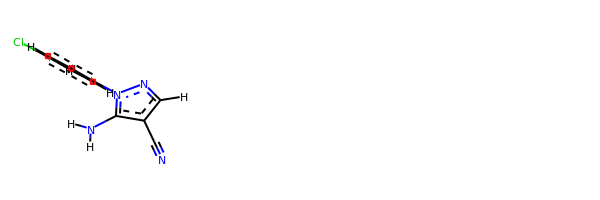

rdkit:  [H]c1nn(-c2c([H])c([H])c(Cl)c([H])c2[H])c(N([H])[H])c1C#N
oechem:  c1cc(ccc1n2c(c(cn2)C#N)N)Cl
###########################################################################
 #########################################################

bond
6.924779142540534 kJ/mol 43677.30773968765 kJ/mol False
angle
35.21391508794105 kJ/mol 38.57056710330916 kJ/mol False
nb
17.148838458132513 kJ/mol 17.148838458132513 kJ/mol True
torsion
22.189891969820955 kJ/mol 5.360831950369206 kJ/mol False
81.47742465843505 kJ/mol 43738.387977199454 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5230


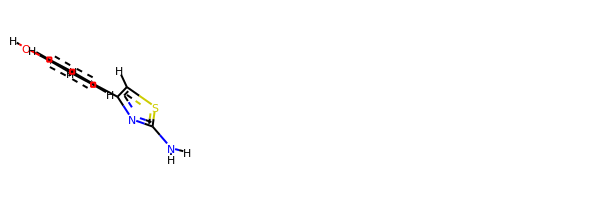

rdkit:  [H]Oc1c([H])c([H])c(-c2nc(N([H])[H])sc2[H])c([H])c1[H]
oechem:  c1cc(ccc1c2csc(n2)N)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
14.314585304337712 kJ/mol 58269.33787246651 kJ/mol False
angle
124.29822293398831 kJ/mol 124.29822293398831 kJ/mol True
nb
41.329547903478385 kJ/mol 41.329547903478385 kJ/mol True
torsion
57.23735352190291 kJ/mol 57.23736

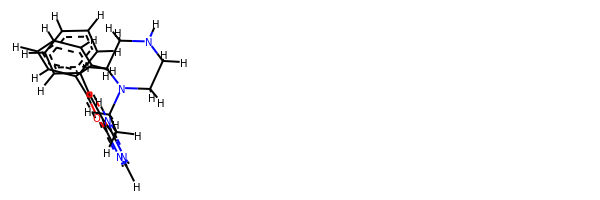

rdkit:  [H]c1nc(N([H])C([H])([H])C([H])([H])N2C([H])([H])C([H])([H])N([H])C([H])([H])C2([H])[H])c2c(-c3c([H])c([H])c([H])c([H])c3[H])c(-c3c([H])c([H])c([H])c([H])c3[H])oc2n1
oechem:  c1ccc(cc1)c2c3c(ncnc3oc2c4ccccc4)NCCN5CCNCC5
###########################################################################
 #########################################################

bond
17.400679094742145 kJ/mol 43993.71222427043 kJ/mol False
angle
75.65611578288812 kJ/mol 77.76745496946114 kJ/mol False
nb
22.725260851132138 kJ/mol 22.725260851132138 kJ/mol True
torsion
33.47340410421178 kJ/mol 33.473438953520294 kJ/mol False
149.2554598329742 kJ/mol 44127.67837904455 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5236


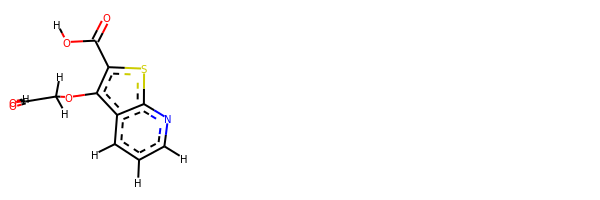

rdkit:  [H]OC(=O)c1sc2nc([H])c([H])c([H])c2c1OC([H])([H])C(=O)O[H]
oechem:  c1cc2c(c(sc2nc1)C(=O)O)OCC(=O)O
###########################################################################
 #########################################################

bond
21.330993135073808 kJ/mol 43693.52331383898 kJ/mol False
angle
73.98263750473636 kJ/mol 77.33898475352422 kJ/mol False
nb
27.57881115665523 kJ/mol 27.57881115665523 kJ/mol True
torsion
53.203239529049064 kJ/mol 53.20329825213674 kJ/mol False
176.09568132551448 kJ/mol 43851.644408001295 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5237


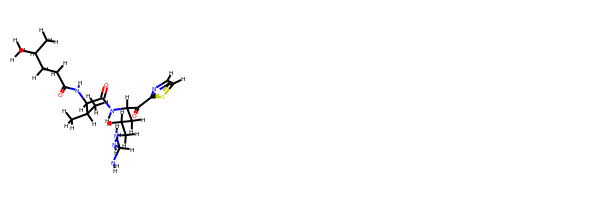

rdkit:  [H]c1nc(C(=O)C([H])(N([H])C(=O)C([H])(N([H])C(=O)C([H])([H])C([H])([H])C([H])(C([H])([H])[H])C([H])([H])[H])C([H])(C([H])([H])[H])C([H])([H])[H])C([H])([H])C([H])([H])C([H])([H])N([H])C([H])(N([H])[H])N([H])[H])sc1[H]
oechem:  CC(C)CCC(=O)NC(C(C)C)C(=O)NC(CCCNC(N)N)C(=O)c1nccs1
###########################################################################
 #########################################################

bond
33.632237581700174 kJ/mol 58056.432505423574 kJ/mol False
angle
107.53617245885853 kJ/mol 107.53617245885853 kJ/mol True
nb
66.49102652347045 kJ/mol 66.49102652347045 kJ/mol True
torsion
47.36216552361738 kJ/mol 47.3621902253413 kJ/mol False
255.02160208764656 kJ/mol 58277.82189463125 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5238


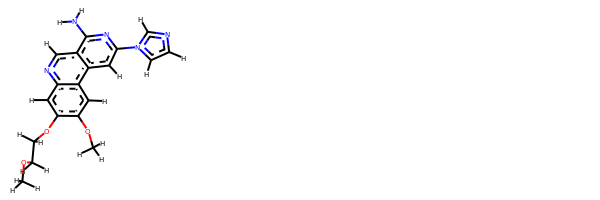

rdkit:  [H]c1nc([H])n(-c2nc(N([H])[H])c3c([H])nc4c([H])c(OC([H])([H])C([H])([H])OC([H])([H])[H])c(OC([H])([H])[H])c([H])c4c3c2[H])c1[H]
oechem:  COCCOc1cc2c(cc1OC)c3cc(nc(c3cn2)N)n4ccnc4
###########################################################################
 #########################################################

bond
1.9571277173232797 kJ/mol 57667.655542373 kJ/mol False
angle
106.7529361851736 kJ/mol 107.82489574089831 kJ/mol False
nb
22.213857269710665 kJ/mol 22.213857269710665 kJ/mol True
torsion
0.0002780750819965231 kJ/mol 0.0003110434008677007 kJ/mol False
130.92419924728952 kJ/mol 57797.69460642701 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5239


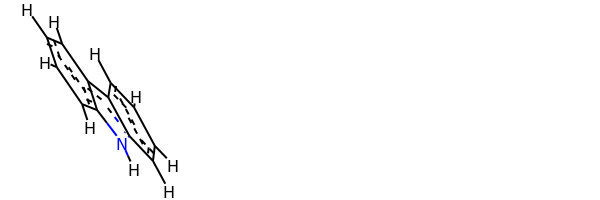

rdkit:  [H]c1c([H])c([H])c2c(c1[H])c1c([H])c([H])c([H])c([H])c1n2[H]
oechem:  c1ccc2c(c1)c3ccccc3[nH]2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
23.366659737709256 kJ/mol 58391.22792536936 kJ/mol False
angle
105.86000652935326 kJ/mol 105.86000652935326 kJ/mol True
nb
30.85220280366253 kJ/mol 30.85220280366253 kJ/mol True
torsion
26.072733522975785 kJ/mol 23.562344731358202 kJ/mol False
186.15160259370083 kJ/mol 58551.50247943373 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
----------------------------------------------------

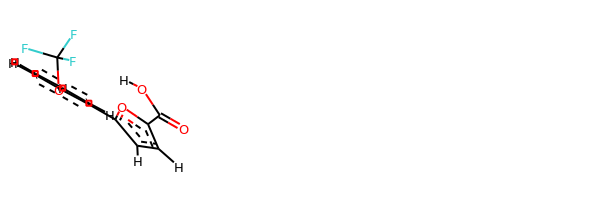

rdkit:  [H]OC(=O)c1oc(-c2c([H])c([H])c([H])c([H])c2OC(F)(F)F)c([H])c1[H]
oechem:  c1ccc(c(c1)c2ccc(o2)C(=O)O)OC(F)(F)F
###########################################################################
 #########################################################

bond
21.568852704198175 kJ/mol 58388.703513098844 kJ/mol False
angle
105.24694797462665 kJ/mol 105.24694797462665 kJ/mol True
nb
25.75050708906654 kJ/mol 25.75050708906654 kJ/mol True
torsion
18.207070231343092 kJ/mol 15.696680646106827 kJ/mol False
170.77337799923444 kJ/mol 58535.39764880865 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5243


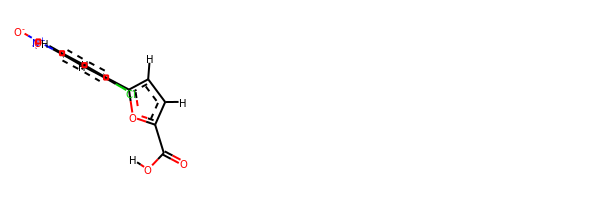

rdkit:  [H]OC(=O)c1oc(-c2c([H])c([H])c([N+](=O)[O-])c([H])c2Cl)c([H])c1[H]
oechem:  c1cc(c(cc1[N+](=O)[O-])Cl)c2ccc(o2)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
13.503831902241327 kJ/mol 58378.64371266224 kJ/mol False
angle
103.92114730167212 kJ/mol 103.92114730167212 kJ/mol True
nb
15.737749169008625 kJ/mol 15.737749169008625 kJ/mol True
torsion
5.349768055850147 kJ/mol 0.001008687478599985 kJ/mol False
138.51249642877224 kJ/mol 58498.30361782039 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
--------------------------

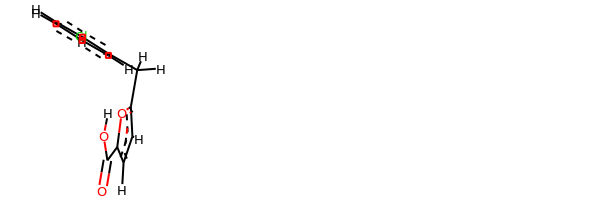

rdkit:  [H]OC(=O)c1oc(C([H])([H])c2c([H])c([H])c([H])c([H])c2Cl)c([H])c1[H]
oechem:  c1ccc(c(c1)Cc2ccc(o2)C(=O)O)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
19.39021990813142 kJ/mol 58162.591952541974 kJ/mol False
angle
100.44394521779599 kJ/mol 100.44394521779599 kJ/mol True
nb
19.303370780592243 kJ/mol 19.303370780592243 kJ/mol True
torsion
98.11422007989586 kJ/mol 81.37821952841043 kJ/mol False
237.2517559864155 kJ/mol 58363.717488068774 kJ/mol

---------------------------------------

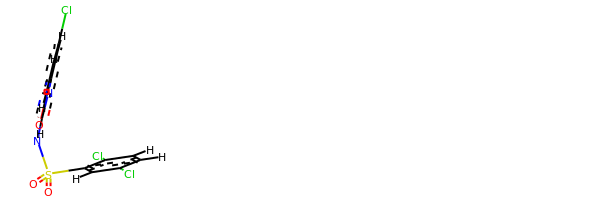

rdkit:  [H]c1c([H])c(Cl)c(S(=O)(=O)N([H])c2nc3c([H])c(Cl)c([H])c([H])c3o2)c([H])c1Cl
oechem:  c1cc2c(cc1Cl)nc(o2)NS(=O)(=O)c3cc(ccc3Cl)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
24.050668426468995 kJ/mol 57777.03390456121 kJ/mol False
angle
93.70593674107182 kJ/mol 94.9372732214185 kJ/mol False
nb
59.600251504064005 kJ/mol 59.600251504064005 kJ/mol True
torsion
16.204002956553893 kJ/mol 16.182298144797983 kJ/mol False
193.5608596281587 kJ/mol 57947.7537274315 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------

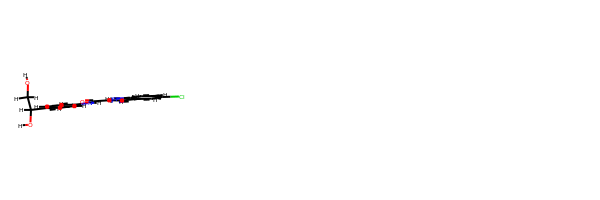

rdkit:  [H]OC([H])([H])C([H])(O[H])c1c([H])c([H])c(N([H])C(=O)c2c([H])c3c([H])c(Cl)c([H])c([H])c3n2[H])c([H])c1[H]
oechem:  c1cc(ccc1C(CO)O)NC(=O)c2cc3cc(ccc3[nH]2)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
24.785109965751353 kJ/mol 58390.97420431476 kJ/mol False
angle
115.93210920018188 kJ/mol 115.93210920018188 kJ/mol True
nb
40.90094387492808 kJ/mol 40.90094387492808 kJ/mol True
torsion
31.906997184939925 kJ/mol 27.309548847184367 kJ/mol False
213.52516022580124 kJ/mol 58575.116806237056 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------

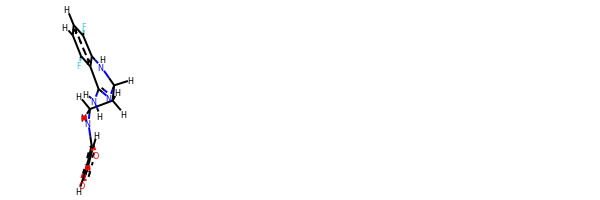

rdkit:  [H]c1oc([H])c(C(=O)N([H])C([H])([H])C([H])([H])C2([H])N=C(N([H])[H])c3c(F)c([H])c([H])c(F)c3N2[H])c1[H]
oechem:  c1cc(c2c(c1F)C(=NC(N2)CCNC(=O)c3ccoc3)N)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
25.596988530869442 kJ/mol 29505.588878596584 kJ/mol False
angle
301.55157648873274 kJ/mol 303.99985515119687 kJ/mol False
nb
54.86891767946671 kJ/mol 54.86891767946671 kJ/mol True
torsion
50.80605730041757 kJ/mol 44.95468199222021 kJ/mol False
432.8235399994865 kJ/mol 29909.412333419466 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5258


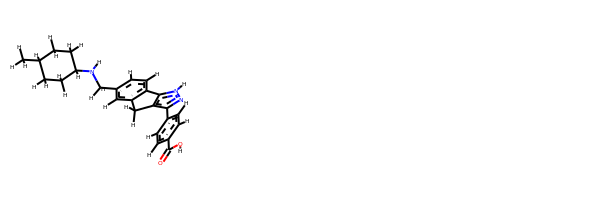

rdkit:  [H]OC(=O)c1c([H])c([H])c(-c2nn([H])c3c2C([H])([H])c2c([H])c(C([H])([H])N([H])C4([H])C([H])([H])C([H])([H])C([H])(C([H])([H])[H])C([H])([H])C4([H])[H])c([H])c([H])c2-3)c([H])c1[H]
oechem:  CC1CCC(CC1)NCc2ccc-3c(c2)Cc4c3[nH]nc4c5ccc(cc5)C(=O)O
###########################################################################
 #########################################################

bond
36.71763635318947 kJ/mol 58181.617195231454 kJ/mol False
angle
110.94064885728434 kJ/mol 110.94064885728434 kJ/mol True
nb
69.6837678550884 kJ/mol 69.6837678550884 kJ/mol True
torsion
113.80483808428637 kJ/mol 97.06883427666361 kJ/mol False
331.14689114984856 kJ/mol 58459.310446220494 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5259


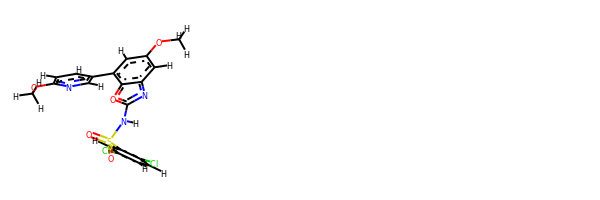

rdkit:  [H]c1nc(OC([H])([H])[H])c([H])c([H])c1-c1c([H])c(OC([H])([H])[H])c([H])c2nc(N([H])S(=O)(=O)c3c([H])c(Cl)c([H])c([H])c3Cl)oc12
oechem:  COc1ccc(cn1)c2cc(cc3c2oc(n3)NS(=O)(=O)c4cc(ccc4Cl)Cl)OC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
29.344541778991154 kJ/mol 114918.03041949826 kJ/mol False
angle
115.49234688783093 kJ/mol 115.49234688783093 kJ/mol True
nb
26.936305293430983 kJ/mol 26.936305293430983 kJ/mol True
torsion
0.21719511538812136 kJ/mol 0.21726813514084736 kJ/mol False
171.9903890756412 kJ/mol 115060.67633981466 kJ/mol

-------------------------------------------------------------------
-------------------

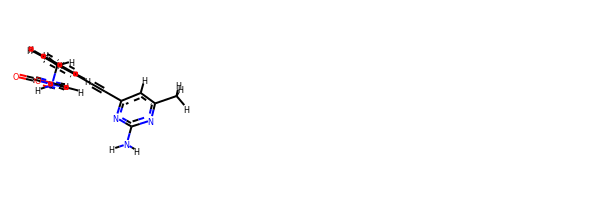

rdkit:  [H]c1oc(=O)n(N([H])C([H])([H])c2c([H])c([H])c([H])c([H])c2C#Cc2nc(N([H])[H])nc(C([H])([H])[H])c2[H])c1[H]
oechem:  Cc1cc(nc(n1)N)C#Cc2ccccc2CNn3ccoc3=O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
36.12121083035874 kJ/mol 57675.940680314765 kJ/mol False
angle
143.9609223295247 kJ/mol 143.9609223295247 kJ/mol True
nb
76.83893314327787 kJ/mol 76.83893314327787 kJ/mol True
torsion
6.180459696729383 kJ/mol 6.1804997295753 kJ/mol False
263.10152599989067 kJ/mol 57902.921035517145 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5264


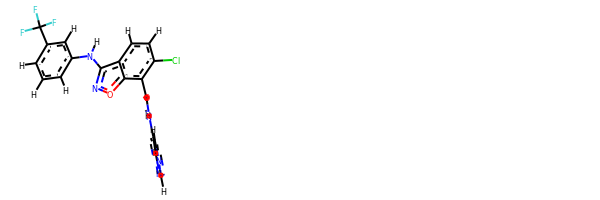

rdkit:  [H]c1nc([H])c(N([H])C(=O)c2c(Cl)c([H])c([H])c3c(N([H])c4c([H])c([H])c([H])c(C(F)(F)F)c4[H])noc23)c([H])n1
oechem:  c1cc(cc(c1)Nc2c3ccc(c(c3on2)C(=O)Nc4cncnc4)Cl)C(F)(F)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
12.33578804799674 kJ/mol 57928.916884889964 kJ/mol False
angle
87.69944767174428 kJ/mol 89.60194937924098 kJ/mol False
nb
34.11480509867598 kJ/mol 34.11480509867598 kJ/mol True
torsion
36.05483072598446 kJ/mol 35.25395286407944 kJ/mol False
170.20487154440147 kJ/mol 58087.

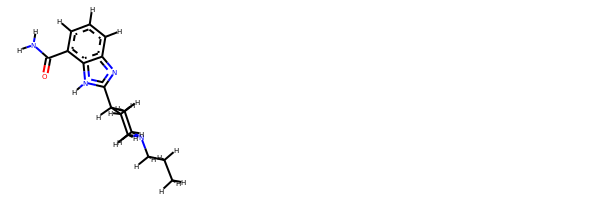

rdkit:  [H]c1c([H])c(C(=O)N([H])[H])c2c(nc(C3([H])C([H])([H])C([H])([H])N(C([H])([H])C([H])([H])C([H])([H])[H])C([H])([H])C3([H])[H])n2[H])c1[H]
oechem:  CCCN1CCC(CC1)c2[nH]c3c(cccc3n2)C(=O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
32.8390560954959 kJ/mol 58279.23159761651 kJ/mol False
angle
171.59151877798553 kJ/mol 171.59151877798553 kJ/mol True
nb
56.9079373280362 kJ/mol 56.9079373280362 kJ/mol True
torsion
239.84705668589137 kJ/mol 239.84703462859468 kJ/mol False
501.18556888740903 kJ/mol 58747.578088351125 kJ/mol

-------------------------------------------------------------------
----------------------------------

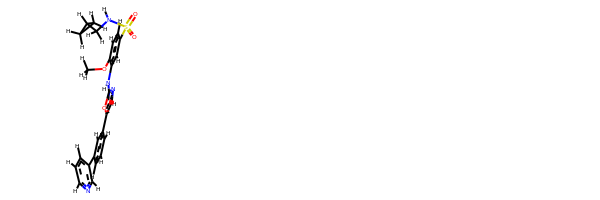

rdkit:  [H]c1nc(N([H])c2c([H])c(S(=O)(=O)N([H])C([H])([H])C3([H])C([H])([H])C3([H])[H])c([H])c([H])c2OC([H])([H])[H])oc1-c1c([H])c([H])c([H])c(-c2c([H])nc([H])c([H])c2[H])c1[H]
oechem:  COc1ccc(cc1Nc2ncc(o2)c3cccc(c3)c4cccnc4)S(=O)(=O)NCC5CC5
###########################################################################
 #########################################################

bond
29.34376614659953 kJ/mol 58275.32730165568 kJ/mol False
angle
152.96801121598247 kJ/mol 152.96801121598247 kJ/mol True
nb
51.17778583418077 kJ/mol 51.17778583418077 kJ/mol True
torsion
49.43559972941927 kJ/mol 49.43558147635444 kJ/mol False
282.92516292618205 kJ/mol 58528.9086801822 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5272


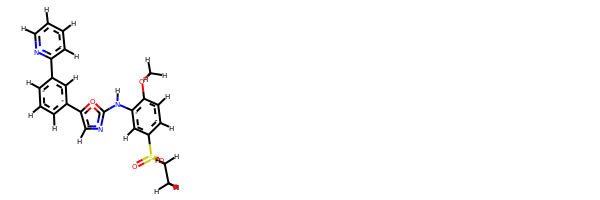

rdkit:  [H]c1nc(N([H])c2c([H])c(S(=O)(=O)C([H])([H])C([H])([H])[H])c([H])c([H])c2OC([H])([H])[H])oc1-c1c([H])c([H])c([H])c(-c2nc([H])c([H])c([H])c2[H])c1[H]
oechem:  CCS(=O)(=O)c1ccc(c(c1)Nc2ncc(o2)c3cccc(c3)c4ccccn4)OC
###########################################################################
 #########################################################

bond
12.870247919591892 kJ/mol 29094.90678336832 kJ/mol False
angle
115.38924866369508 kJ/mol 115.38924866369508 kJ/mol True
nb
28.0652459631753 kJ/mol 28.0652459631753 kJ/mol True
torsion
13.877160842916867 kJ/mol 21.19925946337526 kJ/mol False
170.20190338937917 kJ/mol 29259.56053745856 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5273


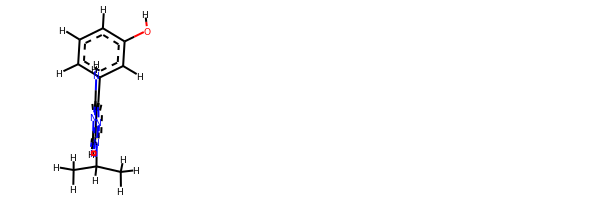

rdkit:  [H]Oc1c([H])c([H])c([H])c(-c2nn(C([H])(C([H])([H])[H])C([H])([H])[H])c3nc([H])nc(N([H])[H])c23)c1[H]
oechem:  CC(C)n1c2c(c(n1)c3cccc(c3)O)c(ncn2)N
###########################################################################
 #########################################################

bond
17.020175778211776 kJ/mol 86896.18728700513 kJ/mol False
angle
163.80556930230054 kJ/mol 167.27702815289467 kJ/mol False
nb
77.53784536092574 kJ/mol 77.53784536092574 kJ/mol True
torsion
10.46588958899898 kJ/mol 5.236021329302537 kJ/mol False
268.829480030437 kJ/mol 87146.23818184825 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5274


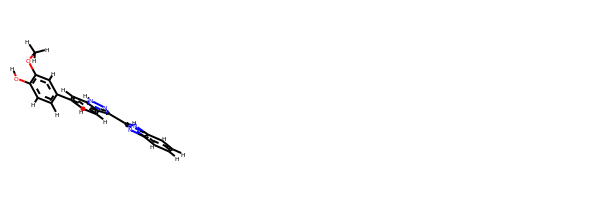

rdkit:  [H]Oc1c([H])c([H])c(-c2c([H])c([H])c3c(-c4nc5c([H])c([H])c([H])c([H])c5n4[H])nn([H])c3c2[H])c([H])c1OC([H])([H])[H]
oechem:  COc1cc(ccc1O)c2ccc3c(c2)[nH]nc3c4[nH]c5ccccc5n4
###########################################################################
 #########################################################

bond
11.50120249947653 kJ/mol 57766.70169271099 kJ/mol False
angle
129.19989299457407 kJ/mol 130.4281917744264 kJ/mol False
nb
53.099779683069464 kJ/mol 53.099779683069464 kJ/mol True
torsion
5.387712868400878 kJ/mol 5.387822244646406 kJ/mol False
199.18858804552096 kJ/mol 57955.617486413124 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5275


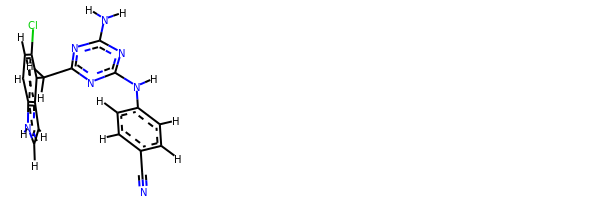

rdkit:  [H]c1c([H])c(N([H])c2nc(N([H])[H])nc(C([H])([H])c3c(Cl)c([H])c([H])c4c3c([H])c([H])n4[H])n2)c([H])c([H])c1C#N
oechem:  c1cc(ccc1C#N)Nc2nc(nc(n2)N)Cc3c4cc[nH]c4ccc3Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
19.34488421670727 kJ/mol 58001.00662497379 kJ/mol False
angle
130.48081366135634 kJ/mol 132.59976948279365 kJ/mol False
nb
66.8747893966284 kJ/mol 66.8747893966284 kJ/mol True
torsion
35.259314272149204 kJ/mol 35.25933271677144 kJ/mol False
251.95980154684122 kJ/mol 58235.74051656998 kJ/mol

-------------------------------------------------------------------
----------------------------------------------------

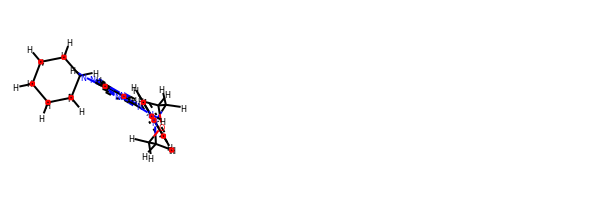

rdkit:  [H]c1c([H])c(N2C([H])([H])C([H])([H])OC([H])([H])C2([H])[H])c([H])c([H])c1N([H])c1nc(N([H])C2([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C2([H])[H])c2nc([H])n([H])c2n1
oechem:  c1cc(ccc1Nc2nc3c(c(n2)NC4CCCCC4)nc[nH]3)N5CCOCC5
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
7.842823792767229 kJ/mol 58030.14447377283 kJ/mol False
angle
89.9223500717602 kJ/mol 89.9223500717602 kJ/mol True
nb
49.10734585561726 kJ/mol 49.10734585561726 kJ/mol True
torsion
67.56276775838239 kJ/mol 47.45173558446533 kJ/mol False
214.4352874785271 kJ/mol 58216.62590528468 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
------------------------------------------------------------

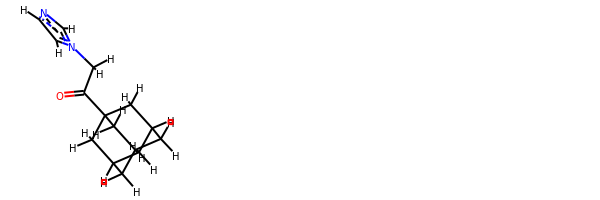

rdkit:  [H]c1nc([H])n(C([H])([H])C(=O)C23C([H])([H])C4([H])C([H])([H])C([H])(C([H])([H])C([H])(C4([H])[H])C2([H])[H])C3([H])[H])c1[H]
oechem:  c1cn(cn1)CC(=O)C23CC4CC(C2)CC(C4)C3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

#####

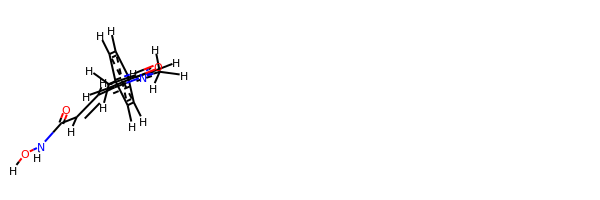

rdkit:  [H]ON([H])C(=O)C([H])=C([H])c1c([H])c(C(=O)C([H])([H])c2c([H])c([H])c([H])c([H])c2[H])c([H])n1C([H])([H])[H]
oechem:  Cn1cc(cc1C=CC(=O)NO)C(=O)Cc2ccccc2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
15.117703532044679 kJ/mol 57508.88839497528 kJ/mol False
angle
12.43655662231678 kJ/mol 12.43655662231678 kJ/mol True
nb
47.224999579656505 kJ/mol 47.224999579656505 kJ/mol True
torsion
15.566848097677447 kJ/mol 15.563239942358896 kJ/mol False
90.3461078316954 kJ/mol 57584.113191119606 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5290


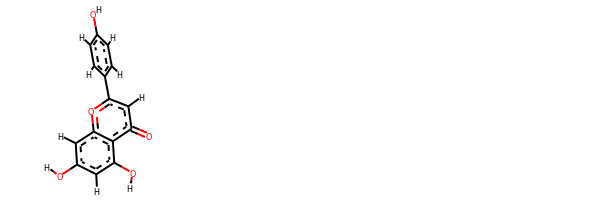

rdkit:  [H]Oc1c([H])c([H])c(-c2oc3c([H])c(O[H])c([H])c(O[H])c3c(=O)c2[H])c([H])c1[H]
oechem:  c1cc(ccc1c2cc(=O)c3c(cc(cc3o2)O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
33.169120141611906 kJ/mol 101941.67759816177 kJ/m

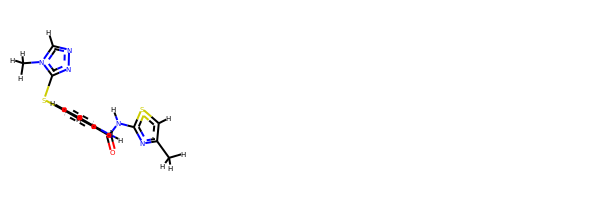

rdkit:  [H]c1sc(N([H])C(=O)c2c([H])c(Sc3nnc([H])n3C([H])([H])[H])c([H])c([H])c2N([H])[H])nc1C([H])([H])[H]
oechem:  Cc1csc(n1)NC(=O)c2cc(ccc2N)Sc3nncn3C
###########################################################################
 #########################################################

bond
38.4130340351615 kJ/mol 101948.47670663895 kJ/mol False
angle
147.70607514031101 kJ/mol 151.0629283756898 kJ/mol False
nb
8.146676237781449 kJ/mol 8.146676237781449 kJ/mol True
torsion
18.737937351111597 kJ/mol 18.738044870571915 kJ/mol False
213.00372276436553 kJ/mol 102126.42435612298 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5297


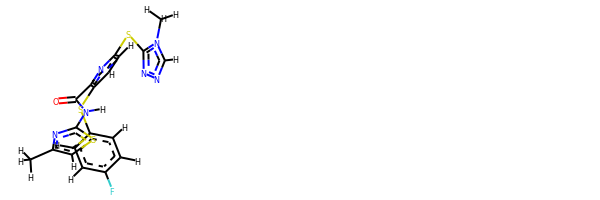

rdkit:  [H]c1sc(N([H])C(=O)c2nc(Sc3nnc([H])n3C([H])([H])[H])c([H])c([H])c2Sc2c([H])c([H])c(F)c([H])c2[H])nc1C([H])([H])[H]
oechem:  Cc1csc(n1)NC(=O)c2c(ccc(n2)Sc3nncn3C)Sc4ccc(cc4)F
###########################################################################
 #########################################################

bond
48.68528328915892 kJ/mol 87504.90317599897 kJ/mol False
angle
123.92432531700233 kJ/mol 129.2167906127529 kJ/mol False
nb
62.01017501270172 kJ/mol 62.01017501270172 kJ/mol True
torsion
5.62691186161742 kJ/mol 0.027972578057924427 kJ/mol False
240.2466954804804 kJ/mol 87696.1581142025 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5298


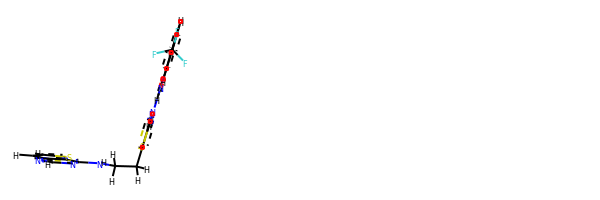

rdkit:  [H]c1nc(N([H])C([H])([H])C([H])([H])c2sc(N([H])C(=O)N([H])c3c([H])c([H])c([H])c(C(F)(F)F)c3[H])nc2[H])c2sc([H])c([H])c2n1
oechem:  c1cc(cc(c1)NC(=O)Nc2ncc(s2)CCNc3c4c(ccs4)ncn3)C(F)(F)F
###########################################################################
 #########################################################

bond
47.30842773083933 kJ/mol 87503.52632044064 kJ/mol False
angle
117.96385399834911 kJ/mol 123.25631929409965 kJ/mol False
nb
56.02721594601654 kJ/mol 56.02721594601654 kJ/mol True
torsion
5.626740089950336 kJ/mol 0.02780080639083965 kJ/mol False
226.9262377651553 kJ/mol 87682.83765648714 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5299


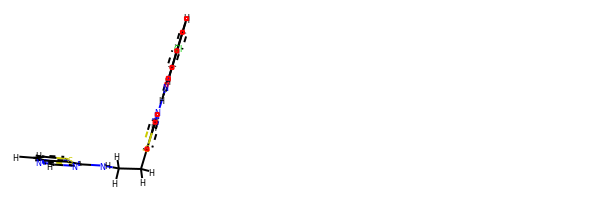

rdkit:  [H]c1nc(N([H])C([H])([H])C([H])([H])c2sc(N([H])C(=O)N([H])c3c([H])c([H])c([H])c(Cl)c3[H])nc2[H])c2sc([H])c([H])c2n1
oechem:  c1cc(cc(c1)Cl)NC(=O)Nc2ncc(s2)CCNc3c4c(ccs4)ncn3
###########################################################################
 #########################################################

bond
53.20545431378232 kJ/mol 72795.03670369233 kJ/mol False
angle
183.1352964523279 kJ/mol 186.49225919157112 kJ/mol False
nb
62.392853839458404 kJ/mol 62.392853839458404 kJ/mol True
torsion
13.999396922226957 kJ/mol 2.4787500233954733 kJ/mol False
312.7330015277956 kJ/mol 73046.40056674674 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5300


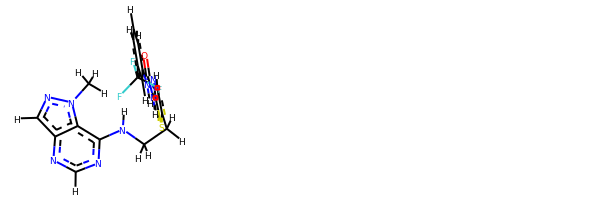

rdkit:  [H]c1nc(N([H])C([H])([H])C([H])([H])c2sc(N([H])C(=O)N([H])c3c([H])c([H])c([H])c(C(F)(F)F)c3[H])nc2[H])c2c(n1)c([H])nn2C([H])([H])[H]
oechem:  Cn1c2c(cn1)ncnc2NCCc3cnc(s3)NC(=O)Nc4cccc(c4)C(F)(F)F
###########################################################################
 #########################################################

bond
13.689684419701893 kJ/mol 43799.07190021883 kJ/mol False
angle
119.73599936556467 kJ/mol 121.88968264839568 kJ/mol False
nb
-11.772633629598682 kJ/mol -11.772633629598682 kJ/mol True
torsion
146.65429098531777 kJ/mol 146.6542983303163 kJ/mol False
268.30734114098567 kJ/mol 44055.843247567944 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5301


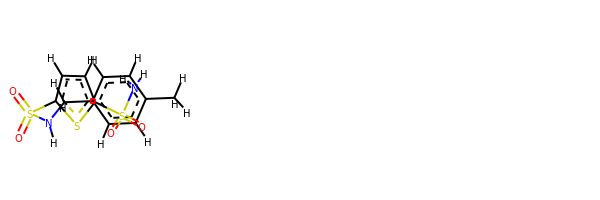

rdkit:  [H]c1c(S(=O)(=O)N([H])[H])sc(S(=O)(=O)N([H])C([H])([H])c2c([H])c([H])c(C([H])([H])[H])c([H])c2[H])c1[H]
oechem:  Cc1ccc(cc1)CNS(=O)(=O)c2ccc(s2)S(=O)(=O)N
###########################################################################
 #########################################################

bond
10.518041042231214 kJ/mol 57857.412881110584 kJ/mol False
angle
96.35050406123862 kJ/mol 97.80812333257323 kJ/mol False
nb
29.10909769923497 kJ/mol 29.10909769923497 kJ/mol True
torsion
17.538111006596026 kJ/mol 17.538510385965168 kJ/mol False
153.51575380930083 kJ/mol 58001.86861252836 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5302


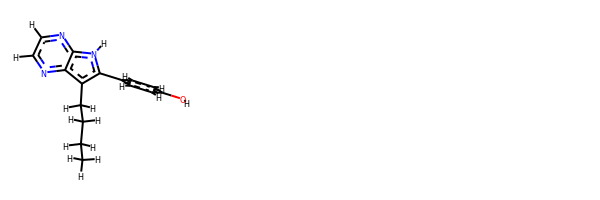

rdkit:  [H]Oc1c([H])c([H])c(-c2c(C([H])([H])C([H])([H])C([H])([H])C([H])([H])[H])c3nc([H])c([H])nc3n2[H])c([H])c1[H]
oechem:  CCCCc1c2c([nH]c1c3ccc(cc3)O)nccn2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
70.35634840403834 kJ/mol 57927.75159676443 kJ/mol False
angle
178.48110664294555 kJ/mol 179.86662901268747 kJ/mol False
nb
-6.325618548919511 kJ/mol -6.325618548919511 kJ/mol True
torsion
105.10819792346412 kJ/mol 100.08471576154463 kJ/mol False
347.6200344215285 kJ/mol 58201.377322989734 k

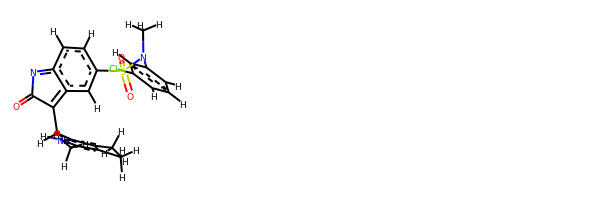

rdkit:  [H]c1c([H])c(Cl)c([H])c(N(C([H])([H])[H])S(=O)(=O)c2c([H])c([H])c3c(c2[H])=C(C([H])([H])c2c(C([H])([H])[H])c(C([H])([H])[H])c(C([H])([H])[H])n2[H])C(=O)N=3)c1[H]
oechem:  Cc1c(c([nH]c1C)CC2=c3cc(ccc3=NC2=O)S(=O)(=O)N(C)c4cccc(c4)Cl)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #

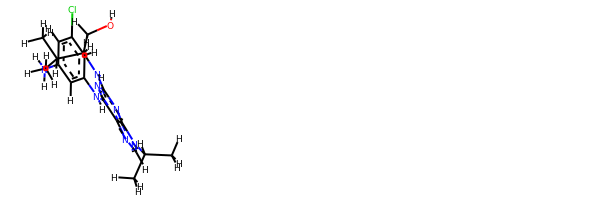

rdkit:  [H]OC([H])([H])C([H])(N([H])c1nc(N([H])c2c([H])c(Cl)c([H])c(N([H])[H])c2[H])c2nc([H])n(C([H])(C([H])([H])[H])C([H])([H])[H])c2n1)C([H])(C([H])([H])[H])C([H])([H])[H]
oechem:  CC(C)C(CO)Nc1nc(c2c(n1)n(cn2)C(C)C)Nc3cc(cc(c3)Cl)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
20.635198938641317 kJ/mol 87006.63862320664 kJ/mol False
angle
223.55613620503314 kJ/mol 227.11090443959807 kJ/mol False
nb
32.08496333305307 kJ/mol 32.08496333305307 kJ/mol True
torsion
153.21667534075064 kJ/mol 132.501616774629 kJ/mol False
429.4929738174781 kJ/mol 87398.33610775393 kJ/mol

----------------------------------------------------------

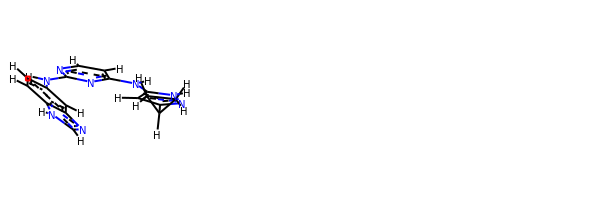

rdkit:  [H]c1nc(N([H])c2c([H])c([H])c3c(nc([H])n3[H])c2[H])nc(N([H])c2c([H])c(C3([H])C([H])([H])C3([H])[H])nn2[H])c1[H]
oechem:  c1cc2c(cc1Nc3nccc(n3)Nc4cc(n[nH]4)C5CC5)nc[nH]2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
25.424120574058467 kJ/mol 57885.34046239827 kJ/mol False
angle
419.4647425085533 kJ/mol 419.4647425085533 kJ/mol True
nb
34.09198550476866 kJ/mol 34.09198550476866 kJ/mol True
torsion
58.95726065260794 kJ/mol 58.957356891080494 kJ/mol False
537.9381092399883 kJ/mol 58397.854547302675 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------

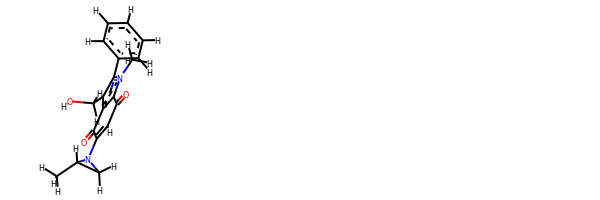

rdkit:  [H]OC([H])([H])c1c2c(n(C([H])([H])[H])c1-c1c([H])c([H])c([H])c([H])c1[H])C(=O)C([H])=C(N1C([H])([H])C1([H])C([H])([H])[H])C2=O
oechem:  CC1CN1C2=CC(=O)c3c(c(c(n3C)c4ccccc4)CO)C2=O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
33.03857683316448 kJ/mol 43718.90537462536 kJ/mol False
angle
65.971849914025 kJ/mol 70.36788106991588 kJ/mol False
nb
10.354321310893173 kJ/mol 10.354321310893173 kJ/mol True
torsion
37.10715389065234 kJ/mol 37.10718864949767 kJ/mol False
146.471901948735 kJ/mol

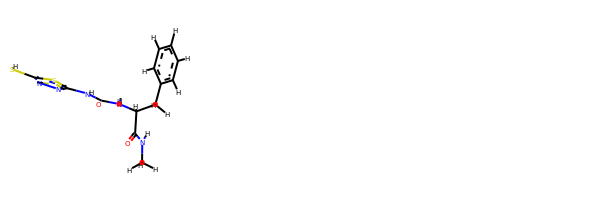

rdkit:  [H]Sc1nnc(N([H])C(=O)N([H])C([H])(C(=O)N([H])C([H])([H])[H])C([H])([H])c2c([H])c([H])c([H])c([H])c2[H])s1
oechem:  CNC(=O)C(Cc1ccccc1)NC(=O)Nc2nnc(s2)S
###########################################################################
 #########################################################

bond
19.57658567596136 kJ/mol 58292.46473022874 kJ/mol False
angle
114.80110292558105 kJ/mol 114.80110292558105 kJ/mol True
nb
6.953598425136358 kJ/mol 6.953598425136358 kJ/mol True
torsion
5.086701217981562 kJ/mol 5.086553526871167 kJ/mol False
146.41798824466034 kJ/mol 58419.30598510632 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5327


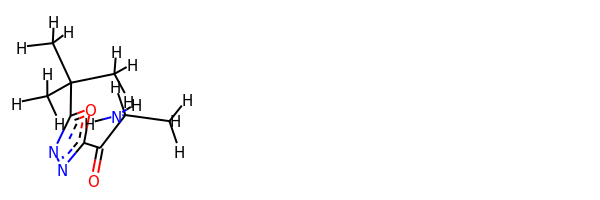

rdkit:  [H]N([H])C([H])(C(=O)c1nnc(C(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H])o1)C([H])([H])[H]
oechem:  CC(C(=O)c1nnc(o1)C(C)(C)C)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
11.870032617519442 kJ/mol 29.91166916129837 kJ/mol False
angle
101.18459482284072 kJ/mol 101.18459482284072 kJ/mol True
nb
36.69747922197646 kJ/mol 36.69747922197646 kJ/mol True
torsion
87.36932959668074 kJ/mol 82.0555047400254 kJ/mol False
237.12143625901737 kJ/mol 249.84924794614093 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5329


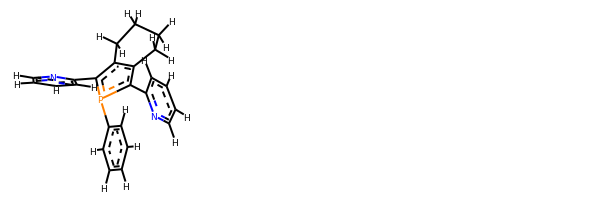

rdkit:  [H]c1nc(-c2c3c(c(-c4nc([H])c([H])c([H])c4[H])p2-c2c([H])c([H])c([H])c([H])c2[H])C([H])([H])C([H])([H])C([H])([H])C3([H])[H])c([H])c([H])c1[H]
oechem:  c1ccc(cc1)p2c(c3c(c2c4ccccn4)CCCC3)c5ccccn5
###########################################################################
 #########################################################

bond
60.13458991771511 kJ/mol 56994.699296753184 kJ/mol False
angle
427.1147808439473 kJ/mol 427.1147808439473 kJ/mol True
nb
58.92102062956097 kJ/mol 58.92102062956097 kJ/mol True
torsion
116.51967602981402 kJ/mol 116.5197973586956 kJ/mol False
662.6900674210374 kJ/mol 57597.25489558539 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5330


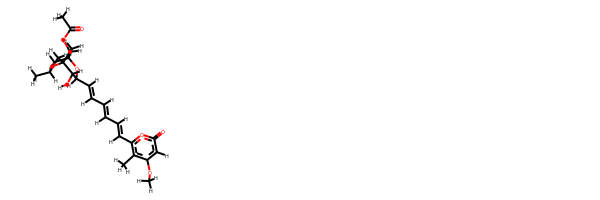

rdkit:  [H]OC1([H])C([H])(C([H])=C([H])C([H])=C([H])C([H])=C([H])c2oc(=O)c([H])c(OC([H])([H])[H])c2C([H])([H])[H])OC2(C([H])([H])[H])C([H])(C([H])([H])C([H])([H])[H])OC1(C([H])([H])[H])C2([H])OC(=O)C([H])([H])[H]
oechem:  CCC1C2(C(C(O1)(C(C(O2)C=CC=CC=Cc3c(c(cc(=O)o3)OC)C)O)C)OC(=O)C)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
41.06833207004972 kJ/mol 101112.28741075736 kJ/mol False
angle
114.99481071036745 kJ/mol 117.18532205106855 kJ/mol False
nb
45.1620096669401 kJ/mol 45.1620096669401 kJ/mol True
torsion
91.2916147807073 kJ/mol 71.87747731591274 kJ/mol False
292.51676722806457 kJ/mol 101346.51221979127 kJ/mol

-------

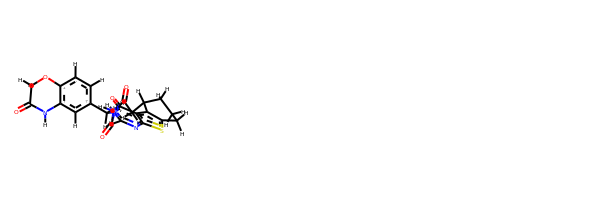

rdkit:  [H]c1c([H])c(C([H])([H])N([H])C(=O)c2nc3sc4c(c3c(=O)n2[H])C([H])(C([H])([H])C(=O)N([H])[H])C([H])([H])C([H])([H])C4([H])[H])c([H])c2c1OC([H])([H])C(=O)N2[H]
oechem:  c1cc2c(cc1CNC(=O)c3[nH]c(=O)c4c5c(sc4n3)CCCC5CC(=O)N)NC(=O)CO2
###########################################################################
 #########################################################

bond
40.64053647208751 kJ/mol 44018.849645544266 kJ/mol False
angle
68.10587020260317 kJ/mol 70.30992222886407 kJ/mol False
nb
12.812167559793759 kJ/mol 12.812167559793759 kJ/mol True
torsion
187.86243767944637 kJ/mol 167.76162684182992 kJ/mol False
309.42101191393084 kJ/mol 44269.73336217475 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5334


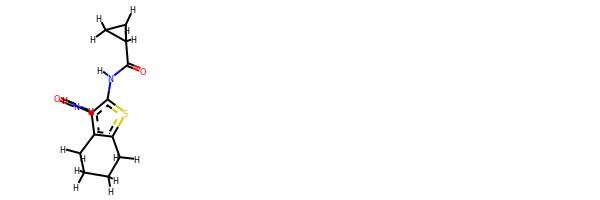

rdkit:  [H]N([H])C(=O)c1c(N([H])C(=O)C2([H])C([H])([H])C2([H])[H])sc2c1C([H])([H])C([H])([H])C([H])([H])C2([H])[H]
oechem:  C1CCc2c(c(c(s2)NC(=O)C3CC3)C(=O)N)C1
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

#######################

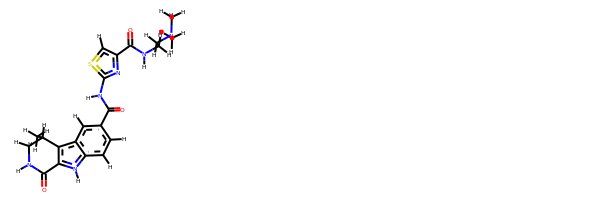

rdkit:  [H]c1sc(N([H])C(=O)c2c([H])c([H])c3c(c2[H])c2c(n3[H])C(=O)N([H])C([H])([H])C2([H])C([H])([H])[H])nc1C(=O)N([H])C([H])([H])C([H])([H])N(C([H])([H])[H])C([H])([H])[H]
oechem:  CC1CNC(=O)c2c1c3cc(ccc3[nH]2)C(=O)Nc4nc(cs4)C(=O)NCCN(C)C
###########################################################################
 #########################################################

bond
19.996761441784265 kJ/mol 58387.858027073446 kJ/mol False
angle
104.48858358906234 kJ/mol 104.48858358906234 kJ/mol True
nb
24.392622412103727 kJ/mol 24.392622412103727 kJ/mol True
torsion
25.311557222568794 kJ/mol 22.80116843095121 kJ/mol False
174.18952466551912 kJ/mol 58539.54040150556 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5342


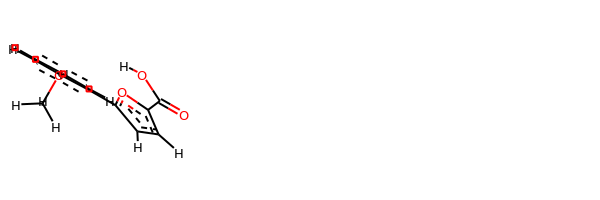

rdkit:  [H]OC(=O)c1oc(-c2c([H])c([H])c([H])c([H])c2OC([H])([H])[H])c([H])c1[H]
oechem:  COc1ccccc1c2ccc(o2)C(=O)O
###########################################################################
 #########################################################

bond
22.741915370806126 kJ/mol 58389.53572088001 kJ/mol False
angle
104.56046154777442 kJ/mol 104.56046154777442 kJ/mol True
nb
9.681990520330363 kJ/mol 9.681990520330363 kJ/mol True
torsion
103.55911290851691 kJ/mol 101.04871741722619 kJ/mol False
240.54348034742782 kJ/mol 58604.82689036534 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5343


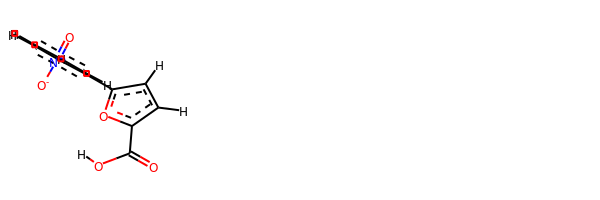

rdkit:  [H]OC(=O)c1oc(-c2c([H])c([H])c([H])c([H])c2[N+](=O)[O-])c([H])c1[H]
oechem:  c1ccc(c(c1)c2ccc(o2)C(=O)O)[N+](=O)[O-]
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
23.104110722296745 kJ/mol 58248.0457648805 kJ/mol False
angle
189.7491270042473 kJ/mol 189.7491270042473 kJ/mol True
nb
21.846420762459385 kJ/mol 21.846420762459385 kJ/mol True
torsion
21.00196510652303 kJ/mol 21.001978265714445 kJ/mol False
255.70162359552648 kJ/mol 58480.643290912914 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5345


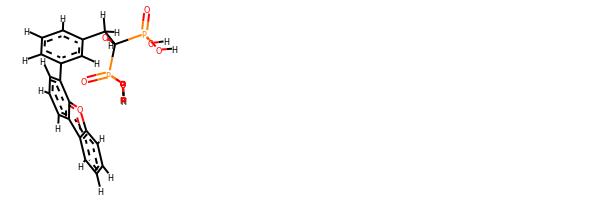

rdkit:  [H]OC(C([H])([H])c1c([H])c([H])c([H])c(-c2c([H])c([H])c([H])c3c2oc2c([H])c([H])c([H])c([H])c23)c1[H])(P(=O)(O[H])O[H])P(=O)(O[H])O[H]
oechem:  c1ccc2c(c1)c3cccc(c3o2)c4cccc(c4)CC(O)(P(=O)(O)O)P(=O)(O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
25.51936514466006 kJ/mol 58007.39327207467 kJ/mol False
angle
413.77509983429223 kJ/mol 413.77509983429223 kJ/mol True
nb
16.55170457330509 kJ/mol 16.55170457330509 kJ/mol True
torsion
100.30398106848467 kJ/mol 76.20187556935828 kJ/mol False
556.150150620742 kJ/mol 58513.92195205162 kJ/mol

-------------------------------------------------------------------
-----------------

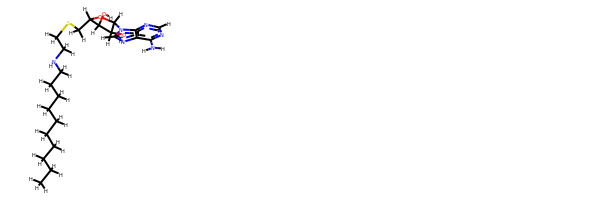

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c(N([H])[H])nc([H])nc32)OC([H])(C([H])([H])SC([H])([H])C([H])([H])N([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])[H])C1([H])O[H]
oechem:  CCCCCCCCCCNCCSCC1C(C(C(O1)n2cnc3c2ncnc3N)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
34.5667756221426 kJ/mol 58057.159375662646 kJ/mol False
angle
102.24920963681042 kJ/mol 104.25922281831211 kJ/mol False
nb
80.64353715057447 kJ/mol 80.64353715057447 kJ/mol True
torsion
20.82846747616944 kJ/mol 0.3519600998923899 kJ/mol False
238.28798988569693 kJ/mol 58242.41409573142 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
---

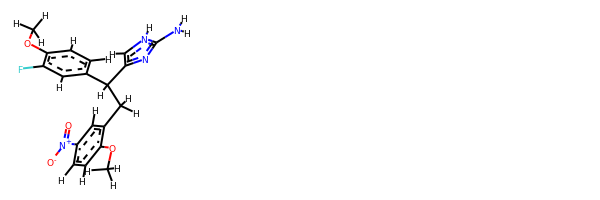

rdkit:  [H]c1c([H])c(C([H])(c2nc(N([H])[H])n([H])c2[H])C([H])([H])c2c([H])c([N+](=O)[O-])c([H])c([H])c2OC([H])([H])[H])c([H])c(F)c1OC([H])([H])[H]
oechem:  COc1ccc(cc1CC(c2ccc(c(c2)F)OC)c3c[nH]c(n3)N)[N+](=O)[O-]
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ##############################

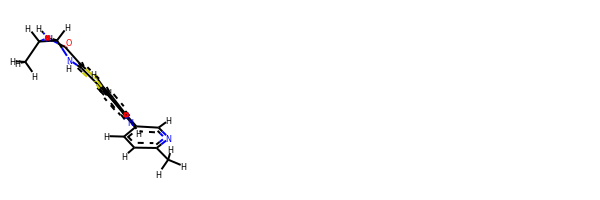

rdkit:  [H]c1nc(C([H])([H])[H])c([H])c([H])c1-c1nc2c([H])c([H])c3sc4c(c3c2c([H])c1[H])N([H])C([H])([H])C([H])(C([H])([H])[H])N([H])C4=O
oechem:  Cc1ccc(cn1)c2ccc3c(n2)ccc4c3c5c(s4)C(=O)NC(CN5)C
###########################################################################
 #########################################################

bond
24.052031889546885 kJ/mol 43688.290302420915 kJ/mol False
angle
104.80384033072256 kJ/mol 106.11254586513631 kJ/mol False
nb
39.932244204179234 kJ/mol 39.932244204179234 kJ/mol True
torsion
38.7334242254755 kJ/mol 37.39801892871209 kJ/mol False
207.52154064992416 kJ/mol 43871.733111418944 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5365


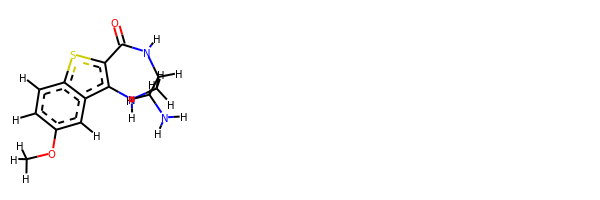

rdkit:  [H]c1c(OC([H])([H])[H])c([H])c2c3c(sc2c1[H])C(=O)N([H])C([H])(C([H])([H])N([H])[H])C([H])([H])N3[H]
oechem:  COc1ccc2c(c1)c3c(s2)C(=O)NC(CN3)CN
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
34.48349769812473 kJ/mol 11

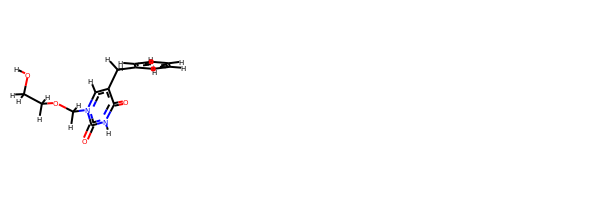

rdkit:  [H]OC([H])([H])C([H])([H])OC([H])([H])n1c([H])c(C([H])([H])c2c([H])c([H])c([H])c([H])c2[H])c(=O)n([H])c1=O
oechem:  c1ccc(cc1)Cc2cn(c(=O)[nH]c2=O)COCCO
###########################################################################
 #########################################################

bond
41.65215026903751 kJ/mol 113847.25975823624 kJ/mol False
angle
26.14166212575257 kJ/mol 26.737404562169115 kJ/mol False
nb
75.09202451428881 kJ/mol 75.09202451428881 kJ/mol True
torsion
70.5959974192714 kJ/mol 11.049125124060724 kJ/mol False
213.48183432835032 kJ/mol 113960.13831243676 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5372


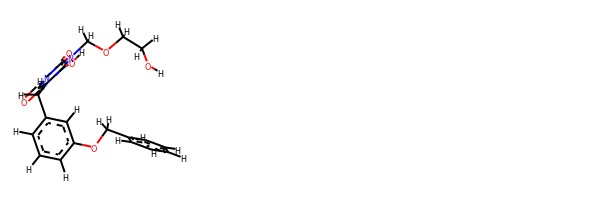

rdkit:  [H]Oc1c(C([H])([H])c2c([H])c([H])c([H])c(OC([H])([H])c3c([H])c([H])c([H])c([H])c3[H])c2[H])c(=O)n([H])c(=O)n1C([H])([H])OC([H])([H])C([H])([H])O[H]
oechem:  c1ccc(cc1)COc2cccc(c2)Cc3c(=O)[nH]c(=O)n(c3O)COCCO
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
14.570328218839823 kJ/mol 57754.05233732049 kJ/mol False
angle
231.3040835226965 kJ/mol 231.3040835226965 kJ/mol True
nb
28.481318714131174 kJ/mol 28.481318714131174 kJ/mol True
torsion
5.008482224040856 kJ/mol 5.008512368617218 kJ/mol

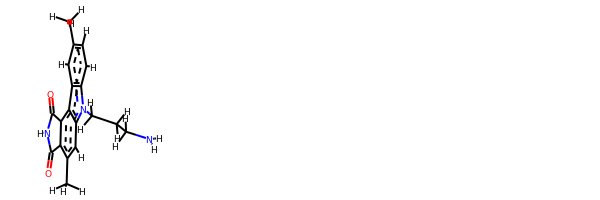

rdkit:  [H]c1c(C([H])([H])[H])c([H])c2c3c4c(c(C([H])([H])[H])c([H])c3n(C([H])([H])C([H])([H])C([H])([H])N([H])[H])c2c1[H])C(=O)N([H])C4=O
oechem:  Cc1ccc2c(c1)c3c(n2CCCN)cc(c4c3C(=O)NC4=O)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #####################################################

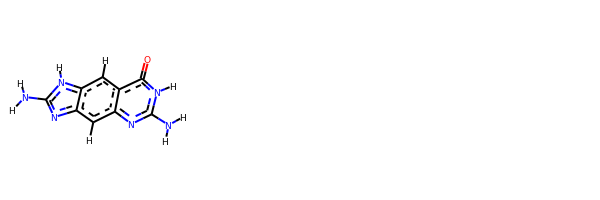

rdkit:  [H]c1c2nc(N([H])[H])n([H])c(=O)c2c([H])c2c1nc(N([H])[H])n2[H]
oechem:  c1c2c(cc3c1[nH]c(n3)N)nc([nH]c2=O)N
###########################################################################
 #########################################################

bond
16.823916101602965 kJ/mol 57440.30418582732 kJ/mol False
angle
11.366172105429726 kJ/mol 11.366172105429726 kJ/mol True
nb
50.04248996535029 kJ/mol 50.04248996535029 kJ/mol True
torsion
15.565440045548087 kJ/mol 15.561123843166916 kJ/mol False
93.79801821793106 kJ/mol 57517.27397174127 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5385


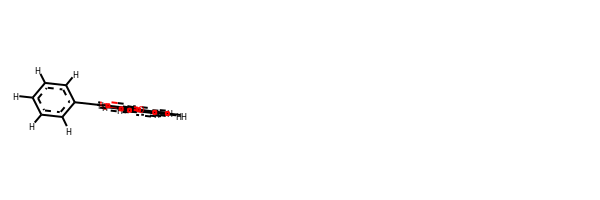

rdkit:  [H]c1c([H])c([H])c(-c2oc3c(c([H])c([H])c4c([H])c([H])c([H])c([H])c43)c(=O)c2[H])c([H])c1[H]
oechem:  c1ccc(cc1)c2cc(=O)c3ccc4ccccc4c3o2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
17.742451802079962 kJ/mol 115523.0534434492 kJ/mol False
angle
523.4767213180675 kJ/mol 524.7056144109274 kJ/mol False
nb
-2.098687554517213 kJ/mol -2.098687554517213 kJ/mol True
torsion
74.09500349598495 kJ/mol 74.09508989272814 kJ/mol False
613.2154890616151 kJ/mol 116119.75546019833 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
------------

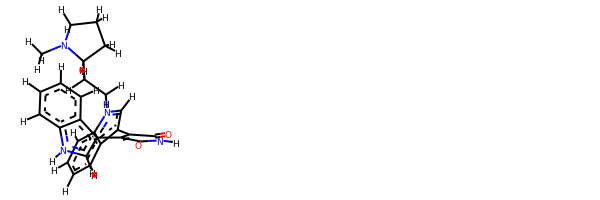

rdkit:  [H]c1c([H])c([H])c2c(c1[H])c(C1=C(c3c([H])n(C([H])([H])C([H])([H])C4([H])N(C([H])([H])[H])C([H])([H])C([H])([H])C4([H])[H])c4c([H])c([H])c([H])c([H])c34)C(=O)N([H])C1=O)c([H])n2[H]
oechem:  CN1CCCC1CCn2cc(c3c2cccc3)C4=C(C(=O)NC4=O)c5c[nH]c6c5cccc6
###########################################################################
 #########################################################

bond
19.3976685909611 kJ/mol 115524.10057383102 kJ/mol False
angle
254.5034586699043 kJ/mol 255.73289805646525 kJ/mol False
nb
-9.738833532437576 kJ/mol -9.738833532437576 kJ/mol True
torsion
36.090253140318076 kJ/mol 36.09033855716813 kJ/mol False
300.25254686874587 kJ/mol 115806.18497691222 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5389


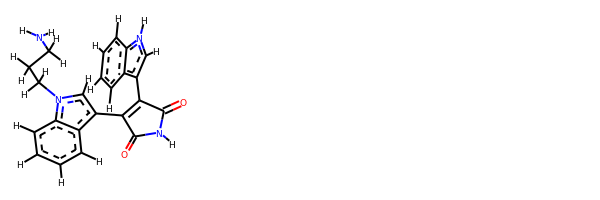

rdkit:  [H]c1c([H])c([H])c2c(c1[H])c(C1=C(c3c([H])n(C([H])([H])C([H])([H])C([H])([H])N([H])[H])c4c([H])c([H])c([H])c([H])c34)C(=O)N([H])C1=O)c([H])n2[H]
oechem:  c1ccc2c(c1)c(c[nH]2)C3=C(C(=O)NC3=O)c4cn(c5c4cccc5)CCCN
###########################################################################
 #########################################################

bond
17.742451802079962 kJ/mol 115523.0534434492 kJ/mol False
angle
523.4767213180675 kJ/mol 524.7056144109274 kJ/mol False
nb
-2.098687554517213 kJ/mol -2.098687554517213 kJ/mol True
torsion
74.09500349598495 kJ/mol 74.09508989272814 kJ/mol False
613.2154890616151 kJ/mol 116119.75546019833 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5390


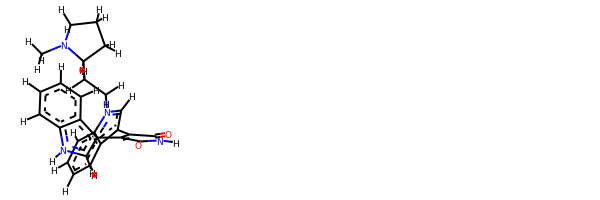

rdkit:  [H]c1c([H])c([H])c2c(c1[H])c(C1=C(c3c([H])n(C([H])([H])C([H])([H])C4([H])N(C([H])([H])[H])C([H])([H])C([H])([H])C4([H])[H])c4c([H])c([H])c([H])c([H])c34)C(=O)N([H])C1=O)c([H])n2[H]
oechem:  CN1CCCC1CCn2cc(c3c2cccc3)C4=C(C(=O)NC4=O)c5c[nH]c6c5cccc6
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
9.264457812472624 kJ/mol 57808.15068076074 kJ/mol False
ang

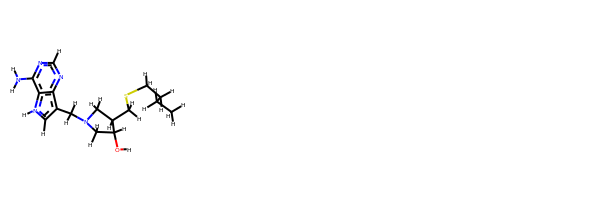

rdkit:  [H]OC1([H])C([H])([H])N(C([H])([H])c2c([H])n([H])c3c(N([H])[H])nc([H])nc23)C([H])([H])C1([H])C([H])([H])SC([H])([H])C([H])([H])C([H])([H])C([H])([H])[H]
oechem:  CCCCSCC1CN(CC1O)Cc2c[nH]c3c2ncnc3N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ######################################

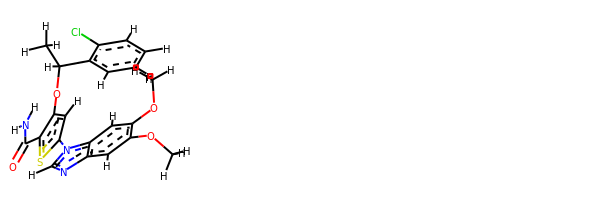

rdkit:  [H]c1c([H])c([H])c(C([H])(Oc2c(C(=O)N([H])[H])sc(-n3c([H])nc4c([H])c(OC([H])([H])[H])c(OC([H])([H])[H])c([H])c43)c2[H])C([H])([H])[H])c(Cl)c1[H]
oechem:  CC(c1ccccc1Cl)Oc2cc(sc2C(=O)N)n3cnc4c3cc(c(c4)OC)OC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
25.713287399521523 kJ/mol 173669.34160111318 kJ/mol False
angle
188.84270756870293 kJ/mol 190.9261919342413 kJ/mol False
nb
72.39957324428772 kJ/mol 72.39957324428772 kJ/mol True
torsion
26.297586728371265 kJ/mol 18.978192638105437 kJ/mol False
313.25315494088346 kJ/mol 173951.64555892983 kJ/mol

-------------------------------------------------------------------
-------

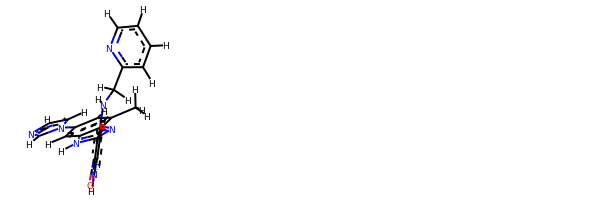

rdkit:  [H]c1nc(C([H])([H])N([H])c2c([H])c([H])n([H])c(=O)c2-c2nc3c(C([H])([H])[H])c([H])c(-n4c([H])nc([H])c4[H])c([H])c3n2[H])c([H])c([H])c1[H]
oechem:  Cc1cc(cc2c1nc([nH]2)c3c(cc[nH]c3=O)NCc4ccccn4)n5ccnc5
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ###################################

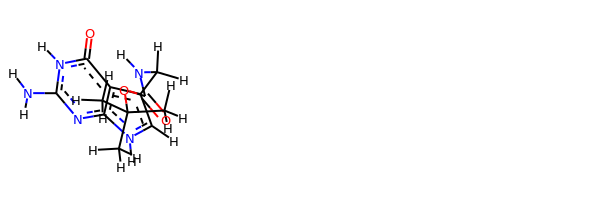

rdkit:  [H]c1c(C([H])([H])N([H])C(=O)OC(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H])c2c(=O)n([H])c(N([H])[H])nc2n1[H]
oechem:  CC(C)(C)OC(=O)NCc1c[nH]c2c1c(=O)[nH]c(n2)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

############

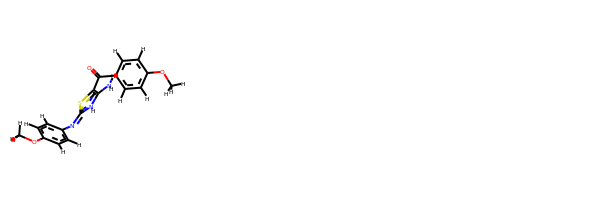

rdkit:  [H]c1c([H])c(OC([H])([H])[H])c([H])c([H])c1N=c1sc(C(=O)c2c([H])c([H])c(OC([H])([H])[H])c([H])c2[H])c(N([H])[H])n1[H]
oechem:  COc1ccc(cc1)C(=O)c2c([nH]c(=Nc3ccc(cc3)OC)s2)N
###########################################################################
 #########################################################

bond
32.04542147514785 kJ/mol 43710.85105021399 kJ/mol False
angle
65.17546252341026 kJ/mol 67.95569143279451 kJ/mol False
nb
21.783938683409083 kJ/mol 21.783938683409083 kJ/mol True
torsion
19.042068689930467 kJ/mol 13.762677537699295 kJ/mol False
138.04689137189766 kJ/mol 43814.35335786789 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5420


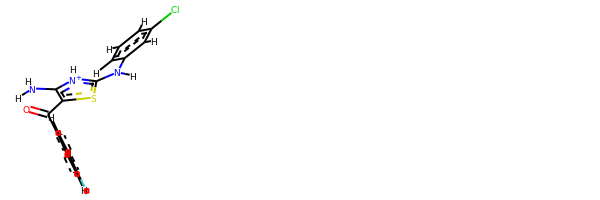

rdkit:  [H]c1c([H])c(Cl)c([H])c(N([H])c2sc(C(=O)c3c([H])c([H])c(F)c([H])c3[H])c(N([H])[H])[n+]2[H])c1[H]
oechem:  c1cc(cc(c1)Cl)Nc2[nH+]c(c(s2)C(=O)c3ccc(cc3)F)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
31.36515023331133

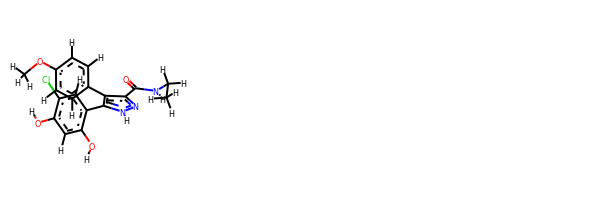

rdkit:  [H]Oc1c([H])c(O[H])c(-c2c(-c3c([H])c([H])c(OC([H])([H])[H])c([H])c3[H])c(C(=O)N([H])C([H])([H])C([H])([H])[H])nn2[H])c([H])c1Cl
oechem:  CCNC(=O)c1c(c([nH]n1)c2cc(c(cc2O)O)Cl)c3ccc(cc3)OC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
17.573639552559577 kJ/mol 57472.16584529669 kJ/mol False
angle
107.48059624985495 kJ/mol 107.48059624985495 kJ/mol True
nb
33.89853294885697 kJ/mol 33.89853294885697 kJ/mol True
torsion
0.37394570435359986 kJ/mol 0.373943662959288 kJ/mol False
159.3267144556251 kJ/mol 57613.918918158364 kJ/mol

-------------------------------------------------------------------
---------------------------

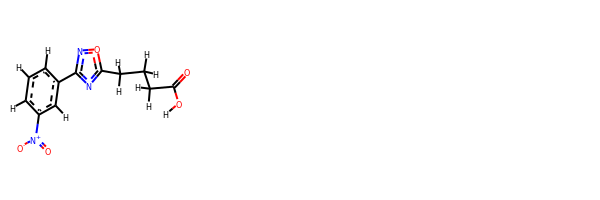

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])C([H])([H])c1nc(-c2c([H])c([H])c([H])c([N+](=O)[O-])c2[H])no1
oechem:  c1cc(cc(c1)[N+](=O)[O-])c2nc(on2)CCCC(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
10.972577806404297 kJ/mol 57650.7920472908 kJ/mol False
angle
84.30952869402967 kJ/mol 84.30952869402967 kJ/mol True
nb
27.24542924895592 kJ/mol 27.24542924895592 kJ/mol True
torsion
6.274533518794473 kJ/mol 15.685648414031068 kJ/mol False
128.80206926818437 kJ/mol 57778.03265364782 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
------

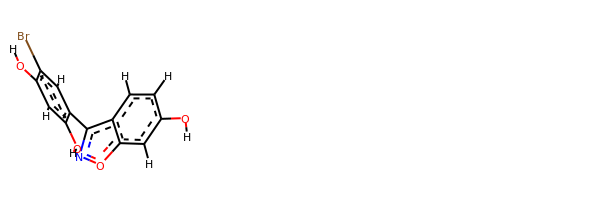

rdkit:  [H]Oc1c([H])c(O[H])c(-c2noc3c([H])c(O[H])c([H])c([H])c23)c([H])c1Br
oechem:  c1cc2c(cc1O)onc2c3cc(c(cc3O)O)Br
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

##################################################################

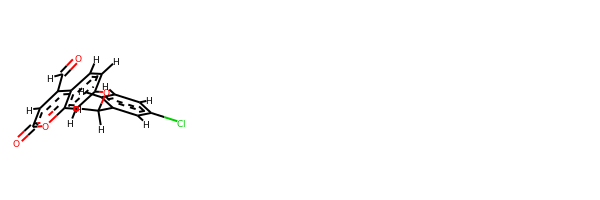

rdkit:  [H]C(=O)c1c([H])c(=O)oc2c([H])c(OC([H])([H])c3c([H])c([H])c([H])c(Cl)c3[H])c([H])c([H])c12
oechem:  c1cc(cc(c1)Cl)COc2ccc3c(cc(=O)oc3c2)C=O
###########################################################################
 #########################################################

bond
29.83231897423997 kJ/mol 56704.9393402979 kJ/mol False
angle
12.254123582809562 kJ/mol 12.254123582809562 kJ/mol True
nb
60.74894206013358 kJ/mol 60.74894206013358 kJ/mol True
torsion
0.050848365912064444 kJ/mol 0.05087611769155551 kJ/mol False
102.88623298309518 kJ/mol 56777.99328205853 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5444


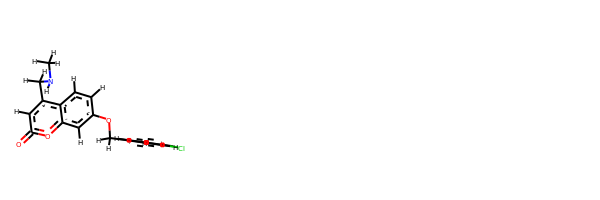

rdkit:  [H]c1c([H])c(Cl)c([H])c(C([H])([H])Oc2c([H])c([H])c3c(C([H])([H])N([H])C([H])([H])[H])c([H])c(=O)oc3c2[H])c1[H]
oechem:  CNCc1cc(=O)oc2c1ccc(c2)OCc3cccc(c3)Cl
###########################################################################
 #########################################################

bond
38.720685710059556 kJ/mol 56498.795384338184 kJ/mol False
angle
211.1024103603305 kJ/mol 211.1024103603305 kJ/mol True
nb
84.62009592434052 kJ/mol 84.62009592434052 kJ/mol True
torsion
43.148646352581814 kJ/mol 44.593933027646365 kJ/mol False
377.59183834731243 kJ/mol 56839.111823650506 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5445


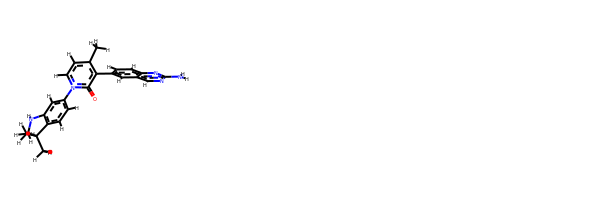

rdkit:  [H]c1c([H])c2c(c([H])c1-n1c([H])c([H])c(C([H])([H])[H])c(-c3c([H])c([H])c4nc(N([H])[H])nc([H])c4c3[H])c1=O)N([H])C([H])([H])C2(C([H])([H])[H])C([H])([H])[H]
oechem:  Cc1ccn(c(=O)c1c2ccc3c(c2)cnc(n3)N)c4ccc5c(c4)NCC5(C)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
18.513681513896643 kJ/mol 58383.86002155768 kJ/mol False
angle
122.49679419728297 kJ/mol 122.49679419728297 kJ/mol True
nb
0.45286751909625805 kJ/mol 0.45286751909625805 kJ/mol True
torsion
23.514889407814334 kJ/mol 18.26810084428711 kJ/mol False
164.9782326380902 kJ/mol 58525.07778411835 kJ/mol

-------------------------------------------------------------

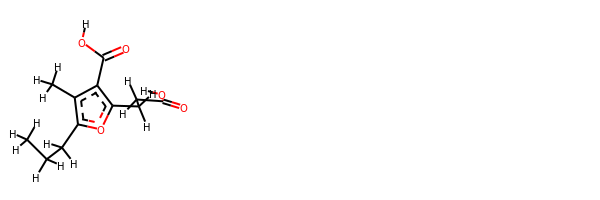

rdkit:  [H]OC(=O)c1c(C([H])([H])C([H])([H])C(=O)O[H])oc(C([H])([H])C([H])([H])C([H])([H])[H])c1C([H])([H])[H]
oechem:  CCCc1c(c(c(o1)CCC(=O)O)C(=O)O)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
15.04990209799308 kJ/mol 43730.539286357474 kJ/mol False
angle
59.2352480643782 kJ/mol 61.07589995390229 kJ/mol False
nb
46.37504918277841 kJ/mol 46.37504918277841 kJ/mol True
torsion
68.46541485924844 kJ/mol 68.46541767100858 kJ/mol False
189.12561420439812 kJ/mol 43906.45565316517 kJ/mol

--------

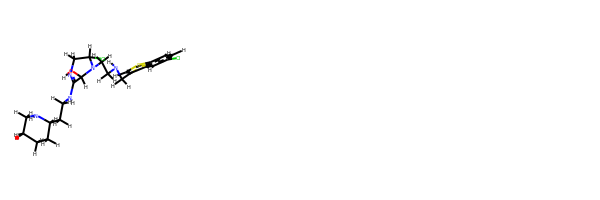

rdkit:  [H]OC1([H])C(N([H])C([H])([H])C([H])([H])C2([H])N([H])C([H])([H])C([H])([H])C([H])([H])C2([H])[H])=NC([H])([H])C([H])(Cl)N1C([H])([H])C([H])([H])N([H])C([H])([H])c1c([H])sc2c([H])c([H])c(Cl)c([H])c12
oechem:  c1cc2c(cc1Cl)c(cs2)CNCCN3C(CN=C(C3O)NCCC4CCCCN4)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
17.58115038047835 kJ/mol 57876.551435051726 kJ/mol False
angle
122.17366015149814 kJ/mol 123.55482530624447 kJ/mol False
nb
32.580733219449925 kJ/mol 32.580733219449925 kJ/mol True
torsion
5.224205912755251 kJ/mol 5.224232497007684 kJ/mol False
177.55974966418165 kJ/mol 58037.91122607443 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
----------------------

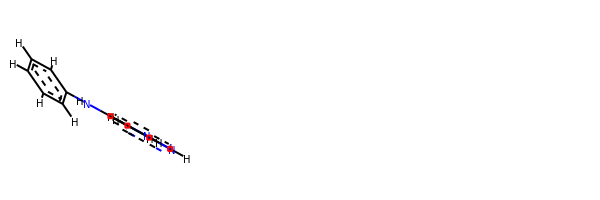

rdkit:  [H]c1nc2c(c([H])c1[H])c(N([H])c1c([H])c([H])c([H])c([H])c1[H])c([H])n2[H]
oechem:  c1ccc(cc1)Nc2c[nH]c3c2cccn3
###########################################################################
 #########################################################

bond
15.228931313297037 kJ/mol 57876.07730553101 kJ/mol False
angle
100.17759811031371 kJ/mol 101.55735675227349 kJ/mol False
nb
47.933767143031744 kJ/mol 47.933767143031744 kJ/mol True
torsion
3.9776740765442633 kJ/mol 0.0030450677736566668 kJ/mol False
167.31797064318675 kJ/mol 58025.57147449409 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5455


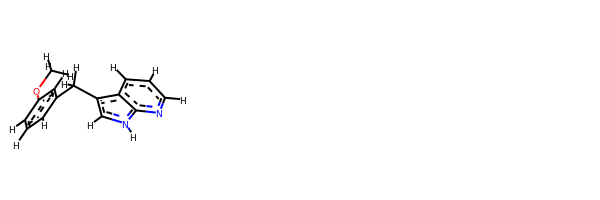

rdkit:  [H]c1nc2c(c([H])c1[H])c(C([H])([H])c1c([H])c([H])c([H])c(OC([H])([H])[H])c1[H])c([H])n2[H]
oechem:  COc1cccc(c1)Cc2c[nH]c3c2cccn3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
37.33012229606112 kJ/mol 56494.523008600554 kJ/mol False
angle
35.851037885270834 kJ/mol 35.851037885270834 kJ/mol True
nb
89.14477932513226 kJ/mol 89.14477932513226 kJ/mol True
torsion
27.13076607218572 kJ/mol 28.583192449548555 kJ/mol False
189.45670557864995 kJ/mol 56648.10201826051 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
------------------

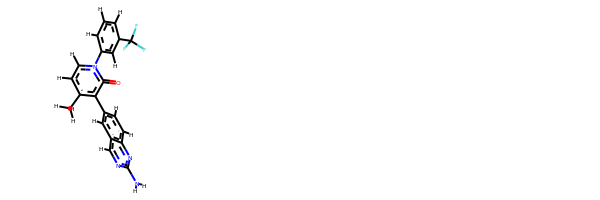

rdkit:  [H]c1c([H])c(-n2c([H])c([H])c(C([H])([H])[H])c(-c3c([H])c([H])c4nc(N([H])[H])nc([H])c4c3[H])c2=O)c([H])c(C(F)(F)F)c1[H]
oechem:  Cc1ccn(c(=O)c1c2ccc3c(c2)cnc(n3)N)c4cccc(c4)C(F)(F)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
24.133202528900163 kJ/mol 58390.522966528995 kJ/mol False
angle
145.60843866708416 kJ/mol 145.60843866708416 kJ/mol True
nb
19.35668969974588 kJ/mol 19.35668969974588 kJ/mol True
torsion
76.91250030494334 kJ/mol 76.91250044553185 kJ/mol False
266.0108312006735 kJ/mol 58632.40059534136 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5461


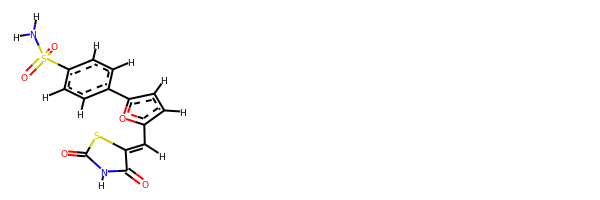

rdkit:  [H]C(=C1SC(=O)N([H])C1=O)c1oc(-c2c([H])c([H])c(S(=O)(=O)N([H])[H])c([H])c2[H])c([H])c1[H]
oechem:  c1cc(ccc1c2ccc(o2)C=C3C(=O)NC(=O)S3)S(=O)(=O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
12.341360425805505 kJ/mol 115032.2776549682 kJ/mol False
angle
97.84384737585493 kJ/mol 99.23385911605618 kJ/mol False
nb
23.064614569635662 kJ/mol 23.064614569635662 kJ/mol True
torsion
33.54038853761949 kJ/mol 0.06861344506474959 kJ/mol False
166.7902109089156 kJ/mol 115154.64474209896 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5465


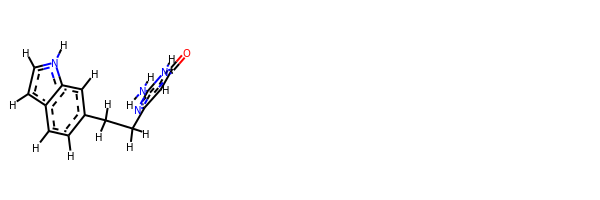

rdkit:  [H]c1c(C([H])([H])C([H])([H])c2nc(N([H])[H])n([H])c(=O)c2[H])c([H])c2c(c1[H])c([H])c([H])n2[H]
oechem:  c1cc(cc2c1cc[nH]2)CCc3cc(=O)[nH]c(n3)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
82266.58472689528 kJ/mol 126054.51091459091 kJ/mol False
angle
80.84277524774656 kJ/mol 82.99452528619065 kJ/mol False
nb
908.8493280418345 kJ/mol 908.8493280418345 kJ/mol True
torsion
161.7946897615748 kJ/mol 161.79469224395007 kJ/mol False
83418.07151994643 kJ/mol 127208.14946016288 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
------

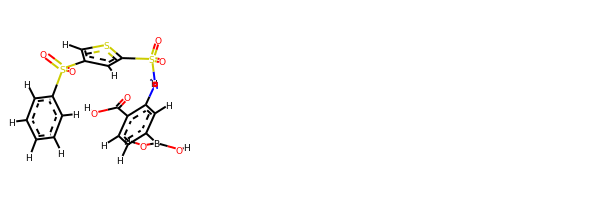

rdkit:  [H]OB(O[H])c1c([H])c([H])c(C(=O)O[H])c(N([H])S(=O)(=O)c2sc([H])c(S(=O)(=O)c3c([H])c([H])c([H])c([H])c3[H])c2[H])c1[H]
oechem:  B(c1ccc(c(c1)NS(=O)(=O)c2cc(cs2)S(=O)(=O)c3ccccc3)C(=O)O)(O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
12.392179617549692 kJ/mol 57677.04432696944 kJ/mol False
angle
116.1775430607147 kJ/mol 117.24829083869513 kJ/mol False
nb
29.84562448453385 kJ/mol 29.84562448453385 kJ/mol True
torsion
35.83350449337122 kJ/mol 35.83352537317207 kJ/mol False
194.24885165616945 kJ/mol 57859.97176766584 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5473


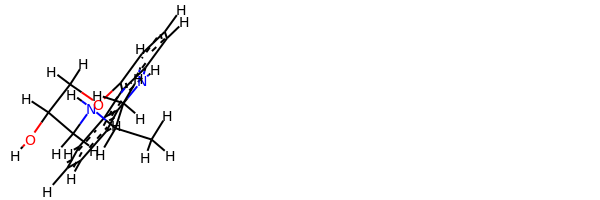

rdkit:  [H]OC([H])(C([H])([H])Oc1c([H])c([H])c([H])c2c1c1c([H])c([H])c([H])c([H])c1n2[H])C([H])([H])N([H])C([H])(C([H])([H])[H])C([H])([H])[H]
oechem:  CC(C)NCC(COc1cccc2c1c3ccccc3[nH]2)O
###########################################################################
 #########################################################

bond
29.573044100181384 kJ/mol 58315.31972423155 kJ/mol False
angle
121.05929057562676 kJ/mol 121.05929057562676 kJ/mol True
nb
107.71628844756749 kJ/mol 107.71628844756749 kJ/mol True
torsion
56.14342450769939 kJ/mol 53.6326209493427 kJ/mol False
314.492047631075 kJ/mol 58597.72792420409 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5474


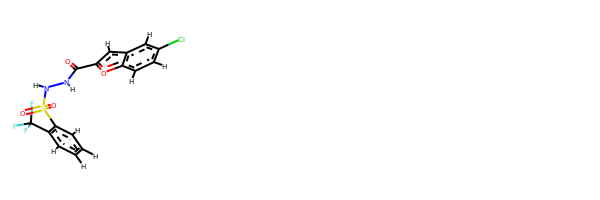

rdkit:  [H]c1c([H])c([H])c(S(=O)(=O)N([H])N([H])C(=O)c2oc3c([H])c([H])c(Cl)c([H])c3c2[H])c(C(F)(F)F)c1[H]
oechem:  c1ccc(c(c1)C(F)(F)F)S(=O)(=O)NNC(=O)c2cc3cc(ccc3o2)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
23.413713474022728 kJ/mol 86841.15747579931 kJ/mol False
angle
188.3586720152143 kJ/mol 188.3586720152143 kJ/mol True
nb
81.20542959552847 kJ/mol 81.20542959552847 kJ/mol True
torsion
9.39873967169926 kJ/mol 0.19452361511903227 kJ/mol False
302.37655475646477 kJ/mol 87110.91610102517 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5476


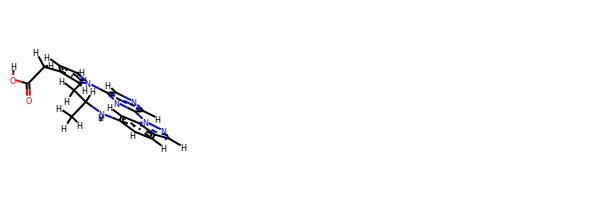

rdkit:  [H]OC(=O)C([H])([H])c1c([H])c([H])n(-c2nc(-n3nc([H])c4c([H])c([H])c(N([H])C([H])(C([H])([H])[H])C([H])([H])[H])c([H])c43)c([H])nc2[H])c1[H]
oechem:  CC(C)Nc1ccc2cnn(c2c1)c3cncc(n3)n4ccc(c4)CC(=O)O
###########################################################################
 #########################################################

bond
17.095989840227514 kJ/mol 43803.67786497696 kJ/mol False
angle
65.28153609818695 kJ/mol 67.43576153059136 kJ/mol False
nb
71.63031403948105 kJ/mol 71.63031403948105 kJ/mol True
torsion
111.85334176518785 kJ/mol 111.85333268791949 kJ/mol False
265.86118174308336 kJ/mol 44054.597273234955 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5477


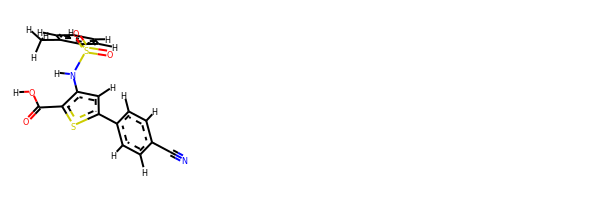

rdkit:  [H]OC(=O)c1sc(-c2c([H])c([H])c(C#N)c([H])c2[H])c([H])c1N([H])S(=O)(=O)c1c([H])c([H])c([H])c([H])c1C([H])([H])[H]
oechem:  Cc1ccccc1S(=O)(=O)Nc2cc(sc2C(=O)O)c3ccc(cc3)C#N
###########################################################################
 #########################################################

bond
31.7029737906637 kJ/mol 57033.426861185886 kJ/mol False
angle
46.34824215126624 kJ/mol 46.34824215126624 kJ/mol True
nb
89.83059523885412 kJ/mol 89.83059523885412 kJ/mol True
torsion
51.62247350593897 kJ/mol 30.370793119326056 kJ/mol False
219.50428468672305 kJ/mol 57199.976491695335 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5478


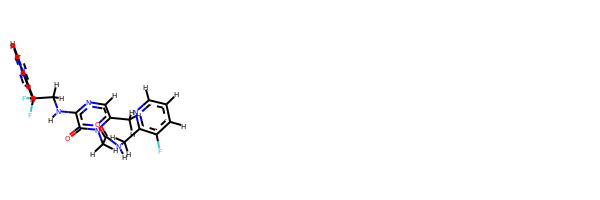

rdkit:  [H]c1nc(C(F)(F)C([H])([H])N([H])c2nc([H])c(C([H])([H])[H])n(C([H])([H])C(=O)N([H])C([H])([H])c3nc([H])c([H])c([H])c3F)c2=O)c([H])c([H])c1[H]
oechem:  Cc1cnc(c(=O)n1CC(=O)NCc2c(cccn2)F)NCC(c3ccccn3)(F)F
###########################################################################
 #########################################################

bond
30.197504286278054 kJ/mol 56590.47862169379 kJ/mol False
angle
37.2261953078133 kJ/mol 37.25188596571974 kJ/mol False
nb
93.41407964068048 kJ/mol 93.41407964068048 kJ/mol True
torsion
51.62349685721052 kJ/mol 30.371029298881798 kJ/mol False
212.46127609198234 kJ/mol 56751.51561659907 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5479


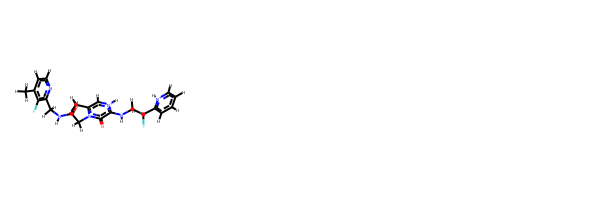

rdkit:  [H]c1nc(C([H])([H])N([H])C(=O)C([H])([H])n2c(C([H])([H])[H])c([H])[n+]([H])c(N([H])C([H])([H])C(F)(F)c3c([H])c([H])c([H])c([H])[n+]3[H])c2=O)c(F)c(C([H])([H])[H])c1[H]
oechem:  Cc1ccnc(c1F)CNC(=O)Cn2c(c[nH+]c(c2=O)NCC(c3cccc[nH+]3)(F)F)C
###########################################################################
 #########################################################

bond
30.78201446866931 kJ/mol 57132.08029176451 kJ/mol False
angle
32.94177353249731 kJ/mol 32.94177353249731 kJ/mol True
nb
90.09457056334232 kJ/mol 90.09457056334232 kJ/mol True
torsion
51.62301637460234 kJ/mol 30.3713178927278 kJ/mol False
205.44137493911126 kJ/mol 57285.48795375308 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5480


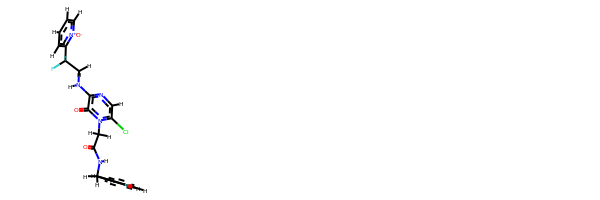

rdkit:  [H]c1nc(N([H])C([H])([H])C(F)(F)c2c([H])c([H])c([H])c([H])[n+]2[O-])c(=O)n(C([H])([H])C(=O)N([H])C([H])([H])c2c([H])c([H])c([H])c([H])c2F)c1Cl
oechem:  c1ccc(c(c1)CNC(=O)Cn2c(cnc(c2=O)NCC(c3cccc[n+]3[O-])(F)F)Cl)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #####################

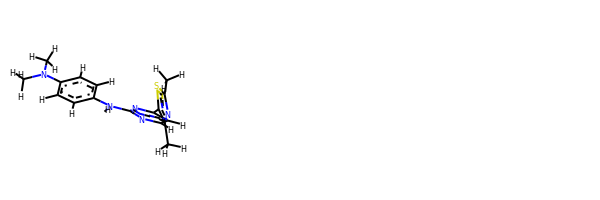

rdkit:  [H]c1nc(N([H])c2c([H])c([H])c(N(C([H])([H])[H])C([H])([H])[H])c([H])c2[H])nc(-c2sc(C([H])([H])[H])nc2C([H])([H])[H])c1[H]
oechem:  Cc1c(sc(n1)C)c2ccnc(n2)Nc3ccc(cc3)N(C)C
###########################################################################
 #########################################################

bond
12.639171954039858 kJ/mol 57871.112708602464 kJ/mol False
angle
137.58907681332434 kJ/mol 137.58907681332434 kJ/mol True
nb
59.54578227828746 kJ/mol 59.54578227828746 kJ/mol True
torsion
40.87807869825419 kJ/mol 35.94165329867099 kJ/mol False
250.65210974390584 kJ/mol 58104.18922099275 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5492


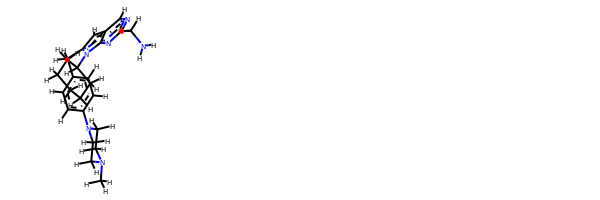

rdkit:  [H]c1c([H])c(C([H])([H])c2c([H])c3c([H])nc(C([H])([H])N([H])[H])nc3n2C2([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C2([H])[H])c([H])c([H])c1N1C([H])([H])C([H])([H])N(C([H])([H])[H])C([H])([H])C1([H])[H]
oechem:  CN1CCN(CC1)c2ccc(cc2)Cc3cc4cnc(nc4n3C5CCCCC5)CN
###########################################################################
 #########################################################

bond
21.880816340117352 kJ/mol 115102.11264347263 kJ/mol False
angle
102.73818767105477 kJ/mol 104.90505396998428 kJ/mol False
nb
39.45493361139497 kJ/mol 39.45493361139497 kJ/mol True
torsion
51.80414082658352 kJ/mol 17.072748561144664 kJ/mol False
215.87807844915062 kJ/mol 115263.54537961516 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5493


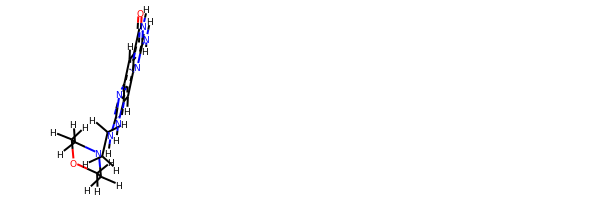

rdkit:  [H]c1c2nc(N([H])C([H])([H])C([H])([H])N3C([H])([H])C([H])([H])OC([H])([H])C3([H])[H])n([H])c2c([H])c2nc(N([H])[H])n([H])c(=O)c12
oechem:  c1c2c(cc3c1nc([nH]3)NCCN4CCOCC4)nc([nH]c2=O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
48.450976709304946 kJ/mol 45832.948033253066 kJ/mol False
angle
110.18954774760383 kJ/mol 110.18954774760383 kJ/mol True
nb
43.03822195089867 kJ/mol 43.03822195089867 kJ/mol True
torsion
107.14228899959122 kJ/mol 107.1422856102977 kJ/mol False
308.82103540739865 kJ/mol 46093.318088561864 kJ/mol

-------------------------------------------------------------------
------------------------------

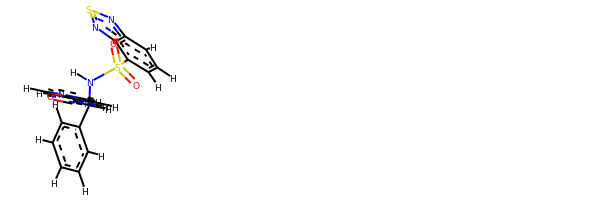

rdkit:  [H]c1nc([H])c([H])c(N([H])C(=O)C([H])(c2c([H])c([H])c([H])c([H])c2[H])N([H])S(=O)(=O)c2c([H])c([H])c([H])c3nsnc23)c1[H]
oechem:  c1ccc(cc1)C(C(=O)Nc2ccncc2)NS(=O)(=O)c3cccc4c3nsn4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
26.002724223471606 kJ/mol 57779.34418239886 kJ/mol False
angle
102.0382154804612 kJ/mol 102.0382154804612 kJ/mol True
nb
57.569919618119144 kJ/mol 57.569919618119144 kJ/mol True
torsion
97.51971255437537 kJ/mol 77.5862855865256 kJ/mol False
283.1305718764273 kJ/mol 58016.538603083965 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5498


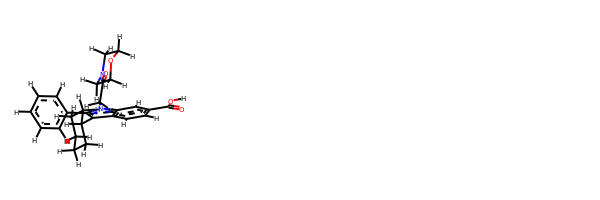

rdkit:  [H]OC(=O)c1c([H])c([H])c2c(C3([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C3([H])[H])c(-c3c([H])c([H])c([H])c([H])c3[H])n(C([H])([H])C(=O)N3C([H])([H])C([H])([H])OC([H])([H])C3([H])[H])c2c1[H]
oechem:  c1ccc(cc1)c2c(c3ccc(cc3n2CC(=O)N4CCOCC4)C(=O)O)C5CCCCC5
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
44.071572272353734 kJ/mol 99.1525664692601 kJ/mol False
angle
77.1638558219311 kJ/mol 77.1638558219311 kJ/mol True
nb
5.96685261549368 kJ/mol 5.96685261549368 kJ/mol True
torsion
12

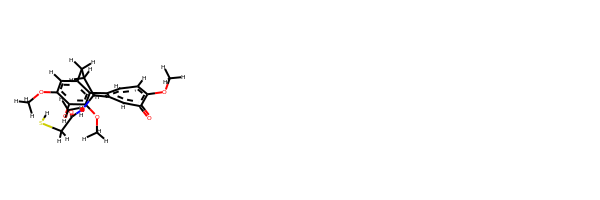

rdkit:  [H]SC([H])([H])C(=O)N([H])C1([H])c2c(c([H])c([H])c(OC([H])([H])[H])c(=O)c2[H])-c2c(OC([H])([H])[H])c(OC([H])([H])[H])c(OC([H])([H])[H])c([H])c2C([H])([H])C1([H])[H]
oechem:  COc1ccc-2c(cc1=O)C(CCc3c2c(c(c(c3)OC)OC)OC)NC(=O)CS
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
18.91393254864442 kJ/mol 155779.84021062392 kJ/mol False
angle
121.5299932393472 kJ/mol 123.71197999415956 kJ/mol False
nb
37.89302112408764 kJ/mol 37.89302112408764 kJ/mol True
torsion
35.89303507628713 kJ/mol 15.693255331942941 kJ/mol False
214.22998198836638 kJ/mol 155957.13846707414 kJ/mol

---------------------------------------------------------

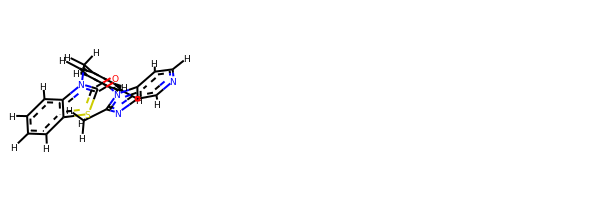

rdkit:  [H]c1nc([H])c2nc(C([H])([H])[H])n(-c3c([H])c([H])c(C([H])([H])n4c(=O)sc5c([H])c([H])c([H])c([H])c54)c([H])c3[H])c2c1[H]
oechem:  Cc1nc2cnccc2n1c3ccc(cc3)Cn4c5ccccc5sc4=O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
1

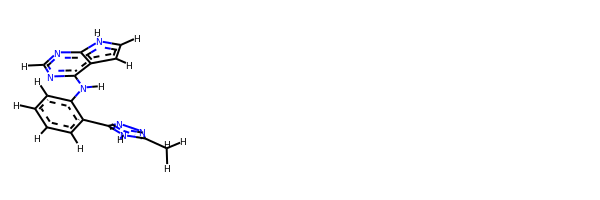

rdkit:  [H]c1nc(N([H])c2c([H])c([H])c([H])c([H])c2-c2nnc(C([H])([H])[H])n2[H])c2c([H])c([H])n([H])c2n1
oechem:  Cc1[nH]c(nn1)c2ccccc2Nc3c4cc[nH]c4ncn3
###########################################################################
 #########################################################

bond
15.200164552973604 kJ/mol 115883.9717519302 kJ/mol False
angle
186.35784003840016 kJ/mol 190.12034047358472 kJ/mol False
nb
15.384130249741455 kJ/mol 15.384130249741455 kJ/mol True
torsion
21.225119605056335 kJ/mol 20.436123990783578 kJ/mol False
238.16725444617154 kJ/mol 116109.91234664433 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5512


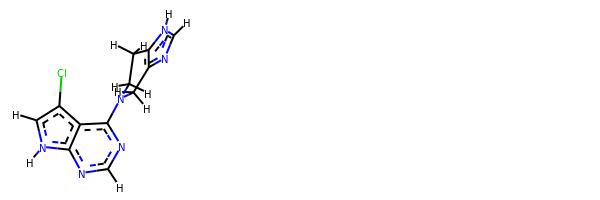

rdkit:  [H]c1nc(N2C([H])([H])c3nc([H])n([H])c3C([H])([H])C2([H])[H])c2c(Cl)c([H])n([H])c2n1
oechem:  c1c(c2c([nH]1)ncnc2N3CCc4c(nc[nH]4)C3)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
18.231639944094592 kJ/mol 173384.2905601375 kJ/mol False
angle
249.15305863682042 kJ/mol 252.9963302997025 kJ/mol False
nb
-1.2905055996082668 kJ/mol -1.2905055996082668 kJ/mol True
torsion
78.66033972780252 kJ/mol 73.63996453816095 kJ/mol False
344.7545327091093 kJ/mol 173709.63634937577 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-----------

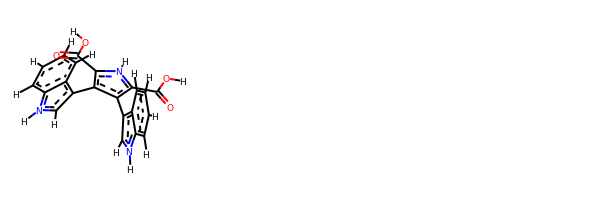

rdkit:  [H]OC(=O)c1c(-c2c([H])n([H])c3c([H])c([H])c([H])c([H])c23)c(-c2c([H])n([H])c3c([H])c([H])c([H])c([H])c23)c(C(=O)O[H])n1[H]
oechem:  c1ccc2c(c1)c(c[nH]2)c3c(c([nH]c3C(=O)O)C(=O)O)c4c[nH]c5c4cccc5
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
19.838921600382708 kJ/mol 43692.65059481511 kJ/mol False
angle
425.24214150851657 kJ/mol 428.5987327802674 kJ/mol False
nb
-2.1901397348463116 kJ/mol -2.1901397348463116 kJ/mol True
torsion
45.869886483884 kJ/mol 45.86998291769942 kJ/mol False
488.760809857937 kJ/mol 44164.929170778225 kJ/mol

-------------------------------------------------------------------
---------------------

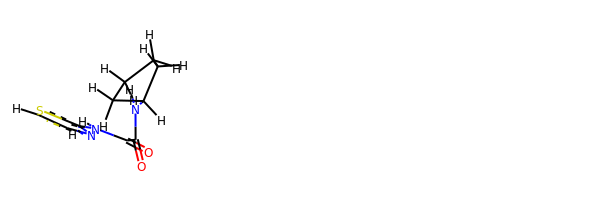

rdkit:  [H]c1nc(N([H])C(=O)C(=O)N([H])C2([H])C([H])([H])C([H])([H])C([H])([H])C2([H])[H])sc1[H]
oechem:  c1csc(n1)NC(=O)C(=O)NC2CCCC2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
31.651954981422364 kJ/mol 29101.277871737857 kJ/mol False
angle
99.28983341320034 kJ/mol 101.02180202307063 kJ/mol False
nb
35.26548627245722 kJ/mol 35.26548627245722 kJ/mol True
torsion
49.1985676689581 kJ/mol 43.96860701537663 kJ/mol False
215.40584233603803 kJ/mol 29281.53376704876 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-----------------------

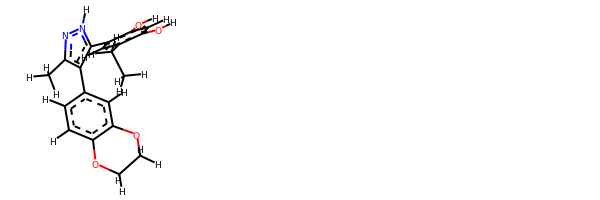

rdkit:  [H]Oc1c([H])c(O[H])c(C([H])([H])C([H])([H])[H])c([H])c1-c1c(-c2c([H])c([H])c3c(c2[H])OC([H])([H])C([H])([H])O3)c(C([H])([H])[H])nn1[H]
oechem:  CCc1cc(c(cc1O)O)c2c(c(n[nH]2)C)c3ccc4c(c3)OCCO4
###########################################################################
 #########################################################

bond
50.40203926741571 kJ/mol 28638.076431666923 kJ/mol False
angle
116.08804116956568 kJ/mol 117.75725331497853 kJ/mol False
nb
46.3327592899263 kJ/mol 46.3327592899263 kJ/mol True
torsion
15.70114857191016 kJ/mol 15.701203808118704 kJ/mol False
228.52398829881787 kJ/mol 28817.867648079948 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5522


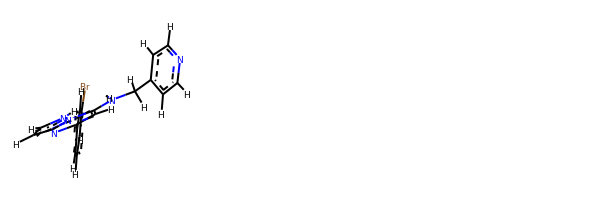

rdkit:  [H]c1nc([H])c([H])c(C([H])([H])N([H])c2c([H])c(-c3c([H])c([H])c([H])c(Br)c3[H])nc3c([H])c([H])n([H])[n+]23)c1[H]
oechem:  c1cc(cc(c1)Br)c2cc([n+]3c(n2)cc[nH]3)NCc4ccncc4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
82010.06688152859 kJ/mol 125681.31683627036 kJ/mol False
angle
61.68985494686435 kJ/mol 65.04832113203038 kJ/mol False
nb
143.8901783602321 kJ/mol 143.8901783602321 kJ/mol True
torsion
46.638654917454176 kJ/mol 29.80973554863439 kJ/mol False
82262.28556975313 kJ/mol 125920

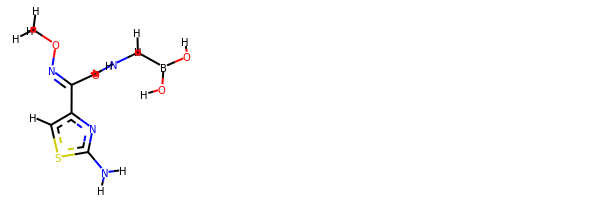

rdkit:  [H]OB(O[H])C([H])([H])N([H])C(=O)C(=NOC([H])([H])[H])c1nc(N([H])[H])sc1[H]
oechem:  B(CNC(=O)C(=NOC)c1csc(n1)N)(O)O
###########################################################################
 #########################################################

bond
22.36827769799266 kJ/mol 57660.68705010315 kJ/mol False
angle
90.66170202244943 kJ/mol 90.66170202244943 kJ/mol True
nb
46.45729499040025 kJ/mol 46.45729499040025 kJ/mol True
torsion
23.34731016855898 kJ/mol 32.76105761566738 kJ/mol False
182.83458487940132 kJ/mol 57830.56710473167 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5527


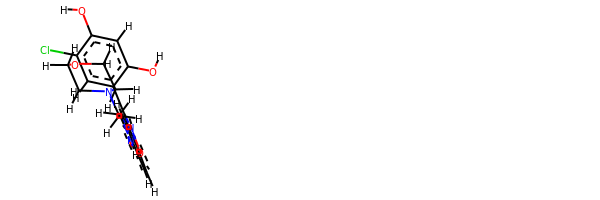

rdkit:  [H]Oc1c([H])c(O[H])c(-c2noc3c([H])c([H])c(N([H])C([H])([H])C([H])([H])N4C([H])([H])C([H])([H])OC([H])([H])C4([H])[H])c([H])c23)c([H])c1Cl
oechem:  c1cc2c(cc1NCCN3CCOCC3)c(no2)c4cc(c(cc4O)O)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
20.982054012969378 kJ/mol 57487.529418700426 kJ/mol False
angle
436.2615705839443 kJ/mol 437.47024567391054 kJ/mol False
nb
17.675653714937297 kJ/mol 17.675653714937297 kJ/mol True
torsion
54.29180352876325 kJ/mol 54.316260238210965 kJ/mol False
529.2110818406143 kJ/mol 57996.991578327485 kJ/mol

-------------------------------------------------------------------
---------------------

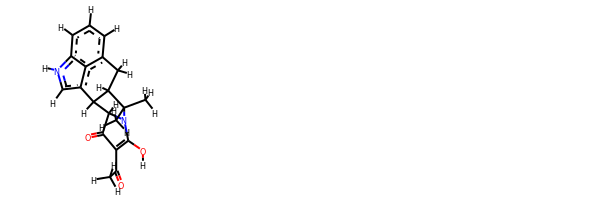

rdkit:  [H]OC1=C(C(=O)C([H])([H])[H])C(=O)C2([H])N1C(C([H])([H])[H])(C([H])([H])[H])C1([H])C([H])([H])c3c([H])c([H])c([H])c4c3c(c([H])n4[H])C21[H]
oechem:  CC(=O)C1=C(N2C(C1=O)C3c4c[nH]c5c4c(ccc5)CC3C2(C)C)O
###########################################################################
 #########################################################

bond
60.16786756995105 kJ/mol 101445.31493541197 kJ/mol False
angle
147.9648688755833 kJ/mol 151.13176743368297 kJ/mol False
nb
24.49469901591917 kJ/mol 24.49469901591917 kJ/mol True
torsion
113.21278515090071 kJ/mol 98.59182162228485 kJ/mol False
345.8402206123543 kJ/mol 101719.53322348386 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5531


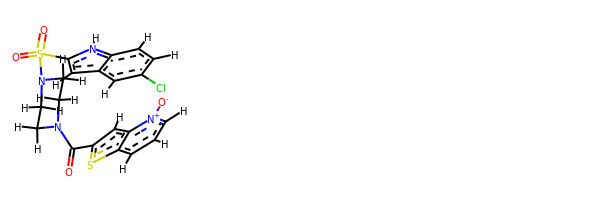

rdkit:  [H]c1c(Cl)c([H])c2c([H])c(S(=O)(=O)N3C([H])([H])C([H])([H])N(C(=O)c4sc5c([H])c([H])c([H])[n+]([O-])c5c4[H])C([H])([H])C3([H])[H])n([H])c2c1[H]
oechem:  c1cc2c(cc(s2)C(=O)N3CCN(CC3)S(=O)(=O)c4cc5cc(ccc5[nH]4)Cl)[n+](c1)[O-]
###########################################################################
 #########################################################

bond
27.84236424089891 kJ/mol 85608.45070415521 kJ/mol False
angle
120.56646722765309 kJ/mol 120.75261318251763 kJ/mol False
nb
43.734811717060815 kJ/mol 43.734811717060815 kJ/mol True
torsion
37.81277777839615 kJ/mol 15.846780973861245 kJ/mol False
229.95642096400897 kJ/mol 85788.78491002865 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5532


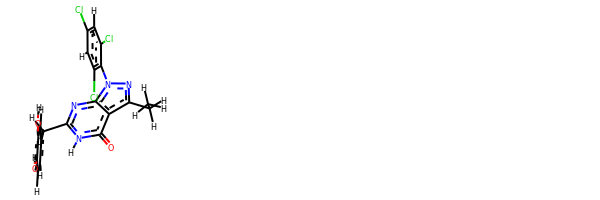

rdkit:  [H]Oc1c([H])c([H])c(C([H])([H])c2nc3c(c(C([H])([H])C([H])([H])[H])nn3-c3c(Cl)c([H])c(Cl)c([H])c3Cl)c(=O)n2[H])c([H])c1O[H]
oechem:  CCc1c2c(=O)[nH]c(nc2n(n1)c3c(cc(cc3Cl)Cl)Cl)Cc4ccc(c(c4)O)O
###########################################################################
 #########################################################

bond
17.5366277019721 kJ/mol 58038.56285854543 kJ/mol False
angle
103.10751413275815 kJ/mol 105.11694151334697 kJ/mol False
nb
34.13840078188968 kJ/mol 34.13840078188968 kJ/mol True
torsion
43.30247854734521 kJ/mol 46.442149862816514 kJ/mol False
198.08502116396514 kJ/mol 58224.26035070349 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5533


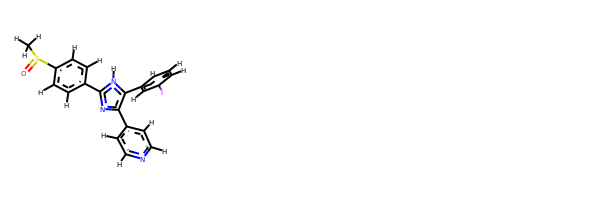

rdkit:  [H]c1nc([H])c([H])c(-c2nc(-c3c([H])c([H])c(S(=O)C([H])([H])[H])c([H])c3[H])n([H])c2-c2c([H])c([H])c([H])c(I)c2[H])c1[H]
oechem:  CS(=O)c1ccc(cc1)c2[nH]c(c(n2)c3ccncc3)c4cccc(c4)I
###########################################################################
 #########################################################

bond
34.40031375914191 kJ/mol 28994.62251608211 kJ/mol False
angle
138.7488380833262 kJ/mol 140.32191250907414 kJ/mol False
nb
76.38433959954574 kJ/mol 76.38433959954574 kJ/mol True
torsion
12.641414252475244 kJ/mol 7.411443504519286 kJ/mol False
262.1749056944891 kJ/mol 29218.740211695247 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5534


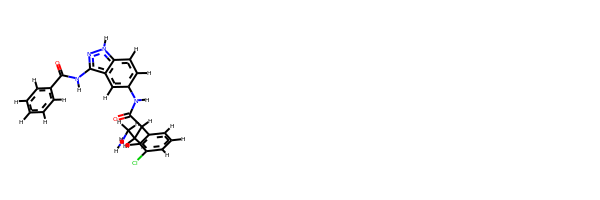

rdkit:  [H]c1c([H])c([H])c(C(=O)N([H])c2nn([H])c3c([H])c([H])c(N([H])C(=O)C([H])(c4c([H])c([H])c([H])c(Cl)c4[H])C([H])([H])C([H])([H])N([H])[H])c([H])c23)c([H])c1[H]
oechem:  c1ccc(cc1)C(=O)Nc2c3cc(ccc3[nH]n2)NC(=O)C(CCN)c4cccc(c4)Cl
###########################################################################
 #########################################################

bond
11.036070752838866 kJ/mol 58376.04662063202 kJ/mol False
angle
106.58299436761358 kJ/mol 106.58299436761358 kJ/mol True
nb
24.812947166931195 kJ/mol 24.812947166931195 kJ/mol True
torsion
4.2399615070073065 kJ/mol 4.2397673767222495 kJ/mol False
146.67197379439096 kJ/mol 58511.682329543284 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5535


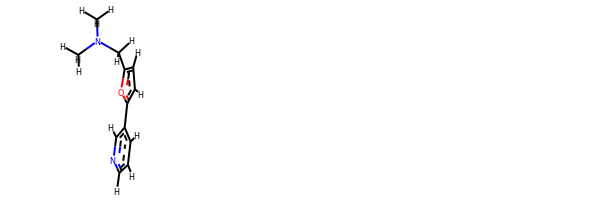

rdkit:  [H]c1nc([H])c(-c2oc(C([H])([H])N(C([H])([H])[H])C([H])([H])[H])c([H])c2[H])c([H])c1[H]
oechem:  CN(C)Cc1ccc(o1)c2cccnc2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
18.52346799774145 kJ/mol 86800.47783850173 kJ/mol False
angle
158.13115513735897 kJ/mol 159.76923443987624 kJ/mol False
nb
14.644321444186676 kJ/mol 14.644321444186676 kJ/mol True
torsion
7.320587723329674 kJ/mol 5.225505227023161 kJ/mol False
198.6195323026168 kJ/mol 86980.11689961281 kJ/mol

----------------------------

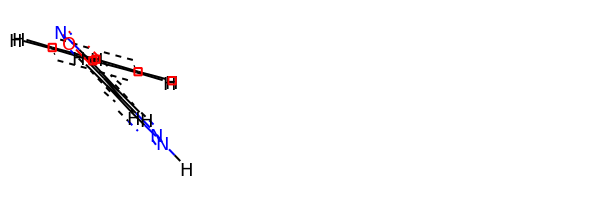

rdkit:  [H]c1c(-c2c([H])c([H])c([H])c([H])c2[H])noc1-c1nn([H])c([H])c1[H]
oechem:  c1ccc(cc1)c2cc(on2)c3cc[nH]n3
###########################################################################
 #########################################################

bond
13.536714331553778 kJ/mol 72753.94385719212 kJ/mol False
angle
118.73806790288079 kJ/mol 123.73903476833637 kJ/mol False
nb
21.19549993118653 kJ/mol 21.19549993118653 kJ/mol True
torsion
6.208612644215377 kJ/mol 2.4440002615422123 kJ/mol False
159.67889480983646 kJ/mol 72901.32239215319 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5540


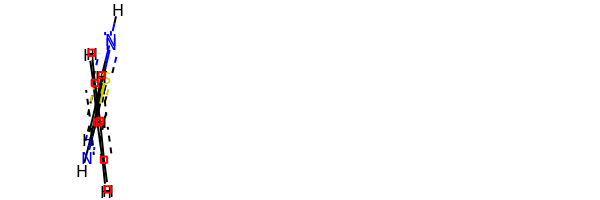

rdkit:  [H]c1nc(-c2c([H])c([H])c([H])c([H])c2[H])sc1-c1nn([H])c([H])c1[H]
oechem:  c1ccc(cc1)c2ncc(s2)c3cc[nH]n3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
17.39088956541691 kJ/mol 43691.01019157304 kJ/mol False
angle
69.83135317139613 kJ/mol 73.18701975989319 kJ/mol False
nb
61.25292063876894 kJ/mol 61.25292063876894 kJ/mol True
torsion
23.20340059584746 kJ/mol 23.203730886580765 kJ/mol False
171.67856397142944 kJ/mol 43848.653862858286 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5542


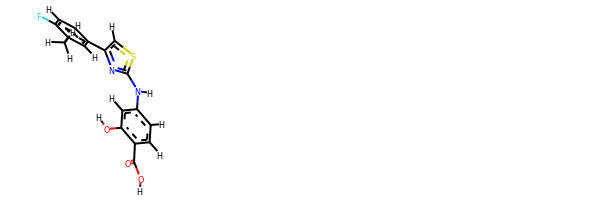

rdkit:  [H]OC(=O)c1c([H])c([H])c(N([H])c2nc(-c3c([H])c([H])c(F)c(C([H])([H])[H])c3[H])c([H])s2)c([H])c1O[H]
oechem:  Cc1cc(ccc1F)c2csc(n2)Nc3ccc(c(c3)O)C(=O)O
###########################################################################
 #########################################################

bond
14.463935526172223 kJ/mol 58377.962501293965 kJ/mol False
angle
109.0435284737308 kJ/mol 109.0435284737308 kJ/mol True
nb
20.746100157776333 kJ/mol 20.746100157776333 kJ/mol True
torsion
0.10773626431401298 kJ/mol 0.10751438265448608 kJ/mol False
144.36130042199338 kJ/mol 58507.859644308126 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5543


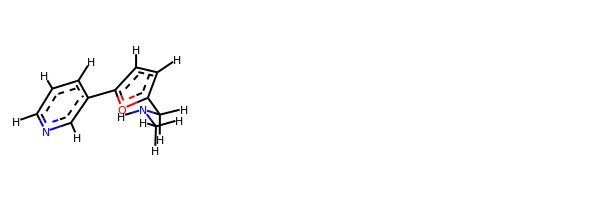

rdkit:  [H]c1nc([H])c(-c2oc(C([H])([H])N([H])C([H])([H])[H])c([H])c2[H])c([H])c1[H]
oechem:  CNCc1ccc(o1)c2cccnc2
###########################################################################
 #########################################################

bond
33.603343300294924 kJ/mol 28745.59730001777 kJ/mol False
angle
293.5595999906985 kJ/mol 295.06617150406964 kJ/mol False
nb
47.3100533696312 kJ/mol 47.3100533696312 kJ/mol True
torsion
60.429548597082366 kJ/mol 51.871570997081456 kJ/mol False
434.90254525770695 kJ/mol 29139.84509588855 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5544


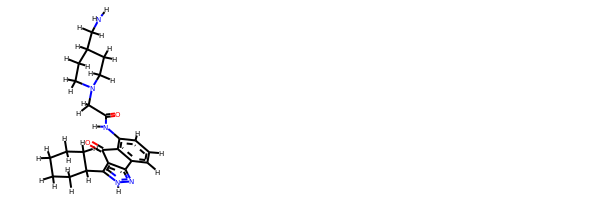

rdkit:  [H]c1c([H])c2c(c(N([H])C(=O)C([H])([H])N3C([H])([H])C([H])([H])C([H])(C([H])([H])N([H])[H])C([H])([H])C3([H])[H])c1[H])C(=O)c1c-2nn([H])c1C1([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C1([H])[H]
oechem:  c1cc-2c(c(c1)NC(=O)CN3CCC(CC3)CN)C(=O)c4c2n[nH]c4C5CCCCC5
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
14.195043091094407 kJ/mol 58377.693608858885 kJ/mol False
angle
128.12387290149795 kJ/mol 128.12387290149795 kJ/mol True
nb
19.180042480015068 kJ/mol 19.180042480015068 kJ/mol True
torsion
5.02559198433258 kJ/mol 5.025370102673053 kJ/mol False
166.52455045694 kJ/mol 58530.02289434307 kJ/mol

-------------------

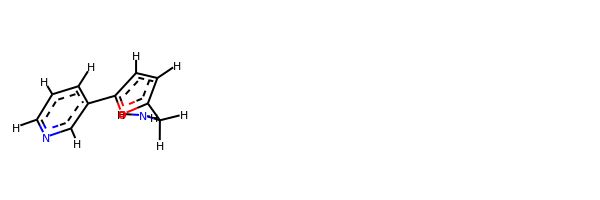

rdkit:  [H]c1nc([H])c(-c2oc(C([H])([H])N([H])[H])c([H])c2[H])c([H])c1[H]
oechem:  c1cc(cnc1)c2ccc(o2)CN
###########################################################################
 #########################################################

bond
47.34759524062665 kJ/mol 72429.98036801978 kJ/mol False
angle
307.45219083213686 kJ/mol 312.3560403961074 kJ/mol False
nb
35.56547585095062 kJ/mol 35.56547585095062 kJ/mol True
torsion
32.67858166764067 kJ/mol 17.3147460706013 kJ/mol False
423.04384359135486 kJ/mol 72795.21663033743 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5548


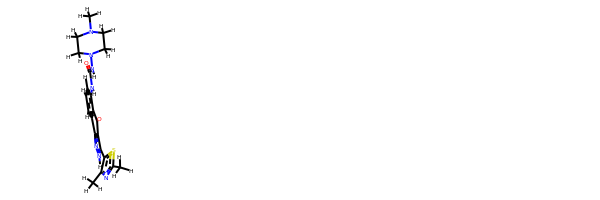

rdkit:  [H]c1c([H])c2c(c(N([H])C(=O)N([H])N3C([H])([H])C([H])([H])N(C([H])([H])[H])C([H])([H])C3([H])[H])c1[H])C(=O)c1c-2nn([H])c1-c1sc(C([H])([H])[H])nc1C([H])([H])[H]
oechem:  Cc1c(sc(n1)C)c2c3c(n[nH]2)-c4cccc(c4C3=O)NC(=O)NN5CCN(CC5)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #####

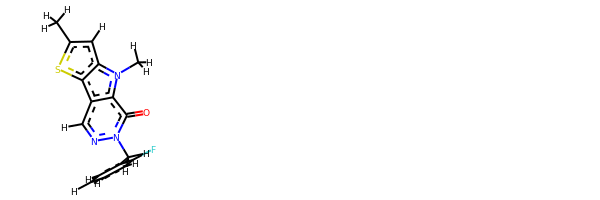

rdkit:  [H]c1c([H])c([H])c(C([H])([H])n2nc([H])c3c4sc(C([H])([H])[H])c([H])c4n(C([H])([H])[H])c3c2=O)c(F)c1[H]
oechem:  Cc1cc2c(s1)c3cnn(c(=O)c3n2C)Cc4ccccc4F
###########################################################################
 #########################################################

bond
28.46495603668687 kJ/mol 101641.68950979672 kJ/mol False
angle
128.6012069204704 kJ/mol 133.37465085512673 kJ/mol False
nb
26.667628655235756 kJ/mol 26.667628655235756 kJ/mol True
torsion
71.04932809133346 kJ/mol 33.358863561563346 kJ/mol False
254.78311970372644 kJ/mol 101835.09065286865 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5555


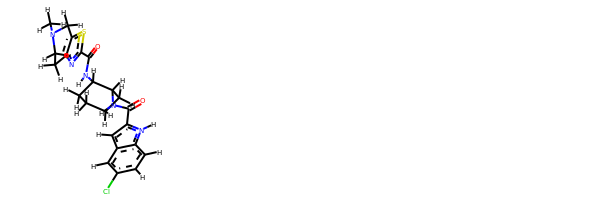

rdkit:  [H]c1c(Cl)c([H])c2c([H])c(C(=O)N([H])C3([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C3([H])N([H])C(=O)c3nc4c(s3)C([H])([H])N(C([H])([H])[H])C([H])([H])C4([H])[H])n([H])c2c1[H]
oechem:  CN1CCc2c(sc(n2)C(=O)NC3CCCCC3NC(=O)c4cc5cc(ccc5[nH]4)Cl)C1
###########################################################################
 #########################################################

bond
30.937516510726088 kJ/mol 101642.16450811004 kJ/mol False
angle
131.70176162752716 kJ/mol 136.47505195284995 kJ/mol False
nb
25.25635480310851 kJ/mol 25.25635480310851 kJ/mol True
torsion
72.16227534713418 kJ/mol 34.47188550968561 kJ/mol False
260.057908288496 kJ/mol 101838.36780037568 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5556


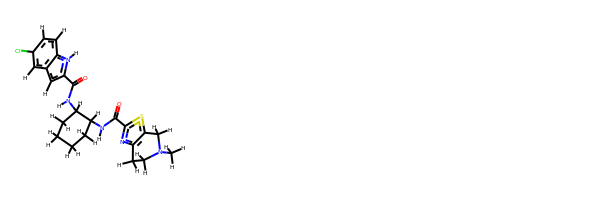

rdkit:  [H]c1c(Cl)c([H])c2c([H])c(C(=O)N([H])C3([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C3([H])N([H])C(=O)c3nc4c(s3)C([H])([H])N(C([H])([H])[H])C([H])([H])C4([H])[H])n([H])c2c1[H]
oechem:  CN1CCc2c(sc(n2)C(=O)NC3CCCCC3NC(=O)c4cc5cc(ccc5[nH]4)Cl)C1
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
9.729818407840146 kJ/mol 43695.29473068945 kJ/mol False
angle
54.377877856879174 kJ/mol 58.773546386213084 kJ/mol False
nb
10.224558169110939 kJ/mol 10.224558169110939 kJ/mol True
torsion
75.58581420145643 kJ/mol 85.01069863838602 kJ/mol False
149.9180686352867 kJ/mol 43849.303533883154 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-----------------------------------

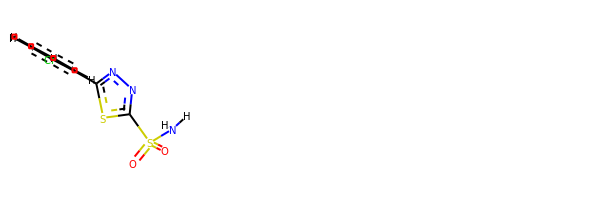

rdkit:  [H]c1c([H])c([H])c(-c2nnc(S(=O)(=O)N([H])[H])s2)c(Cl)c1[H]
oechem:  c1ccc(c(c1)c2nnc(s2)S(=O)(=O)N)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
19.68059792027803 kJ/mol 43959.66971610531 kJ/mol False
angle
56.97050970303131 kJ/mol 60.53513742109446 kJ/mol False
nb
19.15742592541958 kJ/mol 19.15742592541958 kJ/mol True
torsion
7.090862362958857 kJ/mol 7.0902968957639585 kJ/mol False
102.89939591168778 kJ/mol 44046.45257634759 kJ/mol

------------------------------------------------

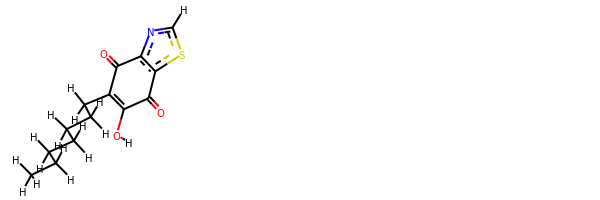

rdkit:  [H]OC1=C(C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])[H])C(=O)c2nc([H])sc2C1=O
oechem:  CCCCCCCC1=C(C(=O)c2c(ncs2)C1=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

######################

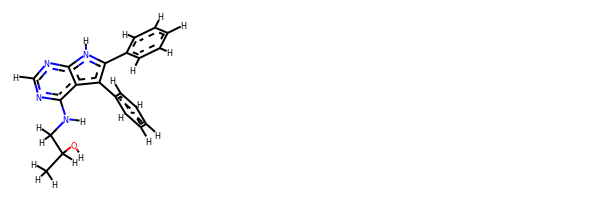

rdkit:  [H]OC([H])(C([H])([H])[H])C([H])([H])N([H])c1nc([H])nc2c1c(-c1c([H])c([H])c([H])c([H])c1[H])c(-c1c([H])c([H])c([H])c([H])c1[H])n2[H]
oechem:  CC(CNc1c2c(c([nH]c2ncn1)c3ccccc3)c4ccccc4)O
###########################################################################
 #########################################################

bond
9.015646123187324 kJ/mol 57864.76999274209 kJ/mol False
angle
112.88269742328514 kJ/mol 114.29507823879372 kJ/mol False
nb
29.58246906535191 kJ/mol 29.58246906535191 kJ/mol True
torsion
51.46698840103204 kJ/mol 51.468001172781236 kJ/mol False
202.94780101285642 kJ/mol 58060.11554121902 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5574


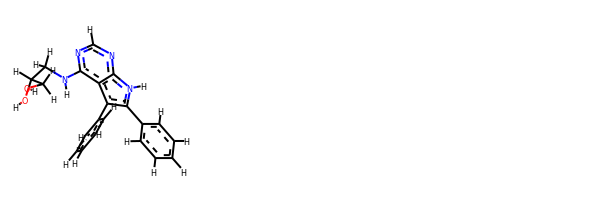

rdkit:  [H]OC([H])([H])C([H])(O[H])C([H])([H])N([H])c1nc([H])nc2c1c(-c1c([H])c([H])c([H])c([H])c1[H])c(-c1c([H])c([H])c([H])c([H])c1[H])n2[H]
oechem:  c1ccc(cc1)c2c3c([nH]c2c4ccccc4)ncnc3NCC(CO)O
###########################################################################
 #########################################################

bond
9.55568402336882 kJ/mol 57808.441906971624 kJ/mol False
angle
382.4392295079349 kJ/mol 383.7796093205268 kJ/mol False
nb
26.80433434964346 kJ/mol 26.80433434964346 kJ/mol True
torsion
45.98553501307692 kJ/mol 45.98744784759283 kJ/mol False
464.7847828940241 kJ/mol 58265.013298489386 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5575


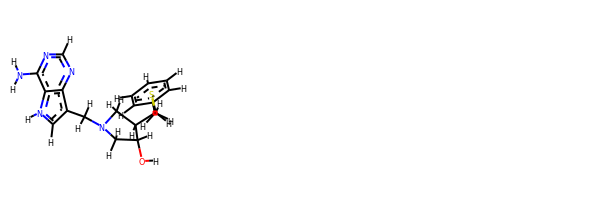

rdkit:  [H]OC1([H])C([H])([H])N(C([H])([H])c2c([H])n([H])c3c(N([H])[H])nc([H])nc23)C([H])([H])C1([H])C([H])([H])SC([H])([H])c1c([H])c([H])c([H])c([H])c1[H]
oechem:  c1ccc(cc1)CSCC2CN(CC2O)Cc3c[nH]c4c3ncnc4N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
16.828913329531318 kJ/mol 58272.70551905881 kJ/mol False
angle
131.75052887847497 kJ/mol 131.75052887847497 kJ/mol True
nb
34.44375216295996 kJ/mol 34.44375216295996 kJ/mol True
torsion
36.60331874979205 kJ/mol 36.60333413025039 kJ/mol False
21

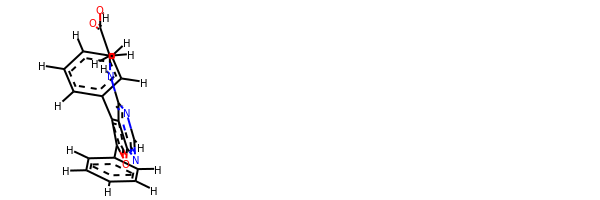

rdkit:  [H]OC(=O)C([H])([H])N([H])c1nc([H])nc2oc(-c3c([H])c([H])c([H])c([H])c3[H])c(-c3c([H])c([H])c([H])c([H])c3[H])c12
oechem:  c1ccc(cc1)c2c3c(ncnc3oc2c4ccccc4)NCC(=O)O
###########################################################################
 #########################################################

bond
14.370615772242537 kJ/mol 58270.24722150153 kJ/mol False
angle
120.60066813710579 kJ/mol 120.60066813710579 kJ/mol True
nb
26.389065216012405 kJ/mol 26.389065216012405 kJ/mol True
torsion
59.13004506437689 kJ/mol 59.13006044483522 kJ/mol False
220.49039418973763 kJ/mol 58476.36701529948 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5580


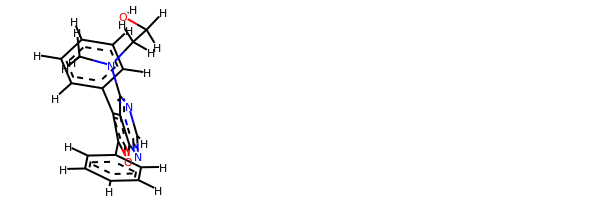

rdkit:  [H]OC([H])([H])C([H])([H])N(c1nc([H])nc2oc(-c3c([H])c([H])c([H])c([H])c3[H])c(-c3c([H])c([H])c([H])c([H])c3[H])c12)C([H])([H])[H]
oechem:  CN(CCO)c1c2c(c(oc2ncn1)c3ccccc3)c4ccccc4
###########################################################################
 #########################################################

bond
10.927058344325024 kJ/mol 57868.82988674587 kJ/mol False
angle
107.7950461915342 kJ/mol 109.2072568923863 kJ/mol False
nb
31.70294860449552 kJ/mol 31.70294860449552 kJ/mol True
torsion
43.45103371630824 kJ/mol 43.45204191719636 kJ/mol False
193.876086856663 kJ/mol 58053.192134159945 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5581


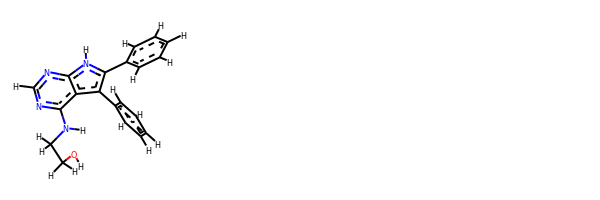

rdkit:  [H]OC([H])([H])C([H])([H])N([H])c1nc([H])nc2c1c(-c1c([H])c([H])c([H])c([H])c1[H])c(-c1c([H])c([H])c([H])c([H])c1[H])n2[H]
oechem:  c1ccc(cc1)c2c3c([nH]c2c4ccccc4)ncnc3NCCO
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

####

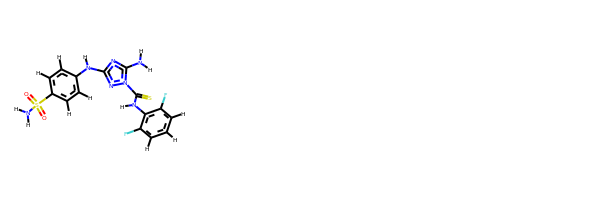

rdkit:  [H]c1c([H])c(F)c(N([H])C(=S)n2nc(N([H])c3c([H])c([H])c(S(=O)(=O)N([H])[H])c([H])c3[H])nc2N([H])[H])c(F)c1[H]
oechem:  c1cc(c(c(c1)F)NC(=S)n2c(nc(n2)Nc3ccc(cc3)S(=O)(=O)N)N)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
21.227719158338527 kJ/mol 29089.342337006183 kJ/mol False
angle
97.36333777136036 kJ/mol 97.36333777136036 kJ/mol True
nb
32.02607044

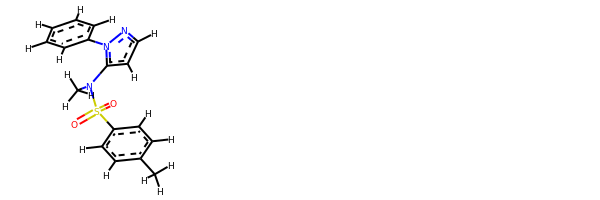

rdkit:  [H]c1nn(-c2c([H])c([H])c([H])c([H])c2[H])c(N(C([H])([H])[H])S(=O)(=O)c2c([H])c([H])c(C([H])([H])[H])c([H])c2[H])c1[H]
oechem:  Cc1ccc(cc1)S(=O)(=O)N(C)c2ccnn2c3ccccc3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
56.5

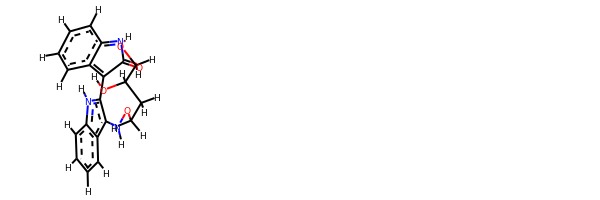

rdkit:  [H]OC([H])([H])C([H])(O[H])C([H])([H])C([H])([H])ON([H])c1c(C2=c3c([H])c([H])c([H])c([H])c3=NC2=O)n([H])c2c([H])c([H])c([H])c([H])c12
oechem:  c1ccc2c(c1)c(c([nH]2)C3=c4ccccc4=NC3=O)NOCCC(CO)O
###########################################################################
 #########################################################

bond
8.856267737717603 kJ/mol 57652.131635718695 kJ/mol False
angle
28.765108214664796 kJ/mol 28.83285254674829 kJ/mol False
nb
23.695088121133608 kJ/mol 23.695088121133608 kJ/mol True
torsion
21.629532219956282 kJ/mol 4.912520929633828 kJ/mol False
82.94599629347229 kJ/mol 57709.57209731621 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5603


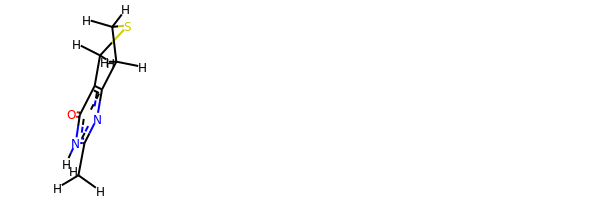

rdkit:  [H]n1c(C([H])([H])[H])nc2c(c1=O)C([H])([H])SC([H])([H])C2([H])[H]
oechem:  Cc1[nH]c(=O)c2c(n1)CCSC2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
22.479631277786613 kJ/mol 43737.79665927244 kJ/mol False
angle
77.26533073388103 kJ/mol 79.10556948826823 kJ/mol False
nb
54.141368309757596 kJ/mol 54.141368309757596 kJ/mol True
torsion
2.7019363070062075 kJ/mol 1.1151096012059807 kJ/mol False
156.58826662843143 kJ/mol 43872.15870667167 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
----------------------------------------------

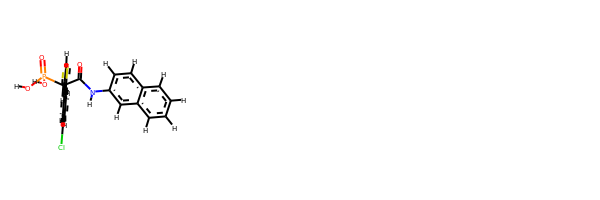

rdkit:  [H]OP(=O)(O[H])C([H])(C(=O)N([H])c1c([H])c([H])c2c([H])c([H])c([H])c([H])c2c1[H])c1c([H])sc2c([H])c([H])c(Cl)c([H])c12
oechem:  c1ccc2cc(ccc2c1)NC(=O)C(c3csc4c3cc(cc4)Cl)P(=O)(O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
8.109783338189327 kJ/mol 43694.207802620345 kJ/mol False
angle
93.12475459401105 kJ/mol 94.62034837123319 kJ/mol False
nb
18.655224709786147 kJ/mol 18.655224709786147 kJ/mol True
torsion
75.57885974717293 kJ/mol 75.57891292909135 kJ/mol False
195.46862238915946 kJ/mol 43883.062288630455 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5608


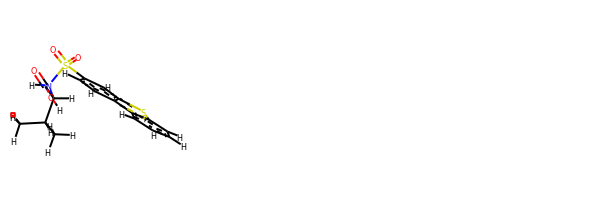

rdkit:  [H]OC(=O)C([H])(N([H])S(=O)(=O)c1c([H])c([H])c2c(sc3c([H])c([H])c([H])c([H])c32)c1[H])C([H])(C([H])([H])[H])C([H])([H])[H]
oechem:  CC(C)C(C(=O)O)NS(=O)(=O)c1ccc2c3ccccc3sc2c1
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
17.375842606510734 kJ/mol 56514.92888543241 kJ/mol False
angle
143.1527627479338 kJ/mol 143.1527627479338 kJ/mol True
nb
58.58011015631394 kJ/mol 58.58011015631394 kJ/mol True
torsion
107.86179253938609 kJ/mol 102.6318526658847 kJ/mol False
326.97050805014453 kJ/mol 56819.29361100255 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5610


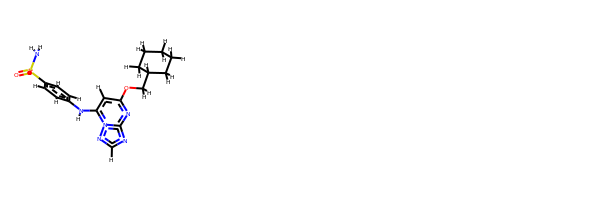

rdkit:  [H]c1nc2nc(OC([H])([H])C3([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C3([H])[H])c([H])c(N([H])c3c([H])c([H])c(S(=O)(=O)N([H])[H])c([H])c3[H])n2n1
oechem:  c1cc(ccc1Nc2cc(nc3n2ncn3)OCC4CCCCC4)S(=O)(=O)N
###########################################################################
 #########################################################

bond
23.93398018884788 kJ/mol 56750.04332698894 kJ/mol False
angle
129.47606434823552 kJ/mol 129.47606434823552 kJ/mol True
nb
44.633425907332075 kJ/mol 44.633425907332075 kJ/mol True
torsion
104.40012738297958 kJ/mol 91.97778931324899 kJ/mol False
302.4435978273951 kJ/mol 57016.13060655776 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5611


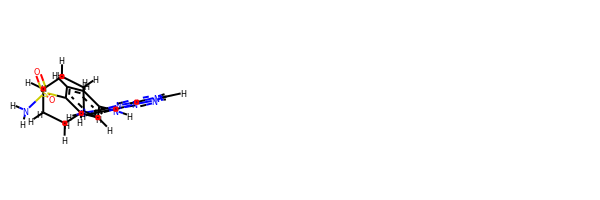

rdkit:  [H]c1nc2nc(N([H])C3([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C3([H])[H])c([H])c(N([H])c3c([H])c([H])c(S(=O)(=O)N([H])[H])c([H])c3[H])n2n1
oechem:  c1cc(ccc1Nc2cc(nc3n2ncn3)NC4CCCCC4)S(=O)(=O)N
###########################################################################
 #########################################################

bond
24.632400139458863 kJ/mol 56751.009977341266 kJ/mol False
angle
148.05491417171524 kJ/mol 148.05491417171524 kJ/mol True
nb
45.32085466292854 kJ/mol 45.32085466292854 kJ/mol True
torsion
108.37113975574688 kJ/mol 95.94933904844697 kJ/mol False
326.3793087298495 kJ/mol 57040.33508522436 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5612


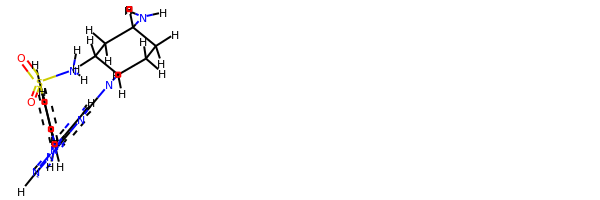

rdkit:  [H]c1nc2nc(N([H])C3([H])C([H])([H])C([H])([H])C([H])(N([H])[H])C([H])([H])C3([H])[H])c([H])c(N([H])c3c([H])c([H])c(S(=O)(=O)N([H])[H])c([H])c3[H])n2n1
oechem:  c1cc(ccc1Nc2cc(nc3n2ncn3)NC4CCC(CC4)N)S(=O)(=O)N
###########################################################################
 #########################################################

bond
18.391258069065465 kJ/mol 56516.55074874444 kJ/mol False
angle
143.5531445352062 kJ/mol 143.5531445352062 kJ/mol True
nb
73.40807706378597 kJ/mol 73.40807706378597 kJ/mol True
torsion
117.07283829955048 kJ/mol 111.84290922531139 kJ/mol False
352.4253179676081 kJ/mol 56845.354879568746 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5613


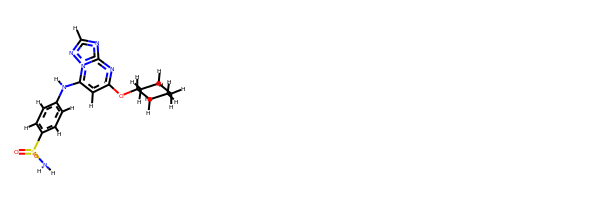

rdkit:  [H]c1nc2nc(OC3([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C3([H])[H])c([H])c(N([H])c3c([H])c([H])c(S(=O)(=O)N([H])[H])c([H])c3[H])n2n1
oechem:  c1cc(ccc1Nc2cc(nc3n2ncn3)OC4CCCCC4)S(=O)(=O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ########################################

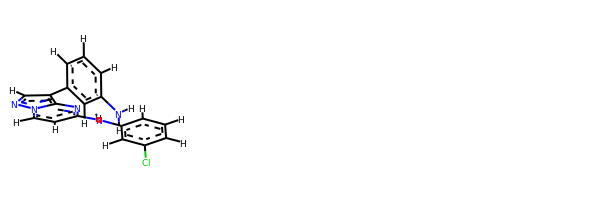

rdkit:  [H]c1nn2c([H])c([H])c(N([H])c3c([H])c([H])c([H])c(Cl)c3[H])nc2c1-c1c([H])c([H])c([H])c(N([H])[H])c1[H]
oechem:  c1cc(cc(c1)N)c2cnn3c2nc(cc3)Nc4cccc(c4)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
18.60518068181697 kJ/mol 115092.35395329262 kJ/mol False
angle
94.79210695501182 kJ/mol 96.95511446419873 kJ/mol False
nb
59.268179157929566 kJ/mol 59.26

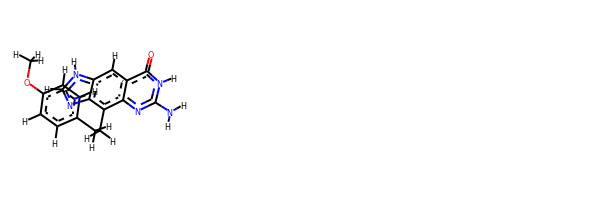

rdkit:  [H]c1c([H])c(C([H])([H])C([H])([H])c2c3nc(N([H])[H])n([H])c(=O)c3c([H])c3c2nc([H])n3[H])c([H])c([H])c1OC([H])([H])[H]
oechem:  COc1ccc(cc1)CCc2c3c(cc4c2nc[nH]4)c(=O)[nH]c(n3)N
###########################################################################
 #########################################################

bond
12.642653333760588 kJ/mol 58033.64704547948 kJ/mol False
angle
89.57918219653708 kJ/mol 89.57918219653708 kJ/mol True
nb
26.335190995520893 kJ/mol 26.335190995520893 kJ/mol True
torsion
11.007826384911462 kJ/mol 6.9184461350786055 kJ/mol False
139.56485291073002 kJ/mol 58156.47986480663 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5628


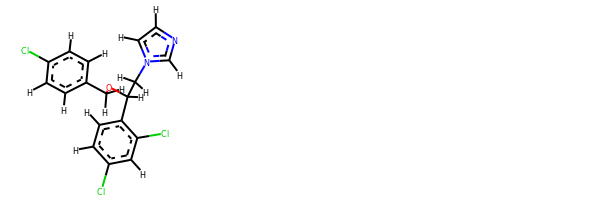

rdkit:  [H]c1nc([H])n(C([H])([H])C([H])(OC([H])([H])c2c([H])c([H])c(Cl)c([H])c2[H])c2c([H])c([H])c(Cl)c([H])c2Cl)c1[H]
oechem:  c1cc(ccc1COC(Cn2ccnc2)c3ccc(cc3Cl)Cl)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
14.719905812954432 kJ/mol 29074.740623159898 kJ/mol False
angle
108.78663032750045 kJ/mol 108.78663032750045 kJ/mol True
nb
24.173758162802088 kJ/mol 24.173758162802088 kJ/mol True
torsion
20.907065226230266 kJ/mol 15.677310396613557 kJ/mol False
168.58735952948723 kJ/mol 29223.378322046814 kJ/mol

-------------------------------------------------------------------
---------------------------------------------------

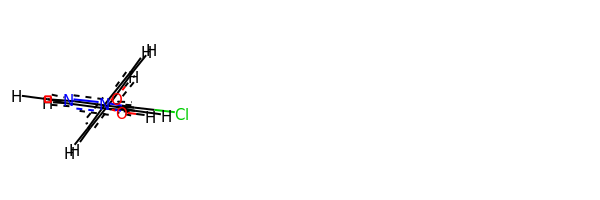

rdkit:  [H]Oc1c([H])c([H])c(-n2nc3c([H])c([H])c(O[H])c([H])c3c2Cl)c([H])c1[H]
oechem:  c1cc(ccc1n2c(c3cc(ccc3n2)O)Cl)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
8.178929028641061 kJ/mol 57990.412650705766 kJ/mol False
angle
118.10639425798426 kJ/mol 118.10639425798426 kJ/mol True
nb
21.94068409294778 kJ/mol 21.94068409294778 kJ/mol True
torsion
31.383799589814405 kJ/mol 17.056269769211724 kJ/mol False
179.6098069693875 kJ/mol 58147.51599882592 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5633


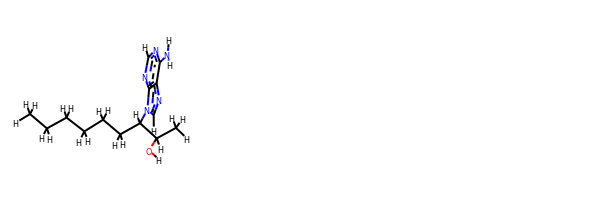

rdkit:  [H]OC([H])(C([H])([H])[H])C([H])(n1c([H])nc2c(N([H])[H])nc([H])nc21)C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])[H]
oechem:  CCCCCCC(C(C)O)n1cnc2c1ncnc2N
###########################################################################
 #########################################################

bond
16.355958563025602 kJ/mol 29076.376675909967 kJ/mol False
angle
108.32706282635124 kJ/mol 108.32706282635124 kJ/mol True
nb
26.48320384821397 kJ/mol 26.48320384821397 kJ/mol True
torsion
21.7687499671317 kJ/mol 15.833749923243163 kJ/mol False
172.93497520472252 kJ/mol 29227.020692507776 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5634


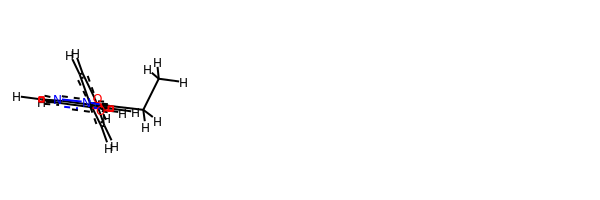

rdkit:  [H]Oc1c([H])c([H])c(-n2nc3c([H])c([H])c(O[H])c([H])c3c2C([H])([H])C([H])([H])[H])c([H])c1[H]
oechem:  CCc1c2cc(ccc2nn1c3ccc(cc3)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
9.223612279672462 kJ/mol 9.223612279672

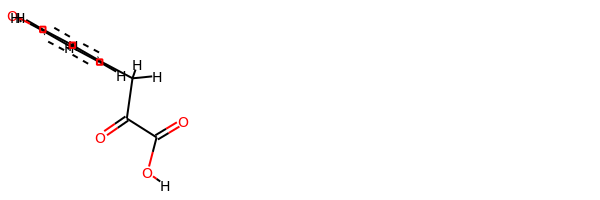

rdkit:  [H]OC(=O)C(=O)C([H])([H])c1c([H])c([H])c(O[H])c([H])c1[H]
oechem:  c1cc(ccc1CC(=O)C(=O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
14.869325073497047 kJ/mol 57766.774671740306 kJ/mol False
angle
89.95011676082724 kJ/mol 91.18011284007869 kJ/mol False
nb
36.26351816696215 kJ/mol 36.26351816696215 kJ/mol True
torsion
0.16548668517850773 kJ/mol 0.1

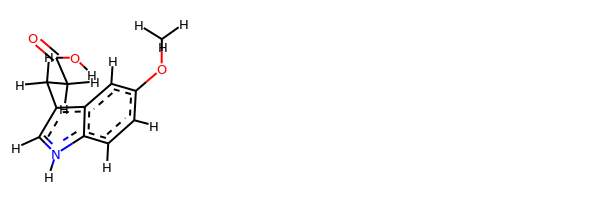

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])c1c([H])n([H])c2c([H])c([H])c(OC([H])([H])[H])c([H])c12
oechem:  COc1ccc2c(c1)c(c[nH]2)CCC(=O)O
###########################################################################
 #########################################################

bond
26.59893002802378 kJ/mol 57778.50427669484 kJ/mol False
angle
105.78838226622285 kJ/mol 105.78838226622285 kJ/mol True
nb
76.87681136429971 kJ/mol 76.87681136429971 kJ/mol True
torsion
68.82956169280043 kJ/mol 39.54093834047397 kJ/mol False
278.0936853513468 kJ/mol 58000.710408665844 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5646


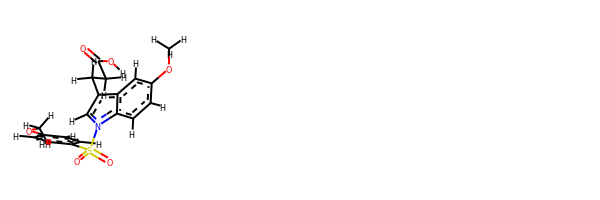

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])c1c([H])n(S(=O)(=O)c2c([H])c([H])c(OC([H])([H])[H])c([H])c2[H])c2c([H])c([H])c(OC([H])([H])[H])c([H])c12
oechem:  COc1ccc(cc1)S(=O)(=O)n2cc(c3c2ccc(c3)OC)CCC(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
18.866205948854432 kJ/mol 57923.95970250157 kJ/mol False
angle
94.61567623048204 kJ/mol 96.19939044598993 kJ/mol False
nb
42.4444959264094 kJ/mol 42.4444959264094 kJ/mol True
torsion
51.72823223903533 kJ/mol 50.309268836738916 kJ/mol False
207.6546103447812 kJ/mol 58112.912857710704 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5648


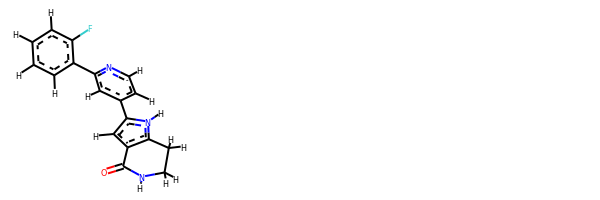

rdkit:  [H]c1nc(-c2c([H])c([H])c([H])c([H])c2F)c([H])c(-c2c([H])c3c(n2[H])C([H])([H])C([H])([H])N([H])C3=O)c1[H]
oechem:  c1ccc(c(c1)c2cc(ccn2)c3cc4c([nH]3)CCNC4=O)F
###########################################################################
 #########################################################

bond
20.731584823160453 kJ/mol 29216.52649458228 kJ/mol False
angle
87.03120152015377 kJ/mol 89.8104038779302 kJ/mol False
nb
73.26827649390557 kJ/mol 73.26827649390557 kJ/mol True
torsion
7.083476314934954 kJ/mol 1.8534681506997042 kJ/mol False
188.11453915215475 kJ/mol 29381.458643104816 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5649


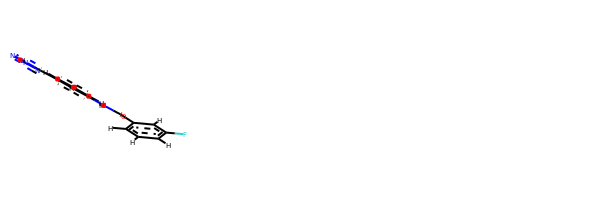

rdkit:  [H]c1c([H])c(F)c([H])c(C(=O)N([H])c2c([H])c([H])c([H])c(-c3nnnn3[H])c2[H])c1[H]
oechem:  c1cc(cc(c1)NC(=O)c2cccc(c2)F)c3[nH]nnn3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
17.793185418888374 kJ/mol 29085.044437897057 kJ/mol False
angle
109.261467418542 kJ/mol 110.90195710458252 kJ/mol False
nb
70.08803826653735 kJ/mol 70.08803826653735 kJ/mol True
torsion
72.57667142201413 kJ/mol 50.516961618910386 kJ/mol False
269.71936252598186 kJ/mol 29316.551394887087 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5651


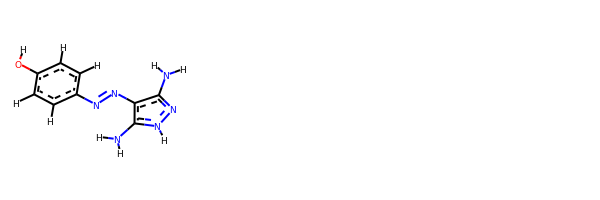

rdkit:  [H]Oc1c([H])c([H])c(N=Nc2c(N([H])[H])nn([H])c2N([H])[H])c([H])c1[H]
oechem:  c1cc(ccc1N=Nc2c([nH]nc2N)N)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
56.042596630897734 kJ/mol 73513.96253513591 kJ/mol False
angle
181.8374779431803 kJ/mol 185.06769141935624 kJ/mol False
nb
-3.016511520852676 kJ/mol -3.016511520852676 kJ/mol True
torsion
10.388262160433197 kJ/mol 5.150558377471673 kJ/mol False
245.25182521365855 kJ/mol 73701.1642734119 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5653


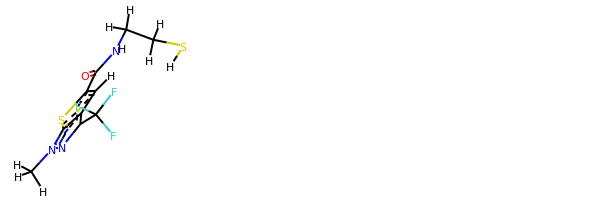

rdkit:  [H]SC([H])([H])C([H])([H])N([H])C(=O)c1sc2c(c(C(F)(F)F)nn2C([H])([H])[H])c1[H]
oechem:  Cn1c2c(cc(s2)C(=O)NCCS)c(n1)C(F)(F)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###################################################

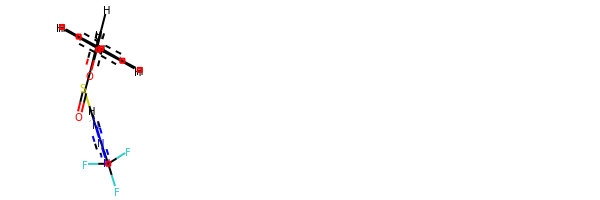

rdkit:  [H]c1c(C#Cc2c([H])c([H])c([H])c([H])c2[H])oc(C(=O)Sc2nnc(C(F)(F)F)n2[H])c1[H]
oechem:  c1ccc(cc1)C#Cc2ccc(o2)C(=O)Sc3[nH]c(nn3)C(F)(F)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

########################################

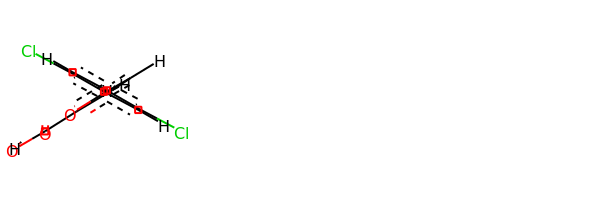

rdkit:  [H]OC(=O)c1oc(-c2c([H])c(Cl)c([H])c([H])c2Cl)c([H])c1[H]
oechem:  c1cc(c(cc1Cl)c2ccc(o2)C(=O)O)Cl
###########################################################################
 #########################################################

bond
14.183059902667956 kJ/mol 58380.13080941208 kJ/mol False
angle
109.24158558263527 kJ/mol 109.24158558263527 kJ/mol True
nb
22.1387050739304 kJ/mol 22.1387050739304 kJ/mol True
torsion
23.430818055174047 kJ/mol 20.92042996184573 kJ/mol False
168.99416861440767 kJ/mol 58532.43153003049 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5678


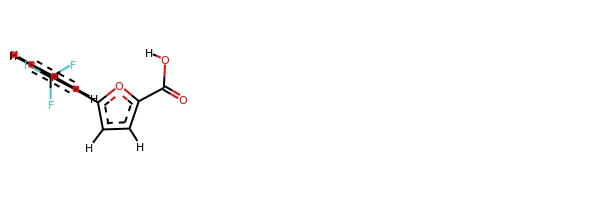

rdkit:  [H]OC(=O)c1oc(-c2c([H])c([H])c([H])c([H])c2C(F)(F)F)c([H])c1[H]
oechem:  c1ccc(c(c1)c2ccc(o2)C(=O)O)C(F)(F)F
###########################################################################
 #########################################################

bond
34.1044098320944 kJ/mol 114415.65440889433 kJ/mol False
angle
55.36531025794535 kJ/mol 55.96283870580456 kJ/mol False
nb
56.5389002998685 kJ/mol 56.5389002998685 kJ/mol True
torsion
71.65349271869513 kJ/mol 21.445746556265632 kJ/mol False
217.66211310860336 kJ/mol 114549.60189445627 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5679


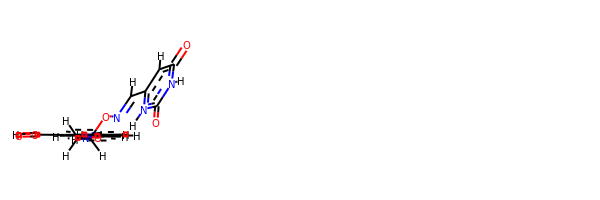

rdkit:  [H]OC(=O)c1c([H])c([H])c([H])c(C([H])=NOC([H])([H])C([H])([H])ON=C([H])c2c([H])c(=O)n([H])c(=O)n2[H])c1[H]
oechem:  c1cc(cc(c1)C(=O)O)C=NOCCON=Cc2cc(=O)[nH]c(=O)[nH]2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

#########

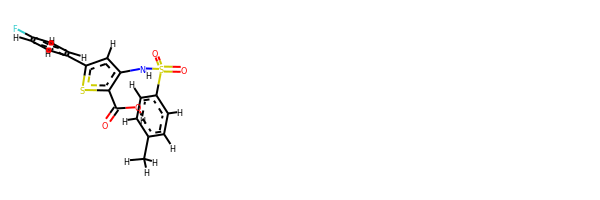

rdkit:  [H]OC(=O)c1sc(-c2c([H])c([H])c(F)c([H])c2[H])c([H])c1N([H])S(=O)(=O)c1c([H])c([H])c(C([H])([H])[H])c([H])c1[H]
oechem:  Cc1ccc(cc1)S(=O)(=O)Nc2cc(sc2C(=O)O)c3ccc(cc3)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
13.522585497204108 kJ/mol 57767.58292226026 kJ/mol False
angle
106.39803147014493 kJ/mol 107.62673889396835 kJ/mol False
nb
4.141229828862909 kJ/mol 4.141229828862909 kJ/mol True
torsion
9.539938296662188 kJ/mol 9.539996192709157 kJ/mol False
133.60178509287414 kJ/mol 57888.8908871758 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------

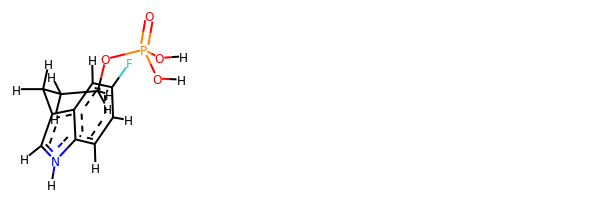

rdkit:  [H]OP(=O)(O[H])OC([H])([H])C([H])([H])C([H])([H])c1c([H])n([H])c2c([H])c([H])c(F)c([H])c12
oechem:  c1cc2c(cc1F)c(c[nH]2)CCCOP(=O)(O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
14.448557167469874 kJ/mol 57508.2192486107 kJ/mol False
angle
10.191928075760579 kJ/mol 10.191928075760579 kJ/mol True
nb
37.35113222132574 kJ/mol 37.35113222132574 kJ/mol True
torsion
15.565904341777797 kJ/mol 15.562267481618981 kJ/mol False
77.557521806334 kJ/mol 57571.3245763894 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5694


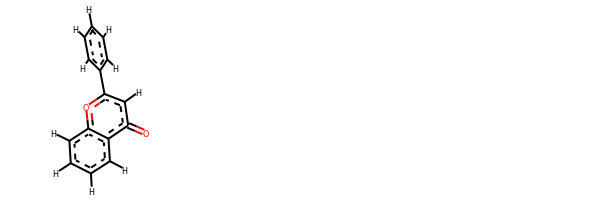

rdkit:  [H]c1c([H])c([H])c(-c2oc3c([H])c([H])c([H])c([H])c3c(=O)c2[H])c([H])c1[H]
oechem:  c1ccc(cc1)c2cc(=O)c3ccccc3o2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
33.37824316442498 kJ/mol 115806.94462239151 kJ/mol False
angle
194.50428210545013 kJ/mol 194.50428210545013 kJ/mol True
nb
34.20450314403839 kJ/mol 34.20450314403839 kJ/mol True
torsion
31.937630

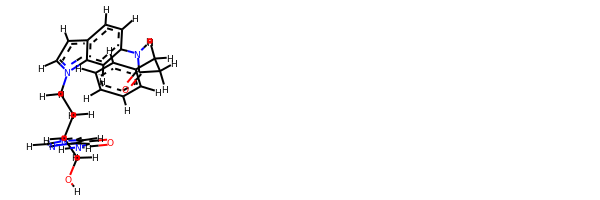

rdkit:  [H]OC([H])([H])C([H])(n1c([H])nc(C(=O)N([H])[H])c1[H])C([H])([H])C([H])([H])n1c([H])c([H])c2c([H])c([H])c(N([H])C(=O)C([H])([H])C([H])([H])c3c([H])c([H])c([H])c([H])c3[H])c([H])c21
oechem:  c1ccc(cc1)CCC(=O)Nc2ccc3ccn(c3c2)CCC(CO)n4cc(nc4)C(=O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
26.855677147550132 kJ/mol 58048.848598902005 kJ/mol False
angle
96.6125793101957 kJ/mol 96.6125793101957 kJ/mol True
nb
32.61634216968761 kJ/mol 32.61634216968761 kJ/mol True
torsion
60.18753692371049 kJ/mol 43.338862376888535 kJ/mol False
216.27213555114395 kJ/mol 58221.41638275878 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-----------------------------------------

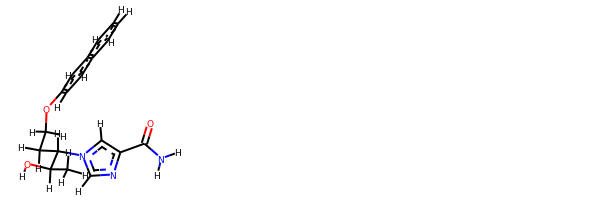

rdkit:  [H]OC([H])(C([H])([H])[H])C([H])(n1c([H])nc(C(=O)N([H])[H])c1[H])C([H])([H])C([H])([H])Oc1c([H])c([H])c2c([H])c([H])c([H])c([H])c2c1[H]
oechem:  CC(C(CCOc1ccc2ccccc2c1)n3cc(nc3)C(=O)N)O
###########################################################################
 #########################################################

bond
25.86495071926389 kJ/mol 116189.55911849388 kJ/mol False
angle
189.58552609444334 kJ/mol 189.58552609444334 kJ/mol True
nb
14.698174586186045 kJ/mol 14.698174586186045 kJ/mol True
torsion
41.93586579550465 kJ/mol 25.285728013743398 kJ/mol False
272.08451719539795 kJ/mol 116419.12854718824 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5703


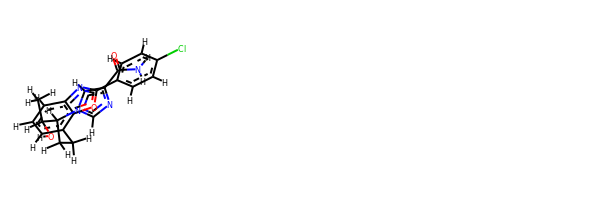

rdkit:  [H]OC([H])(C([H])([H])[H])C([H])(n1c([H])nc(C(=O)N([H])[H])c1[H])C([H])([H])C([H])([H])c1c([H])c([H])c([H])c2nc(-c3c([H])c([H])c(Cl)c([H])c3[H])oc12
oechem:  CC(C(CCc1cccc2c1oc(n2)c3ccc(cc3)Cl)n4cc(nc4)C(=O)N)O
###########################################################################
 #########################################################

bond
31.614697977388758 kJ/mol 112951.56220116769 kJ/mol False
angle
26.409620999103772 kJ/mol 27.14854173631286 kJ/mol False
nb
79.23646710219573 kJ/mol 79.23646710219573 kJ/mol True
torsion
66.61240738937035 kJ/mol 30.31915658521613 kJ/mol False
203.87319346805862 kJ/mol 113088.26636659142 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5704


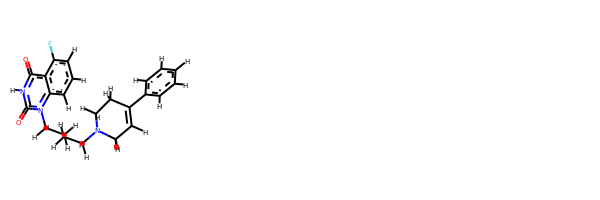

rdkit:  [H]C1=C(c2c([H])c([H])c([H])c([H])c2[H])C([H])([H])C([H])([H])N(C([H])([H])C([H])([H])C([H])([H])C([H])([H])n2c(=O)n([H])c(=O)c3c(F)c([H])c([H])c([H])c32)C1([H])[H]
oechem:  c1ccc(cc1)C2=CCN(CC2)CCCCn3c4cccc(c4c(=O)[nH]c3=O)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
65.5866088054365 kJ/mol 187290.67477193274 kJ/mol False
angle
301.44655105574356 kJ/mol 311.4223103085464 kJ/mol False
nb
42.06564202236635 kJ/mol 42.06564202236635 kJ/mol True
torsion
24.154149384778513 kJ/mol 12.56887215540523 kJ/mol False
433.25295126832486 kJ/mol 187656.73159641906 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
----------------------------------------------------------

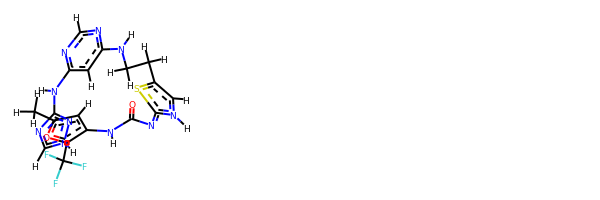

rdkit:  [H]c1nc(N([H])c2nc([H])n([H])n2)c([H])c(N([H])C([H])([H])C([H])([H])c2sc(=NC(=O)N([H])c3c(C(F)(F)F)oc(C([H])([H])[H])c3[H])n([H])c2[H])n1
oechem:  Cc1cc(c(o1)C(F)(F)F)NC(=O)N=c2[nH]cc(s2)CCNc3cc(ncn3)Nc4nc[nH]n4
###########################################################################
 #########################################################

bond
21.11936786349636 kJ/mol 58043.95677704297 kJ/mol False
angle
158.18340550640966 kJ/mol 158.18340550640966 kJ/mol True
nb
74.43076235439773 kJ/mol 74.43076235439773 kJ/mol True
torsion
111.47396304459448 kJ/mol 103.58409005439862 kJ/mol False
365.2074987688983 kJ/mol 58380.15503495818 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5707


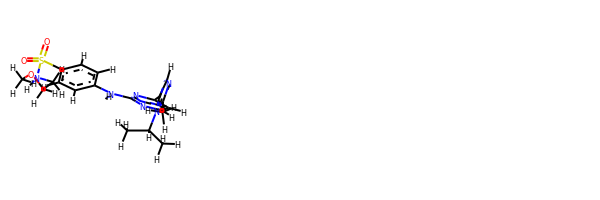

rdkit:  [H]c1nc(N([H])c2c([H])c([H])c(S(=O)(=O)N([H])C([H])([H])C([H])([H])OC([H])([H])[H])c([H])c2[H])nc(-c2c([H])nc(C([H])([H])[H])n2C([H])(C([H])([H])[H])C([H])([H])[H])c1[H]
oechem:  Cc1ncc(n1C(C)C)c2ccnc(n2)Nc3ccc(cc3)S(=O)(=O)NCCOC
###########################################################################
 #########################################################

bond
17.72171045112869 kJ/mol 58038.80408747295 kJ/mol False
angle
155.06222178342523 kJ/mol 155.06222178342523 kJ/mol True
nb
33.39331521593677 kJ/mol 33.39331521593677 kJ/mol True
torsion
251.9448860873859 kJ/mol 220.1243234379889 kJ/mol False
458.12213353787655 kJ/mol 58447.3839479103 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5708


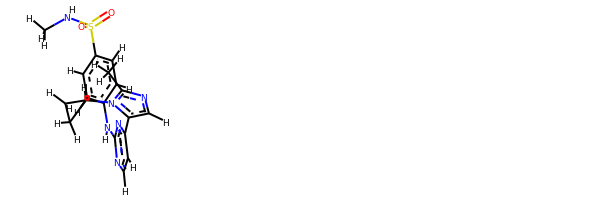

rdkit:  [H]c1nc(N([H])c2c([H])c([H])c(S(=O)(=O)N([H])C([H])([H])[H])c([H])c2[H])nc(-c2c([H])nc(C([H])([H])[H])n2C2([H])C([H])([H])C2([H])[H])c1[H]
oechem:  Cc1ncc(n1C2CC2)c3ccnc(n3)Nc4ccc(cc4)S(=O)(=O)NC
###########################################################################
 #########################################################

bond
61.25813679690418 kJ/mol 101938.13160665576 kJ/mol False
angle
173.7840288713582 kJ/mol 178.95600906475357 kJ/mol False
nb
34.09595326827762 kJ/mol 34.09595326827762 kJ/mol True
torsion
63.28551884421328 kJ/mol 63.277817566005126 kJ/mol False
332.4236377807533 kJ/mol 102214.4613865548 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5709


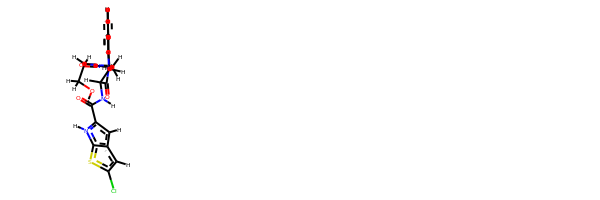

rdkit:  [H]OC([H])([H])C([H])([H])N([H])C(=O)C([H])([H])N1C(=O)C([H])(N([H])C(=O)c2c([H])c3c([H])c(Cl)sc3n2[H])C([H])([H])c2c([H])c([H])c([H])c([H])c21
oechem:  c1ccc2c(c1)CC(C(=O)N2CC(=O)NCCO)NC(=O)c3cc4cc(sc4[nH]3)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
23.563810531316204 kJ/mol 85746.00304149608 kJ/mol False
angle
184.7409128266595 kJ/mol 186.47928245527737 kJ/mol False
nb
32.34713305537761 kJ/mol 32.34713305537761 kJ/mol True
torsion
49.45428601088425 kJ/mol 31.57703581693461 kJ/mol False
290.10614242423753 kJ/mol 85996.40649282366 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBa

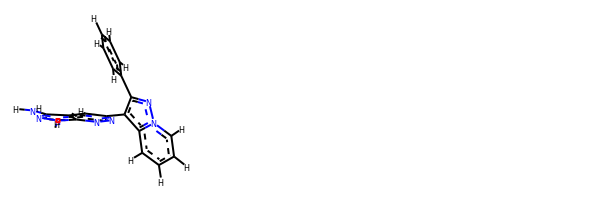

rdkit:  [H]c1c([H])c([H])c(-c2nn3c([H])c([H])c([H])c([H])c3c2-c2nnc3c(c(N([H])[H])nn3[H])c2[H])c([H])c1[H]
oechem:  c1ccc(cc1)c2c(c3ccccn3n2)c4cc5c(n[nH]c5nn4)N
###########################################################################
 #########################################################

bond
15.458465542649163 kJ/mol 57543.57752347878 kJ/mol False
angle
14.268655318623438 kJ/mol 14.268655318623438 kJ/mol True
nb
40.0738764706473 kJ/mol 40.0738764706473 kJ/mol True
torsion
15.575065038116744 kJ/mol 15.574159230299282 kJ/mol False
85.37606237003664 kJ/mol 57613.49421449835 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5712


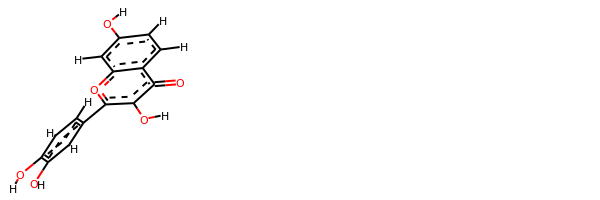

rdkit:  [H]Oc1c([H])c([H])c(-c2oc3c([H])c(O[H])c([H])c([H])c3c(=O)c2O[H])c([H])c1O[H]
oechem:  c1cc(c(cc1c2c(c(=O)c3ccc(cc3o2)O)O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
52.08874755505799 kJ/mol 56302.66356401638 kJ/mol False
angle
45.76114893155279 kJ/mol 45.76114893155279 kJ/mol True
nb
130.09591008181283 kJ/mol 130.09591008181283 kJ/mol True
torsion
88.81022223862848 kJ/mol 89.78809845193639 kJ/mol False
316.7560288070521 kJ/mol 56568.308721481684 kJ/mol

------------------------

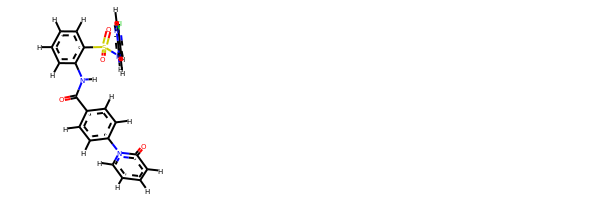

rdkit:  [H]c1nc(N([H])S(=O)(=O)c2c([H])c([H])c([H])c([H])c2N([H])C(=O)c2c([H])c([H])c(-n3c([H])c([H])c([H])c([H])c3=O)c([H])c2[H])c([H])c([H])c1Cl
oechem:  c1ccc(c(c1)NC(=O)c2ccc(cc2)n3ccccc3=O)S(=O)(=O)Nc4ccc(cn4)Cl
###########################################################################
 #########################################################

bond
25.38824324589866 kJ/mol 58006.81550552641 kJ/mol False
angle
133.5419119539941 kJ/mol 135.66169690798282 kJ/mol False
nb
49.0322158516376 kJ/mol 49.0322158516376 kJ/mol True
torsion
10.755835312317679 kJ/mol 10.755835017007252 kJ/mol False
218.71820636384803 kJ/mol 58202.265253303034 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5717


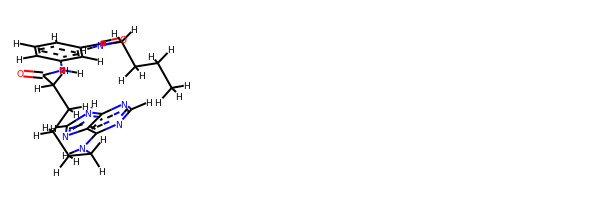

rdkit:  [H]c1nc(N([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C(=O)N([H])c2c([H])c([H])c([H])c(C(=O)N([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])[H])c2[H])c2nc([H])n([H])c2n1
oechem:  CCCCNC(=O)c1cccc(c1)NC(=O)CCCCCNc2c3c([nH]cn3)ncn2
###########################################################################
 #########################################################

bond
20.214528780791298 kJ/mol 56847.26978192441 kJ/mol False
angle
18.427258424138213 kJ/mol 18.427258424138213 kJ/mol True
nb
58.27535186531229 kJ/mol 58.27535186531229 kJ/mol True
torsion
0.0002443607808132017 kJ/mol 0.0003394327022710802 kJ/mol False
96.91738343102261 kJ/mol 56923.972731646565 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5718


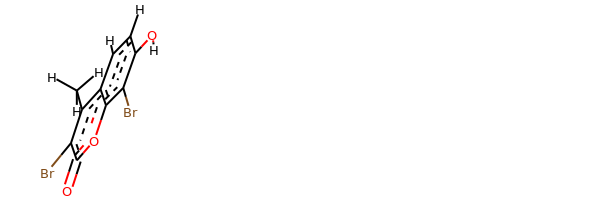

rdkit:  [H]Oc1c([H])c([H])c2c(C([H])([H])[H])c(Br)c(=O)oc2c1Br
oechem:  Cc1c2ccc(c(c2oc(=O)c1Br)Br)O
###########################################################################
 #########################################################

bond
6.4627903863131015 kJ/mol 58026.46110438963 kJ/mol False
angle
92.61043607091244 kJ/mol 94.62513904479125 kJ/mol False
nb
19.492573354798807 kJ/mol 19.492573354798807 kJ/mol True
torsion
4.603491113633769 kJ/mol 5.230063789448022 kJ/mol False
123.16929092565812 kJ/mol 58145.808880578676 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5719


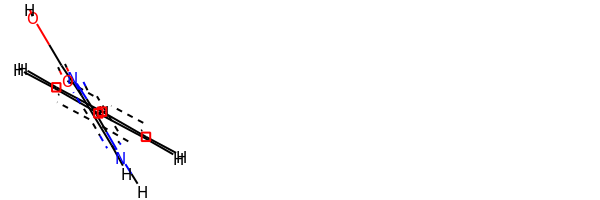

rdkit:  [H]OC(=O)c1nc(-c2c([H])c([H])c([H])c([H])c2[H])n([H])c1[H]
oechem:  c1ccc(cc1)c2[nH]cc(n2)C(=O)O
###########################################################################
 #########################################################

bond
67.3831350517065 kJ/mol 73551.08617403652 kJ/mol False
angle
424.4402431071397 kJ/mol 433.4620598162331 kJ/mol False
nb
21.63984067741817 kJ/mol 21.63984067741817 kJ/mol True
torsion
168.79300937951686 kJ/mol 163.56301170820595 kJ/mol False
682.2562282157812 kJ/mol 74169.75108623838 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5720


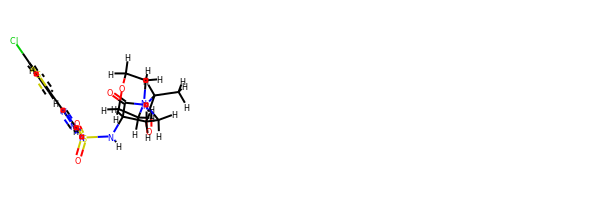

rdkit:  [H]c1c(Cl)sc(-c2nc(S(=O)(=O)N([H])C3([H])C(=O)N(C([H])(C(=O)N4C([H])([H])C([H])([H])OC([H])([H])C4([H])[H])C([H])([H])[H])C([H])([H])C3([H])[H])nn2[H])c1[H]
oechem:  CC(C(=O)N1CCOCC1)N2CCC(C2=O)NS(=O)(=O)c3nc([nH]n3)c4ccc(s4)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #######

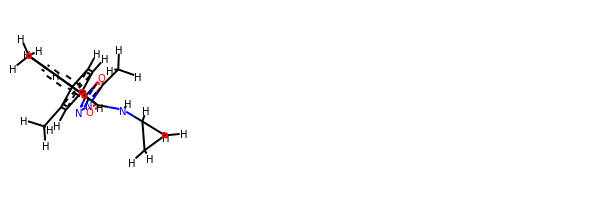

rdkit:  [H]c1c([H])c(C([H])([H])[H])c(-c2c([H])c([H])c(-c3nnc(C([H])([H])[H])o3)c([H])c2C([H])([H])[H])c([H])c1C(=O)N([H])C1([H])C([H])([H])C1([H])[H]
oechem:  Cc1ccc(cc1c2ccc(cc2C)c3nnc(o3)C)C(=O)NC4CC4
###########################################################################
 #########################################################

bond
29.370024560778045 kJ/mol 101674.12825994047 kJ/mol False
angle
154.69951343831372 kJ/mol 158.23330142548076 kJ/mol False
nb
29.927706497238145 kJ/mol 29.927706497238145 kJ/mol True
torsion
38.42603378650232 kJ/mol 35.911876164303806 kJ/mol False
252.42327828283223 kJ/mol 101898.2011440275 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5728


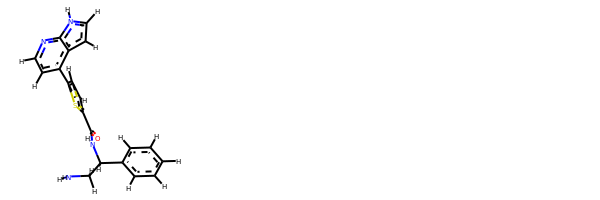

rdkit:  [H]c1nc2c(c([H])c([H])n2[H])c(-c2sc(C(=O)N([H])C([H])(c3c([H])c([H])c([H])c([H])c3[H])C([H])([H])N([H])[H])c([H])c2[H])c1[H]
oechem:  c1ccc(cc1)C(CN)NC(=O)c2ccc(s2)c3ccnc4c3cc[nH]4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
35.82206823509812 kJ/mol 43705.70499071667 kJ/mol False
angle
105.66963277189147 kJ/mol 109.02825099119126 kJ/mol False
nb
66.69456660453922 kJ/mol 66.69456660453922 kJ/mol True
torsion
96.01827630146359 kJ/mol 96.01836683501102 kJ/mol False
304.2045439129924 kJ

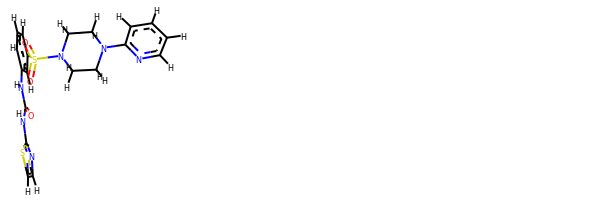

rdkit:  [H]c1nc(N([H])C(=O)N([H])c2c([H])c([H])c([H])c(S(=O)(=O)N3C([H])([H])C([H])([H])N(c4nc([H])c([H])c([H])c4[H])C([H])([H])C3([H])[H])c2[H])sc1[H]
oechem:  c1ccnc(c1)N2CCN(CC2)S(=O)(=O)c3cccc(c3)NC(=O)Nc4nccs4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
34.280259945596804 kJ/mol 113679.13600125238 kJ/mol False
angle
27.279463302558657 kJ/mol 27.876078425805396 kJ/mol False
nb
136.04179842926564 kJ/mol 136.04179842926564 kJ/mol True
torsion
68.6839762716419 kJ/mol 9.371409650934782 kJ/mol False
266.28549794906303 kJ/mol 113852.4252877584 kJ/mol

-------------------------------------------------------------------
-------

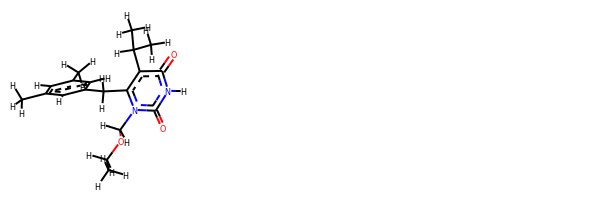

rdkit:  [H]c1c(C([H])([H])[H])c([H])c(C([H])([H])c2c(C([H])(C([H])([H])[H])C([H])([H])[H])c(=O)n([H])c(=O)n2C([H])([H])OC([H])([H])C([H])([H])[H])c([H])c1C([H])([H])[H]
oechem:  CCOCn1c(c(c(=O)[nH]c1=O)C(C)C)Cc2cc(cc(c2)C)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
22.16447212051909 kJ/mol 86526.92654681392 kJ/mol False
angle
162.4490760961623 kJ/mol 165.5931273277707 kJ/mol False
nb
-3.6506665990375793 kJ/mol -3.6506665990375793 kJ/mol True
torsion
17.35590026983297 kJ/mol 13.29546605671

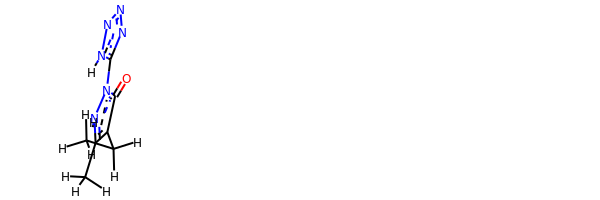

rdkit:  [H]n1nnnc1-n1c(=O)c(C([H])([H])C([H])([H])[H])c(C([H])([H])[H])n1[H]
oechem:  CCc1c([nH]n(c1=O)c2[nH]nnn2)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
40.38544501097087 kJ/mol 112203.43326756751 kJ/mol False
angle
25.147384064190796 kJ/mol 25.147384064190796 kJ/mol True
nb
94.58334720683732 kJ/mol 94.58334720683732 kJ/mol True
torsion
36.090702225632114 kJ/mol 15.900937396805311 kJ/mol False
196.20687850763107 kJ/mol 112339.06493623533 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
--------------------------------------

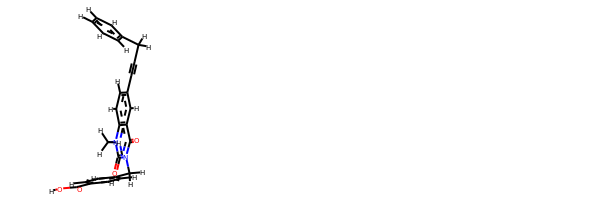

rdkit:  [H]OC(=O)c1c([H])c([H])c(C([H])([H])n2c(=O)c3c([H])c(C#CC([H])([H])c4c([H])c([H])c([H])c([H])c4[H])c([H])c([H])c3n(C([H])([H])[H])c2=O)c([H])c1[H]
oechem:  Cn1c2ccc(cc2c(=O)n(c1=O)Cc3ccc(cc3)C(=O)O)C#CCc4ccccc4
###########################################################################
 #########################################################

bond
11.895368559405867 kJ/mol 29080.015751858868 kJ/mol False
angle
99.43344559932412 kJ/mol 101.09180165184165 kJ/mol False
nb
22.884518169617788 kJ/mol 22.884518169617788 kJ/mol True
torsion
27.192185677282847 kJ/mol 31.375367499500165 kJ/mol False
161.40551800563063 kJ/mol 29235.367439179823 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5744


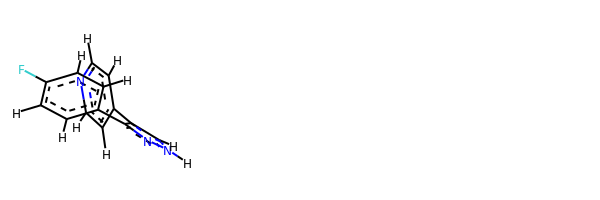

rdkit:  [H]c1nc([H])c([H])c(-c2c(-c3c([H])c([H])c(F)c([H])c3[H])nn([H])c2[H])c1[H]
oechem:  c1cc(ccc1c2c(c[nH]n2)c3ccncc3)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
27.044491640062574 kJ/mol 57535.28882498816 kJ/mol False
angle
33.31065619461442 kJ/mol 33.49918664429814 kJ/mol False
nb
111.2948284804715 kJ/mol 111.2948284804715 kJ/mol True
torsion
23.036082763091393 kJ/mol 6.300473513864411 kJ/mol False
194.68605907823988 kJ/mol 57686.3833136268 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5746


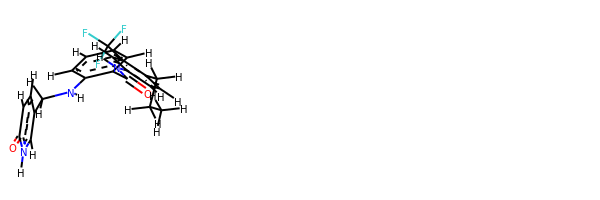

rdkit:  [H]c1c([H])c([H])c(N([H])C([H])([H])c2c([H])c([H])c(=O)n([H])c2[H])c(C(=O)N([H])c2c([H])c([H])c(C([H])([H])C([H])([H])C([H])([H])[H])c(C(F)(F)F)c2[H])c1[H]
oechem:  CCCc1ccc(cc1C(F)(F)F)NC(=O)c2ccccc2NCc3ccc(=O)[nH]c3
###########################################################################
 #########################################################

bond
17.311462650423124 kJ/mol 43689.55006565027 kJ/mol False
angle
62.20060807223813 kJ/mol 65.55756261358648 kJ/mol False
nb
56.29979267199354 kJ/mol 56.29979267199354 kJ/mol True
torsion
15.661669399961983 kJ/mol 15.661730768915602 kJ/mol False
151.4735327946168 kJ/mol 43827.06915170476 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5747


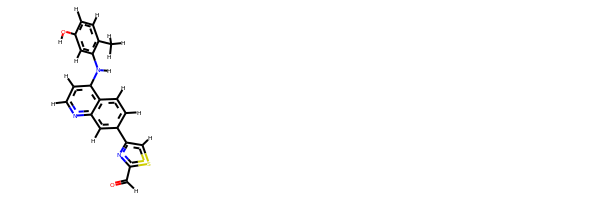

rdkit:  [H]Oc1c([H])c([H])c(C([H])([H])[H])c(N([H])c2c([H])c([H])nc3c([H])c(-c4nc(C([H])=O)sc4[H])c([H])c([H])c23)c1[H]
oechem:  Cc1ccc(cc1Nc2ccnc3c2ccc(c3)c4csc(n4)C=O)O
###########################################################################
 #########################################################

bond
28.574568125975144 kJ/mol 58298.216967520675 kJ/mol False
angle
109.36430300473957 kJ/mol 109.36430300473957 kJ/mol True
nb
88.22766396163983 kJ/mol 88.22766396163983 kJ/mol True
torsion
22.77409143824738 kJ/mol 22.773592174523248 kJ/mol False
248.94062653060195 kJ/mol 58518.58252666158 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5748


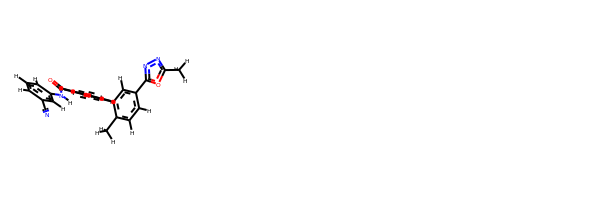

rdkit:  [H]c1c([H])c(C#N)c([H])c(N([H])C(=O)c2c([H])c([H])c(-c3c([H])c(-c4nnc(C([H])([H])[H])o4)c([H])c([H])c3C([H])([H])[H])c([H])c2[H])c1[H]
oechem:  Cc1ccc(cc1c2ccc(cc2)C(=O)Nc3cccc(c3)C#N)c4nnc(o4)C
###########################################################################
 #########################################################

bond
26.596573960641074 kJ/mol 58296.37299109368 kJ/mol False
angle
102.61717365243872 kJ/mol 102.61717365243872 kJ/mol True
nb
40.696855273437066 kJ/mol 40.696855273437066 kJ/mol True
torsion
166.54386449952366 kJ/mol 166.543352424393 kJ/mol False
336.4544673860405 kJ/mol 58606.230372443955 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5749


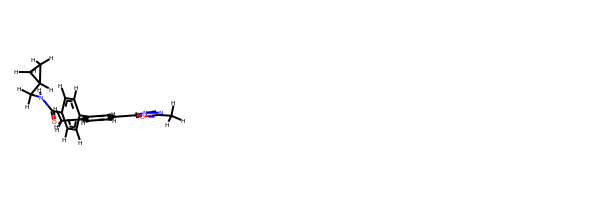

rdkit:  [H]c1c([H])c(-c2c([H])c(-c3nnc(C([H])([H])[H])o3)c([H])c([H])c2C([H])([H])[H])c([H])c([H])c1C(=O)N([H])C([H])([H])C1([H])C([H])([H])C1([H])[H]
oechem:  Cc1ccc(cc1c2ccc(cc2)C(=O)NCC3CC3)c4nnc(o4)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
9.600685490008004 kJ/mol 57869.448951162885 kJ/mol False
angle
108.9667464855546 kJ/mol 110.3468831908349 kJ/mol False
nb
63.78401217401285 kJ/mol 63.78401217401285 kJ/mol True
torsion
21.016965714951883 kJ/mol 21.017658461177128 kJ/mol False
203.36840986452734 kJ/mol 58064.59750498891 kJ/mol

-------------------------------------------------------------------
--------------------

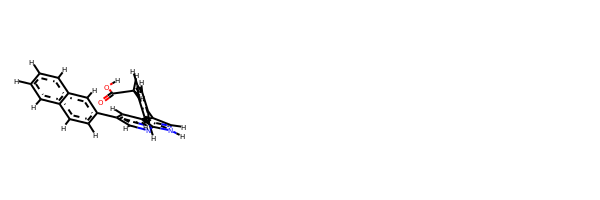

rdkit:  [H]OC(=O)C([H])([H])c1c([H])c([H])c(-c2c([H])n([H])c3nc([H])c(-c4c([H])c([H])c5c([H])c([H])c([H])c([H])c5c4[H])c([H])c23)c([H])c1[H]
oechem:  c1ccc2cc(ccc2c1)c3cc4c(c[nH]c4nc3)c5ccc(cc5)CC(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
25.087373780199336 kJ/mol 58168.649637644696 kJ/mol False
angle
111.91217729143273 kJ/mol 111.91217729143273 kJ/mol True
nb
51.460914936328074 kJ/mol 51.460914936328074 kJ/mol True
torsion
63.717349588919504 kJ/mol 61.12723632354157 kJ/mol False
252.17781559687964 kJ/mol 58393.149966196 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5754


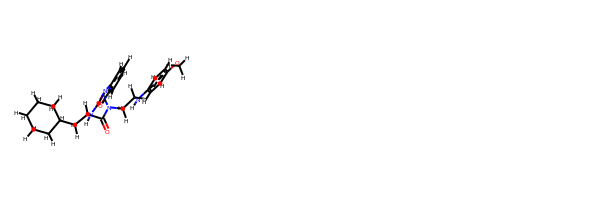

rdkit:  [H]c1c([H])c(N([H])C([H])([H])C([H])([H])N([H])C(=O)C([H])(N([H])c2nc3c([H])c([H])c([H])c([H])c3o2)C([H])([H])C2([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C2([H])[H])c([H])c([H])c1OC([H])([H])[H]
oechem:  COc1ccc(cc1)NCCNC(=O)C(CC2CCCCC2)Nc3nc4ccccc4o3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
32.19249154626442 kJ/mol 43746.06494509838 kJ/mol False
angle
340.34288828692604 kJ/mol 342.18339751370024 kJ/mol False
nb
40.549131249637355 kJ/mol 40.549131249637355 kJ/mol True
tors

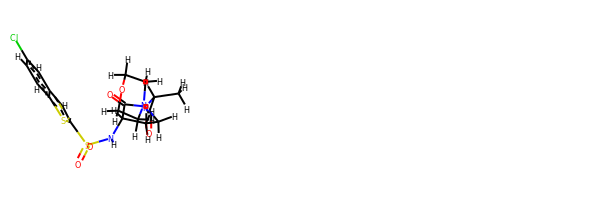

rdkit:  [H]c1c(Cl)c([H])c2c([H])c(S(=O)(=O)N([H])C3([H])C(=O)N(C([H])(C(=O)N4C([H])([H])C([H])([H])OC([H])([H])C4([H])[H])C([H])([H])[H])C([H])([H])C3([H])[H])sc2c1[H]
oechem:  CC(C(=O)N1CCOCC1)N2CCC(C2=O)NS(=O)(=O)c3cc4cc(ccc4s3)Cl
###########################################################################
 #########################################################

bond
32.1822122892706 kJ/mol 43747.76458214373 kJ/mol False
angle
340.25460130765174 kJ/mol 342.0950857762305 kJ/mol False
nb
40.450342694456836 kJ/mol 40.450342694456836 kJ/mol True
torsion
174.85726244818946 kJ/mol 174.85726527023402 kJ/mol False
587.7444187395686 kJ/mol 44305.167275884654 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5759


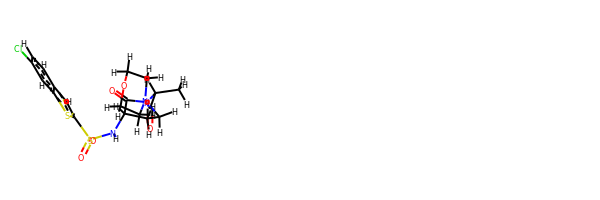

rdkit:  [H]c1c(Cl)c([H])c2sc(S(=O)(=O)N([H])C3([H])C(=O)N(C([H])(C(=O)N4C([H])([H])C([H])([H])OC([H])([H])C4([H])[H])C([H])([H])[H])C([H])([H])C3([H])[H])c([H])c2c1[H]
oechem:  CC(C(=O)N1CCOCC1)N2CCC(C2=O)NS(=O)(=O)c3cc4ccc(cc4s3)Cl
###########################################################################
 #########################################################

bond
29.01647406473742 kJ/mol 57886.919302466296 kJ/mol False
angle
160.5441128345369 kJ/mol 161.9513146824243 kJ/mol False
nb
52.717347919883196 kJ/mol 52.717347919883196 kJ/mol True
torsion
59.503438824990624 kJ/mol 59.50358906080421 kJ/mol False
301.7813736441481 kJ/mol 58161.09155412941 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5760


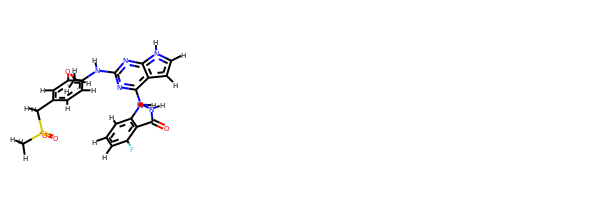

rdkit:  [H]c1c([H])c(F)c(C(=O)N([H])[H])c(N([H])c2nc(N([H])c3c([H])c([H])c(C([H])([H])S(=O)(=O)C([H])([H])[H])c([H])c3OC([H])([H])[H])nc3c2c([H])c([H])n3[H])c1[H]
oechem:  COc1cc(ccc1Nc2nc3c(cc[nH]3)c(n2)Nc4cccc(c4C(=O)N)F)CS(=O)(=O)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
30.77547029919073 kJ/mol 57783.50986148567 kJ/mol False
angle
376.09260610746367 kJ/mol 377.3229044914295 kJ/mol False
nb
39.14514017673944 kJ/mol 39.14514017673944 kJ/mol True
torsion
174.86396104139993 kJ/mol 174.86430350332412 kJ/mol False
620.8771776247938 kJ/mol 58374.84220965716 kJ/mol

----------------------------------------------------------

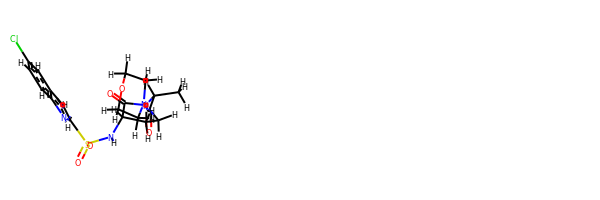

rdkit:  [H]c1c(Cl)c([H])c2c([H])c(S(=O)(=O)N([H])C3([H])C(=O)N(C([H])(C(=O)N4C([H])([H])C([H])([H])OC([H])([H])C4([H])[H])C([H])([H])[H])C([H])([H])C3([H])[H])n([H])c2c1[H]
oechem:  CC(C(=O)N1CCOCC1)N2CCC(C2=O)NS(=O)(=O)c3cc4cc(ccc4[nH]3)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
9.362349442434105 kJ/mol 86835.61913338782 kJ/mol False
angle
105.1338559649822 kJ/mol 110.18599406842046 kJ/mol False
nb
19.3602644258916 kJ/mol 19.3602644258916 kJ/mol True
torsion
19.85421735117339 kJ/mol 12.89175818206435 kJ/mol False
153.7106871844813 kJ/mol 86978.05715006421 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
--------------------------------------------------------

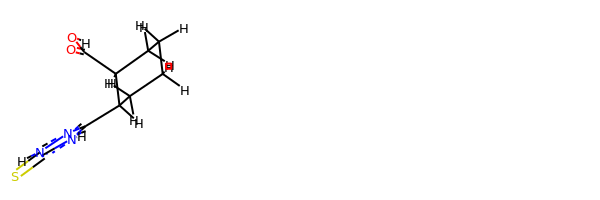

rdkit:  [H]OC(=O)C1([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C1([H])c1nn([H])c(=S)n1[H]
oechem:  C1CCC(C(C1)c2[nH]c(=S)[nH]n2)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
10.555121949145356 kJ/mol 29167.683922405387 kJ/mol False
angle
98.07484847586423 kJ/mol 98.07484847586423 kJ/mol True
nb
62.714666852939395 kJ/mol 62.714666852939395 kJ/mol True
torsion
10.481893778506567 kJ/mol 5.251887115507059 kJ/mol False
181.82653105645554 kJ/mol 29333.7253248497 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5767


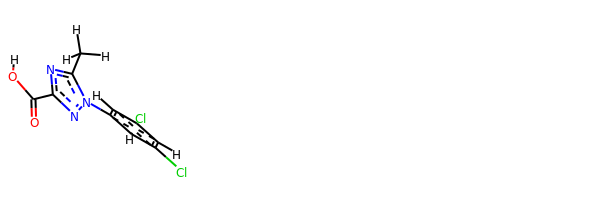

rdkit:  [H]OC(=O)c1nc(C([H])([H])[H])n(-c2c([H])c(Cl)c([H])c(Cl)c2[H])n1
oechem:  Cc1nc(nn1c2cc(cc(c2)Cl)Cl)C(=O)O
###########################################################################
 #########################################################

bond
21.638662078620246 kJ/mol 29090.112480158983 kJ/mol False
angle
131.91866844945974 kJ/mol 133.60280101871405 kJ/mol False
nb
61.22727634335476 kJ/mol 61.22727634335476 kJ/mol True
torsion
172.8671869206305 kJ/mol 168.07269400955835 kJ/mol False
387.6517937920653 kJ/mol 29453.01525153061 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5768


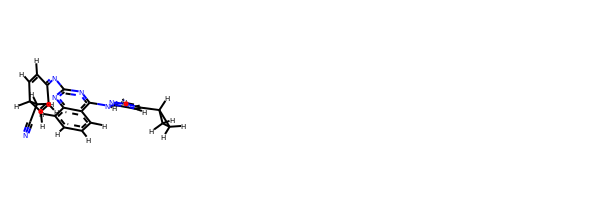

rdkit:  [H]C1=C([H])C([H])(C([H])([H])C#N)C([H])=C([H])C1=Nc1nc(N([H])c2nn([H])c(C3([H])C([H])([H])C3([H])[H])c2[H])c2c([H])c([H])c([H])c([H])c2n1
oechem:  c1ccc2c(c1)c(nc(n2)N=C3C=CC(C=C3)CC#N)Nc4cc([nH]n4)C5CC5
###########################################################################
 #########################################################

bond
6.97194284534479 kJ/mol 57988.93943312956 kJ/mol False
angle
102.39568055932484 kJ/mol 104.51303520630931 kJ/mol False
nb
33.006393482468646 kJ/mol 33.006393482468646 kJ/mol True
torsion
15.745995142754564 kJ/mol 15.745941144574193 kJ/mol False
158.12001202989285 kJ/mol 58142.204802962915 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5769


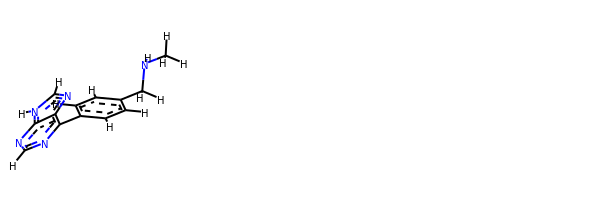

rdkit:  [H]c1nc(-c2c([H])c([H])c(C([H])([H])N([H])C([H])([H])[H])c([H])c2[H])c2nc([H])n([H])c2n1
oechem:  CNCc1ccc(cc1)c2c3c([nH]cn3)ncn2
###########################################################################
 #########################################################

bond
7.556295394561237 kJ/mol 57989.45321828112 kJ/mol False
angle
124.94625862347537 kJ/mol 127.06614889443556 kJ/mol False
nb
51.319809443246335 kJ/mol 51.319809443246335 kJ/mol True
torsion
20.66243373212745 kJ/mol 20.66242020760595 kJ/mol False
204.4847971934104 kJ/mol 58188.50159682641 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5770


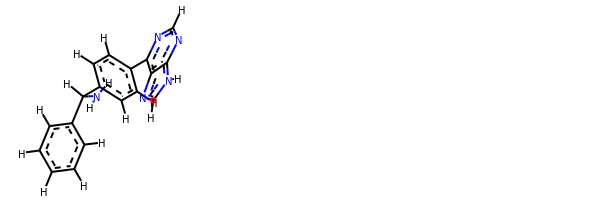

rdkit:  [H]c1nc(-c2c([H])c([H])c(C([H])(c3c([H])c([H])c([H])c([H])c3[H])N([H])[H])c([H])c2[H])c2nc([H])n([H])c2n1
oechem:  c1ccc(cc1)C(c2ccc(cc2)c3c4c([nH]cn4)ncn3)N
###########################################################################
 #########################################################

bond
17.063197910027792 kJ/mol 57997.814732207386 kJ/mol False
angle
110.5913894300576 kJ/mol 112.71134964072395 kJ/mol False
nb
98.79639763888171 kJ/mol 98.79639763888171 kJ/mol True
torsion
26.556650699154247 kJ/mol 26.556610038771435 kJ/mol False
253.00763567812135 kJ/mol 58235.87908952576 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5771


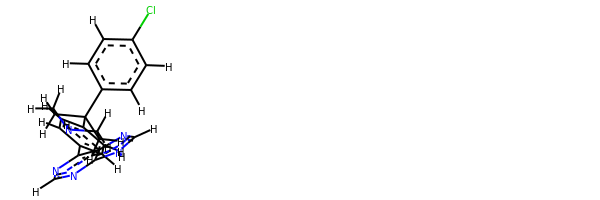

rdkit:  [H]c1nc(-c2c([H])c([H])c(C3(c4c([H])c([H])c(Cl)c([H])c4[H])C([H])([H])C([H])([H])N([H])C([H])([H])C3([H])[H])c([H])c2[H])c2nc([H])n([H])c2n1
oechem:  c1cc(ccc1c2c3c([nH]cn3)ncn2)C4(CCNCC4)c5ccc(cc5)Cl
###########################################################################
 #########################################################

bond
14.00888828232276 kJ/mol 29081.24262130703 kJ/mol False
angle
118.84551692228642 kJ/mol 120.4998070359987 kJ/mol False
nb
32.504704930410675 kJ/mol 32.504704930410675 kJ/mol True
torsion
15.717638580604344 kJ/mol 10.487655478046271 kJ/mol False
181.07674871562418 kJ/mol 29244.734788751484 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5772


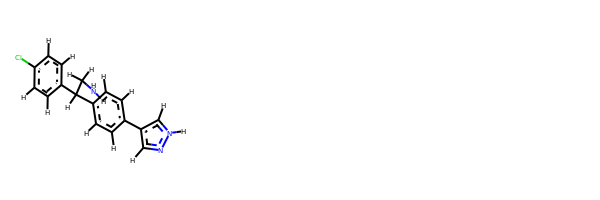

rdkit:  [H]c1nn([H])c([H])c1-c1c([H])c([H])c(C([H])(c2c([H])c([H])c(Cl)c([H])c2[H])C([H])([H])N([H])[H])c([H])c1[H]
oechem:  c1cc(ccc1c2c[nH]nc2)C(CN)c3ccc(cc3)Cl
###########################################################################
 #########################################################

bond
14.00888828232276 kJ/mol 29081.24262130703 kJ/mol False
angle
118.84551692228642 kJ/mol 120.4998070359987 kJ/mol False
nb
32.504704930410675 kJ/mol 32.504704930410675 kJ/mol True
torsion
15.717638580604344 kJ/mol 10.487655478046271 kJ/mol False
181.07674871562418 kJ/mol 29244.734788751484 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5773


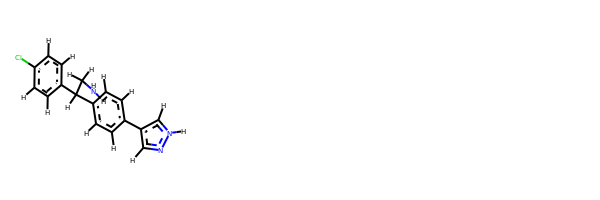

rdkit:  [H]c1nn([H])c([H])c1-c1c([H])c([H])c(C([H])(c2c([H])c([H])c(Cl)c([H])c2[H])C([H])([H])N([H])[H])c([H])c1[H]
oechem:  c1cc(ccc1c2c[nH]nc2)C(CN)c3ccc(cc3)Cl
###########################################################################
 #########################################################

bond
21.882891725809703 kJ/mol 29091.527594105522 kJ/mol False
angle
102.91804162697198 kJ/mol 104.57394760904556 kJ/mol False
nb
81.74459271986017 kJ/mol 81.74459271986017 kJ/mol True
torsion
21.3451891934908 kJ/mol 16.11520403299209 kJ/mol False
227.89071526613264 kJ/mol 29293.96133846742 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5774


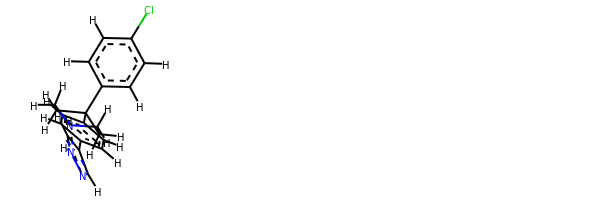

rdkit:  [H]c1nn([H])c([H])c1-c1c([H])c([H])c(C2(c3c([H])c([H])c(Cl)c([H])c3[H])C([H])([H])C([H])([H])N([H])C([H])([H])C2([H])[H])c([H])c1[H]
oechem:  c1cc(ccc1c2c[nH]nc2)C3(CCNCC3)c4ccc(cc4)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
11.391503050494649 kJ/mol 57791.967010068416 kJ/mol False
angle
103.47531631054913 kJ/mol 103.47531631054913 kJ/mol True
nb
40.56421435673081 kJ/mol 40.56421435673081 kJ/mol True
torsion
4.034734059630863 kJ/mol 4.034875206453049 kJ/mol False
159.46576777740546 kJ/mol 57940.04141594215 kJ/mol

-------------------------------------------------------------------
-------------------------------

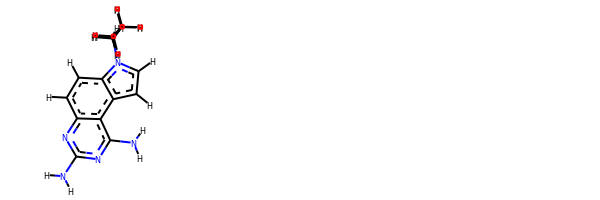

rdkit:  [H]c1c([H])c2c(c([H])c([H])n2C([H])(C([H])([H])C([H])([H])[H])C([H])([H])C([H])([H])[H])c2c(N([H])[H])nc(N([H])[H])nc12
oechem:  CCC(CC)n1ccc2c1ccc3c2c(nc(n3)N)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
20.67968335001696 kJ/mol 57048.87932554727 kJ/mol False
angle
22.297654722393105 kJ/mol 22.483654623745664 kJ/mol False
nb
64.70716880686372 kJ/mol 64.70716880686372 kJ/mol True
torsion
157.1156364028875 kJ/mol 140.6367744587621 kJ/mol False
264.8001432821613 kJ/mol 57276.706923436635 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5779


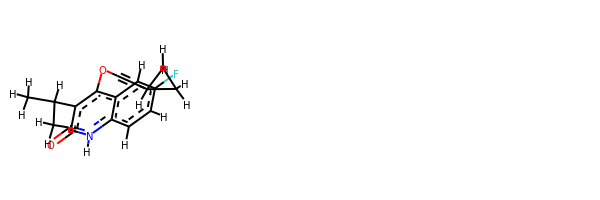

rdkit:  [H]c1c(F)c([H])c2c(OC#CC3([H])C([H])([H])C3([H])[H])c(C([H])(C([H])([H])[H])C([H])([H])[H])c(=O)n([H])c2c1[H]
oechem:  CC(C)c1c(c2cc(ccc2[nH]c1=O)F)OC#CC3CC3
###########################################################################
 #########################################################

bond
9.12316778316002 kJ/mol 29204.047869022386 kJ/mol False
angle
94.0251116969296 kJ/mol 96.70376135389704 kJ/mol False
nb
24.65637184108726 kJ/mol 24.65637184108726 kJ/mol True
torsion
7.390715301774773 kJ/mol 2.1607073982178364 kJ/mol False
135.19536662295167 kJ/mol 29327.56870961559 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5780


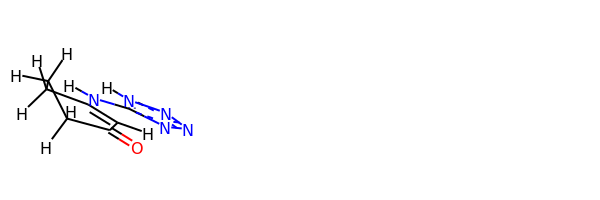

rdkit:  [H]C1=C(N([H])c2nnnn2[H])C([H])([H])C([H])([H])C([H])([H])C1=O
oechem:  C1CC(=CC(=O)C1)Nc2[nH]nnn2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
19.87355567247159 kJ/mol 57047.66490834664 kJ/mol False
angle
24.44682256749212 kJ/mol 24.632746703266875 kJ/mol False
nb
92.47050976245305 kJ/mol 92.47050976245305 kJ/mol True
torsion
72.45468148836079 kJ/mol 55.97509867628683 kJ/mol False
209.24556949077754 kJ/mol 57220.74326348865 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5782


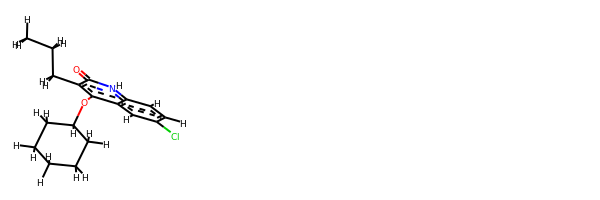

rdkit:  [H]c1c(Cl)c([H])c2c(OC3([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C3([H])[H])c(C([H])([H])C([H])([H])C([H])([H])[H])c(=O)n([H])c2c1[H]
oechem:  CCCc1c(c2cc(ccc2[nH]c1=O)Cl)OC3CCCCC3
###########################################################################
 #########################################################

bond
13.86196056170535 kJ/mol 57202.68252469912 kJ/mol False
angle
24.240742355418718 kJ/mol 24.435795812869934 kJ/mol False
nb
41.83225886603864 kJ/mol 41.83225886603864 kJ/mol True
torsion
38.29477814174312 kJ/mol 21.80450711950761 kJ/mol False
118.22973992490583 kJ/mol 57290.755086497535 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5783


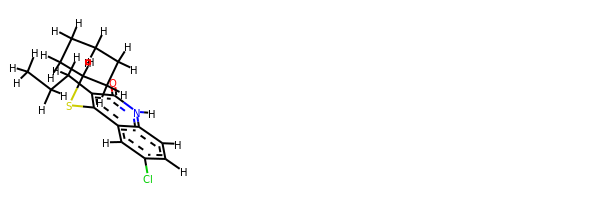

rdkit:  [H]c1c(Cl)c([H])c2c(SC3([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C3([H])[H])c(C([H])([H])C([H])([H])C([H])([H])[H])c(=O)n([H])c2c1[H]
oechem:  CCCc1c(c2cc(ccc2[nH]c1=O)Cl)SC3CCCCC3
###########################################################################
 #########################################################

bond
26.88401346845561 kJ/mol 57199.58094467905 kJ/mol False
angle
43.4703555689001 kJ/mol 43.65988961669138 kJ/mol False
nb
77.12701179888218 kJ/mol 77.12701179888218 kJ/mol True
torsion
54.838403604285766 kJ/mol 38.13633700035359 kJ/mol False
202.31978444052368 kJ/mol 57358.50418309498 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5784


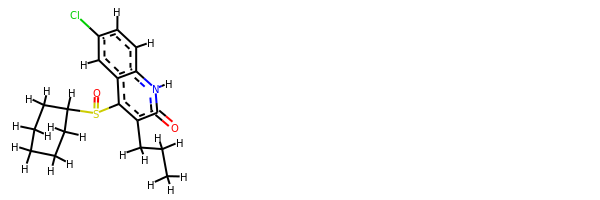

rdkit:  [H]c1c(Cl)c([H])c2c(S(=O)C3([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C3([H])[H])c(C([H])([H])C([H])([H])C([H])([H])[H])c(=O)n([H])c2c1[H]
oechem:  CCCc1c(c2cc(ccc2[nH]c1=O)Cl)S(=O)C3CCCCC3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
19.910984281690215 kJ/mol 57047.70233695587 kJ/mol False
angle
24.061662556620842 kJ/mol 24.247586692395597 kJ/mol False
nb
105.54970968647136 kJ/mol 105.54970968647136 kJ/mol True
torsion
62.83546324539771 kJ/mol 46.35588043332379 kJ/mol False
212.35781977018013 kJ/mol 57223.85551376805 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5786


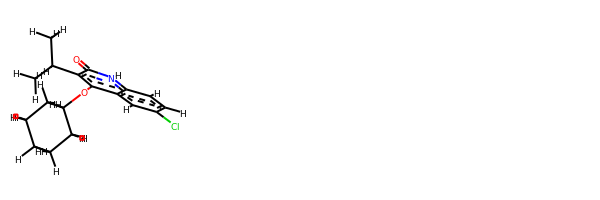

rdkit:  [H]c1c(Cl)c([H])c2c(OC3([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C3([H])[H])c(C([H])(C([H])([H])[H])C([H])([H])[H])c(=O)n([H])c2c1[H]
oechem:  CC(C)c1c(c2cc(ccc2[nH]c1=O)Cl)OC3CCCCC3
###########################################################################
 #########################################################

bond
55.42485128850067 kJ/mol 100091.8869395219 kJ/mol False
angle
348.1982754868982 kJ/mol 350.35043014862975 kJ/mol False
nb
79.52131876477827 kJ/mol 79.52131876477827 kJ/mol True
torsion
69.95440563948038 kJ/mol 70.92519409875354 kJ/mol False
553.0988511796576 kJ/mol 100592.68388253405 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5787


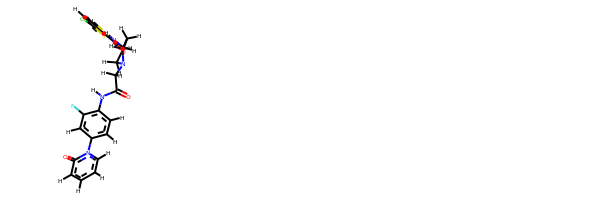

rdkit:  [H]c1c(Cl)sc(C(=O)N([H])C2([H])C([H])([H])N(C([H])([H])C(=O)N([H])c3c([H])c([H])c(-n4c([H])c([H])c([H])c([H])c4=O)c([H])c3F)C([H])([H])C2([H])[H])c1[H]
oechem:  c1ccn(c(=O)c1)c2ccc(c(c2)F)NC(=O)CN3CCC(C3)NC(=O)c4ccc(s4)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
55.778554057021665 kJ/mol 100095.29288136905 kJ/mol False
angle
350.70705923582983 kJ/mol 352.85910409469204 kJ/mol False
nb
79.54069330336925 kJ/mol 79.54069330336925 kJ/mol True
torsion
70.05598001458667 kJ/mol 71.02674864739613 kJ/mol False
556.0822866108074 kJ/mol 100598.7194274145 kJ/mol

--------------------------------------------------------------

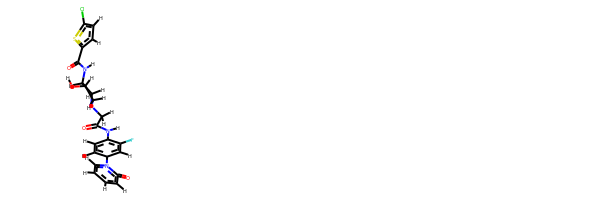

rdkit:  [H]OC1([H])C([H])([H])N(C([H])([H])C(=O)N([H])c2c([H])c([H])c(-n3c([H])c([H])c([H])c([H])c3=O)c([H])c2F)C([H])([H])C1([H])N([H])C(=O)c1sc(Cl)c([H])c1[H]
oechem:  c1ccn(c(=O)c1)c2ccc(c(c2)F)NC(=O)CN3CC(C(C3)O)NC(=O)c4ccc(s4)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
37.326044523465875 kJ/mol 58017.33241626699 kJ/mol False
angle
244.0880711727698 kJ/mol 244.0880711727698 kJ/mol True
nb
28.09902835115743 kJ/mol 28.09902835115743 kJ/mol True
torsion
36.02056583440035 kJ/mol 33.298177217165275 kJ/mol False
345.53370988179347 kJ/mol 58322.81769300808 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
------------------------------------------------------------

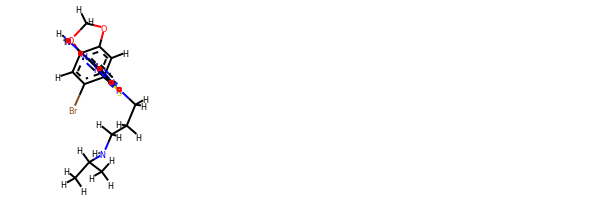

rdkit:  [H]c1nc(N([H])[H])c2nc(Sc3c([H])c4c(c([H])c3Br)OC([H])([H])O4)n(C([H])([H])C([H])([H])C([H])([H])N([H])C([H])(C([H])([H])[H])C([H])([H])[H])c2n1
oechem:  CC(C)NCCCn1c2c(c(ncn2)N)nc1Sc3cc4c(cc3Br)OCO4
###########################################################################
 #########################################################

bond
30.055391927522223 kJ/mol 29170.430578017465 kJ/mol False
angle
116.64704126933944 kJ/mol 116.64704126933944 kJ/mol True
nb
36.964268674881815 kJ/mol 36.964268674881815 kJ/mol True
torsion
57.52460069492755 kJ/mol 41.73365122390532 kJ/mol False
241.19130256667103 kJ/mol 29365.77553918559 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5793


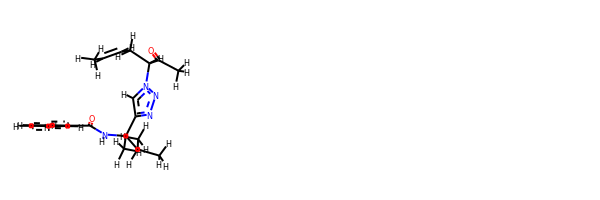

rdkit:  [H]C(=C([H])C([H])([H])C([H])(C(=O)C([H])([H])[H])n1nnc(C(N([H])C(=O)c2c([H])c([H])c([H])c([H])c2[H])(C([H])([H])[H])C([H])(C([H])([H])[H])C([H])([H])[H])c1[H])C([H])([H])[H]
oechem:  CC=CCC(C(=O)C)n1cc(nn1)C(C)(C(C)C)NC(=O)c2ccccc2
###########################################################################
 #########################################################

bond
35.28256262304939 kJ/mol 101872.0796039619 kJ/mol False
angle
134.51822642294042 kJ/mol 136.66932119883793 kJ/mol False
nb
24.57028751062353 kJ/mol 24.57028751062353 kJ/mol True
torsion
51.84084556746592 kJ/mol 30.094761300898096 kJ/mol False
246.21192212407925 kJ/mol 102063.41397397226 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5794


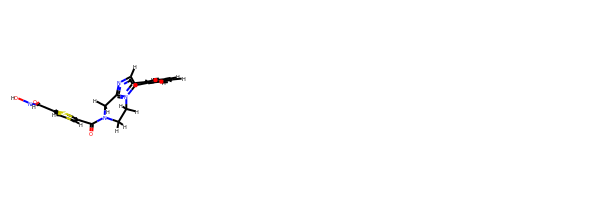

rdkit:  [H]ON([H])C(=O)c1sc(C(=O)N2C([H])([H])c3nc([H])c(-c4c([H])c([H])c([H])c([H])c4[H])n3C([H])([H])C2([H])[H])c([H])c1[H]
oechem:  c1ccc(cc1)c2cnc3n2CCN(C3)C(=O)c4ccc(s4)C(=O)NO
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

##

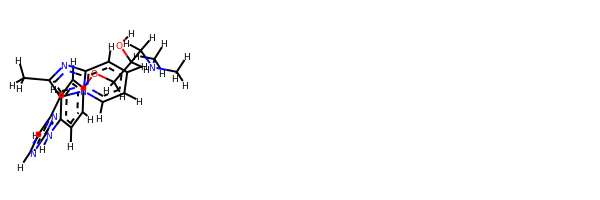

rdkit:  [H]OC([H])(C([H])([H])Oc1c([H])c([H])c(N([H])c2nc([H])c([H])c(-c3c(C([H])([H])[H])nc4c([H])c([H])c([H])c([H])n34)n2)c([H])c1[H])C([H])([H])N(C([H])([H])[H])C([H])([H])[H]
oechem:  Cc1c(n2ccccc2n1)c3ccnc(n3)Nc4ccc(cc4)OCC(CN(C)C)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
36.154143463942354 kJ/mol 113627.50524759911 kJ/mol False
angle
29.910395914461287 kJ/mol 30.517724544110585 kJ/mol False
nb
39.882645263101665 kJ/mol 39.882645263101665 kJ/mol True
torsion
73.84947200110008 kJ/mol 19.567910122960168 kJ/mol False
179.7966566426054 kJ/mol 113717.47352752929 kJ/mol

--------------------------------------------------

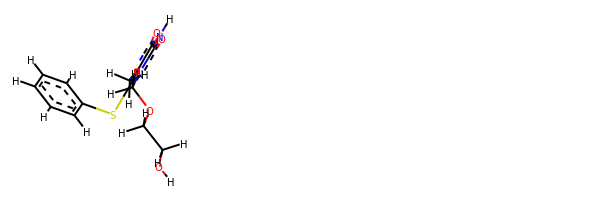

rdkit:  [H]OC([H])([H])C([H])([H])OC([H])([H])n1c(Sc2c([H])c([H])c([H])c([H])c2[H])c(C([H])([H])[H])c(=O)n([H])c1=O
oechem:  Cc1c(=O)[nH]c(=O)n(c1Sc2ccccc2)COCCO
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

######################

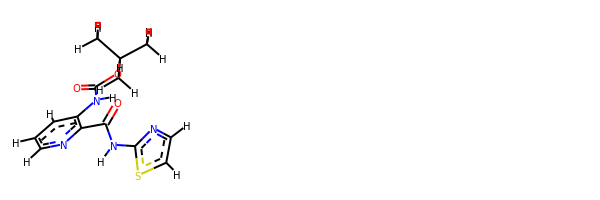

rdkit:  [H]c1nc(N([H])C(=O)c2nc([H])c([H])c([H])c2N([H])C(=O)OC(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H])sc1[H]
oechem:  CC(C)(C)OC(=O)Nc1cccnc1C(=O)Nc2nccs2
###########################################################################
 #########################################################

bond
29.19524716117601 kJ/mol 43700.99429091329 kJ/mol False
angle
79.73056943889708 kJ/mol 83.08616381248629 kJ/mol False
nb
71.07854282118886 kJ/mol 71.07854282118886 kJ/mol True
torsion
4.3709842555852365 kJ/mol 4.371066506068414 kJ/mol False
184.3753436768472 kJ/mol 43859.53006405303 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5817


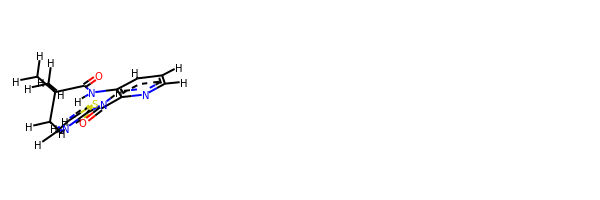

rdkit:  [H]c1nc(N([H])C(=O)c2nc([H])c([H])c([H])c2N([H])C(=O)C(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H])sc1[H]
oechem:  CC(C)(C)C(=O)Nc1cccnc1C(=O)Nc2nccs2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
20.808441548747787 kJ/mol 56878.54420553111 kJ/mol False
angle
21.612207214515816 kJ/mol 21.612207214515816 kJ/mol True
nb
47.62925739964465 kJ/mol 47.62925739964465 kJ/mol True
torsion
2.225717353047678 kJ/mol 2.2734836508976044 kJ/mol False
92.27562351595593 kJ/mol 56950.059153796166 kJ/

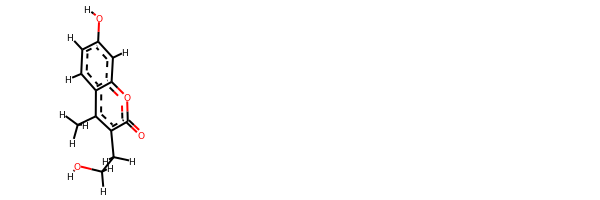

rdkit:  [H]Oc1c([H])c([H])c2c(C([H])([H])[H])c(C([H])([H])C([H])([H])O[H])c(=O)oc2c1[H]
oechem:  Cc1c2ccc(cc2oc(=O)c1CCO)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

#############################################################

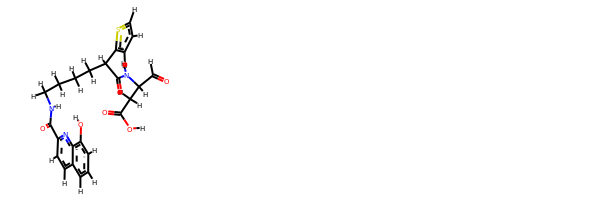

rdkit:  [H]OC(=O)C([H])([H])C([H])(C([H])=O)N([H])C(=O)C([H])(c1sc([H])c([H])c1[H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])N([H])C(=O)c1nc2c(O[H])c([H])c([H])c([H])c2c([H])c1[H]
oechem:  c1cc2ccc(nc2c(c1)O)C(=O)NCCCCC(c3cccs3)C(=O)NC(CC(=O)O)C=O
###########################################################################
 #########################################################

bond
15.312065189597542 kJ/mol 29209.542893052843 kJ/mol False
angle
87.91324772347004 kJ/mol 90.65642391001018 kJ/mol False
nb
43.32441629167059 kJ/mol 43.32441629167059 kJ/mol True
torsion
40.61177482103935 kJ/mol 34.63650318475023 kJ/mol False
187.16150402577753 kJ/mol 29378.160236439275 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5830


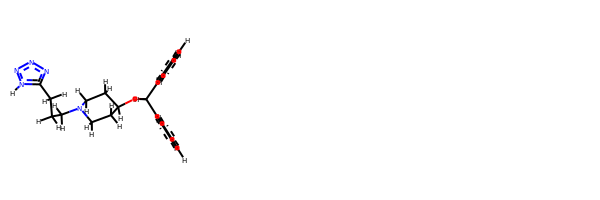

rdkit:  [H]c1c([H])c([H])c(C([H])(OC2([H])C([H])([H])C([H])([H])N(C([H])([H])C([H])([H])C([H])([H])c3nnnn3[H])C([H])([H])C2([H])[H])c2c([H])c([H])c([H])c([H])c2[H])c([H])c1[H]
oechem:  c1ccc(cc1)C(c2ccccc2)OC3CCN(CC3)CCCc4[nH]nnn4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
10.706470607976192 kJ/mol 57697.516516615455 kJ/mol False
angle
115.80551118072276 kJ/mol 116.90166034736511 kJ/mol False
nb
50.55021222216347 kJ/mol 50.55021222216347 kJ/mol True
torsion
0.0020882265675167704 kJ/mol 0.002126500272725949 kJ/mol False
177.06428223742995 kJ/mol 57864.97051568526 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-----------------------------------------------------

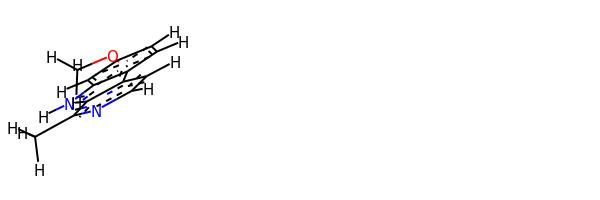

rdkit:  [H]c1nc(C([H])([H])[H])c2c(c1[H])c1c([H])c([H])c(OC([H])([H])[H])c([H])c1n2[H]
oechem:  Cc1c2c(ccn1)c3ccc(cc3[nH]2)OC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

##########################################################

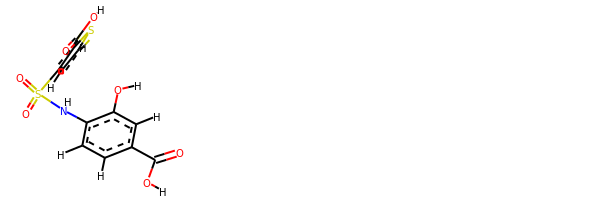

rdkit:  [H]OC(=O)c1sc([H])c([H])c1S(=O)(=O)N([H])c1c([H])c([H])c(C(=O)O[H])c([H])c1O[H]
oechem:  c1cc(c(cc1C(=O)O)O)NS(=O)(=O)c2ccsc2C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

############################################

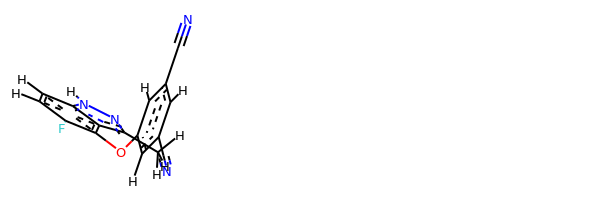

rdkit:  [H]c1c(C#N)c([H])c(Oc2c(F)c([H])c([H])c3c2c(C([H])([H])[H])nn3[H])c([H])c1C#N
oechem:  Cc1c2c(ccc(c2Oc3cc(cc(c3)C#N)C#N)F)[nH]n1
###########################################################################
 #########################################################

bond
20.822163032291915 kJ/mol 58041.53511144352 kJ/mol False
angle
432.91917280808474 kJ/mol 432.91917280808474 kJ/mol True
nb
89.4784832654788 kJ/mol 89.4784832654788 kJ/mol True
torsion
62.33784292459158 kJ/mol 54.44868363134292 kJ/mol False
605.557662030447 kJ/mol 58618.38145114842 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5849


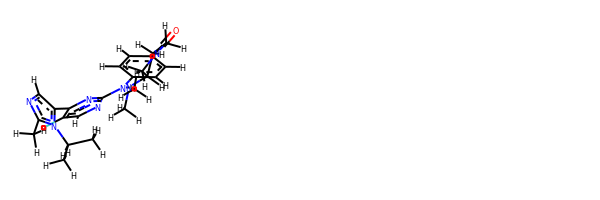

rdkit:  [H]c1nc(N([H])c2c([H])c([H])c(C(=O)N3C([H])([H])C([H])([H])C([H])(N(C([H])([H])[H])C([H])([H])[H])C3([H])[H])c([H])c2[H])nc(-c2c([H])nc(C([H])([H])[H])n2C([H])(C([H])([H])[H])C([H])([H])[H])c1F
oechem:  Cc1ncc(n1C(C)C)c2c(cnc(n2)Nc3ccc(cc3)C(=O)N4CCC(C4)N(C)C)F
###########################################################################
 #########################################################

bond
27.169919407267326 kJ/mol 58008.19375799059 kJ/mol False
angle
113.6647123354795 kJ/mol 113.6647123354795 kJ/mol True
nb
66.20725588795324 kJ/mol 66.20725588795324 kJ/mol True
torsion
45.54968215045706 kJ/mol 28.75497304724148 kJ/mol False
252.59156978115715 kJ/mol 58216.82069926126 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5850


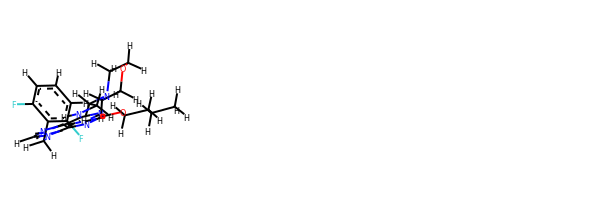

rdkit:  [H]c1c([H])c(F)c(C([H])([H])n2c([H])nc3c(N([H])C([H])([H])C([H])([H])N4C([H])([H])C([H])([H])OC([H])([H])C4([H])[H])nc(OC([H])([H])C([H])([H])C([H])([H])C([H])([H])[H])nc32)c(F)c1[H]
oechem:  CCCCOc1nc(c2c(n1)n(cn2)Cc3c(cccc3F)F)NCCN4CCOCC4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
47.65423706986451 kJ/mol 55991.18596609981 kJ/mol False
angle
16.138616296885584 kJ/mol 16.138616296885584 kJ/mol True
nb
56.95006412430018 kJ/mol 56.95006412430018 kJ/mol True
torsion
41.59558441687156

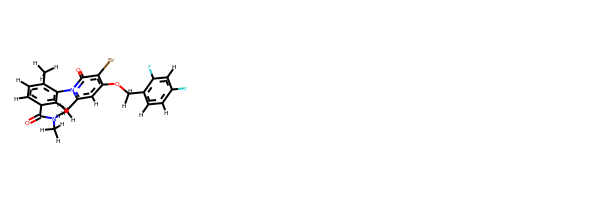

rdkit:  [H]c1c([H])c(C([H])([H])Oc2c([H])c(C([H])([H])[H])n(-c3c([H])c(C(=O)N([H])C([H])([H])[H])c([H])c([H])c3C([H])([H])[H])c(=O)c2Br)c(F)c([H])c1F
oechem:  Cc1ccc(cc1n2c(cc(c(c2=O)Br)OCc3ccc(cc3F)F)C)C(=O)NC
###########################################################################
 #########################################################

bond
11.917693251332988 kJ/mol 29080.328291284706 kJ/mol False
angle
98.64549313136992 kJ/mol 100.30173814140281 kJ/mol False
nb
22.456956129974536 kJ/mol 22.456956129974536 kJ/mol True
torsion
27.19502184345016 kJ/mol 31.38101334939999 kJ/mol False
160.21516435612762 kJ/mol 29234.467998905486 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5855


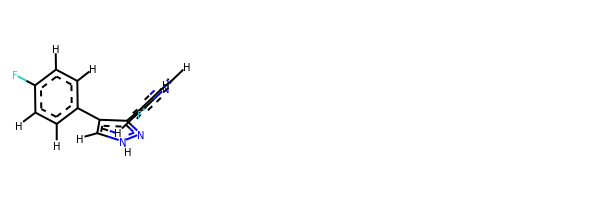

rdkit:  [H]c1nc(F)c([H])c(-c2nn([H])c([H])c2-c2c([H])c([H])c(F)c([H])c2[H])c1[H]
oechem:  c1cc(ccc1c2c[nH]nc2c3ccnc(c3)F)F
###########################################################################
 #########################################################

bond
22.160916249648345 kJ/mol 29091.33582418814 kJ/mol False
angle
123.05393969149405 kJ/mol 124.78463973987063 kJ/mol False
nb
43.42450924986843 kJ/mol 43.42450924986843 kJ/mol True
torsion
49.905239803472554 kJ/mol 44.67528427027156 kJ/mol False
238.5446049944834 kJ/mol 29304.22025744815 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5856


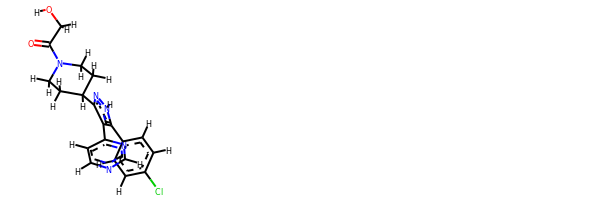

rdkit:  [H]OC([H])([H])C(=O)N1C([H])([H])C([H])([H])C([H])(c2nn([H])c(-c3c([H])c([H])c(Cl)c([H])c3[H])c2-c2nc([H])nc([H])c2[H])C([H])([H])C1([H])[H]
oechem:  c1cc(ccc1c2c(c(n[nH]2)C3CCN(CC3)C(=O)CO)c4ccncn4)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
15.559702817533394 kJ/mol 57789.7536325885 kJ/mol False
angle
129.36975446761085 kJ/mol 129.36975446761085 kJ/mol True
nb
71.90246196562723 kJ/mol 71.90246196562723 kJ/mol True
torsion
53.71581719304735 kJ/mol 33.18951752181878 kJ/mol False
270.54773644381885 kJ/mol 58024.215366543554 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5858


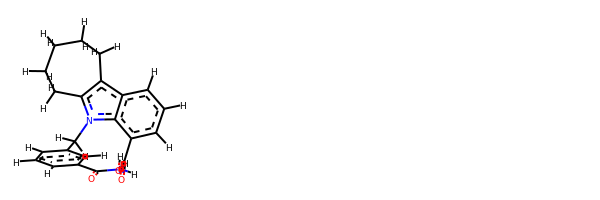

rdkit:  [H]OC(=O)c1c([H])c([H])c([H])c2c3c(n(C([H])([H])c4c([H])c([H])c([H])c(C(=O)N([H])[H])c4[H])c12)C([H])([H])C([H])([H])C([H])([H])C([H])([H])C3([H])[H]
oechem:  c1cc(cc(c1)C(=O)N)Cn2c3c(c4c2c(ccc4)C(=O)O)CCCCC3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
6.716238830056236 kJ/mol 57758.621585496854 kJ/mol False
angle
87.09418701103799 kJ/mol 88.32412132385669 kJ/mol False
nb
9.540315467911299 kJ/mol 9.540315467911299 kJ/mol True
torsion
5.143940503009257 kJ/mol 0.15259548582296384 kJ/mol False
108.49468181201479 kJ/mol 57856.63861777444 kJ/mol

-------------------------------------------------------------------
-------

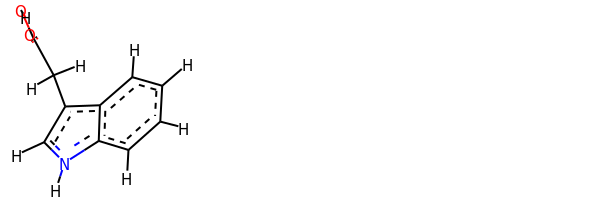

rdkit:  [H]OC(=O)C([H])([H])c1c([H])n([H])c2c([H])c([H])c([H])c([H])c12
oechem:  c1ccc2c(c1)c(c[nH]2)CC(=O)O
###########################################################################
 #########################################################

bond
14.377809282859753 kJ/mol 57768.426438930845 kJ/mol False
angle
109.16690268776725 kJ/mol 110.39472392609366 kJ/mol False
nb
19.510341298571397 kJ/mol 19.510341298571397 kJ/mol True
torsion
22.36028664632253 kJ/mol 17.29042190053584 kJ/mol False
165.41533991552095 kJ/mol 57915.62192605605 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5863


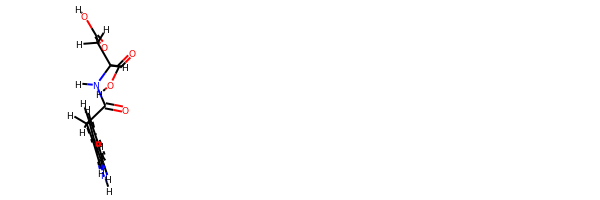

rdkit:  [H]OC(=O)C([H])([H])C([H])(C(=O)O[H])N([H])C(=O)C([H])([H])c1c([H])n([H])c2c([H])c([H])c([H])c([H])c12
oechem:  c1ccc2c(c1)c(c[nH]2)CC(=O)NC(CC(=O)O)C(=O)O
###########################################################################
 #########################################################

bond
13.659441895451167 kJ/mol 57765.56478856226 kJ/mol False
angle
102.58416720165916 kJ/mol 103.81410151447785 kJ/mol False
nb
10.442258651966542 kJ/mol 10.442258651966542 kJ/mol True
torsion
15.531395274610407 kJ/mol 10.461258722602103 kJ/mol False
142.21726302368728 kJ/mol 57890.282407451305 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5864


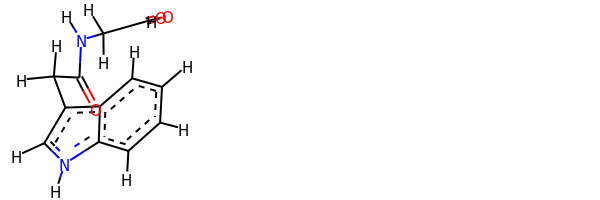

rdkit:  [H]OC(=O)C([H])([H])N([H])C(=O)C([H])([H])c1c([H])n([H])c2c([H])c([H])c([H])c([H])c12
oechem:  c1ccc2c(c1)c(c[nH]2)CC(=O)NCC(=O)O
###########################################################################
 #########################################################

bond
11.350754682569221 kJ/mol 57762.823802217354 kJ/mol False
angle
103.58832824710505 kJ/mol 104.81810880183689 kJ/mol False
nb
20.635188386864737 kJ/mol 20.635188386864737 kJ/mol True
torsion
17.553997027110693 kJ/mol 12.48370634976943 kJ/mol False
153.1282683436497 kJ/mol 57900.760805755825 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5865


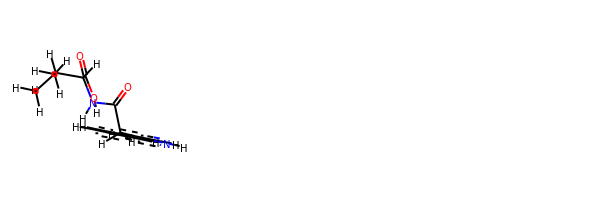

rdkit:  [H]OC(=O)C([H])(N([H])C(=O)C([H])([H])c1c([H])n([H])c2c([H])c([H])c([H])c([H])c12)C([H])(C([H])([H])[H])C([H])([H])[H]
oechem:  CC(C)C(C(=O)O)NC(=O)Cc1c[nH]c2c1cccc2
###########################################################################
 #########################################################

bond
57.73587620629765 kJ/mol 169859.77245047176 kJ/mol False
angle
105.19593775883021 kJ/mol 107.50507213938413 kJ/mol False
nb
25.05544807816885 kJ/mol 25.05544807816885 kJ/mol True
torsion
2.956280612191785 kJ/mol 0.21366313649721574 kJ/mol False
190.9435426554885 kJ/mol 169992.5466338258 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5866


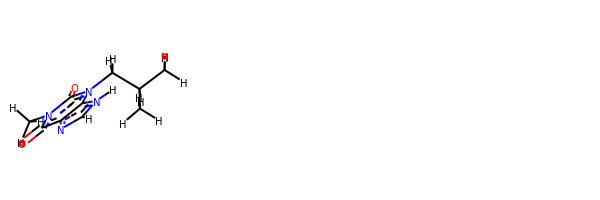

rdkit:  [H]c1nc2c(=O)n(C([H])([H])[H])c(=O)n(C([H])([H])C([H])(C([H])([H])[H])C([H])([H])[H])c2n1[H]
oechem:  CC(C)Cn1c2c(c(=O)n(c1=O)C)nc[nH]2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
13.432701525795421 kJ/mol 57765.33804819263 kJ/mol False
angle
97.23256920998925 kJ/mol 98.4631563818883 kJ/mol False
nb
9.99701919813829 kJ/mol 9.99701919813829 kJ/mol True
torsion
20.897813907964384 kJ/mol 16.93139406465289 kJ/mol False
141.56010384188733 kJ/mol 57890.729617837314 kJ/mol

---------------

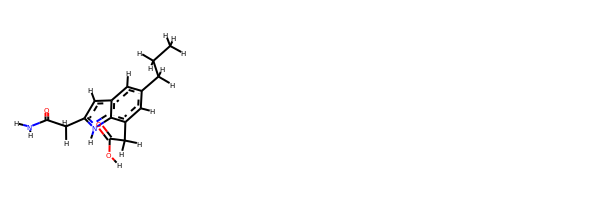

rdkit:  [H]OC(=O)C([H])([H])c1c([H])c(C([H])([H])C([H])([H])C([H])([H])[H])c([H])c2c([H])c(C([H])([H])C(=O)N([H])[H])n([H])c12
oechem:  CCCc1cc2cc([nH]c2c(c1)CC(=O)O)CC(=O)N
###########################################################################
 #########################################################

bond
9.094164060789124 kJ/mol 86889.23430583588 kJ/mol False
angle
161.80136121970315 kJ/mol 165.27584717593493 kJ/mol False
nb
22.079564501948166 kJ/mol 22.079564501948166 kJ/mol True
torsion
5.230213476065427 kJ/mol 0.00024177563612199377 kJ/mol False
198.20530325850586 kJ/mol 87076.5899592894 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5871


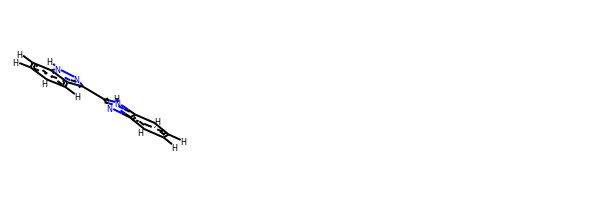

rdkit:  [H]c1c([H])c([H])c2c(nc(-c3nn([H])c4c([H])c([H])c([H])c([H])c34)n2[H])c1[H]
oechem:  c1ccc2c(c1)c(n[nH]2)c3[nH]c4ccccc4n3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
9.321154753070758 kJ/mol 57993.33885630684 kJ/mol False
angle
115.06778589250685 kJ/mol 115.06778589250685 kJ/mol True
nb
37.936315539030396 kJ/mol 37.936315539030396 kJ/mol True
torsio

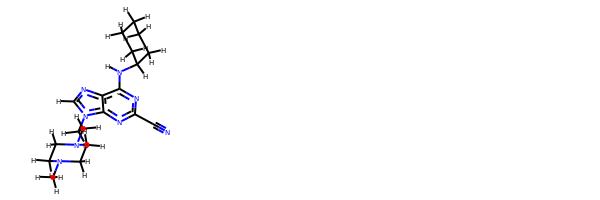

rdkit:  [H]c1nc2c(N([H])C3([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C3([H])[H])nc(C#N)nc2n1C([H])([H])C([H])([H])N1C([H])([H])C([H])([H])N(C([H])([H])[H])C([H])([H])C1([H])[H]
oechem:  CN1CCN(CC1)CCn2cnc3c2nc(nc3NC4CCCCC4)C#N
###########################################################################
 #########################################################

bond
20.4929443547445 kJ/mol 29090.235536212796 kJ/mol False
angle
139.51545846703286 kJ/mol 141.20009221876728 kJ/mol False
nb
51.88632405974707 kJ/mol 51.88632405974707 kJ/mol True
torsion
142.5360843670416 kJ/mol 137.73539820838116 kJ/mol False
354.430811248566 kJ/mol 29421.05735069969 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5878


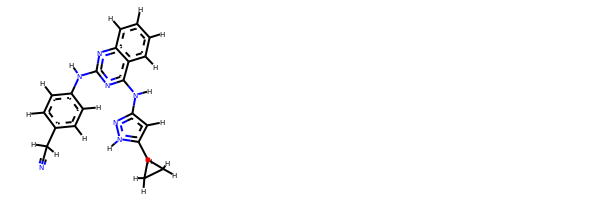

rdkit:  [H]c1c([H])c(C([H])([H])C#N)c([H])c([H])c1N([H])c1nc(N([H])c2nn([H])c(C3([H])C([H])([H])C3([H])[H])c2[H])c2c([H])c([H])c([H])c([H])c2n1
oechem:  c1ccc2c(c1)c(nc(n2)Nc3ccc(cc3)CC#N)Nc4cc([nH]n4)C5CC5
###########################################################################
 #########################################################

bond
21.86185882548831 kJ/mol 116024.03897591755 kJ/mol False
angle
563.2578691551415 kJ/mol 563.2578691551415 kJ/mol True
nb
22.58066804546069 kJ/mol 22.58066804546069 kJ/mol True
torsion
77.33600619872342 kJ/mol 64.7865860519709 kJ/mol False
685.036402224814 kJ/mol 116674.66409917011 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5879


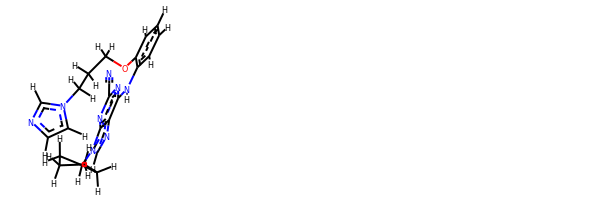

rdkit:  [H]c1nc([H])n(C([H])([H])C([H])([H])C([H])([H])Oc2c([H])c([H])c([H])c([H])c2N([H])c2nc(C#N)nc3c2nc([H])n3C2([H])C([H])([H])C([H])([H])C([H])([H])C2([H])[H])c1[H]
oechem:  c1ccc(c(c1)Nc2c3c(nc(n2)C#N)n(cn3)C4CCCC4)OCCCn5ccnc5
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
5.700163459033574 kJ/mol 57920.812235113095 kJ/mol False
angle
80.27401545878533 k

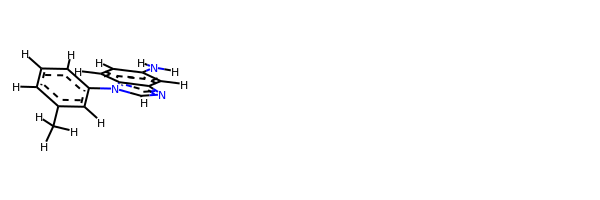

rdkit:  [H]c1c([H])c(-n2c([H])nc3c([H])c(N([H])[H])c([H])c([H])c32)c([H])c(C([H])([H])[H])c1[H]
oechem:  Cc1cccc(c1)n2cnc3c2ccc(c3)N
###########################################################################
 #########################################################

bond
20.778039684554606 kJ/mol 57772.77552477496 kJ/mol False
angle
87.63500118897387 kJ/mol 87.63500118897387 kJ/mol True
nb
112.94708596258725 kJ/mol 112.94708596258725 kJ/mol True
torsion
60.081005758856264 kJ/mol 34.20448909141732 kJ/mol False
281.441132594972 kJ/mol 58007.56210101794 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5885


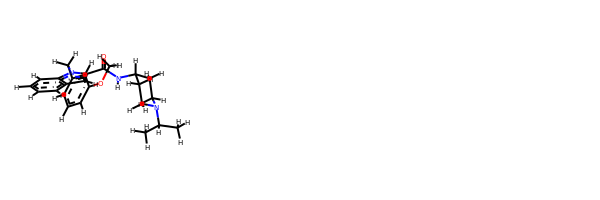

rdkit:  [H]c1c([H])c(OC([H])([H])[H])c([H])c(C([H])([H])n2c(C(=O)N([H])C3([H])C([H])([H])C([H])([H])N(C([H])(C([H])([H])[H])C([H])([H])[H])C([H])([H])C3([H])[H])c([H])c3c([H])c([H])c([H])c([H])c32)c1[H]
oechem:  CC(C)N1CCC(CC1)NC(=O)c2cc3ccccc3n2Cc4cccc(c4)OC
###########################################################################
 #########################################################

bond
22.718188254258873 kJ/mol 57774.71567334467 kJ/mol False
angle
107.32114572923845 kJ/mol 107.32114572923845 kJ/mol True
nb
113.92987274048356 kJ/mol 113.92987274048356 kJ/mol True
torsion
77.41047389595755 kJ/mol 44.91516560543764 kJ/mol False
321.3796806199384 kJ/mol 58040.88185741983 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5886


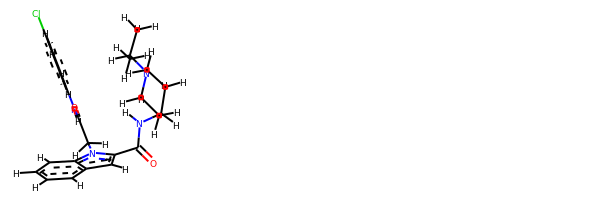

rdkit:  [H]c1c([H])c(N([H])C(=O)C([H])([H])n2c(C(=O)N([H])C3([H])C([H])([H])C([H])([H])N(C([H])(C([H])([H])[H])C([H])([H])[H])C([H])([H])C3([H])[H])c([H])c3c([H])c([H])c([H])c([H])c32)c([H])c([H])c1Cl
oechem:  CC(C)N1CCC(CC1)NC(=O)c2cc3ccccc3n2CC(=O)Nc4ccc(cc4)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
31.542831067826775 kJ/mol 43816.71895989395 kJ/mol False
angle
56.87543421656467 kJ/mol 59.030270204248254 kJ/mol False
nb
110.23152707988524 kJ/mol 110.23152707988524 kJ/mol True
torsion
20.444465835251943 kJ/mol 9.553148217095389 kJ/mol False
219.09425819952864 kJ/mol 43995.533905395176 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------

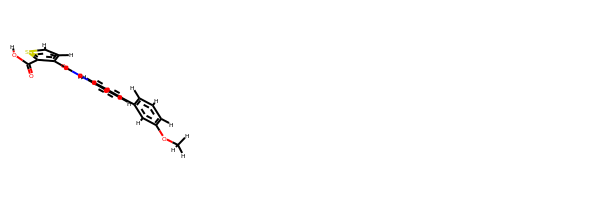

rdkit:  [H]OC(=O)c1sc([H])c([H])c1C(=O)N([H])c1c([H])c([H])c(-c2c([H])c([H])c([H])c(OC([H])([H])[H])c2[H])c([H])c1F
oechem:  COc1cccc(c1)c2ccc(c(c2)F)NC(=O)c3ccsc3C(=O)O
###########################################################################
 #########################################################

bond
35.390024443463744 kJ/mol 43823.34807671312 kJ/mol False
angle
58.23208412256137 kJ/mol 60.38304310230734 kJ/mol False
nb
113.23429286445395 kJ/mol 113.23429286445395 kJ/mol True
torsion
44.00322693252639 kJ/mol 33.11401406721169 kJ/mol False
250.85962836300544 kJ/mol 44030.0794267471 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5889


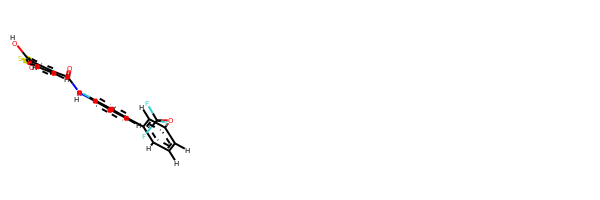

rdkit:  [H]OC(=O)c1sc([H])c([H])c1C(=O)N([H])c1c(F)c([H])c(-c2c([H])c([H])c([H])c(OC(F)(F)F)c2[H])c([H])c1F
oechem:  c1cc(cc(c1)OC(F)(F)F)c2cc(c(c(c2)F)NC(=O)c3ccsc3C(=O)O)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
36.24299332293627 kJ/mol 57007.97110952315 kJ/mol False
angle
96.62329403985568 kJ/mol 96.62329403985568 kJ/mol True
nb
60.63890788599515 kJ/mol 60.63890788599515 kJ/mol True
torsion
29.55060318680484 kJ/mol 24.541972750812118 kJ/mol False
223.05579843559195 kJ/mol 57189.77528419981 kJ/mol

-------------------------------------------------------------------
-----------------------------------------------------

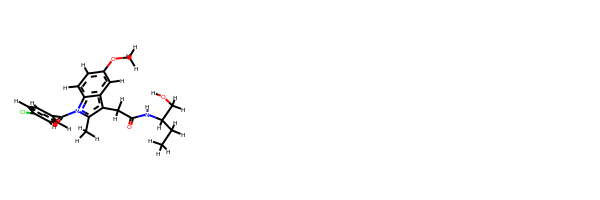

rdkit:  [H]OC([H])([H])C([H])(N([H])C(=O)C([H])([H])c1c(C([H])([H])[H])n(C(=O)c2c([H])c([H])c(Cl)c([H])c2[H])c2c([H])c([H])c(OC([H])([H])[H])c([H])c12)C([H])([H])C([H])([H])[H]
oechem:  CCC(CO)NC(=O)Cc1c(n(c2c1cc(cc2)OC)C(=O)c3ccc(cc3)Cl)C
###########################################################################
 #########################################################

bond
22.11148340597041 kJ/mol 58042.03606093113 kJ/mol False
angle
137.89145473306158 kJ/mol 137.89145473306158 kJ/mol True
nb
112.07468246310412 kJ/mol 112.07468246310412 kJ/mol True
torsion
47.26600690909008 kJ/mol 39.37676762616384 kJ/mol False
319.3436275112262 kJ/mol 58331.378965753465 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5894


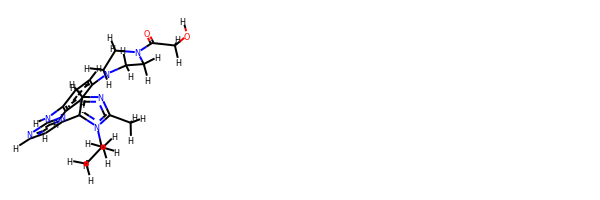

rdkit:  [H]OC([H])([H])C(=O)N1C([H])([H])C([H])([H])N(c2c([H])c([H])c(N([H])c3nc([H])c([H])c(-c4c([H])nc(C([H])([H])[H])n4C([H])(C([H])([H])[H])C([H])([H])[H])n3)c([H])c2[H])C([H])([H])C1([H])[H]
oechem:  Cc1ncc(n1C(C)C)c2ccnc(n2)Nc3ccc(cc3)N4CCN(CC4)C(=O)CO
###########################################################################
 #########################################################

bond
30.34811218872715 kJ/mol 57002.07622838893 kJ/mol False
angle
89.47099215451182 kJ/mol 89.47099215451182 kJ/mol True
nb
58.607417717015124 kJ/mol 58.607417717015124 kJ/mol True
torsion
14.145226232091403 kJ/mol 11.422138504863918 kJ/mol False
192.5717482923455 kJ/mol 57161.57677676532 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5895


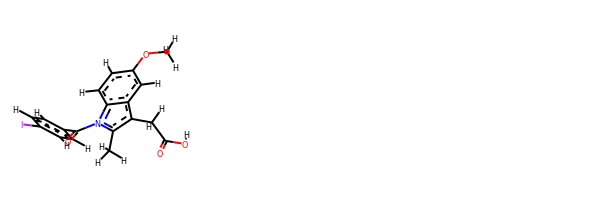

rdkit:  [H]OC(=O)C([H])([H])c1c(C([H])([H])[H])n(C(=O)c2c([H])c([H])c(I)c([H])c2[H])c2c([H])c([H])c(OC([H])([H])[H])c([H])c12
oechem:  Cc1c(c2cc(ccc2n1C(=O)c3ccc(cc3)I)OC)CC(=O)O
###########################################################################
 #########################################################

bond
36.24299332293627 kJ/mol 57007.97110952315 kJ/mol False
angle
96.62329403985568 kJ/mol 96.62329403985568 kJ/mol True
nb
60.63890788599515 kJ/mol 60.63890788599515 kJ/mol True
torsion
29.55060318680484 kJ/mol 24.541972750812118 kJ/mol False
223.05579843559195 kJ/mol 57189.77528419981 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5896


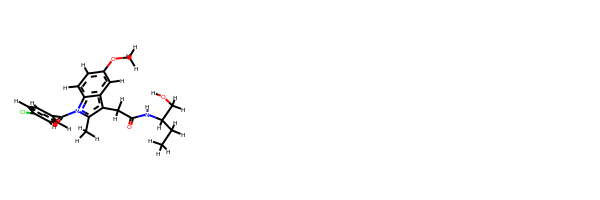

rdkit:  [H]OC([H])([H])C([H])(N([H])C(=O)C([H])([H])c1c(C([H])([H])[H])n(C(=O)c2c([H])c([H])c(Cl)c([H])c2[H])c2c([H])c([H])c(OC([H])([H])[H])c([H])c12)C([H])([H])C([H])([H])[H]
oechem:  CCC(CO)NC(=O)Cc1c(n(c2c1cc(cc2)OC)C(=O)c3ccc(cc3)Cl)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
26.97995203953333 kJ/mol 43714.87646821064 kJ/mol False
angle
68.24673944897415 kJ/mol 72.64276480423709 kJ/mol False
nb
22.480527979664892 kJ/mol 22.480527979664892 kJ/mol True
torsion
19.73892453601252 kJ/mol 19.738963703485513 kJ/mol False
137.4461440041849 kJ/mol 43829.73872469803 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-----------------------------------------------------

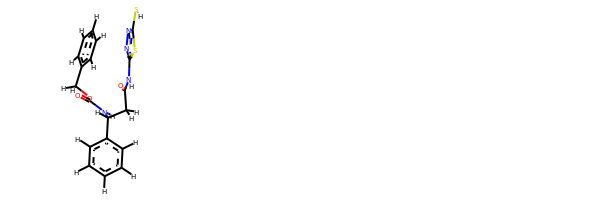

rdkit:  [H]Sc1nnc(N([H])C(=O)C([H])([H])C([H])(c2c([H])c([H])c([H])c([H])c2[H])N([H])C(=O)OC([H])([H])c2c([H])c([H])c([H])c([H])c2[H])s1
oechem:  c1ccc(cc1)COC(=O)NC(CC(=O)Nc2nnc(s2)S)c3ccccc3
###########################################################################
 #########################################################

bond
35.719737332365156 kJ/mol 43721.58653512456 kJ/mol False
angle
65.97362493824942 kJ/mol 70.3696560941403 kJ/mol False
nb
18.4520394099283 kJ/mol 18.4520394099283 kJ/mol True
torsion
37.10678980583874 kJ/mol 37.10682456468407 kJ/mol False
157.2521914863816 kJ/mol 43847.51505519331 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5900


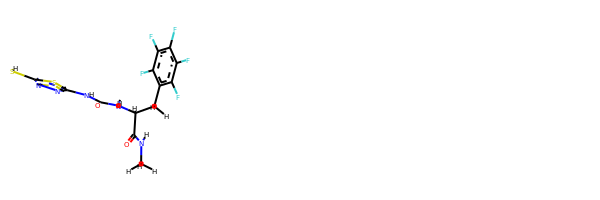

rdkit:  [H]Sc1nnc(N([H])C(=O)N([H])C([H])(C(=O)N([H])C([H])([H])[H])C([H])([H])c2c(F)c(F)c(F)c(F)c2F)s1
oechem:  CNC(=O)C(Cc1c(c(c(c(c1F)F)F)F)F)NC(=O)Nc2nnc(s2)S
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
13.827247373679223 kJ/mol 57766.81078033173 kJ/mol False
angle
93.94375355780974 kJ/mol 95.17704206454206 kJ/mol False
nb
23.876590880023198 kJ/mol 23.876590880023198 kJ/mol True
torsion
28.44543295516089 kJ/mol 25.781943573463618 kJ/mol False
160.09302476667307 kJ/mol 57911.64635684976 kJ/mol

-------------------------------------------------------------------
------------------------------------------------------------

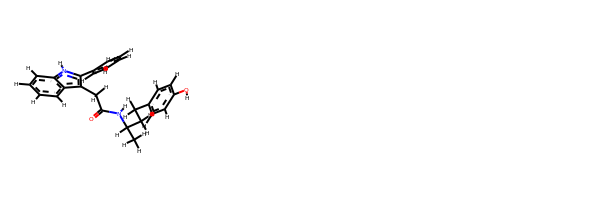

rdkit:  [H]Oc1c([H])c([H])c(C([H])([H])C([H])([H])C([H])(N([H])C(=O)C([H])([H])c2c(-c3c([H])c([H])c([H])c([H])c3[H])n([H])c3c([H])c([H])c([H])c([H])c23)C([H])([H])[H])c([H])c1[H]
oechem:  CC(CCc1ccc(cc1)O)NC(=O)Cc2c3ccccc3[nH]c2c4ccccc4
###########################################################################
 #########################################################

bond
11.670321312739135 kJ/mol 57763.856462516356 kJ/mol False
angle
94.04523522212784 kJ/mol 95.27506762554219 kJ/mol False
nb
9.844010611226087 kJ/mol 9.844010611226087 kJ/mol True
torsion
4.40826022727311 kJ/mol 4.410439222258476 kJ/mol False
119.96782737336616 kJ/mol 57873.385979975385 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5904


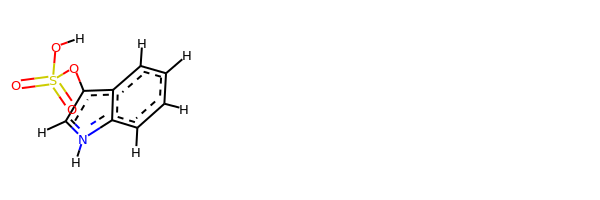

rdkit:  [H]OS(=O)(=O)Oc1c([H])n([H])c2c([H])c([H])c([H])c([H])c12
oechem:  c1ccc2c(c1)c(c[nH]2)OS(=O)(=O)O
###########################################################################
 #########################################################

bond
11.38886848985401 kJ/mol 57765.327441616195 kJ/mol False
angle
89.21102926411623 kJ/mol 90.44056195516083 kJ/mol False
nb
64.77980278036024 kJ/mol 64.77980278036024 kJ/mol True
torsion
5.41220996714263 kJ/mol 5.41232439857397 kJ/mol False
170.79191050147313 kJ/mol 57925.96013075029 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5905


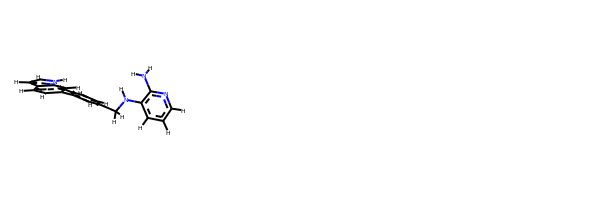

rdkit:  [H]c1nc(N([H])[H])c(N([H])C([H])([H])c2c([H])c([H])c([H])c(-c3c([H])c([H])c4c([H])c([H])n([H])c4c3[H])c2[H])c([H])c1[H]
oechem:  c1cc(cc(c1)c2ccc3cc[nH]c3c2)CNc4cccnc4N
###########################################################################
 #########################################################

bond
20.539516833046136 kJ/mol 57773.53392697655 kJ/mol False
angle
98.52389917658925 kJ/mol 99.75197405161381 kJ/mol False
nb
70.95368048835847 kJ/mol 70.95368048835847 kJ/mol True
torsion
23.72451818750906 kJ/mol 23.7246421185198 kJ/mol False
213.7416146855029 kJ/mol 57967.96422363505 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5906


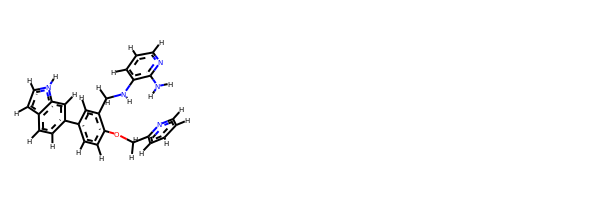

rdkit:  [H]c1nc(C([H])([H])Oc2c([H])c([H])c(-c3c([H])c([H])c4c([H])c([H])n([H])c4c3[H])c([H])c2C([H])([H])N([H])c2c(N([H])[H])nc([H])c([H])c2[H])c([H])c([H])c1[H]
oechem:  c1ccnc(c1)COc2ccc(cc2CNc3cccnc3N)c4ccc5cc[nH]c5c4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #####################

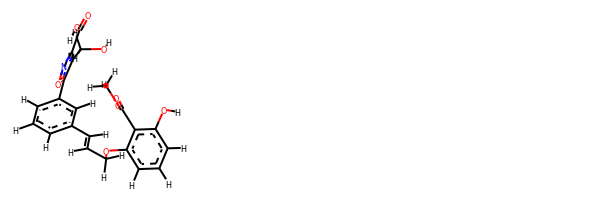

rdkit:  [H]OC(=O)c1noc(-c2c([H])c([H])c([H])c(C([H])=C([H])C([H])([H])Oc3c([H])c([H])c([H])c(O[H])c3C(=O)OC([H])([H])[H])c2[H])c1C([H])([H])O[H]
oechem:  COC(=O)c1c(cccc1OCC=Cc2cccc(c2)c3c(c(no3)C(=O)O)CO)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
22.577187923045 kJ/mol 57691.98462041221 kJ/mol False
angle
95.87739738087197 kJ/mol 95.87739738087197 kJ/mol True
nb
37.76567060761613 kJ/mol 37.76567060761613 kJ/mol True
torsion
37.07294598216719 kJ/mol 24.186782983841663 kJ/mol False
193.29320189370029 kJ/mol 57849.81447138454 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5914


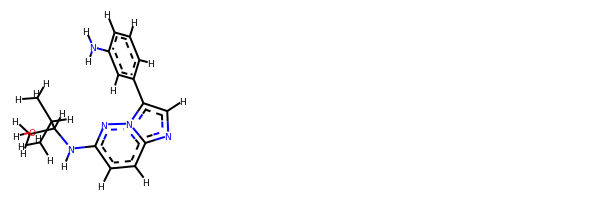

rdkit:  [H]OC([H])([H])C([H])(N([H])c1nn2c(-c3c([H])c([H])c([H])c(N([H])[H])c3[H])c([H])nc2c([H])c1[H])C([H])(C([H])([H])[H])C([H])([H])[H]
oechem:  CC(C)C(CO)Nc1ccc2ncc(n2n1)c3cccc(c3)N
###########################################################################
 #########################################################

bond
27.6029035371133 kJ/mol 57781.28888174779 kJ/mol False
angle
119.67541340992423 kJ/mol 120.90458131964228 kJ/mol False
nb
48.31066367004165 kJ/mol 48.31066367004165 kJ/mol True
torsion
39.91981826109384 kJ/mol 39.91983016299056 kJ/mol False
235.50879887817302 kJ/mol 57990.42395690046 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5915


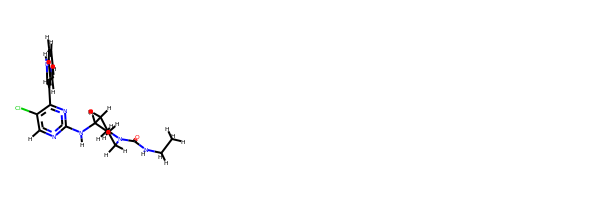

rdkit:  [H]c1nc(N([H])C2([H])C([H])([H])C([H])([H])N(C(=O)N([H])C([H])([H])C([H])([H])[H])C([H])([H])C2([H])[H])nc(-c2c([H])n([H])c3c([H])c([H])c([H])c([H])c23)c1Cl
oechem:  CCNC(=O)N1CCC(CC1)Nc2ncc(c(n2)c3c[nH]c4c3cccc4)Cl
###########################################################################
 #########################################################

bond
17.418969790437114 kJ/mol 56623.676467629375 kJ/mol False
angle
104.70976855278026 kJ/mol 104.70976855278026 kJ/mol True
nb
56.900820938767396 kJ/mol 56.900820938767396 kJ/mol True
torsion
15.681689210881578 kJ/mol 10.451785093503135 kJ/mol False
194.71124849286636 kJ/mol 56795.73884221442 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5916


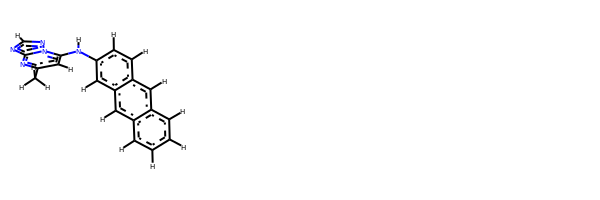

rdkit:  [H]c1nc2nc(C([H])([H])[H])c([H])c(N([H])c3c([H])c([H])c4c([H])c5c([H])c([H])c([H])c([H])c5c([H])c4c3[H])n2n1
oechem:  Cc1cc(n2c(n1)ncn2)Nc3ccc4cc5ccccc5cc4c3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
14.9162581332082 kJ/mol 56618.85307060707 kJ/mol False
angle
108.28752583045775 kJ/mol 108.28752583045775 kJ/mol True
nb
39.19636565786046 kJ/mol 39.19636565786046 kJ/mol True
torsion
15.716451977092436 kJ/mol 10.486533808269423 kJ/mol False
178.11660159861887 kJ/mol 56776.82349590365 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5918


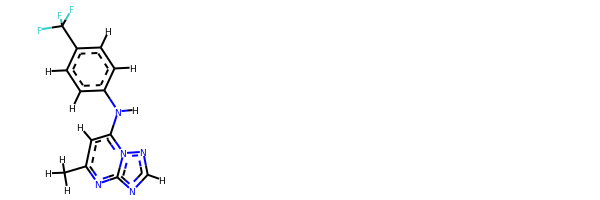

rdkit:  [H]c1nc2nc(C([H])([H])[H])c([H])c(N([H])c3c([H])c([H])c(C(F)(F)F)c([H])c3[H])n2n1
oechem:  Cc1cc(n2c(n1)ncn2)Nc3ccc(cc3)C(F)(F)F
###########################################################################
 #########################################################

bond
44.838609804098894 kJ/mol 57903.600229292824 kJ/mol False
angle
178.38184475518517 kJ/mol 179.77107610210032 kJ/mol False
nb
70.57185207736899 kJ/mol 70.57185207736899 kJ/mol True
torsion
51.2018454196301 kJ/mol 46.109192333982335 kJ/mol False
344.99415205628316 kJ/mol 58200.052349806276 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5919


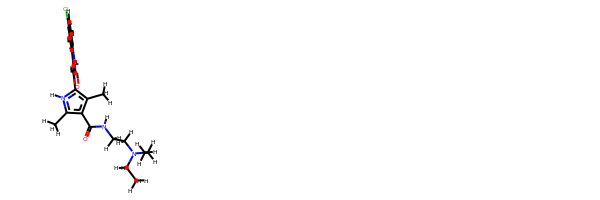

rdkit:  [H]C(=C1C(=O)N([H])c2c([H])c([H])c(Cl)c([H])c21)c1c(C([H])([H])[H])c(C(=O)N([H])C([H])([H])C([H])([H])N(C([H])([H])C([H])([H])[H])C([H])([H])C([H])([H])[H])c(C([H])([H])[H])n1[H]
oechem:  CCN(CC)CCNC(=O)c1c(c([nH]c1C)C=C2c3cc(ccc3NC2=O)Cl)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

#######################################################################

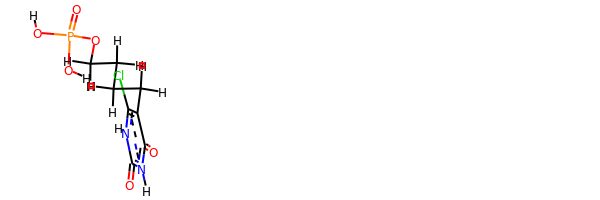

rdkit:  [H]OP(=O)(O[H])OC([H])([H])C([H])([H])C([H])([H])C([H])([H])c1c(Cl)n([H])c(=O)n([H])c1=O
oechem:  C(CCOP(=O)(O)O)Cc1c(=O)[nH]c(=O)[nH]c1Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
24.26345883394167 kJ/mol 58391.141681305045 kJ/mol False
angle
93.36106486622859 kJ/mol 93.36106486622859 kJ/mol True
nb
31.589013667666247 kJ/mol 31.589013667666247 kJ

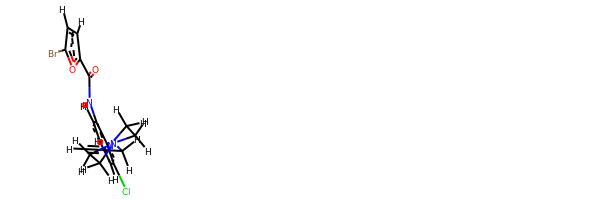

rdkit:  [H]C#CC([H])([H])N1C([H])([H])C([H])([H])N(c2c(Cl)c([H])c([H])c([H])c2N([H])C(=O)c2oc(Br)c([H])c2[H])C([H])([H])C1([H])[H]
oechem:  C#CCN1CCN(CC1)c2c(cccc2Cl)NC(=O)c3ccc(o3)Br
###########################################################################
 #########################################################

bond
16.80777083945414 kJ/mol 43621.36692641724 kJ/mol False
angle
69.51194356296834 kJ/mol 72.6451657847407 kJ/mol False
nb
44.08959822418153 kJ/mol 44.08959822418153 kJ/mol True
torsion
1.8553070989423737 kJ/mol 0.026668064698988553 kJ/mol False
132.26461972554637 kJ/mol 43738.12835849086 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5932


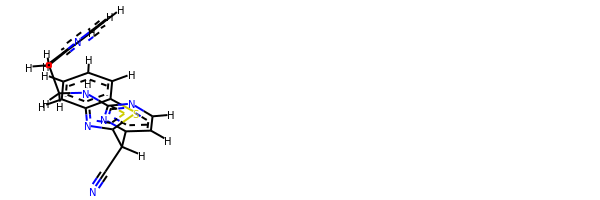

rdkit:  [H]c1nc(N([H])C([H])([H])C([H])([H])c2c([H])nc([H])c([H])c2[H])nc(C([H])(C#N)c2nc3c([H])c([H])c([H])c([H])c3s2)c1[H]
oechem:  c1ccc2c(c1)nc(s2)C(C#N)c3ccnc(n3)NCCc4cccnc4
###########################################################################
 #########################################################

bond
8.849960159622915 kJ/mol 85846.81182379753 kJ/mol False
angle
107.71593250597749 kJ/mol 107.71593250597749 kJ/mol True
nb
72.34089070490066 kJ/mol 72.34089070490066 kJ/mol True
torsion
27.491584045025206 kJ/mol 27.49165599587077 kJ/mol False
216.39836741552628 kJ/mol 86054.36030300427 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5933


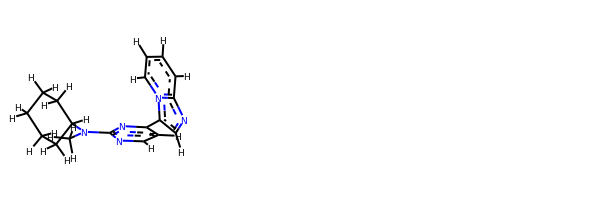

rdkit:  [H]c1nc(N(C([H])([H])[H])C2([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C2([H])[H])nc(-c2c([H])nc3c([H])c([H])c([H])c([H])n23)c1[H]
oechem:  CN(c1nccc(n1)c2cnc3n2cccc3)C4CCCCC4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
15.24405853093195 kJ/mol 85852.40023806278 kJ/mol False
angle
121.17269886990111 kJ/mol 121.17269886990111 kJ/mol True
nb
48.671665266708196 kJ/mol 48.671665266708196 kJ/mol True
torsion
47.67141428704761 kJ/mol 47.67146763837975 kJ/mol False
232.75983695458888 kJ/mol 86069.91606983778 kJ/mol

-------------------------------------------------------------------
-----------------------------------

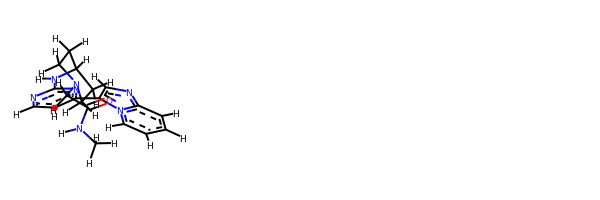

rdkit:  [H]c1nc(N([H])C2([H])C([H])([H])C([H])([H])N(C([H])([H])C(=O)N([H])C([H])([H])[H])C([H])([H])C2([H])[H])nc(-c2c([H])nc3c([H])c([H])c([H])c([H])n23)c1[H]
oechem:  CNC(=O)CN1CCC(CC1)Nc2nccc(n2)c3cnc4n3cccc4
###########################################################################
 #########################################################

bond
33.192431292822214 kJ/mol 58399.18303745023 kJ/mol False
angle
124.13562311666276 kJ/mol 124.13562311666276 kJ/mol True
nb
34.239885303480705 kJ/mol 34.239885303480705 kJ/mol True
torsion
11.259385918925782 kJ/mol 11.259381442338901 kJ/mol False
202.82732563189143 kJ/mol 58568.81792731272 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5937


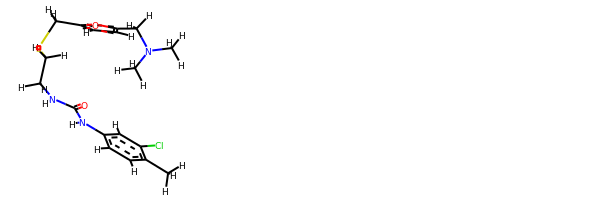

rdkit:  [H]c1c(C([H])([H])SC([H])([H])C([H])([H])N([H])C(=O)N([H])c2c([H])c([H])c(C([H])([H])[H])c(Cl)c2[H])oc(C([H])([H])N(C([H])([H])[H])C([H])([H])[H])c1[H]
oechem:  Cc1ccc(cc1Cl)NC(=O)NCCSCc2ccc(o2)CN(C)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
32.95169371856369 kJ/mol 57519.11886056663 kJ/mol False
angle
120.30156678899155 kJ/mol 120.30156678899155 kJ/mol True
nb
81.75620567316095 kJ/mol 81.75620567316095 kJ/mol True
torsion
78.92436204861042 kJ/mol 79.83907663642952 kJ/mol False
3

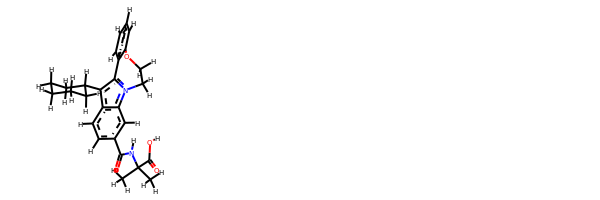

rdkit:  [H]OC(=O)C(N([H])C(=O)c1c([H])c([H])c2c(C3([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C3([H])[H])c3n(c2c1[H])C([H])([H])C([H])([H])Oc1c([H])c([H])c([H])c([H])c1-3)(C([H])([H])[H])C([H])([H])[H]
oechem:  CC(C)(C(=O)O)NC(=O)c1ccc2c(c1)n3c(c2C4CCCCC4)-c5ccccc5OCC3
###########################################################################
 #########################################################

bond
52.28834526568765 kJ/mol 87815.63513295955 kJ/mol False
angle
95.39861833392825 kJ/mol 99.75522610414103 kJ/mol False
nb
21.479964681593547 kJ/mol 21.479964681593547 kJ/mol True
torsion
41.936966514842034 kJ/mol 19.3353510046125 kJ/mol False
211.1038947960515 kJ/mol 87956.2056747499 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5942


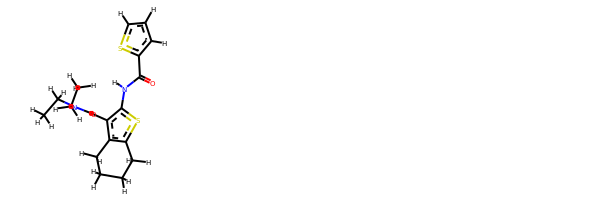

rdkit:  [H]c1sc(C(=O)N([H])c2sc3c(c2C(=O)N(C([H])([H])C([H])([H])[H])C([H])([H])C([H])([H])[H])C([H])([H])C([H])([H])C([H])([H])C3([H])[H])c([H])c1[H]
oechem:  CCN(CC)C(=O)c1c2c(sc1NC(=O)c3cccs3)CCCC2
###########################################################################
 #########################################################

bond
52.96622711879818 kJ/mol 87815.2682746148 kJ/mol False
angle
95.83483745748644 kJ/mol 100.18862637904122 kJ/mol False
nb
23.225636314498693 kJ/mol 23.225636314498693 kJ/mol True
torsion
43.495521381801666 kJ/mol 20.800398189527915 kJ/mol False
215.522222272585 kJ/mol 87959.48293549787 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5943


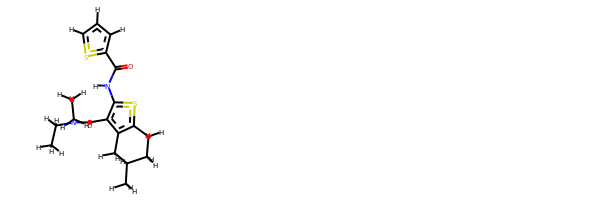

rdkit:  [H]c1sc(C(=O)N([H])c2sc3c(c2C(=O)N(C([H])([H])C([H])([H])[H])C([H])([H])C([H])([H])[H])C([H])([H])C([H])(C([H])([H])[H])C([H])([H])C3([H])[H])c([H])c1[H]
oechem:  CCN(CC)C(=O)c1c2c(sc1NC(=O)c3cccs3)CCC(C2)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
17.99616379176238 kJ/mol 29102.338239735345 kJ/mol False
angle
124.10337949551739 kJ/mol 124.10337949551739 kJ/mol True
nb
56.25538859165464 kJ/mol 56.25538859165464 kJ/mol True
torsion
5.537446407707078 kJ/mol 0.3078177570625218 kJ/mol False
203.8923782866415 kJ/mol 29283.00482557958 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5

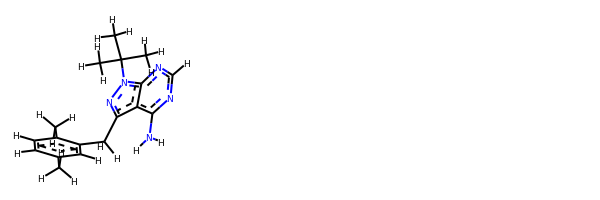

rdkit:  [H]c1nc(N([H])[H])c2c(C([H])([H])c3c([H])c(C([H])([H])[H])c([H])c([H])c3C([H])([H])[H])nn(C(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H])c2n1
oechem:  Cc1ccc(c(c1)Cc2c3c(ncnc3n(n2)C(C)(C)C)N)C
###########################################################################
 #########################################################

bond
23.153571750939243 kJ/mol 115821.45307823614 kJ/mol False
angle
487.1434366810137 kJ/mol 496.52660144014266 kJ/mol False
nb
24.301621270160414 kJ/mol 24.301621270160414 kJ/mol True
torsion
6.694597036644216 kJ/mol 6.694663839796753 kJ/mol False
541.2932267387577 kJ/mol 116348.97596478624 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5946


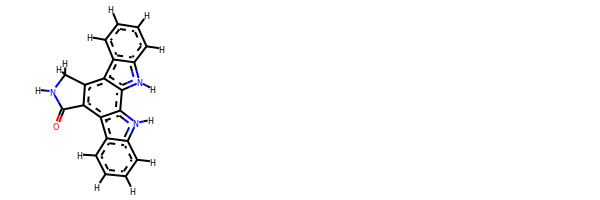

rdkit:  [H]c1c([H])c([H])c2c(c1[H])c1c3c(c4c5c([H])c([H])c([H])c([H])c5n([H])c4c1n2[H])C([H])([H])N([H])C3=O
oechem:  c1ccc2c(c1)c3c4c(c5c6ccccc6[nH]c5c3[nH]2)C(=O)NC4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
31.47292976722651 kJ/mol 57914.599353653866 kJ/mol False
angle
192.8379574259063 kJ/mol 194.37139951803292 kJ/mol False
nb
14.724275511478785 kJ/mol 14.724275511478785 kJ/mol True
torsion
104.89959677157721 kJ/mol 103.6764685906308 kJ/mol False
343.9347594761888 kJ/mol 58227.371497274005 kJ/mol

-------------------------------------------------------------------
------------------------------------------------------

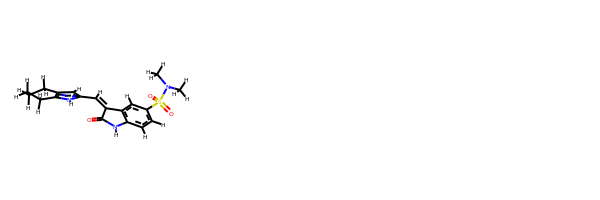

rdkit:  [H]C(=C1C(=O)N([H])c2c([H])c([H])c(S(=O)(=O)N(C([H])([H])[H])C([H])([H])[H])c([H])c21)c1c([H])c2c(n1[H])C([H])([H])C([H])([H])C([H])([H])C2([H])[H]
oechem:  CN(C)S(=O)(=O)c1ccc2c(c1)C(=Cc3cc4c([nH]3)CCCC4)C(=O)N2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
41.411454103308934 kJ/mol 29001.69085779649 kJ/mol False
angle
136.52327064769545 kJ/mol 138.09281998450797 kJ/mol False
nb
53.46869250036986 kJ/mol 53.46869250036986 kJ/mol True
torsion
84.44513853068896 kJ/mol 79.21523559037492 kJ/mol False
315.8485557820632 kJ/mol 29272.46760587174 kJ/mol

-------------------------------------------------------------------
----

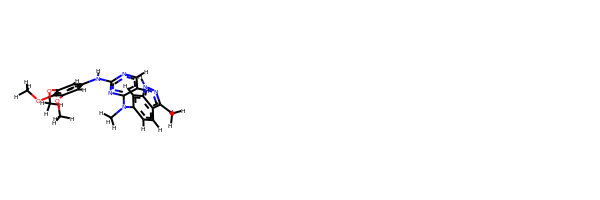

rdkit:  [H]c1nc(N([H])c2c([H])c(OC([H])([H])[H])c(OC([H])([H])[H])c(OC([H])([H])[H])c2[H])nc(N(c2c([H])c([H])c3c(C([H])([H])[H])nn([H])c3c2[H])C([H])([H])[H])c1[H]
oechem:  Cc1c2ccc(cc2[nH]n1)N(C)c3ccnc(n3)Nc4cc(c(c(c4)OC)OC)OC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
29.582721223220556 kJ/mol 58378.18337376258 kJ/mol False
angle
122.17102117584719 kJ/mol 122.17102117584719 kJ/mol True
nb
39.74722172462813 kJ/mol 39.74722172462813 kJ/mol True
torsion
53.506479149822475 kJ/mol 43.04700519350056 kJ/mol False
245.00744327351833 kJ/mol 58583.14862185655 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
----------------------------------------------------------------

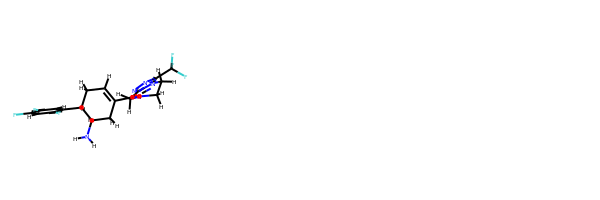

rdkit:  [H]C1=C(C(=O)N2C([H])([H])c3nnc(C(F)(F)F)n3C([H])([H])C2([H])[H])C([H])([H])C([H])(N([H])[H])C([H])(c2c([H])c(F)c(F)c([H])c2F)C1([H])[H]
oechem:  c1c(c(cc(c1F)F)F)C2CC=C(CC2N)C(=O)N3CCn4c(nnc4C(F)(F)F)C3
###########################################################################
 #########################################################

bond
19.59994958542413 kJ/mol 29088.813178584383 kJ/mol False
angle
115.58354512905925 kJ/mol 117.3406696566281 kJ/mol False
nb
30.537054993078684 kJ/mol 30.537054993078684 kJ/mol True
torsion
60.08624230581963 kJ/mol 54.856245361805556 kJ/mol False
225.8067920133817 kJ/mol 29291.547148595895 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5955


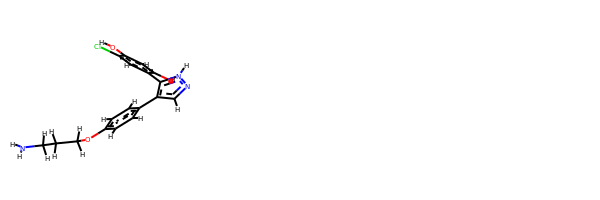

rdkit:  [H]Oc1c([H])c(O[H])c(-c2c(-c3c([H])c([H])c(OC([H])([H])C([H])([H])C([H])([H])N([H])[H])c([H])c3[H])c([H])nn2[H])c([H])c1Cl
oechem:  c1cc(ccc1c2cn[nH]c2c3cc(c(cc3O)O)Cl)OCCCN
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
10.601797367163869 kJ/mol 28970.970241006788 kJ/mol False
angle
99.57467997741568 kJ/mol 99.57467997741568 kJ/mol True
nb
77.87055803971802 kJ/mol 77.87055803971802 kJ/mol True
torsion
11.88692240895048 kJ/mol 15.750531268550931 kJ/mol False
199.93395779324806 kJ/mol 29164.166010292472 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5957


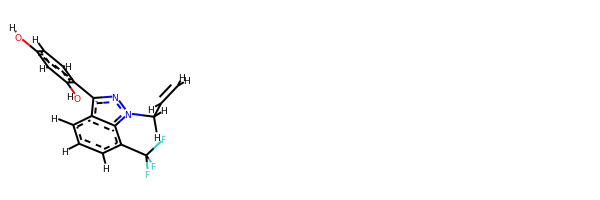

rdkit:  [H]Oc1c([H])c([H])c(-c2nn(C([H])([H])C([H])=C([H])[H])c3c(C(F)(F)F)c([H])c([H])c([H])c23)c(O[H])c1[H]
oechem:  C=CCn1c2c(cccc2C(F)(F)F)c(n1)c3ccc(cc3O)O
###########################################################################
 #########################################################

bond
7.577667668721184 kJ/mol 28969.239402738225 kJ/mol False
angle
88.4866164082544 kJ/mol 90.05624314664774 kJ/mol False
nb
23.236376744671322 kJ/mol 23.236376744671322 kJ/mol True
torsion
11.500148875817786 kJ/mol 15.673322015782965 kJ/mol False
130.8008096974647 kJ/mol 29098.205344645325 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5958


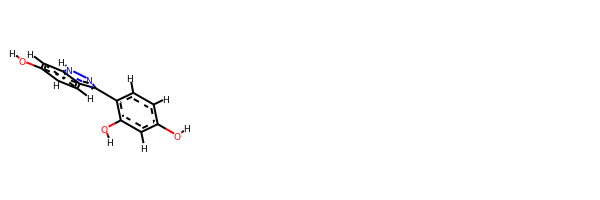

rdkit:  [H]Oc1c([H])c([H])c(-c2nn([H])c3c([H])c(O[H])c([H])c([H])c23)c(O[H])c1[H]
oechem:  c1cc2c(cc1O)[nH]nc2c3ccc(cc3O)O
###########################################################################
 #########################################################

bond
20.12517210710604 kJ/mol 56733.75440547002 kJ/mol False
angle
14.63776597359591 kJ/mol 14.63776597359591 kJ/mol True
nb
35.65342895685295 kJ/mol 35.65342895685295 kJ/mol True
torsion
20.921226422423146 kJ/mol 20.921400916314628 kJ/mol False
91.33759345997805 kJ/mol 56804.96700131678 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5959


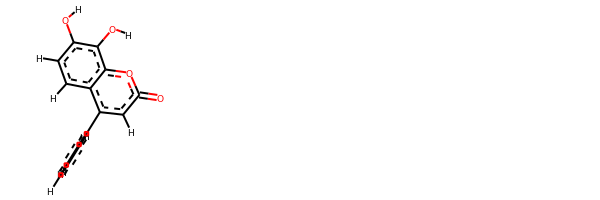

rdkit:  [H]Oc1c([H])c([H])c2c(-c3c([H])c([H])c([H])c([H])c3[H])c([H])c(=O)oc2c1O[H]
oechem:  c1ccc(cc1)c2cc(=O)oc3c2ccc(c3O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
18.200827722152937 kJ/mol 86959.70806098817 kJ/mol False
angle
558.2249000824027 kJ/mol 559.6059047286063 kJ/mol False
nb
27.31110125596817 kJ/mol 27.31110125596817 kJ/mol True
torsion
47.20945648940411 kJ/mol 54.531663557289555 kJ/mol False
650.9462855499279 kJ/mol 87601.15673053004 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
--------------------------------

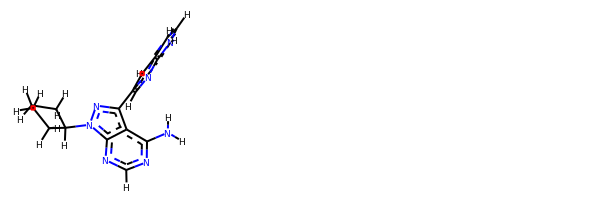

rdkit:  [H]c1nc(N([H])[H])c2c(-c3c([H])nc4c(c3[H])c([H])c([H])n4[H])nn(C3([H])C([H])([H])C([H])([H])C([H])([H])C3([H])[H])c2n1
oechem:  c1c[nH]c2c1cc(cn2)c3c4c(ncnc4n(n3)C5CCCC5)N
###########################################################################
 #########################################################

bond
54.960626322718646 kJ/mol 29137.024679094236 kJ/mol False
angle
275.4233160638035 kJ/mol 275.4233160638035 kJ/mol True
nb
46.995029265533994 kJ/mol 46.995029265533994 kJ/mol True
torsion
59.369991416461176 kJ/mol 66.69204076863382 kJ/mol False
436.74896306851736 kJ/mol 29526.135065192208 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5963


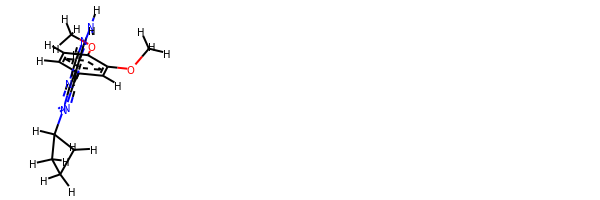

rdkit:  [H]c1nc(N([H])[H])c2c(-c3c([H])c([H])c(OC([H])([H])[H])c(OC([H])([H])[H])c3[H])nn(C3([H])C([H])([H])C([H])([H])C3([H])[H])c2n1
oechem:  COc1ccc(cc1OC)c2c3c(ncnc3n(n2)C4CCC4)N
###########################################################################
 #########################################################

bond
14.95202179215473 kJ/mol 29099.103595919933 kJ/mol False
angle
120.73248170509076 kJ/mol 120.73248170509076 kJ/mol True
nb
44.01167622385134 kJ/mol 44.01167622385134 kJ/mol True
torsion
13.876985601018893 kJ/mol 21.199094278075062 kJ/mol False
193.57316532211573 kJ/mol 29285.04684812695 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5964


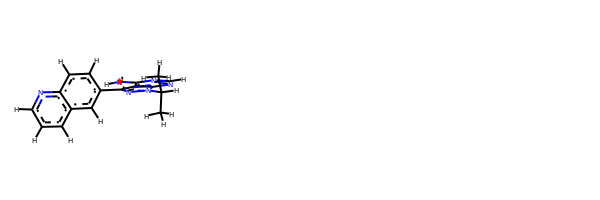

rdkit:  [H]c1nc(N([H])[H])c2c(-c3c([H])c([H])c4nc([H])c([H])c([H])c4c3[H])nn(C([H])(C([H])([H])[H])C([H])([H])[H])c2n1
oechem:  CC(C)n1c2c(c(n1)c3ccc4c(c3)cccn4)c(ncn2)N
###########################################################################
 #########################################################

bond
6.09104462832863 kJ/mol 86207.41445720075 kJ/mol False
angle
103.41122733899229 kJ/mol 103.41122733899229 kJ/mol True
nb
41.677212045576354 kJ/mol 41.677212045576354 kJ/mol True
torsion
36.403987862478886 kJ/mol 31.41315575011148 kJ/mol False
187.58347187537618 kJ/mol 86383.91605233542 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5965


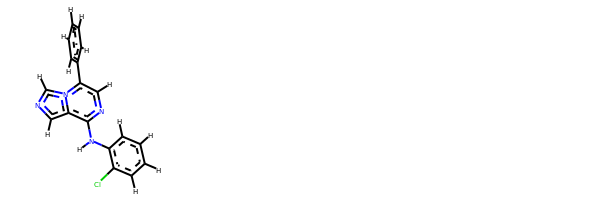

rdkit:  [H]c1nc(N([H])c2c([H])c([H])c([H])c([H])c2Cl)c2c([H])nc([H])n2c1-c1c([H])c([H])c([H])c([H])c1[H]
oechem:  c1ccc(cc1)c2cnc(c3n2cnc3)Nc4ccccc4Cl
###########################################################################
 #########################################################

bond
7.024067152358633 kJ/mol 86208.34747972479 kJ/mol False
angle
104.59459932615133 kJ/mol 104.59459932615133 kJ/mol True
nb
44.803800326895164 kJ/mol 44.803800326895164 kJ/mol True
torsion
41.86640184066135 kJ/mol 41.89320012118913 kJ/mol False
198.28886864606648 kJ/mol 86399.63907949903 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5966


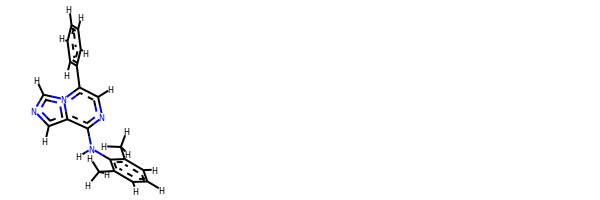

rdkit:  [H]c1nc(N([H])c2c(C([H])([H])[H])c([H])c([H])c([H])c2C([H])([H])[H])c2c([H])nc([H])n2c1-c1c([H])c([H])c([H])c([H])c1[H]
oechem:  Cc1cccc(c1Nc2c3cncn3c(cn2)c4ccccc4)C
###########################################################################
 #########################################################

bond
9.637093363479773 kJ/mol 86188.67501343583 kJ/mol False
angle
101.93859567894468 kJ/mol 101.93859567894468 kJ/mol True
nb
64.3328668795103 kJ/mol 64.3328668795103 kJ/mol True
torsion
34.93182784504875 kJ/mol 34.931835768104314 kJ/mol False
210.8403837669835 kJ/mol 86389.8783117624 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5967


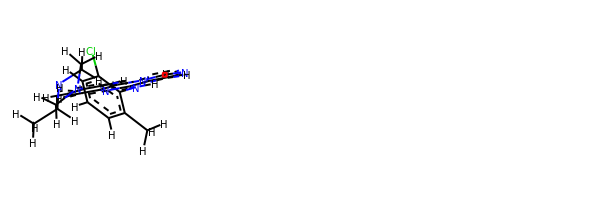

rdkit:  [H]c1c([H])c(Cl)c(N([H])c2nc3c([H])c([H])c(N4C([H])([H])C([H])([H])N([H])C([H])(C([H])([H])[H])C4([H])[H])c([H])c3n3c([H])nc([H])c23)c(C([H])([H])[H])c1[H]
oechem:  Cc1cccc(c1Nc2c3cncn3c4cc(ccc4n2)N5CCNC(C5)C)Cl
###########################################################################
 #########################################################

bond
22.08716648009912 kJ/mol 28798.83347449021 kJ/mol False
angle
31.850718325587273 kJ/mol 32.26990739957559 kJ/mol False
nb
53.76005650877694 kJ/mol 53.76005650877694 kJ/mol True
torsion
53.300497164225774 kJ/mol 31.334735818777176 kJ/mol False
160.9984384786891 kJ/mol 28916.19817421734 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5968


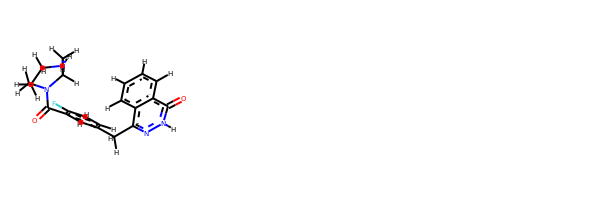

rdkit:  [H]c1c([H])c(C([H])([H])c2nn([H])c(=O)c3c([H])c([H])c([H])c([H])c23)c([H])c(C(=O)N2C([H])([H])C([H])([H])N([H])C([H])([H])C([H])([H])C2([H])[H])c1F
oechem:  c1ccc2c(c1)c(n[nH]c2=O)Cc3ccc(c(c3)C(=O)N4CCCNCC4)F
###########################################################################
 #########################################################

bond
73.03297466728677 kJ/mol 58019.46996330306 kJ/mol False
angle
427.4934537768942 kJ/mol 427.4934537768942 kJ/mol True
nb
34.63190231570333 kJ/mol 34.63190231570333 kJ/mol True
torsion
95.87348301821538 kJ/mol 88.71854372239864 kJ/mol False
631.0318137780997 kJ/mol 58570.313863118055 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5969


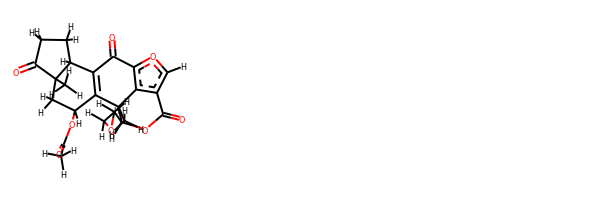

rdkit:  [H]c1oc2c3c1C(=O)OC([H])(C([H])([H])OC([H])([H])[H])C3(C([H])([H])[H])C1=C(C2=O)C2([H])C([H])([H])C([H])([H])C(=O)C2(C([H])([H])[H])C([H])([H])C1([H])OC(=O)C([H])([H])[H]
oechem:  CC(=O)OC1CC2(C(CCC2=O)C3=C1C4(c5c(coc5C3=O)C(=O)OC4COC)C)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
11.04897238421335 kJ/mol 29079.40130393239 kJ/mol False
angle
91.00929051829694 kJ/mol 92.71762720238048 kJ/mol False
nb
22.50136631524016 kJ/mol 22.50136631524016 kJ/mol True
torsion
18.32256145492375 kJ/mol 15.433364396468212 kJ/mol False
142.88219067267417 kJ/mol 29210.053661846476 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
----------------------------------------------

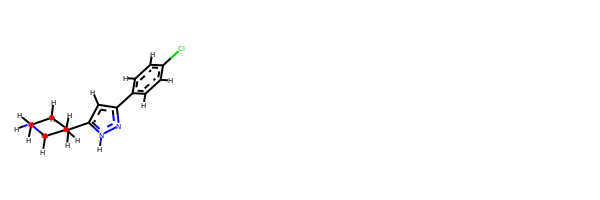

rdkit:  [H]c1c([H])c(-c2nn([H])c(C3([H])C([H])([H])C([H])([H])N([H])C([H])([H])C3([H])[H])c2[H])c([H])c([H])c1Cl
oechem:  c1cc(ccc1c2cc([nH]n2)C3CCNCC3)Cl
###########################################################################
 #########################################################

bond
7.207796088274257 kJ/mol 58245.8715827893 kJ/mol False
angle
75.32653410797201 kJ/mol 77.96369965049666 kJ/mol False
nb
14.275939722737922 kJ/mol 14.275939722737922 kJ/mol True
torsion
2.0951229915080356 kJ/mol 5.236683604481124 kJ/mol False
98.90539291049221 kJ/mol 58343.34790576702 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5972


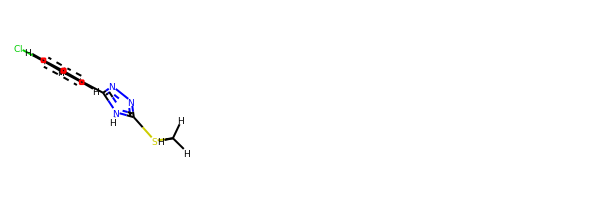

rdkit:  [H]c1c([H])c(-c2nnc(SC([H])([H])[H])n2[H])c([H])c([H])c1Cl
oechem:  CSc1[nH]c(nn1)c2ccc(cc2)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
55.763990988739366 kJ/mol 29124.39166098322 kJ/mol False
angle
134.0511114771425 kJ/mol 135.6960527698894 kJ/mol False
nb
83.59079692177434 kJ/mol 83.59079692177434 kJ/mol True
torsion
5.358348731161325 kJ/mol 0.12838942576595008 kJ/mol False
278.76424811881753 kJ/mol 29343.806900100648 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5974


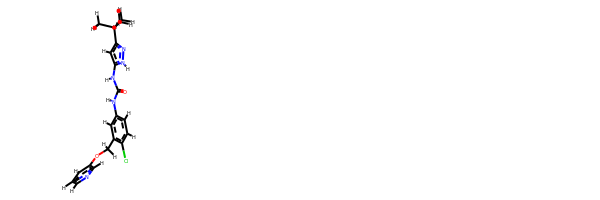

rdkit:  [H]c1nc([H])c(OC([H])([H])c2c([H])c(N([H])C(=O)N([H])c3c([H])c(C(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H])nn3[H])c([H])c([H])c2Cl)c([H])c1[H]
oechem:  CC(C)(C)c1cc([nH]n1)NC(=O)Nc2ccc(c(c2)COc3cccnc3)Cl
###########################################################################
 #########################################################

bond
10.61057294062269 kJ/mol 86996.04530716504 kJ/mol False
angle
162.02552409635638 kJ/mol 165.5715821450228 kJ/mol False
nb
9.55984567866784 kJ/mol 9.55984567866784 kJ/mol True
torsion
5.230390013050455 kJ/mol 0.0008739270967658029 kJ/mol False
187.42633272869736 kJ/mol 87171.17760891584 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5975


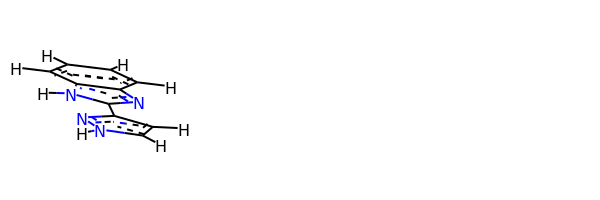

rdkit:  [H]c1c([H])c([H])c2c(nc(-c3nn([H])c([H])c3[H])n2[H])c1[H]
oechem:  c1ccc2c(c1)[nH]c(n2)c3cc[nH]n3
###########################################################################
 #########################################################

bond
29.20040641751917 kJ/mol 87012.29434164095 kJ/mol False
angle
175.9851110515372 kJ/mol 179.54235423733292 kJ/mol False
nb
29.90769663237313 kJ/mol 29.90769663237313 kJ/mol True
torsion
7.079295525807278 kJ/mol 1.8493089847577586 kJ/mol False
242.17250962723676 kJ/mol 87223.59370149543 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5976


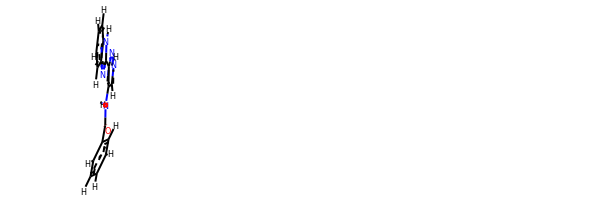

rdkit:  [H]c1c([H])c([H])c(C(=O)N([H])c2c(-c3nc4c([H])c([H])c([H])c([H])c4n3[H])nn([H])c2[H])c([H])c1[H]
oechem:  c1ccc(cc1)C(=O)Nc2c[nH]nc2c3[nH]c4ccccc4n3
###########################################################################
 #########################################################

bond
55.44200239444938 kJ/mol 87038.7299007397 kJ/mol False
angle
197.42283910389506 kJ/mol 200.98401851470166 kJ/mol False
nb
10.738372892225524 kJ/mol 10.738372892225524 kJ/mol True
torsion
157.7075896268318 kJ/mol 152.4776915840228 kJ/mol False
421.3108040174018 kJ/mol 87402.92998373065 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5977


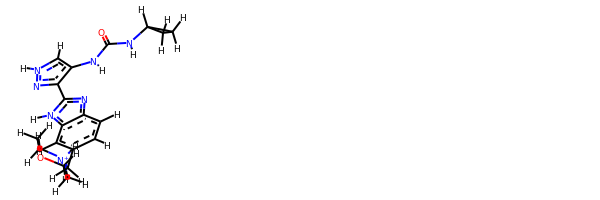

rdkit:  [H]c1c(C([H])([H])[N+]2([H])C([H])([H])C([H])([H])OC([H])([H])C2([H])[H])c([H])c2c(nc(-c3nn([H])c([H])c3N([H])C(=O)N([H])C3([H])C([H])([H])C3([H])[H])n2[H])c1[H]
oechem:  c1cc2c(cc1C[NH+]3CCOCC3)[nH]c(n2)c4c(c[nH]n4)NC(=O)NC5CC5
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
11.34602447491189 kJ/mol 86263.6611153978 kJ/mol False
angle
89.50543750170254 kJ/mol 91.49836417945012 kJ/mol False
nb
16.599140219535396 kJ/mol 16.599140219535396 kJ/mol True
torsion
12.116058630805245 kJ/mol 17.422318389776827 kJ/mol False
129.56666082695506 kJ/mol 86389.18093818656 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------

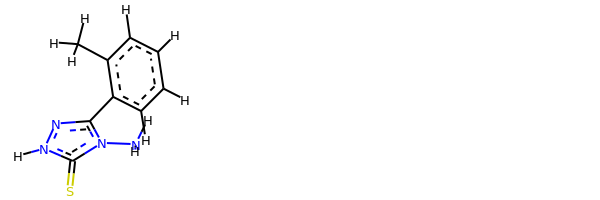

rdkit:  [H]c1c([H])c([H])c(C([H])([H])[H])c(-c2nn([H])c(=S)n2N([H])[H])c1[H]
oechem:  Cc1ccccc1c2n[nH]c(=S)n2N
###########################################################################
 #########################################################

bond
14.067631231974273 kJ/mol 29084.11674430017 kJ/mol False
angle
116.43808959952956 kJ/mol 118.09430332430821 kJ/mol False
nb
9.322776169489138 kJ/mol 9.322776169489138 kJ/mol True
torsion
25.92724045126921 kJ/mol 20.69724556760386 kJ/mol False
165.75573745226217 kJ/mol 29232.231069361573 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5980


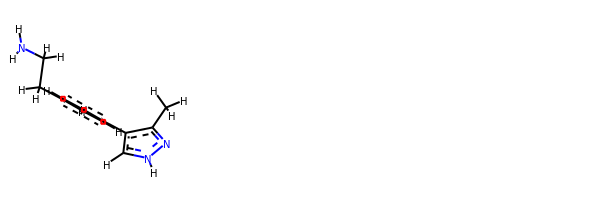

rdkit:  [H]c1c([H])c(C([H])([H])C([H])([H])N([H])[H])c([H])c([H])c1-c1c(C([H])([H])[H])nn([H])c1[H]
oechem:  Cc1c(c[nH]n1)c2ccc(cc2)CCN
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
26.59147152013986 kJ/mol 86742.28320190772 kJ/mol False
angle
200.97499198205156 kJ/mol 203.78549517341037 kJ/mol False
nb
44.71389301188412 kJ/mol 44.71389301188412 kJ/mol True
torsion
30.773473234949165 kJ/mol 25.543849291075666 kJ/mol False
303.0538297490247 kJ/mol 87016.32643938408 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
--------------------

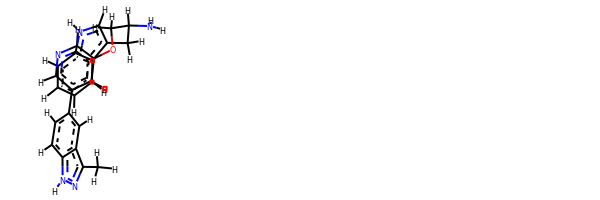

rdkit:  [H]c1nc([H])c(-c2c([H])c([H])c3c(c(C([H])([H])[H])nn3[H])c2[H])c([H])c1OC([H])([H])C([H])(N([H])[H])C([H])([H])c1c([H])n([H])c2c([H])c([H])c([H])c([H])c12
oechem:  Cc1c2cc(ccc2[nH]n1)c3cc(cnc3)OCC(Cc4c[nH]c5c4cccc5)N
###########################################################################
 #########################################################

bond
6.281216199609829 kJ/mol 57426.6915269954 kJ/mol False
angle
107.19514405120698 kJ/mol 107.19514405120698 kJ/mol True
nb
23.249683506091127 kJ/mol 23.249683506091127 kJ/mol True
torsion
35.54933569986888 kJ/mol 16.378999923962223 kJ/mol False
172.27537945677682 kJ/mol 57573.51535447665 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5984


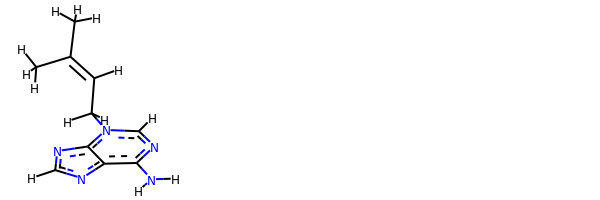

rdkit:  [H]C(=C(C([H])([H])[H])C([H])([H])[H])C([H])([H])n1c([H])nc(N([H])[H])c2nc([H])nc1-2
oechem:  CC(=CCn1cnc(c-2ncnc12)N)C
###########################################################################
 #########################################################

bond
10.549275431259455 kJ/mol 43683.70268594882 kJ/mol False
angle
53.71777192171906 kJ/mol 57.073319595179555 kJ/mol False
nb
28.653361243589252 kJ/mol 28.653361243589252 kJ/mol True
torsion
17.151329936116802 kJ/mol 0.32221458343455756 kJ/mol False
110.07173853268458 kJ/mol 43769.75158137102 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5985


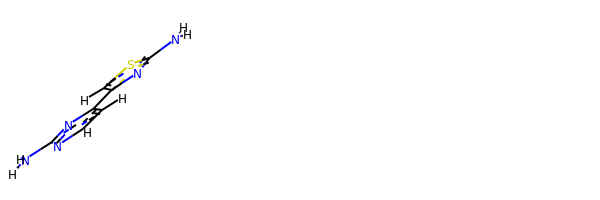

rdkit:  [H]c1nc(N([H])[H])nc(-c2nc(N([H])[H])sc2[H])c1[H]
oechem:  c1cnc(nc1c2csc(n2)N)N
###########################################################################
 #########################################################

bond
11.290474126289821 kJ/mol 58031.91050864103 kJ/mol False
angle
106.09368777537009 kJ/mol 106.09368777537009 kJ/mol True
nb
48.046652627846896 kJ/mol 48.046652627846896 kJ/mol True
torsion
7.492919597646071 kJ/mol 0.1678703593423784 kJ/mol False
172.92373412715287 kJ/mol 58186.21871940359 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_5986


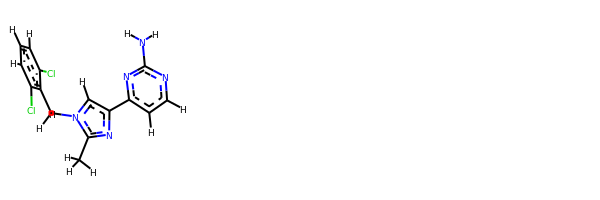

rdkit:  [H]c1nc(N([H])[H])nc(-c2nc(C([H])([H])[H])n(C([H])([H])c3c(Cl)c([H])c([H])c([H])c3Cl)c2[H])c1[H]
oechem:  Cc1nc(cn1Cc2c(cccc2Cl)Cl)c3ccnc(n3)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
33.531383106860105 kJ/mol 57940.09837852673 kJ/mol False
angle
93.475704366851 kJ/mol 93.475704366851 kJ/mol True
nb
80.44030701027505 kJ/mol 80.44030701027505 kJ/mol True
torsion
25.081369724381727 kJ/mol 23.082822510281616 kJ/mol False
232.52876420836787 kJ/mol 58137.09721241414 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
----------

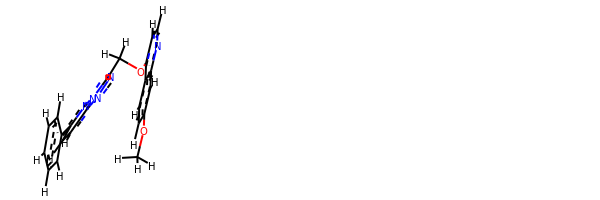

rdkit:  [H]c1nc2c([H])c(OC([H])([H])[H])c([H])c([H])c2c(OC([H])([H])c2nnc3c([H])c([H])c(-c4c([H])c([H])c([H])c([H])c4[H])nn23)c1[H]
oechem:  COc1ccc2c(ccnc2c1)OCc3nnc4n3nc(cc4)c5ccccc5
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
8.418054111957378 kJ/mol 101593.9963189719 kJ/mol False
angle
134.7100626403566 kJ/mol 139.9727870071504 kJ/mol False
nb
9.432576629811255 kJ/mol 9.432576629811255 kJ/mol True
torsion
68.81896262515755 kJ/mol 68.81900021890436 kJ/mol False
221.3796560072828 kJ/mol 1

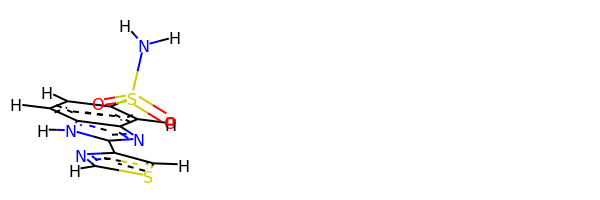

rdkit:  [H]c1nc(-c2nc3c([H])c(S(=O)(=O)N([H])[H])c([H])c([H])c3n2[H])c([H])s1
oechem:  c1cc2c(cc1S(=O)(=O)N)nc([nH]2)c3cscn3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
13.019064057095761 kJ/mol 58032.78588567513 kJ/mol False
angle
131.35349915728668 kJ/mol 131.35349915728668 kJ/mol True
nb
24.928611152673902 kJ/mol 24.928611152673902 kJ/mol True
torsion
37.86264324076082 kJ/mol 35.117664640760204 kJ/mol False
207.16381760781718 kJ/mol 58224.18566062586 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-----------------------------

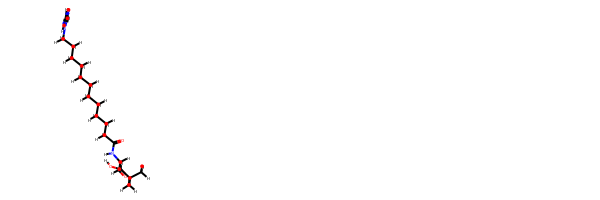

rdkit:  [H]OC(=O)C([H])(N([H])C(=O)C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])n1c([H])nc([H])c1[H])C([H])([H])C([H])(C([H])([H])[H])C([H])([H])[H]
oechem:  CC(C)CC(C(=O)O)NC(=O)CCCCCCCCCCCn1ccnc1
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
26.07393209695482 kJ/mol 57010.32448906876 kJ/mol False
angle
12.537131487298035 kJ/mol 12.688588087787197 kJ/mol False
nb
371.49601061915956 kJ/mol 371.49601061915956 kJ/mol True
torsion
42.08116746476142 kJ/mol 25.345608590796875 kJ/mol False
452.1882416681739 kJ/mol 57419.8546963665 kJ/mol

------------------

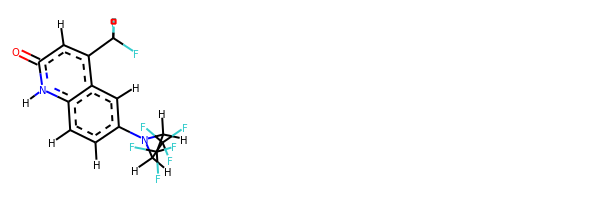

rdkit:  [H]c1c(N(C([H])([H])C(F)(F)F)C([H])([H])C(F)(F)F)c([H])c2c(C(F)(F)F)c([H])c(=O)n([H])c2c1[H]
oechem:  c1cc2c(cc1N(CC(F)(F)F)CC(F)(F)F)c(cc(=O)[nH]2)C(F)(F)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
32.99904113438679 kJ/mol 57784.72846604541 kJ/mol False
angle
107.392542252236 kJ/mol 108.62242647343636 kJ/mol False
nb
88.83076127242148 kJ/mol 88.83076127242148 kJ/mol True
torsion
19.35405889568359 kJ/mol 19.35424559230405 kJ/mol False
248.57640355472785 kJ/mol 58001.53589938357 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6001


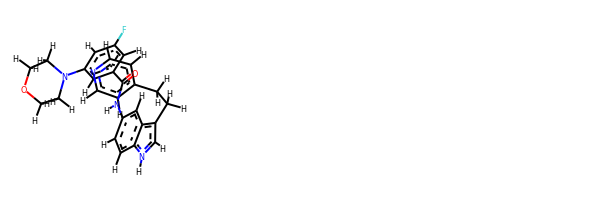

rdkit:  [H]c1nc([H])c([H])c(C([H])([H])C([H])([H])c2c([H])n([H])c3c([H])c([H])c(N([H])C(=O)c4c([H])c(F)c([H])c(N5C([H])([H])C([H])([H])OC([H])([H])C5([H])[H])c4[H])c([H])c23)c1[H]
oechem:  c1cc2c(cc1NC(=O)c3cc(cc(c3)F)N4CCOCC4)c(c[nH]2)CCc5ccncc5
###########################################################################
 #########################################################

bond
27.93787676032432 kJ/mol 57779.923980674204 kJ/mol False
angle
93.92735428881818 kJ/mol 95.15645528431668 kJ/mol False
nb
83.18851688551787 kJ/mol 83.18851688551787 kJ/mol True
torsion
19.12736542832199 kJ/mol 19.127657813695723 kJ/mol False
224.18111336298233 kJ/mol 57977.396610657735 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6002


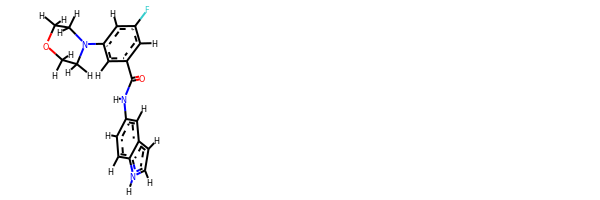

rdkit:  [H]c1c(F)c([H])c(N2C([H])([H])C([H])([H])OC([H])([H])C2([H])[H])c([H])c1C(=O)N([H])c1c([H])c([H])c2c(c1[H])c([H])c([H])n2[H]
oechem:  c1cc2c(cc[nH]2)cc1NC(=O)c3cc(cc(c3)F)N4CCOCC4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
20.805181710142502 kJ/mol 58004.53971564065 kJ/mol False
angle
155.04923993997653 kJ/mol 155.04923993997653 kJ/mol True
nb
65.49253137852908 kJ/mol 65.49253137852908 kJ/mol True
torsion
15.00135981650356 kJ/mol 10.490422805099145 kJ/mol False
256.34831284515167 k

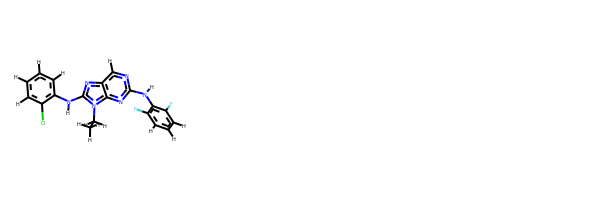

rdkit:  [H]c1c([H])c(F)c(N([H])c2nc([H])c3nc(N([H])c4c([H])c([H])c([H])c([H])c4Cl)n(C([H])([H])C([H])([H])[H])c3n2)c(F)c1[H]
oechem:  CCn1c2c(cnc(n2)Nc3c(cccc3F)F)nc1Nc4ccccc4Cl
###########################################################################
 #########################################################

bond
29.334601828708625 kJ/mol 58013.06913575922 kJ/mol False
angle
138.47198374311125 kJ/mol 138.47198374311125 kJ/mol True
nb
69.5373897606006 kJ/mol 69.5373897606006 kJ/mol True
torsion
25.577869031644667 kJ/mol 17.687842596431253 kJ/mol False
262.9218443640651 kJ/mol 58238.76635185937 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6007


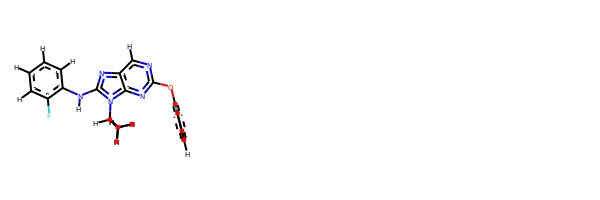

rdkit:  [H]c1c([H])c(F)c(Oc2nc([H])c3nc(N([H])c4c([H])c([H])c([H])c([H])c4F)n(C([H])(C([H])([H])[H])C([H])([H])[H])c3n2)c(F)c1[H]
oechem:  CC(C)n1c2c(cnc(n2)Oc3c(cccc3F)F)nc1Nc4ccccc4F
###########################################################################
 #########################################################

bond
23.6083564039994 kJ/mol 116659.90894721361 kJ/mol False
angle
170.16527696550094 kJ/mol 170.16527696550094 kJ/mol True
nb
0.5485684648750012 kJ/mol 0.5485684648750012 kJ/mol True
torsion
0.0233508327808454 kJ/mol 0.023331685826598312 kJ/mol False
194.34555266715617 kJ/mol 116830.64612432981 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6008


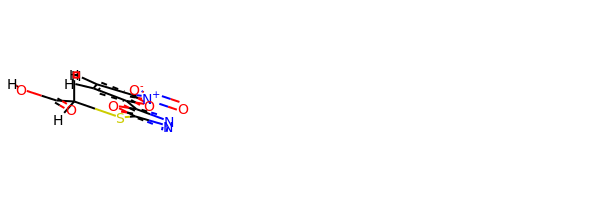

rdkit:  [H]OC(=O)C([H])([H])Sc1nnc(-c2oc([N+](=O)[O-])c([H])c2[H])o1
oechem:  c1cc(oc1c2nnc(o2)SCC(=O)O)[N+](=O)[O-]
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###################################################################

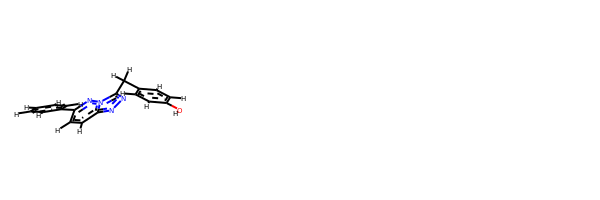

rdkit:  [H]Oc1c([H])c([H])c(C([H])([H])c2nnc3c([H])c([H])c(-c4c([H])c([H])c([H])c([H])c4[H])nn23)c([H])c1[H]
oechem:  c1ccc(cc1)c2ccc3nnc(n3n2)Cc4ccc(cc4)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
8.298504203264049 kJ/mol 28969.96023927277 kJ/mol False
angle
94.79524394142791 kJ/mol 96.3679620835221 kJ/mol False
nb
25.77344666169557 kJ/mol 25.77344666169557 kJ/mol True
torsion
11.505961615892753 kJ/mol 15.689653424127822 kJ/mol False
140.3731564222803 kJ/mol 29107.791301442114 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6023


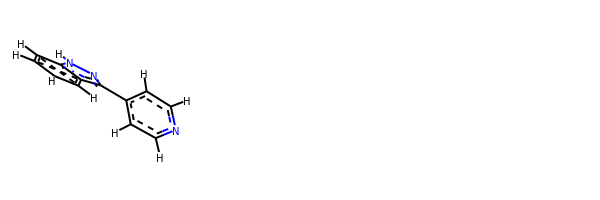

rdkit:  [H]c1nc([H])c([H])c(-c2nn([H])c3c([H])c([H])c([H])c([H])c23)c1[H]
oechem:  c1ccc2c(c1)c(n[nH]2)c3ccncc3
###########################################################################
 #########################################################

bond
7.40617033220523 kJ/mol 43679.02752224837 kJ/mol False
angle
40.092124329615615 kJ/mol 43.44823959537727 kJ/mol False
nb
9.853618833863274 kJ/mol 9.853618833863274 kJ/mol True
torsion
25.390876456724147 kJ/mol 0.15718462644358952 kJ/mol False
82.74278995240827 kJ/mol 43732.48656530405 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6024


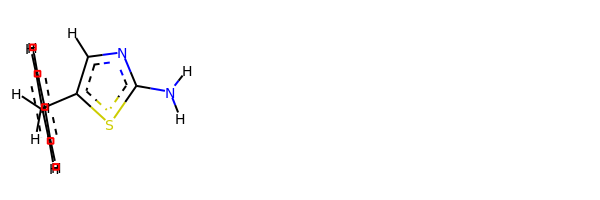

rdkit:  [H]c1nc(N([H])[H])sc1C([H])([H])c1c([H])c([H])c([H])c([H])c1[H]
oechem:  c1ccc(cc1)Cc2cnc(s2)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
40.32350127831566 kJ/mol 85710.7034751909 kJ/mol False
angle
150.5459411093409 kJ/mol 150.5459411093409 kJ/mol True
nb
44.351727523485216 kJ/mol 44.351727523485216 kJ/mol True
torsion
33.67369192778629 kJ/mol 33.67372777403661 kJ/mol False
268.8948618389281 kJ/mol 85939.27487159777 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6026


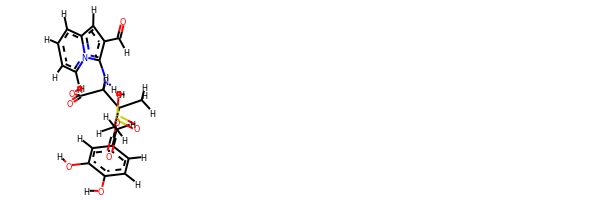

rdkit:  [H]OC(=O)C([H])(N([H])c1c(C([H])=O)c([H])c2c([H])c([H])c([H])c([H])n12)C(S(=O)O[H])(C([H])([H])[H])C([H])([H])OC(=O)C([H])([H])c1c([H])c([H])c(O[H])c(O[H])c1[H]
oechem:  CC(COC(=O)Cc1ccc(c(c1)O)O)(C(C(=O)O)Nc2c(cc3n2cccc3)C=O)S(=O)O
###########################################################################
 #########################################################

bond
35.509499974531806 kJ/mol 101944.53948797379 kJ/mol False
angle
135.39633138595477 kJ/mol 138.75317415961814 kJ/mol False
nb
16.680990277386037 kJ/mol 16.680990277386037 kJ/mol True
torsion
16.99813153613328 kJ/mol 16.99823904184453 kJ/mol False
204.58495317400588 kJ/mol 102116.97189145263 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6027


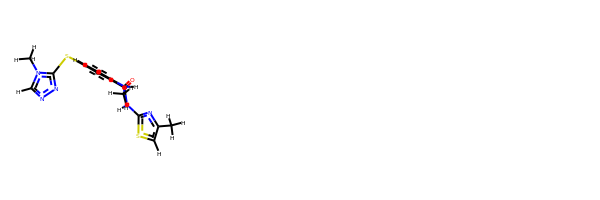

rdkit:  [H]c1sc(N([H])C(=O)c2c([H])c(Sc3nnc([H])n3C([H])([H])[H])c([H])c([H])c2N([H])C([H])([H])[H])nc1C([H])([H])[H]
oechem:  Cc1csc(n1)NC(=O)c2cc(ccc2NC)Sc3nncn3C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
23.229255728642876 kJ/mol 43765.12761095932 kJ/mol False
angle
167.44739373989836 kJ/mol 170.5655814133074 kJ/mol False
nb
72.50729439829497 kJ/mol 72

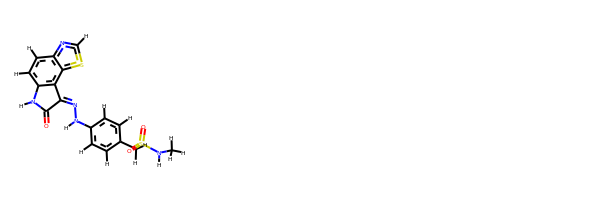

rdkit:  [H]c1nc2c([H])c([H])c3c(c2s1)C(=NN([H])c1c([H])c([H])c(C([H])([H])S(=O)(=O)N([H])C([H])([H])[H])c([H])c1[H])C(=O)N3[H]
oechem:  CNS(=O)(=O)Cc1ccc(cc1)NN=C2c3c(ccc4c3scn4)NC2=O
###########################################################################
 #########################################################

bond
29.711775589408088 kJ/mol 58275.34590145024 kJ/mol False
angle
378.9852874329486 kJ/mol 378.9852874329486 kJ/mol True
nb
37.00589594096783 kJ/mol 37.00589594096783 kJ/mol True
torsion
4.741133438738982 kJ/mol 4.7411332259139884 kJ/mol False
450.4440924020635 kJ/mol 58696.07821805007 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6033


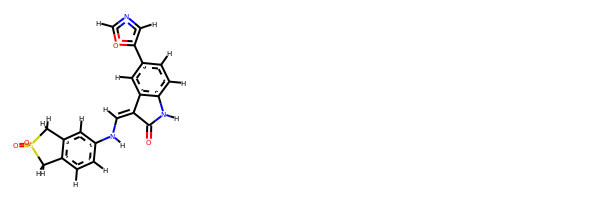

rdkit:  [H]C(=C1C(=O)N([H])c2c([H])c([H])c(-c3oc([H])nc3[H])c([H])c21)N([H])c1c([H])c([H])c2c(c1[H])C([H])([H])S(=O)(=O)C2([H])[H]
oechem:  c1cc2c(cc1c3cnco3)C(=CNc4ccc5c(c4)CS(=O)(=O)C5)C(=O)N2
###########################################################################
 #########################################################

bond
30.182090148421516 kJ/mol 43701.83193663227 kJ/mol False
angle
136.27112929097598 kJ/mol 139.6283480319856 kJ/mol False
nb
37.077622933938066 kJ/mol 37.077622933938066 kJ/mol True
torsion
82.33630328615314 kJ/mol 82.33636348256734 kJ/mol False
285.8671456594887 kJ/mol 43960.87427108076 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6034


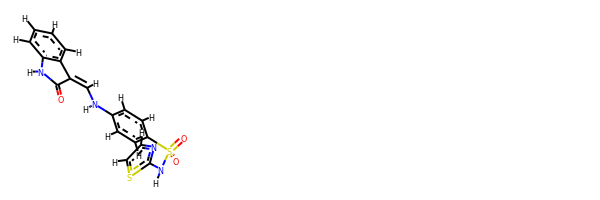

rdkit:  [H]C(=C1C(=O)N([H])c2c([H])c([H])c([H])c([H])c21)N([H])c1c([H])c([H])c(S(=O)(=O)N([H])c2nc([H])c([H])s2)c([H])c1[H]
oechem:  c1ccc2c(c1)C(=CNc3ccc(cc3)S(=O)(=O)Nc4nccs4)C(=O)N2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
18.36787735985458 kJ/mol 58287.91897093816 kJ/mol False
angle
139.29229881881253 kJ/mol 139.29229881881253 kJ/mol True
nb
45.776984922186124 kJ/mol 45.776984922186124 kJ/mol True
torsion
18.768590236929917 kJ/mol 20.629766661596413 kJ/mol False
222.20575133778317 kJ/mol 58493.61802134076 kJ/mol

-------------------------------------------------------------------
-------------------------------------

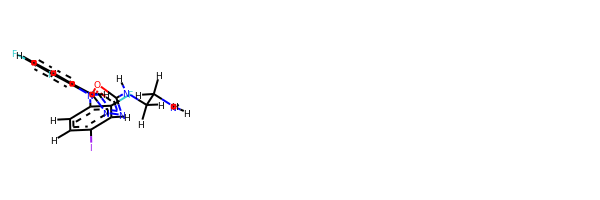

rdkit:  [H]c1c([H])c(-c2nnc(N([H])C([H])([H])C([H])([H])N([H])[H])o2)c(N([H])c2c([H])c([H])c(I)c([H])c2F)c(F)c1F
oechem:  c1cc(c(cc1I)F)Nc2c(ccc(c2F)F)c3nnc(o3)NCCN
###########################################################################
 #########################################################

bond
32.60234450079349 kJ/mol 114204.55920369919 kJ/mol False
angle
130.39801388204026 kJ/mol 132.21815609386468 kJ/mol False
nb
35.986872411669744 kJ/mol 35.986872411669744 kJ/mol True
torsion
47.95626801107952 kJ/mol 14.484300794579454 kJ/mol False
246.943498805583 kJ/mol 114387.24853299929 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6040


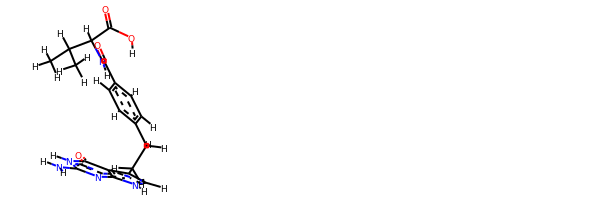

rdkit:  [H]OC(=O)C([H])(N([H])C(=O)c1c([H])c([H])c(C([H])([H])C([H])([H])c2c([H])n([H])c3nc(N([H])[H])n([H])c(=O)c23)c([H])c1[H])C([H])(C([H])([H])[H])C([H])([H])[H]
oechem:  CC(C)C(C(=O)O)NC(=O)c1ccc(cc1)CCc2c[nH]c3c2c(=O)[nH]c(n3)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
24.420347034319875 kJ/mol 28985.20779784219 kJ/mol False
angle
125.57098847539969 kJ/mol 127.15369774778104 kJ/mol False
nb
63.123305278663246 kJ/mol 63.123305278663246 kJ/mol True
torsion
74.06167201660126 kJ/mol 68.83168888843682 kJ/mol False
287.17631280498404 kJ/mol 29244.31648975707 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
--------------------------------------------------------

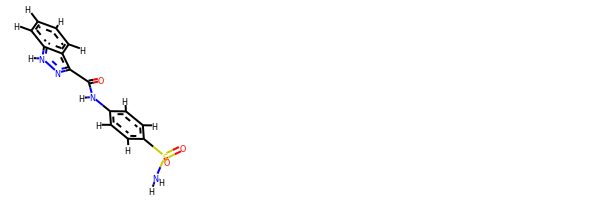

rdkit:  [H]c1c([H])c(S(=O)(=O)N([H])[H])c([H])c([H])c1N([H])C(=O)c1nn([H])c2c([H])c([H])c([H])c([H])c12
oechem:  c1ccc2c(c1)c(n[nH]2)C(=O)Nc3ccc(cc3)S(=O)(=O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
21.74927553710984 kJ/mol 29088.83002279615 kJ/mol False
angle
99.71759441214098 kJ/mol 101.36945571288955 kJ/mol False
nb
51.877697052354236 kJ/mol 51.877697052354236 kJ/mol True
torsion
5.254623025199358 kJ/mol 0.024631921364797617 kJ/mol False
178.59919002680442 kJ/mol 29242.101807482763 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6044


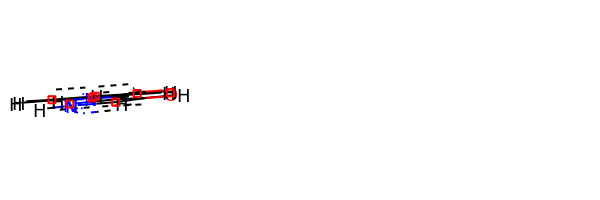

rdkit:  [H]c1c([H])c([H])c(N([H])C(=O)c2nn([H])c([H])c2[H])c([H])c1[H]
oechem:  c1ccc(cc1)NC(=O)c2cc[nH]n2
###########################################################################
 #########################################################

bond
37.02459863234842 kJ/mol 29105.999260811164 kJ/mol False
angle
119.99156596081848 kJ/mol 121.66073070562982 kJ/mol False
nb
53.358181160506376 kJ/mol 53.358181160506376 kJ/mol True
torsion
5.257038416260807 kJ/mol 0.02796476607821593 kJ/mol False
215.63138416993408 kJ/mol 29281.04613744338 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6045


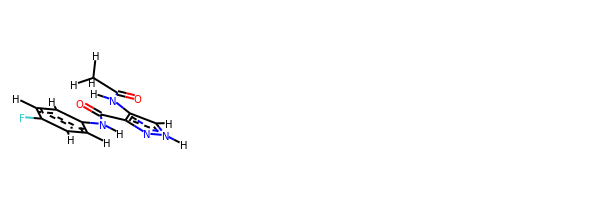

rdkit:  [H]c1c([H])c(N([H])C(=O)c2nn([H])c([H])c2N([H])C(=O)C([H])([H])[H])c([H])c([H])c1F
oechem:  CC(=O)Nc1c[nH]nc1C(=O)Nc2ccc(cc2)F
###########################################################################
 #########################################################

bond
38.03096981682806 kJ/mol 29105.68486381862 kJ/mol False
angle
113.1149184945744 kJ/mol 114.77946219818618 kJ/mol False
nb
73.9423044331037 kJ/mol 73.9423044331037 kJ/mol True
torsion
7.110466024864897 kJ/mol 1.8814118799850503 kJ/mol False
232.1986587693711 kJ/mol 29296.288042329896 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6046


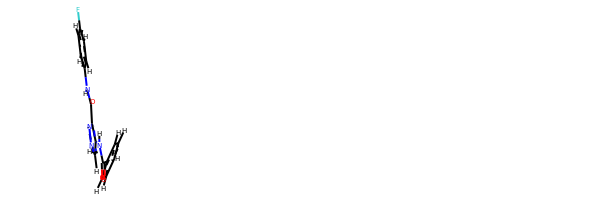

rdkit:  [H]c1c([H])c([H])c(C(=O)N([H])c2c(C(=O)N([H])c3c([H])c([H])c(F)c([H])c3[H])nn([H])c2[H])c([H])c1[H]
oechem:  c1ccc(cc1)C(=O)Nc2c[nH]nc2C(=O)Nc3ccc(cc3)F
###########################################################################
 #########################################################

bond
38.87355090303751 kJ/mol 29107.622971855246 kJ/mol False
angle
113.12571664416359 kJ/mol 114.79471987420236 kJ/mol False
nb
99.47864116256711 kJ/mol 99.47864116256711 kJ/mol True
torsion
7.255166958122808 kJ/mol 2.0260529461725185 kJ/mol False
258.733075667891 kJ/mol 29323.922385838192 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6047


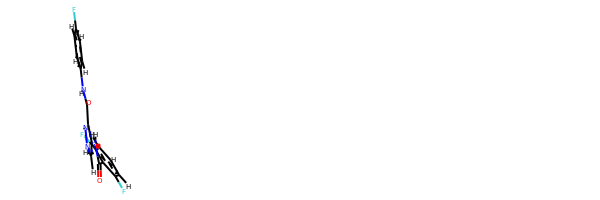

rdkit:  [H]c1c([H])c(F)c(C(=O)N([H])c2c(C(=O)N([H])c3c([H])c([H])c(F)c([H])c3[H])nn([H])c2[H])c(F)c1[H]
oechem:  c1cc(c(c(c1)F)C(=O)Nc2c[nH]nc2C(=O)Nc3ccc(cc3)F)F
###########################################################################
 #########################################################

bond
20.270942421852894 kJ/mol 56554.96456455319 kJ/mol False
angle
94.95978348355884 kJ/mol 94.95978348355884 kJ/mol True
nb
26.143649237617655 kJ/mol 26.143649237617655 kJ/mol True
torsion
5.260948100850305 kJ/mol 0.03098950885556264 kJ/mol False
146.6353232438797 kJ/mol 56676.098986783225 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6048


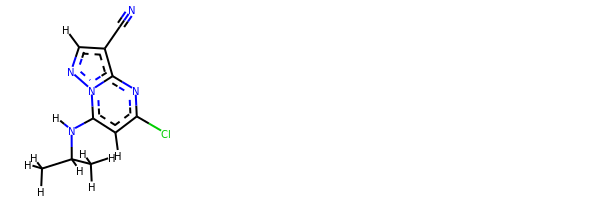

rdkit:  [H]c1nn2c(N([H])C([H])(C([H])([H])[H])C([H])([H])[H])c([H])c(Cl)nc2c1C#N
oechem:  CC(C)Nc1cc(nc2n1ncc2C#N)Cl
###########################################################################
 #########################################################

bond
30.180932472671543 kJ/mol 56705.34958165939 kJ/mol False
angle
114.01056096865223 kJ/mol 114.01056096865223 kJ/mol True
nb
40.520420365718465 kJ/mol 40.520420365718465 kJ/mol True
torsion
29.145830387961123 kJ/mol 16.724994169114193 kJ/mol False
213.85774419500336 kJ/mol 56876.605557162875 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6049


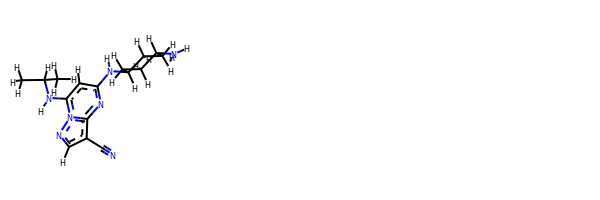

rdkit:  [H]c1nn2c(N([H])C([H])(C([H])([H])[H])C([H])([H])[H])c([H])c(N([H])C3([H])C([H])([H])C([H])([H])C([H])(N([H])[H])C([H])([H])C3([H])[H])nc2c1C#N
oechem:  CC(C)Nc1cc(nc2n1ncc2C#N)NC3CCC(CC3)N
###########################################################################
 #########################################################

bond
36.364001644065794 kJ/mol 29105.66989194448 kJ/mol False
angle
110.23520604191786 kJ/mol 111.90524231343261 kJ/mol False
nb
55.12590504603228 kJ/mol 55.12590504603228 kJ/mol True
torsion
25.15412271102103 kJ/mol 19.925047149017185 kJ/mol False
226.87923544303695 kJ/mol 29292.626086452958 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6050


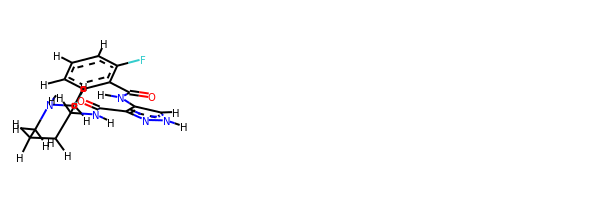

rdkit:  [H]c1c([H])c(F)c(C(=O)N([H])c2c(C(=O)N([H])C3([H])C([H])([H])N([H])C([H])([H])C([H])([H])C3([H])[H])nn([H])c2[H])c(F)c1[H]
oechem:  c1cc(c(c(c1)F)C(=O)Nc2c[nH]nc2C(=O)NC3CCCNC3)F
###########################################################################
 #########################################################

bond
35.01869156638658 kJ/mol 29102.828268753594 kJ/mol False
angle
112.68594210575627 kJ/mol 114.35505811101189 kJ/mol False
nb
22.981713932170734 kJ/mol 22.981713932170734 kJ/mol True
torsion
32.65662860916443 kJ/mol 27.427628403259767 kJ/mol False
203.34297621347804 kJ/mol 29267.592669200036 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6051


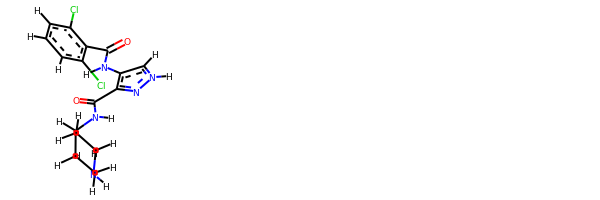

rdkit:  [H]c1c([H])c(Cl)c(C(=O)N([H])c2c(C(=O)N([H])C3([H])C([H])([H])C([H])([H])N([H])C([H])([H])C3([H])[H])nn([H])c2[H])c(Cl)c1[H]
oechem:  c1cc(c(c(c1)Cl)C(=O)Nc2c[nH]nc2C(=O)NC3CCNCC3)Cl
###########################################################################
 #########################################################

bond
55.96830797760298 kJ/mol 100093.02146362446 kJ/mol False
angle
350.60644547712127 kJ/mol 352.7584202926344 kJ/mol False
nb
81.83905343073322 kJ/mol 81.83905343073322 kJ/mol True
torsion
70.26966420081955 kJ/mol 68.73422629104711 kJ/mol False
558.683471086277 kJ/mol 100596.3531636389 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6052


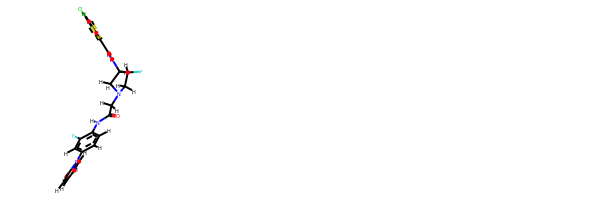

rdkit:  [H]c1c(Cl)sc(C(=O)N([H])C2([H])C([H])([H])N(C([H])([H])C(=O)N([H])c3c([H])c([H])c(-n4c([H])c([H])c([H])c([H])c4=O)c([H])c3F)C([H])([H])C2([H])F)c1[H]
oechem:  c1ccn(c(=O)c1)c2ccc(c(c2)F)NC(=O)CN3CC(C(C3)F)NC(=O)c4ccc(s4)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
16.50238982025349 kJ/mol 57873.93724350483 kJ/mol False
angle
130.3332132097571 kJ/m

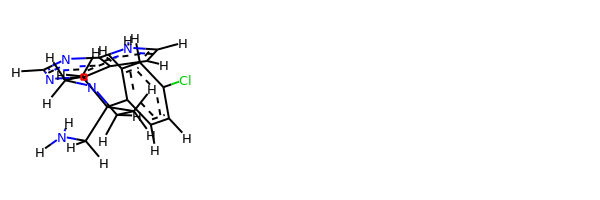

rdkit:  [H]c1nc(N2C([H])([H])C([H])([H])C(c3c([H])c([H])c(Cl)c([H])c3[H])(C([H])([H])N([H])[H])C([H])([H])C2([H])[H])c2c([H])c([H])n([H])c2n1
oechem:  c1cc(ccc1C2(CCN(CC2)c3c4cc[nH]c4ncn3)CN)Cl
###########################################################################
 #########################################################

bond
12.970749593404104 kJ/mol 57869.35984966503 kJ/mol False
angle
128.5559806060097 kJ/mol 129.96392466610277 kJ/mol False
nb
77.01293580070075 kJ/mol 77.01293580070075 kJ/mol True
torsion
30.907689395323686 kJ/mol 30.907815418397945 kJ/mol False
249.44735539543825 kJ/mol 58107.24452555023 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6058


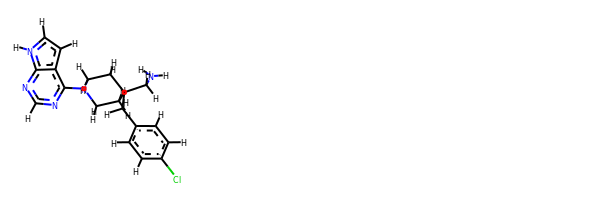

rdkit:  [H]c1nc(N2C([H])([H])C([H])([H])C(C([H])([H])c3c([H])c([H])c(Cl)c([H])c3[H])(C([H])([H])N([H])[H])C([H])([H])C2([H])[H])c2c([H])c([H])n([H])c2n1
oechem:  c1cc(ccc1CC2(CCN(CC2)c3c4cc[nH]c4ncn3)CN)Cl
###########################################################################
 #########################################################

bond
9.417997159374652 kJ/mol 57865.77328959883 kJ/mol False
angle
109.45541630770704 kJ/mol 110.86321615737417 kJ/mol False
nb
52.572191998440836 kJ/mol 52.572191998440836 kJ/mol True
torsion
22.180953906101035 kJ/mol 22.181116271617338 kJ/mol False
193.62655937162356 kJ/mol 58051.38981402627 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6059


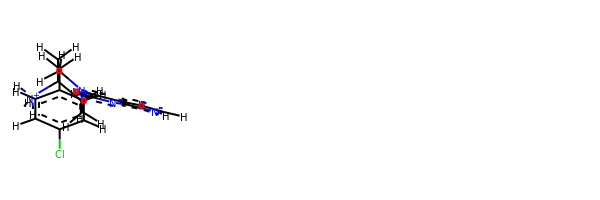

rdkit:  [H]c1nc(N2C([H])([H])C([H])([H])C(C([H])([H])c3c([H])c([H])c(Cl)c([H])c3[H])([N+]([H])([H])[H])C([H])([H])C2([H])[H])c2c([H])c([H])n([H])c2n1
oechem:  c1cc(ccc1CC2(CCN(CC2)c3c4cc[nH]c4ncn3)[NH3+])Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
29.360963075238487 kJ/mol 28989.604141468215 kJ/mol False
angle
91.67040959859953 kJ/mol 93.22883771471656 kJ/mol False
nb
59.87858843701103 kJ/mol 59.87858843701103 kJ/mol True
torsion
27.267129749916936 kJ/mol 22.03722797844365 kJ/mol False
2

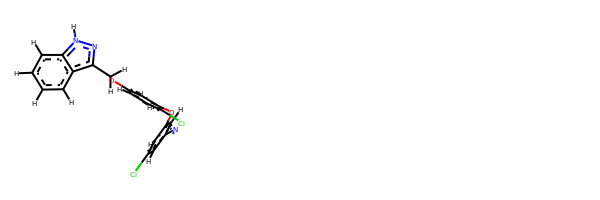

rdkit:  [H]c1c([H])c(OC([H])([H])c2nn([H])c3c([H])c([H])c([H])c([H])c23)c([H])c(Oc2c([H])c(Cl)c([H])c(C#N)c2[H])c1Cl
oechem:  c1ccc2c(c1)c(n[nH]2)COc3ccc(c(c3)Oc4cc(cc(c4)Cl)C#N)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
22.074281440126505 kJ/mol 56570.87810256363 kJ/mol False
angle
117.08157853569824 kJ/mol 117.08157853569824 kJ/mol True
nb
58.49524086

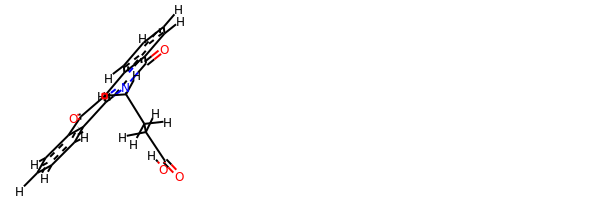

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])C([H])([H])n1c2c(c3c([H])c([H])c([H])c([H])c3c1=O)C(=O)c1c([H])c([H])c([H])c([H])c1-2
oechem:  c1ccc2c(c1)c3c(n(c2=O)CCCC(=O)O)-c4ccccc4C3=O
###########################################################################
 #########################################################

bond
10.292297155275767 kJ/mol 43679.40641479435 kJ/mol False
angle
75.93109090733651 kJ/mol 79.28825196081766 kJ/mol False
nb
3.2799922727708837 kJ/mol 3.2799922727708837 kJ/mol True
torsion
13.882561565086677 kJ/mol 13.882653360730114 kJ/mol False
103.38594190046983 kJ/mol 43775.85731238867 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6069


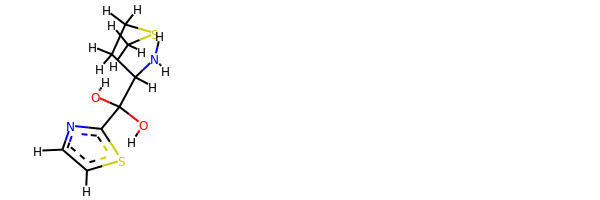

rdkit:  [H]OC(O[H])(c1nc([H])c([H])s1)C([H])(N([H])[H])C([H])([H])C([H])([H])SC([H])([H])[H]
oechem:  CSCCC(C(c1nccs1)(O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
36.583919745535056 kJ/mol 58016.147889241554 kJ/mol False
angle
424.8736382165896 kJ/mol 424.8736382165896 kJ/mol True
nb
41.50900903665514 kJ/mol 41.50900903665514 kJ/mol True
torsion
105.62507195636637 kJ/mol 82.06328948716354 kJ/mol False
608.5916389551462 kJ/mol 58564.59382598197 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
---------------------------------

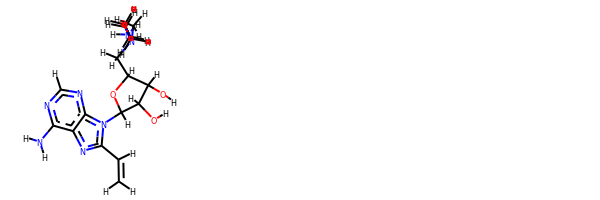

rdkit:  [H]OC1([H])C([H])(n2c(C([H])=C([H])[H])nc3c(N([H])[H])nc([H])nc32)OC([H])(C([H])([H])N(C([H])([H])[H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])ON([H])[H])C1([H])O[H]
oechem:  CN(CCCCON)CC1C(C(C(O1)n2c(nc3c2ncnc3N)C=C)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
23.32884019830576 kJ/mol 57764.25253103959 kJ/mol False
angle
118.03149330342413 kJ/mol 118.03149330342413 kJ/mol True
nb
32.524432074051674 kJ/mol 32.524432074051674 kJ/mol True
torsion
51.20985724954347 kJ/mol 50.56651746627454 kJ/mol False
225.09462282532502 kJ/mol 57965.374973883336 kJ/mol

-----------------------------------------------------------

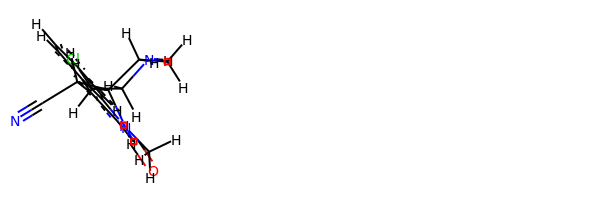

rdkit:  [H]c1c(Cl)c([H])c2c(c1[H])c1c(n2C([H])([H])[H])C(=O)N([H])C2(C1([H])C#N)C([H])([H])C([H])([H])N([H])C([H])([H])C2([H])[H]
oechem:  Cn1c2cc(ccc2c3c1C(=O)NC4(C3C#N)CCNCC4)Cl
###########################################################################
 #########################################################

bond
21.278043846917097 kJ/mol 56696.38506517057 kJ/mol False
angle
9.3504056872877 kJ/mol 9.3504056872877 kJ/mol True
nb
31.740558208000227 kJ/mol 31.740558208000227 kJ/mol True
torsion
0.16464227537273446 kJ/mol 0.16466590958773775 kJ/mol False
62.533650017577756 kJ/mol 56737.640694975446 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6077


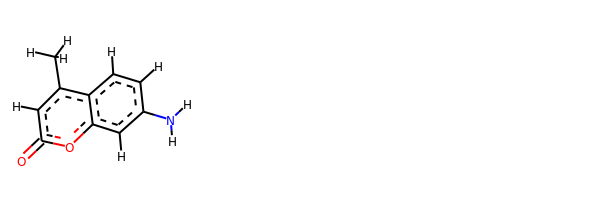

rdkit:  [H]c1c(N([H])[H])c([H])c2oc(=O)c([H])c(C([H])([H])[H])c2c1[H]
oechem:  Cc1cc(=O)oc2c1ccc(c2)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
54.15068871816832 kJ/mol 100091.54546211226 kJ/mol False
angle
50.078979385519894 kJ/mol 52.231770704917544 kJ/mol False
nb
56.00463746931704 kJ/mol 56.00463746931704 kJ/mol True
torsion
16.090436583807424 kJ/mol 

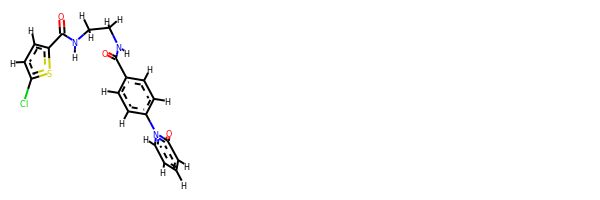

rdkit:  [H]c1c(Cl)sc(C(=O)N([H])C([H])([H])C([H])([H])N([H])C(=O)c2c([H])c([H])c(-n3c([H])c([H])c([H])c([H])c3=O)c([H])c2[H])c1[H]
oechem:  c1ccn(c(=O)c1)c2ccc(cc2)C(=O)NCCNC(=O)c3ccc(s3)Cl
###########################################################################
 #########################################################

bond
53.43262092690707 kJ/mol 100091.10860089712 kJ/mol False
angle
399.513162993967 kJ/mol 401.66513994800226 kJ/mol False
nb
53.2556741805911 kJ/mol 53.2556741805911 kJ/mol True
torsion
57.468871501089005 kJ/mol 55.93182933858832 kJ/mol False
563.6703296025541 kJ/mol 100601.9612443643 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6083


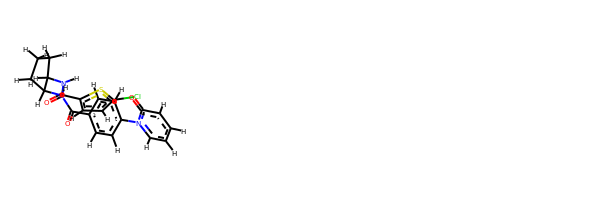

rdkit:  [H]c1c(Cl)sc(C(=O)N([H])C2([H])C([H])([H])C([H])([H])C([H])([H])C2([H])N([H])C(=O)c2c([H])c([H])c(-n3c([H])c([H])c([H])c([H])c3=O)c([H])c2[H])c1[H]
oechem:  c1ccn(c(=O)c1)c2ccc(cc2)C(=O)NC3CCCC3NC(=O)c4ccc(s4)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
23.945897821106872 kJ/mol 58389.18314118132 kJ/mol False
angle
132.3574030272088 kJ/mol 132.3574030272088 kJ/mol True
nb
23.58653152449932 kJ/mol 23.58653152449932 kJ/mol True
torsion
13.903594808461785 kJ/mol 13.903594251335448 kJ/mol False
193.79342718127677 kJ/mol 58559.030669984364 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
Drug

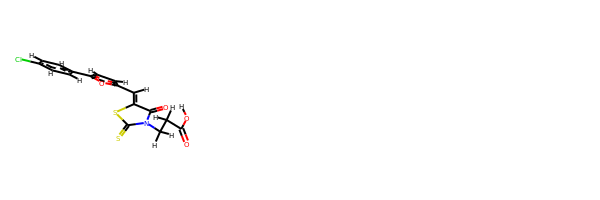

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])N1C(=O)C(=C([H])c2oc(-c3c([H])c([H])c(Cl)c([H])c3[H])c([H])c2[H])SC1=S
oechem:  c1cc(ccc1c2ccc(o2)C=C3C(=O)N(C(=S)S3)CCC(=O)O)Cl
###########################################################################
 #########################################################

bond
17.21421723802331 kJ/mol 57876.18450190927 kJ/mol False
angle
118.78143134075843 kJ/mol 120.16260756370501 kJ/mol False
nb
25.443391494523205 kJ/mol 25.443391494523205 kJ/mol True
torsion
33.45284472548219 kJ/mol 33.45347900323065 kJ/mol False
194.89188479878715 kJ/mol 58055.243979970735 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6087


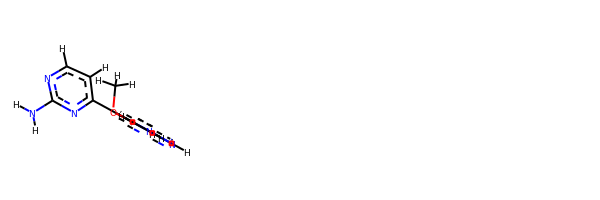

rdkit:  [H]c1nc(N([H])[H])nc(-c2c([H])n([H])c3nc([H])c([H])c(OC([H])([H])[H])c23)c1[H]
oechem:  COc1ccnc2c1c(c[nH]2)c3ccnc(n3)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
17.567721423236414 kJ/mol 57876.53800609447 kJ/mol False
angle
120.66139244849695 kJ/mol 122.04256867144353 kJ/mol False
nb
25.21975837039553 kJ/mol 25.21975837039553 kJ/mol True
torsion
43.19607486267442 kJ/mol 43.19670914042289 kJ/mol False
206.64494710480335 kJ/mol 58066.99704227674 kJ/mol

----------------------------

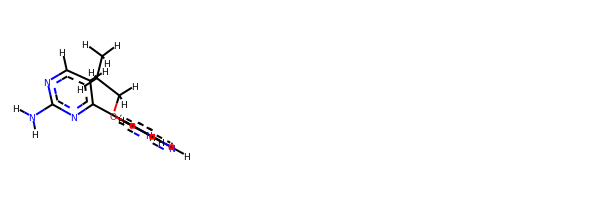

rdkit:  [H]c1nc(N([H])[H])nc(-c2c([H])n([H])c3nc([H])c([H])c(OC([H])([H])C([H])([H])C([H])([H])[H])c23)c1[H]
oechem:  CCCOc1ccnc2c1c(c[nH]2)c3ccnc(n3)N
###########################################################################
 #########################################################

bond
18.818572310144972 kJ/mol 57876.5135606825 kJ/mol False
angle
117.00048112701222 kJ/mol 118.40804998348537 kJ/mol False
nb
65.88762398245376 kJ/mol 65.88762398245376 kJ/mol True
torsion
41.64687457989287 kJ/mol 41.64699298150298 kJ/mol False
243.35355199950385 kJ/mol 58102.45622762993 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6092


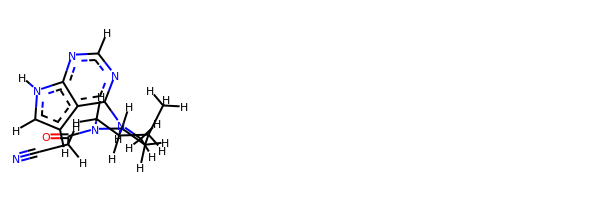

rdkit:  [H]c1nc(N(C([H])([H])[H])C2([H])C([H])([H])N(C(=O)C([H])([H])C#N)C([H])([H])C([H])([H])C2([H])C([H])([H])[H])c2c([H])c([H])n([H])c2n1
oechem:  CC1CCN(CC1N(C)c2c3cc[nH]c3ncn2)C(=O)CC#N
###########################################################################
 #########################################################

bond
32.021198599040865 kJ/mol 58012.05814547267 kJ/mol False
angle
432.2932854084192 kJ/mol 432.2932854084192 kJ/mol True
nb
18.32985670555731 kJ/mol 18.32985670555731 kJ/mol True
torsion
103.39549341844857 kJ/mol 79.2777151916426 kJ/mol False
586.0398341314659 kJ/mol 58541.9590027783 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6094


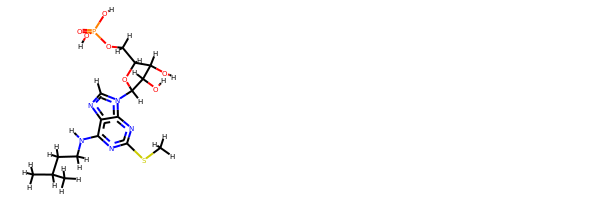

rdkit:  [H]OC1([H])C([H])(n2c([H])nc3c(N([H])C([H])([H])C([H])([H])C([H])(C([H])([H])[H])C([H])([H])[H])nc(SC([H])([H])[H])nc32)OC([H])(C([H])([H])OP(=O)(O[H])O[H])C1([H])O[H]
oechem:  CC(C)CCNc1c2c(nc(n1)SC)n(cn2)C3C(C(C(O3)COP(=O)(O)O)O)O
###########################################################################
 #########################################################

bond
13.529594224556973 kJ/mol 57765.43494089137 kJ/mol False
angle
87.10331552563056 kJ/mol 87.10331552563056 kJ/mol True
nb
15.468355232926589 kJ/mol 15.468355232926589 kJ/mol True
torsion
2.5779706033920258 kJ/mol 2.57802113598232 kJ/mol False
118.67923558650615 kJ/mol 57870.58463278591 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6095


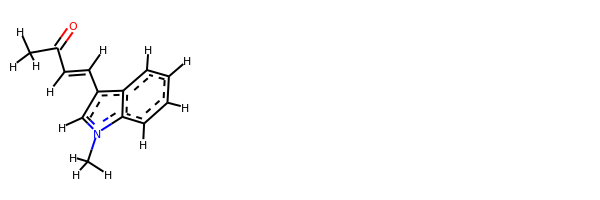

rdkit:  [H]C(C(=O)C([H])([H])[H])=C([H])c1c([H])n(C([H])([H])[H])c2c([H])c([H])c([H])c([H])c12
oechem:  CC(=O)C=Cc1cn(c2c1cccc2)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
32.94813928510911 kJ/mol 113677.80388059189 kJ/mol False
angle
25.616852388343894 kJ/mol 26.21346751159063 kJ/mol False
nb
135.22939679186257 kJ/mol 135.22939679186257 kJ/mol True
torsion
68.6843626340658 kJ/mol 9.371796013358606 kJ/mol False
262.4787510993814 kJ/mol 113848.61854090872 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6097


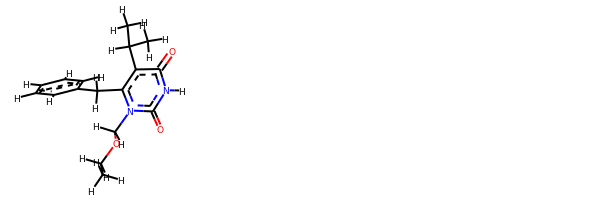

rdkit:  [H]c1c([H])c([H])c(C([H])([H])c2c(C([H])(C([H])([H])[H])C([H])([H])[H])c(=O)n([H])c(=O)n2C([H])([H])OC([H])([H])C([H])([H])[H])c([H])c1[H]
oechem:  CCOCn1c(c(c(=O)[nH]c1=O)C(C)C)Cc2ccccc2
###########################################################################
 #########################################################

bond
20.461447900433512 kJ/mol 57772.366794567235 kJ/mol False
angle
91.10430751767923 kJ/mol 92.33417692045545 kJ/mol False
nb
27.68378976043679 kJ/mol 27.68378976043679 kJ/mol True
torsion
2.9153222203681843 kJ/mol 2.91551063919078 kJ/mol False
142.16486739891772 kJ/mol 57895.30027188732 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6098


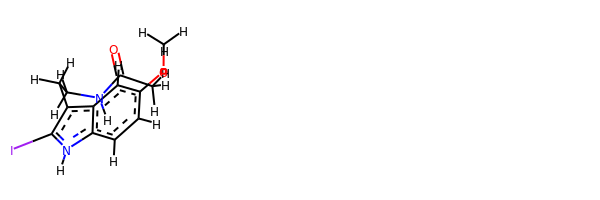

rdkit:  [H]c1c(OC([H])([H])[H])c([H])c2c(C([H])([H])C([H])([H])N([H])C(=O)C([H])([H])[H])c(I)n([H])c2c1[H]
oechem:  CC(=O)NCCc1c2cc(ccc2[nH]c1I)OC
###########################################################################
 #########################################################

bond
7.733766807093308 kJ/mol 57866.70405147834 kJ/mol False
angle
108.31695369584978 kJ/mol 109.69828913228285 kJ/mol False
nb
65.29826312714206 kJ/mol 65.29826312714206 kJ/mol True
torsion
36.84019643571643 kJ/mol 36.84095729080161 kJ/mol False
218.18918006580157 kJ/mol 58078.54156102856 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6099


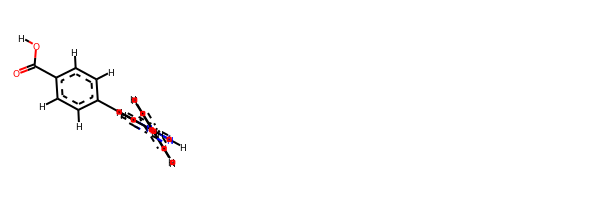

rdkit:  [H]OC(=O)c1c([H])c([H])c(-c2c([H])n([H])c3nc([H])c(-c4c([H])c([H])c([H])c([H])c4[H])c([H])c23)c([H])c1[H]
oechem:  c1ccc(cc1)c2cc3c(c[nH]c3nc2)c4ccc(cc4)C(=O)O
###########################################################################
 #########################################################

bond
11.897435085607505 kJ/mol 43683.79259618476 kJ/mol False
angle
56.91027454119904 kJ/mol 60.26703719899156 kJ/mol False
nb
40.21664828812392 kJ/mol 40.21664828812392 kJ/mol True
torsion
51.54051489522924 kJ/mol 6.281330530920305 kJ/mol False
160.5648728101597 kJ/mol 43790.557612202785 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6100


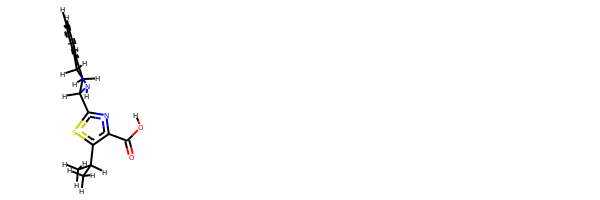

rdkit:  [H]OC(=O)c1nc(C2([H])N([H])C([H])([H])c3c([H])c([H])c([H])c([H])c3C2([H])[H])sc1C([H])(C([H])([H])[H])C([H])([H])[H]
oechem:  CC(C)c1c(nc(s1)C2Cc3ccccc3CN2)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

#############

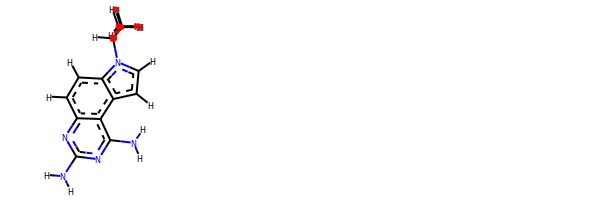

rdkit:  [H]c1c([H])c2c(c([H])c([H])n2C([H])(C([H])([H])OC([H])([H])[H])C([H])([H])OC([H])([H])[H])c2c(N([H])[H])nc(N([H])[H])nc12
oechem:  COCC(COC)n1ccc2c1ccc3c2c(nc(n3)N)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
9.21359280449836 kJ/mol 58153.94083179748 kJ/mol False
angle
92.30277876103459 kJ/mol 92.30277876103459 kJ/mol True
nb
45.22161374451331 kJ/mol 45.22161374451331 kJ/mol True
torsion
0.00041185562597564895 kJ/mol 0.00041357572721076205 kJ/mol False
146.73839716567224 kJ/mol 58291.465637878755 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6113


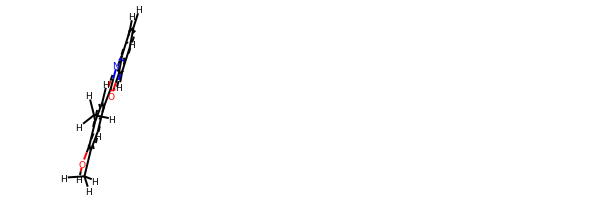

rdkit:  [H]Oc1c(C([H])([H])[H])c([H])c(-c2nc3c([H])c([H])c([H])c([H])c3o2)c([H])c1C([H])([H])[H]
oechem:  Cc1cc(cc(c1O)C)c2nc3ccccc3o2
###########################################################################
 #########################################################

bond
8.157588977585846 kJ/mol 58153.05714785586 kJ/mol False
angle
91.17805398860133 kJ/mol 91.17805398860133 kJ/mol True
nb
42.57631755696283 kJ/mol 42.57631755696283 kJ/mol True
torsion
0.0001512391701651397 kJ/mol 0.0001520287010078439 kJ/mol False
141.91211176232017 kJ/mol 58286.811671430136 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6114


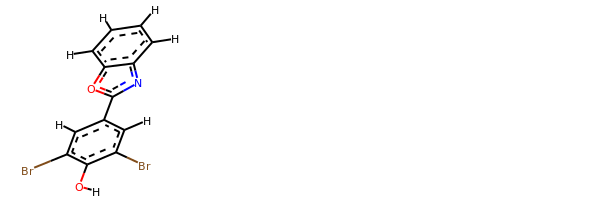

rdkit:  [H]Oc1c(Br)c([H])c(-c2nc3c([H])c([H])c([H])c([H])c3o2)c([H])c1Br
oechem:  c1ccc2c(c1)nc(o2)c3cc(c(c(c3)Br)O)Br
###########################################################################
 #########################################################

bond
9.374384038909177 kJ/mol 58152.7104840813 kJ/mol False
angle
91.75324775087051 kJ/mol 91.75324775087051 kJ/mol True
nb
36.54471628105943 kJ/mol 36.54471628105943 kJ/mol True
torsion
7.493441751550117e-05 kJ/mol 7.516828380835463e-05 kJ/mol False
137.67242300525663 kJ/mol 58281.00852328151 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6115


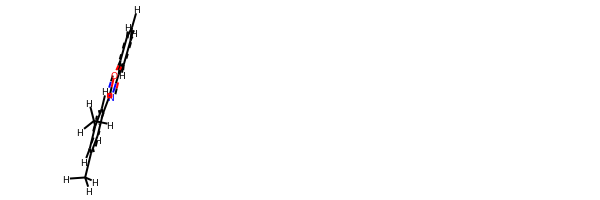

rdkit:  [H]c1c(-c2nc3c([H])c([H])c([H])c([H])c3o2)c([H])c(C([H])([H])[H])c([H])c1C([H])([H])[H]
oechem:  Cc1cc(cc(c1)c2nc3ccccc3o2)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
28.57383678578234 kJ/mol 101720.59368093332 kJ/mol False
angle
138.9654680480117 kJ/mol 142.3220226680264 kJ/mol False
nb
9.634078840484056 kJ/mol 9.634078840484056 kJ/mol True
torsion
11.919592088058685 kJ/mol 11.91998294399426 kJ/mol False
189.09297576233678 kJ/mol 101884.46976538582 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-----------------------

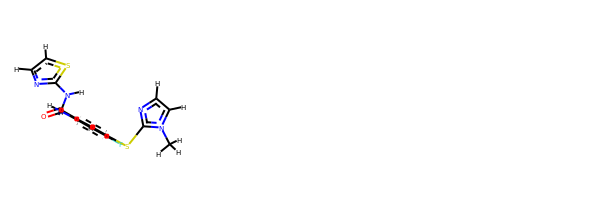

rdkit:  [H]c1nc(N([H])C(=O)c2c([H])c(Sc3nc([H])c([H])n3C([H])([H])[H])c(F)c([H])c2N([H])[H])sc1[H]
oechem:  Cn1ccnc1Sc2cc(c(cc2F)N)C(=O)Nc3nccs3
###########################################################################
 #########################################################

bond
18.227997066429452 kJ/mol 57770.51714955792 kJ/mol False
angle
392.7607943316396 kJ/mol 393.99236339642147 kJ/mol False
nb
10.10561702268006 kJ/mol 10.10561702268006 kJ/mol True
torsion
141.9041311130099 kJ/mol 139.39115461765067 kJ/mol False
562.998539533759 kJ/mol 58314.006284594674 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6119


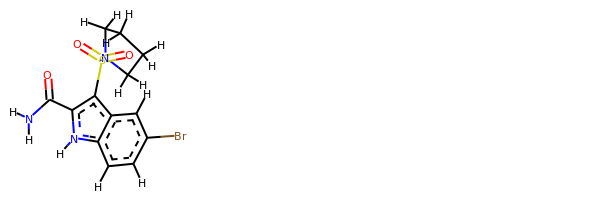

rdkit:  [H]c1c(Br)c([H])c2c(S(=O)(=O)N3C([H])([H])C([H])([H])C([H])([H])C3([H])[H])c(C(=O)N([H])[H])n([H])c2c1[H]
oechem:  c1cc2c(cc1Br)c(c([nH]2)C(=O)N)S(=O)(=O)N3CCCC3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
3.9589689164300363 kJ/mol 58023.892063325016 kJ/mol False
angle
83.4539489199551 kJ/mol 83.4539489199551 kJ/mol True
nb
30.5045675814967 kJ/mol 30.5045675814967 kJ/mol True
torsion
0.0003342551063065339 kJ/mol 0.0003464775191211991 kJ/mol False
117.91781967298814 kJ/mol 58137.85092630399 kJ/mol

-------------------------------------------------------------------
----------------------------------------------------

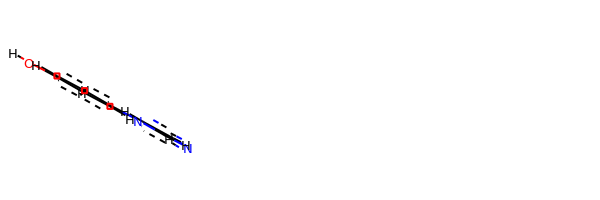

rdkit:  [H]Oc1c([H])c([H])c(-n2c([H])nc([H])c2[H])c([H])c1[H]
oechem:  c1cc(ccc1n2ccnc2)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
18.534277501522283 kJ/mol 29176.232410712502 kJ/mol False
angle
101.5382697233127 kJ/mol 101.5382697233127 kJ/mol True
nb
87.05733154741513 kJ/mol 87.05733154741513 kJ/mol True
torsion
39.81602821537081 kJ/mol 25.107007160713106 kJ/mol False
246.9459069876209 kJ/mol 29389.935019143944 kJ/mol

-------------------------------------------------------------------

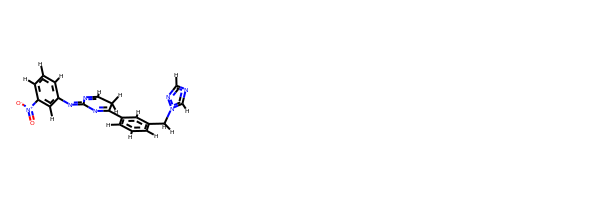

rdkit:  [H]C1=NC(=Nc2c([H])c([H])c([H])c([N+](=O)[O-])c2[H])N=C(c2c([H])c([H])c([H])c(C([H])([H])n3nc([H])nc3[H])c2[H])C1([H])[H]
oechem:  c1cc(cc(c1)C2=NC(=Nc3cccc(c3)[N+](=O)[O-])N=CC2)Cn4cncn4
###########################################################################
 #########################################################

bond
21.733317364118406 kJ/mol 43693.29557133467 kJ/mol False
angle
57.74144706183536 kJ/mol 61.09948389444813 kJ/mol False
nb
67.6880617029366 kJ/mol 67.6880617029366 kJ/mol True
torsion
61.48608042345705 kJ/mol 44.65644222153635 kJ/mol False
208.6489065523474 kJ/mol 43866.73955915359 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6127


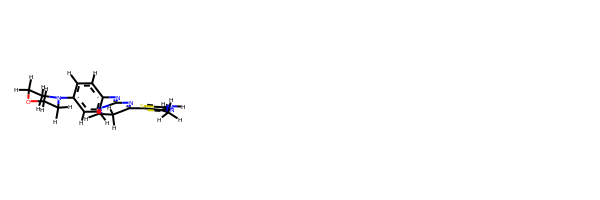

rdkit:  [H]C1=NC(=Nc2c([H])c([H])c(N3C([H])([H])C([H])([H])OC([H])([H])C3([H])[H])c([H])c2[H])N=C(c2sc(N([H])[H])nc2C([H])([H])[H])C1([H])[H]
oechem:  Cc1c(sc(n1)N)C2=NC(=Nc3ccc(cc3)N4CCOCC4)N=CC2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
28.426970259559393 kJ/mol 58391.20174687377 kJ/mol False
angle
150.38438855134189 kJ/mol 150.38438855134189 kJ/mol True
nb
6.954234463317337 kJ/mol 6.954234463317337 kJ/mol True
torsion
263.90700727070623 kJ/mol 263.90703636014075 kJ/mol False
449.672600

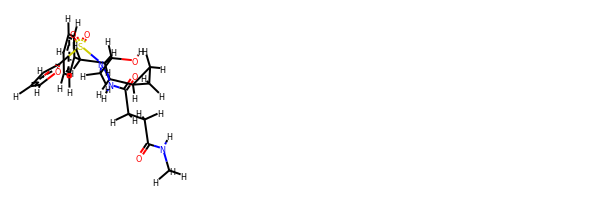

rdkit:  [H]OC([H])(C([H])([H])N(C([H])([H])C1([H])C([H])([H])C1([H])[H])S(=O)(=O)c1oc([H])c([H])c1[H])C([H])(N([H])C(=O)C([H])([H])C([H])([H])C(=O)N([H])C([H])([H])[H])C([H])([H])c1c([H])c([H])c([H])c([H])c1[H]
oechem:  CNC(=O)CCC(=O)NC(Cc1ccccc1)C(CN(CC2CC2)S(=O)(=O)c3ccco3)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
34.651731336425904 kJ/mol 57079.40283520722 kJ/mol False
angle
68.55109398083344 kJ/mol 68.55109398083344 kJ/mol True
nb
33.86547958296009 kJ/mol 33.86547958296009 kJ/mol True
torsion
28.497050253842108 kJ/mol 16.447605295062793 kJ/mol False
165.56535515406154 kJ/mol 57198.26701406607 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
---------------

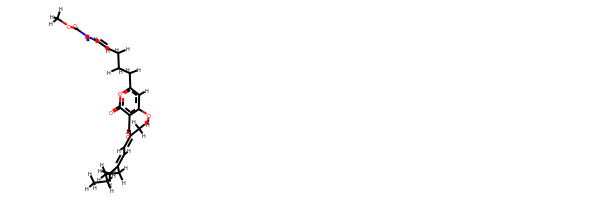

rdkit:  [H]Oc1c([H])c(C([H])([H])C([H])([H])C([H])([H])C([H])=C([H])N([H])C(=O)OC([H])([H])[H])oc(=O)c1C(=O)C(=C([H])C([H])=C(C([H])([H])[H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])[H])C([H])([H])[H]
oechem:  CCCCC(=CC=C(C)C(=O)c1c(cc(oc1=O)CCCC=CNC(=O)OC)O)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
31.366576461982007 kJ/mol 56033.84676622308 kJ/mol False
angle
19.793288766717108 kJ/mol 19.793288766717108 kJ/mol True
nb
170.6958760819696 kJ/mol 170.6958760819696 kJ/mol True
torsion
35.1494104307433 kJ/mol 35.14952724303706 kJ/mol False
257.005151741412 kJ/mol 56259.48545831481 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
--------------------------------

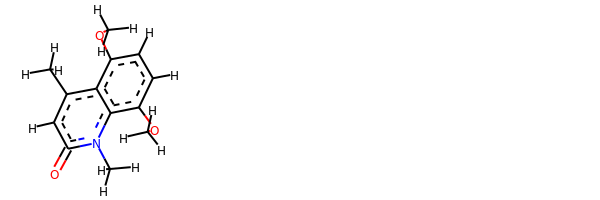

rdkit:  [H]c1c([H])c(OC([H])([H])[H])c2c(c1OC([H])([H])[H])c(C([H])([H])[H])c([H])c(=O)n2C([H])([H])[H]
oechem:  Cc1cc(=O)n(c2c1c(ccc2OC)OC)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
15.44432307759107 kJ/mol 57509.21501452082 kJ/mol False
angle
13.433530980610936 kJ/mol 13.433530980610936 kJ/mol True
nb
50.36794729401159 kJ/mol 50.36794729401159 kJ/mol True
torsion
15.574464299907019 kJ/mol 15.570856144588468 kJ/mol False
94.82026565212061 kJ/mol 57588.58734894003 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6137


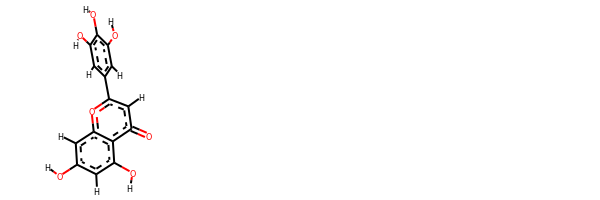

rdkit:  [H]Oc1c([H])c(-c2oc3c([H])c(O[H])c([H])c(O[H])c3c(=O)c2[H])c([H])c(O[H])c1O[H]
oechem:  c1c(cc(c(c1O)O)O)c2cc(=O)c3c(cc(cc3o2)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
21.526131541458057 kJ/mol 57788.42802308872 kJ/mol False
angle
93.34265935908125 kJ/mol 94.64400683336558 kJ/mol False
nb
51.073437637075486 kJ/mol 51.073437637075486 kJ/mol True
torsion
36.855604650276135 kJ/mol 36.855870870824354 kJ/mol False
202.79783318789094 kJ/mol 57971.00133842999 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6139


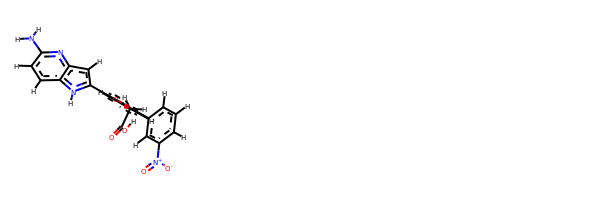

rdkit:  [H]OC(=O)C([H])([H])c1c([H])c(-c2c([H])c([H])c([H])c([N+](=O)[O-])c2[H])c(O[H])c(-c2c([H])c3nc(N([H])[H])c([H])c([H])c3n2[H])c1[H]
oechem:  c1cc(cc(c1)[N+](=O)[O-])c2cc(cc(c2O)c3cc4c([nH]3)ccc(n4)N)CC(=O)O
###########################################################################
 #########################################################

bond
15.997972499664852 kJ/mol 57998.84796884077 kJ/mol False
angle
125.29207567557533 kJ/mol 127.41193301776595 kJ/mol False
nb
64.84653191893406 kJ/mol 64.84653191893406 kJ/mol True
torsion
28.605964109308125 kJ/mol 28.605958114545768 kJ/mol False
234.74254420348237 kJ/mol 58219.71239189201 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6140


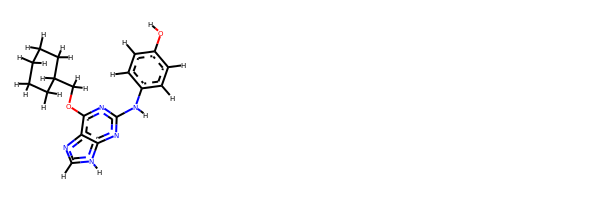

rdkit:  [H]Oc1c([H])c([H])c(N([H])c2nc(OC([H])([H])C3([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C3([H])[H])c3nc([H])n([H])c3n2)c([H])c1[H]
oechem:  c1cc(ccc1Nc2nc3c(c(n2)OCC4CCCCC4)nc[nH]3)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
23.491059208473963 kJ/mol 101564.32934380841 kJ/mol False
angle
117.52289507538984 kJ/mol 120.90739226691758 kJ/mol False
nb
4.49070721667727 kJ/mol 4.49070721667727 kJ/mol True
torsion
5.62832450017662 kJ/mol 3.1143754431144544 kJ/mol False
151.1329860007177 kJ/mol 101692.84181873512 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6142


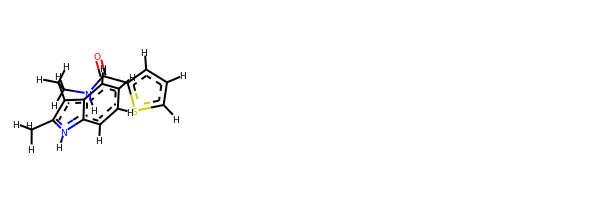

rdkit:  [H]c1sc(C(=O)N([H])C([H])([H])C([H])([H])c2c(C([H])([H])[H])n([H])c3c([H])c([H])c([H])c([H])c23)c([H])c1[H]
oechem:  Cc1c(c2ccccc2[nH]1)CCNC(=O)c3cccs3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
47.989359239172174 kJ/mol 114174.77171957726 kJ/mol False
angle
439.0538134951804 kJ/mol 439.40669794485433 kJ/mol False
nb
32.95744032436289 kJ/mol 32.95744032436289 kJ/mol True
torsion
105.28426767657332 kJ/mol 64.96804527395558 kJ/mol False
625.2848807352888 kJ/mol 114712.10390312043 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6144


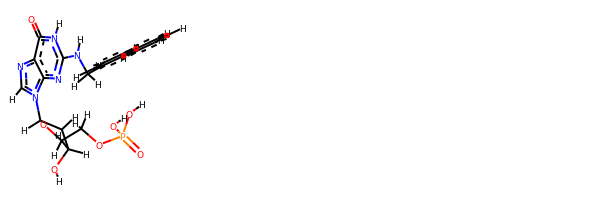

rdkit:  [H]OC1([H])C([H])([H])C([H])(n2c([H])nc3c(=O)n([H])c(N([H])C([H])([H])c4c([H])c([H])c([H])c5c([H])c([H])c([H])c([H])c45)nc32)OC1([H])C([H])([H])OP(=O)(O[H])O[H]
oechem:  c1ccc2c(c1)cccc2CNc3[nH]c(=O)c4c(n3)n(cn4)C5CC(C(O5)COP(=O)(O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
22.98284782663203 kJ/mol 58005.83284416774 kJ/mol False
angle
125.792408988326 kJ/mol 127.91226633051659 kJ/mol False
nb
76.49337545991426 kJ/mol 76.49337545991426 kJ/mol True
torsion
45.33839129506334 kJ/mo

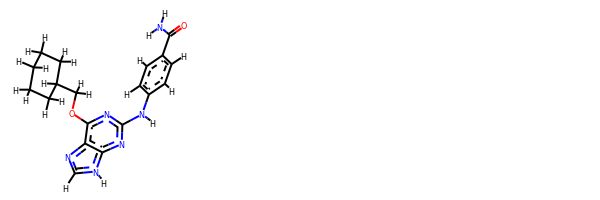

rdkit:  [H]c1c([H])c(N([H])c2nc(OC([H])([H])C3([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C3([H])[H])c3nc([H])n([H])c3n2)c([H])c([H])c1C(=O)N([H])[H]
oechem:  c1cc(ccc1C(=O)N)Nc2nc3c(c(n2)OCC4CCCCC4)nc[nH]3
###########################################################################
 #########################################################

bond
23.301763194434795 kJ/mol 29106.339829081717 kJ/mol False
angle
135.79090694498427 kJ/mol 135.79090694498427 kJ/mol True
nb
87.85733808332883 kJ/mol 87.85733808332883 kJ/mol True
torsion
17.55268734855755 kJ/mol 12.322697965573287 kJ/mol False
264.5026955713054 kJ/mol 29342.310772075605 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6149


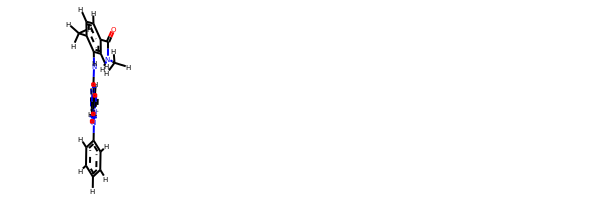

rdkit:  [H]c1nc(N([H])c2c([H])c(C(=O)N([H])C([H])([H])[H])c([H])c([H])c2C([H])([H])[H])c2c([H])nn(-c3c([H])c([H])c([H])c([H])c3[H])c2n1
oechem:  Cc1ccc(cc1Nc2c3cnn(c3ncn2)c4ccccc4)C(=O)NC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
34.14219049204459 kJ/mol 57787.28711166142 kJ/mol False
angle
402.6108655379688 kJ/mol 402.6108655379688 kJ/mol True
nb
19.01253551603822 kJ/mol 19.01253551603822 kJ/mol True
torsion
76.89049591462047 kJ/mol 55.97352924336109 kJ/mol False
532.6560874606721 kJ/mol 58264.884041958794 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6151


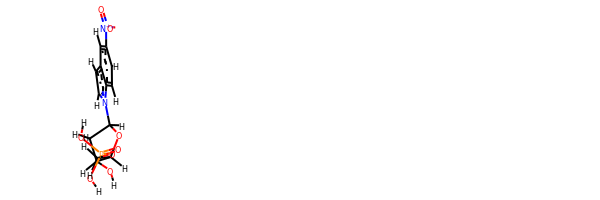

rdkit:  [H]OC1([H])C([H])([H])C([H])(n2c([H])c([H])c3c([H])c([N+](=O)[O-])c([H])c([H])c32)OC1([H])C([H])([H])OP(=O)(O[H])O[H]
oechem:  c1cc2c(ccn2C3CC(C(O3)COP(=O)(O)O)O)cc1[N+](=O)[O-]
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
18.10143688692588 kJ/mol 58000.462527683965 kJ/mol False
angle
112.70909184642282 kJ/mol 114.8288870189205 kJ/mol False
nb
39.724352700706085 kJ/mol 39.724352700706085 kJ/mol True
torsion
24.63008827560791 kJ/mol 23.836788605705575 kJ/mol False
195.16496970966267 kJ/mol 58178.8525560093 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6153


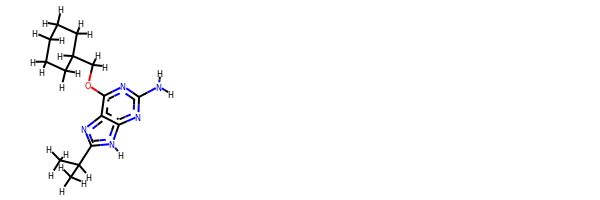

rdkit:  [H]N([H])c1nc(OC([H])([H])C2([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C2([H])[H])c2nc(C([H])(C([H])([H])[H])C([H])([H])[H])n([H])c2n1
oechem:  CC(C)c1[nH]c2c(n1)c(nc(n2)N)OCC3CCCCC3
###########################################################################
 #########################################################

bond
17.497911693222193 kJ/mol 58000.34790803432 kJ/mol False
angle
150.43905316545622 kJ/mol 152.55891050764683 kJ/mol False
nb
56.58323079065471 kJ/mol 56.58323079065471 kJ/mol True
torsion
97.42062364457662 kJ/mol 97.42061764981429 kJ/mol False
321.9408192939097 kJ/mol 58306.910666982425 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6154


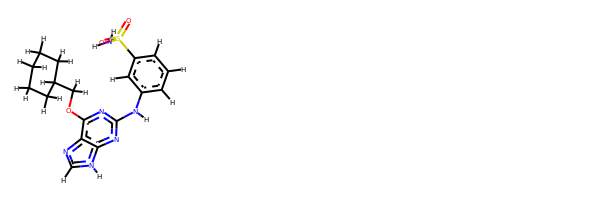

rdkit:  [H]c1c([H])c(N([H])c2nc(OC([H])([H])C3([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C3([H])[H])c3nc([H])n([H])c3n2)c([H])c(S(=O)(=O)N([H])[H])c1[H]
oechem:  c1cc(cc(c1)S(=O)(=O)N)Nc2nc3c(c(n2)OCC4CCCCC4)nc[nH]3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #####################

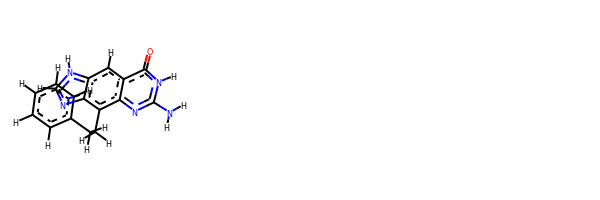

rdkit:  [H]c1c([H])c([H])c(C([H])([H])C([H])([H])c2c3nc(N([H])[H])n([H])c(=O)c3c([H])c3c2nc([H])n3[H])c([H])c1[H]
oechem:  c1ccc(cc1)CCc2c3c(cc4c2nc[nH]4)c(=O)[nH]c(n3)N
###########################################################################
 #########################################################

bond
12.251379946581004 kJ/mol 115086.00015255739 kJ/mol False
angle
94.60411956986164 kJ/mol 96.76712707904855 kJ/mol False
nb
37.305367441228015 kJ/mol 37.305367441228015 kJ/mol True
torsion
33.62565333470198 kJ/mol 0.15366324895422173 kJ/mol False
177.78652029237264 kJ/mol 115220.22631032662 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6174


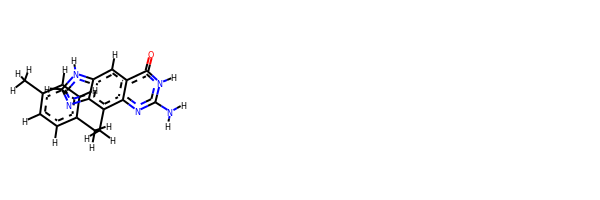

rdkit:  [H]c1c([H])c(C([H])([H])C([H])([H])c2c3nc(N([H])[H])n([H])c(=O)c3c([H])c3c2nc([H])n3[H])c([H])c([H])c1C([H])([H])[H]
oechem:  Cc1ccc(cc1)CCc2c3c(cc4c2nc[nH]4)c(=O)[nH]c(n3)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
16.771118136007882 kJ/mol 57165.949786049416 kJ/mol False
angle
38.0033569539872 kJ/mol 38.0033569539872 kJ/mol True
nb
78.7586925841

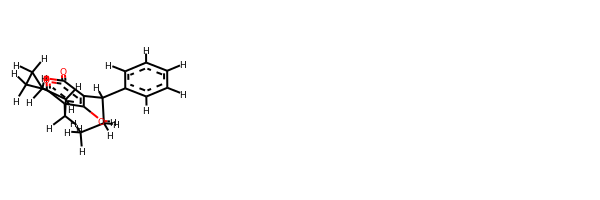

rdkit:  [H]Oc1c2c(oc(=O)c1C([H])(c1c([H])c([H])c([H])c([H])c1[H])C([H])([H])C([H])([H])[H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C2([H])[H]
oechem:  CCC(c1ccccc1)c2c(c3c(oc2=O)CCCCC3)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
28.01384595202124 kJ/mol 56100.80599461991 kJ/mol False
angle
49.72182836507682 kJ/mol 49.72182836507682 kJ/mol True
nb
53.51214503861751 kJ/mol 53.51214503861751 kJ/mol True
torsion
250.1996561342361 kJ/mol 247.38083857453685 kJ/mol False
381.44747548995167 kJ/mol 56451.42080659814 kJ/mol

-------------------------------------------------------------------
------------------------------------

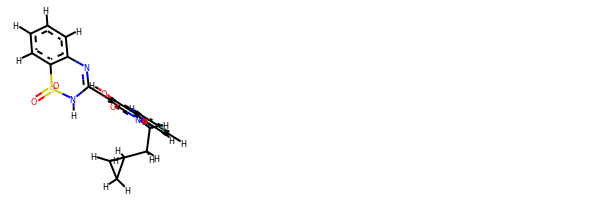

rdkit:  [H]Oc1c(C2=Nc3c([H])c([H])c([H])c([H])c3S(=O)(=O)N2[H])c(=O)n(C([H])([H])C([H])([H])C2([H])C([H])([H])C2([H])[H])c2c([H])c([H])c(F)c([H])c12
oechem:  c1ccc2c(c1)N=C(NS2(=O)=O)c3c(c4cc(ccc4n(c3=O)CCC5CC5)F)O
###########################################################################
 #########################################################

bond
33.59385840287098 kJ/mol 43820.344213066084 kJ/mol False
angle
59.83387022230795 kJ/mol 61.98605610098161 kJ/mol False
nb
45.61809709178548 kJ/mol 45.61809709178548 kJ/mol True
torsion
77.08289625908651 kJ/mol 71.80084494801763 kJ/mol False
216.1287219760509 kJ/mol 43999.74921120687 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6184


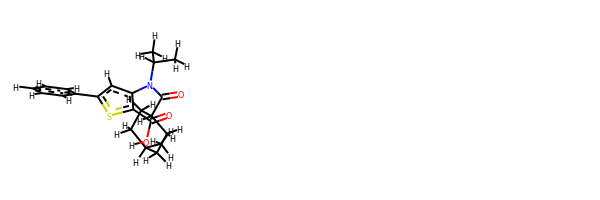

rdkit:  [H]OC(=O)c1sc(-c2c([H])c([H])c([H])c([H])c2[H])c([H])c1N(C(=O)C1([H])C([H])([H])C([H])([H])C([H])(C([H])([H])[H])C([H])([H])C1([H])[H])C([H])(C([H])([H])[H])C([H])([H])[H]
oechem:  CC1CCC(CC1)C(=O)N(c2cc(sc2C(=O)O)c3ccccc3)C(C)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ######

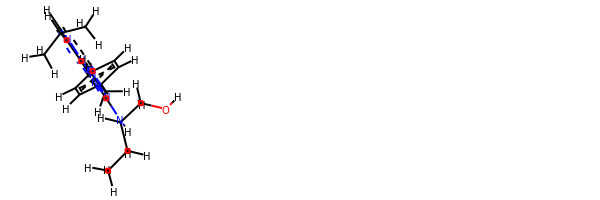

rdkit:  [H]OC([H])([H])C([H])(N([H])c1nc(N([H])C([H])([H])c2c([H])c([H])c([H])c([H])c2[H])n2nc([H])c(C([H])(C([H])([H])[H])C([H])([H])[H])c2n1)C([H])([H])C([H])([H])[H]
oechem:  CCC(CO)Nc1nc2c(cnn2c(n1)NCc3ccccc3)C(C)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ########################

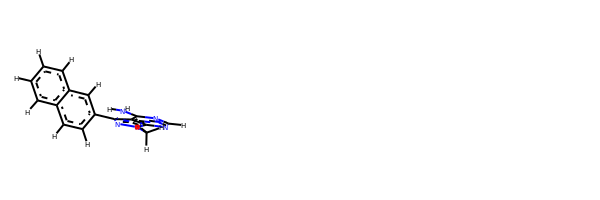

rdkit:  [H]c1nc(N([H])[H])c2c(-c3c([H])c([H])c4c([H])c([H])c([H])c([H])c4c3[H])nn(C([H])([H])[H])c2n1
oechem:  Cn1c2c(c(n1)c3ccc4ccccc4c3)c(ncn2)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
28.8386153314739 kJ/mol 58396.04310321586 kJ/mol False
angle
119.88707875972017 kJ/mol 119.88707875972017 kJ/mol True
nb
39.00225199882152 kJ/mol 39.00225199882152 kJ/mol True
torsion
105.9372996560291 kJ/mol 105.93729683749892 kJ/mol False
293.66524574604466 kJ/mol 58660.86973081189 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6206


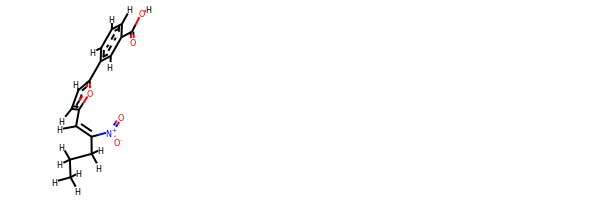

rdkit:  [H]OC(=O)c1c([H])c([H])c([H])c(-c2oc(C([H])=C([N+](=O)[O-])C([H])([H])C([H])([H])C([H])([H])[H])c([H])c2[H])c1[H]
oechem:  CCCC(=Cc1ccc(o1)c2cccc(c2)C(=O)O)[N+](=O)[O-]
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
24.864715531292962 kJ/mol 43809.7251675537 kJ/mol False
angle
61.70354820121515 kJ/mol 63.85696978476958 kJ/mol False
nb
25.224670837793003 kJ/mol 25.224670837793003 kJ/mol True
torsion
88.56634702985706 kJ/mol 86.05595233867827 kJ/mol False
200.3592816001582 kJ/mol 43984.8

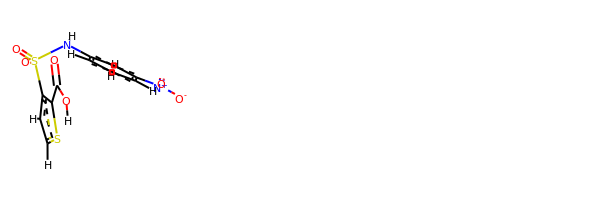

rdkit:  [H]OC(=O)c1sc([H])c([H])c1S(=O)(=O)N([H])c1c([H])c([H])c([H])c([N+](=O)[O-])c1[H]
oechem:  c1cc(cc(c1)[N+](=O)[O-])NS(=O)(=O)c2ccsc2C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
20.288379426518464 kJ/mol 58001.1108259931 kJ/mol False
angle
147.15550801351614 kJ/mol 149.2752738477561 kJ/mol False
nb
61.81132832857128 kJ/mol 61.81132832857128 kJ/mol True
torsion
48.157978916170194 kJ/mol 48.15799051212671 kJ/mol False
277.4131946847761 kJ/mol 58260.35541868155 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-----------

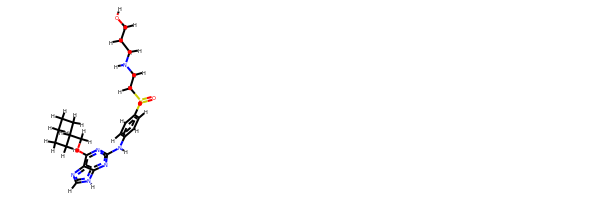

rdkit:  [H]OC([H])([H])C([H])([H])C([H])([H])N([H])C([H])([H])C([H])([H])S(=O)(=O)c1c([H])c([H])c(N([H])c2nc(OC([H])([H])C3([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C3([H])[H])c3nc([H])n([H])c3n2)c([H])c1[H]
oechem:  c1cc(ccc1Nc2nc3c(c(n2)OCC4CCCCC4)nc[nH]3)S(=O)(=O)CCNCCCO
###########################################################################
 #########################################################

bond
20.032859496249777 kJ/mol 58165.548746727814 kJ/mol False
angle
418.91285506482785 kJ/mol 418.91285506482785 kJ/mol True
nb
20.75956872030645 kJ/mol 20.75956872030645 kJ/mol True
torsion
44.69023849342683 kJ/mol 44.69023843547808 kJ/mol False
504.3955217748109 kJ/mol 58649.91140894843 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6214


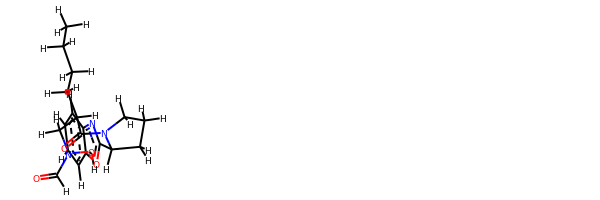

rdkit:  [H]ON(C([H])=O)C([H])([H])C([H])(C(=O)N1C([H])([H])C([H])([H])C([H])([H])C1([H])c1nc2c([H])c([H])c([H])c([H])c2o1)C([H])([H])C([H])([H])C([H])([H])C([H])([H])[H]
oechem:  CCCCC(CN(C=O)O)C(=O)N1CCCC1c2nc3ccccc3o2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
30.646224932339774 kJ/mol 101732.06697583561 kJ/mol False
angle
135.24842232837725 kJ/mol 139.30692204282877 kJ/mol False
nb
16.891692463287505 kJ/mol 16.891692463287505 kJ/mol True
torsion
23.013671700970303 kJ/mol 6.277815337034407 kJ/mol False
205.80001142497483 kJ/mol 101894.54340567876 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------

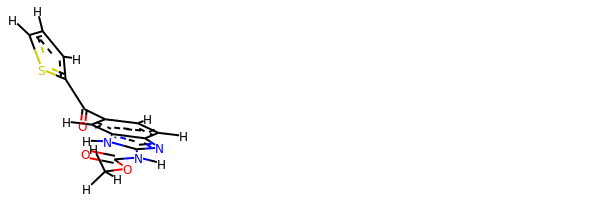

rdkit:  [H]c1sc(C(=O)c2c([H])c([H])c3nc(N([H])C(=O)OC([H])([H])[H])n([H])c3c2[H])c([H])c1[H]
oechem:  COC(=O)Nc1[nH]c2cc(ccc2n1)C(=O)c3cccs3
###########################################################################
 #########################################################

bond
12.870816623623886 kJ/mol 58256.73978602218 kJ/mol False
angle
96.70933108593172 kJ/mol 96.70933108593172 kJ/mol True
nb
9.177333127129668 kJ/mol 9.177333127129668 kJ/mol True
torsion
25.770944327777944 kJ/mol 6.430346395035325 kJ/mol False
144.52842516446321 kJ/mol 58369.056796630284 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6217


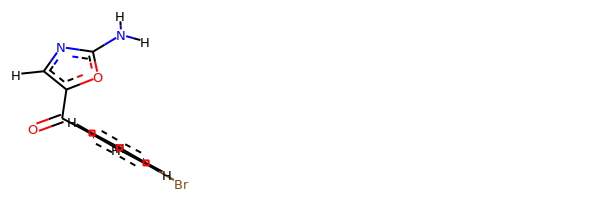

rdkit:  [H]c1nc(N([H])[H])oc1C(=O)c1c([H])c([H])c([H])c(Br)c1[H]
oechem:  c1cc(cc(c1)Br)C(=O)c2cnc(o2)N
###########################################################################
 #########################################################

bond
22.477117250054583 kJ/mol 58268.61972559095 kJ/mol False
angle
104.64590287520667 kJ/mol 104.64590287520667 kJ/mol True
nb
28.399002668076246 kJ/mol 28.399002668076246 kJ/mol True
torsion
55.740366848566225 kJ/mol 27.019661886707375 kJ/mol False
211.26238964190372 kJ/mol 58428.68429302094 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6218


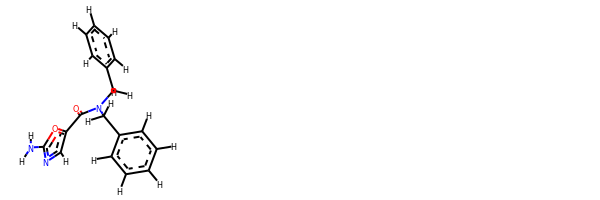

rdkit:  [H]c1nc(N([H])[H])oc1C(=O)N(C([H])([H])c1c([H])c([H])c([H])c([H])c1[H])C([H])([H])c1c([H])c([H])c([H])c([H])c1[H]
oechem:  c1ccc(cc1)CN(Cc2ccccc2)C(=O)c3cnc(o3)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

##############

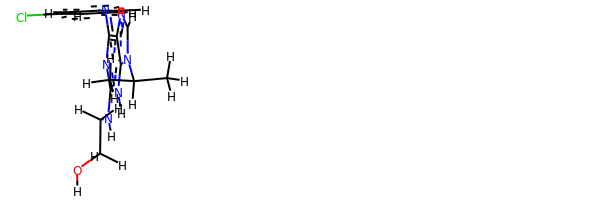

rdkit:  [H]OC([H])([H])C([H])([H])N([H])c1nc(=Nc2c([H])c([H])c([H])c(Cl)c2[H])c2nc([H])n(C([H])(C([H])([H])[H])C([H])([H])[H])c2n1[H]
oechem:  CC(C)n1cnc2c1[nH]c(nc2=Nc3cccc(c3)Cl)NCCO
###########################################################################
 #########################################################

bond
4.661454938452648 kJ/mol 43607.96581543285 kJ/mol False
angle
130.5446300104252 kJ/mol 133.6788123922238 kJ/mol False
nb
11.779279451096526 kJ/mol 11.779279451096526 kJ/mol True
torsion
4.176120703968867 kJ/mol 4.176143333501017 kJ/mol False
151.16148510394325 kJ/mol 43757.60005060967 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6229


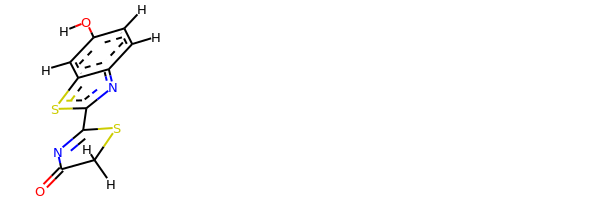

rdkit:  [H]Oc1c([H])c([H])c2nc(C3=NC(=O)C([H])([H])S3)sc2c1[H]
oechem:  c1cc2c(cc1O)sc(n2)C3=NC(=O)CS3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
16.783626539642583 kJ/mol 116059.01972405458 kJ/mol False
angle
233.40054413442704 kJ/mol 237.41916736078144 kJ/mol False
nb
40.78506579359046 kJ/mol 40.78506579359046 kJ/mol True
torsion
10.438265654424608 kJ/mo

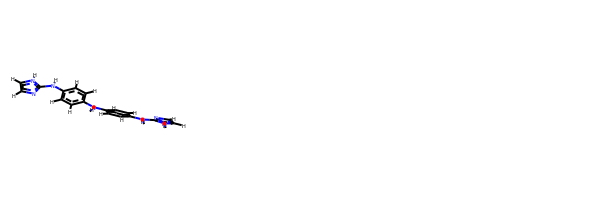

rdkit:  [H]c1nc(N([H])c2c([H])c([H])c(N([H])c3c([H])c([H])c(N([H])c4nc([H])c([H])n4[H])c([H])c3[H])c([H])c2[H])n([H])c1[H]
oechem:  c1cc(ccc1Nc2ccc(cc2)Nc3[nH]ccn3)Nc4[nH]ccn4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
19.941000161328866 kJ/mol 58290.00403397232 kJ/mol False
angle
114.18350312944297 kJ/mol 114.18350312944297 kJ/mol True
nb
83.1980358702959

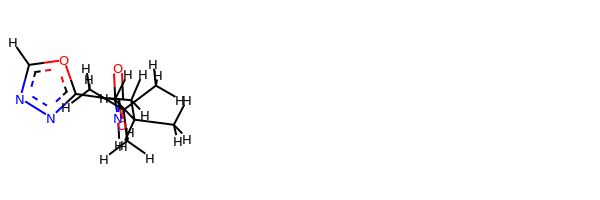

rdkit:  [H]c1nnc(C([H])(N([H])C(=O)OC(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H])C([H])(C([H])([H])[H])C([H])([H])[H])o1
oechem:  CC(C)C(c1nnco1)NC(=O)OC(C)(C)C
###########################################################################
 #########################################################

bond
19.941000161328866 kJ/mol 58290.00403397232 kJ/mol False
angle
114.18350312944297 kJ/mol 114.18350312944297 kJ/mol True
nb
83.19803587029593 kJ/mol 83.19803587029593 kJ/mol True
torsion
34.642905460489466 kJ/mol 34.64290412125954 kJ/mol False
251.9654446215572 kJ/mol 58522.028477093314 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6240


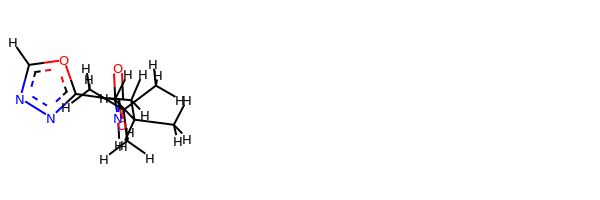

rdkit:  [H]c1nnc(C([H])(N([H])C(=O)OC(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H])C([H])(C([H])([H])[H])C([H])([H])[H])o1
oechem:  CC(C)C(c1nnco1)NC(=O)OC(C)(C)C
###########################################################################
 #########################################################

bond
31.12848587565858 kJ/mol 57754.42624275076 kJ/mol False
angle
138.53808038137478 kJ/mol 138.53808038137478 kJ/mol True
nb
52.24939235887897 kJ/mol 52.24939235887897 kJ/mol True
torsion
193.68620197629153 kJ/mol 187.68058653617783 kJ/mol False
415.6021605922039 kJ/mol 58132.89430202718 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6241


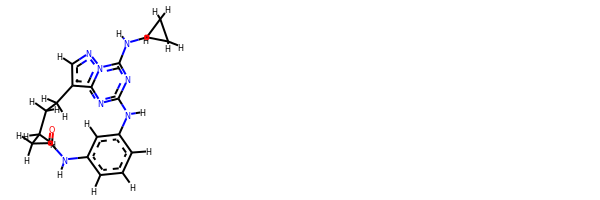

rdkit:  [H]c1nn2c(N([H])C3([H])C([H])([H])C3([H])[H])nc3nc2c1C([H])([H])C([H])([H])C([H])([H])C([H])([H])C(=O)N([H])c1c([H])c([H])c([H])c(c1[H])N3[H]
oechem:  c1cc2cc(c1)NC(=O)CCCCc3cnn4c3nc(nc4NC5CC5)N2
###########################################################################
 #########################################################

bond
25.34381133105219 kJ/mol 56081.0664787797 kJ/mol False
angle
44.645098227554605 kJ/mol 44.645098227554605 kJ/mol True
nb
72.79977478507043 kJ/mol 72.79977478507043 kJ/mol True
torsion
26.20354859326054 kJ/mol 26.259362956943725 kJ/mol False
168.99223293693774 kJ/mol 56224.77071474927 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6242


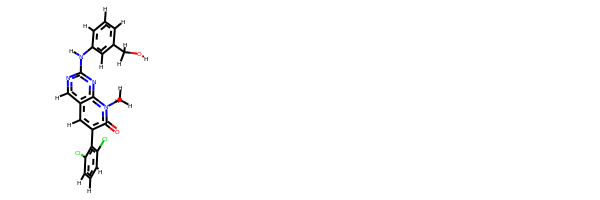

rdkit:  [H]OC([H])([H])c1c([H])c([H])c([H])c(N([H])c2nc([H])c3c([H])c(-c4c(Cl)c([H])c([H])c([H])c4Cl)c(=O)n(C([H])([H])[H])c3n2)c1[H]
oechem:  Cn1c2c(cc(c1=O)c3c(cccc3Cl)Cl)cnc(n2)Nc4cccc(c4)CO
###########################################################################
 #########################################################

bond
13.496912933332965 kJ/mol 57660.98842709163 kJ/mol False
angle
106.09753311790149 kJ/mol 106.09753311790149 kJ/mol True
nb
68.78518532666293 kJ/mol 68.78518532666293 kJ/mol True
torsion
25.94549110207101 kJ/mol 15.682405938131605 kJ/mol False
214.3251224799684 kJ/mol 57851.553551474324 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6243


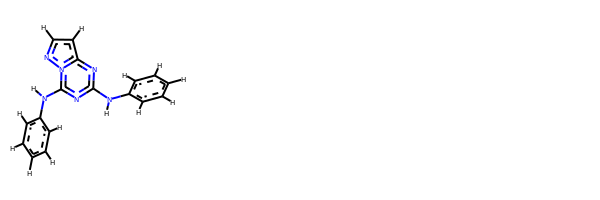

rdkit:  [H]c1nn2c(N([H])c3c([H])c([H])c([H])c([H])c3[H])nc(N([H])c3c([H])c([H])c([H])c([H])c3[H])nc2c1[H]
oechem:  c1ccc(cc1)Nc2nc3ccnn3c(n2)Nc4ccccc4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
19.88645865992423 kJ/mol 115689.86191380487 kJ/mol False
angle
183.89368132853198 kJ/mol 185.90441297187914 kJ/mol False
nb
36.14359888571326 kJ/mol 36.14359888571326 kJ/mol True
torsion
22.330933037076164 kJ/mol 10.478007360334699 kJ/mol False
262.2546719112456 kJ/mol 115922.3879330228 kJ/mol

----

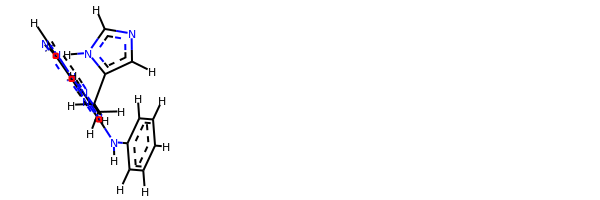

rdkit:  [H]c1nn2c(N([H])C([H])([H])C([H])([H])c3c([H])nc([H])n3[H])nc(N([H])c3c([H])c([H])c([H])c([H])c3[H])nc2c1C#N
oechem:  c1ccc(cc1)Nc2nc3c(cnn3c(n2)NCCc4cnc[nH]4)C#N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
23.159083090009197 kJ/mol 56902.56634262175 kJ/mol False
angle
31.147674343704633 kJ/mol 31.378649859074503 kJ/mol False
nb
75.16494842086978 kJ/mol 75.16494842086978 kJ/mol True
torsion
38.342462707113846 kJ/mol 21.606468993396156 kJ/mol False
167.81416856169744 kJ/mol 57030.716409895096 kJ/mol

-------------------------------------------------------------------
--------------------------------------------------

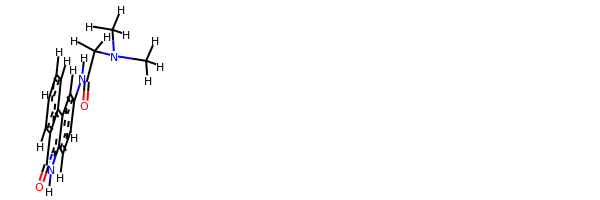

rdkit:  [H]c1c([H])c([H])c2c(c1[H])c(=O)n([H])c1c([H])c([H])c(N([H])C(=O)C([H])([H])N(C([H])([H])[H])C([H])([H])[H])c([H])c21
oechem:  CN(C)CC(=O)Nc1ccc2c(c1)c3ccccc3c(=O)[nH]2
###########################################################################
 #########################################################

bond
43.19300280778102 kJ/mol 86029.87473126873 kJ/mol False
angle
117.43015502882317 kJ/mol 117.43015502882317 kJ/mol True
nb
62.14933909063378 kJ/mol 62.14933909063378 kJ/mol True
torsion
177.62186337272541 kJ/mol 172.39201464836924 kJ/mol False
400.39436029996335 kJ/mol 86381.84624003657 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6251


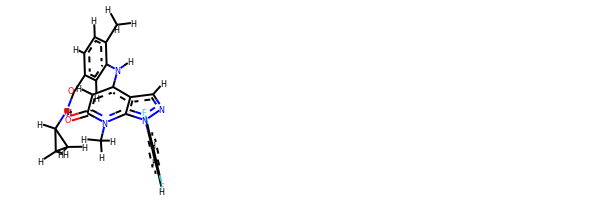

rdkit:  [H]c1c([H])c(-n2nc([H])c3c(N([H])c4c([H])c(C(=O)N([H])C5([H])C([H])([H])C5([H])[H])c([H])c([H])c4C([H])([H])[H])c([H])c(=O)n(C([H])([H])[H])c32)c(F)c([H])c1F
oechem:  Cc1ccc(cc1Nc2cc(=O)n(c3c2cnn3c4ccc(cc4F)F)C)C(=O)NC5CC5
###########################################################################
 #########################################################

bond
26.627739103831445 kJ/mol 57885.41395606134 kJ/mol False
angle
114.61287712006828 kJ/mol 115.99315764593797 kJ/mol False
nb
53.76840128028401 kJ/mol 53.76840128028401 kJ/mol True
torsion
44.81435069890102 kJ/mol 44.81508368731687 kJ/mol False
239.82336820308478 kJ/mol 58099.99059867488 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6252


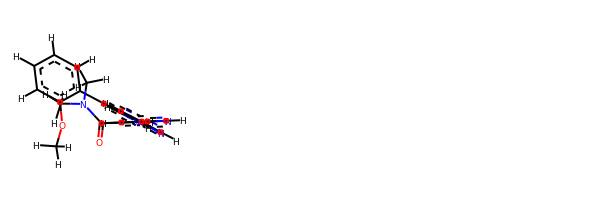

rdkit:  [H]c1nc([H])c(-c2c([H])nc3c(c2[H])c(-c2c([H])c([H])c([H])c([H])c2OC([H])([H])[H])c([H])n3[H])c([H])c1C(=O)N(C([H])([H])[H])C([H])([H])[H]
oechem:  CN(C)C(=O)c1cc(cnc1)c2cc3c(c[nH]c3nc2)c4ccccc4OC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
12.079727568886547 kJ/mol 101861.27241400599 kJ/mol False
angle
136.23053573963762 kJ/mol 139.3647181214362 kJ/mol False
nb
18.44991851820153 kJ/mol 18.44991851820153 kJ/mol True
torsion
38.55149333496164 kJ/mol 31.398224986386126 kJ/mol False
205.31167516168733 kJ/mol 102050.48527563202 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6254


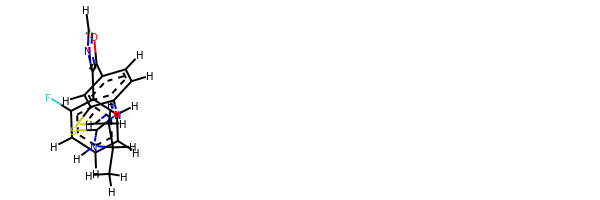

rdkit:  [H]c1nc(-c2c([H])c([H])c([H])c([H])c2F)c(-c2c([H])c([H])c3nc(N([H])C([H])(C([H])([H])[H])C([H])([H])[H])sc3c2[H])o1
oechem:  CC(C)Nc1nc2ccc(cc2s1)c3c(nco3)c4ccccc4F
###########################################################################
 #########################################################

bond
22.069826100349516 kJ/mol 57671.40203442955 kJ/mol False
angle
104.14335887579912 kJ/mol 104.14335887579912 kJ/mol True
nb
63.5177029953267 kJ/mol 63.5177029953267 kJ/mol True
torsion
29.394247150413804 kJ/mol 22.90603684242684 kJ/mol False
219.12513512188917 kJ/mol 57861.9691331431 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6255


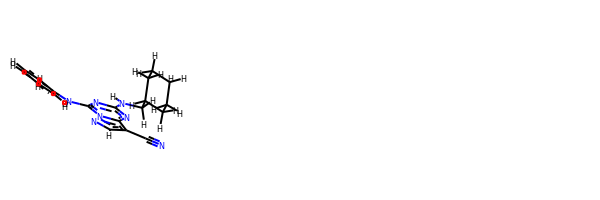

rdkit:  [H]c1nn2c(N([H])c3c([H])c([H])c([H])c([H])c3[H])nc(N([H])C([H])([H])C3([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C3([H])[H])nc2c1C#N
oechem:  c1ccc(cc1)Nc2nc(nc3n2ncc3C#N)NCC4CCCCC4
###########################################################################
 #########################################################

bond
18.21070003747025 kJ/mol 57667.42304465325 kJ/mol False
angle
101.25756430889993 kJ/mol 101.25756430889993 kJ/mol True
nb
66.88272805575602 kJ/mol 66.88272805575602 kJ/mol True
torsion
10.476364024268412 kJ/mol 5.246395830621514 kJ/mol False
196.8273564263946 kJ/mol 57840.809732848524 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6256


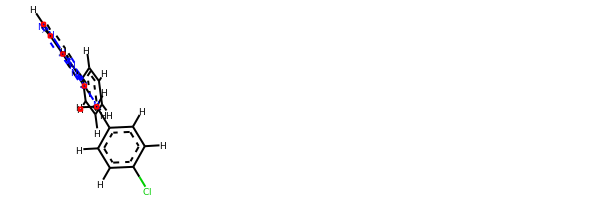

rdkit:  [H]c1nn2c(N([H])c3c([H])c([H])c([H])c([H])c3[H])nc(N([H])C([H])([H])c3c([H])c([H])c(Cl)c([H])c3[H])nc2c1C#N
oechem:  c1ccc(cc1)Nc2nc(nc3n2ncc3C#N)NCc4ccc(cc4)Cl
###########################################################################
 #########################################################

bond
20.18239790384228 kJ/mol 29156.296629315104 kJ/mol False
angle
138.22367789645784 kJ/mol 138.22367789645784 kJ/mol True
nb
61.659037249494055 kJ/mol 61.659037249494055 kJ/mol True
torsion
16.967778272211714 kJ/mol 11.84980515528609 kJ/mol False
237.0328913220059 kJ/mol 29368.02914961634 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6257


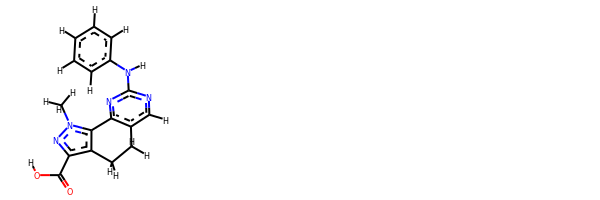

rdkit:  [H]OC(=O)c1nn(C([H])([H])[H])c2c1C([H])([H])C([H])([H])c1c([H])nc(N([H])c3c([H])c([H])c([H])c([H])c3[H])nc1-2
oechem:  Cn1c-2c(c(n1)C(=O)O)CCc3c2nc(nc3)Nc4ccccc4
###########################################################################
 #########################################################

bond
19.599711875429787 kJ/mol 29089.612395814434 kJ/mol False
angle
94.85159883215123 kJ/mol 96.57757125320374 kJ/mol False
nb
41.363470461281 kJ/mol 41.363470461281 kJ/mol True
torsion
27.206946656032713 kJ/mol 31.406090827150763 kJ/mol False
183.02172782489473 kJ/mol 29258.95952835607 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6258


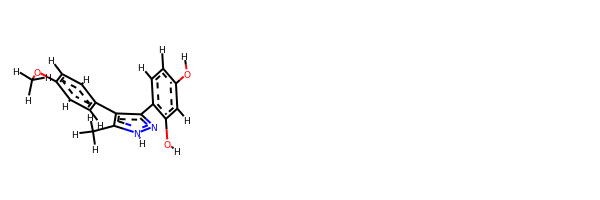

rdkit:  [H]Oc1c([H])c([H])c(-c2nn([H])c(C([H])([H])[H])c2-c2c([H])c([H])c(OC([H])([H])[H])c([H])c2[H])c(O[H])c1[H]
oechem:  Cc1c(c(n[nH]1)c2ccc(cc2O)O)c3ccc(cc3)OC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
20.55657715335175 kJ/mol 57925.65007370607 kJ/mol False
angle
100.93357944715777 kJ/mol 102.51729366266567 kJ/mol False
nb
54.46401131701 kJ/mol 54.46401131701 kJ/mol True
torsion
51.73321957567381 kJ/mol 50.314256173377395 kJ/mol False
227.68738749319334 kJ/mol 58132.94563485912 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6260


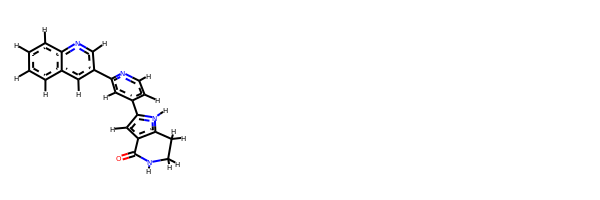

rdkit:  [H]c1nc(-c2c([H])nc3c([H])c([H])c([H])c([H])c3c2[H])c([H])c(-c2c([H])c3c(n2[H])C([H])([H])C([H])([H])N([H])C3=O)c1[H]
oechem:  c1ccc2c(c1)cc(cn2)c3cc(ccn3)c4cc5c([nH]4)CCNC5=O
###########################################################################
 #########################################################

bond
12.736893652145238 kJ/mol 43685.745922429334 kJ/mol False
angle
70.6864240227085 kJ/mol 74.04167610652942 kJ/mol False
nb
33.75060961708912 kJ/mol 33.75060961708912 kJ/mol True
torsion
7.317401890252966 kJ/mol 2.083208915848237 kJ/mol False
124.49132918219581 kJ/mol 43795.6214170688 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6261


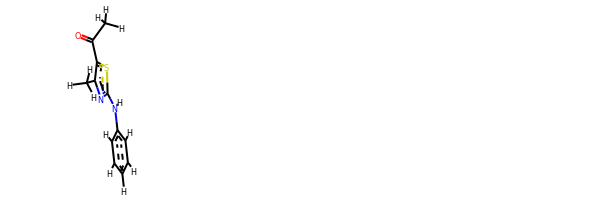

rdkit:  [H]c1c([H])c([H])c(N([H])c2nc(C([H])([H])[H])c(C(=O)C([H])([H])[H])s2)c([H])c1[H]
oechem:  Cc1c(sc(n1)Nc2ccccc2)C(=O)C
###########################################################################
 #########################################################

bond
21.971788037135887 kJ/mol 57671.186372298405 kJ/mol False
angle
102.93246041214813 kJ/mol 102.93246041214813 kJ/mol True
nb
109.16592262004295 kJ/mol 109.16592262004295 kJ/mol True
torsion
30.030618803069427 kJ/mol 15.0486289371082 kJ/mol False
264.1007898723964 kJ/mol 57898.33338426771 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6262


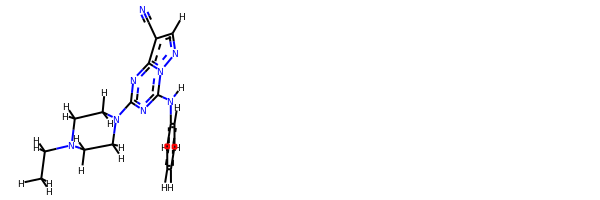

rdkit:  [H]c1nn2c(N([H])c3c([H])c([H])c([H])c([H])c3[H])nc(N3C([H])([H])C([H])([H])N(C([H])([H])C([H])([H])[H])C([H])([H])C3([H])[H])nc2c1C#N
oechem:  CCN1CCN(CC1)c2nc3c(cnn3c(n2)Nc4ccccc4)C#N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
25.457862175749963 kJ/mol 57674.67020679153 kJ/mol False
angle
125.69661887660058 kJ/mol 125.69661887660058 kJ/mol True
nb
88.92194386432854 kJ/mol 88.92194386432854 kJ/mol True
torsion
25.98809631117322 kJ/mol 15.701124191630878 kJ/mol False
266.0645212278523 kJ/mol 57904.989893724094 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6264


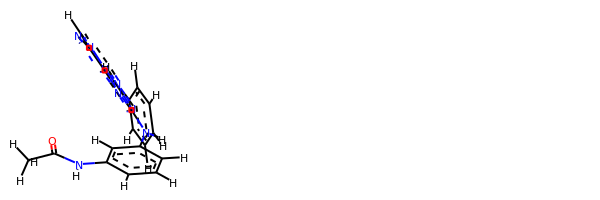

rdkit:  [H]c1nn2c(N([H])c3c([H])c([H])c([H])c([H])c3[H])nc(N([H])c3c([H])c([H])c([H])c(N([H])C(=O)C([H])([H])[H])c3[H])nc2c1C#N
oechem:  CC(=O)Nc1cccc(c1)Nc2nc3c(cnn3c(n2)Nc4ccccc4)C#N
###########################################################################
 #########################################################

bond
5.341517286500238 kJ/mol 57670.804067751975 kJ/mol False
angle
112.17240080148262 kJ/mol 112.17240080148262 kJ/mol True
nb
23.239265024476982 kJ/mol 23.239265024476982 kJ/mol True
torsion
0.06540555553364914 kJ/mol 0.06542353847341703 kJ/mol False
140.81858866799348 kJ/mol 57806.28115711641 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6265


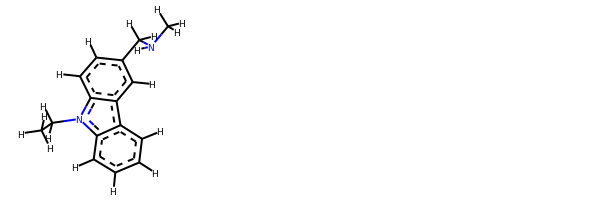

rdkit:  [H]c1c([H])c([H])c2c(c1[H])c1c([H])c(C([H])([H])N([H])C([H])([H])[H])c([H])c([H])c1n2C([H])([H])C([H])([H])[H]
oechem:  CCn1c2ccccc2c3c1ccc(c3)CNC
###########################################################################
 #########################################################

bond
28.51678528254944 kJ/mol 57758.42849402523 kJ/mol False
angle
188.652938176326 kJ/mol 188.652938176326 kJ/mol True
nb
25.43270695061508 kJ/mol 25.43270695061508 kJ/mol True
torsion
46.371826959985285 kJ/mol 31.77895194651321 kJ/mol False
288.97425736947577 kJ/mol 58004.29309109869 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6267


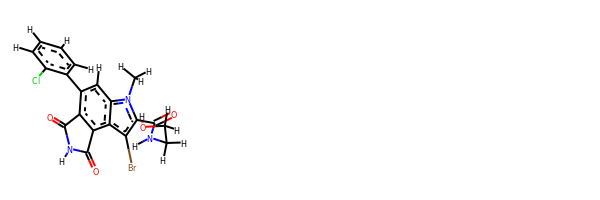

rdkit:  [H]OC([H])([H])C([H])([H])N([H])C(=O)c1c(Br)c2c3c(c(-c4c([H])c([H])c([H])c([H])c4Cl)c([H])c2n1C([H])([H])[H])C(=O)N([H])C3=O
oechem:  Cn1c2cc(c3c(c2c(c1C(=O)NCCO)Br)C(=O)NC3=O)c4ccccc4Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
5.22078832525592 kJ/mol 58025.9114188972 kJ/mol False
angle
85.96845139929265 kJ/mol 85.96845139929265 kJ/mol True
nb
38.08833256214827 kJ/mol 38.08833256214827 kJ/mol True
torsion
25.551961408659956 kJ/mol 5.229385954907095 kJ/mol False
154.82953369535682

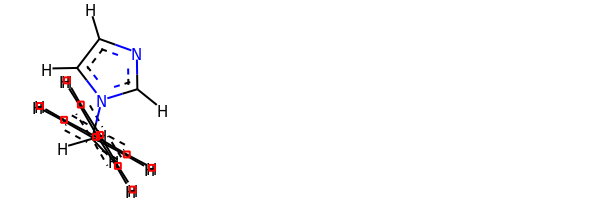

rdkit:  [H]c1nc([H])n(C([H])([H])c2c([H])c([H])c(-c3c([H])c([H])c([H])c([H])c3[H])c([H])c2[H])c1[H]
oechem:  c1ccc(cc1)c2ccc(cc2)Cn3ccnc3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
32.708014606617716 kJ/mol 43702.663889326

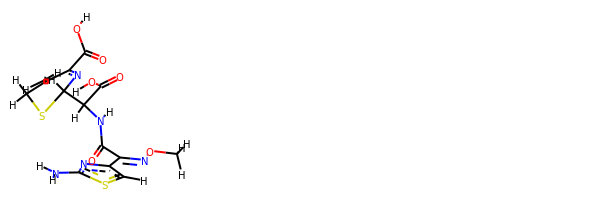

rdkit:  [H]OC(=O)C1=NC([H])(C([H])(C(=O)O[H])N([H])C(=O)C(=NOC([H])([H])[H])c2nc(N([H])[H])sc2[H])SC([H])([H])C1=C([H])[H]
oechem:  CON=C(c1csc(n1)N)C(=O)NC(C2N=C(C(=C)CS2)C(=O)O)C(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
19.40338370810939 kJ/mol 28870.091449929103 kJ/mol False
angle
15.56271231772086 kJ/mol 16.356501678276057 kJ/mol False
nb
48.67679176367167 kJ/mol 48.67679176367167 kJ/mol True
torsion
43.94538483349737 kJ/mol 21.97939486450717 kJ/mol False
127.5882726229993 kJ/mo

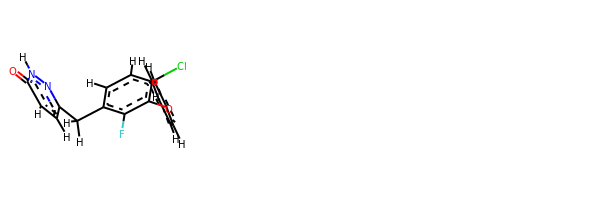

rdkit:  [H]c1c([H])c([H])c(Oc2c(F)c(C([H])([H])c3nn([H])c(=O)c([H])c3[H])c([H])c([H])c2Cl)c([H])c1[H]
oechem:  c1ccc(cc1)Oc2c(ccc(c2F)Cc3ccc(=O)[nH]n3)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
27.600912711472702 kJ/mol 101834.40640955581 kJ/mol False
angle
110.46306472751898 kJ/mol 114.62588411309954 kJ/mol False
nb
63.56906185087371 kJ/mol 63.56906185087371 kJ/mol True
torsion
31.374511650273682 kJ/mol 31.374807944599997 kJ/mol False
233.00755094013908 kJ/mol 102043.97616346438 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6283


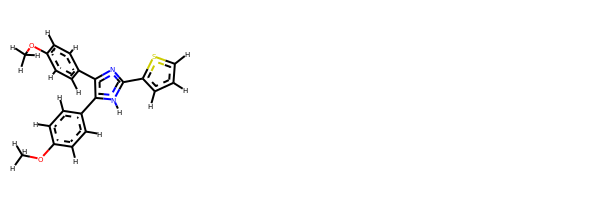

rdkit:  [H]c1sc(-c2nc(-c3c([H])c([H])c(OC([H])([H])[H])c([H])c3[H])c(-c3c([H])c([H])c(OC([H])([H])[H])c([H])c3[H])n2[H])c([H])c1[H]
oechem:  COc1ccc(cc1)c2c(nc([nH]2)c3cccs3)c4ccc(cc4)OC
###########################################################################
 #########################################################

bond
25.1222025589709 kJ/mol 29095.215921332227 kJ/mol False
angle
106.9440589012996 kJ/mol 108.58128873894232 kJ/mol False
nb
71.51921733004068 kJ/mol 71.51921733004068 kJ/mol True
torsion
16.869788869974794 kJ/mol 15.716354449432597 kJ/mol False
220.45526766028598 kJ/mol 29291.032781850645 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6284


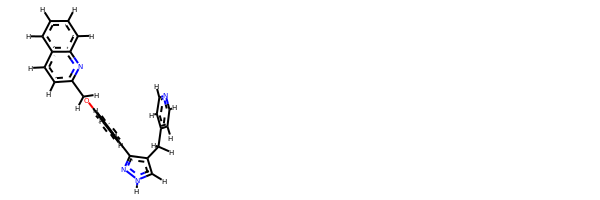

rdkit:  [H]c1nc([H])c([H])c(C([H])([H])c2c(-c3c([H])c([H])c(OC([H])([H])c4nc5c([H])c([H])c([H])c([H])c5c([H])c4[H])c([H])c3[H])nn([H])c2[H])c1[H]
oechem:  c1ccc2c(c1)ccc(n2)COc3ccc(cc3)c4c(c[nH]n4)Cc5ccncc5
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
22.47011343868825 kJ/mol 29090.579742271195 kJ/mol False
angle
106.44123018255976 kJ/mol 108.09596170679269 kJ/mol False
nb
74.97781094161438 kJ/mol 74.97781094161438 kJ/mol True
torsion
27.221131697973945 kJ/mol 31.403298812498473 kJ/mol False
231.11028626083635 kJ/mol 29305.056813732102 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6286


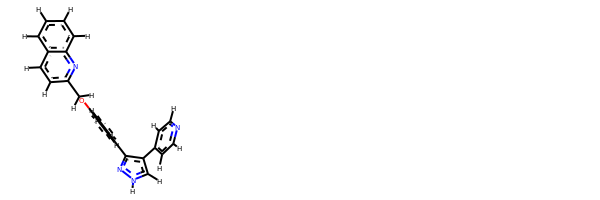

rdkit:  [H]c1nc([H])c([H])c(-c2c(-c3c([H])c([H])c(OC([H])([H])c4nc5c([H])c([H])c([H])c([H])c5c([H])c4[H])c([H])c3[H])nn([H])c2[H])c1[H]
oechem:  c1ccc2c(c1)ccc(n2)COc3ccc(cc3)c4c(c[nH]n4)c5ccncc5
###########################################################################
 #########################################################

bond
23.618331788974068 kJ/mol 29093.49324915936 kJ/mol False
angle
105.46375043856835 kJ/mol 105.46375043856835 kJ/mol True
nb
74.33820115767702 kJ/mol 74.33820115767702 kJ/mol True
torsion
27.22092396476535 kJ/mol 31.402543509790217 kJ/mol False
230.6412073499848 kJ/mol 29304.697744265395 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6287


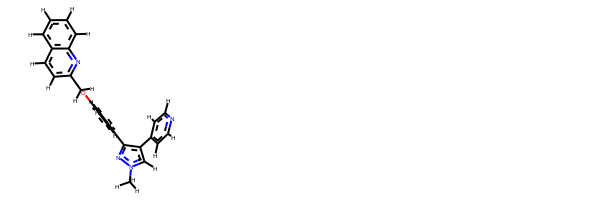

rdkit:  [H]c1nc([H])c([H])c(-c2c(-c3c([H])c([H])c(OC([H])([H])c4nc5c([H])c([H])c([H])c([H])c5c([H])c4[H])c([H])c3[H])nn(C([H])([H])[H])c2[H])c1[H]
oechem:  Cn1cc(c(n1)c2ccc(cc2)OCc3ccc4ccccc4n3)c5ccncc5
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
29.58744083473657 kJ/mol 58285.464046564026 kJ/mol False
angle
123.84120254177596 kJ/mol 123.84120254177596 kJ/m

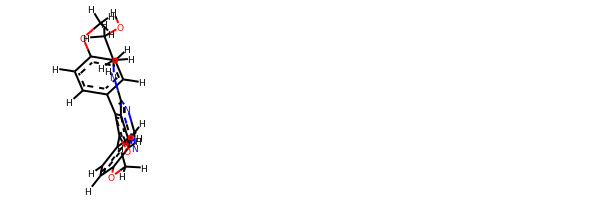

rdkit:  [H]OC([H])([H])C([H])([H])N([H])c1nc([H])nc2oc(-c3c([H])c([H])c(OC([H])([H])[H])c([H])c3[H])c(-c3c([H])c([H])c(OC([H])([H])[H])c([H])c3[H])c12
oechem:  COc1ccc(cc1)c2c3c(ncnc3oc2c4ccc(cc4)OC)NCCO
###########################################################################
 #########################################################

bond
15.50377964686481 kJ/mol 58271.38038537615 kJ/mol False
angle
121.6108109324477 kJ/mol 121.6108109324477 kJ/mol True
nb
33.85424683656415 kJ/mol 33.85424683656415 kJ/mol True
torsion
38.21052310490729 kJ/mol 38.210538485365625 kJ/mol False
209.17936052078394 kJ/mol 58465.055981630525 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6293


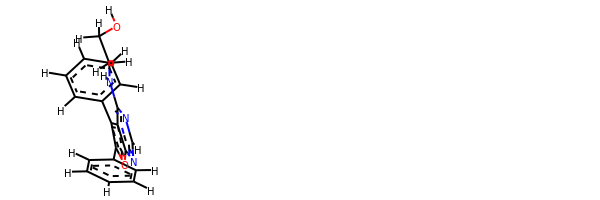

rdkit:  [H]OC([H])([H])C([H])([H])N([H])c1nc([H])nc2oc(-c3c([H])c([H])c([H])c([H])c3[H])c(-c3c([H])c([H])c([H])c([H])c3[H])c12
oechem:  c1ccc(cc1)c2c3c(ncnc3oc2c4ccccc4)NCCO
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
29.702949240546687 kJ/mol 86430.1806311083 kJ/mol False
angle
105.93122976850194 kJ/mol 105.93122976850194 kJ/mol True
nb
29.01320642394367 kJ/mol 29.01320642394367 kJ/mol True
torsion
76.64779185858914 kJ/mol 66.87104924281853 kJ/mol False
241.29517729158144 kJ/mol 86631.99611654357 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6295


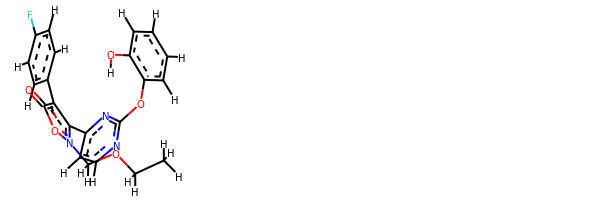

rdkit:  [H]Oc1c([H])c([H])c([H])c([H])c1Oc1nc([H])c([H])c(-c2c(-c3c([H])c([H])c(F)c([H])c3[H])c(=O)on2C([H])([H])OC([H])([H])C([H])([H])[H])n1
oechem:  CCOCn1c(c(c(=O)o1)c2ccc(cc2)F)c3ccnc(n3)Oc4ccccc4O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
7.213757970824721 kJ/mol 57947.65972259197 kJ/mol False
angle
97.0904623978524 kJ/mol 97.0904623978524 kJ/mol True
nb
43.54433063287169 kJ/mol 43.54433063287169 kJ/mol True
torsion
22.21726498447403 kJ/mol 5.387905658570992 kJ/mol False
170.06581598602284 kJ/mol 58093.682421281264 kJ/mol

-------------------------------------------------------------------
--------------------------

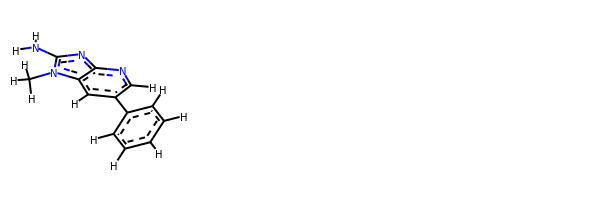

rdkit:  [H]c1nc2nc(N([H])[H])n(C([H])([H])[H])c2c([H])c1-c1c([H])c([H])c([H])c([H])c1[H]
oechem:  Cn1c2cc(cnc2nc1N)c3ccccc3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

############################################################

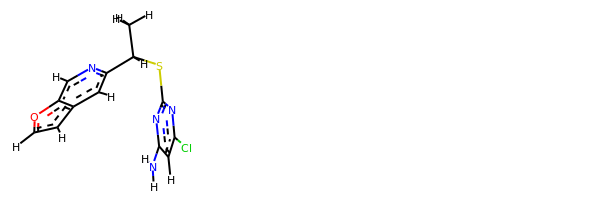

rdkit:  [H]c1oc2c([H])nc(C([H])(Sc3nc(Cl)c([H])c(N([H])[H])n3)C([H])([H])[H])c([H])c2c1[H]
oechem:  CC(c1cc2ccoc2cn1)Sc3nc(cc(n3)Cl)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

##################################################

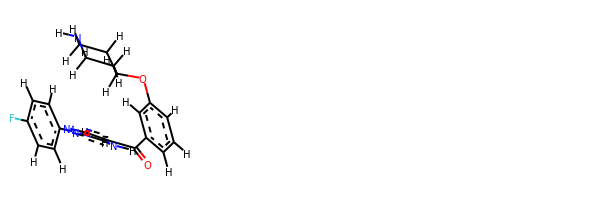

rdkit:  [H]c1nn(-c2c([H])c([H])c(F)c([H])c2[H])c(N([H])[H])c1C(=O)c1c([H])c([H])c([H])c(OC2([H])C([H])([H])C([H])([H])N([H])C([H])([H])C2([H])[H])c1[H]
oechem:  c1cc(cc(c1)OC2CCNCC2)C(=O)c3cnn(c3N)c4ccc(cc4)F
###########################################################################
 #########################################################

bond
26.027963384774228 kJ/mol 29096.700444112717 kJ/mol False
angle
100.7048411487089 kJ/mol 100.7048411487089 kJ/mol True
nb
38.81217039673158 kJ/mol 38.81217039673158 kJ/mol True
torsion
57.62697237557844 kJ/mol 49.88657558619415 kJ/mol False
223.17194730579314 kJ/mol 29286.10403124435 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6322


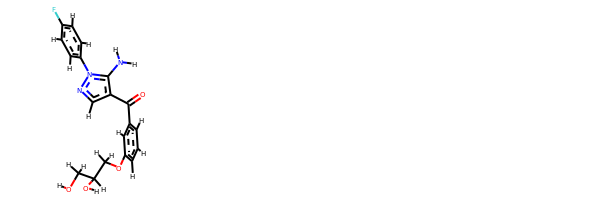

rdkit:  [H]OC([H])([H])C([H])(O[H])C([H])([H])Oc1c([H])c([H])c([H])c(C(=O)c2c([H])nn(-c3c([H])c([H])c(F)c([H])c3[H])c2N([H])[H])c1[H]
oechem:  c1cc(cc(c1)OCC(CO)O)C(=O)c2cnn(c2N)c3ccc(cc3)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
19.87207945965835 kJ/mol 101541.35943563272 kJ/mol False
angle
415.6324299975505 kJ/mol 418.7973262279257 kJ/mol False
nb
-1.8629221095203392 kJ/mol -1.8629221095203392 kJ/mol True
torsion
149.2477732582914 kJ/mol 124.66824069990236 kJ/mol False
582.88936060598 kJ/mol 102082.96208045103 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6324


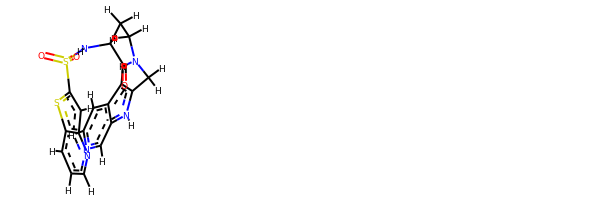

rdkit:  [H]c1nc2c([H])c(S(=O)(=O)N([H])C3([H])C(=O)N(C([H])([H])c4c([H])c5c([H])c([H])nc([H])c5n4[H])C([H])([H])C3([H])[H])sc2c([H])c1[H]
oechem:  c1cc2c(cc(s2)S(=O)(=O)NC3CCN(C3=O)Cc4cc5ccncc5[nH]4)nc1
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ########################################

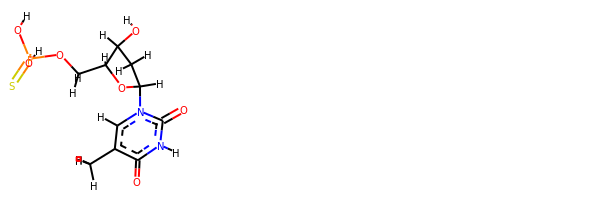

rdkit:  [H]OC1([H])C([H])([H])C([H])(n2c([H])c(C([H])([H])[H])c(=O)n([H])c2=O)OC1([H])C([H])([H])OP(=S)(O[H])O[H]
oechem:  Cc1cn(c(=O)[nH]c1=O)C2CC(C(O2)COP(=S)(O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
29.82081811897687 kJ/mol 58011.22600439275 kJ/mol False
angle
237.29784131472002 kJ/mol 237.29784131472002 kJ/mol True
nb
33.30769724377765 kJ/mol 33.30769724377765 kJ/mol True
torsion
23.903390021752056 kJ/mol 21.167859504449243 kJ/mol False
324.3297466992266 kJ/mol 58302.9994024557

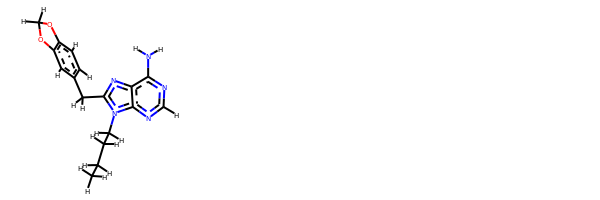

rdkit:  [H]c1nc(N([H])[H])c2nc(C([H])([H])c3c([H])c([H])c4c(c3[H])OC([H])([H])O4)n(C([H])([H])C([H])([H])C([H])([H])C([H])([H])[H])c2n1
oechem:  CCCCn1c(nc2c1ncnc2N)Cc3ccc4c(c3)OCO4
###########################################################################
 #########################################################

bond
39.07104773062306 kJ/mol 58022.40812729015 kJ/mol False
angle
419.11155526840224 kJ/mol 419.11155526840224 kJ/mol True
nb
62.11596094101906 kJ/mol 62.11596094101906 kJ/mol True
torsion
116.66722678493937 kJ/mol 92.6928866965467 kJ/mol False
636.9657907249837 kJ/mol 58596.328530196115 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6335


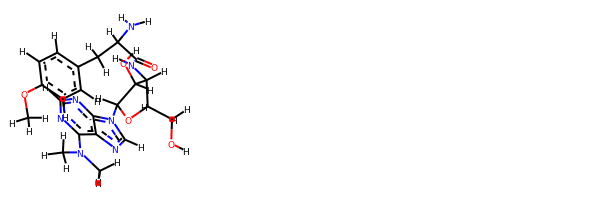

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])nc3c(N(C([H])([H])[H])C([H])([H])[H])nc([H])nc32)C([H])(O[H])C1([H])N([H])C(=O)C([H])(N([H])[H])C([H])([H])c1c([H])c([H])c(OC([H])([H])[H])c([H])c1[H]
oechem:  CN(C)c1c2c(ncn1)n(cn2)C3C(C(C(O3)CO)NC(=O)C(Cc4ccc(cc4)OC)N)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
34.5145489813775 kJ/mol 57751.43897036549 kJ/mol False
angle
120.10662012420427 kJ/mol 120.10662012420427 kJ/mol True
nb
11.187549438732853 kJ/mol 11.187549438732853 kJ/mol True
torsion
89.84937308774202 kJ/mol 99.26381478452707 kJ/mol False
255.65809163205665 kJ/mol 57981.99695471296 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------

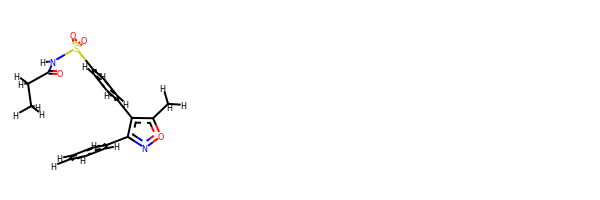

rdkit:  [H]c1c([H])c([H])c(-c2noc(C([H])([H])[H])c2-c2c([H])c([H])c(S(=O)(=O)N([H])C(=O)C([H])([H])C([H])([H])[H])c([H])c2[H])c([H])c1[H]
oechem:  CCC(=O)NS(=O)(=O)c1ccc(cc1)c2c(onc2c3ccccc3)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
18.759222306922123 kJ/mol 57364.037104653224 kJ/mol False
angle
85.23806473507321 kJ/mol 85.23806473507321 kJ/mol True
nb
10.999040218722 kJ/mol 10.999040218722 kJ/mol True
torsion
8.444193210641387 kJ/mol 8.492741386263493 kJ/mol False
123.44052047135872 kJ

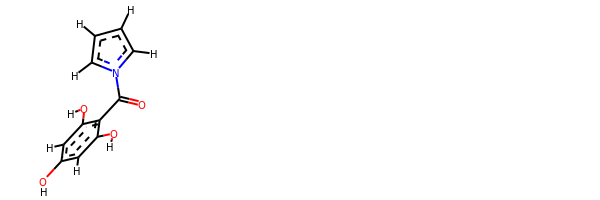

rdkit:  [H]Oc1c([H])c(O[H])c(C(=O)n2c([H])c([H])c([H])c2[H])c(O[H])c1[H]
oechem:  c1ccn(c1)C(=O)c2c(cc(cc2O)O)O
###########################################################################
 #########################################################

bond
25.249009565424647 kJ/mol 29139.41893357612 kJ/mol False
angle
107.51768444921161 kJ/mol 109.2645667881558 kJ/mol False
nb
45.37857455743188 kJ/mol 45.37857455743188 kJ/mol True
torsion
27.206822187104837 kJ/mol 21.977065692528885 kJ/mol False
205.352090759173 kJ/mol 29316.039140614233 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6342


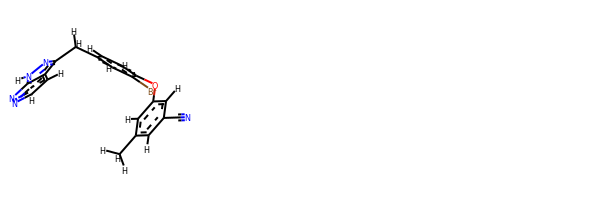

rdkit:  [H]c1nnc2c(c(C([H])([H])c3c([H])c([H])c(Oc4c([H])c(C#N)c([H])c(C([H])([H])[H])c4[H])c(Br)c3[H])nn2[H])c1[H]
oechem:  Cc1cc(cc(c1)Oc2ccc(cc2Br)Cc3c4ccnnc4[nH]n3)C#N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
25.052672125405522 kJ/mol 29141.254866552903 kJ/mol False
angle
106.67690488208528 kJ/mol 108.4224226841047 kJ/mol False
nb
46.24304831027065 kJ/mol 46.24304831027065 kJ/mol True
torsion
27.20179241227705 kJ/mol 21.972007492937973 kJ/mol False
205.1744177300385 kJ/mol 29317.892345040214 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6344


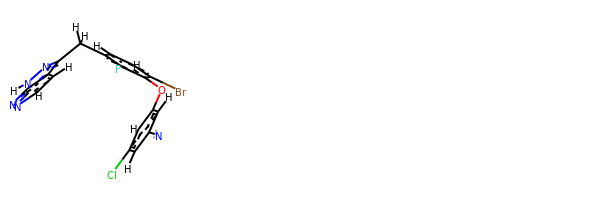

rdkit:  [H]c1nnc2c(c(C([H])([H])c3c([H])c([H])c(Br)c(Oc4c([H])c(Cl)c([H])c(C#N)c4[H])c3F)nn2[H])c1[H]
oechem:  c1cc(c(c(c1Cc2c3ccnnc3[nH]n2)F)Oc4cc(cc(c4)Cl)C#N)Br
###########################################################################
 #########################################################

bond
8.180951724789423 kJ/mol 57760.08629839161 kJ/mol False
angle
87.05122038654231 kJ/mol 88.28124604948182 kJ/mol False
nb
13.028820511874121 kJ/mol 13.028820511874121 kJ/mol True
torsion
7.6436879163736835 kJ/mol 7.64372019129423 kJ/mol False
115.90468053957953 kJ/mol 57869.04008514426 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6345


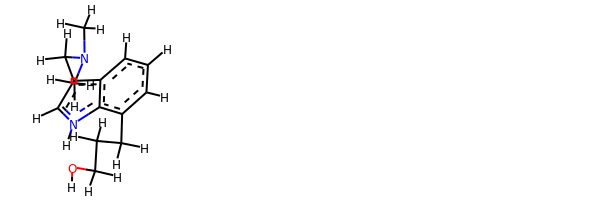

rdkit:  [H]OC([H])([H])C([H])([H])C([H])([H])c1c([H])c([H])c([H])c2c(C([H])([H])N(C([H])([H])[H])C([H])([H])[H])c([H])n([H])c12
oechem:  CN(C)Cc1c[nH]c2c1cccc2CCCO
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
14.291115238768572 kJ/mol 101477.69368883569 kJ/mol False
angle
145.06432799846607 kJ/mol 148.19662294299917 kJ/mol False
nb
19.047623449679215 kJ/mol 19.047623449679215 kJ/mol True
torsion
29.599228661844975 kJ/mol 0.0005841556796019509 kJ/mol False
208.00229534875885 kJ/mol 101644.93851938404 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6347


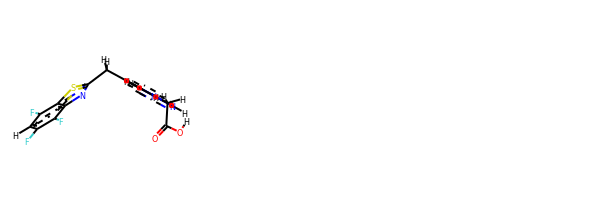

rdkit:  [H]OC(=O)C([H])([H])n1c([H])c(C([H])([H])c2nc3c(F)c(F)c([H])c(F)c3s2)c2c([H])c([H])c([H])nc21
oechem:  c1cc2c(cn(c2nc1)CC(=O)O)Cc3nc4c(c(cc(c4s3)F)F)F
###########################################################################
 #########################################################

bond
13.664576594477646 kJ/mol 28974.033270336953 kJ/mol False
angle
132.97991248010163 kJ/mol 134.54489202902278 kJ/mol False
nb
84.94113176669278 kJ/mol 84.94113176669278 kJ/mol True
torsion
15.681911285108132 kJ/mol 10.451961997897946 kJ/mol False
247.26753212638016 kJ/mol 29203.971256130564 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6348


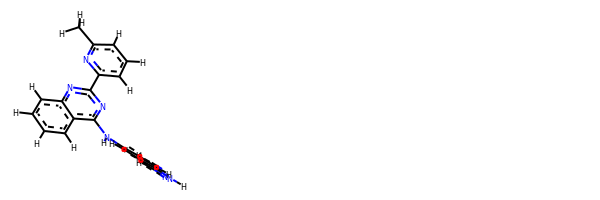

rdkit:  [H]c1c(-c2nc(N([H])c3c([H])c([H])c4c(c([H])nn4[H])c3[H])c3c([H])c([H])c([H])c([H])c3n2)nc(C([H])([H])[H])c([H])c1[H]
oechem:  Cc1cccc(n1)c2nc3ccccc3c(n2)Nc4ccc5c(c4)cn[nH]5
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
16.328245153786487 kJ/mol 29084.405612640672 kJ/mol False
angle
122.30690367484297 kJ/mol 124.01503006479867 kJ/mol False
nb
57.692656393257586 kJ/mol 57.692656393257586 kJ/mol True
torsion
15.699297531914777 kJ/mol 10.468727879391068 kJ/mol False
212.0271027538018 kJ/mol 29276.582026978118 kJ/mol

-------------------------------------------------------------------
--------------------------------------

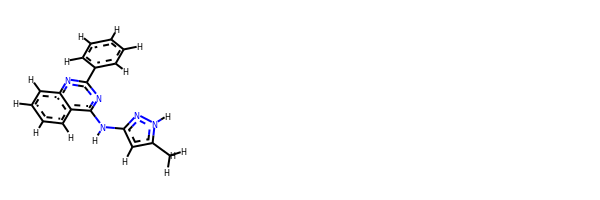

rdkit:  [H]c1c([H])c([H])c(-c2nc(N([H])c3nn([H])c(C([H])([H])[H])c3[H])c3c([H])c([H])c([H])c([H])c3n2)c([H])c1[H]
oechem:  Cc1cc(n[nH]1)Nc2c3ccccc3nc(n2)c4ccccc4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
27.39738005382342 kJ/mol 115866.1918391088 kJ/mol False
angle
119.18492798978006 kJ/mol 119.5206617372347 kJ/mol False
nb
40.19543435985482 kJ/mol 40.19543435985482 kJ/mol True
torsion
38.455997101718694 kJ/mol 21.909658283863447 kJ/mol False
225.233739505177 kJ/mol 116047.81759348974 kJ/mol

-------------------------------------------------------------------
---------------------------------------------------------------

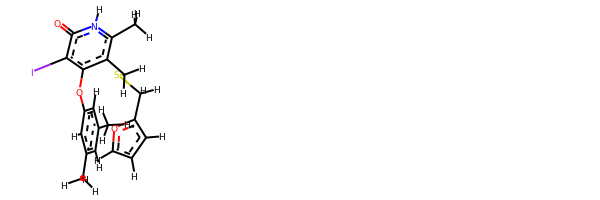

rdkit:  [H]c1oc(C([H])([H])SC([H])([H])c2c(Oc3c([H])c(C([H])([H])[H])c([H])c(C([H])([H])[H])c3[H])c(I)c(=O)n([H])c2C([H])([H])[H])c([H])c1[H]
oechem:  Cc1cc(cc(c1)Oc2c(c([nH]c(=O)c2I)C)CSCc3ccco3)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
31.133371670261173 kJ/mol 29103.235535924858 kJ/mol False
angle
108.30646016245652 kJ/mol 109.9904729518574 kJ/mol False
nb
64.74722195762648 kJ/mol 64.74722195762648 kJ/mol True
torsion
27.267590618863785 kJ/mol 22.037611224466833 kJ/mol False
231.45464440920796 kJ/mol 29300.010842058808 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6356


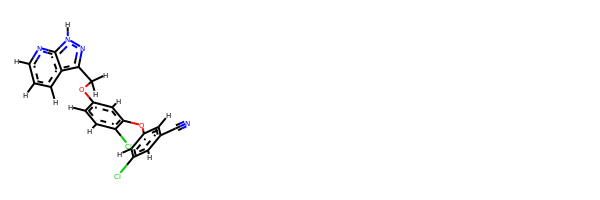

rdkit:  [H]c1nc2c(c(C([H])([H])Oc3c([H])c([H])c(Cl)c(Oc4c([H])c(Cl)c([H])c(C#N)c4[H])c3[H])nn2[H])c([H])c1[H]
oechem:  c1cc2c(n[nH]c2nc1)COc3ccc(c(c3)Oc4cc(cc(c4)Cl)C#N)Cl
###########################################################################
 #########################################################

bond
34.95995882478798 kJ/mol 29109.026287043635 kJ/mol False
angle
108.64043840002235 kJ/mol 110.32051448252119 kJ/mol False
nb
64.07466215320085 kJ/mol 64.07466215320085 kJ/mol True
torsion
27.43344539715609 kJ/mol 22.2034459346429 kJ/mol False
235.10850477516726 kJ/mol 29305.624909614 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6357


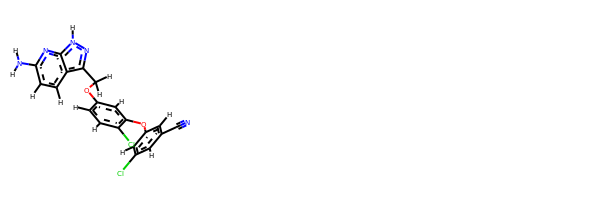

rdkit:  [H]c1c([H])c(OC([H])([H])c2nn([H])c3nc(N([H])[H])c([H])c([H])c23)c([H])c(Oc2c([H])c(Cl)c([H])c(C#N)c2[H])c1Cl
oechem:  c1cc(c(cc1OCc2c3ccc(nc3[nH]n2)N)Oc4cc(cc(c4)Cl)C#N)Cl
###########################################################################
 #########################################################

bond
17.0441804343464 kJ/mol 29101.386256377922 kJ/mol False
angle
122.5898802165158 kJ/mol 122.5898802165158 kJ/mol True
nb
41.31743905134817 kJ/mol 41.31743905134817 kJ/mol True
torsion
5.53735899418926 kJ/mol 0.30773034354470163 kJ/mol False
186.4888586963996 kJ/mol 29265.601305989334 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6358


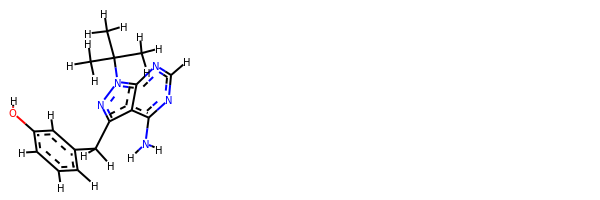

rdkit:  [H]Oc1c([H])c([H])c([H])c(C([H])([H])c2nn(C(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H])c3nc([H])nc(N([H])[H])c23)c1[H]
oechem:  CC(C)(C)n1c2c(c(n1)Cc3cccc(c3)O)c(ncn2)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
12.506630485894279 kJ/mol 57992.30812836627 kJ/mol False
angle
125.07287032428127 kJ/mol 125.07287032428127 kJ/mol True
nb
60.273222698853225 kJ/mol 60.273222698853225 kJ/mol True
torsion
42.71353272392174 kJ/mol 28.339821929588098 kJ/mol False
240.5662562329505 kJ/mol 58205.994043318984 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6360


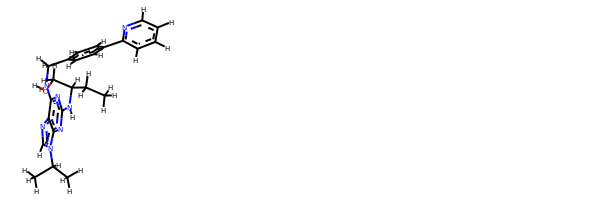

rdkit:  [H]OC([H])([H])C([H])(N([H])c1nc(N([H])C([H])([H])c2c([H])c([H])c(-c3nc([H])c([H])c([H])c3[H])c([H])c2[H])c2nc([H])n(C([H])(C([H])([H])[H])C([H])([H])[H])c2n1)C([H])([H])C([H])([H])[H]
oechem:  CCC(CO)Nc1nc(c2c(n1)n(cn2)C(C)C)NCc3ccc(cc3)c4ccccn4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
30.83503689419281 kJ/mol 101275.39943946627 kJ/mol False
ang

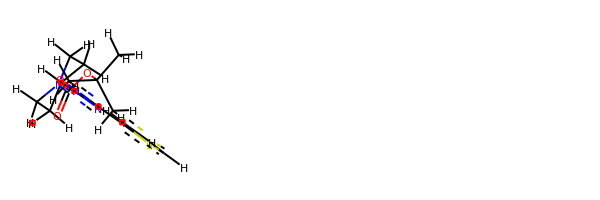

rdkit:  [H]c1sc(-c2noc(C3([H])C([H])([H])C([H])([H])N(C(=O)OC(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H])C([H])([H])C3([H])[H])n2)c([H])c1[H]
oechem:  CC(C)(C)OC(=O)N1CCC(CC1)c2nc(no2)c3cccs3
###########################################################################
 #########################################################

bond
7.8180630411487515 kJ/mol 58246.82215895439 kJ/mol False
angle
73.71232049865162 kJ/mol 76.34317660081291 kJ/mol False
nb
31.124363405103484 kJ/mol 31.124363405103484 kJ/mol True
torsion
4.184739324533905 kJ/mol 10.458880434105508 kJ/mol False
116.83948626943776 kJ/mol 58364.748579394414 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6366


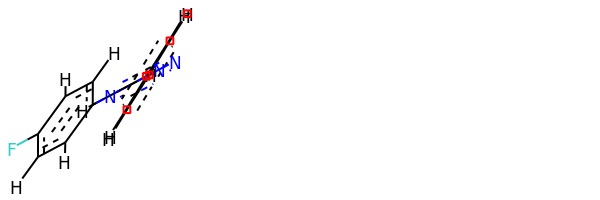

rdkit:  [H]c1c([H])c([H])c(-c2nnc(-c3c([H])c([H])c(F)c([H])c3[H])n2[H])c([H])c1[H]
oechem:  c1ccc(cc1)c2[nH]c(nn2)c3ccc(cc3)F
###########################################################################
 #########################################################

bond
30.780005916750916 kJ/mol 145058.87208783452 kJ/mol False
angle
160.43809115150975 kJ/mol 164.74417280219518 kJ/mol False
nb
18.646399271385896 kJ/mol 18.646399271385896 kJ/mol True
torsion
19.62603837433202 kJ/mol 13.296155243133908 kJ/mol False
229.49053471397858 kJ/mol 145255.55881515122 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6367


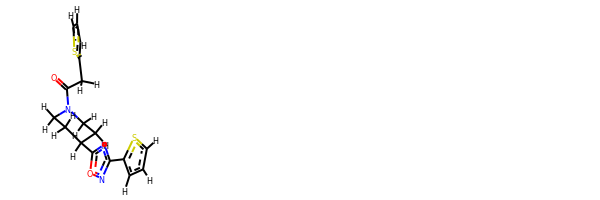

rdkit:  [H]c1sc(-c2noc(C3([H])C([H])([H])C([H])([H])N(C(=O)C([H])([H])c4sc([H])c([H])c4[H])C([H])([H])C3([H])[H])n2)c([H])c1[H]
oechem:  c1cc(sc1)CC(=O)N2CCC(CC2)c3nc(no3)c4cccs4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
18.883848320859197 kJ/mol 57933.58237896423 kJ/mol False
angle
379.6750715435355 kJ/mol 379.6750715435355 kJ/mol True
nb
7.144785493894555 kJ/mol 7.144785493894555 kJ/mol True
torsion
87.58851218148166 kJ/mol 63.47175456322623 kJ/mol False
493.29221753977095 kJ/mol 58383.87399056488 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6369


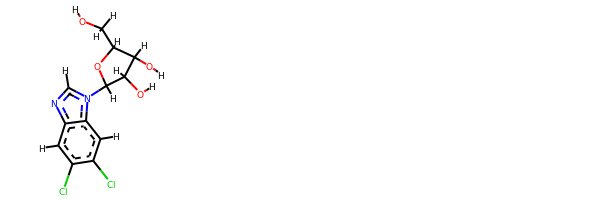

rdkit:  [H]OC([H])([H])C1([H])OC([H])(n2c([H])nc3c([H])c(Cl)c(Cl)c([H])c32)C([H])(O[H])C1([H])O[H]
oechem:  c1c2c(cc(c1Cl)Cl)n(cn2)C3C(C(C(O3)CO)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
60.22517420781116 kJ/mol 43847.245452809795 kJ/mol False
angle
229.26432004467324 kJ/mol 231.41650104078946 kJ/mol False
nb
71.01607885754758 kJ/mol 71.01607885754758 kJ/mol True
torsion
62.40780085475502 kJ/mol 59.89358427803837 kJ/mol False
422.913373964787 kJ/mol 44209.57161698617 kJ/mol

---------

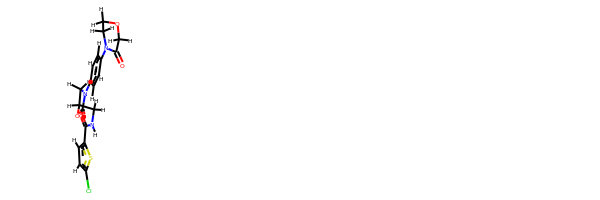

rdkit:  [H]c1c(Cl)sc(C(=O)N([H])C([H])([H])C2([H])OC(=O)N(c3c([H])c([H])c(N4C(=O)C([H])([H])OC([H])([H])C4([H])[H])c([H])c3[H])C2([H])[H])c1[H]
oechem:  c1cc(ccc1N2CCOCC2=O)N3CC(OC3=O)CNC(=O)c4ccc(s4)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
20.367704382051723 kJ/mol 58386.599471194946 kJ/mol False
angle
131.42567639620094 kJ/mol 131.42567639620094 kJ/mol True
nb
24.15252780173038 kJ/mol 24.15252780173038 kJ/mol True
torsion
75.8245129586751 kJ/mol 75.82450561233789 kJ/mol False
251.77042153865816 kJ/mol 58618.00218100522 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6377


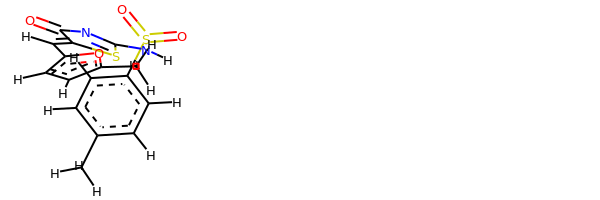

rdkit:  [H]C(=C1SC(N([H])S(=O)(=O)c2c([H])c([H])c(C([H])([H])[H])c([H])c2[H])=NC1=O)c1oc(C([H])([H])[H])c([H])c1[H]
oechem:  Cc1ccc(cc1)S(=O)(=O)NC2=NC(=O)C(=Cc3ccc(o3)C)S2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
21.358680496645682 kJ/mol 101560.56868255729 kJ/mol False
angle
149.37940438219655 kJ/mol 152.7726443626324 kJ/mol False
nb
16.830701308314648

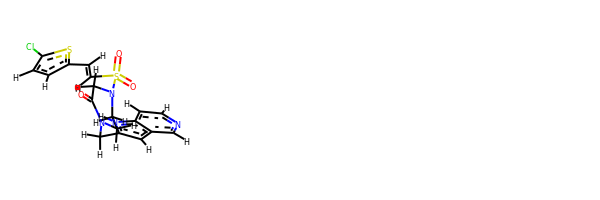

rdkit:  [H]C(=C([H])S(=O)(=O)N1C([H])([H])C(=O)N(C([H])([H])c2c([H])c3c([H])nc([H])c([H])c3n2[H])C([H])([H])C1([H])[H])c1sc(Cl)c([H])c1[H]
oechem:  c1cc(sc1C=CS(=O)(=O)N2CCN(C(=O)C2)Cc3cc4cnccc4[nH]3)Cl
###########################################################################
 #########################################################

bond
22.085136025753652 kJ/mol 57652.636583275125 kJ/mol False
angle
173.49385127439373 kJ/mol 173.49385127439373 kJ/mol True
nb
8.485808296119487 kJ/mol 8.485808296119487 kJ/mol True
torsion
49.473009742617194 kJ/mol 49.88862298733413 kJ/mol False
253.53780533888408 kJ/mol 57884.50486583297 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6384


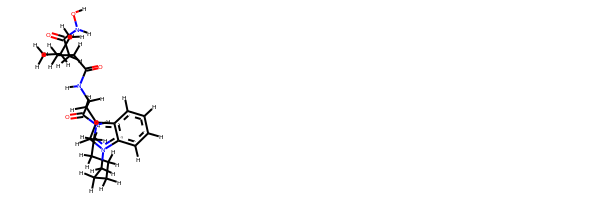

rdkit:  [H]ON([H])C(=O)C([H])([H])C([H])(C(=O)N([H])C1([H])C(=O)N([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])n2c([H])c(c3c([H])c([H])c([H])c([H])c32)C1([H])[H])C([H])([H])C([H])(C([H])([H])[H])C([H])([H])[H]
oechem:  CC(C)CC(CC(=O)NO)C(=O)NC1Cc2cn(c3c2cccc3)CCCCCCNC1=O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
21.134300828823502 kJ/mol 57651.685748078184 kJ/mol False
angle
166.9246477261172 kJ/mol 166.9246477261172 kJ/mol True
nb
8.492119735401989 kJ/mol 8.49211

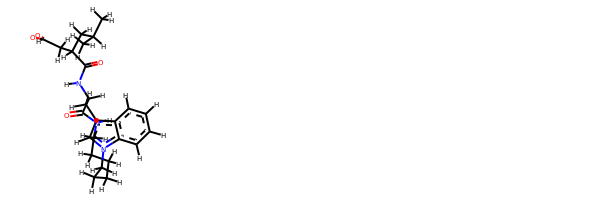

rdkit:  [H]OC(=O)C([H])([H])C([H])(C(=O)N([H])C1([H])C(=O)N([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])n2c([H])c(c3c([H])c([H])c([H])c([H])c32)C1([H])[H])C([H])([H])C([H])(C([H])([H])[H])C([H])([H])[H]
oechem:  CC(C)CC(CC(=O)O)C(=O)NC1Cc2cn(c3c2cccc3)CCCCCCNC1=O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

##############################

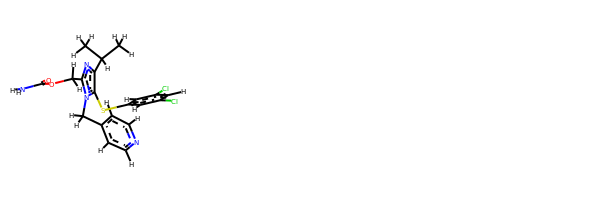

rdkit:  [H]c1nc([H])c([H])c(C([H])([H])n2c(C([H])([H])OC(=O)N([H])[H])nc(C([H])(C([H])([H])[H])C([H])([H])[H])c2Sc2c([H])c(Cl)c([H])c(Cl)c2[H])c1[H]
oechem:  CC(C)c1c(n(c(n1)COC(=O)N)Cc2ccncc2)Sc3cc(cc(c3)Cl)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
28.124263389631345 kJ/mol 56746.379204598175 kJ/mol False
angle
431.45469639847556 kJ/mol 431.45469639847556 kJ/mol True
nb
54.56693079578827 kJ/mol 54.56693079578827 kJ/mol True
torsion
58.46708761055662 kJ/mol 53.23878546682251 kJ/mol False
572.6129781944518 kJ/mol 57285.63961725926 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6398


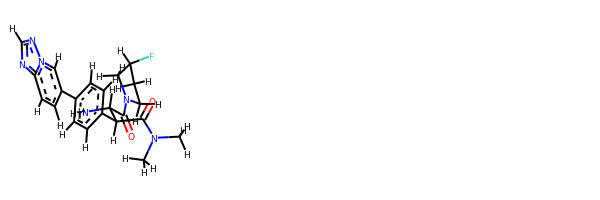

rdkit:  [H]c1nc2c([H])c([H])c(-c3c([H])c([H])c(C([H])(C(=O)N(C([H])([H])[H])C([H])([H])[H])C([H])(C(=O)N4C([H])([H])C([H])([H])C([H])(F)C4([H])[H])N([H])[H])c([H])c3[H])c([H])n2n1
oechem:  CN(C)C(=O)C(c1ccc(cc1)c2ccc3ncnn3c2)C(C(=O)N4CCC(C4)F)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
19.473892469038937 kJ/mol 58041.34226393743 kJ/mol False
angle
91.7299

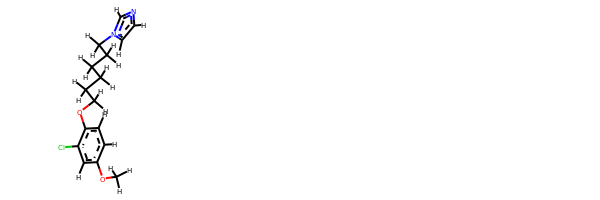

rdkit:  [H]c1nc([H])n(C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])Oc2c([H])c([H])c(OC([H])([H])[H])c([H])c2Cl)c1[H]
oechem:  COc1ccc(c(c1)Cl)OCCCCCCn2ccnc2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
12.451605253213375 kJ/mol 115086.20037786404 kJ/mol False
angle
92.09850600331379 kJ/mol 94.26345508132631 kJ/mol False
nb
24.190306786602527 kJ/mol 24.190306786602527 kJ/mol True
torsion
33.47217429244412 kJ/mol 0.00045777130811063503 kJ/mol False
162.21259233557382 kJ/mol 115204.65459750328 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6405


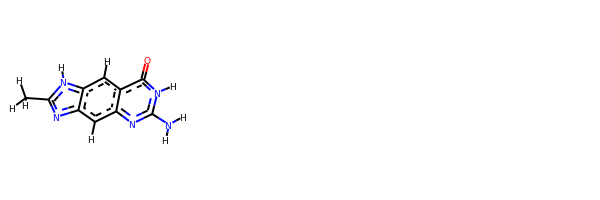

rdkit:  [H]c1c2nc(N([H])[H])n([H])c(=O)c2c([H])c2c1nc(C([H])([H])[H])n2[H]
oechem:  Cc1[nH]c2cc3c(cc2n1)nc([nH]c3=O)N
###########################################################################
 #########################################################

bond
14.044676372018051 kJ/mol 115095.32740935573 kJ/mol False
angle
101.25370502434453 kJ/mol 103.41924889032512 kJ/mol False
nb
52.35725071836007 kJ/mol 52.35725071836007 kJ/mol True
torsion
33.48314265049061 kJ/mol 0.011300656674100634 kJ/mol False
201.13877476521324 kJ/mol 115251.11520962107 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6406


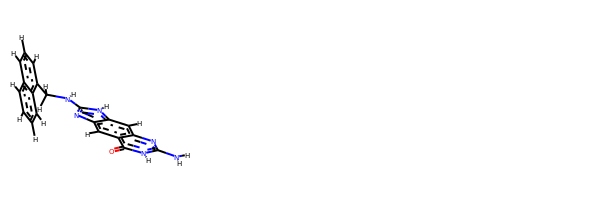

rdkit:  [H]c1c([H])c([H])c2c(C([H])([H])N([H])c3nc4c([H])c5c(=O)n([H])c(N([H])[H])nc5c([H])c4n3[H])c([H])c([H])c([H])c2c1[H]
oechem:  c1ccc2c(c1)cccc2CNc3[nH]c4cc5c(cc4n3)c(=O)[nH]c(n5)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
19.05702931847888 kJ/mol 158882.1692937181 kJ/mol False
angle
129.68447603760626 kJ/mol 133.99912992621893 kJ/mol False
nb
17.49160993983776 kJ/mol 17.49160993983776 kJ/mol True
torsion
61.66553228438792 kJ/mol 10.790020851683844 kJ/mol False
227.8986475803108 kJ/mol 159044.45005443585 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6408


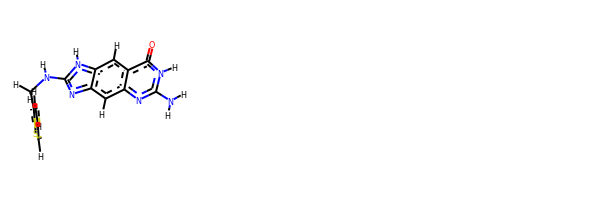

rdkit:  [H]c1sc(C([H])([H])N([H])c2nc3c([H])c4nc(N([H])[H])n([H])c(=O)c4c([H])c3n2[H])c([H])c1[H]
oechem:  c1cc(sc1)CNc2[nH]c3cc4c(cc3n2)nc([nH]c4=O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
39.52169273398176 kJ/mol 29000.28357704645 kJ/mol False
angle
149.0609154227235 kJ/mol 150.62597395198566 kJ/mol False
nb
38.53850419057663 kJ/mol 38.53850419057663 kJ/mol True
torsion
73.62333628039474 kJ/mol 68.39343419796707 kJ/mol False
300.74444862767666 kJ/mol 29257.841489386978 kJ/mol

------

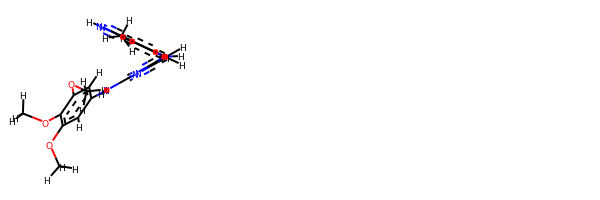

rdkit:  [H]c1nc(N([H])c2c([H])c(OC([H])([H])[H])c(OC([H])([H])[H])c(OC([H])([H])[H])c2[H])nc(N([H])c2c([H])c([H])c3c(C([H])([H])[H])nn([H])c3c2[H])c1[H]
oechem:  Cc1c2ccc(cc2[nH]n1)Nc3ccnc(n3)Nc4cc(c(c(c4)OC)OC)OC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
17.864946307289713 kJ/mol 58037.30344036541 kJ/mol False
angle
103.03332464408295 kJ/mol 105.04294782256635 kJ/mol False
nb
35.60355115944287 kJ/mol 35.60355115944287 kJ/mol True
torsion
43.30845857792145 kJ/mol 46.44847711587303 kJ/mol False
199.81028068873698 kJ/mol 58224.39841646329 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6

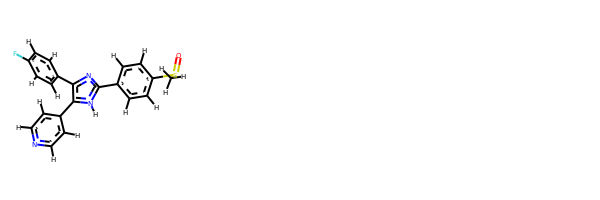

rdkit:  [H]c1nc([H])c([H])c(-c2c(-c3c([H])c([H])c(F)c([H])c3[H])nc(-c3c([H])c([H])c(S(=O)C([H])([H])[H])c([H])c3[H])n2[H])c1[H]
oechem:  CS(=O)c1ccc(cc1)c2[nH]c(c(n2)c3ccc(cc3)F)c4ccncc4
###########################################################################
 #########################################################

bond
10.004001322834995 kJ/mol 58031.847956837184 kJ/mol False
angle
91.89460565270267 kJ/mol 91.89460565270267 kJ/mol True
nb
16.015869192518526 kJ/mol 16.015869192518526 kJ/mol True
torsion
181.99640439738718 kJ/mol 177.48695730187507 kJ/mol False
299.9108805654434 kJ/mol 58317.24538898428 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6415


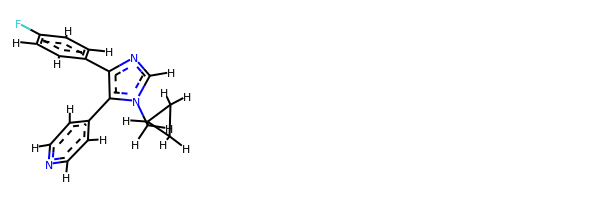

rdkit:  [H]c1nc([H])c([H])c(-c2c(-c3c([H])c([H])c(F)c([H])c3[H])nc([H])n2C([H])([H])C2([H])C([H])([H])C2([H])[H])c1[H]
oechem:  c1cc(ccc1c2c(n(cn2)CC3CC3)c4ccncc4)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
42.71361693261486 kJ/mol 58736.12735042591 kJ/mol False
angle
225.6671144858309 kJ/mol 227.35685522638053 kJ/mol False
nb
18.693261443110472 kJ/mol 18

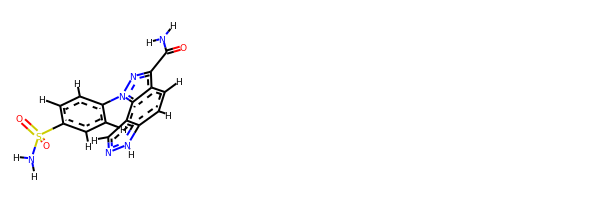

rdkit:  [H]c1c([H])c(S(=O)(=O)N([H])[H])c([H])c([H])c1-n1nc(C(=O)N([H])[H])c2c([H])c([H])c3c(c([H])nn3[H])c21
oechem:  c1cc(ccc1n2c3c(ccc4c3cn[nH]4)c(n2)C(=O)N)S(=O)(=O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
62.012931601343844 kJ/mol 169648.76704983463 kJ/mol False
angle
111.07790548067298 kJ/mol 111.07790548067298 kJ/mol True
nb
33.14384174202698 kJ/mol 33.14384174202698 kJ/mol True
torsion
53.72925442241065 kJ/mol 27.098996932756428 kJ/mol False
259.9639332464544 kJ/mol 169820.08779399007 kJ/mol

-------------------------------------------------------------------
----------------------------------------------------

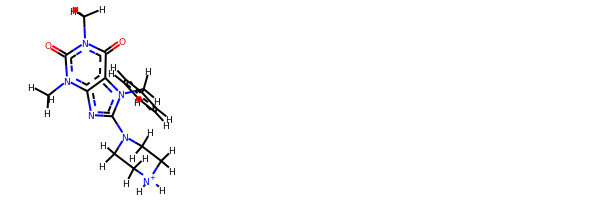

rdkit:  [H]c1c([H])c([H])c(C([H])([H])n2c(N3C([H])([H])C([H])([H])[N+]([H])([H])C([H])([H])C3([H])[H])nc3c2c(=O)n(C([H])([H])[H])c(=O)n3C([H])([H])[H])c([H])c1[H]
oechem:  Cn1c2c(c(=O)n(c1=O)C)n(c(n2)N3CC[NH2+]CC3)Cc4ccccc4
###########################################################################
 #########################################################

bond
24.318033734675286 kJ/mol 56623.515189115315 kJ/mol False
angle
101.96078005633674 kJ/mol 101.96078005633674 kJ/mol True
nb
54.04044833657362 kJ/mol 54.04044833657362 kJ/mol True
torsion
11.591237539361597 kJ/mol 15.872058782072848 kJ/mol False
191.91049966694726 kJ/mol 56795.388476290296 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6424


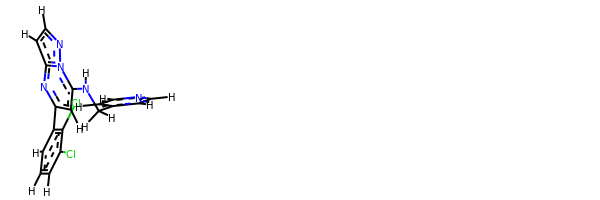

rdkit:  [H]c1nc([H])c([H])c(C([H])([H])N([H])c2c([H])c(-c3c([H])c([H])c([H])c(Cl)c3Cl)nc3c([H])c([H])nn23)c1[H]
oechem:  c1cc(c(c(c1)Cl)Cl)c2cc(n3c(n2)ccn3)NCc4ccncc4
###########################################################################
 #########################################################

bond
11.975657967255737 kJ/mol 86702.5923412596 kJ/mol False
angle
106.9353982377671 kJ/mol 106.9353982377671 kJ/mol True
nb
50.26425997640715 kJ/mol 50.26425997640715 kJ/mol True
torsion
15.553525294306318 kJ/mol 15.553902009209152 kJ/mol False
184.72884147573632 kJ/mol 86875.34590148299 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6425


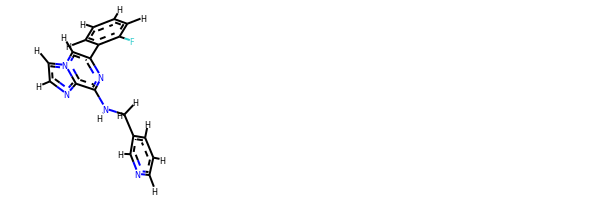

rdkit:  [H]c1nc([H])c(C([H])([H])N([H])c2nc(-c3c([H])c([H])c([H])c([H])c3F)c([H])n3c([H])c([H])nc23)c([H])c1[H]
oechem:  c1ccc(c(c1)c2cn3ccnc3c(n2)NCc4cccnc4)F
###########################################################################
 #########################################################

bond
12.037265199326212 kJ/mol 86687.89457324574 kJ/mol False
angle
108.52869696510656 kJ/mol 108.52869696510656 kJ/mol True
nb
38.33480586552525 kJ/mol 38.33480586552525 kJ/mol True
torsion
0.011171056859520861 kJ/mol 0.01120619778024919 kJ/mol False
158.91193908681754 kJ/mol 86834.76928227415 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6426


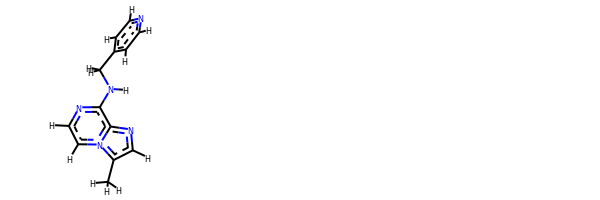

rdkit:  [H]c1nc([H])c([H])c(C([H])([H])N([H])c2nc([H])c([H])n3c(C([H])([H])[H])c([H])nc23)c1[H]
oechem:  Cc1cnc2n1ccnc2NCc3ccncc3
###########################################################################
 #########################################################

bond
24.806829113864968 kJ/mol 56624.003984494506 kJ/mol False
angle
99.6905327259367 kJ/mol 99.6905327259367 kJ/mol True
nb
52.410787330947464 kJ/mol 52.410787330947464 kJ/mol True
torsion
11.495423204515411 kJ/mol 15.633491222042622 kJ/mol False
188.40357237526456 kJ/mol 56791.73879577343 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6427


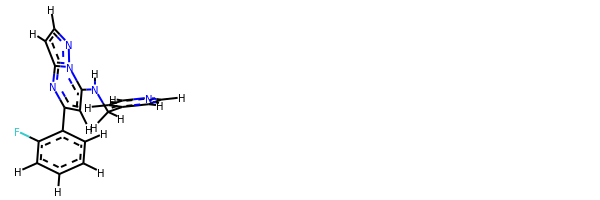

rdkit:  [H]c1nc([H])c([H])c(C([H])([H])N([H])c2c([H])c(-c3c([H])c([H])c([H])c([H])c3F)nc3c([H])c([H])nn23)c1[H]
oechem:  c1ccc(c(c1)c2cc(n3c(n2)ccn3)NCc4ccncc4)F
###########################################################################
 #########################################################

bond
24.886380015935075 kJ/mol 56624.08353539657 kJ/mol False
angle
100.99898434855533 kJ/mol 100.99898434855533 kJ/mol True
nb
59.94184132524045 kJ/mol 59.94184132524045 kJ/mol True
torsion
7.311843263668056 kJ/mol 5.175487262716727 kJ/mol False
193.1390489533989 kJ/mol 56790.199848333075 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6428


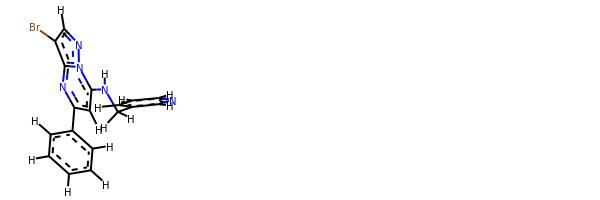

rdkit:  [H]c1nc([H])c(C([H])([H])N([H])c2c([H])c(-c3c([H])c([H])c([H])c([H])c3[H])nc3c(Br)c([H])nn23)c([H])c1[H]
oechem:  c1ccc(cc1)c2cc(n3c(n2)c(cn3)Br)NCc4cccnc4
###########################################################################
 #########################################################

bond
21.136709693156146 kJ/mol 56393.8657904084 kJ/mol False
angle
108.84774482518942 kJ/mol 108.84774482518942 kJ/mol True
nb
62.025564192501 kJ/mol 62.025564192501 kJ/mol True
torsion
10.562123847682674 kJ/mol 5.333532857194893 kJ/mol False
202.57214255852924 kJ/mol 56570.072632283285 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6429


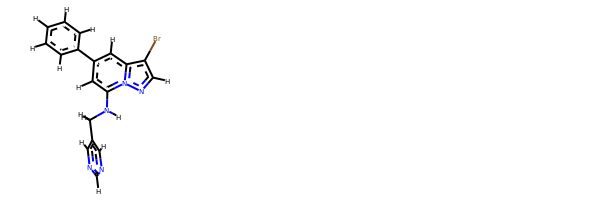

rdkit:  [H]c1nc([H])c(C([H])([H])N([H])c2c([H])c(-c3c([H])c([H])c([H])c([H])c3[H])c([H])c3c(Br)c([H])nn23)c([H])n1
oechem:  c1ccc(cc1)c2cc3c(cnn3c(c2)NCc4cncnc4)Br
###########################################################################
 #########################################################

bond
11.26673046939079 kJ/mol 85937.11805413972 kJ/mol False
angle
107.10124196807782 kJ/mol 107.10124196807782 kJ/mol True
nb
62.63001313374679 kJ/mol 62.63001313374679 kJ/mol True
torsion
5.342946374378497 kJ/mol 5.345030702628553 kJ/mol False
186.3409319455939 kJ/mol 86112.19433994417 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6430


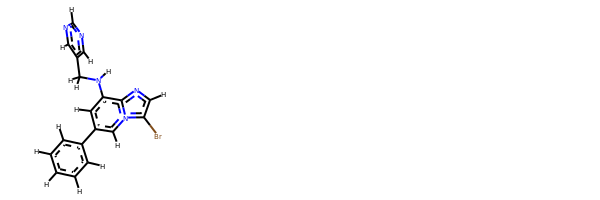

rdkit:  [H]c1nc([H])c(C([H])([H])N([H])c2c([H])c(-c3c([H])c([H])c([H])c([H])c3[H])c([H])n3c(Br)c([H])nc23)c([H])n1
oechem:  c1ccc(cc1)c2cc(c3ncc(n3c2)Br)NCc4cncnc4
###########################################################################
 #########################################################

bond
30.85956228055421 kJ/mol 56630.05671766119 kJ/mol False
angle
114.69152599764143 kJ/mol 114.69152599764143 kJ/mol True
nb
52.747747719575614 kJ/mol 52.747747719575614 kJ/mol True
torsion
11.826763055540704 kJ/mol 15.96644141408073 kJ/mol False
210.12559905331196 kJ/mol 56813.46243279249 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6431


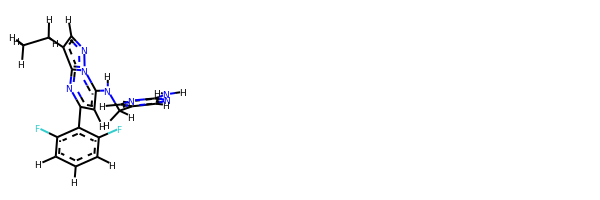

rdkit:  [H]c1nc(N([H])[H])nc([H])c1C([H])([H])N([H])c1c([H])c(-c2c(F)c([H])c([H])c([H])c2F)nc2c(C([H])([H])C([H])([H])[H])c([H])nn12
oechem:  CCc1cnn2c1nc(cc2NCc3cnc(nc3)N)c4c(cccc4F)F
###########################################################################
 #########################################################

bond
26.650402027285143 kJ/mol 56624.7358657073 kJ/mol False
angle
104.04828279840305 kJ/mol 104.04828279840305 kJ/mol True
nb
55.8114919893651 kJ/mol 55.8114919893651 kJ/mol True
torsion
138.97529946943777 kJ/mol 137.257412285132 kJ/mol False
325.485476284491 kJ/mol 56921.85305278019 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6432


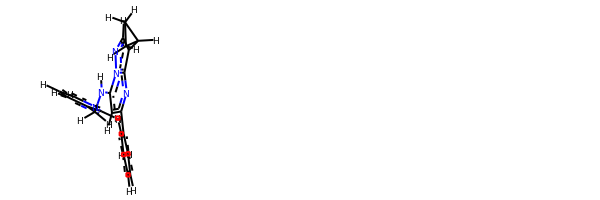

rdkit:  [H]c1nc([H])c(C([H])([H])N([H])c2c([H])c(-c3c([H])c([H])c([H])c([H])c3[H])nc3c(C4([H])C([H])([H])C4([H])[H])c([H])nn23)c([H])c1[H]
oechem:  c1ccc(cc1)c2cc(n3c(n2)c(cn3)C4CC4)NCc5cccnc5
###########################################################################
 #########################################################

bond
16.987231760786074 kJ/mol 43688.27693322529 kJ/mol False
angle
54.09258613692387 kJ/mol 57.44989220665852 kJ/mol False
nb
58.258285571456426 kJ/mol 58.258285571456426 kJ/mol True
torsion
41.11260272157226 kJ/mol 31.079391279040763 kJ/mol False
170.45070619073863 kJ/mol 43835.06450228244 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6433


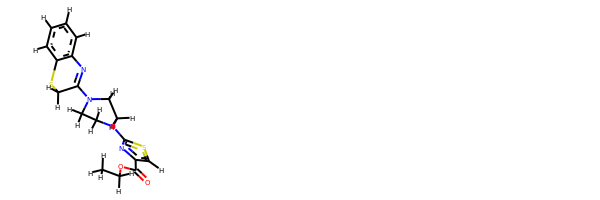

rdkit:  [H]c1sc(N2C([H])([H])C([H])([H])N(C3=Nc4c([H])c([H])c([H])c([H])c4SC3([H])[H])C([H])([H])C2([H])[H])nc1C(=O)OC([H])([H])C([H])([H])[H]
oechem:  CCOC(=O)c1csc(n1)N2CCN(CC2)C3=Nc4ccccc4SC3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ################################################

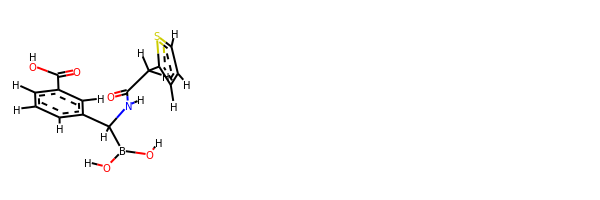

rdkit:  [H]OB(O[H])C([H])(c1c([H])c([H])c([H])c(C(=O)O[H])c1[H])N([H])C(=O)C([H])([H])c1sc([H])c([H])c1[H]
oechem:  B(C(c1cccc(c1)C(=O)O)NC(=O)Cc2cccs2)(O)O
###########################################################################
 #########################################################

bond
81263.40302519056 kJ/mol 125049.54317050488 kJ/mol False
angle
53.65379610804351 kJ/mol 55.80736909787622 kJ/mol False
nb
530.1983647955021 kJ/mol 530.1983647955021 kJ/mol True
torsion
36.943368807992286 kJ/mol 30.66926611845747 kJ/mol False
81884.1985549021 kJ/mol 125666.21817051673 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6445


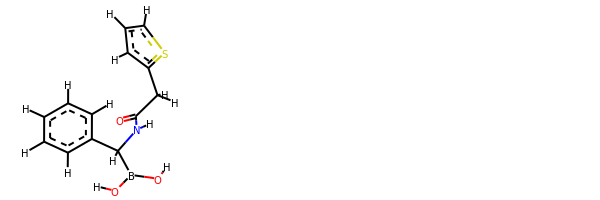

rdkit:  [H]OB(O[H])C([H])(c1c([H])c([H])c([H])c([H])c1[H])N([H])C(=O)C([H])([H])c1sc([H])c([H])c1[H]
oechem:  B(C(c1ccccc1)NC(=O)Cc2cccs2)(O)O
###########################################################################
 #########################################################

bond
15.502579672245993 kJ/mol 29083.233066294066 kJ/mol False
angle
301.32954431647977 kJ/mol 301.32954431647977 kJ/mol True
nb
40.87971838502045 kJ/mol 40.87971838502045 kJ/mol True
torsion
49.02966215381833 kJ/mol 53.211933415828206 kJ/mol False
406.74150452756453 kJ/mol 29478.654262411394 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6446


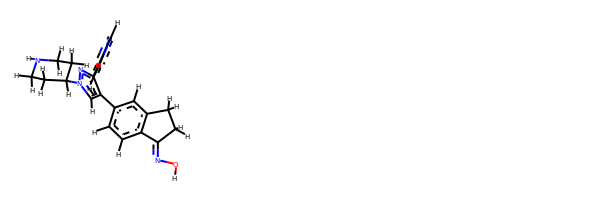

rdkit:  [H]ON=C1c2c([H])c([H])c(-c3c(-c4c([H])c([H])nc([H])c4[H])nn(C4([H])C([H])([H])C([H])([H])N([H])C([H])([H])C4([H])[H])c3[H])c([H])c2C([H])([H])C1([H])[H]
oechem:  c1cc2c(cc1c3cn(nc3c4ccncc4)C5CCNCC5)CCC2=NO
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
29.571083122932748 kJ/mol 87604.38270134524 kJ/mol False
angle
101.16908326570223 kJ/mol 105.47439787251204 kJ/mol False
nb
44.02939593378123 kJ/mol 44.02939593378123 kJ/mol True
torsion
102.86318830459156 kJ/mol 102.86277666359244 kJ/mol False
277.6327506270078 kJ/mol 87856.74927181513 kJ/mol

-------------------------------------------------------------------
---------

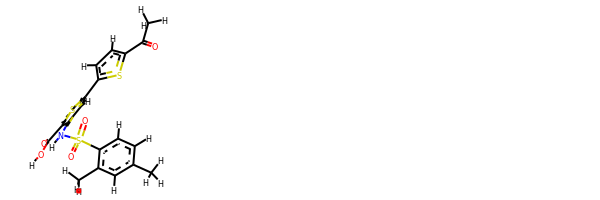

rdkit:  [H]OC(=O)c1sc(-c2sc(C(=O)C([H])([H])[H])c([H])c2[H])c([H])c1N([H])S(=O)(=O)c1c([H])c([H])c(C([H])([H])[H])c([H])c1C([H])([H])[H]
oechem:  Cc1ccc(c(c1)C)S(=O)(=O)Nc2cc(sc2C(=O)O)c3ccc(s3)C(=O)C
###########################################################################
 #########################################################

bond
25.547436403428822 kJ/mol 57828.53954200026 kJ/mol False
angle
117.52997606562379 kJ/mol 117.52997606562379 kJ/mol True
nb
33.30339586595717 kJ/mol 33.30339586595717 kJ/mol True
torsion
44.4014397864462 kJ/mol 43.486573806768355 kJ/mol False
220.78224812145595 kJ/mol 58022.85948773861 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6450


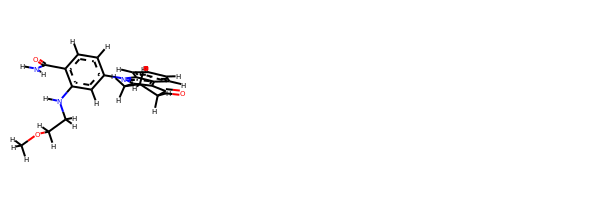

rdkit:  [H]c1c([H])c(-n2c3c(c4c([H])c([H])c([H])c([H])c42)C(=O)C([H])([H])C([H])([H])C3([H])[H])c([H])c(N([H])C([H])([H])C([H])([H])OC([H])([H])[H])c1C(=O)N([H])[H]
oechem:  COCCNc1cc(ccc1C(=O)N)n2c3ccccc3c4c2CCCC4=O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
27.56650550117174 kJ/mol 72880.47795841636 kJ/mol False
angle
123.96382654659955 kJ/mol 126.11609508108502 kJ/mol False
nb
28.034190192334183 kJ/mol 28.034190192334183 kJ/mol True
torsion
103.73447928202415 kJ/mol 98.50455211906585 kJ/mol False
283.29900152212963 kJ/mol 73133.13279580885 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugB

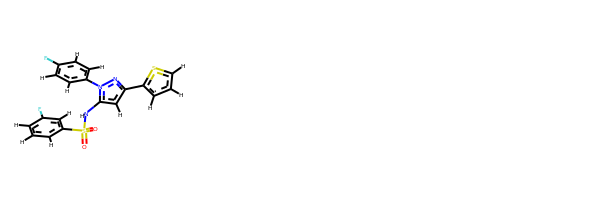

rdkit:  [H]c1sc(-c2nn(-c3c([H])c([H])c(F)c([H])c3[H])c(N([H])S(=O)(=O)c3c([H])c([H])c([H])c(F)c3[H])c2[H])c([H])c1[H]
oechem:  c1cc(cc(c1)S(=O)(=O)Nc2cc(nn2c3ccc(cc3)F)c4cccs4)F
###########################################################################
 #########################################################

bond
44.85722405490488 kJ/mol 185005.41739341704 kJ/mol False
angle
63.28288219057169 kJ/mol 67.21730241786773 kJ/mol False
nb
51.66062259087983 kJ/mol 51.66062259087983 kJ/mol True
torsion
20.173266348216085 kJ/mol 0.026117293373875885 kJ/mol False
179.9739951845725 kJ/mol 185124.32143571918 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6454


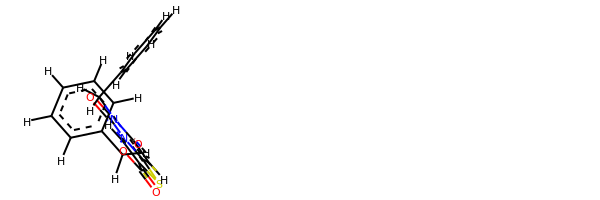

rdkit:  [H]c1c([H])c([H])c(C([H])([H])OC(=O)c2sc3c([H])c(=O)n(C([H])([H])c4c([H])c([H])c([H])c([H])c4[H])c(=O)n3c2[H])c([H])c1[H]
oechem:  c1ccc(cc1)Cn2c(=O)cc3n(c2=O)cc(s3)C(=O)OCc4ccccc4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
19.512317427405893 kJ/mol 28978.5331562565 kJ/mol False
angle
122.70958157012413 kJ/mol 124.28708168293903 kJ/mol False
nb
62.39214985878039 kJ/mol 62.39214985878039 kJ/mol True
torsion
32.711532420717404 kJ/mol 27.481959642870425 kJ/mol False
237.32558127702782

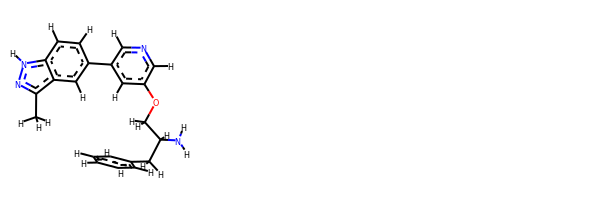

rdkit:  [H]c1nc([H])c(-c2c([H])c([H])c3c(c(C([H])([H])[H])nn3[H])c2[H])c([H])c1OC([H])([H])C([H])(N([H])[H])C([H])([H])c1c([H])c([H])c([H])c([H])c1[H]
oechem:  Cc1c2cc(ccc2[nH]n1)c3cc(cnc3)OCC(Cc4ccccc4)N
###########################################################################
 #########################################################

bond
19.5193229929708 kJ/mol 28979.63698168982 kJ/mol False
angle
122.93279074028464 kJ/mol 124.51192877415517 kJ/mol False
nb
64.41738611677438 kJ/mol 64.41738611677438 kJ/mol True
torsion
26.948726444867788 kJ/mol 21.719097961204245 kJ/mol False
233.8182262948976 kJ/mol 29190.285394541952 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6461


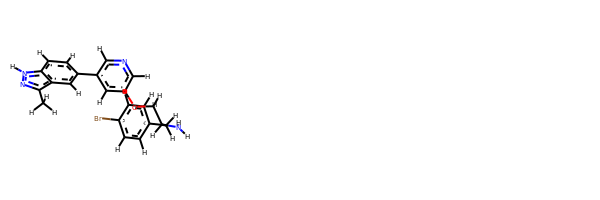

rdkit:  [H]c1nc([H])c(-c2c([H])c([H])c3c(c(C([H])([H])[H])nn3[H])c2[H])c([H])c1OC([H])([H])C([H])(N([H])[H])C([H])([H])c1c([H])c([H])c(Br)c([H])c1[H]
oechem:  Cc1c2cc(ccc2[nH]n1)c3cc(cnc3)OCC(Cc4ccc(cc4)Br)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
16.083710331867746 kJ/mol 43804.65837366429 kJ/mol False
angle
60.97160208945897 kJ/mol 63.12297326512796 kJ/mol False
nb
14.817909740027256 kJ/mol 14.817909740027256 kJ/mol True
torsion
88.58631592862926 kJ/mol 86.07592054043502 kJ/mol False


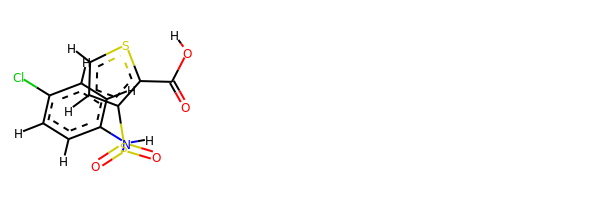

rdkit:  [H]OC(=O)c1sc([H])c([H])c1S(=O)(=O)N([H])c1c([H])c([H])c(Cl)c([H])c1[H]
oechem:  c1cc(ccc1NS(=O)(=O)c2ccsc2C(=O)O)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
10.594526860425042 kJ/mol 57955.61737692843 kJ/mol False
angle
102.23863549847495 kJ/mol 104.16142511403287 kJ/mol False
nb
24.21613959046745 kJ/mol 24.21613959046745 kJ/mol True
torsion
3.2226499171532716 kJ/mol 2.4711882672094316 kJ/mol False
140.2719518665207 kJ/mol 58086.466129900145 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6467


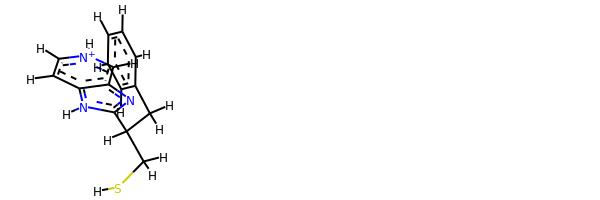

rdkit:  [H]SC([H])([H])C([H])(c1nc2c([H])[n+]([H])c([H])c([H])c2n1[H])C([H])([H])c1c([H])c([H])c([H])c([H])c1[H]
oechem:  c1ccc(cc1)CC(CS)c2[nH]c3cc[nH+]cc3n2
###########################################################################
 #########################################################

bond
19.114379137614847 kJ/mol 58290.09368615516 kJ/mol False
angle
93.96828532583127 kJ/mol 93.96828532583127 kJ/mol True
nb
8.740781775558338 kJ/mol 8.740781775558338 kJ/mol True
torsion
0.10989646207155898 kJ/mol 0.10974780728525133 kJ/mol False
121.93334270107601 kJ/mol 58392.91250106384 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6468


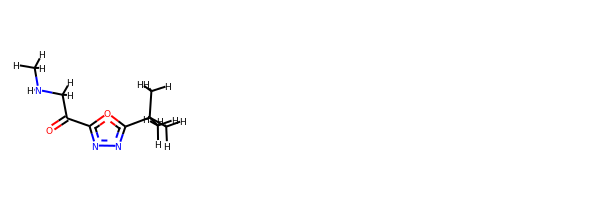

rdkit:  [H]N(C([H])([H])[H])C([H])([H])C(=O)c1nnc(C(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H])o1
oechem:  CC(C)(C)c1nnc(o1)C(=O)CNC
###########################################################################
 #########################################################

bond
28.68748992544956 kJ/mol 57886.332708539165 kJ/mol False
angle
179.78724701688864 kJ/mol 181.183429765617 kJ/mol False
nb
6.610042852705936 kJ/mol 6.610042852705936 kJ/mol True
torsion
23.669908082534914 kJ/mol 23.66993403104699 kJ/mol False
238.75468787757904 kJ/mol 58097.79611518853 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6469


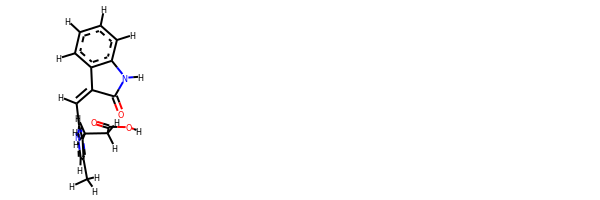

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])c1c(C([H])([H])[H])c([H])n([H])c1C([H])=C1C(=O)N([H])c2c([H])c([H])c([H])c([H])c21
oechem:  Cc1c[nH]c(c1CCC(=O)O)C=C2c3ccccc3NC2=O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
28.401090

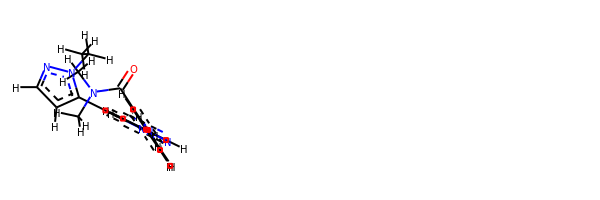

rdkit:  [H]c1nn(C([H])([H])C([H])([H])[H])c(-c2c([H])n([H])c3nc([H])c(-c4c([H])c([H])c(N([H])[H])c(C(=O)N(C([H])([H])[H])C([H])([H])[H])c4[H])c([H])c23)c1[H]
oechem:  CCn1c(ccn1)c2c[nH]c3c2cc(cn3)c4ccc(c(c4)C(=O)N(C)C)N
###########################################################################
 #########################################################

bond
32.34218422747158 kJ/mol 87006.79519721179 kJ/mol False
angle
182.0832516520025 kJ/mol 182.0832516520025 kJ/mol True
nb
40.39195372729397 kJ/mol 40.39195372729397 kJ/mol True
torsion
16.065913768568297 kJ/mol 5.627224759848591 kJ/mol False
270.88330337533637 kJ/mol 87234.89762735093 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6476


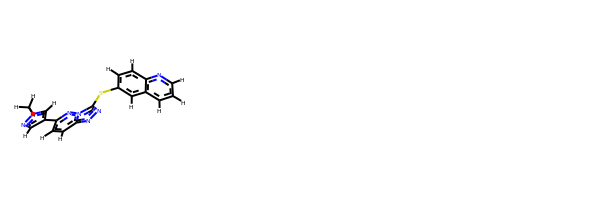

rdkit:  [H]c1nc2c([H])c([H])c(Sc3nnc4c([H])c([H])c(-c5c([H])nn(C([H])([H])[H])c5[H])nn34)c([H])c2c([H])c1[H]
oechem:  Cn1cc(cn1)c2ccc3nnc(n3n2)Sc4ccc5c(c4)cccn5
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
18.789759431320288 kJ/mol 56261.44696883818 kJ/mol False
angle
34.75354033451942 kJ/mol 34.75354033451942 kJ/mol True
nb
71.07359258915986 kJ/mol 71.07359258915986 kJ/mol True
torsion
59.7827067712967 kJ/mol 30.047836369183784 kJ/mol False
184.39959912629627 kJ/mol 56397.32193813104 kJ/mol

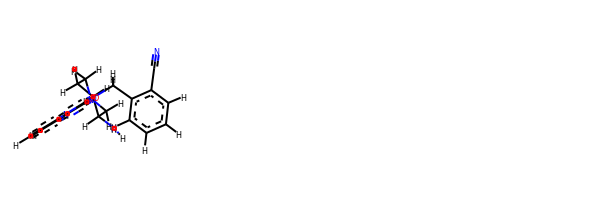

rdkit:  [H]c1c([H])c([H])c(C([H])([H])n2c(N3C([H])([H])C([H])([H])C([H])([H])C([H])(N([H])[H])C3([H])[H])nc3c([H])c([H])c([H])c([H])c3c2=O)c(C#N)c1[H]
oechem:  c1ccc(c(c1)Cn2c(=O)c3ccccc3nc2N4CCCC(C4)N)C#N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
33.05196104270748 kJ/mol 57949.761114722896 kJ/mol False
angle
114.26915668531309 kJ/mol 114.26915668531309 kJ/mol True
nb
51.71483993785248 kJ/mol 51.71483993785248 kJ/mol True
torsion
26.77445241835741 kJ/mol 22.54269519394786 kJ/mol False
225.81041008423045 kJ/mol 58138.28780654 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6482


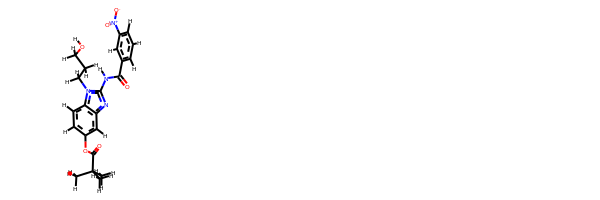

rdkit:  [H]OC([H])([H])C([H])([H])C([H])([H])n1c(N([H])C(=O)c2c([H])c([H])c([H])c([N+](=O)[O-])c2[H])nc2c([H])c(OC(=O)C(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H])c([H])c([H])c21
oechem:  CC(C)(C)C(=O)Oc1ccc2c(c1)nc(n2CCCO)NC(=O)c3cccc(c3)[N+](=O)[O-]
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

#################################################################

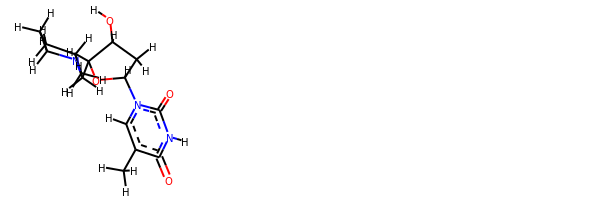

rdkit:  [H]OC1([H])C([H])([H])C([H])(n2c([H])c(C([H])([H])[H])c(=O)n([H])c2=O)OC1([H])C([H])([H])N1C([H])([H])C([H])([H])C([H])([H])C([H])([H])C1([H])[H]
oechem:  Cc1cn(c(=O)[nH]c1=O)C2CC(C(O2)CN3CCCCC3)O
###########################################################################
 #########################################################

bond
28.780401270730692 kJ/mol 56913.36857713649 kJ/mol False
angle
112.19927180453136 kJ/mol 112.19927180453136 kJ/mol True
nb
74.80811711520657 kJ/mol 74.80811711520657 kJ/mol True
torsion
63.55432471188051 kJ/mol 58.33256613011612 kJ/mol False
279.3421149023491 kJ/mol 57158.70853218634 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6489


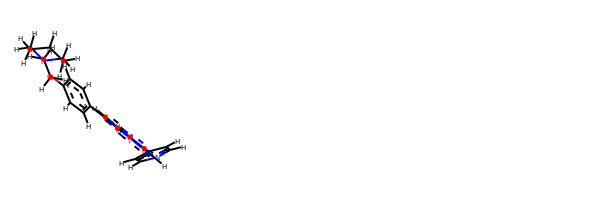

rdkit:  [H]c1nc([H])c([H])c(-c2c([H])nn3c([H])c(-c4c([H])c([H])c(OC([H])([H])C([H])([H])N5C([H])([H])C([H])([H])C([H])([H])C([H])([H])C5([H])[H])c([H])c4[H])c([H])nc23)c1[H]
oechem:  c1cc(ccc1c2cnc3c(cnn3c2)c4ccncc4)OCCN5CCCCC5
###########################################################################
 #########################################################

bond
14.12565504042478 kJ/mol 112279.53597530824 kJ/mol False
angle
123.9233150671695 kJ/mol 125.59651080365764 kJ/mol False
nb
26.958557553482287 kJ/mol 26.958557553482287 kJ/mol True
torsion
47.38909237983207 kJ/mol 43.664257638104964 kJ/mol False
212.39662004090863 kJ/mol 112475.75530130349 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6490


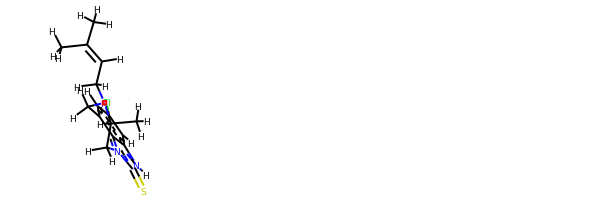

rdkit:  [H]C(=C(C([H])([H])[H])C([H])([H])[H])C([H])([H])N1C([H])([H])c2c([H])c(Cl)c([H])c3c2n(c(=S)n3[H])C([H])([H])C1([H])C([H])([H])[H]
oechem:  CC1Cn2c3c(cc(cc3[nH]c2=S)Cl)CN1CC=C(C)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
14.050908865414009 kJ/mol 112279.46122913323 kJ/mol False
angle
126.30052779747716 kJ/mol 127.97295355211692 kJ/mol False
nb
29.404275346711817 kJ/mol 29.404275346711817 kJ/mol True
torsion
47.86896512038933 kJ/mol 44.14405262200947 kJ/mol False
217.6246771299923 kJ/mol 112480.98251065407 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6492


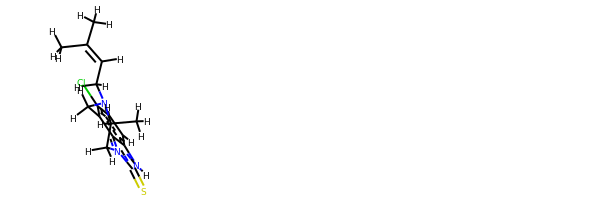

rdkit:  [H]C(=C(C([H])([H])[H])C([H])([H])[H])C([H])([H])N1C([H])([H])c2c(Cl)c([H])c([H])c3c2n(c(=S)n3[H])C([H])([H])C1([H])C([H])([H])[H]
oechem:  CC1Cn2c3c(ccc(c3CN1CC=C(C)C)Cl)[nH]c2=S
###########################################################################
 #########################################################

bond
23.084104819223903 kJ/mol 56242.154073754966 kJ/mol False
angle
12.205162529619408 kJ/mol 12.205162529619408 kJ/mol True
nb
51.206667362652034 kJ/mol 51.206667362652034 kJ/mol True
torsion
22.436095768060575 kJ/mol 23.995833532761903 kJ/mol False
108.93203047955592 kJ/mol 56329.56173718 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6494


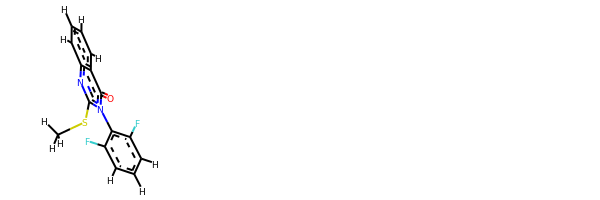

rdkit:  [H]c1c([H])c(F)c(-n2c(SC([H])([H])[H])nc3c([H])c([H])c([H])c([H])c3c2=O)c(F)c1[H]
oechem:  CSc1nc2ccccc2c(=O)n1c3c(cccc3F)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
8.823503926171249 kJ/mol 57807.70972687443 kJ/mol False
angle
381.46164703355856 kJ/mol 382.80202684615045 kJ/mol False
nb
14.536322092181058 kJ/mol 14.536322092181058 kJ/mol True
torsion
42.22371159096318 kJ/mol 42.22562442547909 kJ/mol False
447.0451846428741 kJ/mol 58247.27370023824 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
------------------------

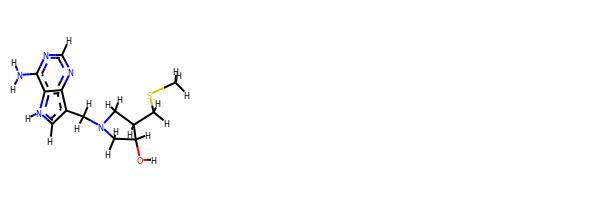

rdkit:  [H]OC1([H])C([H])([H])N(C([H])([H])c2c([H])n([H])c3c(N([H])[H])nc([H])nc23)C([H])([H])C1([H])C([H])([H])SC([H])([H])[H]
oechem:  CSCC1CN(CC1O)Cc2c[nH]c3c2ncnc3N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###############

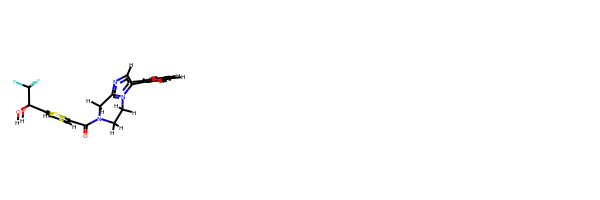

rdkit:  [H]OC(O[H])(c1sc(C(=O)N2C([H])([H])c3nc([H])c(-c4c([H])c([H])c([H])c([H])c4[H])n3C([H])([H])C2([H])[H])c([H])c1[H])C(F)(F)F
oechem:  c1ccc(cc1)c2cnc3n2CCN(C3)C(=O)c4ccc(s4)C(C(F)(F)F)(O)O
###########################################################################
 #########################################################

bond
30.513542540014697 kJ/mol 56627.08523380763 kJ/mol False
angle
62.02934079857284 kJ/mol 62.02934079857284 kJ/mol True
nb
32.781323950459395 kJ/mol 32.781323950459395 kJ/mol True
torsion
120.28877597255295 kJ/mol 100.29924897058002 kJ/mol False
245.61298326159988 kJ/mol 56822.19514752724 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6506


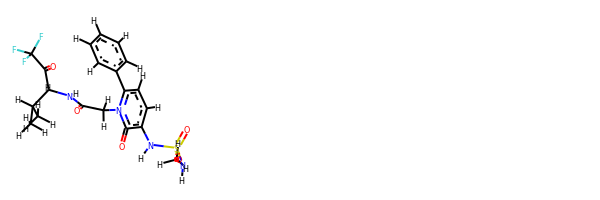

rdkit:  [H]c1c([H])c([H])c(-c2c([H])c([H])c(N([H])S(=O)(=O)N([H])C([H])([H])[H])c(=O)n2C([H])([H])C(=O)N([H])C([H])(C(=O)C(F)(F)F)C([H])(C([H])([H])[H])C([H])([H])[H])c([H])c1[H]
oechem:  CC(C)C(C(=O)C(F)(F)F)NC(=O)Cn1c(ccc(c1=O)NS(=O)(=O)NC)c2ccccc2
###########################################################################
 #########################################################

bond
7.331442525153974 kJ/mol 43571.260875225744 kJ/mol False
angle
32.07726784109996 kJ/mol 34.156850264945746 kJ/mol False
nb
44.02928846918796 kJ/mol 44.02928846918796 kJ/mol True
torsion
14.64413321216372 kJ/mol 20.922487878884343 kJ/mol False
98.08213204760561 kJ/mol 43670.36950183876 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6507


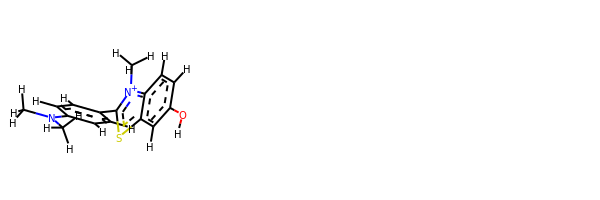

rdkit:  [H]Oc1c([H])c([H])c2c(sc(-c3c([H])c([H])c(N(C([H])([H])[H])C([H])([H])[H])c([H])c3[H])[n+]2C([H])([H])[H])c1[H]
oechem:  C[n+]1c2ccc(cc2sc1c3ccc(cc3)N(C)C)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###################

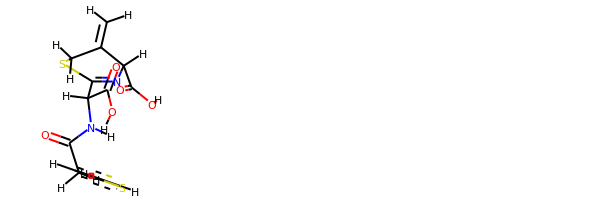

rdkit:  [H]OC(=O)C1([H])N=C(C([H])(C(=O)O[H])N([H])C(=O)C([H])([H])c2sc([H])c([H])c2[H])SC([H])([H])C1=C([H])[H]
oechem:  C=C1CSC(=NC1C(=O)O)C(C(=O)O)NC(=O)Cc2cccs2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###################

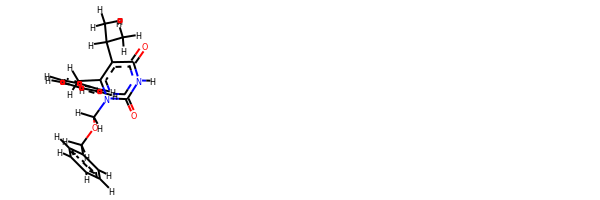

rdkit:  [H]c1c([H])c([H])c(C([H])([H])OC([H])([H])n2c(C([H])([H])c3c([H])c([H])c([H])c([H])c3[H])c(C([H])(C([H])([H])[H])C([H])([H])[H])c(=O)n([H])c2=O)c([H])c1[H]
oechem:  CC(C)c1c(n(c(=O)[nH]c1=O)COCc2ccccc2)Cc3ccccc3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
9.052042073666165 kJ/mol 57760.957388740484 kJ/mol False
angle
125.27764822942054 kJ/mol 125.27764822942054 kJ/mol True
nb
8.557569321259411 kJ/mol 8.557569321259411 kJ/mol True
torsion
7.183616250725795 kJ/mol 7.183628401568476 kJ

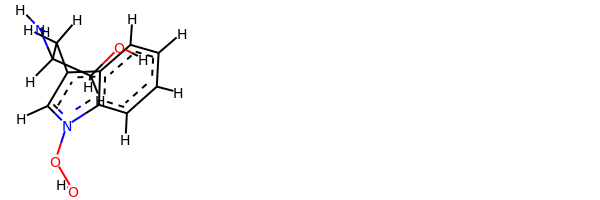

rdkit:  [H]OOn1c([H])c(C([H])([H])C([H])(N([H])[H])C([H])([H])O[H])c2c([H])c([H])c([H])c([H])c21
oechem:  c1ccc2c(c1)c(cn2OO)CC(CO)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###################################################

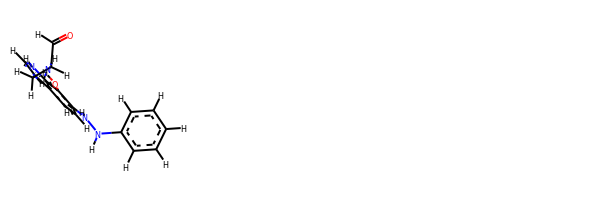

rdkit:  [H]Oc1c(N([H])N([H])c2c([H])c([H])c([H])c([H])c2[H])c([H])c([H])c2c(C([H])([H])C([H])(C([H])=O)N([H])[H])c([H])n([H])c12
oechem:  c1ccc(cc1)NNc2ccc3c(c[nH]c3c2O)CC(C=O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
7.809347256373598 kJ/mol 57759.714693923175 kJ/mol False
angle
82.93104634064733 kJ/mol 84.16098065346603 kJ/mol False
nb
8.06391221446788 kJ/mol 8.06391221446788 kJ/mol True
torsion
1.5775699648959567 kJ/mol 1.5775707689717293 kJ/mol False
100.38187577638476 kJ/mol 57853.51715756008 kJ/mol

-------------------------------------------------------------------
------------------------------------------------

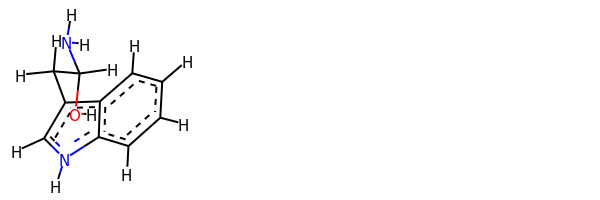

rdkit:  [H]OC([H])(N([H])[H])C([H])([H])c1c([H])n([H])c2c([H])c([H])c([H])c([H])c12
oechem:  c1ccc2c(c1)c(c[nH]2)CC(N)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
49.964655538357725 kJ/mol 113460.37253467386 kJ/mol False
angle
341.8132323088734 kJ/mol 342.4342431199107 kJ/mol False
nb
22.942468570093602 kJ/mol 22.942468570093602 kJ/mol True
torsion
116.7467969871154 kJ/mol 59.67962265581147 kJ/mol False
531.4671534044402 kJ/mol 113885.42886901967 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6540


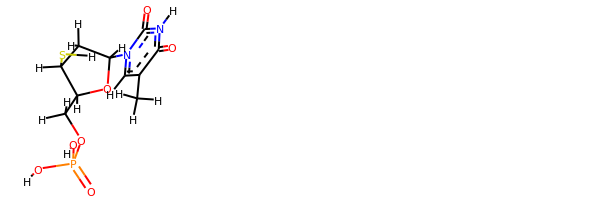

rdkit:  [H]OP(=O)(O[H])OC([H])([H])C1([H])OC([H])(n2c([H])c(C([H])([H])[H])c(=O)n([H])c2=O)C([H])([H])C1([H])S[H]
oechem:  Cc1cn(c(=O)[nH]c1=O)C2CC(C(O2)COP(=O)(O)O)S
###########################################################################
 #########################################################

bond
9.915555645731457 kJ/mol 57761.82090231253 kJ/mol False
angle
86.63203424370184 kJ/mol 87.86196855652054 kJ/mol False
nb
8.591386393321892 kJ/mol 8.591386393321892 kJ/mol True
torsion
21.81648270992143 kJ/mol 16.73731154870498 kJ/mol False
126.95545899267663 kJ/mol 57875.01156881108 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6541


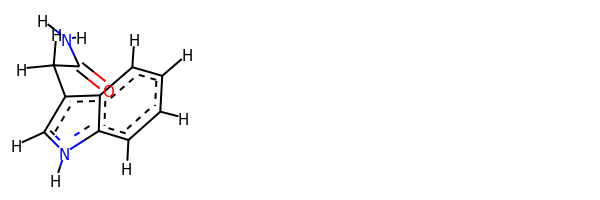

rdkit:  [H]c1c([H])c([H])c2c(c1[H])c(C([H])([H])C(=O)N([H])[H])c([H])n2[H]
oechem:  c1ccc2c(c1)c(c[nH]2)CC(=O)N
###########################################################################
 #########################################################

bond
7.791684532393904 kJ/mol 57759.6970311992 kJ/mol False
angle
100.90685338995056 kJ/mol 102.13678770276925 kJ/mol False
nb
7.844329822515118 kJ/mol 7.844329822515118 kJ/mol True
torsion
5.038701106545495 kJ/mol 5.038701910621267 kJ/mol False
121.58156885140507 kJ/mol 57874.7168506351 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6542


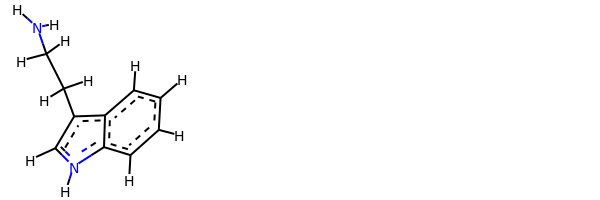

rdkit:  [H]c1c([H])c([H])c2c(c1[H])c(C([H])([H])C([H])([H])N([H])[H])c([H])n2[H]
oechem:  c1ccc2c(c1)c(c[nH]2)CCN
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
21.492368867235626 kJ/mol 56517.27437298877 kJ/mol False
angle
102.67942409218219 kJ/mol 102.67942409218219 kJ/mol True
nb
41.382282166409404 kJ/mol 41.382282166409404 kJ/mol True
torsion
8.370738370037126 kJ/mol 8.225690256634858 kJ/mol False
173.92481349586433 kJ/mol 56669.561769504 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6544


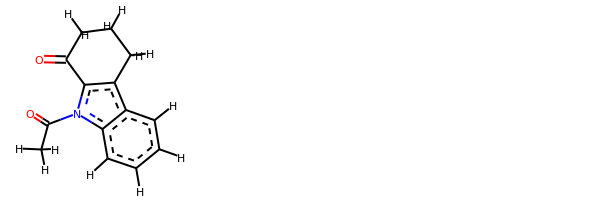

rdkit:  [H]c1c([H])c([H])c2c(c1[H])c1c(n2C(=O)C([H])([H])[H])C(=O)C([H])([H])C([H])([H])C1([H])[H]
oechem:  CC(=O)n1c2ccccc2c3c1C(=O)CCC3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
43.04314493391282 kJ/mol 101737.32577767271 kJ/mol False
angle
171.04345175148094 kJ/mol 176.41085801930186 kJ/mol False
nb
35.41856431334863 kJ/mol 35.41856431334863 kJ/mol True
torsion
51.586276821931456 kJ/mol 30.597655012058784 kJ/mol False
301.09143782067383 kJ/mol 101979.75285501742 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6546


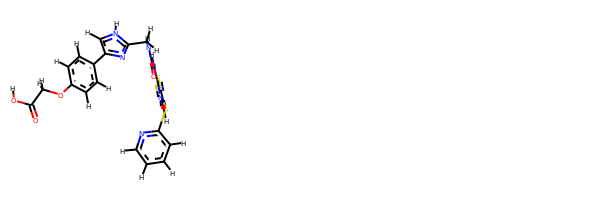

rdkit:  [H]OC(=O)C([H])([H])Oc1c([H])c([H])c(-c2nc(C([H])([H])N([H])C(=O)N([H])c3nc([H])c(Sc4nc([H])c([H])c([H])c4[H])s3)n([H])c2[H])c([H])c1[H]
oechem:  c1ccnc(c1)Sc2cnc(s2)NC(=O)NCc3[nH]cc(n3)c4ccc(cc4)OCC(=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
19.851520971888654 kJ/mol 57771.756867638695 kJ/mol False
angle
104.93599545255601 kJ/mol 106.16801277343704 kJ/mol False
nb
22.727252192557252 kJ/mol 22.727252192557252 kJ/mol True
torsion
92.26470611041614 kJ/mol 89.749335360896 kJ/mol False
239.77947472741806 kJ/mol 57990.40146796558 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6

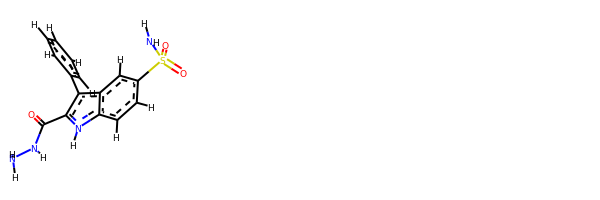

rdkit:  [H]c1c([H])c([H])c(-c2c(C(=O)N([H])N([H])[H])n([H])c3c([H])c([H])c(S(=O)(=O)N([H])[H])c([H])c23)c([H])c1[H]
oechem:  c1ccc(cc1)c2c3cc(ccc3[nH]c2C(=O)NN)S(=O)(=O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
44.55070385072754 kJ/mol 113458.75615563714 kJ/mol False
angle
605.8521926004075 kJ/mol 606.4729277028574 kJ/mol False
nb
29.93834023119282 kJ/mol 29.93834023119282 kJ/mol True
torsion
147.51925040889893 kJ/mol 90.44654439058485 kJ/mol False
827.8604870912268 kJ/mol 114185.61396796176 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6550


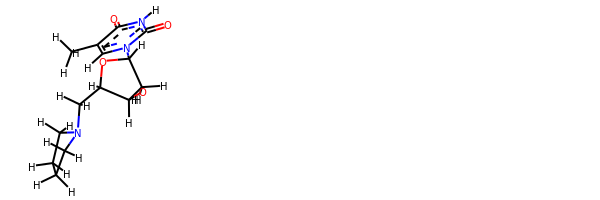

rdkit:  [H]OC1([H])C([H])([H])C([H])(n2c([H])c(C([H])([H])[H])c(=O)n([H])c2=O)OC1([H])C([H])([H])N1C([H])([H])C([H])([H])C([H])([H])C1([H])[H]
oechem:  Cc1cn(c(=O)[nH]c1=O)C2CC(C(O2)CN3CCCC3)O
###########################################################################
 #########################################################

bond
23.276043066199716 kJ/mol 56755.2736541217 kJ/mol False
angle
25.08201886637382 kJ/mol 25.08201886637382 kJ/mol True
nb
87.17440075818713 kJ/mol 87.17440075818713 kJ/mol True
torsion
5.579083568056168 kJ/mol 0.17342632719224294 kJ/mol False
141.11154625881684 kJ/mol 56867.703500073454 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6551


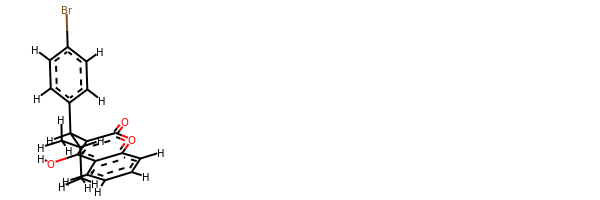

rdkit:  [H]Oc1c(C([H])(c2c([H])c([H])c(Br)c([H])c2[H])C([H])(C([H])([H])[H])C([H])([H])[H])c(=O)oc2c([H])c([H])c([H])c([H])c12
oechem:  CC(C)C(c1ccc(cc1)Br)c2c(c3ccccc3oc2=O)O
###########################################################################
 #########################################################

bond
28.397432473117828 kJ/mol 56760.819791258386 kJ/mol False
angle
24.81431418848025 kJ/mol 24.81431418848025 kJ/mol True
nb
102.65519763530719 kJ/mol 102.65519763530719 kJ/mol True
torsion
1.8988733201957202 kJ/mol 0.2548438009948358 kJ/mol False
157.765817617101 kJ/mol 56888.54414688317 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6552


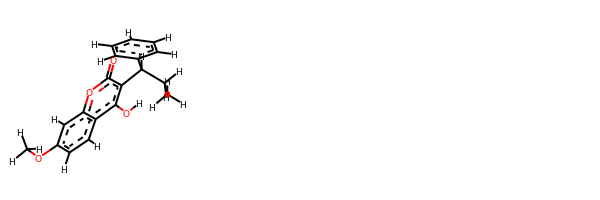

rdkit:  [H]Oc1c(C([H])(c2c([H])c([H])c([H])c([H])c2[H])C([H])([H])C([H])([H])[H])c(=O)oc2c([H])c(OC([H])([H])[H])c([H])c([H])c12
oechem:  CCC(c1ccccc1)c2c(c3ccc(cc3oc2=O)OC)O
###########################################################################
 #########################################################

bond
43.4474548058509 kJ/mol 56774.15004366477 kJ/mol False
angle
61.72781077233127 kJ/mol 61.72781077233127 kJ/mol True
nb
186.46525865976648 kJ/mol 186.46525865976648 kJ/mol True
torsion
46.173479792718155 kJ/mol 44.53037887647181 kJ/mol False
337.8140040306668 kJ/mol 57066.87349197334 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6553


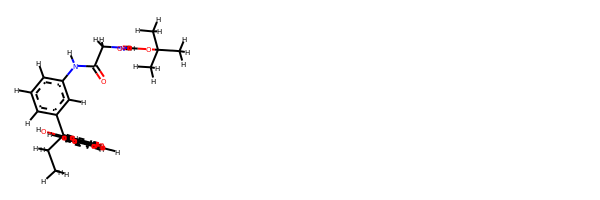

rdkit:  [H]Oc1c(C([H])(c2c([H])c([H])c([H])c(N([H])C(=O)C([H])([H])N([H])C(=O)OC(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H])c2[H])C([H])([H])C([H])([H])[H])c(=O)oc2c([H])c([H])c([H])c([H])c12
oechem:  CCC(c1cccc(c1)NC(=O)CNC(=O)OC(C)(C)C)c2c(c3ccccc3oc2=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
13.196760020273933 kJ/mol 43684.61580753656 kJ/mol Fal

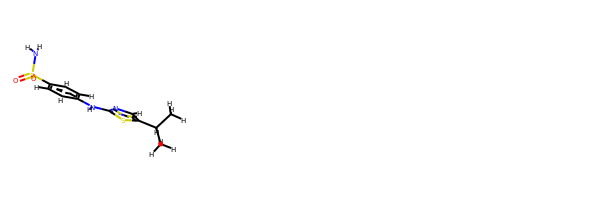

rdkit:  [H]c1nc(N([H])c2c([H])c([H])c(S(=O)(=O)N([H])[H])c([H])c2[H])sc1C([H])(C([H])([H])[H])C([H])([H])[H]
oechem:  CC(C)c1cnc(s1)Nc2ccc(cc2)S(=O)(=O)N
###########################################################################
 #########################################################

bond
37.83747095123568 kJ/mol 57697.34341861261 kJ/mol False
angle
325.69436079837413 kJ/mol 325.69436079837413 kJ/mol True
nb
29.958917657162434 kJ/mol 29.958917657162434 kJ/mol True
torsion
125.06386744065631 kJ/mol 89.97059889814395 kJ/mol False
518.5546168474286 kJ/mol 58142.96729596629 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6563


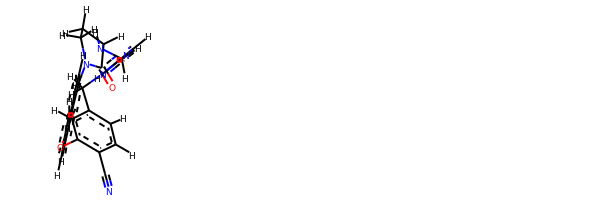

rdkit:  [H]c1nc([H])n2c1C([H])([H])N([H])C1([H])C(=O)N(c3c([H])c([H])c([H])c4c([H])c([H])c(c([H])c34)Oc3c([H])c(c([H])c([H])c3C#N)C2([H])[H])C([H])([H])C1([H])[H]
oechem:  c1cc2ccc3cc2c(c1)N4CCC(C4=O)NCc5cncn5Cc6ccc(c(c6)O3)C#N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
37.76146016147618 kJ/mol 57737.153605700514 kJ/mol False
angle
335.9902507259271 kJ/mol 335.9902507259271 kJ/mol True
nb
26.593870773783454 kJ/mol 26.593870773783454 kJ/mol True
torsion
135.22722243530802 kJ/mol 121.23922376967758 kJ/mol False
535.5728040964948 kJ/mol 58220.976950969896 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
---------------------------------------------------------------

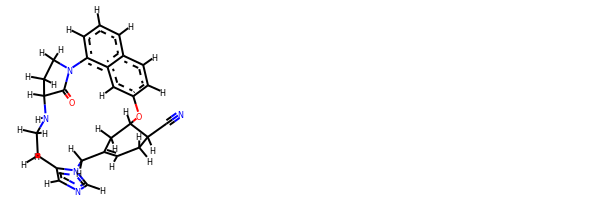

rdkit:  [H]C1=C2C([H])([H])n3c([H])nc([H])c3C([H])([H])C([H])([H])N([H])C3([H])C(=O)N(c4c([H])c([H])c([H])c5c([H])c([H])c(c([H])c45)OC([H])(C2([H])[H])C([H])(C#N)C1([H])[H])C([H])([H])C3([H])[H]
oechem:  c1cc2ccc3cc2c(c1)N4CCC(C4=O)NCCc5cncn5CC6=CCC(C(C6)O3)C#N
###########################################################################
 #########################################################

bond
7.984133495515362 kJ/mol 99173.00537890299 kJ/mol False
angle
61.21119500838182 kJ/mol 64.42156137446247 kJ/mol False
nb
24.80355446446506 kJ/mol 24.80355446446506 kJ/mol True
torsion
14.766130414878862 kJ/mol 12.590709959791681 kJ/mol False
108.7650133832411 kJ/mol 99274.82120470172 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6566


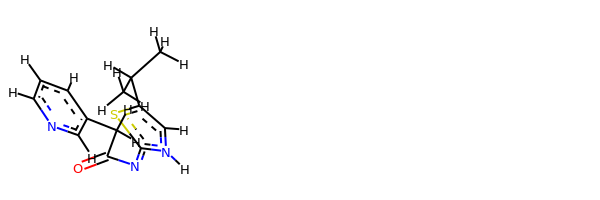

rdkit:  [H]c1nc([H])c(C([H])([H])C(=O)N=c2sc(C([H])(C([H])([H])[H])C([H])([H])[H])c([H])n2[H])c([H])c1[H]
oechem:  CC(C)c1c[nH]c(=NC(=O)Cc2cccnc2)s1
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
23.20492720635911 kJ/mol 58387.779426227986 kJ/mol False
angle
139.12641855764187 kJ/mol 139.12641855764187 kJ/mol True
nb
3.614632943123453 kJ/mol 3.614632943123453 kJ/mol True
torsion
69.23413066489765 kJ/mol 69.23413103555038 kJ/mol False
235.1801093720221 kJ/mol 58599.7546087643 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6568


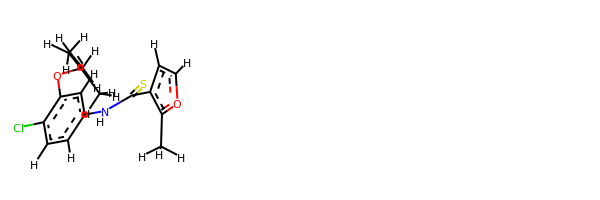

rdkit:  [H]C(=C(C([H])([H])[H])C([H])([H])[H])C([H])([H])Oc1c([H])c(N([H])C(=S)c2c(C([H])([H])[H])oc([H])c2[H])c([H])c([H])c1Cl
oechem:  Cc1c(cco1)C(=S)Nc2ccc(c(c2)OCC=C(C)C)Cl
###########################################################################
 #########################################################

bond
20.691066493428206 kJ/mol 58385.46755601138 kJ/mol False
angle
138.31504979404866 kJ/mol 138.31504979404866 kJ/mol True
nb
42.7345188777049 kJ/mol 42.7345188777049 kJ/mol True
torsion
44.60914902020162 kJ/mol 44.609149223120355 kJ/mol False
246.34978418538338 kJ/mol 58611.12627390626 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6569


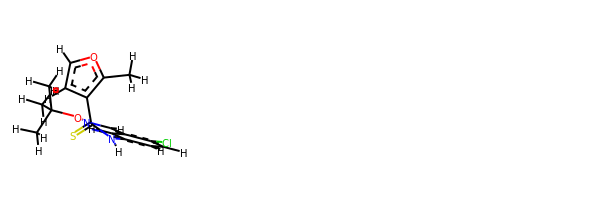

rdkit:  [H]C(=NOC(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H])c1c([H])c(N([H])C(=S)c2c(C([H])([H])[H])oc([H])c2[H])c([H])c([H])c1Cl
oechem:  Cc1c(cco1)C(=S)Nc2ccc(c(c2)C=NOC(C)(C)C)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
38.38958849448064 kJ/mol 114896.63042607717 kJ/mol False
angle
713.4901415991219 kJ/mol 713.4901415991219 kJ/mol True
nb
23.220686217023125 kJ/mol 23.220686217023125 kJ/mol True
torsion
77.08518565170222 kJ/mol 35.84449750003567 kJ/mol False
852.185601962328 kJ/mol 115669.18575139335 kJ/mol

-------------------------------------------------------------------
----------------------------------------

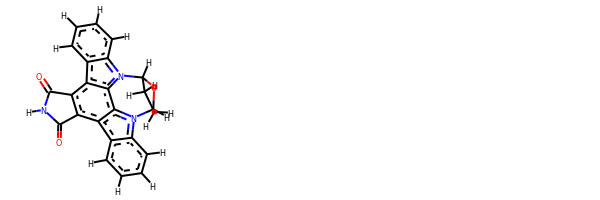

rdkit:  [H]c1c([H])c([H])c2c(c1[H])c1c3c(c4c5c([H])c([H])c([H])c([H])c5n5c4c1n2C1([H])OC5([H])C([H])([H])C1([H])[H])C(=O)N([H])C3=O
oechem:  c1ccc2c(c1)c3c4c(c5c6ccccc6n7c5c3n2C8CCC7O8)C(=O)NC4=O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
17.63477870035143 kJ/mol 57116.01451136069 kJ/mol False
angle
47.95498210892661 kJ/mol 47.95498210892661 kJ/mol True
nb
75.28246328992172 kJ/mol 75.28246328992172 kJ/mol True
torsion
20.591406277375995 kJ/mol 18.985832795479247 kJ/mol False
161.46363037657574 kJ/mol 57258.237789555016 kJ/mol

-------------------------------------------------------------------
-----------------------------

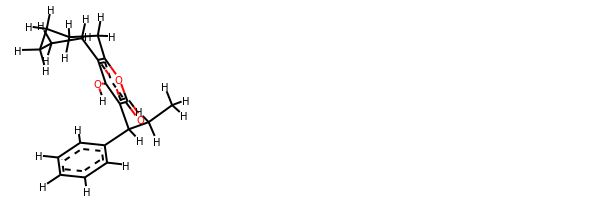

rdkit:  [H]Oc1c2c(oc(=O)c1C([H])(c1c([H])c([H])c([H])c([H])c1[H])C([H])([H])C([H])([H])[H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C2([H])[H]
oechem:  CCC(c1ccccc1)c2c(c3c(oc2=O)CCCCCC3)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
19.809693270433446 kJ/mol 57771.77933755642 kJ/mol False
angle
109.84395921796008 kJ/mol 109.84395921796008 kJ/m

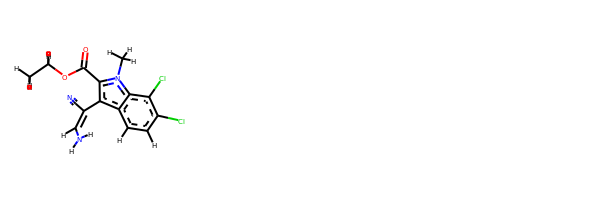

rdkit:  [H]C(=C(C#N)c1c(C(=O)OC([H])([H])C([H])([H])[H])n(C([H])([H])[H])c2c(Cl)c(Cl)c([H])c([H])c12)N([H])[H]
oechem:  CCOC(=O)c1c(c2ccc(c(c2n1C)Cl)Cl)C(=CN)C#N
###########################################################################
 #########################################################

bond
16.564993468763255 kJ/mol 85255.91722728104 kJ/mol False
angle
123.15748305428957 kJ/mol 123.15748305428957 kJ/mol True
nb
53.96830118826985 kJ/mol 53.96830118826985 kJ/mol True
torsion
32.6316305099204 kJ/mol 15.895748994618035 kJ/mol False
226.32240822124305 kJ/mol 85448.93876051823 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6583


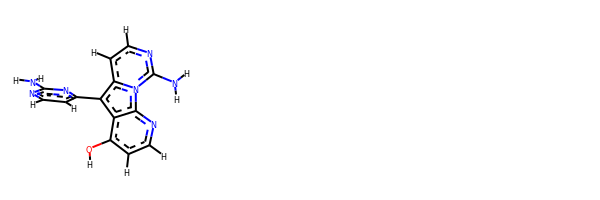

rdkit:  [H]Oc1c([H])c([H])nc2c1c(-c1nc(N([H])[H])nc([H])c1[H])c1c([H])c([H])nc(N([H])[H])n12
oechem:  c1cnc(n2c1c(c3c2nccc3O)c4ccnc(n4)N)N
###########################################################################
 #########################################################

bond
17.73694698626514 kJ/mol 29088.414539254612 kJ/mol False
angle
87.70402846638393 kJ/mol 89.38244138688442 kJ/mol False
nb
28.473003852811065 kJ/mol 28.473003852811065 kJ/mol True
torsion
7.322685223511696 kJ/mol 5.231435161933003 kJ/mol False
141.23666452897183 kJ/mol 29211.50141965624 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6584


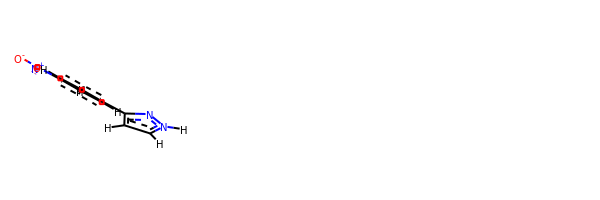

rdkit:  [H]c1c([H])c([N+](=O)[O-])c([H])c([H])c1-c1nn([H])c([H])c1[H]
oechem:  c1cc(ccc1c2cc[nH]n2)[N+](=O)[O-]
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
28.653403518736276 kJ/mol 43816.915722172715 kJ/mol False
angle
235.1273844985425 kJ/mol 237.2808748296978 kJ/mol False
nb
37.86262064345968 kJ/mol 37.86262064345968 kJ/mol True
torsion
72.72082998290229 kJ/mol 68.70304039200693 kJ/mol False
374.36423864364076 kJ/mol 44160.762258037874 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
--------------------------------------------

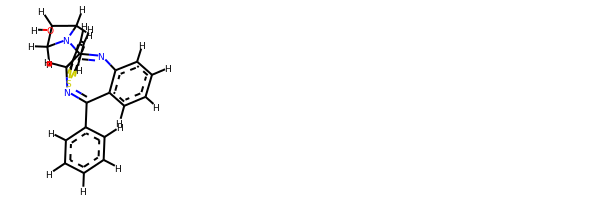

rdkit:  [H]OC1([H])C([H])([H])N(C2=Nc3c([H])c([H])c([H])c([H])c3C(c3c([H])c([H])c([H])c([H])c3[H])=NC2([H])c2sc([H])c([H])c2[H])C1([H])[H]
oechem:  c1ccc(cc1)C2=NC(C(=Nc3c2cccc3)N4CC(C4)O)c5cccs5
###########################################################################
 #########################################################

bond
17.492398611783486 kJ/mol 29101.83447455536 kJ/mol False
angle
122.99281261264589 kJ/mol 122.99281261264589 kJ/mol True
nb
42.5869718748972 kJ/mol 42.5869718748972 kJ/mol True
torsion
5.5375688506089675 kJ/mol 0.3079401999644104 kJ/mol False
188.60975194993557 kJ/mol 29267.722199242868 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6588


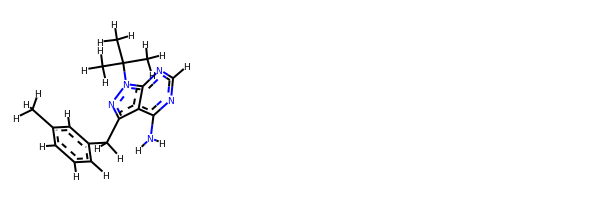

rdkit:  [H]c1nc(N([H])[H])c2c(C([H])([H])c3c([H])c([H])c([H])c(C([H])([H])[H])c3[H])nn(C(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H])c2n1
oechem:  Cc1cccc(c1)Cc2c3c(ncnc3n(n2)C(C)(C)C)N
###########################################################################
 #########################################################

bond
24.294197086283383 kJ/mol 29092.443426444686 kJ/mol False
angle
110.42299867904399 kJ/mol 110.42299867904399 kJ/mol True
nb
93.89102325577825 kJ/mol 93.89102325577825 kJ/mol True
torsion
51.760501278492605 kJ/mol 46.53050611807959 kJ/mol False
280.36872029959824 kJ/mol 29343.28795449759 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6589


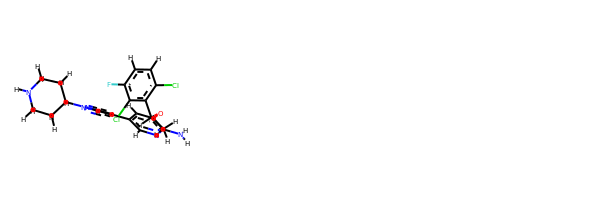

rdkit:  [H]c1nc(N([H])[H])c(OC([H])(c2c(Cl)c([H])c([H])c(F)c2Cl)C([H])([H])[H])c([H])c1-c1c([H])nn(C2([H])C([H])([H])C([H])([H])N([H])C([H])([H])C2([H])[H])c1[H]
oechem:  CC(c1c(ccc(c1Cl)F)Cl)Oc2cc(cnc2N)c3cnn(c3)C4CCNCC4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
14.341263261216012 kJ/mol 58379.24030507713 kJ/mol False
angle
123.58409530593303 kJ/mol 123.58409530593303 kJ/mol True
nb
22.232960746388482 kJ/mol 22.232960746388482 kJ/mol True
torsion
77.9183321445126 kJ/mol 67.35910976242293 kJ/mol False
238.0766514580501 kJ/mol 58592.416470891876 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
Dr

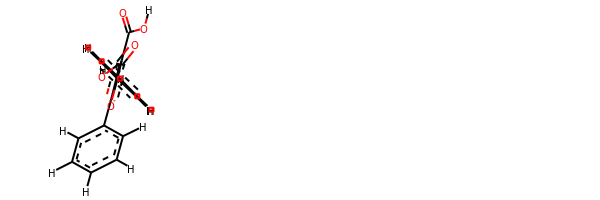

rdkit:  [H]OC(=O)c1c(-c2c([H])c([H])c([H])c([H])c2[H])oc(-c2c([H])c([H])c([H])c([H])c2[H])c1C(=O)O[H]
oechem:  c1ccc(cc1)c2c(c(c(o2)c3ccccc3)C(=O)O)C(=O)O
###########################################################################
 #########################################################

bond
19.4325117109633 kJ/mol 57653.36143768835 kJ/mol False
angle
217.20938648976065 kJ/mol 217.20938648976065 kJ/mol True
nb
133.80217719859618 kJ/mol 133.80217719859618 kJ/mol True
torsion
55.11701869004689 kJ/mol 55.78298682101341 kJ/mol False
425.561094089367 kJ/mol 58060.155988197715 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6592


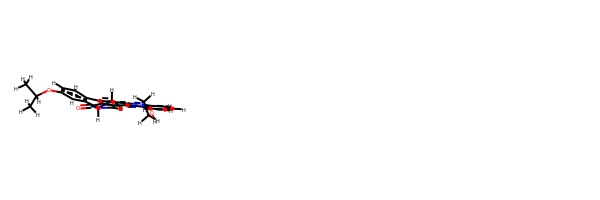

rdkit:  [H]OC([H])([H])C([H])([H])n1c2c([H])c([H])c([H])c([H])c2c2c3c(c4c(c21)C([H])([H])C([H])([H])c1c([H])c(OC([H])(C([H])([H])[H])C([H])([H])[H])c([H])c([H])c1-4)C(=O)N=C3[H]
oechem:  CC(C)Oc1ccc-2c(c1)CCc3c2c4c(c5c3n(c6c5cccc6)CCO)C=NC4=O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
14.172704652384777 kJ/mol 57535.29611878912 kJ/mol False
angle
7.588285791978598 kJ/mol 7.788250839535451 kJ/mol False
nb
37.430933063519106 kJ/mol 37.430933063519106 kJ/mol True
torsion
58.57968028082024 kJ/mol 41.84472560283756 kJ/mol False
117.77160378870272 kJ/mol 57622.360028295014 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
------------------------------------------------

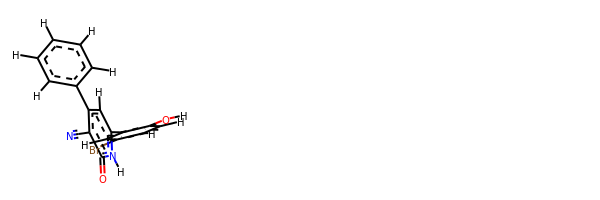

rdkit:  [H]Oc1c([H])c([H])c(Br)c([H])c1-c1c([H])c(-c2c([H])c([H])c([H])c([H])c2[H])c(C#N)c(=O)n1[H]
oechem:  c1ccc(cc1)c2cc([nH]c(=O)c2C#N)c3cc(ccc3O)Br
###########################################################################
 #########################################################

bond
27.3177091344957 kJ/mol 58393.60850029014 kJ/mol False
angle
129.11488013764784 kJ/mol 129.11488013764784 kJ/mol True
nb
18.16035879288055 kJ/mol 18.16035879288055 kJ/mol True
torsion
21.771711029813176 kJ/mol 21.771700753337992 kJ/mol False
196.36465909483726 kJ/mol 58562.655439974005 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6595


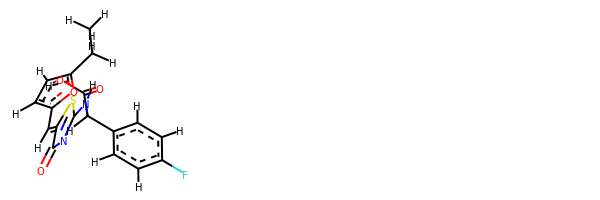

rdkit:  [H]OC(=O)C([H])(c1c([H])c([H])c(F)c([H])c1[H])N([H])C1=NC(=O)C(=C([H])c2oc(C([H])([H])C([H])([H])[H])c([H])c2[H])S1
oechem:  CCc1ccc(o1)C=C2C(=O)N=C(S2)NC(c3ccc(cc3)F)C(=O)O
###########################################################################
 #########################################################

bond
18.205838390311627 kJ/mol 57741.722745595005 kJ/mol False
angle
131.20236482926063 kJ/mol 131.20236482926063 kJ/mol True
nb
41.36933600081873 kJ/mol 41.36933600081873 kJ/mol True
torsion
31.542310169451646 kJ/mol 31.542261819731156 kJ/mol False
222.31984938984263 kJ/mol 57945.83670824482 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6596


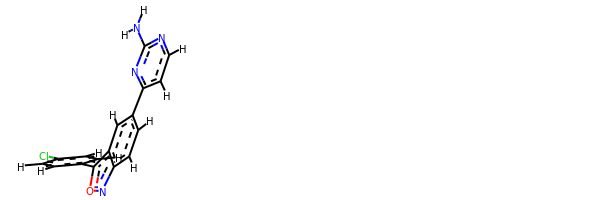

rdkit:  [H]c1nc(N([H])[H])nc(-c2c([H])c([H])c3noc(-c4c([H])c([H])c(Cl)c([H])c4[H])c3c2[H])c1[H]
oechem:  c1cc(ccc1c2c3cc(ccc3no2)c4ccnc(n4)N)Cl
###########################################################################
 #########################################################

bond
24.179480912879615 kJ/mol 57945.41652468452 kJ/mol False
angle
92.89900906820681 kJ/mol 92.89900906820681 kJ/mol True
nb
42.56904293919254 kJ/mol 42.56904293919254 kJ/mol True
torsion
31.423679440000015 kJ/mol 28.42342864663984 kJ/mol False
191.07121236027896 kJ/mol 58109.30800533856 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6597


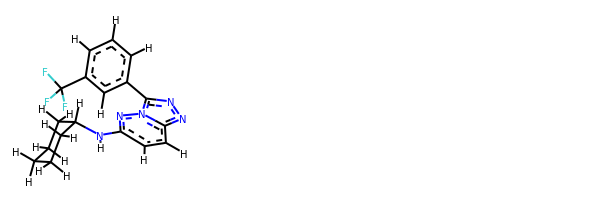

rdkit:  [H]c1c([H])c(-c2nnc3c([H])c([H])c(N([H])C4([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C4([H])[H])nn23)c([H])c(C(F)(F)F)c1[H]
oechem:  c1cc(cc(c1)C(F)(F)F)c2nnc3n2nc(cc3)NC4CCCCC4
###########################################################################
 #########################################################

bond
6.31098573297959 kJ/mol 57758.21633239979 kJ/mol False
angle
87.42795449044547 kJ/mol 88.66048025665498 kJ/mol False
nb
42.390407853046206 kJ/mol 42.390407853046206 kJ/mol True
torsion
47.30843822893418 kJ/mol 47.30856968614188 kJ/mol False
183.43778630540544 kJ/mol 57936.57579019564 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6598


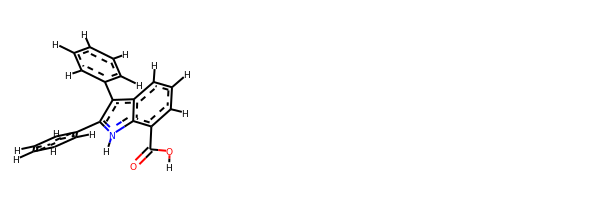

rdkit:  [H]OC(=O)c1c([H])c([H])c([H])c2c(-c3c([H])c([H])c([H])c([H])c3[H])c(-c3c([H])c([H])c([H])c([H])c3[H])n([H])c12
oechem:  c1ccc(cc1)c2c3cccc(c3[nH]c2c4ccccc4)C(=O)O
###########################################################################
 #########################################################

bond
32.25189743468013 kJ/mol 87592.03131284029 kJ/mol False
angle
197.80431244301113 kJ/mol 200.54429647738223 kJ/mol False
nb
13.492288766024819 kJ/mol 13.492288766024819 kJ/mol True
torsion
51.32638825811242 kJ/mol 21.908818049998306 kJ/mol False
294.8748869018285 kJ/mol 87827.9767161337 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6599


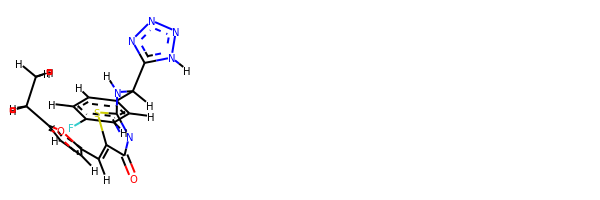

rdkit:  [H]C(=C1SC(N([H])C([H])(c2c([H])c([H])c(F)c([H])c2[H])c2nnnn2[H])=NC1=O)c1oc(C([H])([H])C([H])([H])[H])c([H])c1[H]
oechem:  CCc1ccc(o1)C=C2C(=O)N=C(S2)NC(c3ccc(cc3)F)c4[nH]nnn4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
28.174179141154955 kJ/mol 57738.44401709792 kJ/mol False
angle
177.50848572515372 kJ/mol 177.50848572515372 kJ/mol True
nb
25.71613456350247 kJ/mol 25.71613456350247 kJ/mol True
torsion
45.529673830648846 kJ/mol 49.67460580260317 kJ/mol False
276.92847326046 kJ/mol 57991.343243189185 kJ/mol

-------------------------------------------------------------------
-----------------------------------------

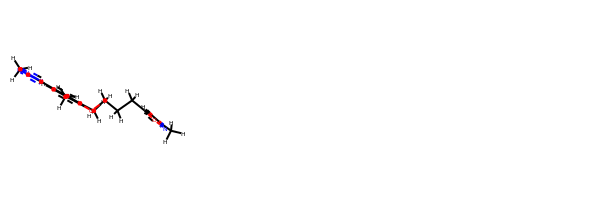

rdkit:  [H]c1c(C([H])([H])[H])noc1C([H])([H])C([H])([H])C([H])([H])Oc1c(C([H])([H])[H])c([H])c(-c2nnn(C([H])([H])[H])n2)c([H])c1C([H])([H])[H]
oechem:  Cc1cc(cc(c1OCCCc2cc(no2)C)C)c3nnn(n3)C
###########################################################################
 #########################################################

bond
30.273250477805348 kJ/mol 57741.248434547495 kJ/mol False
angle
179.94357997944132 kJ/mol 179.94357997944132 kJ/mol True
nb
31.90504397391009 kJ/mol 31.90504397391009 kJ/mol True
torsion
38.043666461939324 kJ/mol 27.583655989077826 kJ/mol False
280.1655408930961 kJ/mol 57980.68071448993 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6603


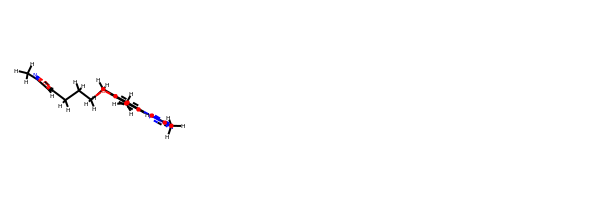

rdkit:  [H]c1c(C([H])([H])[H])noc1C([H])([H])C([H])([H])C([H])([H])Oc1c(C([H])([H])[H])c([H])c(-n2nnc(C([H])([H])[H])n2)c([H])c1C([H])([H])[H]
oechem:  Cc1cc(cc(c1OCCCc2cc(no2)C)C)n3nc(nn3)C
###########################################################################
 #########################################################

bond
30.329031615588672 kJ/mol 115989.00341323612 kJ/mol False
angle
195.09755975087288 kJ/mol 195.09755975087288 kJ/mol True
nb
23.526697011698865 kJ/mol 23.526697011698865 kJ/mol True
torsion
27.58397411046892 kJ/mol 27.58390610108702 kJ/mol False
276.5372624886293 kJ/mol 116235.21157609977 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6604


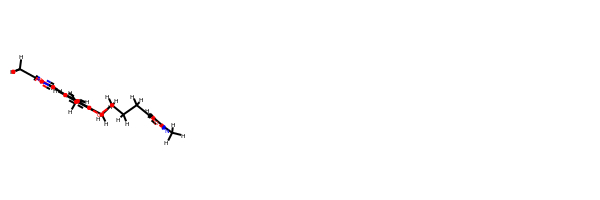

rdkit:  [H]c1oc(C([H])([H])[H])nc1-c1c([H])c(C([H])([H])[H])c(OC([H])([H])C([H])([H])C([H])([H])c2onc(C([H])([H])[H])c2[H])c(C([H])([H])[H])c1[H]
oechem:  Cc1cc(cc(c1OCCCc2cc(no2)C)C)c3coc(n3)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
9.310152030830588 kJ/mol 43796.500391969166 kJ/mol False
angle
36.02739452818381 kJ/mol 38.180953361268045 kJ/mol False
nb
8.306249883626139 kJ/mol 8.306249883626139 kJ/mol True
torsion
21.04341595403435 kJ/mol 21.04341631892158 kJ/mol False
74.6872123966749 kJ/mol 43864.03101153298 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6606


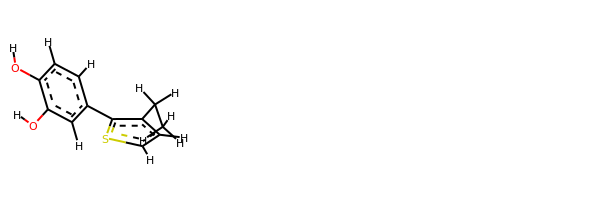

rdkit:  [H]Oc1c([H])c([H])c(-c2sc([H])c([H])c2C([H])([H])C([H])([H])[H])c([H])c1O[H]
oechem:  CCc1ccsc1c2ccc(c(c2)O)O
###########################################################################
 #########################################################

bond
26.232043087014205 kJ/mol 57742.09947231919 kJ/mol False
angle
278.40612561560334 kJ/mol 278.40612561560334 kJ/mol True
nb
20.748541835536567 kJ/mol 20.748541835536567 kJ/mol True
torsion
58.480347272750194 kJ/mol 58.4803241709856 kJ/mol False
383.8670578109043 kJ/mol 58099.73446394132 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6607


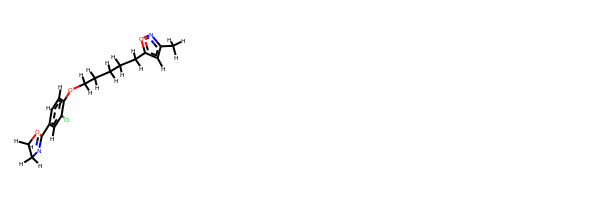

rdkit:  [H]c1c(C([H])([H])[H])noc1C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])Oc1c([H])c([H])c(C2=NC([H])([H])C([H])([H])O2)c([H])c1Cl
oechem:  Cc1cc(on1)CCCCCOc2ccc(cc2Cl)C3=NCCO3
###########################################################################
 #########################################################

bond
26.277888897585267 kJ/mol 57741.793453045175 kJ/mol False
angle
278.01294333713406 kJ/mol 278.01294333713406 kJ/mol True
nb
32.40489285376937 kJ/mol 32.40489285376937 kJ/mol True
torsion
49.691152496753425 kJ/mol 49.69112930891525 kJ/mol False
386.38687758524213 kJ/mol 58101.90241854499 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6608


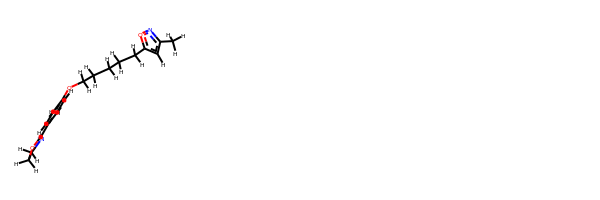

rdkit:  [H]c1c(C([H])([H])[H])noc1C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])Oc1c([H])c([H])c(C2=NC([H])([H])C([H])([H])O2)c([H])c1[H]
oechem:  Cc1cc(on1)CCCCCOc2ccc(cc2)C3=NCCO3
###########################################################################
 #########################################################

bond
43.41299143720951 kJ/mol 57758.70634105005 kJ/mol False
angle
283.50341441325776 kJ/mol 283.50341441325776 kJ/mol True
nb
20.391580681382514 kJ/mol 20.391580681382514 kJ/mol True
torsion
85.48199445202975 kJ/mol 85.48197045960978 kJ/mol False
432.78998098387956 kJ/mol 58148.0833066043 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6609


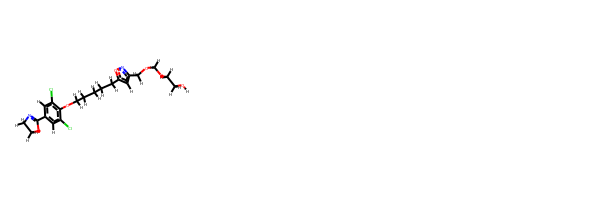

rdkit:  [H]OC([H])([H])C([H])([H])OC([H])([H])OC([H])([H])c1noc(C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])Oc2c(Cl)c([H])c(C3=NC([H])([H])C([H])([H])O3)c([H])c2Cl)c1[H]
oechem:  c1c(cc(c(c1Cl)OCCCCCc2cc(no2)COCOCCO)Cl)C3=NCCO3
###########################################################################
 #########################################################

bond
26.771008176939993 kJ/mol 57741.32807132865 kJ/mol False
angle
285.40772038350684 kJ/mol 285.40772038350684 kJ/mol True
nb
22.48935329058504 kJ/mol 22.48935329058504 kJ/mol True
torsion
62.96457353023671 kJ/mol 62.96455752475304 kJ/mol False
397.63265538126853 kJ/mol 58112.189702527496 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6610


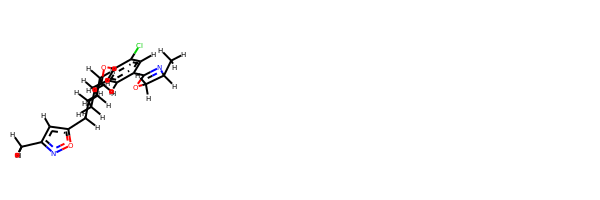

rdkit:  [H]c1c(C([H])([H])[H])noc1C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])Oc1c([H])c([H])c(C2=NC([H])(C([H])([H])[H])C([H])([H])O2)c([H])c1Cl
oechem:  Cc1cc(on1)CCCCCCCOc2ccc(cc2Cl)C3=NC(CO3)C
###########################################################################
 #########################################################

bond
26.17385254694267 kJ/mol 57742.73542619731 kJ/mol False
angle
278.3370889217106 kJ/mol 278.3370889217106 kJ/mol True
nb
18.160650554130168 kJ/mol 18.160650554130168 kJ/mol True
torsion
58.70286800174172 kJ/mol 58.70283855601388 kJ/mol False
381.3744600245251 kJ/mol 58097.93600422916 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6611


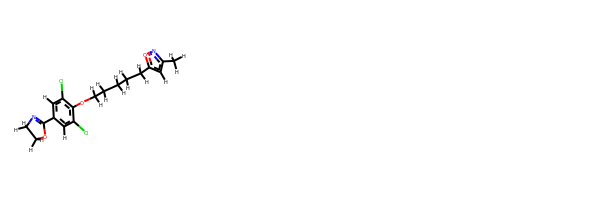

rdkit:  [H]c1c(C([H])([H])[H])noc1C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])Oc1c(Cl)c([H])c(C2=NC([H])([H])C([H])([H])O2)c([H])c1Cl
oechem:  Cc1cc(on1)CCCCCOc2c(cc(cc2Cl)C3=NCCO3)Cl
###########################################################################
 #########################################################

bond
26.49711924488465 kJ/mol 57741.70182686625 kJ/mol False
angle
282.38642505724874 kJ/mol 282.38642505724874 kJ/mol True
nb
33.09895255399707 kJ/mol 33.09895255399707 kJ/mol True
torsion
50.671548463049874 kJ/mol 50.67152388391566 kJ/mol False
392.65404531918034 kJ/mol 58107.85872836142 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6612


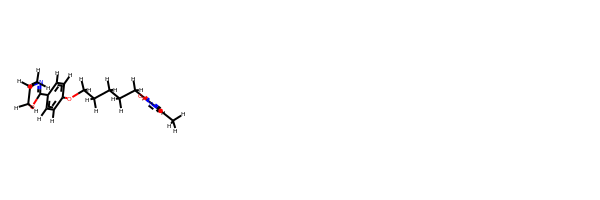

rdkit:  [H]c1c(C([H])([H])[H])noc1C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])Oc1c([H])c([H])c(C2=NC([H])(C([H])([H])[H])C([H])([H])O2)c([H])c1[H]
oechem:  Cc1cc(on1)CCCCCOc2ccc(cc2)C3=NC(CO3)C
###########################################################################
 #########################################################

bond
28.0684614714185 kJ/mol 57740.34745670059 kJ/mol False
angle
285.87132521381716 kJ/mol 285.87132521381716 kJ/mol True
nb
38.07742894898423 kJ/mol 38.07742894898423 kJ/mol True
torsion
55.90760009848472 kJ/mol 55.907577958086364 kJ/mol False
407.9248157327046 kJ/mol 58120.20378882148 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6613


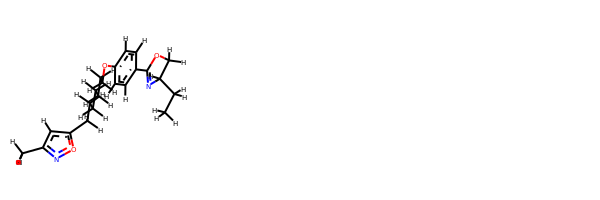

rdkit:  [H]c1c(C([H])([H])[H])noc1C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])Oc1c([H])c([H])c(C2=NC([H])(C([H])([H])C([H])([H])[H])C([H])([H])O2)c([H])c1[H]
oechem:  CCC1COC(=N1)c2ccc(cc2)OCCCCCCCc3cc(no3)C
###########################################################################
 #########################################################

bond
26.59501581414979 kJ/mol 57740.81861476324 kJ/mol False
angle
280.64872540599754 kJ/mol 280.64872540599754 kJ/mol True
nb
33.46814593571503 kJ/mol 33.46814593571503 kJ/mol True
torsion
53.200776031967756 kJ/mol 53.20075754963487 kJ/mol False
393.9126631878301 kJ/mol 58108.13624365458 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6614


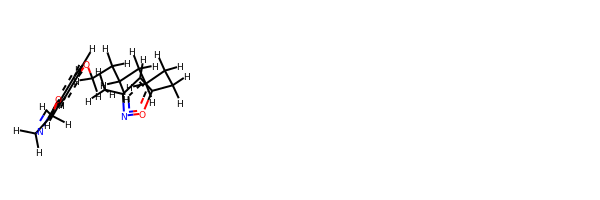

rdkit:  [H]c1c(C([H])([H])[H])noc1C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])Oc1c([H])c([H])c(C2=NC([H])([H])C([H])([H])O2)c([H])c1[H]
oechem:  Cc1cc(on1)CCCCCCCOc2ccc(cc2)C3=NCCO3
###########################################################################
 #########################################################

bond
26.819931758074745 kJ/mol 57740.62887242652 kJ/mol False
angle
285.04104551600403 kJ/mol 285.04104551600403 kJ/mol True
nb
34.16525407235789 kJ/mol 34.16525407235789 kJ/mol True
torsion
54.197205996225826 kJ/mol 54.197188312230715 kJ/mol False
400.22343734266246 kJ/mol 58114.03236032711 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6615


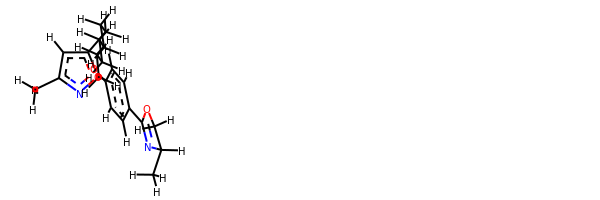

rdkit:  [H]c1c(C([H])([H])[H])noc1C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])Oc1c([H])c([H])c(C2=NC([H])(C([H])([H])[H])C([H])([H])O2)c([H])c1[H]
oechem:  Cc1cc(on1)CCCCCCCOc2ccc(cc2)C3=NC(CO3)C
###########################################################################
 #########################################################

bond
25.534311530668617 kJ/mol 57739.68111718368 kJ/mol False
angle
277.5473164983657 kJ/mol 277.5473164983657 kJ/mol True
nb
16.12412298193989 kJ/mol 16.12412298193989 kJ/mol True
torsion
55.29404096550522 kJ/mol 55.29403160485009 kJ/mol False
374.4997919764794 kJ/mol 58088.646588268835 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6616


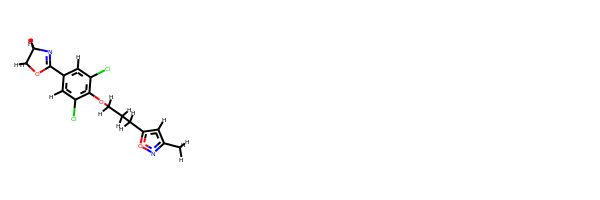

rdkit:  [H]c1c(C([H])([H])[H])noc1C([H])([H])C([H])([H])C([H])([H])Oc1c(Cl)c([H])c(C2=NC([H])([H])C([H])([H])O2)c([H])c1Cl
oechem:  Cc1cc(on1)CCCOc2c(cc(cc2Cl)C3=NCCO3)Cl
###########################################################################
 #########################################################

bond
44.02378108025175 kJ/mol 129325.75604410272 kJ/mol False
angle
181.22309346795473 kJ/mol 183.57894255622247 kJ/mol False
nb
10.023040278008276 kJ/mol 10.023040278008276 kJ/mol True
torsion
118.8742702468902 kJ/mol 96.90872827120054 kJ/mol False
354.144185073105 kJ/mol 129616.26675520815 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6617


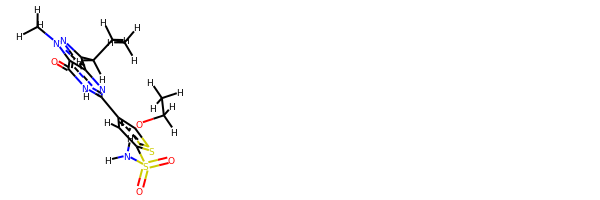

rdkit:  [H]c1c(S(=O)(=O)N([H])[H])sc(OC([H])([H])C([H])([H])[H])c1-c1nc2c(C([H])([H])C([H])([H])C([H])([H])[H])nn(C([H])([H])[H])c2c(=O)n1[H]
oechem:  CCCc1c2c(c(=O)[nH]c(n2)c3cc(sc3OCC)S(=O)(=O)N)n(n1)C
###########################################################################
 #########################################################

bond
30.960245935634106 kJ/mol 57783.588226872154 kJ/mol False
angle
106.58120515586656 kJ/mol 106.58120515586656 kJ/mol True
nb
87.74070202980778 kJ/mol 87.74070202980778 kJ/mol True
torsion
19.163124213562355 kJ/mol 19.1631383745899 kJ/mol False
244.4452773348708 kJ/mol 57997.07327243242 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6618


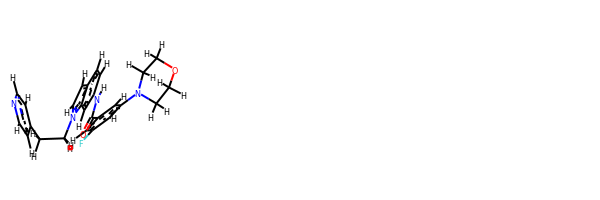

rdkit:  [H]c1nc([H])c([H])c(C([H])([H])C([H])([H])n2c([H])c([H])c3c([H])c([H])c(N([H])C(=O)c4c([H])c(F)c([H])c(N5C([H])([H])C([H])([H])OC([H])([H])C5([H])[H])c4[H])c([H])c32)c1[H]
oechem:  c1cc(cc2c1ccn2CCc3ccncc3)NC(=O)c4cc(cc(c4)F)N5CCOCC5
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
32.15110701950246 kJ/mol 43703.499502980936 kJ/mol False
angle
99.04593853558364 kJ/mol 102.40273706349704 kJ/mol False
nb
22.778207069766424 kJ/mol 22.778207069766424 kJ/mol True
torsion
50.942571220311635 kJ/mol 50.94261392606651 kJ/mol False
204.91782384516415 kJ/mol 43879.62306104026 kJ/mol

------------------------------------------------

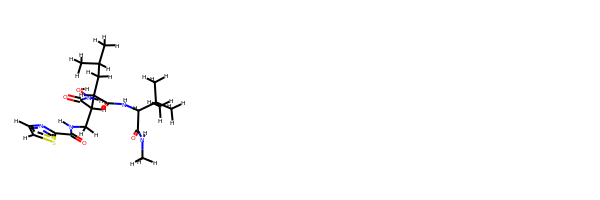

rdkit:  [H]ON([H])C(=O)C([H])(C([H])([H])N([H])C(=O)c1nc([H])c([H])s1)C([H])(C(=O)N([H])C([H])(C(=O)N([H])C([H])([H])[H])C(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H])C([H])([H])C([H])(C([H])([H])[H])C([H])([H])[H]
oechem:  CC(C)CC(C(CNC(=O)c1nccs1)C(=O)NO)C(=O)NC(C(=O)NC)C(C)(C)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
22.70959658966555 kJ/mol 56755.07786316515 kJ/mol False
angle
26.859253022141086 kJ/mol 26.859253022141086 kJ/mol True
nb
75.7730485454568 kJ/mol 75.7730485454568 kJ/mol True
torsion
13.540282242140387 kJ/mol 8.153418469919274 kJ/mol False
138.88218039940384 kJ/mol 56865.86358320267 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-----------

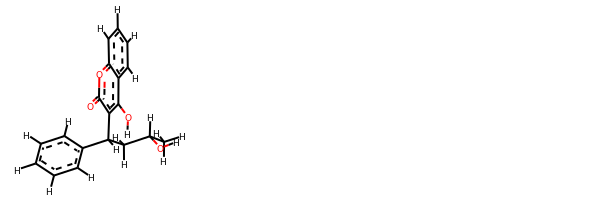

rdkit:  [H]Oc1c(C([H])(c2c([H])c([H])c([H])c([H])c2[H])C([H])([H])C([H])(O[H])C([H])([H])[H])c(=O)oc2c([H])c([H])c([H])c([H])c12
oechem:  CC(CC(c1ccccc1)c2c(c3ccccc3oc2=O)O)O
###########################################################################
 #########################################################

bond
22.70959658966555 kJ/mol 56755.07786316515 kJ/mol False
angle
26.859253022141086 kJ/mol 26.859253022141086 kJ/mol True
nb
75.7730485454568 kJ/mol 75.7730485454568 kJ/mol True
torsion
13.540282242140387 kJ/mol 8.153418469919274 kJ/mol False
138.88218039940384 kJ/mol 56865.86358320267 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6624


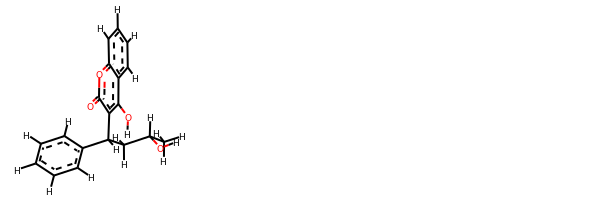

rdkit:  [H]Oc1c(C([H])(c2c([H])c([H])c([H])c([H])c2[H])C([H])([H])C([H])(O[H])C([H])([H])[H])c(=O)oc2c([H])c([H])c([H])c([H])c12
oechem:  CC(CC(c1ccccc1)c2c(c3ccccc3oc2=O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
31.199612310916425 kJ/mol 56330.59781988019 kJ/mol False
angle
621.8169892478548 kJ/mol 621.8169892478548 kJ/mol True
nb
67.04335494935371 kJ/mol 67.04335494935371 kJ/mol True
torsion
75.57575383693684 kJ/mol 83.378566926817 kJ/mol False
795.6357103450619 kJ/mol 57102.836731004216 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6626


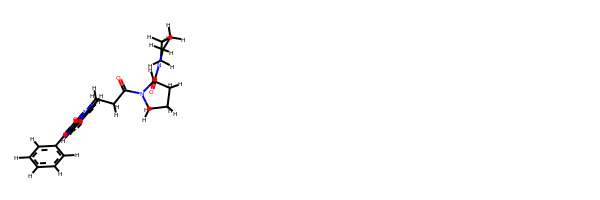

rdkit:  [H]c1c([H])c([H])c(-c2nc3c([H])c([H])c([H])c([H])c3n(C([H])([H])C([H])([H])C(=O)N3C([H])([H])C([H])([H])C([H])([H])C3([H])C(=O)N3C([H])([H])C([H])([H])C([H])([H])C3([H])[H])c2=O)c([H])c1[H]
oechem:  c1ccc(cc1)c2c(=O)n(c3ccccc3n2)CCC(=O)N4CCCC4C(=O)N5CCCC5
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
61.60288399917043 kJ/mol 169647.80395447565 kJ/mol 

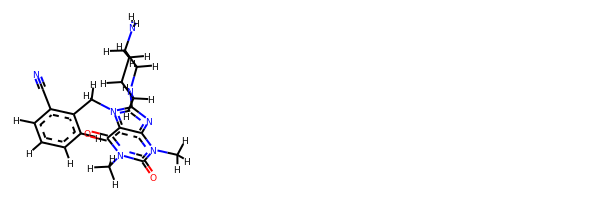

rdkit:  [H]c1c([H])c([H])c(C([H])([H])n2c(N3C([H])([H])C([H])([H])C([H])([H])C([H])(N([H])[H])C3([H])[H])nc3c2c(=O)n(C([H])([H])[H])c(=O)n3C([H])([H])[H])c(C#N)c1[H]
oechem:  Cn1c2c(c(=O)n(c1=O)C)n(c(n2)N3CCCC(C3)N)Cc4ccccc4C#N
###########################################################################
 #########################################################

bond
43.996950874729 kJ/mol 55881.714590918724 kJ/mol False
angle
138.09704506908696 kJ/mol 138.09704506908696 kJ/mol True
nb
59.83267032979688 kJ/mol 59.83267032979688 kJ/mol True
torsion
36.814187492947376 kJ/mol 36.814565217263606 kJ/mol False
278.74085376656024 kJ/mol 56116.458871534865 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6632


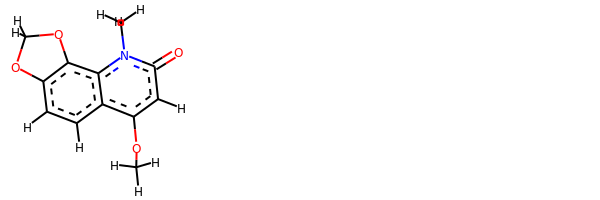

rdkit:  [H]c1c2c(c3c(c1[H])c(OC([H])([H])[H])c([H])c(=O)n3C([H])([H])[H])OC([H])([H])O2
oechem:  Cn1c(=O)cc(c2c1c3c(cc2)OCO3)OC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

########################################################

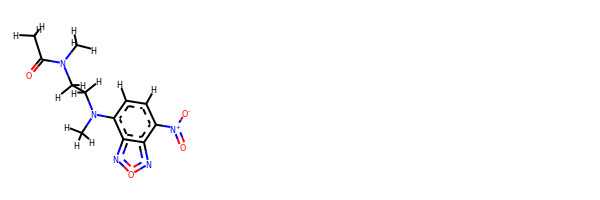

rdkit:  [H]c1c([H])c([N+](=O)[O-])c2nonc2c1N(C([H])([H])[H])C([H])([H])C([H])([H])N(C(=O)C([H])([H])[H])C([H])([H])[H]
oechem:  CC(=O)N(C)CCN(C)c1ccc(c2c1non2)[N+](=O)[O-]
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
24.9786

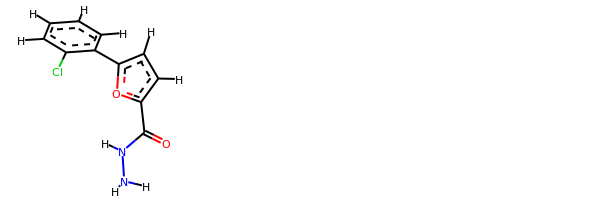

rdkit:  [H]c1c(C(=O)N([H])N([H])[H])oc(-c2c([H])c([H])c([H])c([H])c2Cl)c1[H]
oechem:  c1ccc(c(c1)c2ccc(o2)C(=O)NN)Cl
###########################################################################
 #########################################################

bond
20.055663326960524 kJ/mol 86034.46478356473 kJ/mol False
angle
90.10381501262682 kJ/mol 90.10381501262682 kJ/mol True
nb
26.324322169146157 kJ/mol 26.324322169146157 kJ/mol True
torsion
2.5266967111278036 kJ/mol 0.011313434404081061 kJ/mol False
139.0104972198613 kJ/mol 86150.90423418091 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6646


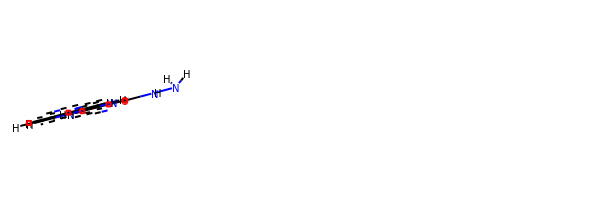

rdkit:  [H]c1c([H])c([H])c2c(c1[H])c([H])c([H])n1c([H])c(C(=O)N([H])N([H])[H])nc21
oechem:  c1ccc2c(c1)ccn3c2nc(c3)C(=O)NN
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
4.72736630374488 kJ/mol 43608.03172679816 kJ/mol False
a

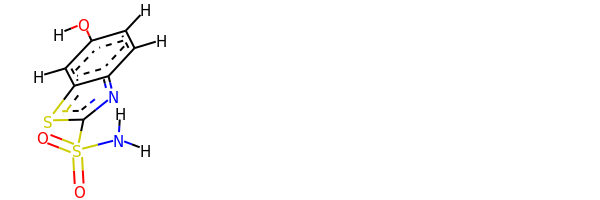

rdkit:  [H]Oc1c([H])c([H])c2nc(S(=O)(=O)N([H])[H])sc2c1[H]
oechem:  c1cc2c(cc1O)sc(n2)S(=O)(=O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
5.565484955646163 kJ/mol 57985.607968620505 kJ/mol False
angle
117.52970862305445 kJ/mol 119.64928743388764 kJ/mol False
nb
25.93926427646325 kJ/mol 25.93926427646325 kJ/mol True
torsion
16.027363256184582 kJ/mol 16.0273775376653 kJ/mol False
165.06182111134842 kJ/mol 58147.22389786852 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-----------------------------------------------------------

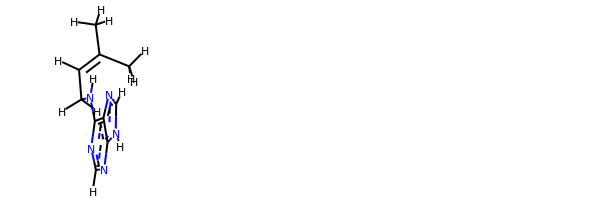

rdkit:  [H]C(=C(C([H])([H])[H])C([H])([H])[H])C([H])([H])N([H])c1nc([H])nc2c1nc([H])n2[H]
oechem:  CC(=CCNc1c2c([nH]cn2)ncn1)C
###########################################################################
 #########################################################

bond
22.21381835939261 kJ/mol 116121.97475764583 kJ/mol False
angle
178.7712680963426 kJ/mol 178.7712680963426 kJ/mol True
nb
42.097769749082865 kJ/mol 42.097769749082865 kJ/mol True
torsion
23.249975874577476 kJ/mol 0.026534758711670686 kJ/mol False
266.33283207939553 kJ/mol 116342.87033024998 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6657


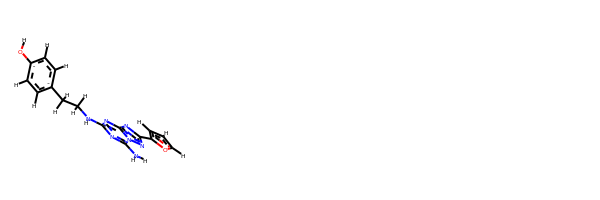

rdkit:  [H]Oc1c([H])c([H])c(C([H])([H])C([H])([H])N([H])c2nc(N([H])[H])n3nc(-c4oc([H])c([H])c4[H])nc3n2)c([H])c1[H]
oechem:  c1cc(oc1)c2nc3nc(nc(n3n2)N)NCCc4ccc(cc4)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
16.970579307523746 kJ/mol 72118.09822876238 kJ/mol False
angle
65.43144839072637 kJ/mol 68.56295654630352 kJ/mol False
nb
49.16780984912045 kJ/mol 49.16780984912045 kJ/mol True
torsion
31.71272722911383 kJ/mol 0.0025637065692120436 kJ/mol False
163.2825647764844 kJ/mol 72235.83155886437 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6659


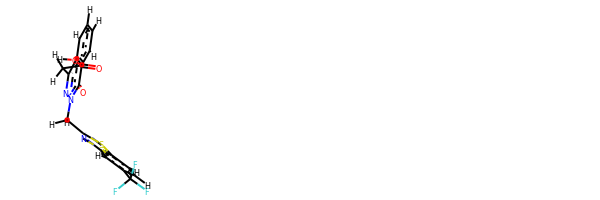

rdkit:  [H]OC(=O)C([H])([H])c1nn(C([H])([H])c2nc3c([H])c(C(F)(F)F)c([H])c([H])c3s2)c(=O)c2c([H])c([H])c([H])c([H])c12
oechem:  c1ccc2c(c1)c(nn(c2=O)Cc3nc4cc(ccc4s3)C(F)(F)F)CC(=O)O
###########################################################################
 #########################################################

bond
6.079799359243092 kJ/mol 43721.308720693625 kJ/mol False
angle
31.929544435744113 kJ/mol 33.77028900635751 kJ/mol False
nb
22.3536755408043 kJ/mol 22.3536755408043 kJ/mol True
torsion
15.690698204027672 kJ/mol 15.690701781805036 kJ/mol False
76.05371753981917 kJ/mol 43793.1233870226 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6660


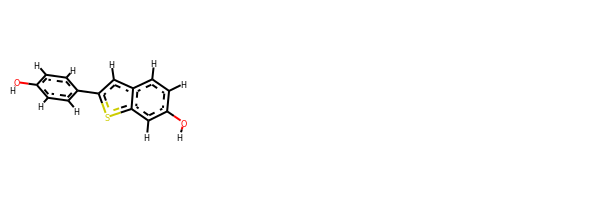

rdkit:  [H]Oc1c([H])c([H])c(-c2sc3c([H])c(O[H])c([H])c([H])c3c2[H])c([H])c1[H]
oechem:  c1cc(ccc1c2cc3ccc(cc3s2)O)O
###########################################################################
 #########################################################

bond
22.362626512850227 kJ/mol 29096.470390460407 kJ/mol False
angle
129.95928238517033 kJ/mol 131.6366104763519 kJ/mol False
nb
25.706523438203973 kJ/mol 25.706523438203973 kJ/mol True
torsion
57.78447347331548 kJ/mol 52.55450624748537 kJ/mol False
235.81290580953998 kJ/mol 29306.368030622445 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6661


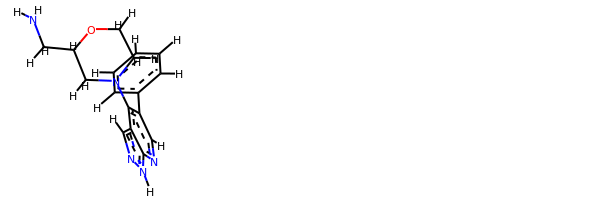

rdkit:  [H]c1nc2c(c([H])nn2[H])c(N2C([H])([H])C([H])([H])OC([H])(C([H])([H])N([H])[H])C2([H])[H])c1-c1c([H])c([H])c([H])c([H])c1[H]
oechem:  c1ccc(cc1)c2cnc3c(c2N4CCOC(C4)CN)cn[nH]3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
27.751676289352833 kJ/mol 43632.783590918574 kJ/mol False
angle
98.78105034184779 kJ/mol 101.74092441458959 kJ/mol False
nb
3.740292951172345 kJ/mol 3.740292951172345 kJ/mol True
torsion
30.5307823130197 kJ/mol 29.57507395033486 kJ/mol False
160.80380189539264 kJ/mol 43767.83988223467 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6663


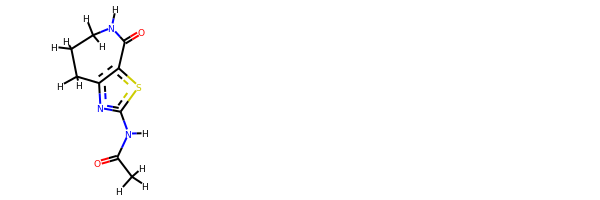

rdkit:  [H]N(C(=O)C([H])([H])[H])c1nc2c(s1)C(=O)N([H])C([H])([H])C([H])([H])C2([H])[H]
oechem:  CC(=O)Nc1nc2c(s1)C(=O)NCCC2
###########################################################################
 #########################################################

bond
20.21659278232314 kJ/mol 101071.77373093863 kJ/mol False
angle
78.06833333726452 kJ/mol 80.27699838719509 kJ/mol False
nb
23.08962201012124 kJ/mol 23.08962201012124 kJ/mol True
torsion
24.761778985120884 kJ/mol 5.250409049257696 kJ/mol False
146.13632711482978 kJ/mol 101180.39076038521 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6664


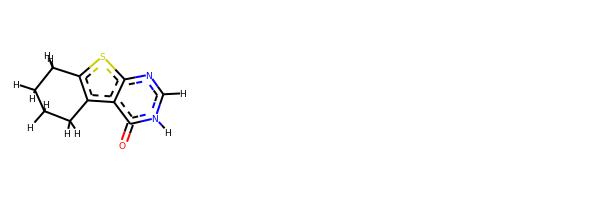

rdkit:  [H]c1nc2sc3c(c2c(=O)n1[H])C([H])([H])C([H])([H])C([H])([H])C3([H])[H]
oechem:  c1[nH]c(=O)c2c3c(sc2n1)CCCC3
###########################################################################
 #########################################################

bond
16.764032435073425 kJ/mol 43686.7137625025 kJ/mol False
angle
45.83972383235491 kJ/mol 49.19656368853255 kJ/mol False
nb
50.67821676002611 kJ/mol 50.67821676002611 kJ/mol True
torsion
37.708136231525714 kJ/mol 6.43420662863007 kJ/mol False
150.99010925898017 kJ/mol 43793.02274957969 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6665


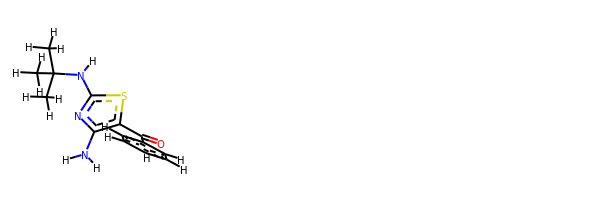

rdkit:  [H]c1c([H])c([H])c(C(=O)c2sc(N([H])C(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H])nc2N([H])[H])c([H])c1[H]
oechem:  CC(C)(C)Nc1nc(c(s1)C(=O)c2ccccc2)N
###########################################################################
 #########################################################

bond
14.951666969188041 kJ/mol 101822.34507132605 kJ/mol False
angle
116.77144784679983 kJ/mol 120.93531614443614 kJ/mol False
nb
-8.29019702889607 kJ/mol -8.29019702889607 kJ/mol True
torsion
8.64962525301253 kJ/mol 0.000765125332022889 kJ/mol False
132.08254304010435 kJ/mol 101934.99095556691 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6666


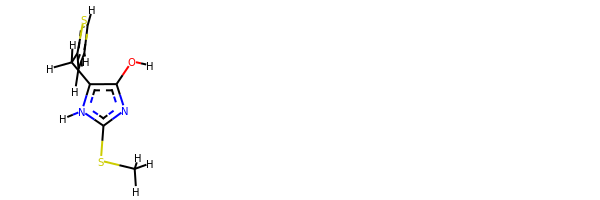

rdkit:  [H]Oc1nc(SC([H])([H])[H])n([H])c1C([H])([H])c1sc([H])c([H])c1[H]
oechem:  CSc1[nH]c(c(n1)O)Cc2cccs2
###########################################################################
 #########################################################

bond
13.327406900590004 kJ/mol 57994.4803830944 kJ/mol False
angle
103.49063578880465 kJ/mol 105.6111467339379 kJ/mol False
nb
32.87240944102747 kJ/mol 32.87240944102747 kJ/mol True
torsion
17.31228472004299 kJ/mol 17.312283221388615 kJ/mol False
167.0027368504651 kJ/mol 58150.27622249076 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6667


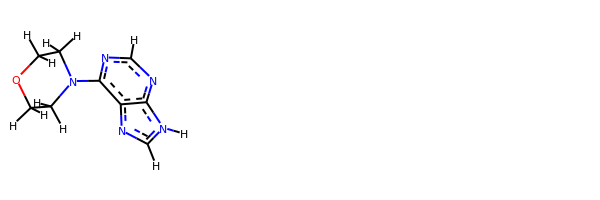

rdkit:  [H]c1nc(N2C([H])([H])C([H])([H])OC([H])([H])C2([H])[H])c2nc([H])n([H])c2n1
oechem:  c1[nH]c2c(n1)c(ncn2)N3CCOCC3
###########################################################################
 #########################################################

bond
21.72360776043657 kJ/mol 29095.788260345438 kJ/mol False
angle
130.19064092763912 kJ/mol 131.8719646864124 kJ/mol False
nb
21.739398086679778 kJ/mol 21.739398086679778 kJ/mol True
torsion
36.8569489963673 kJ/mol 31.626950381068845 kJ/mol False
210.51059577112278 kJ/mol 29281.0265734996 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6668


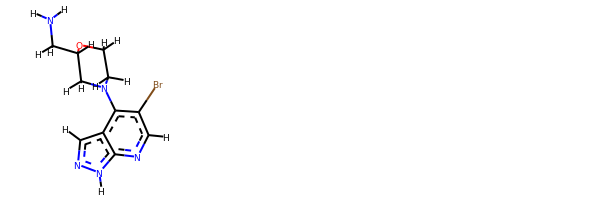

rdkit:  [H]c1nc2c(c([H])nn2[H])c(N2C([H])([H])C([H])([H])OC([H])(C([H])([H])N([H])[H])C2([H])[H])c1Br
oechem:  c1c2c(c(cnc2[nH]n1)Br)N3CCOC(C3)CN
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
19.357069994193463 kJ/mol 56694.46409131785 kJ/mol False
angle
9.135576981589576 kJ/mol 9.135576981589576 kJ/mol True
nb
32.062859374268676 kJ/mol 32.062859374268676 kJ/mol True
torsion
7.084006860944372e-05 kJ/mol 7.532747089081739e-05 kJ/mol False
60.555577190120324 kJ/mol 56735.66260300118 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
---

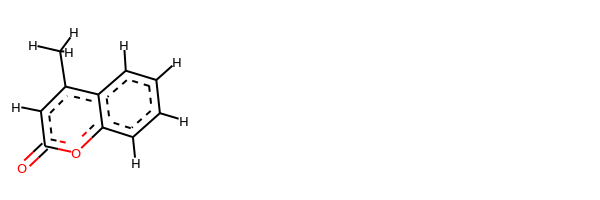

rdkit:  [H]c1c([H])c([H])c2c(C([H])([H])[H])c([H])c(=O)oc2c1[H]
oechem:  Cc1cc(=O)oc2c1cccc2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
33.906725396701766 kJ/mol 44009.803515434876 kJ/mol False
angle
56.92344393981856 kJ/mol 59.03478312639159 kJ/mol False
nb
47.74411827608598 kJ/mol 47.74411827608598 kJ/mol True
torsion
58.954465748746465 kJ/mol 56.44157870254259 kJ/mol False
197.52875336135276 kJ/mol 44173.0239955399 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
----------------------------------------------------------------

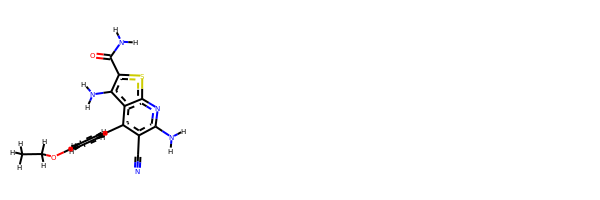

rdkit:  [H]c1c([H])c(-c2c(C#N)c(N([H])[H])nc3sc(C(=O)N([H])[H])c(N([H])[H])c23)c([H])c([H])c1OC([H])([H])C([H])([H])[H]
oechem:  CCOc1ccc(cc1)c2c(c(nc3c2c(c(s3)C(=O)N)N)N)C#N
###########################################################################
 #########################################################

bond
26.307590218650784 kJ/mol 44009.89999848408 kJ/mol False
angle
63.75024665110268 kJ/mol 65.89663157011398 kJ/mol False
nb
27.077526951643108 kJ/mol 27.077526951643108 kJ/mol True
torsion
25.323927134582956 kJ/mol 25.316102629826702 kJ/mol False
142.45929095597953 kJ/mol 44128.19025963566 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6676


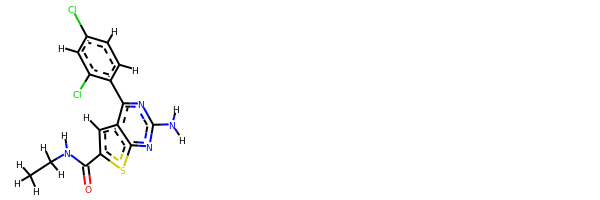

rdkit:  [H]c1c([H])c(-c2nc(N([H])[H])nc3sc(C(=O)N([H])C([H])([H])C([H])([H])[H])c([H])c23)c(Cl)c([H])c1Cl
oechem:  CCNC(=O)c1cc2c(nc(nc2s1)N)c3ccc(cc3Cl)Cl
###########################################################################
 #########################################################

bond
11.281198714785024 kJ/mol 29080.047138121296 kJ/mol False
angle
98.1921380469065 kJ/mol 98.1921380469065 kJ/mol True
nb
33.8960386995541 kJ/mol 33.8960386995541 kJ/mol True
torsion
23.640458977903762 kJ/mol 15.900061022452618 kJ/mol False
167.00983443914936 kJ/mol 29228.03537589021 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6677


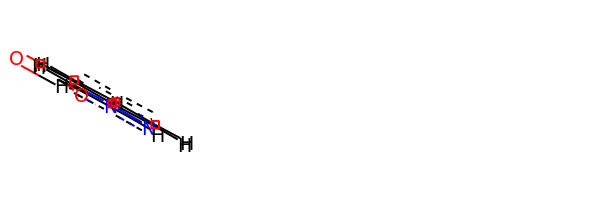

rdkit:  [H]OC(=O)c1c([H])nn(-c2c([H])c([H])c([H])c([H])c2[H])c1[H]
oechem:  c1ccc(cc1)n2cc(cn2)C(=O)O
###########################################################################
 #########################################################

bond
27.31620973576124 kJ/mol 57796.925929036624 kJ/mol False
angle
102.21325491696922 kJ/mol 102.21325491696922 kJ/mol True
nb
27.42638202527067 kJ/mol 27.42638202527067 kJ/mol True
torsion
179.6635739592751 kJ/mol 143.08194883710743 kJ/mol False
336.6194206372762 kJ/mol 58069.647514815966 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6678


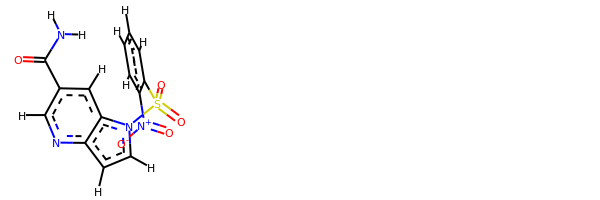

rdkit:  [H]c1nc2c([H])c([H])n(S(=O)(=O)c3c([H])c([H])c([H])c([H])c3[N+](=O)[O-])c2c([H])c1C(=O)N([H])[H]
oechem:  c1ccc(c(c1)[N+](=O)[O-])S(=O)(=O)n2ccc3c2cc(cn3)C(=O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
47.57278165193341 kJ/mol 113510.99704298982 kJ/mol False
angle
51.86880198977191 kJ/mol 51.86880198977191 kJ/mol True
nb
142.72155970551213 kJ/mol 142.72155970551213 kJ/mol True
torsion
22.108090148026857 kJ/mol 9.877492734132558 kJ/mol False
264.2712334952443 kJ/mol 113715.46489741924 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6680


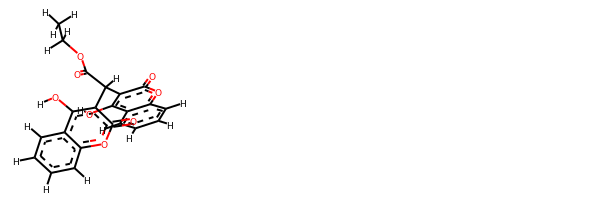

rdkit:  [H]Oc1c(C([H])(C(=O)OC([H])([H])C([H])([H])[H])c2c(O[H])c3c([H])c([H])c([H])c([H])c3oc2=O)c(=O)oc2c([H])c([H])c([H])c([H])c12
oechem:  CCOC(=O)C(c1c(c2ccccc2oc1=O)O)c3c(c4ccccc4oc3=O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
23.099580063212944 kJ/mol 58269.5351935334 kJ/mol False
angle
112.25171051423926 kJ/mol 112.25171051423926 kJ/mol True
nb
3.439248212335045 kJ/mol 3.439248212335045 kJ/mol True
torsion
96.7287243316372 kJ/mol 79.99264975251299 kJ/mol False
235.51926312142447

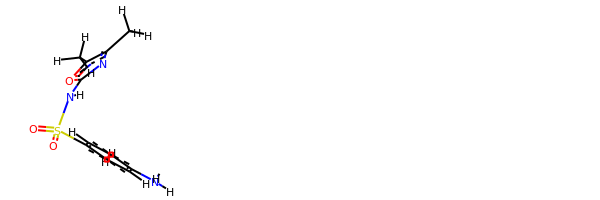

rdkit:  [H]c1c([H])c(S(=O)(=O)N([H])c2nc(C([H])([H])[H])c(C([H])([H])[H])o2)c([H])c([H])c1N([H])[H]
oechem:  Cc1c(oc(n1)NS(=O)(=O)c2ccc(cc2)N)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
8.093254956060282 kJ/mol 58027.908354277606 kJ/mol False
angle
103.60547397625629 kJ/mol 105.61560816392246 kJ/mol False
nb
-5.322020095805394 kJ/mol -5.322020095805394 kJ

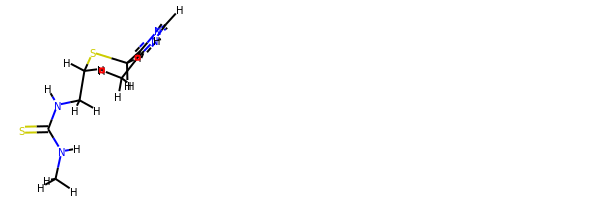

rdkit:  [H]c1nc(C([H])([H])SC([H])([H])C([H])([H])N([H])C(=S)N([H])C([H])([H])[H])c(C([H])([H])[H])n1[H]
oechem:  Cc1c(nc[nH]1)CSCCNC(=S)NC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
19.594567829765666 kJ/mol 44746.650885273804 kJ/mol False
angle
466.2322518712322 kJ/mol 466.2322518712322 kJ/mol True
nb
56.09462024457687 kJ/mol 56.09462024457687 kJ/mol True
torsion
122.77435842682675 kJ/mol 116.9502323147251 kJ/mol False
664.6957983724014 kJ/mol 45385.92798970434 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
------------------

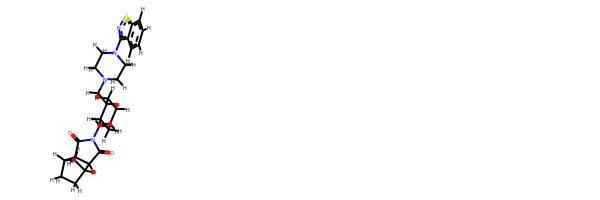

rdkit:  [H]c1c([H])c([H])c2c(N3C([H])([H])C([H])([H])N(C([H])([H])C4([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C4([H])C([H])([H])N4C(=O)C5([H])C([H])(C4=O)C4([H])C([H])([H])C([H])([H])C5([H])C4([H])[H])C([H])([H])C3([H])[H])nsc2c1[H]
oechem:  c1ccc2c(c1)c(ns2)N3CCN(CC3)CC4CCCCC4CN5C(=O)C6C7CCC(C7)C6C5=O
###########################################################################
 #########################################################

bond
25.128337104112187 kJ/mol 29171.465550826957 kJ/mol False
angle
473.6639054544465 kJ/mol 473.6639054544465 kJ/mol True
nb
11.593825062001372 kJ/mol 11.593825062001372 kJ/mol True
torsion
235.08360561576364 kJ/mol 229.85364240992178 kJ/mol False
745.4696732363236 kJ/mol 29886.576923753328 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6699


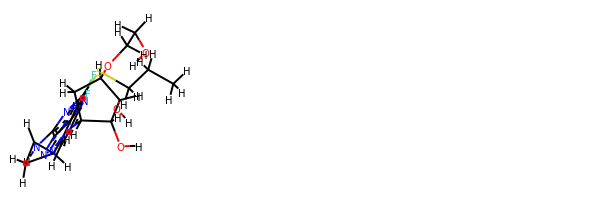

rdkit:  [H]OC([H])([H])C([H])([H])OC1([H])C([H])([H])C([H])(n2nnc3c(N([H])C4([H])C([H])([H])C4([H])c4c([H])c([H])c(F)c(F)c4[H])nc(SC([H])([H])C([H])([H])C([H])([H])[H])nc32)C([H])(O[H])C1([H])O[H]
oechem:  CCCSc1nc(c2c(n1)n(nn2)C3CC(C(C3O)O)OCCO)NC4CC4c5ccc(c(c5)F)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
28.38473717037382 kJ/mol 57346.11326338603 kJ/mol False
angle
47.440926277182896 kJ/mol 47.47401009518197 kJ/mol False
nb
177.2510746437966 kJ/mol 177.2510746437966 kJ/mol True
torsion
18.86720855968726 kJ/mol 6.799087357013339 kJ/mol False
271.9439466510406 kJ/mol 57577.63743548203 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
----------------------------

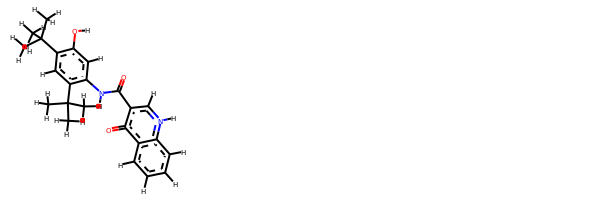

rdkit:  [H]Oc1c([H])c(N([H])C(=O)c2c([H])n([H])c3c([H])c([H])c([H])c([H])c3c2=O)c(C(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H])c([H])c1C(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H]
oechem:  CC(C)(C)c1cc(c(cc1NC(=O)c2c[nH]c3ccccc3c2=O)O)C(C)(C)C
###########################################################################
 #########################################################

bond
43.56864657995467 kJ/mol 288255.29303402075 kJ/mol False
angle
270.9172352325677 kJ/mol 273.46795015072934 kJ/mol False
nb
23.27888040050721 kJ/mol 23.27888040050721 kJ/mol True
torsion
62.209383635668345 kJ/mol 54.81900334648317 kJ/mol False
399.9741458486979 kJ/mol 288606.8588679185 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6703


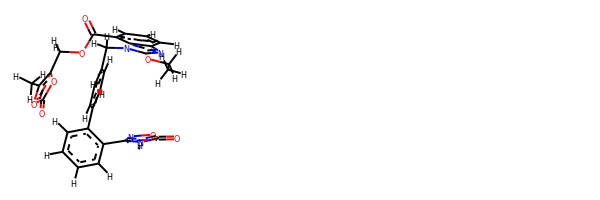

rdkit:  [H]c1c([H])c([H])c(-c2noc(=O)n2[H])c(-c2c([H])c([H])c(C([H])([H])n3c(OC([H])([H])C([H])([H])[H])nc4c([H])c([H])c([H])c(C(=O)OC([H])([H])c5oc(=O)oc5C([H])([H])[H])c43)c([H])c2[H])c1[H]
oechem:  CCOc1nc2cccc(c2n1Cc3ccc(cc3)c4ccccc4c5[nH]c(=O)on5)C(=O)OCc6c(oc(=O)o6)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
8.836005546912947 kJ/mol 56529.29386543066 kJ/mol False
angle
9.632315220273393 kJ/mol 9.632315220273393 kJ/mol True
nb
34.740361486742735 kJ/mol 34.740361486742735 kJ/mol True
torsion
0.058710636380716774 kJ/mol 0.13091668754285804 kJ/mol False
53.26739289030979 kJ/mol 56573.797458825225 kJ/mol

---------------

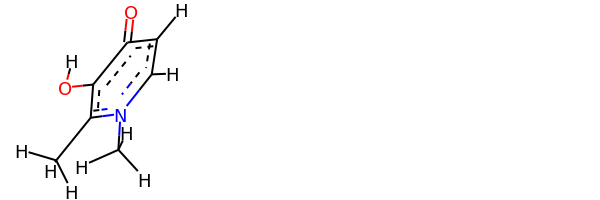

rdkit:  [H]Oc1c(C([H])([H])[H])n(C([H])([H])[H])c([H])c([H])c1=O
oechem:  Cc1c(c(=O)ccn1C)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
27.78404409841551 kJ/mol 43815.08681561226 kJ/mol False
angle
79.59121515993313 kJ/mol 81.743582531096 kJ/mol False
nb
27.868894503471594 kJ/mol 27.868894503471594 kJ/mol True
torsion
66.83680211756443 kJ/mol 64.66118946618

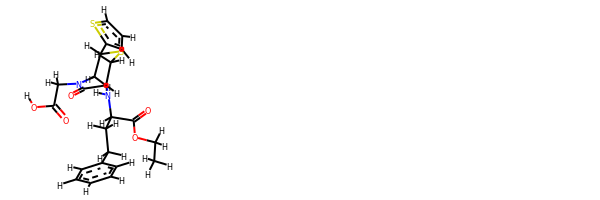

rdkit:  [H]OC(=O)C([H])([H])N1C(=O)C([H])(N([H])C([H])(C(=O)OC([H])([H])C([H])([H])[H])C([H])([H])C([H])([H])c2c([H])c([H])c([H])c([H])c2[H])C([H])([H])SC([H])(c2sc([H])c([H])c2[H])C1([H])[H]
oechem:  CCOC(=O)C(CCc1ccccc1)NC2CSC(CN(C2=O)CC(=O)O)c3cccs3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
68.68392921457878 kJ/mol 227194.5931233782 kJ/mol False
angle
97.51207178764871 kJ/mol 101.75168658030212 kJ/mol False
nb
9.938475967793542 kJ/mol 9.938475967793542 kJ/mol True
torsion
50.2081114634

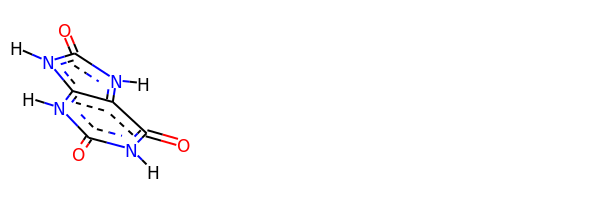

rdkit:  [H]n1c(=O)c2c(n([H])c1=O)n([H])c(=O)n2[H]
oechem:  c12c([nH]c(=O)[nH]1)[nH]c(=O)[nH]c2=O
###########################################################################
 #########################################################

bond
46.917976657591154 kJ/mol 112621.54686612525 kJ/mol False
angle
12.580308886118598 kJ/mol 12.580308886118598 kJ/mol True
nb
46.789178510384815 kJ/mol 46.789178510384815 kJ/mol True
torsion
0.0008150504476034574 kJ/mol 0.0014429975197531209 kJ/mol False
106.28827910454217 kJ/mol 112680.91779651926 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6719


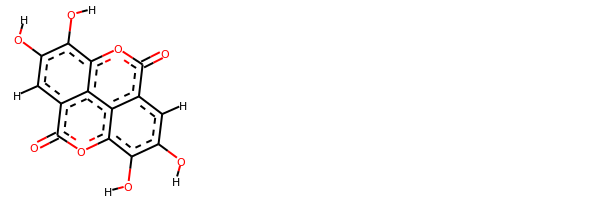

rdkit:  [H]Oc1c(O[H])c2oc(=O)c3c([H])c(O[H])c(O[H])c4oc(=O)c(c1[H])c2c43
oechem:  c1c2c3c4c(cc(c(c4oc2=O)O)O)c(=O)oc3c(c1O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
24.294197086283383 kJ/mol 29092.443426444686 kJ/mol False
angle
110.42299867904399 kJ/mol 110.42299867904399 kJ/mol True
nb
93.89102325577825 kJ/mol 93.89102325577825 kJ/mol True
torsion
51.760501278492605 kJ/mol 46.53050611807959 kJ/mol False
280.36872029959824 kJ/mol 29343.28795449759 kJ/mol

------------------------------

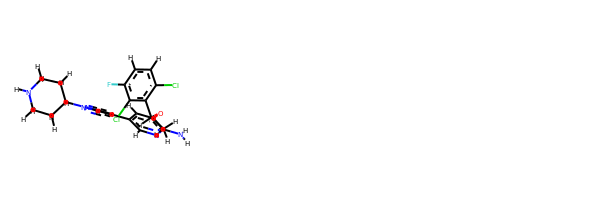

rdkit:  [H]c1nc(N([H])[H])c(OC([H])(c2c(Cl)c([H])c([H])c(F)c2Cl)C([H])([H])[H])c([H])c1-c1c([H])nn(C2([H])C([H])([H])C([H])([H])N([H])C([H])([H])C2([H])[H])c1[H]
oechem:  CC(c1c(ccc(c1Cl)F)Cl)Oc2cc(cnc2N)c3cnn(c3)C4CCNCC4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
21.208161502192667 kJ/mol 86947.17006163659 kJ/mol False
angle
552.5381950149114 kJ/mol 553.9461066894181 kJ/mol False
nb
18.798144352178273 kJ/mol 18.798144352178273 kJ/mol True
torsion
51.077868656646785 kJ/mol 45.8479598536437

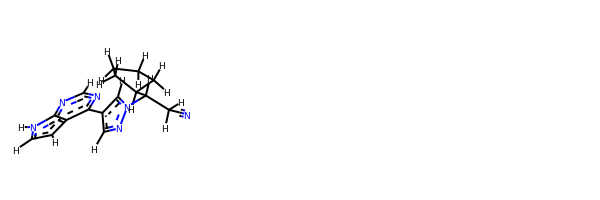

rdkit:  [H]c1nc(-c2c([H])nn(C([H])(C([H])([H])C#N)C3([H])C([H])([H])C([H])([H])C([H])([H])C3([H])[H])c2[H])c2c([H])c([H])n([H])c2n1
oechem:  c1c[nH]c2c1c(ncn2)c3cnn(c3)C(CC#N)C4CCCC4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
20.22617027832372 kJ/mol 57880.68243127501 kJ/mol False
angle
125.0361296595954 kJ/mol 126.41658925558606 kJ/mol False
nb
28.792759814382478 kJ/mol 28.792759814382478 kJ/mol True
torsion
50.94985229617747 kJ/mol 45.671730894316255 kJ/mol False
225.00491204847907 kJ/mol 58081.56351123929 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6734


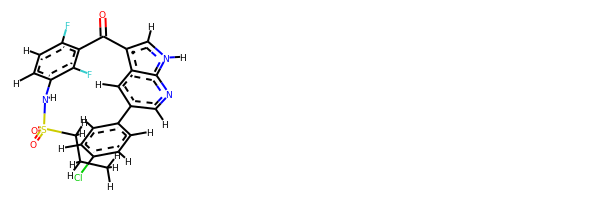

rdkit:  [H]c1nc2c(c([H])c1-c1c([H])c([H])c(Cl)c([H])c1[H])c(C(=O)c1c(F)c([H])c([H])c(N([H])S(=O)(=O)C([H])([H])C([H])([H])C([H])([H])[H])c1F)c([H])n2[H]
oechem:  CCCS(=O)(=O)Nc1ccc(c(c1F)C(=O)c2c[nH]c3c2cc(cn3)c4ccc(cc4)Cl)F
###########################################################################
 #########################################################

bond
61.977376339433015 kJ/mol 169648.17844681581 kJ/mol False
angle
147.91502618480138 kJ/mol 147.91502618480138 kJ/mol True
nb
55.0338116995723 kJ/mol 55.0338116995723 kJ/mol True
torsion
56.55271915389331 kJ/mol 29.72837253856796 kJ/mol False
321.4789333777 kJ/mol 169880.85565723878 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6735


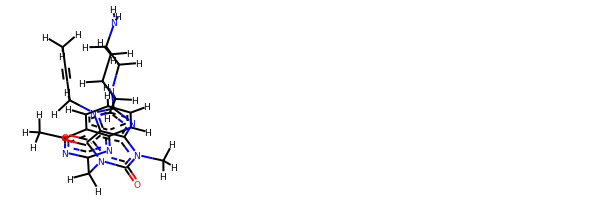

rdkit:  [H]c1c([H])c([H])c2c(C([H])([H])[H])nc(C([H])([H])n3c(=O)c4c(nc(N5C([H])([H])C([H])([H])C([H])([H])C([H])(N([H])[H])C5([H])[H])n4C([H])([H])C#CC([H])([H])[H])n(C([H])([H])[H])c3=O)nc2c1[H]
oechem:  CC#CCn1c2c(nc1N3CCCC(C3)N)n(c(=O)n(c2=O)Cc4nc(c5ccccc5n4)C)C
###########################################################################
 #########################################################

bond
35.75320760184593 kJ/mol 56373.343975680145 kJ/mol False
angle
18.733325379844302 kJ/mol 18.733325379844302 kJ/mol True
nb
76.47626806908634 kJ/mol 76.47626806908634 kJ/mol True
torsion
42.59158236402993 kJ/mol 44.641079199595445 kJ/mol False
173.55438341480652 kJ/mol 56513.19464832867 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6736


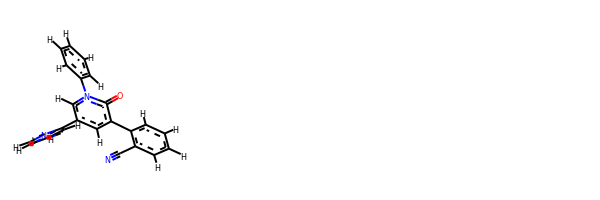

rdkit:  [H]c1nc(-c2c([H])c(-c3c([H])c([H])c([H])c([H])c3C#N)c(=O)n(-c3c([H])c([H])c([H])c([H])c3[H])c2[H])c([H])c([H])c1[H]
oechem:  c1ccc(cc1)n2cc(cc(c2=O)c3ccccc3C#N)c4ccccn4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
22.02630008093642 kJ/mol 43693.79905931935 kJ/mol False
angle
66.09597872207911 kJ/mol 69.45244221892729 kJ/mol False
nb
59.64777847659478 kJ/mol 59.64777847659478 kJ/mol True
torsion
24.28517502427264 kJ/mol 3.4677767058850812 kJ/mol False
172.05523230388297 kJ/mol 43826.3

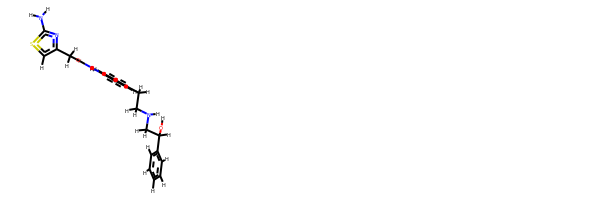

rdkit:  [H]OC([H])(c1c([H])c([H])c([H])c([H])c1[H])C([H])([H])N([H])C([H])([H])C([H])([H])c1c([H])c([H])c(N([H])C(=O)C([H])([H])c2nc(N([H])[H])sc2[H])c([H])c1[H]
oechem:  c1ccc(cc1)C(CNCCc2ccc(cc2)NC(=O)Cc3csc(n3)N)O
###########################################################################
 #########################################################

bond
18.818572310144972 kJ/mol 57876.5135606825 kJ/mol False
angle
117.00048112701222 kJ/mol 118.40804998348537 kJ/mol False
nb
65.88762398245376 kJ/mol 65.88762398245376 kJ/mol True
torsion
41.64687457989287 kJ/mol 41.64699298150298 kJ/mol False
243.35355199950385 kJ/mol 58102.45622762993 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6742


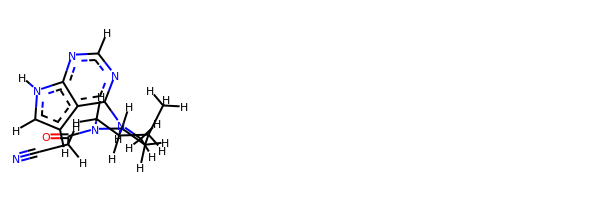

rdkit:  [H]c1nc(N(C([H])([H])[H])C2([H])C([H])([H])N(C(=O)C([H])([H])C#N)C([H])([H])C([H])([H])C2([H])C([H])([H])[H])c2c([H])c([H])n([H])c2n1
oechem:  CC1CCN(CC1N(C)c2c3cc[nH]c3ncn2)C(=O)CC#N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
55.335075494265645 kJ/mol 87631.50167250277 kJ/mol False
angle
94.11820080544359 kJ/mol 98.42046868136336 kJ/mol False
nb
73.87590326734103 kJ/mol 73.87590326734103 kJ/mol True
torsion
121.50650825264297 kJ/mol 104.9545242708124 kJ/mol False
344.83568781969325 kJ/mol 87908.75256872228 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6744


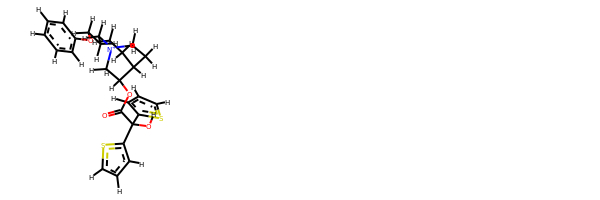

rdkit:  [H]OC(C(=O)OC1([H])C2([H])C([H])([H])C([H])([H])[N+](C([H])([H])C([H])([H])C([H])([H])Oc3c([H])c([H])c([H])c([H])c3[H])(C([H])([H])C2([H])[H])C1([H])[H])(c1sc([H])c([H])c1[H])c1sc([H])c([H])c1[H]
oechem:  c1ccc(cc1)OCCC[N+]23CCC(CC2)C(C3)OC(=O)C(c4cccs4)(c5cccs5)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
27.509749242670303 kJ/mol 57619.97480041895 kJ/mol False
angle
114.8790791917406 kJ/mol 114.8790791917406 kJ/mol True
nb
124.19425752295817 kJ/mol 124.19425752295817 kJ/mol True
torsion
22.40917032750263 kJ/mol 17.179194872943544 kJ/mol False
288.9922562848717 kJ/mol 57876.227332006594 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------

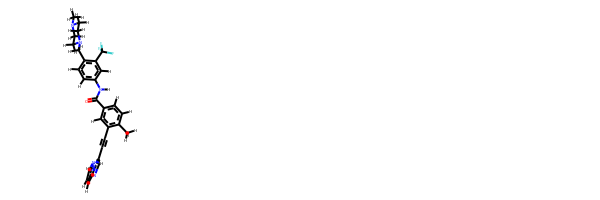

rdkit:  [H]c1nn2c(C#Cc3c([H])c(C(=O)N([H])c4c([H])c([H])c(C([H])([H])N5C([H])([H])C([H])([H])N(C([H])([H])[H])C([H])([H])C5([H])[H])c(C(F)(F)F)c4[H])c([H])c([H])c3C([H])([H])[H])c([H])nc2c([H])c1[H]
oechem:  Cc1ccc(cc1C#Cc2cnc3n2nccc3)C(=O)Nc4ccc(c(c4)C(F)(F)F)CN5CCN(CC5)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
37.5883958143036 kJ/mol 58404.92419762945 kJ/mol False
angle
466.4683877225277 kJ/mol 466.4683877225277 kJ/mol True
nb
245.34747906052488 kJ/mol 245.34747906052488 kJ/mol True
torsion
112.85305602773605 kJ/mol 112.85302956987017 kJ/mol False
862.2573186250922 kJ/mol 59229.593093982374 kJ/mol

-------------------

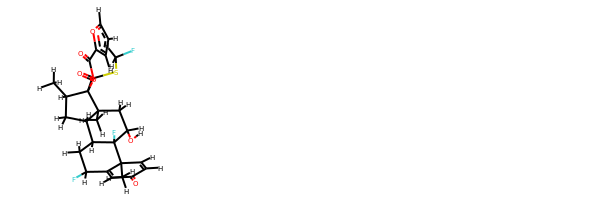

rdkit:  [H]OC1([H])C([H])([H])C2(C([H])([H])[H])C(OC(=O)c3oc([H])c([H])c3[H])(C(=O)SC([H])([H])F)C([H])(C([H])([H])[H])C([H])([H])C2([H])C2([H])C([H])([H])C([H])(F)C3=C([H])C(=O)C([H])=C([H])C3(C([H])([H])[H])C12F
oechem:  CC1CC2C3CC(C4=CC(=O)C=CC4(C3(C(CC2(C1(C(=O)SCF)OC(=O)c5ccco5)C)O)F)C)F
###########################################################################
 #########################################################

bond
22.67799910055248 kJ/mol 43809.17179631631 kJ/mol False
angle
51.436607582160306 kJ/mol 53.58987249774085 kJ/mol False
nb
39.451203613494314 kJ/mol 39.451203613494314 kJ/mol True
torsion
82.71787051659709 kJ/mol 71.21248448428847 kJ/mol False
196.28368081280422 kJ/mol 43973.42535691183 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6750


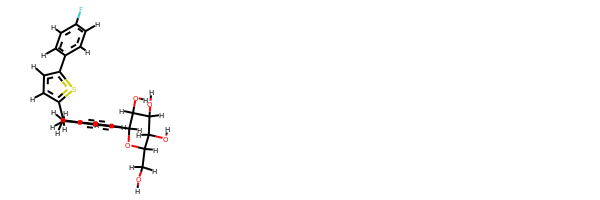

rdkit:  [H]OC([H])([H])C1([H])OC([H])(c2c([H])c([H])c(C([H])([H])[H])c(C([H])([H])c3sc(-c4c([H])c([H])c(F)c([H])c4[H])c([H])c3[H])c2[H])C([H])(O[H])C([H])(O[H])C1([H])O[H]
oechem:  Cc1ccc(cc1Cc2ccc(s2)c3ccc(cc3)F)C4C(C(C(C(O4)CO)O)O)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
76.52174090581438 kJ/mol 169107.09150866233 kJ/mol False
angle
60.613815935109535 kJ/mol 60.613815935109535 kJ/mol True
nb
111.81910822786554 kJ/mol 111.81910822786554 kJ/mol True
torsion
224.98314030276651 kJ/mol 267.06438762200133 kJ/mol False
473.937805371556 kJ/mol 169546.5888204473 kJ/mol

--------------------------------------------------------

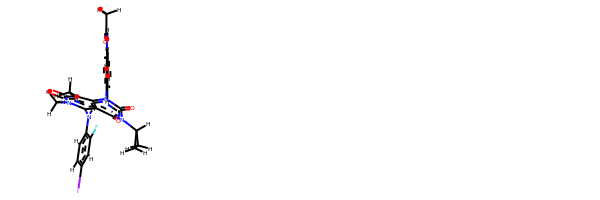

rdkit:  [H]c1c([H])c(N([H])C(=O)C([H])([H])[H])c([H])c(-n2c(=O)n(C3([H])C([H])([H])C3([H])[H])c(=O)c3c(N([H])c4c([H])c([H])c(I)c([H])c4F)n(C([H])([H])[H])c(=O)c(C([H])([H])[H])c32)c1[H]
oechem:  Cc1c2c(c(n(c1=O)C)Nc3ccc(cc3F)I)c(=O)n(c(=O)n2c4cccc(c4)NC(=O)C)C5CC5
###########################################################################
 #########################################################

bond
20.16264982196012 kJ/mol 43694.35083733457 kJ/mol False
angle
81.81537037232894 kJ/mol 85.16957526420612 kJ/mol False
nb
53.649363631220446 kJ/mol 53.649363631220446 kJ/mol True
torsion
120.15958507419982 kJ/mol 120.15979611090567 kJ/mol False
275.78696889970934 kJ/mol 43953.3295723409 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6755


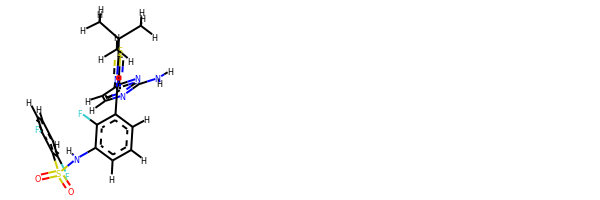

rdkit:  [H]c1nc(N([H])[H])nc(-c2sc(C(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H])nc2-c2c([H])c([H])c([H])c(N([H])S(=O)(=O)c3c(F)c([H])c([H])c([H])c3F)c2F)c1[H]
oechem:  CC(C)(C)c1nc(c(s1)c2ccnc(n2)N)c3cccc(c3F)NS(=O)(=O)c4c(cccc4F)F
###########################################################################
 #########################################################

bond
33.016926503385186 kJ/mol 101992.82066105609 kJ/mol False
angle
147.9292487757091 kJ/mol 149.76999334632248 kJ/mol False
nb
30.388908285247652 kJ/mol 30.388908285247652 kJ/mol True
torsion
32.60788186156526 kJ/mol 32.60786693634134 kJ/mol False
243.9429654259072 kJ/mol 102205.58742962399 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6757


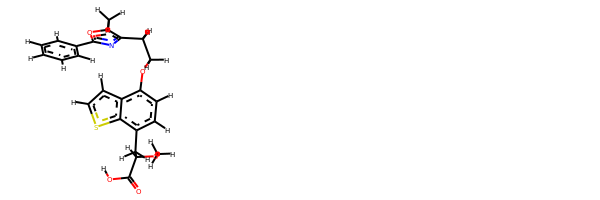

rdkit:  [H]OC(=O)C([H])(OC([H])([H])[H])C([H])([H])c1c([H])c([H])c(OC([H])([H])C([H])([H])c2nc(-c3c([H])c([H])c([H])c([H])c3[H])oc2C([H])([H])[H])c2c([H])c([H])sc12
oechem:  Cc1c(nc(o1)c2ccccc2)CCOc3ccc(c4c3ccs4)CC(C(=O)O)OC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
17.224687275209956 kJ/mol 44742.657698839954 kJ/mol False
angle
262.4770172407978 kJ/mol 262.4770172407978 kJ/mol True
nb
32.57079681133343 kJ/mol 32.57079681133343 kJ/mol True
torsion
66.26910408922849 kJ/mol 60.4452930119051 kJ/mol False
378.54160541656967 kJ/mol 45098.15080590399 kJ/mol

-------------------------------------------------------------------
--

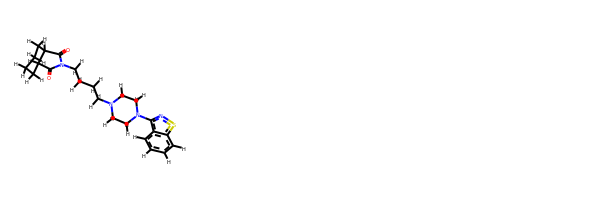

rdkit:  [H]c1c([H])c([H])c2c(N3C([H])([H])C([H])([H])N(C([H])([H])C([H])([H])C([H])([H])C([H])([H])N4C(=O)C5([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C5([H])C4=O)C([H])([H])C3([H])[H])nsc2c1[H]
oechem:  c1ccc2c(c1)c(ns2)N3CCN(CC3)CCCCN4C(=O)C5CCCCC5C4=O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
41.907460295982595 kJ/mol 56963.622364301846 kJ/mol False
angle
30.862095514415255 kJ/mol 30.862095514415255 kJ/mol True
nb
71.73833739992058 kJ/mol 71.73833739992058 kJ/mol True
torsion
53.03147936109497 kJ/mol 44.94701873084696 kJ/mol False
197.53937257141342 kJ/mol 57111.169815947025 kJ/mol

------------------------------

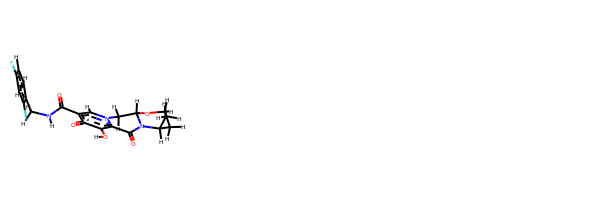

rdkit:  [H]Oc1c2n(c([H])c(C(=O)N([H])C([H])([H])c3c([H])c([H])c(F)c([H])c3F)c1=O)C([H])([H])C1([H])OC([H])([H])C([H])([H])C([H])(C([H])([H])[H])N1C2=O
oechem:  CC1CCOC2N1C(=O)c3c(c(=O)c(cn3C2)C(=O)NCc4ccc(cc4F)F)O
###########################################################################
 #########################################################

bond
51.99545654508337 kJ/mol 29126.804548376575 kJ/mol False
angle
131.3674122832635 kJ/mol 131.3674122832635 kJ/mol True
nb
68.24533169408475 kJ/mol 68.24533169408475 kJ/mol True
torsion
35.975253188746436 kJ/mol 21.3418568029351 kJ/mol False
287.58345371117804 kJ/mol 29347.759149156856 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6766


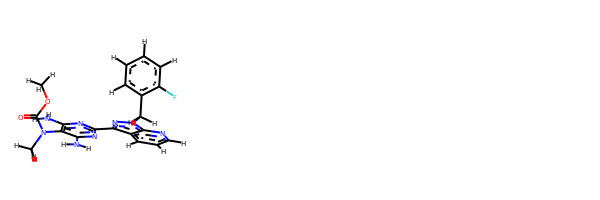

rdkit:  [H]c1nc2c(c(-c3nc(N([H])[H])c(N(C(=O)OC([H])([H])[H])C([H])([H])[H])c(N([H])[H])n3)nn2C([H])([H])c2c([H])c([H])c([H])c([H])c2F)c([H])c1[H]
oechem:  CN(c1c(nc(nc1N)c2c3cccnc3n(n2)Cc4ccccc4F)N)C(=O)OC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
25.7018525423627 kJ/mol 58046.057957185694 kJ/mol False
angle
243.7529887136834 kJ/mol 243.7529887136834 kJ/mol True
nb
24.43306922165596 kJ/mol 24.43306922165596 kJ/mol True
torsion
21.383022731952984 kJ/mol 21.38287950305209 kJ/mol False
315.270933209655 kJ/mol 58335.62689462408 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6768


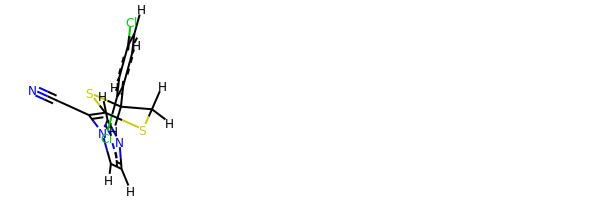

rdkit:  [H]c1nc([H])n(C(C#N)=C2SC([H])([H])C([H])(c3c([H])c([H])c(Cl)c([H])c3Cl)S2)c1[H]
oechem:  c1cc(c(cc1Cl)Cl)C2CSC(=C(C#N)n3ccnc3)S2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
22.58911528399472 kJ/mol 85926.14467363444 kJ/mol False
angle
152.16919442756918 kJ/mol 154.45555404944415 kJ/mol False
nb
28.172905082454875 kJ/mol 28.172905082454875 kJ/mol True
torsion
132.78313093667174 kJ/mol 132.78350532810342 kJ/mol False
335.71434573069047 kJ/mol 86241.55663809444 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
---------------

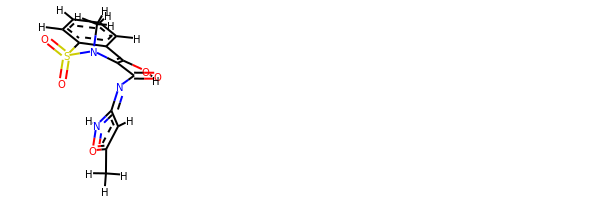

rdkit:  [H]OC1=C(C(=O)N=c2c([H])c(C([H])([H])[H])on2[H])N(C([H])([H])[H])S(=O)(=O)c2c([H])c([H])c([H])c([H])c21
oechem:  Cc1cc(=NC(=O)C2=C(c3ccccc3S(=O)(=O)N2C)O)[nH]o1
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
8.318555750252234 kJ/mol 57759.69603904776 kJ/mol False
angle
95.34804835391742 kJ/mol 96.57822243071463 kJ/mol False
nb
42.513305143448356 kJ/mol 42.513305143448356 kJ/mol True
torsion
34.59562074924283 kJ/mol 34.5956268881226 kJ/mol False
180.77552999686083 kJ/mol 57933.38319351004 kJ/mol

-------------------------------------------------------------------
---------------------------------------------------------

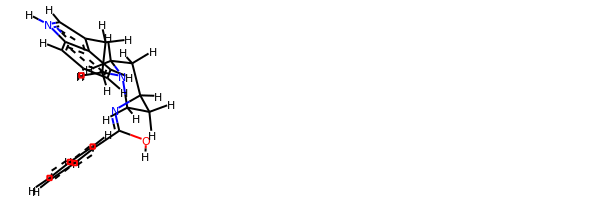

rdkit:  [H]OC(=NC1([H])C([H])([H])C([H])([H])N(C([H])([H])C([H])([H])c2c([H])n([H])c3c([H])c([H])c([H])c([H])c23)C([H])([H])C1([H])[H])c1c([H])c([H])c([H])c([H])c1[H]
oechem:  c1ccc(cc1)C(=NC2CCN(CC2)CCc3c[nH]c4c3cccc4)O
###########################################################################
 #########################################################

bond
4.857853696625014 kJ/mol 57758.594392615414 kJ/mol False
angle
81.93289346596119 kJ/mol 83.16111856938905 kJ/mol False
nb
23.08825764123882 kJ/mol 23.08825764123882 kJ/mol True
torsion
20.37978754405905 kJ/mol 20.37978783165195 kJ/mol False
130.25879234788405 kJ/mol 57885.2235566577 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6784


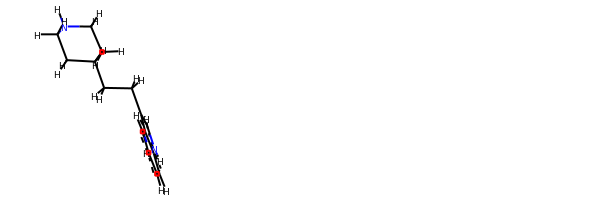

rdkit:  [H]c1c([H])c([H])c2c(c1[H])c(C([H])([H])C([H])([H])C1([H])C([H])([H])C([H])([H])N([H])C([H])([H])C1([H])[H])c([H])n2[H]
oechem:  c1ccc2c(c1)c(c[nH]2)CCC3CCNCC3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

################

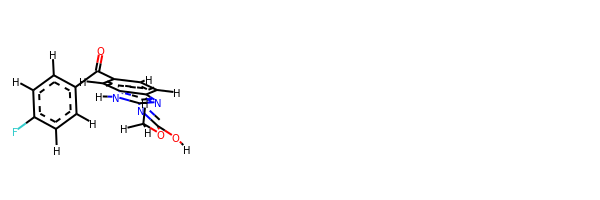

rdkit:  [H]OC(=Nc1nc2c([H])c([H])c(C(=O)c3c([H])c([H])c(F)c([H])c3[H])c([H])c2n1[H])OC([H])([H])[H]
oechem:  COC(=Nc1[nH]c2cc(ccc2n1)C(=O)c3ccc(cc3)F)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

################################

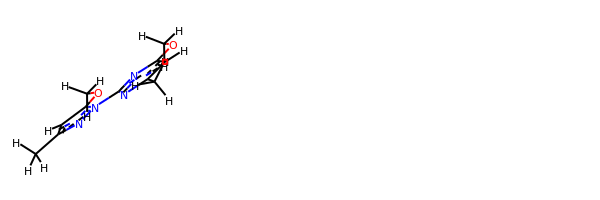

rdkit:  [H]c1c(OC([H])([H])[H])nc(-n2nc(C([H])([H])[H])c([H])c2OC([H])([H])[H])nc1C([H])([H])[H]
oechem:  Cc1cc(nc(n1)n2c(cc(n2)C)OC)OC
###########################################################################
 #########################################################

bond
10.904906004371899 kJ/mol 58256.63268351676 kJ/mol False
angle
111.55381385656334 kJ/mol 111.55381385656334 kJ/mol True
nb
26.754203848657383 kJ/mol 26.754203848657383 kJ/mol True
torsion
42.12065859555575 kJ/mol 34.52290223482114 kJ/mol False
191.33358230514835 kJ/mol 58429.463603456796 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6820


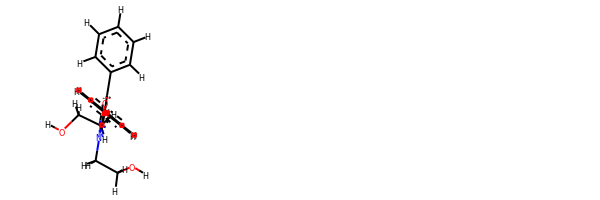

rdkit:  [H]OC([H])([H])C([H])([H])N(c1nc(-c2c([H])c([H])c([H])c([H])c2[H])c(-c2c([H])c([H])c([H])c([H])c2[H])o1)C([H])([H])C([H])([H])O[H]
oechem:  c1ccc(cc1)c2c(oc(n2)N(CCO)CCO)c3ccccc3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
10.178362995534554 kJ/mol 55.19445730911965 kJ/mol False
angle
37.36013305862945 kJ/mol 37.36013305862945 kJ/mol True
nb
71.58237503287408 kJ/mol 71.58237503287408 kJ/mol True
torsion
27.257309473173798 kJ/mol 225.02301125412427 kJ/mol False
146.3781805602119 kJ/mol 389.1599766547475 kJ/mol

-------------------------------------------------------------------
---------------------------------------

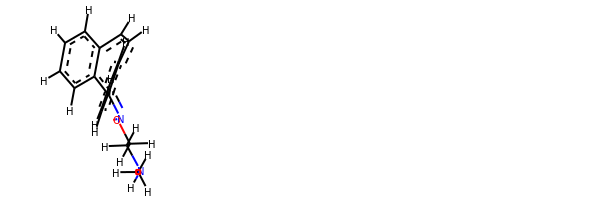

rdkit:  [H]c1c([H])c([H])c2c(=NOC([H])([H])C([H])([H])N([H])C([H])([H])[H])c3c([H])c([H])c([H])c([H])c3c([H])c([H])c2c1[H]
oechem:  CNCCON=c1c2ccccc2ccc3c1cccc3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
24.813540994123606 kJ/mol 43813.25927413104 kJ/mol False
angle
343.6461675313688 kJ/mol 345.79839527885605 kJ/mol False
nb
18.860080765178928 kJ/mol 18.860080765178928 kJ/mol True
torsion
64.63471775879577 kJ/mol 58.40521000413047 kJ/mol False
451.9545070494671 kJ/mol 44236.322960179205 kJ/mol

-------------------------------------------------------------------
--------------------------------------------------------------

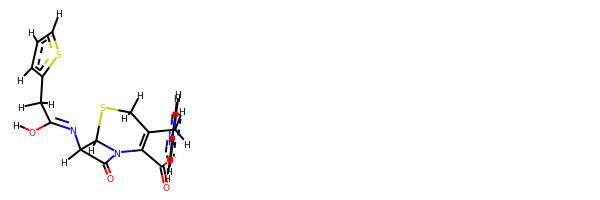

rdkit:  [H]OC(=NC1([H])C(=O)N2C(C(=O)[O-])=C(C([H])([H])[n+]3c([H])c([H])c([H])c([H])c3[H])C([H])([H])SC21[H])C([H])([H])c1sc([H])c([H])c1[H]
oechem:  c1cc[n+](cc1)CC2=C(N3C(C(C3=O)N=C(Cc4cccs4)O)SC2)C(=O)[O-]
###########################################################################
 #########################################################

bond
20.44953786255964 kJ/mol 56470.65690181099 kJ/mol False
angle
27.696051910297612 kJ/mol 27.696051910297612 kJ/mol True
nb
97.49942688790387 kJ/mol 97.49942688790387 kJ/mol True
torsion
11.678404262758521 kJ/mol 11.67842001469135 kJ/mol False
157.32342092351962 kJ/mol 56607.53080062388 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6835


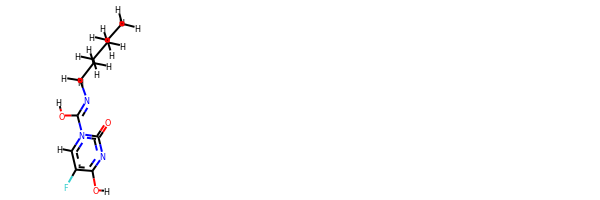

rdkit:  [H]OC(=NC([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])C([H])([H])[H])n1c([H])c(F)c(O[H])nc1=O
oechem:  CCCCCCN=C(n1cc(c(nc1=O)O)F)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
19.795953787001036 kJ/mol 101869.55667812368 kJ/mol False
angle
129.0183677739754 kJ/mol 131.28596460406717 kJ/mol False
nb
38.13024557438692 kJ/mol 38.13024557438692 kJ/mol True
torsion
32.74573297058444 kJ/mol 32.64250633289046 kJ/mol False
219.69030010594778 kJ/mol 102071.61539463504 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6841


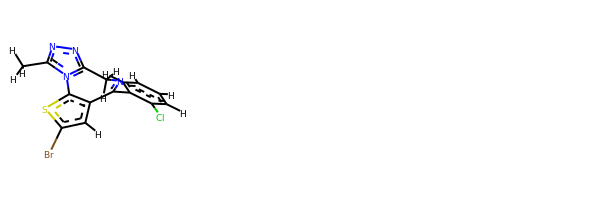

rdkit:  [H]c1c([H])c([H])c(C2=NC([H])([H])c3nnc(C([H])([H])[H])n3-c3sc(Br)c([H])c32)c(Cl)c1[H]
oechem:  Cc1nnc2n1-c3c(cc(s3)Br)C(=NC2)c4ccccc4Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

#######################################

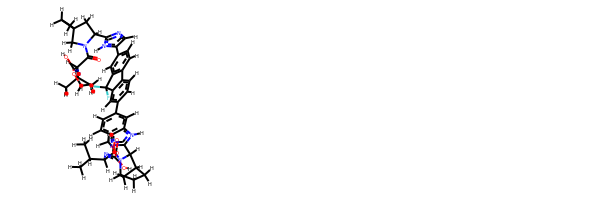

rdkit:  [H]OC(=NC([H])(C(=O)N1C([H])([H])C2(C([H])([H])C1([H])c1nc([H])c(-c3c([H])c([H])c4c(c3[H])C(F)(F)c3c([H])c(-c5c([H])c([H])c6nc(C7([H])N(C(=O)C([H])(N=C(O[H])OC([H])([H])[H])C([H])(C([H])([H])[H])C([H])([H])[H])C8([H])C([H])([H])C([H])([H])C7([H])C8([H])[H])n([H])c6c5[H])c([H])c([H])c3-4)n1[H])C([H])([H])C2([H])[H])C([H])(C([H])([H])[H])C([H])([H])[H])OC([H])([H])[H]
oechem:  CC(C)C(C(=O)N1CC2(CC2)CC1c3[nH]c(cn3)c4ccc-5c(c4)C(c6c5ccc(c6)c7ccc8c(c7)[nH]c(n8)C9C1CCC(C1)N9C(=O)C(C(C)C)N=C(O)OC)(F)F)N=C(O)OC
###########################################################################
 #########################################################

bond
17.592951219681606 kJ/mol 56459.031893554755 kJ/mol False
angle
16.752753160672732 kJ/mol 16.752753160672732 kJ/mol True
nb
34.58017327402829 kJ/mol 34.58017327402829 kJ/mol True
torsion
18.62005044604365 kJ/mol 16.89710257670626 kJ/mol False
87.54592810042627 kJ/mol 56527.26192256617 kJ/mol

------------------------------------------------

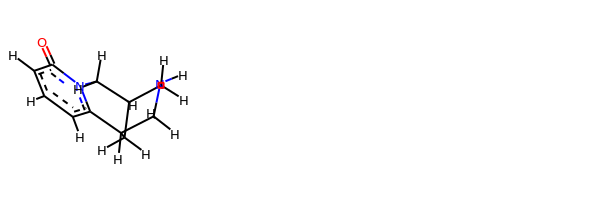

rdkit:  [H]c1c([H])c2n(c(=O)c1[H])C([H])([H])C1([H])C([H])([H])N([H])C([H])([H])C2([H])C1([H])[H]
oechem:  c1cc2n(c(=O)c1)CC3CC2CNC3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
33.51011228772471 kJ/mol 58169.14590361783 kJ/mol False
angle
200.41080064718065 kJ/mol 200.41080064718065 kJ/mol True
nb
62.84899712638737 kJ/mol 62.84899712638737 kJ/mol True
torsion
51.81445239779496 kJ/mol 35.20766629250292 kJ/mol False
348.5843624590877 kJ/mol 58467.613367683894 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6853


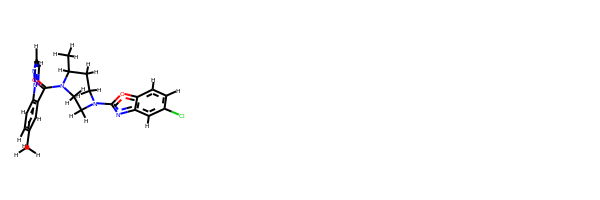

rdkit:  [H]c1nn(-c2c([H])c([H])c(C([H])([H])[H])c([H])c2C(=O)N2C([H])([H])C([H])([H])N(c3nc4c([H])c(Cl)c([H])c([H])c4o3)C([H])([H])C([H])([H])C2([H])C([H])([H])[H])nc1[H]
oechem:  Cc1ccc(c(c1)C(=O)N2CCN(CCC2C)c3nc4cc(ccc4o3)Cl)n5nccn5
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
13.591521255608619 kJ/mol 29171.53131223462 kJ/mol False
angle
105.7707651684175 kJ/mol 105.7707651684175 kJ/mol True
nb
122.81888004018599 kJ/mol 122.81888004018599 kJ/mol True
torsion
34.111085879455125 kJ/mol 26.210937275697606 kJ/mol False
276.2922523436672 kJ/mol 29426.331894718922 kJ/mol

--------------------------------------------------------

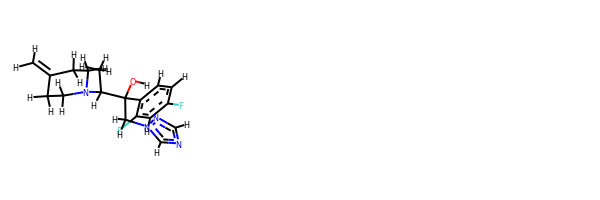

rdkit:  [H]OC(c1c([H])c([H])c(F)c([H])c1F)(C([H])([H])n1nc([H])nc1[H])C([H])(N1C([H])([H])C([H])([H])C(=C([H])[H])C([H])([H])C1([H])[H])C([H])([H])[H]
oechem:  CC(C(Cn1cncn1)(c2ccc(cc2F)F)O)N3CCC(=C)CC3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
34.52582668041571 kJ/mol 30.60915792076562 kJ/mol False
angle
299.65146962763885 kJ/mol 299.65146962763885 kJ/mol True
nb
63.83020994152915 kJ/mol 63.83020994152915 kJ/mol True
torsion
84.70658496883905 kJ/mol 88.84883181713577 kJ/mol False
482.7140912184227 kJ/mol 482.9396693070694 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6858


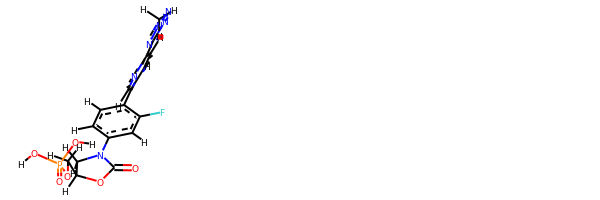

rdkit:  [H]OP(=O)(O[H])OC([H])([H])C1([H])OC(=O)N(c2c([H])c([H])c(-c3c([H])nc(-c4nnn(C([H])([H])[H])n4)c([H])c3[H])c(F)c2[H])C1([H])[H]
oechem:  Cn1nc(nn1)c2ccc(cn2)c3ccc(cc3F)N4CC(OC4=O)COP(=O)(O)O
###########################################################################
 #########################################################

bond
25.181928281397603 kJ/mol 56671.099985535526 kJ/mol False
angle
304.91526445159315 kJ/mol 304.91526445159315 kJ/mol True
nb
96.57971006548085 kJ/mol 96.57971006548085 kJ/mol True
torsion
226.57494529192005 kJ/mol 184.1105483094729 kJ/mol False
653.2518480903916 kJ/mol 57256.70550836207 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6859


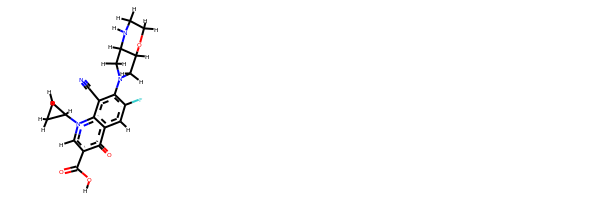

rdkit:  [H]OC(=O)c1c([H])n(C2([H])C([H])([H])C2([H])[H])c2c(C#N)c(N3C([H])([H])C4([H])OC([H])([H])C([H])([H])N([H])C4([H])C3([H])[H])c(F)c([H])c2c1=O
oechem:  c1c2c(c(c(c1F)N3CC4C(C3)OCCN4)C#N)n(cc(c2=O)C(=O)O)C5CC5
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
91.97980332249323 kJ/mol 73239.41562726787 kJ/mol False
angle
521.5713033663826 kJ/mol 521.5713033663826 kJ/mol True
nb
-0.07325711671987688 kJ/mol -0.07325711671987688 kJ/mol True
torsion
137.52714186816897 kJ/mol 111.28881069653114 kJ/mol False
751.0049914403249 kJ/mol 73872.20248421405 kJ/mol

-------------------------------------------------------------------
-----

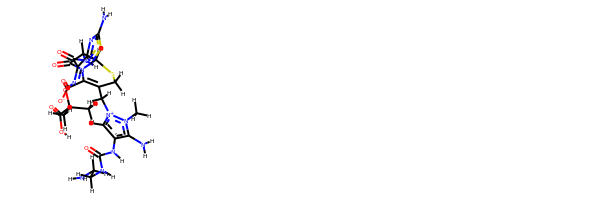

rdkit:  [H]OC(=O)C(ON=C(C(=O)N([H])C1([H])C(=O)N2C(C(=O)[O-])=C(C([H])([H])[n+]3c([H])c(N([H])C(=O)N([H])C([H])([H])C([H])([H])N([H])[H])c(N([H])[H])n3C([H])([H])[H])C([H])([H])SC21[H])c1nsc(N([H])[H])n1)(C([H])([H])[H])C([H])([H])[H]
oechem:  CC(C)(C(=O)O)ON=C(c1nc(sn1)N)C(=O)NC2C3N(C2=O)C(=C(CS3)C[n+]4cc(c(n4C)N)NC(=O)NCCN)C(=O)[O-]
###########################################################################
 #########################################################

bond
35.986686015399265 kJ/mol 29121.361035620263 kJ/mol False
angle
129.90376225709835 kJ/mol 129.90376225709835 kJ/mol True
nb
64.39542513624828 kJ/mol 64.39542513624828 kJ/mol True
torsion
51.8486193588614 kJ/mol 59.17073785571395 kJ/mol False
282.1344927676073 kJ/mol 29374.830960869323 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6863


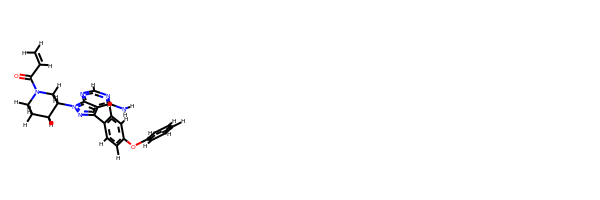

rdkit:  [H]C([H])=C([H])C(=O)N1C([H])([H])C([H])([H])C([H])([H])C([H])(n2nc(-c3c([H])c([H])c(Oc4c([H])c([H])c([H])c([H])c4[H])c([H])c3[H])c3c(N([H])[H])nc([H])nc32)C1([H])[H]
oechem:  C=CC(=O)N1CCCC(C1)n2c3c(c(n2)c4ccc(cc4)Oc5ccccc5)c(ncn3)N
###########################################################################
 #########################################################

bond
27.543609212037158 kJ/mol 114410.32372485359 kJ/mol False
angle
117.3944015238276 kJ/mol 119.51418395144466 kJ/mol False
nb
87.34193947970341 kJ/mol 87.34193947970341 kJ/mol True
torsion
42.054271739567 kJ/mol 19.749931825368932 kJ/mol False
274.33422195513515 kJ/mol 114636.9297801101 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6864


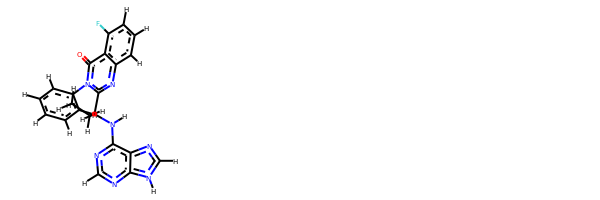

rdkit:  [H]c1nc(N([H])C([H])(c2nc3c([H])c([H])c([H])c(F)c3c(=O)n2-c2c([H])c([H])c([H])c([H])c2[H])C([H])([H])C([H])([H])[H])c2nc([H])n([H])c2n1
oechem:  CCC(c1nc2cccc(c2c(=O)n1c3ccccc3)F)Nc4c5c([nH]cn5)ncn4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
56.45223453918847 kJ/mol 87396.62134324927 kJ/mol False
angle
131.5546007340629 kJ/mol 138.26903878884568 kJ/mol False
nb
21.773205353489967 kJ/mol 21.773205353489967 kJ/mol True
torsion
92.65692407537561 kJ/mol 84.45090537716158 kJ/mol False
3

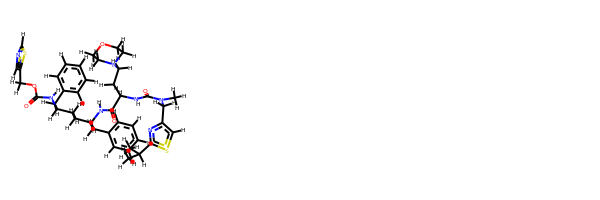

rdkit:  [H]c1nc([H])c(C([H])([H])OC(=O)N([H])C([H])(C([H])([H])c2c([H])c([H])c([H])c([H])c2[H])C([H])([H])C([H])([H])C([H])(N([H])C(=O)C([H])(N([H])C(=O)N(C([H])([H])[H])C([H])([H])c2nc(C([H])(C([H])([H])[H])C([H])([H])[H])sc2[H])C([H])([H])C([H])([H])N2C([H])([H])C([H])([H])OC([H])([H])C2([H])[H])C([H])([H])c2c([H])c([H])c([H])c([H])c2[H])s1
oechem:  CC(C)c1nc(cs1)CN(C)C(=O)NC(CCN2CCOCC2)C(=O)NC(CCC(Cc3ccccc3)NC(=O)OCc4cncs4)Cc5ccccc5
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
26.33893484

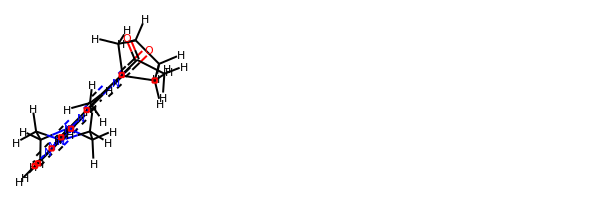

rdkit:  [H]c1nc(N([H])c2nc([H])c3c(C([H])([H])[H])c(C(=O)C([H])([H])[H])c(=O)n(C4([H])C([H])([H])C([H])([H])C([H])([H])C4([H])[H])c3n2)c([H])c([H])c1N1C([H])([H])C([H])([H])N([H])C([H])([H])C1([H])[H]
oechem:  Cc1c2cnc(nc2n(c(=O)c1C(=O)C)C3CCCC3)Nc4ccc(cn4)N5CCNCC5
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
41.15620816298777 kJ/mol 43904.72175310977 kJ/mol False
angle
104.44856163612873 kJ/mol 107.9895904328464 kJ/mol False
nb
93.80267692828097 kJ/mol 93.80267692828097 kJ/mol True
torsion
79.73299023915678 kJ/mol 42.0499919765988 kJ/mol False
319.14043696655426 kJ/mol 44148.564012447496 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
----------------------------

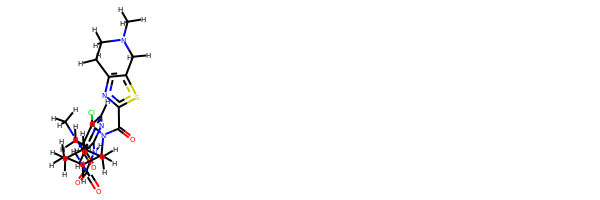

rdkit:  [H]c1nc(N([H])C(=O)C(=O)N([H])C2([H])C([H])([H])C([H])([H])C([H])(C(=O)N(C([H])([H])[H])C([H])([H])[H])C([H])([H])C2([H])N([H])C(=O)c2nc3c(s2)C([H])([H])N(C([H])([H])[H])C([H])([H])C3([H])[H])c([H])c([H])c1Cl
oechem:  CN1CCc2c(sc(n2)C(=O)NC3CC(CCC3NC(=O)C(=O)Nc4ccc(cn4)Cl)C(=O)N(C)C)C1
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

#########################

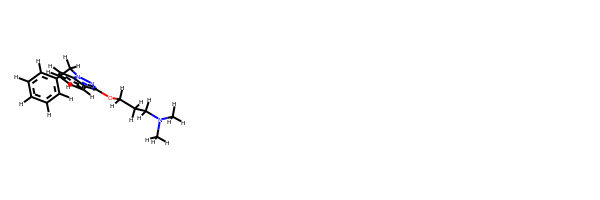

rdkit:  [H]c1c([H])c([H])c(C([H])([H])n2nc(OC([H])([H])C([H])([H])C([H])([H])N(C([H])([H])[H])C([H])([H])[H])c3c([H])c([H])c([H])c([H])c32)c([H])c1[H]
oechem:  CN(C)CCCOc1c2ccccc2n(n1)Cc3ccccc3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #################################################

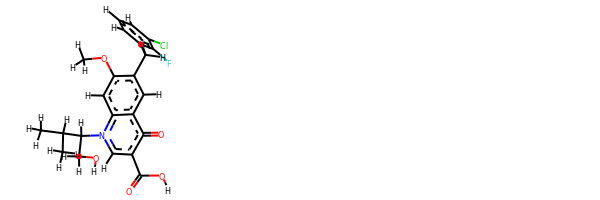

rdkit:  [H]OC(=O)c1c([H])n(C([H])(C([H])([H])O[H])C([H])(C([H])([H])[H])C([H])([H])[H])c2c([H])c(OC([H])([H])[H])c(C([H])([H])c3c([H])c([H])c([H])c(Cl)c3F)c([H])c2c1=O
oechem:  CC(C)C(CO)n1cc(c(=O)c2c1cc(c(c2)Cc3cccc(c3F)Cl)OC)C(=O)O
###########################################################################
 #########################################################

bond
48.83764591870093 kJ/mol 116093.9147069628 kJ/mol False
angle
810.4629005386535 kJ/mol 814.4813049212856 kJ/mol False
nb
31.83766169720728 kJ/mol 31.83766169720728 kJ/mol True
torsion
146.51889286532037 kJ/mol 135.61795881697407 kJ/mol False
1037.657101019882 kJ/mol 117075.85163239826 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6899


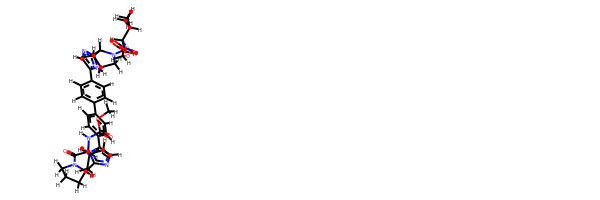

rdkit:  [H]c1nc(C2([H])N(C(=O)C([H])(N([H])C(=O)OC([H])([H])[H])C([H])(C([H])([H])[H])C([H])([H])[H])C([H])([H])C([H])([H])C2([H])[H])n([H])c1-c1c([H])c([H])c(-c2c([H])c([H])c(-c3c([H])nc(C4([H])N(C(=O)C([H])(N([H])C(=O)OC([H])([H])[H])C([H])(C([H])([H])[H])C([H])([H])[H])C([H])([H])C([H])([H])C4([H])[H])n3[H])c([H])c2[H])c([H])c1[H]
oechem:  CC(C)C(C(=O)N1CCCC1c2[nH]c(cn2)c3ccc(cc3)c4ccc(cc4)c5cnc([nH]5)C6CCCN6C(=O)C(C(C)C)NC(=O)OC)NC(=O)OC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

##########

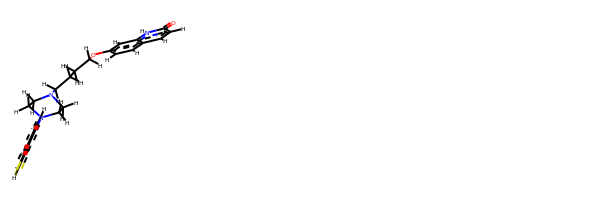

rdkit:  [H]c1sc2c([H])c([H])c([H])c(N3C([H])([H])C([H])([H])N(C([H])([H])C([H])([H])C([H])([H])C([H])([H])Oc4c([H])c([H])c5c([H])c([H])c(=O)n([H])c5c4[H])C([H])([H])C3([H])[H])c2c1[H]
oechem:  c1cc(c2ccsc2c1)N3CCN(CC3)CCCCOc4ccc5ccc(=O)[nH]c5c4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################

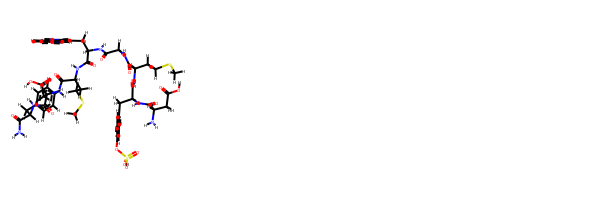

rdkit:  [H]OC(=O)C([H])([H])C([H])(C(=O)N([H])C([H])(C(=O)N([H])C([H])(C(=O)N([H])C([H])([H])C(=O)N([H])C([H])(C(=O)N([H])C([H])(C(=O)N([H])C([H])(C(=O)N([H])C([H])(C(=O)N([H])[H])C([H])([H])c1c([H])c([H])c([H])c([H])c1[H])C([H])([H])C(=O)O[H])C([H])([H])C([H])([H])SC([H])([H])[H])C([H])([H])c1c([H])n([H])c2c([H])c([H])c([H])c([H])c12)C([H])([H])C([H])([H])SC([H])([H])[H])C([H])([H])c1c([H])c([H])c(OS(=O)(=O)O[H])c([H])c1[H])N([H])[H]
oechem:  CSCCC(C(=O)NCC(=O)NC(Cc1c[nH]c2c1cccc2)C(=O)NC(CCSC)C(=O)NC(CC(=O)O)C(=O)NC(Cc3ccccc3)C(=O)N)NC(=O)C(Cc4ccc(cc4)OS(=O)(=O)O)NC(=O)C(CC(=O)O)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
59.608401810990124 kJ/mol 113323.0992683737 kJ/mol False
angle
345.41004992462655 kJ/mol 345.99929195687685 kJ/mol False
nb
32.535080

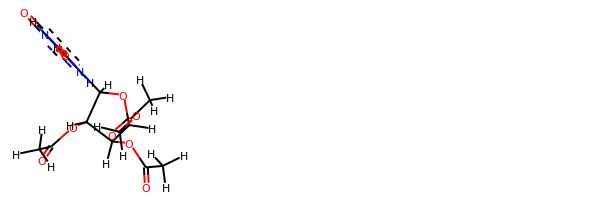

rdkit:  [H]c1c([H])n(C2([H])OC([H])(C([H])([H])OC(=O)C([H])([H])[H])C([H])(OC(=O)C([H])([H])[H])C2([H])OC(=O)C([H])([H])[H])c(=O)n([H])c1=O
oechem:  CC(=O)OCC1C(C(C(O1)n2ccc(=O)[nH]c2=O)OC(=O)C)OC(=O)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################

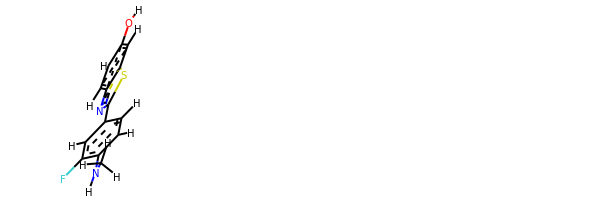

rdkit:  [H]Oc1c([H])c([H])c2nc(-c3c([H])c([H])c(N([H])C([H])([H])[H])c(F)c3[H])sc2c1[H]
oechem:  CNc1ccc(cc1F)c2nc3ccc(cc3s2)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

#########################################################

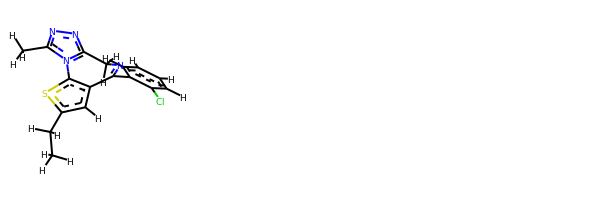

rdkit:  [H]c1c([H])c([H])c(C2=NC([H])([H])c3nnc(C([H])([H])[H])n3-c3sc(C([H])([H])C([H])([H])[H])c([H])c32)c(Cl)c1[H]
oechem:  CCc1cc2c(s1)-n3c(nnc3CN=C2c4ccccc4Cl)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
55.47608719126047 kJ/mol 57210.314024071246 kJ/mol False
angle
98.62345403322502 kJ/mol 98.62345403322502 kJ/mol True
nb
642.2277289790895 kJ/mol 642.2277289790895 kJ/mol True
torsion
61.54698323744308 kJ/mol 45.56918148981655 kJ/mol False
857.874253441018 kJ/mol 57996.73438857337 kJ/

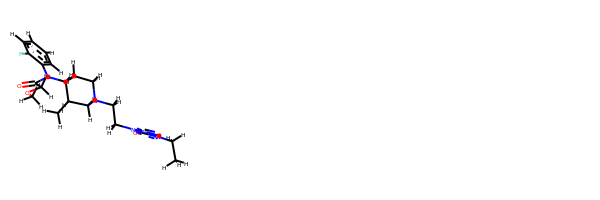

rdkit:  [H]c1c([H])c([H])c(N(C(=O)C([H])([H])OC([H])([H])[H])C2([H])C([H])([H])C([H])([H])N(C([H])([H])C([H])([H])n3nnn(C([H])([H])C([H])([H])[H])c3=O)C([H])([H])C2([H])C([H])([H])[H])c(F)c1[H]
oechem:  CCn1c(=O)n(nn1)CCN2CCC(C(C2)C)N(c3ccccc3F)C(=O)COC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
44.28930940261401 kJ/mol 58409.39393328777 kJ/mol False
angle
109.34829374062616 kJ/mol 109.34829374062616 kJ/mol True
nb
95.97994988887308 kJ/mol 95.97994988887308 kJ/mol True
torsion
52.21404952637896 kJ/mol 46.67748436688217 kJ/mol False
301.8316025584922 kJ/mol 58661.39966128416 kJ/mol

-----------------------------------------

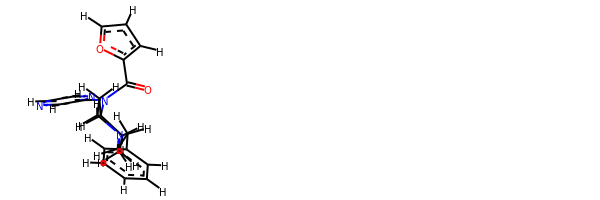

rdkit:  [H]c1nc([H])c(N(C(=O)c2oc([H])c([H])c2[H])C2([H])C([H])([H])C([H])([H])N(C([H])([H])C([H])([H])c3c([H])c([H])c([H])c([H])c3[H])C([H])([H])C2([H])[H])nc1[H]
oechem:  c1ccc(cc1)CCN2CCC(CC2)N(c3cnccn3)C(=O)c4ccco4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
37.13294541085976 kJ/mol 43825.255239866 kJ/mol False
angle
45.528735251025644 kJ/mol 47.68087677420823 kJ/mol False
nb
42.188670931760775 kJ/mol 42.188670931760775 kJ/mol True
torsion
60.8580796883573 kJ/mol 56.19603395934408 kJ/mol False
185.7084312820035 kJ/mol 43971.32082153131 kJ/mol

-------------------------------------------------------------------
---------

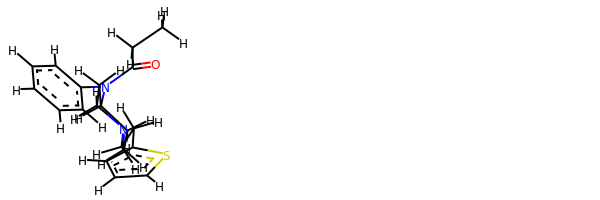

rdkit:  [H]c1sc(C([H])([H])C([H])([H])N2C([H])([H])C([H])([H])C([H])(N(C(=O)C([H])([H])C([H])([H])[H])c3c([H])c([H])c([H])c([H])c3[H])C([H])([H])C2([H])[H])c([H])c1[H]
oechem:  CCC(=O)N(c1ccccc1)C2CCN(CC2)CCc3cccs3
###########################################################################
 #########################################################

bond
53.244836227920445 kJ/mol 57206.61349801394 kJ/mol False
angle
100.5640810742457 kJ/mol 100.5640810742457 kJ/mol True
nb
97.17443023477067 kJ/mol 97.17443023477067 kJ/mol True
torsion
82.14548077183139 kJ/mol 66.16783181375763 kJ/mol False
333.1288283087682 kJ/mol 57470.51984113672 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6963


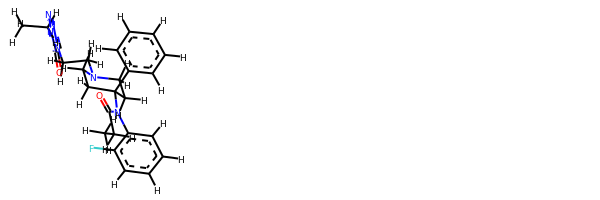

rdkit:  [H]c1c([H])c([H])c(C2(N(C(=O)C([H])([H])C([H])([H])[H])c3c([H])c([H])c([H])c([H])c3F)C([H])([H])C([H])([H])N(C([H])([H])C([H])([H])n3nnn(C([H])([H])C([H])([H])[H])c3=O)C([H])([H])C2([H])[H])c([H])c1[H]
oechem:  CCC(=O)N(c1ccccc1F)C2(CCN(CC2)CCn3c(=O)n(nn3)CC)c4ccccc4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
61.51731144958957 kJ/mol 113216.34688876105 kJ/mol False
angle
56.19890826835829 kJ/mol 56.925277595716985 kJ/mol False
nb
145.81165704459693 kJ/mol 145.81165704459693 kJ/mol True
torsion
100.43314086251786 kJ/mol 68.26739900036824 kJ/mol False
363.96101762506265 kJ/mol 113487.35122240173 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------

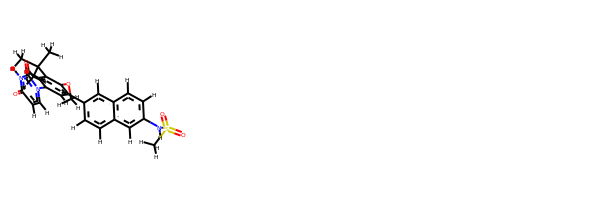

rdkit:  [H]c1c(-c2c([H])c([H])c3c([H])c(N([H])S(=O)(=O)C([H])([H])[H])c([H])c([H])c3c2[H])c(OC([H])([H])[H])c(C(C([H])([H])[H])(C([H])([H])[H])C([H])([H])[H])c([H])c1-n1c([H])c([H])c(=O)n([H])c1=O
oechem:  CC(C)(C)c1cc(cc(c1OC)c2ccc3cc(ccc3c2)NS(=O)(=O)C)n4ccc(=O)[nH]c4=O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
23.03815574627665 kJ/mol 86297.2776236279 kJ/mol False
angle
99.76877694817271 kJ/mol 99.76877694817271 kJ/mol True
nb
32.03949944376716 kJ/mol 32.03949944376716 kJ/mol True
torsion
43.13577305569653 kJ/mol 26.514537428660205 kJ/mol False
197.98220519391305 kJ/mol 86455.6004374485 kJ/mol

------------------------

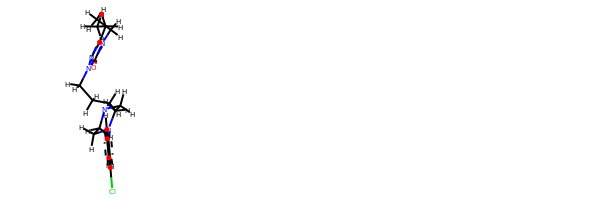

rdkit:  [H]c1c([H])c(Cl)c([H])c(N2C([H])([H])C([H])([H])N(C([H])([H])C([H])([H])C([H])([H])n3nc(C([H])([H])C([H])([H])[H])n(C([H])([H])C([H])([H])[H])c3=O)C([H])([H])C2([H])[H])c1[H]
oechem:  CCc1nn(c(=O)n1CC)CCCN2CCN(CC2)c3cccc(c3)Cl
###########################################################################
 #########################################################

bond
26.306047550499393 kJ/mol 58982.142699507654 kJ/mol False
angle
551.31806521477 kJ/mol 551.31806521477 kJ/mol True
nb
29.49313749962158 kJ/mol 29.49313749962158 kJ/mol True
torsion
86.58678564166838 kJ/mol 78.13711894995912 kJ/mol False
693.7040359065593 kJ/mol 59641.09102117201 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_6977


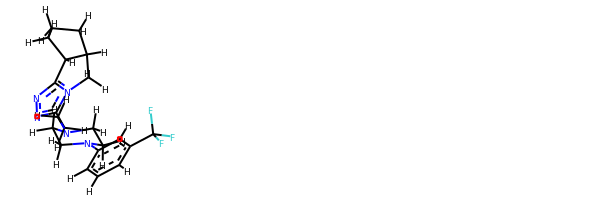

rdkit:  [H]c1c([H])c(N2C([H])([H])C([H])([H])N(C([H])([H])C([H])([H])c3nnc4n3C([H])([H])C3([H])C([H])([H])C([H])([H])C([H])([H])C43[H])C([H])([H])C2([H])[H])c([H])c(C(F)(F)F)c1[H]
oechem:  c1cc(cc(c1)N2CCN(CC2)CCc3nnc4n3CC5C4CCC5)C(F)(F)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
13.137108769996301 kJ/mol 29083.762622803177 kJ/mol False
angle
95.94638010859893 kJ/mol 97.65736296701654 kJ/mol False
nb
29.856657643503972 kJ/mol 29.856657643503972 kJ/mol True
torsion
32.47209154170617 kJ/mol 27.242192233403326 kJ/mol False
171.41223806380538 kJ/mol 29238.5188356471 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
----------------------------------------------------

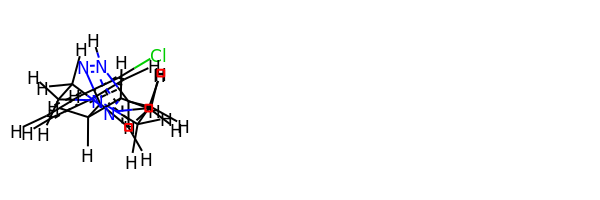

rdkit:  [H]c1c([H])c(Cl)c([H])c(N2C([H])([H])C([H])([H])N(C([H])([H])C([H])([H])c3nn([H])c(C([H])([H])[H])c3[H])C([H])([H])C2([H])[H])c1[H]
oechem:  Cc1cc(n[nH]1)CCN2CCN(CC2)c3cccc(c3)Cl
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ########################################################

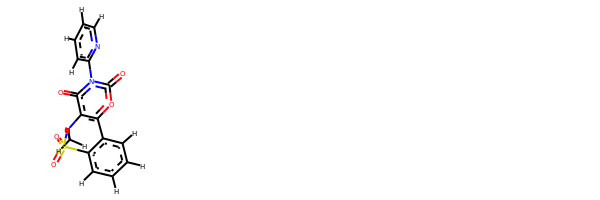

rdkit:  [H]c1nc(-n2c(=O)oc3c(c2=O)N(C([H])([H])[H])S(=O)(=O)c2c([H])c([H])c([H])c([H])c2-3)c([H])c([H])c1[H]
oechem:  CN1c2c(oc(=O)n(c2=O)c3ccccn3)-c4ccccc4S1(=O)=O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
11.35734074486

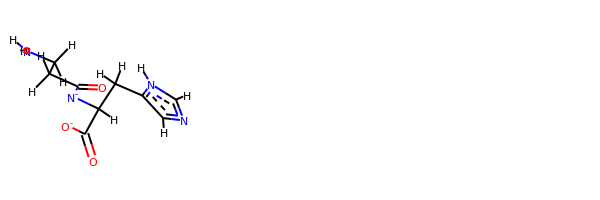

rdkit:  [H]c1nc([H])n([H])c1C([H])([H])C([H])([N-]C(=O)C([H])([H])C([H])([H])N([H])[H])C(=O)[O-]
oechem:  c1c([nH]cn1)CC(C(=O)[O-])[N-]C(=O)CCN
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
30.78075871251504 kJ/mol 57273.9260

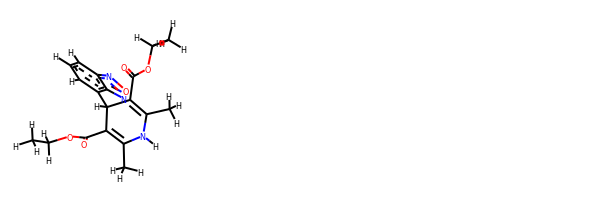

rdkit:  [H]c1c([H])c(C2([H])C(C(=O)OC([H])([H])C([H])([H])[H])=C(C([H])([H])[H])N([H])C(C([H])([H])[H])=C2C(=O)OC([H])([H])C([H])([H])[H])c2nonc2c1[H]
oechem:  CCOC(=O)C1=C(NC(=C(C1c2cccc3c2non3)C(=O)OCC)C)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 ###################################

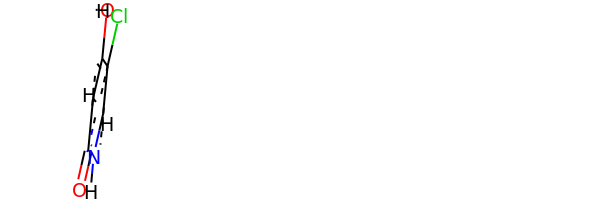

rdkit:  [H]Oc1c(Cl)c([H])n([H])c(=O)c1[H]
oechem:  c1c(c(c[nH]c1=O)Cl)O
###########################################################################
 #########################################################

bond
26.06308669759272 kJ/mol 58049.385796629795 kJ/mol False
angle
99.47400042662997 kJ/mol 99.47400042662997 kJ/mol True
nb
59.9018196529334 kJ/mol 59.9018196529334 kJ/mol True
torsion
22.32858048641245 kJ/mol 17.9754167342872 kJ/mol False
207.76748726356854 kJ/mol 58226.73703344365 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_7034


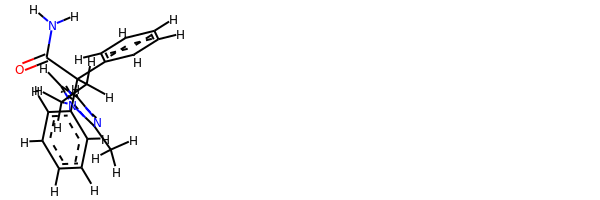

rdkit:  [H]c1nc(C([H])([H])[H])n(C([H])([H])C([H])([H])C(C(=O)N([H])[H])(c2c([H])c([H])c([H])c([H])c2[H])c2c([H])c([H])c([H])c([H])c2[H])c1[H]
oechem:  Cc1nccn1CCC(c2ccccc2)(c3ccccc3)C(=O)N
###########################################################################
 #########################################################

bond
25.639269682213357 kJ/mol 43813.203748125175 kJ/mol False
angle
49.82300916651868 kJ/mol 51.975131151318614 kJ/mol False
nb
-13.023592585434436 kJ/mol -13.023592585434436 kJ/mol True
torsion
66.13052869041752 kJ/mol 44.79405556030534 kJ/mol False
128.56921495371512 kJ/mol 43896.94934225136 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_7036


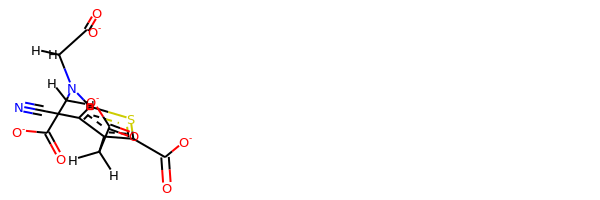

rdkit:  [H]C([H])(C(=O)[O-])c1c(C(=O)[O-])sc(N(C([H])([H])C(=O)[O-])C([H])([H])C(=O)[O-])c1C#N
oechem:  C(c1c(c(sc1C(=O)[O-])N(CC(=O)[O-])CC(=O)[O-])C#N)C(=O)[O-]
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
32.860972325896114 kJ/mol 58053.17444228546 kJ/mol False
angle
128.49834760616378 kJ/mol 130.5090384899999 kJ/mol False
nb
291.7146435238603 kJ/mol 291.7146435238603 kJ/mol True
torsion
109.79383636644643 kJ/mol 85.91708609676503 kJ/mol False
562.8677998223666 kJ/mol 58561.31521039609 kJ/mol

-------------------------------------------------------------------
--------------------------------------------------------------

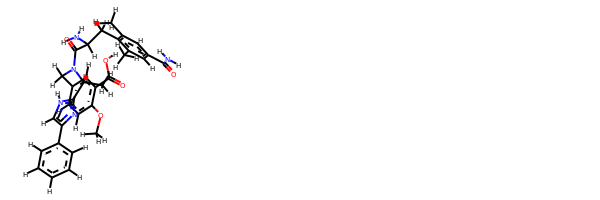

rdkit:  [H]OC(=O)c1c([H])c(C([H])([H])N(C(=O)C([H])(N([H])[H])C([H])([H])c2c(C([H])([H])[H])c([H])c(C(=O)N([H])[H])c([H])c2C([H])([H])[H])C([H])(c2nc(-c3c([H])c([H])c([H])c([H])c3[H])c([H])n2[H])C([H])([H])[H])c([H])c([H])c1OC([H])([H])[H]
oechem:  Cc1cc(cc(c1CC(C(=O)N(Cc2ccc(c(c2)C(=O)O)OC)C(C)c3[nH]cc(n3)c4ccccc4)N)C)C(=O)N
###########################################################################
 #########################################################

bond
78.04313408565177 kJ/mol 169664.97890092118 kJ/mol False
angle
348.3906684194914 kJ/mol 348.3906684194914 kJ/mol True
nb
17.26467641236657 kJ/mol 17.26467641236657 kJ/mol True
torsion
43.46222113321885 kJ/mol 40.717493571704814 kJ/mol False
487.1607000507286 kJ/mol 170071.35173932472 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_7042


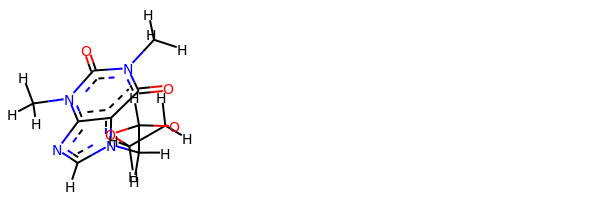

rdkit:  [H]c1nc2c(c(=O)n(C([H])([H])[H])c(=O)n2C([H])([H])[H])n1C([H])([H])C1([H])OC([H])([H])C([H])([H])O1
oechem:  Cn1c2c(c(=O)n(c1=O)C)n(cn2)CC3OCCO3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
21.682756734922755 kJ/mol 86173.4649556566 kJ/mol False
angle
110.92427399212436 kJ/mol 113.70318786447073 kJ/mol False
nb
104.48725854492626 kJ/mol 104.48725854492626 kJ/mol True
torsion
62.06778575611612 kJ/mol 33.42609342999862 kJ/mol False
299.1620750280895 kJ/mol 86425.081495496 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-----

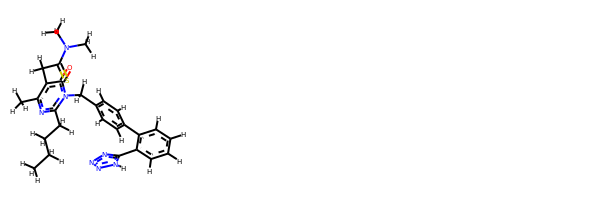

rdkit:  [H]c1c([H])c([H])c(-c2nnnn2[H])c(-c2c([H])c([H])c(C([H])([H])n3c(C([H])([H])C([H])([H])C([H])([H])C([H])([H])[H])nc(C([H])([H])[H])c(C([H])([H])C(=S)N(C([H])([H])[H])C([H])([H])[H])c3=O)c([H])c2[H])c1[H]
oechem:  CCCCc1nc(c(c(=O)n1Cc2ccc(cc2)c3ccccc3c4[nH]nnn4)CC(=S)N(C)C)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
39.58936672754932 kJ/mol 57071.45617138452 kJ/mol False
angle
449.34179471891366 kJ/mol 449.34179471891366 kJ/mol True
nb
38.33708296647609 kJ/mol 38.33708296647609 kJ/mol True
torsion
45.2982345914885 kJ/mol 45.298254989560604 kJ/mol False
572.5664790044275 kJ/mol 57604.43330405947 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
------------

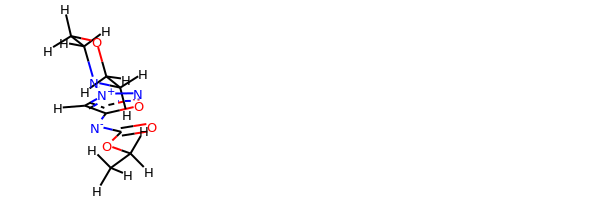

rdkit:  [H]c1c([N-]C(=O)OC([H])([H])C([H])([H])[H])on[n+]1N1C([H])([H])C([H])([H])OC([H])([H])C1([H])[H]
oechem:  CCOC(=O)[N-]c1c[n+](no1)N2CCOCC2
###########################################################################
 #########################################################

bond
16.33491347542773 kJ/mol 56620.81466207556 kJ/mol False
angle
97.27068057358403 kJ/mol 97.27068057358403 kJ/mol True
nb
16.448289553634982 kJ/mol 16.448289553634982 kJ/mol True
torsion
22.815540136360223 kJ/mol 17.585622795448987 kJ/mol False
152.86942373900698 kJ/mol 56752.11925499823 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_7050


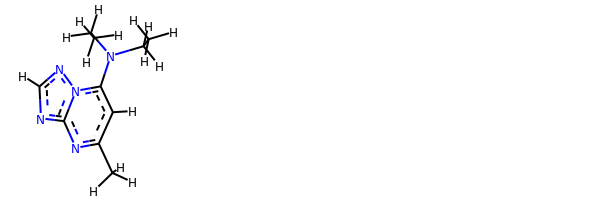

rdkit:  [H]c1nc2nc(C([H])([H])[H])c([H])c(N(C([H])([H])C([H])([H])[H])C([H])([H])C([H])([H])[H])n2n1
oechem:  CCN(CC)c1cc(nc2n1ncn2)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
13.461924478464024 kJ/mol 115768.56949263753 kJ/mol False
angle
170.69420695337612 kJ/mol 172.94779921448523 kJ/mol False
nb
27.072851564149737 kJ/mol 27.072851564149737 kJ/mol True
torsion
8.866072766594204 kJ/mol 7.662385866753307 kJ/mol False
220.0950557625841 kJ/mol 115976.25252928292 kJ/mol

-------------------

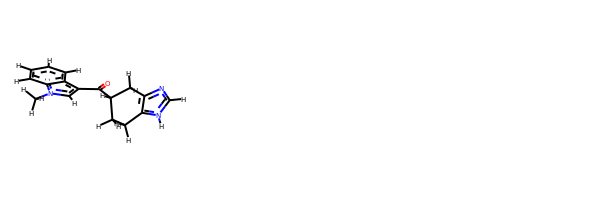

rdkit:  [H]c1c([H])c([H])c2c(c1[H])c(C(=O)C1([H])C([H])([H])c3nc([H])n([H])c3C([H])([H])C1([H])[H])c([H])n2C([H])([H])[H]
oechem:  Cn1cc(c2c1cccc2)C(=O)C3CCc4c(nc[nH]4)C3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
31.94692

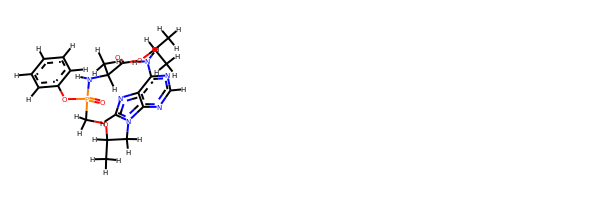

rdkit:  [H]c1nc(N([H])[H])c2nc([H])n(C([H])([H])C([H])(OC([H])([H])P(=O)(Oc3c([H])c([H])c([H])c([H])c3[H])N([H])C([H])(C(=O)OC([H])(C([H])([H])[H])C([H])([H])[H])C([H])([H])[H])C([H])([H])[H])c2n1
oechem:  CC(C)OC(=O)C(C)NP(=O)(COC(C)Cn1cnc2c1ncnc2N)Oc3ccccc3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
16.203506602211093 kJ/mol 58127.49713012057 kJ/mol False
angle
142.86749424546164 kJ/mol 142.86749424546164 kJ/mol True
nb
55.59623035383873 kJ/mol 55.59623035383873 kJ/mol True
torsion
24.88973001941518 kJ/mol 25.01548559481199 kJ/mol False
239.55696122092664 kJ/mol 58350.976340314686 kJ/mol

--------------------------------

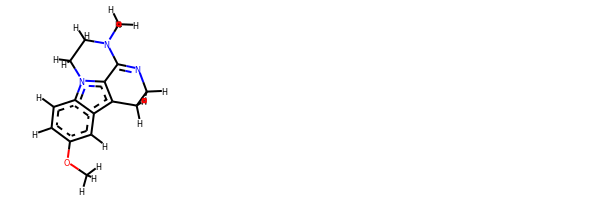

rdkit:  [H]c1c(OC([H])([H])[H])c([H])c2c3c4n(c2c1[H])C([H])([H])C([H])([H])N(C([H])([H])[H])C4=NC([H])([H])C3([H])[H]
oechem:  CN1CCn2c3ccc(cc3c4c2C1=NCC4)OC
###########################################################################
 #########################################################

bond
85.45722611070785 kJ/mol 29223.74719531748 kJ/mol False
angle
274.6206682399797 kJ/mol 274.6206682399797 kJ/mol True
nb
465.6553335232402 kJ/mol 465.6553335232402 kJ/mol True
torsion
196.99251224890858 kJ/mol 191.76261574409918 kJ/mol False
1022.7257401228363 kJ/mol 30155.785812824797 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_7069


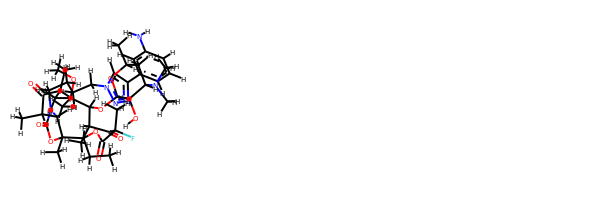

rdkit:  [H]OC1([H])C([H])(OC2([H])C([H])(C([H])([H])[H])C(=O)C(F)(C([H])([H])[H])C(=O)OC([H])(C([H])([H])C([H])([H])[H])C3(C([H])([H])[H])OC(=O)N(C([H])([H])C([H])([H])C([H])([H])C([H])([H])n4nnc(-c5c([H])c([H])c([H])c(N([H])[H])c5[H])c4[H])C3([H])C([H])(C([H])([H])[H])C(=O)C([H])(C([H])([H])[H])C([H])([H])C2(OC([H])([H])[H])C([H])([H])[H])OC([H])(C([H])([H])[H])C([H])([H])C1([H])N(C([H])([H])[H])C([H])([H])[H]
oechem:  CCC1C2(C(C(C(=O)C(CC(C(C(C(=O)C(C(=O)O1)(C)F)C)OC3C(C(CC(O3)C)N(C)C)O)(C)OC)C)C)N(C(=O)O2)CCCCn4cc(nn4)c5cccc(c5)N)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###################################################

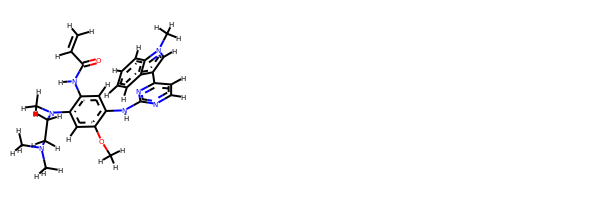

rdkit:  [H]C([H])=C([H])C(=O)N([H])c1c([H])c(N([H])c2nc([H])c([H])c(-c3c([H])n(C([H])([H])[H])c4c([H])c([H])c([H])c([H])c34)n2)c(OC([H])([H])[H])c([H])c1N(C([H])([H])[H])C([H])([H])C([H])([H])N(C([H])([H])[H])C([H])([H])[H]
oechem:  Cn1cc(c2c1cccc2)c3ccnc(n3)Nc4cc(c(cc4OC)N(C)CCN(C)C)NC(=O)C=C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
53.91398669391624 kJ/mol 55899.49305698515 kJ/mol False
angle
164.22883319894535 kJ/mol 164.22883319894535 kJ/mol True
nb
121.1669616402731 kJ/mol 121.1669616402731 kJ/mol True
torsion
280.5280874147661 kJ/mol 275.67200826395197 kJ/mol False
619.8378689479008 kJ/mol 56460.56086008832 kJ/mol


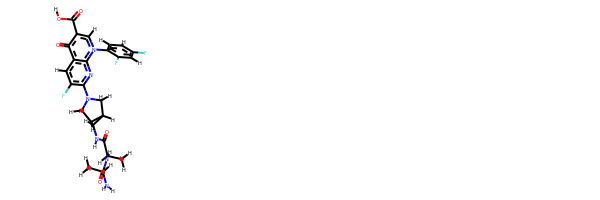

rdkit:  [H]OC(=O)c1c([H])n(-c2c([H])c([H])c(F)c([H])c2F)c2nc(N3C([H])([H])C4([H])C([H])(N([H])C(=O)C([H])(N([H])C(=O)C([H])(N([H])[H])C([H])([H])[H])C([H])([H])[H])C4([H])C3([H])[H])c(F)c([H])c2c1=O
oechem:  CC(C(=O)NC(C)C(=O)NC1C2C1CN(C2)c3c(cc4c(=O)c(cn(c4n3)c5ccc(cc5F)F)C(=O)O)F)N
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###################################

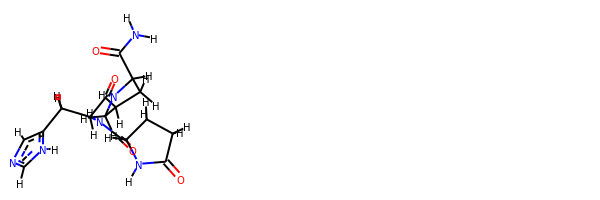

rdkit:  [H]c1nc([H])n([H])c1C([H])([H])C([H])(C(=O)N1C([H])([H])C([H])([H])C([H])([H])C1([H])C(=O)N([H])[H])N([H])C(=O)C1([H])N([H])C(=O)C([H])([H])C1([H])[H]
oechem:  c1c([nH]cn1)CC(C(=O)N2CCCC2C(=O)N)NC(=O)C3CCC(=O)N3
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #######################

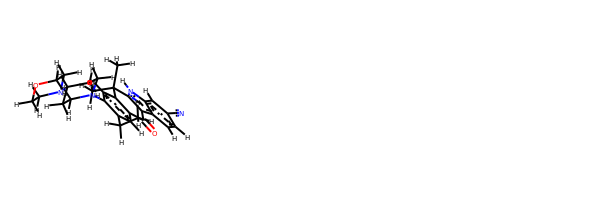

rdkit:  [H]c1c2c(c([H])c(N3C([H])([H])C([H])([H])C([H])(N4C([H])([H])C([H])([H])OC([H])([H])C4([H])[H])C([H])([H])C3([H])[H])c1C([H])([H])C([H])([H])[H])C(C([H])([H])[H])(C([H])([H])[H])c1c(c3c([H])c([H])c(C#N)c([H])c3n1[H])C2=O
oechem:  CCc1cc2c(cc1N3CCC(CC3)N4CCOCC4)C(c5c(c6ccc(cc6[nH]5)C#N)C2=O)(C)C
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
41.68188413592777 kJ/mol 56114.14911287501 kJ/mol False
angle
16.787731006593294 kJ/mol 16.787731006593294 kJ/mol True
nb
94.77095402382967 kJ/mol 94.77095402382967 kJ/mol True
torsion
30.951165458618178 kJ/mol 13.60689129923861 kJ/mol False
184.19173462496892 kJ/mol 56239.31468920468 kJ/mol

-------------------------------------------------------------------
---------------------------------------------------------

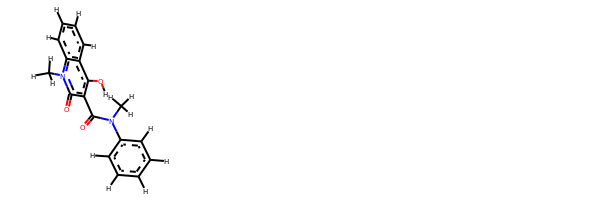

rdkit:  [H]Oc1c(C(=O)N(c2c([H])c([H])c([H])c([H])c2[H])C([H])([H])[H])c(=O)n(C([H])([H])[H])c2c([H])c([H])c([H])c([H])c12
oechem:  Cn1c2ccccc2c(c(c1=O)C(=O)N(C)c3ccccc3)O
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
28.134673964026653 kJ/mol 55952.92743231716 kJ/mol False
angle
29.877832806533313 kJ/mol 29.877832806533313 kJ/mol True
nb
70.69562774908279 kJ/mol 70.69562774908279 kJ/mol True
torsion
59.7538789650655 kJ/mol 56.997570119388584 kJ/mol False
188.46201348470828 kJ/mol 56110.49846299217 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_7118


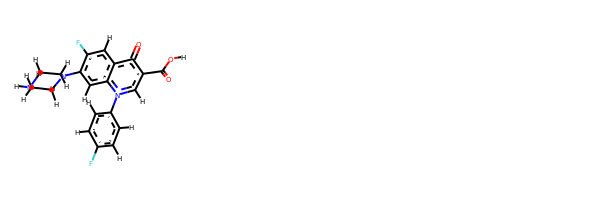

rdkit:  [H]OC(=O)c1c([H])n(-c2c([H])c([H])c(F)c([H])c2[H])c2c([H])c(N3C([H])([H])C([H])([H])N([H])C([H])([H])C3([H])[H])c(F)c([H])c2c1=O
oechem:  c1cc(ccc1n2cc(c(=O)c3c2cc(c(c3)F)N4CCNCC4)C(=O)O)F
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
11.448049451192666 kJ/mol 58248.98503740748 kJ/mol False
angle
90.32412302974215 kJ/mol 90.32412302974215 kJ/mol True
nb
29.624106667156784 kJ/mol 29.624106667156784 kJ/mol True
torsion
161.46816926727206 kJ/mol 161.46811344428662 kJ/mol False
292.8644484153637 kJ/mol 58530.40138054867 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_7120


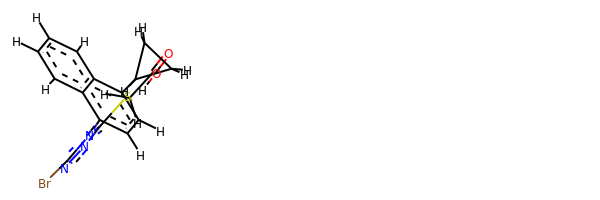

rdkit:  [H]OC(=O)C([H])([H])Sc1nnc(Br)n1-c1c([H])c([H])c(C2([H])C([H])([H])C2([H])[H])c2c([H])c([H])c([H])c([H])c12
oechem:  c1ccc2c(c1)c(ccc2n3c(nnc3Br)SCC(=O)O)C4CC4
###########################################################################
 #########################################################

###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
65.09978855993593 kJ/mol 173768.27908546163 kJ/mol False
angle
904.6734179097709 kJ/mol 908.6949752927314 kJ/mol False
nb
29.696680879165207 kJ/mol 29.696680879165207 kJ/mol True
torsion
215.74151143320745 kJ/mol 139.02413016390858 kJ/mol False
1215.2113987820794 kJ/mol 174845.69487179743 kJ/mol

-------------------------------------------------------------------
-----------------------------------------------------

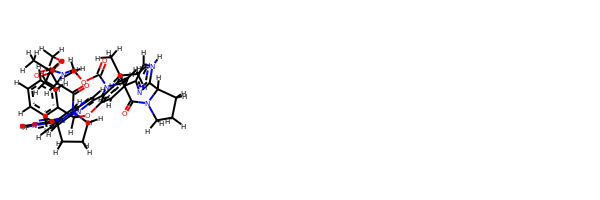

rdkit:  [H]c1c([H])c([H])c(C2([H])Oc3c([H])c(-c4nc(C5([H])N(C(=O)C([H])(N([H])C(=O)OC([H])([H])[H])C([H])(C([H])([H])[H])C([H])([H])[H])C([H])([H])C([H])([H])C5([H])[H])n([H])c4[H])c([H])c([H])c3-c3c([H])c4c([H])c(-c5nc(C6([H])N(C(=O)C([H])(N([H])C(=O)OC([H])([H])[H])C([H])(C([H])([H])[H])C([H])([H])[H])C([H])([H])C([H])([H])C6([H])[H])n([H])c5[H])c([H])c([H])c4n32)c([H])c1[H]
oechem:  CC(C)C(C(=O)N1CCCC1c2[nH]cc(n2)c3ccc4c(c3)cc-5n4C(Oc6c5ccc(c6)c7c[nH]c(n7)C8CCCN8C(=O)C(C(C)C)NC(=O)OC)c9ccccc9)NC(=O)OC
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
70.65071688052107 kJ/mol 57932.56844844201 kJ/mol False
angle
147.53096337870284 kJ/mol 148.9101504447084 kJ/mol False
nb
98.89092782412175 kJ/mol 98.89092782412175 kJ/mol True
torsion
258.3396882891126 kJ/mol 258

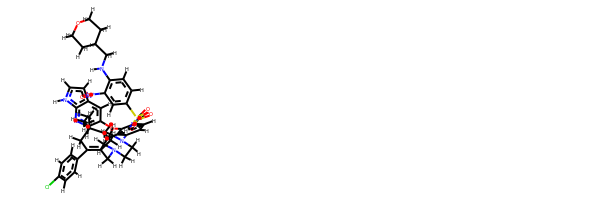

rdkit:  [H]c1nc2c(c([H])c1Oc1c([H])c(N3C([H])([H])C([H])([H])N(C([H])([H])C4=C(c5c([H])c([H])c(Cl)c([H])c5[H])C([H])([H])C(C([H])([H])[H])(C([H])([H])[H])C([H])([H])C4([H])[H])C([H])([H])C3([H])[H])c([H])c([H])c1C(=O)N([H])S(=O)(=O)c1c([H])c([H])c(N([H])C([H])([H])C3([H])C([H])([H])C([H])([H])OC([H])([H])C3([H])[H])c([N+](=O)[O-])c1[H])c([H])c([H])n2[H]
oechem:  CC1(CCC(=C(C1)c2ccc(cc2)Cl)CN3CCN(CC3)c4ccc(c(c4)Oc5cc6cc[nH]c6nc5)C(=O)NS(=O)(=O)c7ccc(c(c7)[N+](=O)[O-])NCC8CCOCC8)C
###########################################################################
 #########################################################

bond
49.88833426402358 kJ/mol 104.59077111144981 kJ/mol False
angle
89.54744742985297 kJ/mol 89.54744742985297 kJ/mol True
nb
12.321156916650091 kJ/mol 12.321156916650091 kJ/mol True
torsion
195.9575568389782 kJ/mol 310.19506828959766 kJ/mol False
347.7144954495048 kJ/mol 516.6544437475505 kJ/mol

-------------------------------------------------------------------
-------------

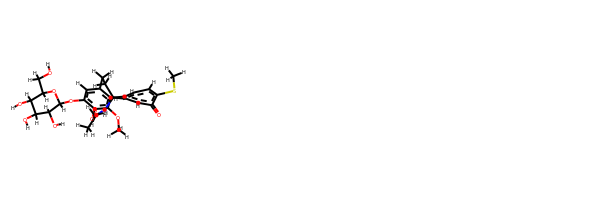

rdkit:  [H]OC([H])([H])C1([H])OC([H])(Oc2c([H])c3c(c(OC([H])([H])[H])c2OC([H])([H])[H])-c2c([H])c([H])c(SC([H])([H])[H])c(=O)c([H])c2C([H])(N([H])C(=O)C([H])([H])[H])C([H])([H])C3([H])[H])C([H])(O[H])C([H])(O[H])C1([H])O[H]
oechem:  CC(=O)NC1CCc2cc(c(c(c2-c3c1cc(=O)c(cc3)SC)OC)OC)OC4C(C(C(C(O4)CO)O)O)O
###########################################################################
 #########################################################

bond
21.113413737075795 kJ/mol 57936.35810131195 kJ/mol False
angle
104.76185645398206 kJ/mol 104.76185645398206 kJ/mol True
nb
58.38569983412066 kJ/mol 58.38569983412066 kJ/mol True
torsion
27.52009531869039 kJ/mol 23.405435832614444 kJ/mol False
211.7810653438689 kJ/mol 58122.91109343267 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_7129


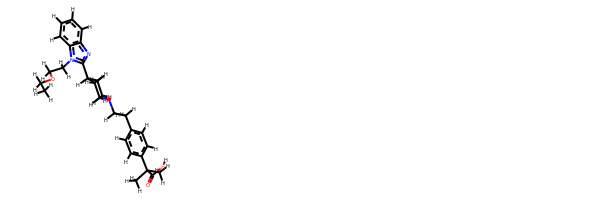

rdkit:  [H]OC(=O)C(c1c([H])c([H])c(C([H])([H])C([H])([H])N2C([H])([H])C([H])([H])C([H])(c3nc4c([H])c([H])c([H])c([H])c4n3C([H])([H])C([H])([H])OC([H])([H])C([H])([H])[H])C([H])([H])C2([H])[H])c([H])c1[H])(C([H])([H])[H])C([H])([H])[H]
oechem:  CCOCCn1c2ccccc2nc1C3CCN(CC3)CCc4ccc(cc4)C(C)(C)C(=O)O
###########################################################################
 #########################################################

bond
40.595033231494085 kJ/mol 43827.64145405181 kJ/mol False
angle
365.069278082618 kJ/mol 367.2237383817862 kJ/mol False
nb
19.285944620573133 kJ/mol 19.285944620573133 kJ/mol True
torsion
203.84622166652736 kJ/mol 197.58690203016494 kJ/mol False
628.7964776012126 kJ/mol 44411.73803908433 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_7130


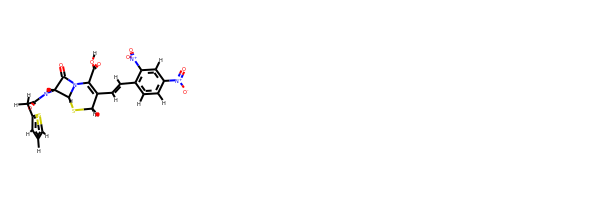

rdkit:  [H]OC(=O)C1=C(C([H])=C([H])c2c([H])c([H])c([N+](=O)[O-])c([H])c2[N+](=O)[O-])C([H])([H])SC2([H])N1C(=O)C2([H])N([H])C(=O)C([H])([H])c1sc([H])c([H])c1[H]
oechem:  c1cc(sc1)CC(=O)NC2C3N(C2=O)C(=C(CS3)C=Cc4ccc(cc4[N+](=O)[O-])[N+](=O)[O-])C(=O)O
###########################################################################
 #########################################################

bond
7.461397829233283 kJ/mol 115356.09284746433 kJ/mol False
angle
9.257288048932958 kJ/mol 9.346808309566864 kJ/mol False
nb
26.552881233364563 kJ/mol 26.552881233364563 kJ/mol True
torsion
16.736419082704895 kJ/mol 0.0005018039494881054 kJ/mol False
60.0079861942357 kJ/mol 115391.99303881121 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_7131


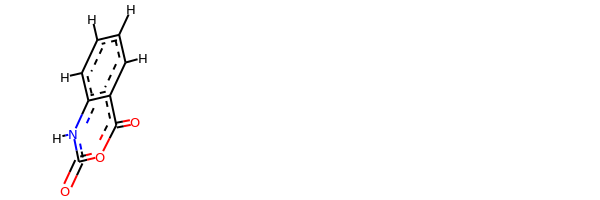

rdkit:  [H]c1c([H])c([H])c2c(c1[H])c(=O)oc(=O)n2[H]
oechem:  c1ccc2c(c1)c(=O)oc(=O)[nH]2
###########################################################################
 #########################################################

###########################################################################
 #########################################################

bond
39.254400716321676 kJ/mol 57764.47297982205 kJ/mol False
angle
53.741897473251555 kJ/mol 54.075945294037936 kJ/mol False
nb
63.96503980714145 kJ/mol 63.96503980714145 kJ/mol True
torsion
47.4721786143903 kJ/mol 44.43019317353731 kJ/mol False
204.433516611105 kJ/mol 57926.94415809677 kJ/mol

-------------------------------------------------------------------
-------------------------------------------------------------------
-------------------------------------------------------------------
DrugBank_7133


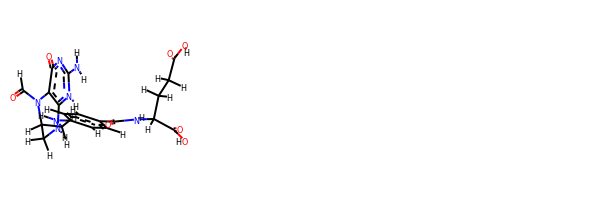

rdkit:  [H]OC(=O)C([H])([H])C([H])([H])C([H])(C(=O)O[H])N([H])C(=O)c1c([H])c([H])c(N([H])C([H])([H])C2([H])N(C([H])=O)c3c(n([H])c(N([H])[H])nc3=O)N([H])C2([H])[H])c([H])c1[H]
oechem:  c1cc(ccc1C(=O)NC(CCC(=O)O)C(=O)O)NCC2CNc3c(c(=O)nc([nH]3)N)N2C=O


In [11]:
def compare_energies(rdkmol, oemol):
    if rdkmol == None:
        print("RDK parsing error")
        return False
#     print(Chem.MolToSmiles(rdkmol))
    positions_rdk = extractPositionsFromRDKMol(rdkmol)
    forcefield = smirnoff.forcefield_rdk.ForceField(ff_filename)
    topology_rdk = smirnoff.forcefield_rdk.generateTopologyFromRDKMol(rdkmol)
    system_rdk = forcefield.createSystem(topology_rdk, [rdkmol], verbose = False)
    
    print("###########################################################################\n #########################################################\n")
    
    positions_oe = extractPositionsFromOEMol(oemol)
    forcefield = smirnoff.forcefield.ForceField(ff_filename)
    topology_oe = smirnoff.forcefield.generateTopologyFromOEMol(oemol)
    system_oe = forcefield.createSystem(topology_oe, [oemol], verbose = False)

    g1,g2,e1,e2 = smirnoff.forcefield_utils.compare_system_energies(topology_oe, topology_rdk, system_oe, system_rdk, positions_oe, positions_rdk, verbose = False,skip_assert = True)
#     g1,g2,e1,e2 = smirnoff.forcefield_utils.compare_system_energies(topology_oe, topology_oe, system_oe, system_oe, positions_oe, positions_oe, verbose = False,skip_assert = True)
    if(e1 == e2): return False
    for i in g1:
        print(i)
        print(g1[i], g2[i], g1[i] == g2[i])

    print( e1, e2)
    print('')
    return True

mol_filename = os.path.dirname(os.path.abspath(os.path.join('..'))) + "/openforcefield/data/molecules/DrugBank_tripos.mol2"
    
istream = oechem.oemolistream(mol_filename)
mol = oechem.OEMol()
flavor = oechem.OEIFlavor_Generic_Default | oechem.OEIFlavor_MOL2_Default | oechem.OEIFlavor_MOL2_Forcefield
istream.SetFlavor( oechem.OEFormat_MOL2, flavor)
oemols_tripos = []
while oechem.OEReadMolecule(istream, mol):
    oechem.OETriposAtomNames(mol)
    oemols_tripos.append(oechem.OEMol(mol))
istream.close()



# ofs = oemolostream("/home/shuwang/out.sdf")
# ofs.SetFormat(OEFormat_SDF)


for mol in oemols_tripos:
    
    oemol = mol
    rdkmol = oemol_to_rdkmol(oemol)
    rdkmol.UpdatePropertyCache(strict=False)
    Chem.GetSSSR(rdkmol)
    if compare_energies(rdkmol, oemol) is False:
        continue
    print("-------------------------------------------------------------------")
    print("-------------------------------------------------------------------")
    print("-------------------------------------------------------------------")
    

    print(mol.GetTitle())
    x = Draw.MolsToGridImage([rdkmol], kekulize = False)
    display(x)
    print("rdkit: ", Chem.MolToSmiles(rdkmol, isomericSmiles = True))
    OESMILES_OPTIONS = oechem.OESMILESFlag_DEFAULT | oechem.OESMILESFlag_ISOMERIC | oechem.OESMILESFlag_Hydrogens

#     print("oechem: ", oechem.OECreateSmiString(oemol, OESMILES_OPTIONS))
    print("oechem: ", oechem.OECreateSmiString(oemol))


    

In [100]:
rdkmol = Chem.MolFromSmiles("[H]c1nc([H])n(C(N([H])[H])=[N+]([H])[H])n1", sanitize = False)
forcefield_rdk.getSMIRKSMatches_RDKMol(rdkmol, "[*:1]~[#7a:2]:[#6a:3]~[*:4]")

[(1, 2, 3, 4),
 (1, 2, 3, 5),
 (3, 2, 1, 0),
 (3, 2, 1, 13),
 (5, 13, 1, 0),
 (5, 13, 1, 2),
 (6, 5, 3, 2),
 (6, 5, 3, 4),
 (13, 5, 3, 2),
 (13, 5, 3, 4)]

((4, 5),)


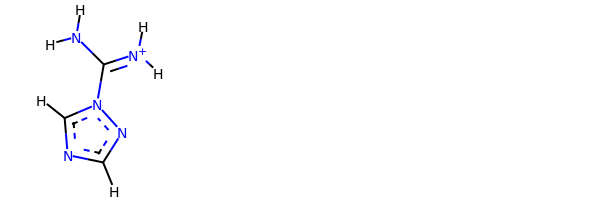

In [154]:

mol_filename = "/home/shuwang/1800.mol2"
    
istream = oechem.oemolistream(mol_filename)
mol = oechem.OEMol()
flavor = oechem.OEIFlavor_Generic_Default | oechem.OEIFlavor_MOL2_Default | oechem.OEIFlavor_MOL2_Forcefield
istream.SetFlavor( oechem.OEFormat_MOL2, flavor)
oemols_tripos = []
while oechem.OEReadMolecule(istream, mol):
    oechem.OETriposAtomNames(mol)
    oemols_tripos.append(oechem.OEMol(mol))
istream.close()



# ofs = oemolostream("/home/shuwang/out.sdf")
# ofs.SetFormat(OEFormat_SDF)

import pickle
for mol in oemols_tripos:
    
    oemol = mol
    rdkmol = oemol_to_rdkmol(oemol)
    rdkmol.UpdatePropertyCache(strict=False)
    Chem.GetSSSR(rdkmol)
    print(rdkmol)
    pickle.dump(rdkmol.GetMol(),  open( "/home/shuwang/1800.pkl", "wb" ))
print(rdkmol.GetSubstructMatches(Chem.MolFromSmarts("[#7:1]:[#7:2]")))
x = Draw.MolsToGridImage([rdkmol], kekulize = False)
display(x)

In [155]:
favorite_color = pickle.load( open( "/home/shuwang/1800.pkl", "rb" ) )
print(favorite_color.GetSubstructMatches(Chem.MolFromSmarts("[#7:1]:[#7:2]")))

((4, 5),)


In [158]:
for atom in oemol.GetAtoms():
    print(atom.GetName())

C1
C2
C3
N1
N2
N3
N4
N5
H1
H2
H3
H4
H5
H6


In [120]:
from openforcefield.typing.engines.smirnoff import forcefield
# ifs = oemolistream()


oemol = OEGraphMol()
# OEParseSmiles(mol, "[H]c1nc([H])n(C(N([H])[H])=[N+]([H])[H])n1")
OEParseSmiles(oemol, "[H]c1nc(n(n1)C(=[N+]([H])[H])N([H])[H])[H]")

# forcefield.getSMIRKSMatches_OEMol(oemol, "[*:1]~[#7a:2]:[#6a:3]~[*:4]")
positions_oe = extractPositionsFromOEMol(oemol)
print(type(positions_oe))
forcefield = smirnoff.forcefield.ForceField(ff_filename)
topology_oe = smirnoff.forcefield.generateTopologyFromOEMol(oemol)
print(topology_oe)
system_oe = forcefield.createSystem(topology_oe, [oemol], verbose = True)

<class 'simtk.unit.quantity.Quantity'>
<Topology; 1 chains, 1 residues, 14 atoms, 14 bonds>
Charges specified in provided molecules will be used.


Exception: No provided molecule matches topology molecule:
Atom        0           0    
